# Modélisation

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import sklearn as sk
import matplotlib.pyplot as plt
import lightgbm as lgb
import xgboost as xgb
import catboost as ctb
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler,RobustScaler
from boostaroota import BoostARoota
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import classification_report
from sklearn.metrics import precision_recall_curve
from sklearn import metrics
from sklearn.model_selection import StratifiedKFold, KFold
from sklearn.model_selection import cross_val_predict
import optuna 
from sklearn.metrics import log_loss
from sklearn.model_selection import StratifiedKFold
from optuna.integration import LightGBMPruningCallback
from sklearn.model_selection import cross_val_predict, cross_val_score, learning_curve, cross_validate
import optuna.integration.lightgbm as lgbm
from sklearn.metrics import fbeta_score, make_scorer

In [2]:
%matplotlib inline

In [3]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [4]:
%run ./Donnees.ipynb

%run ./EDA.ipynb

%run ./Featuring_engineering.ipynb

%run ./Modélisation.ipynb


## Importation des données

In [5]:
df = pd.read_csv('df.csv')
df_test = pd.read_csv('df_test.csv')

In [6]:
df.shape , df_test.shape

((307499, 388), (48744, 387))

In [7]:
df.columns

Index(['Unnamed: 0', 'SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE',
       'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'AMT_CREDIT',
       ...
       '('NFLAG_INSURED_ON_APPROVAL', 'sum')',
       '('NUM_INSTALMENT_VERSION', 'count')',
       '('NUM_INSTALMENT_VERSION', 'mean')',
       '('NUM_INSTALMENT_VERSION', 'max')',
       '('NUM_INSTALMENT_VERSION', 'sum')', '('NUM_INSTALMENT_NUMBER', 'min')',
       '('AMT_INSTALMENT', 'mean')', '('AMT_INSTALMENT', 'max')',
       '('AMT_INSTALMENT', 'min')', '('AMT_INSTALMENT', 'sum')'],
      dtype='object', length=388)

In [8]:
df_test.columns

Index(['Unnamed: 0', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY_x',
       ...
       '('NFLAG_INSURED_ON_APPROVAL', 'sum')',
       '('NUM_INSTALMENT_VERSION', 'count')',
       '('NUM_INSTALMENT_VERSION', 'mean')',
       '('NUM_INSTALMENT_VERSION', 'max')',
       '('NUM_INSTALMENT_VERSION', 'sum')', '('NUM_INSTALMENT_NUMBER', 'min')',
       '('AMT_INSTALMENT', 'mean')', '('AMT_INSTALMENT', 'max')',
       '('AMT_INSTALMENT', 'min')', '('AMT_INSTALMENT', 'sum')'],
      dtype='object', length=387)

In [9]:
EDA().missing_values_table(df)

Your selected dataframe has 388 columns.
There are 9 columns that have missing values.


,Missing Values,% of Total Values
"('NUM_INSTALMENT_VERSION', 'count')",15863,5.2
"('NUM_INSTALMENT_VERSION', 'mean')",15863,5.2
"('NUM_INSTALMENT_VERSION', 'max')",15863,5.2
"('NUM_INSTALMENT_VERSION', 'sum')",15863,5.2
"('NUM_INSTALMENT_NUMBER', 'min')",15863,5.2
"('AMT_INSTALMENT', 'mean')",15863,5.2
"('AMT_INSTALMENT', 'max')",15863,5.2
"('AMT_INSTALMENT', 'min')",15863,5.2
"('AMT_INSTALMENT', 'sum')",15863,5.2


In [10]:
EDA().missing_values_table(df_test)

Your selected dataframe has 387 columns.
There are 9 columns that have missing values.


,Missing Values,% of Total Values
"('NUM_INSTALMENT_VERSION', 'count')",800,1.6
"('NUM_INSTALMENT_VERSION', 'mean')",800,1.6
"('NUM_INSTALMENT_VERSION', 'max')",800,1.6
"('NUM_INSTALMENT_VERSION', 'sum')",800,1.6
"('NUM_INSTALMENT_NUMBER', 'min')",800,1.6
"('AMT_INSTALMENT', 'mean')",800,1.6
"('AMT_INSTALMENT', 'max')",800,1.6
"('AMT_INSTALMENT', 'min')",800,1.6
"('AMT_INSTALMENT', 'sum')",800,1.6


In [11]:
df = Feturing_engineering().Imputation_valeur_manquante(df,df)

In [12]:
df_test = Feturing_engineering().Imputation_valeur_manquante(df_test,df_test)

In [13]:
count = np.isinf(df).values.sum() 
print("It contains " + str(count) + " infinite values") 
print() 
print("printing column name where infinity is present") 
col_name = df.columns.to_series()[np.isinf(df).any()] 
print(col_name) 
print("printing row index with infinity ") 
r = df.index[np.isinf(df).any(1)] 
print(r) 

It contains 561796 infinite values

printing column name where infinity is present
INCOME_TO_EMPLOYED_RATIO                            INCOME_TO_EMPLOYED_RATIO
('DEBT_PERCENTAGE', 'mean')                      ('DEBT_PERCENTAGE', 'mean')
('DEBT_PERCENTAGE', 'max')                        ('DEBT_PERCENTAGE', 'max')
('BUREAU_CREDIT_DEBT_RATIO', 'mean')    ('BUREAU_CREDIT_DEBT_RATIO', 'mean')
('BUREAU_CREDIT_DEBT_RATIO', 'min')      ('BUREAU_CREDIT_DEBT_RATIO', 'min')
dtype: object
printing row index with infinity 
Int64Index([     0,      1,      2,      3,      4,      5,      6,      7,
                 8,      9,
            ...
            307489, 307490, 307491, 307492, 307493, 307494, 307495, 307496,
            307497, 307498],
           dtype='int64', length=277881)


In [14]:
df.drop([ "('DEBT_PERCENTAGE', 'mean')",
 "('DEBT_PERCENTAGE', 'max')",
 "('BUREAU_CREDIT_DEBT_RATIO', 'mean')",
 "('BUREAU_CREDIT_DEBT_RATIO', 'min')",],axis=1,inplace = True)

In [15]:
df_test.drop([ "('DEBT_PERCENTAGE', 'mean')",
 "('DEBT_PERCENTAGE', 'max')",
 "('BUREAU_CREDIT_DEBT_RATIO', 'mean')",
 "('BUREAU_CREDIT_DEBT_RATIO', 'min')",],axis=1,inplace = True)

In [16]:
df = df[~df.isin([np.nan, np.inf, -np.inf]).any(1)]

In [17]:
df.shape , df_test.shape

((307497, 384), (48744, 383))

In [18]:
y = df['TARGET']

In [19]:
import re
df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
df_test = df_test.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [20]:
df.shape , df_test.shape

((307497, 384), (48744, 383))

In [21]:
df.set_index('SK_ID_CURR', inplace=True)

In [22]:
df_test.set_index('SK_ID_CURR', inplace=True)

In [23]:
df.shape , df_test.shape

((307497, 383), (48744, 382))

In [24]:
X = df.copy()

In [25]:
X.drop(['TARGET','Unnamed0'], axis = 1, inplace = True)

In [26]:
df.head()

,Unnamed0,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY_x,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,LANDAREA_AVG,NONLIVINGAREA_AVG,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CREDIT_TERM,CREDIT_TO_GOODS_RATIO,ANNUITY_TO_INCOME_RATIO,CREDIT_TO_INCOME_RATIO,INCOME_TO_EMPLOYED_RATIO,EXT_SOURCES_PROD,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Groupofpeople,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,NAME_TYPE_SUITE_Spousepartner,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercialassociate,NAME_INCOME_TYPE_Stateservant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academicdegree,NAME_EDUCATION_TYPE_Highereducation,NAME_EDUCATION_TYPE_Incompletehigher,NAME_EDUCATION_TYPE_Lowersecondary,NAME_FAMILY_STATUS_Civilmarriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Singlenotmarried,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Coopapartment,NAME_HOUSING_TYPE_Houseapartment,NAME_HOUSING_TYPE_Municipalapartment,NAME_HOUSING_TYPE_Officeapartment,NAME_HOUSING_TYPE_Rentedapartment,NAME_HOUSING_TYPE_Withparents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaningstaff,OCCUPATION_TYPE_Cookingstaff,OCCUPATION_TYPE_Corestaff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HRstaff,OCCUPATION_TYPE_Highskilltechstaff,OCCUPATION_TYPE_ITstaff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_LowskillLaborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicinestaff,OCCUPATION_TYPE_Privateservicestaff,OCCUPATION_TYPE_Realtyagents,OCCUPATION_TYPE_Salesstaff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Securitystaff,OCCUPATION_TYPE_Waitersbarmenstaff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_BusinessEntityType1,ORGANIZATION_TYPE_BusinessEntityType2,ORGANIZATION_TYPE_BusinessEntityType3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industrytype1,ORGANIZATION_TYPE_Industrytype10,ORGANIZATION_TYPE_Industrytype11,ORGANIZATION_TYPE_Industrytype12,ORGANIZATION_TYPE_Industrytype13,ORGANIZATION_TYPE_Industrytype2,ORGANIZATION_TYPE_Industrytype3,ORGANIZATION_TYPE_Industrytype4,ORGANIZATION_TYPE_Industrytype5,ORGANIZATION_TYPE_Industrytype6,ORGANIZATION_TYPE_Industrytype7,ORGANIZATION_TYPE_Industrytype8,ORGANIZATION_TYPE_Industrytype9,ORGANIZATION_TYPE_Insurance,ORGANIZATION_TYPE_Kindergarten,ORGANIZATION_TYPE_LegalServices,ORGANIZATION_TYPE_Medicine,ORGANIZATION_TYPE_Military,ORGANIZATION_TYPE_Mobile,ORGANIZATION_TYPE_Other,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Real

In [27]:
df_test.head()

,Unnamed0,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY_x,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,LANDAREA_AVG,NONLIVINGAREA_AVG,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CREDIT_TERM,CREDIT_TO_GOODS_RATIO,ANNUITY_TO_INCOME_RATIO,CREDIT_TO_INCOME_RATIO,INCOME_TO_EMPLOYED_RATIO,EXT_SOURCES_PROD,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Groupofpeople,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,NAME_TYPE_SUITE_Spousepartner,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercialassociate,NAME_INCOME_TYPE_Stateservant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academicdegree,NAME_EDUCATION_TYPE_Highereducation,NAME_EDUCATION_TYPE_Incompletehigher,NAME_EDUCATION_TYPE_Lowersecondary,NAME_FAMILY_STATUS_Civilmarriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Singlenotmarried,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Coopapartment,NAME_HOUSING_TYPE_Houseapartment,NAME_HOUSING_TYPE_Municipalapartment,NAME_HOUSING_TYPE_Officeapartment,NAME_HOUSING_TYPE_Rentedapartment,NAME_HOUSING_TYPE_Withparents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaningstaff,OCCUPATION_TYPE_Cookingstaff,OCCUPATION_TYPE_Corestaff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HRstaff,OCCUPATION_TYPE_Highskilltechstaff,OCCUPATION_TYPE_ITstaff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_LowskillLaborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicinestaff,OCCUPATION_TYPE_Privateservicestaff,OCCUPATION_TYPE_Realtyagents,OCCUPATION_TYPE_Salesstaff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Securitystaff,OCCUPATION_TYPE_Waitersbarmenstaff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_BusinessEntityType1,ORGANIZATION_TYPE_BusinessEntityType2,ORGANIZATION_TYPE_BusinessEntityType3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industrytype1,ORGANIZATION_TYPE_Industrytype10,ORGANIZATION_TYPE_Industrytype11,ORGANIZATION_TYPE_Industrytype12,ORGANIZATION_TYPE_Industrytype13,ORGANIZATION_TYPE_Industrytype2,ORGANIZATION_TYPE_Industrytype3,ORGANIZATION_TYPE_Industrytype4,ORGANIZATION_TYPE_Industrytype5,ORGANIZATION_TYPE_Industrytype6,ORGANIZATION_TYPE_Industrytype7,ORGANIZATION_TYPE_Industrytype8,ORGANIZATION_TYPE_Industrytype9,ORGANIZATION_TYPE_Insurance,ORGANIZATION_TYPE_Kindergarten,ORGANIZATION_TYPE_LegalServices,ORGANIZATION_TYPE_Medicine,ORGANIZATION_TYPE_Military,ORGANIZATION_TYPE_Mobile,ORGANIZATION_TYPE_Other,ORGANIZATION_TYPE_Police,ORGANIZATION_TYPE_Postal,ORGANIZATION_TYPE_Realtor,ORG

In [28]:
df.shape , df_test.shape

((307497, 383), (48744, 382))

## Feature selection avec BoosTAroota

In [29]:
br = BoostARoota(metric='auc')
br.fit(X, y)

[12:46:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


Round:  1  iteration:  1
[12:47:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


Round:  1  iteration:  2
[12:48:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due 

C:\Anaconda\lib\site-packages\boostaroota\boostaroota.py:130: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df['Mean'] = df.mean(axis=1)


[12:59:14] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


Round:  2  iteration:  1
[12:59:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


Round:  2  iteration:  2
[13:00:13] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due 

Round:  3  iteration:  10
BoostARoota ran successfully! Algorithm went through  3  rounds.


In [30]:
br.keep_vars_.to_list()

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY_x',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'FLAG_WORK_PHONE',
 'REGION_RATING_CLIENT',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'FLOORSMAX_AVG',
 'LANDAREA_AVG',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_3',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'CREDIT_TERM',
 'CREDIT_TO_GOODS_RATIO',
 'ANNUITY_TO_INCOME_RATIO',
 'CREDIT_TO_INCOME_RATIO',
 'INCOME_TO_EMPLOYED_RATIO',
 'EXT_SOURCES_PROD',
 'NAME_INCOME_TYPE_Working',
 'NAME_EDUCATION_TYPE_Highereducation',
 'NAME_FAMILY_STATUS_Married',
 'NAME_HOUSING_TYPE_Coopapartment',
 'OCCUPAT

In [31]:
train_selec_boost = br.transform(X)

In [32]:
EDA().shape([train_selec_boost], ['train_selec_boost'])

,nombre de lignes,nombre de colonnes,% valeurs manquantes
train_selec_boost,307497.0,162.0,0.0


In [33]:
train_feat = train_selec_boost.copy()

In [34]:
train_feat['TARGET'] = df['TARGET']

In [35]:
train_feat.to_csv('train_feat.csv')

In [36]:
train_selec_boost.to_csv('train_selec_boost.csv')

In [37]:
train_selec_boost.head()

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY_x,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_WORK_PHONE,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_CITY_NOT_LIVE_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,LANDAREA_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CREDIT_TERM,CREDIT_TO_GOODS_RATIO,ANNUITY_TO_INCOME_RATIO,CREDIT_TO_INCOME_RATIO,INCOME_TO_EMPLOYED_RATIO,EXT_SOURCES_PROD,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Highereducation,NAME_FAMILY_STATUS_Married,NAME_HOUSING_TYPE_Coopapartment,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_Salesstaff,WEEKDAY_APPR_PROCESS_START_TUESDAY,ORGANIZATION_TYPE_Selfemployed,ORGANIZATION_TYPE_Transporttype3,HOUSETYPE_MODE_specifichousing,DAYS_CREDITcount,DAYS_CREDITmean,DAYS_CREDITmax,DAYS_CREDIT_ENDDATEmean,DAYS_CREDIT_ENDDATEmax,DAYS_CREDIT_ENDDATEmin,DAYS_ENDDATE_FACTmean,DAYS_ENDDATE_FACTmax,AMT_CREDIT_MAX_OVERDUEcount,AMT_CREDIT_MAX_OVERDUEmean,CNT_CREDIT_PROLONGmean,AMT_CREDIT_SUMmean,AMT_CREDIT_SUMmin,AMT_CREDIT_SUM_DEBTmean,AMT_CREDIT_SUM_DEBTmax,AMT_CREDIT_SUM_DEBTmin,AMT_CREDIT_SUM_LIMITmean,AMT_CREDIT_SUM_LIMITmin,AMT_CREDIT_SUM_OVERDUEmean,AMT_CREDIT_SUM_OVERDUEmax,DAYS_CREDIT_UPDATEmean,DAYS_CREDIT_UPDATEmax,DAYS_CREDIT_UPDATEmin,AMT_ANNUITYmean_x,AMT_ANNUITYmax_x,AMT_ANNUITYmin_x,number_prev_loan_extern,CREDIT_ACTIVE_Activemean,CREDIT_ACTIVE_Activesum,CREDIT_ACTIVE_Soldmean,CREDIT_TYPE_Consumercreditmean,CREDIT_TYPE_Creditcardsum,CREDIT_TYPE_Microloanmean,CREDIT_TYPE_Microloansum,MONTHS_BALANCEcount_x,MONTHS_BALANCEmean_x,MONTHS_BALANCEmax_x,MONTHS_BALANCEmin_x,STATUS_0mean,STATUS_1sum,STATUS_2mean,STATUS_3mean,STATUS_3sum,STATUS_Cmean,STATUS_Xmean,STATUS_Xsum,MONTHS_BALANCE_ycount,MONTHS_BALANCE_ymean,MONTHS_BALANCE_ymax,CNT_INSTALMENTmean,CNT_INSTALMENTmin,CNT_INSTALMENT_FUTUREmin,SK_DPDmean_x,SK_DPD_DEFmean_x,number_prev_POS_CASH,NAME_CONTRACT_STATUS_Activemean_x,NAME_CONTRACT_STATUS_Completedsum_x,NAME_CONTRACT_STATUS_Demandmean_x,NAME_CONTRACT_STATUS_Returnedtothestoremean,NAME_CONTRACT_STATUS_Signedmean_x,MONTHS_BALANCEcount,AMT_BALANCEmean,AMT_BALANCEmin,AMT_BALANCEsum,AMT_CREDIT_LIMIT_ACTUALmean,AMT_DRAWINGS_ATM_CURRENTmean,AMT_DRAWINGS_ATM_CURRENTsum,AMT_DRAWINGS_CURRENTmean,AMT_DRAWINGS_CURRENTsum,AMT_DRAWINGS_OTHER_CURRENTmean,AMT_DRAWINGS_OTHER_CURRENTmax,AMT_DRAWINGS_POS_CURRENTmean,AMT_PAYMENT_CURRENTmax,CNT_DRAWINGS_ATM_CURRENTmean,CNT_DRAWINGS_ATM_CURRENTmax,CNT_DRAWINGS_ATM_CURRENTsum,CNT_DRAWINGS_CURRENTmean,CNT_DRAWINGS_CURRENTmin,CNT_DRAWINGS_OTHER_CURRENTmean,SK_DPD_ymean,SK_DPD_DEF_ymean,AMT_ANNUITY_ycount,AMT_ANNUITY_ymean,AMT_ANNUITY_ymin,AMT_APPLICATIONmin,AMT_DOWN_PAYMENTmean,AMT_DOWN_PAYMENTmax,HOUR_APPR_PROCESS_STARTmean,RATE_DOWN_PAYMENTmean,RATE_DOWN_PAYMENTmax,RATE_DOWN_PAYMENTmin,RATE_DOWN_PAYMENTsum,DAYS_DECISIONmax,DAYS_DECISIONsum,SELLERPLACE_AREAmean,SELLERPLACE_AREAmax,CNT_PAYMENTmean,CNT_PAYMENTmax,CNT_PAYMENTmin,DAYS_FIRST_DRAWINGmean,DAYS_FIRST_DRAWINGmin,DAYS_FIRST_DUEmean,DAYS_FIRST_DUEmin,DAYS_LAST_DUE_1ST_VERSIONmax,DAYS_LAST_DUEmean,DAYS_LAST_DUEmax,DAYS_LAST_DUEmin,NUM_INSTALMENT_VERSIONcount,NUM_INSTALMENT_VERSIONmean,NUM_INSTALMENT_VERSIONsum,AMT_INSTALMENTmean,AMT_INSTALMENTmax,AMT_INSTALMENTmin,AMT_INSTALMENTsum
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100002,0,1,0,1,0,202500.0,406597.5,24700.5,0.018801,25.920548,1.745205,-3648.0,-2120,0,2,10,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.0833,0.0369,2.0,2.0,-1134.0,1,0.0,1.0,16.461104,1.158397,0.121978,2.007889,116032.182104,0.003043,1,0,0,0,0,0,0,0,0,0,8.0,-874.000000,-103.0,-349.0,780.0,-1072.0,-697.500000,-36.0,5.0,1681.0

In [38]:
test_selec_boost = df_test[train_selec_boost.columns]

In [40]:
train_selec_boost.shape, test_selec_boost.shape

((307497, 162), (48744, 162))

In [41]:
test_selec_boost.to_csv('test_selec_boost.csv')

In [42]:
train_selec_boost = pd.read_csv('train_selec_boost.csv', index_col = 'SK_ID_CURR')

In [43]:
test_selec_boost = pd.read_csv('test_selec_boost.csv', index_col = "SK_ID_CURR")

In [44]:
train_selec_boost.shape , test_selec_boost.shape

((307497, 162), (48744, 162))

In [45]:
test_selec_boost.head()

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY_x,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_WORK_PHONE,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_CITY_NOT_LIVE_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,FLOORSMAX_AVG,LANDAREA_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,CREDIT_TERM,CREDIT_TO_GOODS_RATIO,ANNUITY_TO_INCOME_RATIO,CREDIT_TO_INCOME_RATIO,INCOME_TO_EMPLOYED_RATIO,EXT_SOURCES_PROD,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Highereducation,NAME_FAMILY_STATUS_Married,NAME_HOUSING_TYPE_Coopapartment,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_Salesstaff,WEEKDAY_APPR_PROCESS_START_TUESDAY,ORGANIZATION_TYPE_Selfemployed,ORGANIZATION_TYPE_Transporttype3,HOUSETYPE_MODE_specifichousing,DAYS_CREDITcount,DAYS_CREDITmean,DAYS_CREDITmax,DAYS_CREDIT_ENDDATEmean,DAYS_CREDIT_ENDDATEmax,DAYS_CREDIT_ENDDATEmin,DAYS_ENDDATE_FACTmean,DAYS_ENDDATE_FACTmax,AMT_CREDIT_MAX_OVERDUEcount,AMT_CREDIT_MAX_OVERDUEmean,CNT_CREDIT_PROLONGmean,AMT_CREDIT_SUMmean,AMT_CREDIT_SUMmin,AMT_CREDIT_SUM_DEBTmean,AMT_CREDIT_SUM_DEBTmax,AMT_CREDIT_SUM_DEBTmin,AMT_CREDIT_SUM_LIMITmean,AMT_CREDIT_SUM_LIMITmin,AMT_CREDIT_SUM_OVERDUEmean,AMT_CREDIT_SUM_OVERDUEmax,DAYS_CREDIT_UPDATEmean,DAYS_CREDIT_UPDATEmax,DAYS_CREDIT_UPDATEmin,AMT_ANNUITYmean_x,AMT_ANNUITYmax_x,AMT_ANNUITYmin_x,number_prev_loan_extern,CREDIT_ACTIVE_Activemean,CREDIT_ACTIVE_Activesum,CREDIT_ACTIVE_Soldmean,CREDIT_TYPE_Consumercreditmean,CREDIT_TYPE_Creditcardsum,CREDIT_TYPE_Microloanmean,CREDIT_TYPE_Microloansum,MONTHS_BALANCEcount_x,MONTHS_BALANCEmean_x,MONTHS_BALANCEmax_x,MONTHS_BALANCEmin_x,STATUS_0mean,STATUS_1sum,STATUS_2mean,STATUS_3mean,STATUS_3sum,STATUS_Cmean,STATUS_Xmean,STATUS_Xsum,MONTHS_BALANCE_ycount,MONTHS_BALANCE_ymean,MONTHS_BALANCE_ymax,CNT_INSTALMENTmean,CNT_INSTALMENTmin,CNT_INSTALMENT_FUTUREmin,SK_DPDmean_x,SK_DPD_DEFmean_x,number_prev_POS_CASH,NAME_CONTRACT_STATUS_Activemean_x,NAME_CONTRACT_STATUS_Completedsum_x,NAME_CONTRACT_STATUS_Demandmean_x,NAME_CONTRACT_STATUS_Returnedtothestoremean,NAME_CONTRACT_STATUS_Signedmean_x,MONTHS_BALANCEcount,AMT_BALANCEmean,AMT_BALANCEmin,AMT_BALANCEsum,AMT_CREDIT_LIMIT_ACTUALmean,AMT_DRAWINGS_ATM_CURRENTmean,AMT_DRAWINGS_ATM_CURRENTsum,AMT_DRAWINGS_CURRENTmean,AMT_DRAWINGS_CURRENTsum,AMT_DRAWINGS_OTHER_CURRENTmean,AMT_DRAWINGS_OTHER_CURRENTmax,AMT_DRAWINGS_POS_CURRENTmean,AMT_PAYMENT_CURRENTmax,CNT_DRAWINGS_ATM_CURRENTmean,CNT_DRAWINGS_ATM_CURRENTmax,CNT_DRAWINGS_ATM_CURRENTsum,CNT_DRAWINGS_CURRENTmean,CNT_DRAWINGS_CURRENTmin,CNT_DRAWINGS_OTHER_CURRENTmean,SK_DPD_ymean,SK_DPD_DEF_ymean,AMT_ANNUITY_ycount,AMT_ANNUITY_ymean,AMT_ANNUITY_ymin,AMT_APPLICATIONmin,AMT_DOWN_PAYMENTmean,AMT_DOWN_PAYMENTmax,HOUR_APPR_PROCESS_STARTmean,RATE_DOWN_PAYMENTmean,RATE_DOWN_PAYMENTmax,RATE_DOWN_PAYMENTmin,RATE_DOWN_PAYMENTsum,DAYS_DECISIONmax,DAYS_DECISIONsum,SELLERPLACE_AREAmean,SELLERPLACE_AREAmax,CNT_PAYMENTmean,CNT_PAYMENTmax,CNT_PAYMENTmin,DAYS_FIRST_DRAWINGmean,DAYS_FIRST_DRAWINGmin,DAYS_FIRST_DUEmean,DAYS_FIRST_DUEmin,DAYS_LAST_DUE_1ST_VERSIONmax,DAYS_LAST_DUEmean,DAYS_LAST_DUEmax,DAYS_LAST_DUEmin,NUM_INSTALMENT_VERSIONcount,NUM_INSTALMENT_VERSIONmean,NUM_INSTALMENT_VERSIONsum,AMT_INSTALMENTmean,AMT_INSTALMENTmax,AMT_INSTALMENTmin,AMT_INSTALMENTsum
SK_ID_CURR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
100001,0,0,0,1,0,135000.0,568800.0,20560.5,0.018850,52.715068,6.380822,-5170.0,-812,0,2,18,0,0,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,0.1250,0.0483,0.0,0.0,-1740.0,1,0.0,0.0,27.664697,1.2640,0.152300,4.213333,21157.148991,0.094803,1,1,1,0,0,0,1,0,0,0,7.0,-735.000000,-49.0,82.428571,1778.0,-1329.0,-825.500000,-544.0,0.0,0.0,0.

## Split Data 

In [46]:
x_train, x_valid, y_train, y_valid = train_test_split(train_selec_boost, y, random_state=0)
print("Taille de l'ensemble d'entrainement :{} Taille de l'ensemble de validation :  {}\n".format(x_train.shape[0], x_valid.shape[0]))

Taille de l'ensemble d'entrainement :230622 Taille de l'ensemble de validation :  76875



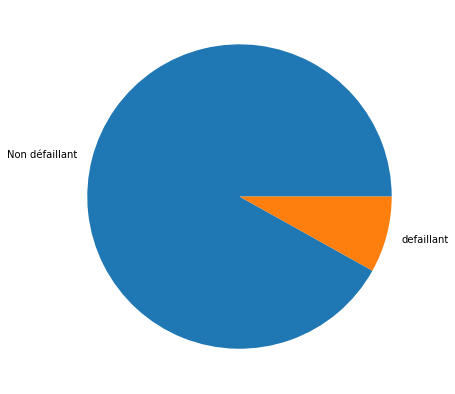

In [123]:
plt.figure(figsize = (7,7))
plt.pie(y_train.value_counts(), labels= ["Non défaillant","defaillant"])
plt.show()

## Equilibrage des data avec la méthode SMOTE

In [47]:
from imblearn.over_sampling import SMOTE

In [48]:
sm = SMOTE(random_state = 2)
X_train, Y_train = sm.fit_sample(x_train, y_train.ravel())

In [49]:
print('After OverSampling, the shape of train_X: {}'.format(X_train.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(Y_train.shape))
 
print("After OverSampling, counts of label '1': {}".format(sum(Y_train == 1)))
print("After OverSampling, counts of label '0': {} \n".format(sum(Y_train == 0)))

After OverSampling, the shape of train_X: (423878, 162)
After OverSampling, the shape of train_y: (423878,) 

After OverSampling, counts of label '1': 211939
After OverSampling, counts of label '0': 211939 



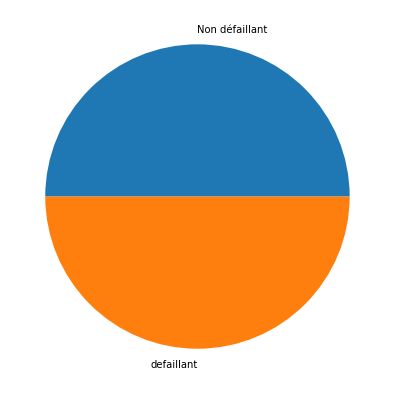

In [126]:
plt.figure(figsize = (7,7))
plt.pie(np.bincount(Y_train), labels= ["Non défaillant","defaillant"])
plt.show()

## Modèles de bases sans hyperparamétrage 

In [50]:
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score 

In [51]:
Pipeline_lgb = Pipeline([('std', StandardScaler()), ('clf_l', lgb.LGBMClassifier())])
Pipeline_cat = Pipeline([('std', StandardScaler()), ('clf_c', ctb.CatBoostClassifier())])
Pipeline_xg = Pipeline([('std', StandardScaler()), ('clf_x', xgb.XGBClassifier())])

Pipelines = [Pipeline_lgb, Pipeline_cat, Pipeline_xg]

In [52]:
for pipe in Pipelines :
    pipe.fit(X_train, Y_train)

Learning rate set to 0.136385
0:	learn: 0.6335759	total: 359ms	remaining: 5m 58s
1:	learn: 0.5351297	total: 498ms	remaining: 4m 8s
2:	learn: 0.5030427	total: 645ms	remaining: 3m 34s
3:	learn: 0.4778786	total: 819ms	remaining: 3m 23s
4:	learn: 0.4519026	total: 965ms	remaining: 3m 12s
5:	learn: 0.4348730	total: 1.11s	remaining: 3m 4s
6:	learn: 0.4096711	total: 1.27s	remaining: 3m
7:	learn: 0.3725061	total: 1.43s	remaining: 2m 57s
8:	learn: 0.3486078	total: 1.57s	remaining: 2m 53s
9:	learn: 0.3400750	total: 1.72s	remaining: 2m 50s
10:	learn: 0.3205796	total: 1.85s	remaining: 2m 46s
11:	learn: 0.3058306	total: 2.04s	remaining: 2m 47s
12:	learn: 0.2912517	total: 2.17s	remaining: 2m 45s
13:	learn: 0.2845911	total: 2.33s	remaining: 2m 44s
14:	learn: 0.2683631	total: 2.49s	remaining: 2m 43s
15:	learn: 0.2532735	total: 2.66s	remaining: 2m 43s
16:	learn: 0.2489204	total: 2.81s	remaining: 2m 42s
17:	learn: 0.2453802	total: 2.95s	remaining: 2m 41s
18:	learn: 0.2387692	total: 3.11s	remaining: 2m 40

157:	learn: 0.1432749	total: 25s	remaining: 2m 13s
158:	learn: 0.1431993	total: 25.1s	remaining: 2m 12s
159:	learn: 0.1431518	total: 25.3s	remaining: 2m 12s
160:	learn: 0.1430752	total: 25.4s	remaining: 2m 12s
161:	learn: 0.1430023	total: 25.5s	remaining: 2m 12s
162:	learn: 0.1429555	total: 25.6s	remaining: 2m 11s
163:	learn: 0.1429027	total: 25.7s	remaining: 2m 11s
164:	learn: 0.1428442	total: 25.9s	remaining: 2m 10s
165:	learn: 0.1427841	total: 26s	remaining: 2m 10s
166:	learn: 0.1427273	total: 26.1s	remaining: 2m 10s
167:	learn: 0.1423550	total: 26.3s	remaining: 2m 10s
168:	learn: 0.1418478	total: 26.4s	remaining: 2m 9s
169:	learn: 0.1417660	total: 26.6s	remaining: 2m 9s
170:	learn: 0.1416983	total: 26.7s	remaining: 2m 9s
171:	learn: 0.1416453	total: 26.9s	remaining: 2m 9s
172:	learn: 0.1408228	total: 27s	remaining: 2m 9s
173:	learn: 0.1405506	total: 27.2s	remaining: 2m 9s
174:	learn: 0.1404867	total: 27.3s	remaining: 2m 8s
175:	learn: 0.1404057	total: 27.5s	remaining: 2m 8s
176:	le

314:	learn: 0.1330627	total: 48.6s	remaining: 1m 45s
315:	learn: 0.1330229	total: 48.9s	remaining: 1m 45s
316:	learn: 0.1329892	total: 49s	remaining: 1m 45s
317:	learn: 0.1329025	total: 49.3s	remaining: 1m 45s
318:	learn: 0.1328859	total: 49.5s	remaining: 1m 45s
319:	learn: 0.1328557	total: 49.8s	remaining: 1m 45s
320:	learn: 0.1328149	total: 49.9s	remaining: 1m 45s
321:	learn: 0.1327698	total: 50s	remaining: 1m 45s
322:	learn: 0.1327286	total: 50.2s	remaining: 1m 45s
323:	learn: 0.1326744	total: 50.3s	remaining: 1m 44s
324:	learn: 0.1326437	total: 50.4s	remaining: 1m 44s
325:	learn: 0.1325908	total: 50.6s	remaining: 1m 44s
326:	learn: 0.1325483	total: 50.7s	remaining: 1m 44s
327:	learn: 0.1325273	total: 50.8s	remaining: 1m 44s
328:	learn: 0.1322880	total: 50.9s	remaining: 1m 43s
329:	learn: 0.1322347	total: 51.1s	remaining: 1m 43s
330:	learn: 0.1322072	total: 51.2s	remaining: 1m 43s
331:	learn: 0.1321881	total: 51.3s	remaining: 1m 43s
332:	learn: 0.1321499	total: 51.4s	remaining: 1m 4

471:	learn: 0.1270712	total: 1m 11s	remaining: 1m 20s
472:	learn: 0.1270524	total: 1m 11s	remaining: 1m 19s
473:	learn: 0.1270131	total: 1m 11s	remaining: 1m 19s
474:	learn: 0.1269795	total: 1m 11s	remaining: 1m 19s
475:	learn: 0.1269511	total: 1m 12s	remaining: 1m 19s
476:	learn: 0.1269128	total: 1m 12s	remaining: 1m 19s
477:	learn: 0.1268795	total: 1m 12s	remaining: 1m 19s
478:	learn: 0.1268537	total: 1m 12s	remaining: 1m 18s
479:	learn: 0.1268378	total: 1m 12s	remaining: 1m 18s
480:	learn: 0.1268092	total: 1m 12s	remaining: 1m 18s
481:	learn: 0.1267808	total: 1m 12s	remaining: 1m 18s
482:	learn: 0.1267499	total: 1m 12s	remaining: 1m 18s
483:	learn: 0.1267190	total: 1m 13s	remaining: 1m 17s
484:	learn: 0.1267044	total: 1m 13s	remaining: 1m 17s
485:	learn: 0.1266696	total: 1m 13s	remaining: 1m 17s
486:	learn: 0.1266425	total: 1m 13s	remaining: 1m 17s
487:	learn: 0.1266049	total: 1m 13s	remaining: 1m 17s
488:	learn: 0.1265845	total: 1m 13s	remaining: 1m 17s
489:	learn: 0.1265494	total:

626:	learn: 0.1223167	total: 1m 34s	remaining: 56.2s
627:	learn: 0.1222802	total: 1m 34s	remaining: 56s
628:	learn: 0.1222559	total: 1m 34s	remaining: 56s
629:	learn: 0.1222261	total: 1m 35s	remaining: 55.9s
630:	learn: 0.1221873	total: 1m 35s	remaining: 55.8s
631:	learn: 0.1221584	total: 1m 35s	remaining: 55.8s
632:	learn: 0.1221231	total: 1m 35s	remaining: 55.7s
633:	learn: 0.1220952	total: 1m 36s	remaining: 55.6s
634:	learn: 0.1220744	total: 1m 36s	remaining: 55.5s
635:	learn: 0.1220596	total: 1m 36s	remaining: 55.4s
636:	learn: 0.1220364	total: 1m 36s	remaining: 55.2s
637:	learn: 0.1220021	total: 1m 37s	remaining: 55.1s
638:	learn: 0.1219834	total: 1m 37s	remaining: 55s
639:	learn: 0.1219476	total: 1m 37s	remaining: 54.9s
640:	learn: 0.1219134	total: 1m 37s	remaining: 54.8s
641:	learn: 0.1218858	total: 1m 37s	remaining: 54.6s
642:	learn: 0.1218506	total: 1m 38s	remaining: 54.5s
643:	learn: 0.1218388	total: 1m 38s	remaining: 54.3s
644:	learn: 0.1218262	total: 1m 38s	remaining: 54.2s

783:	learn: 0.1178177	total: 1m 59s	remaining: 32.8s
784:	learn: 0.1177878	total: 1m 59s	remaining: 32.7s
785:	learn: 0.1177594	total: 1m 59s	remaining: 32.5s
786:	learn: 0.1177316	total: 1m 59s	remaining: 32.3s
787:	learn: 0.1177113	total: 1m 59s	remaining: 32.2s
788:	learn: 0.1176993	total: 1m 59s	remaining: 32s
789:	learn: 0.1176634	total: 1m 59s	remaining: 31.9s
790:	learn: 0.1176478	total: 2m	remaining: 31.7s
791:	learn: 0.1176165	total: 2m	remaining: 31.6s
792:	learn: 0.1175868	total: 2m	remaining: 31.4s
793:	learn: 0.1175742	total: 2m	remaining: 31.2s
794:	learn: 0.1175404	total: 2m	remaining: 31.1s
795:	learn: 0.1175042	total: 2m	remaining: 30.9s
796:	learn: 0.1174777	total: 2m	remaining: 30.8s
797:	learn: 0.1174516	total: 2m	remaining: 30.6s
798:	learn: 0.1174267	total: 2m 1s	remaining: 30.5s
799:	learn: 0.1173944	total: 2m 1s	remaining: 30.3s
800:	learn: 0.1173709	total: 2m 1s	remaining: 30.2s
801:	learn: 0.1173451	total: 2m 1s	remaining: 30s
802:	learn: 0.1173078	total: 2m 1

941:	learn: 0.1137845	total: 2m 22s	remaining: 8.79s
942:	learn: 0.1137643	total: 2m 23s	remaining: 8.65s
943:	learn: 0.1137473	total: 2m 23s	remaining: 8.51s
944:	learn: 0.1137266	total: 2m 23s	remaining: 8.36s
945:	learn: 0.1136930	total: 2m 23s	remaining: 8.22s
946:	learn: 0.1136740	total: 2m 24s	remaining: 8.07s
947:	learn: 0.1136535	total: 2m 24s	remaining: 7.93s
948:	learn: 0.1136310	total: 2m 24s	remaining: 7.78s
949:	learn: 0.1136099	total: 2m 25s	remaining: 7.63s
950:	learn: 0.1135892	total: 2m 25s	remaining: 7.48s
951:	learn: 0.1135826	total: 2m 25s	remaining: 7.33s
952:	learn: 0.1135477	total: 2m 25s	remaining: 7.18s
953:	learn: 0.1135130	total: 2m 25s	remaining: 7.04s
954:	learn: 0.1134812	total: 2m 26s	remaining: 6.89s
955:	learn: 0.1134616	total: 2m 26s	remaining: 6.73s
956:	learn: 0.1134444	total: 2m 26s	remaining: 6.58s
957:	learn: 0.1134142	total: 2m 26s	remaining: 6.42s
958:	learn: 0.1133820	total: 2m 26s	remaining: 6.27s
959:	learn: 0.1133501	total: 2m 26s	remaining:

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[16:39:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [53]:
output_lgb = {
  'AUC': roc_auc_score(y_valid, Pipeline_lgb.predict_proba(x_valid)[:,1]),
  'Accuracy': accuracy_score(y_valid, Pipeline_lgb.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, Pipeline_lgb.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, Pipeline_lgb.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, Pipeline_lgb.predict(x_valid))
  }

In [54]:
output_cat = {
  'AUC': roc_auc_score(y_valid, Pipeline_cat.predict_proba(x_valid)[:,1]),
  'Accuracy': accuracy_score(y_valid, Pipeline_cat.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, Pipeline_cat.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, Pipeline_cat.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, Pipeline_cat.predict(x_valid))
  }

In [55]:
output_xg = {
  'AUC': roc_auc_score(y_valid, Pipeline_xg.predict_proba(x_valid)[:,1]),
  'Accuracy': accuracy_score(y_valid, Pipeline_xg.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, Pipeline_xg.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, Pipeline_xg.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, Pipeline_xg.predict(x_valid))
  }

In [56]:
models = [lgb.LGBMClassifier(), ctb.CatBoostClassifier(), xgb.XGBClassifier()]

name = []
auc = [output_lgb['AUC'], output_cat['AUC'], output_xg['AUC']]
accuracy = [output_lgb['Accuracy'],output_cat['Accuracy'],output_xg['Accuracy']]
precision = [output_lgb['Precision'],output_cat['Precision'],output_xg['Precision']]
recall = [output_lgb['Recall'],output_cat['Recall'],output_xg['Recall']]
f1 = [output_lgb['F1'],output_cat['F1'],output_xg['F1']]


for model in models:
    name.append(type(model).__name__)

#Initialise data of lists
base_models = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1]).T
base_models.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1']
base_models.sort_values('AUC', ascending=False, inplace=True)

In [57]:
base_models

,Model,AUC,Accuracy,Precision,Recall,F1
1,CatBoostClassifier,0.76569,0.918868,0.443558,0.063376,0.110905
2,XGBClassifier,0.751133,0.917047,0.395633,0.073803,0.124399
0,LGBMClassifier,0.748809,0.918348,0.379965,0.035842,0.065505


lighGBM Model roc_auc_score: 0.7488


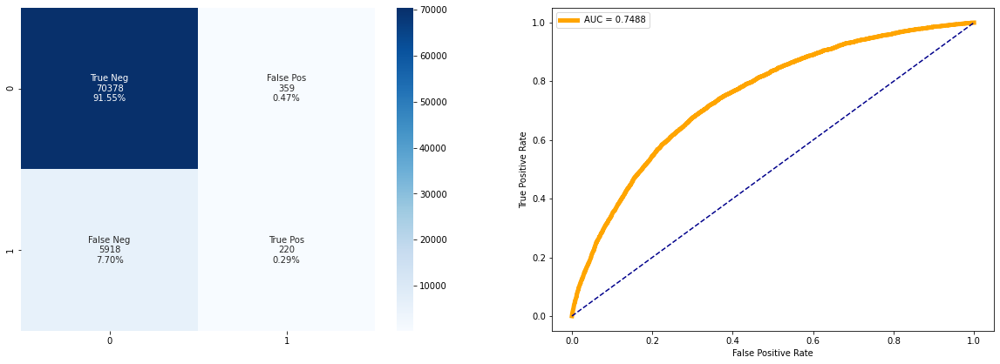

In [58]:
y_pred_l = Pipeline_lgb.predict(x_valid)
y_pred_l_proba = Pipeline_lgb.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(Pipeline_lgb, y_valid, y_pred_l, y_pred_l_proba[:,1])

Catboost Model roc_auc_score: 0.7657


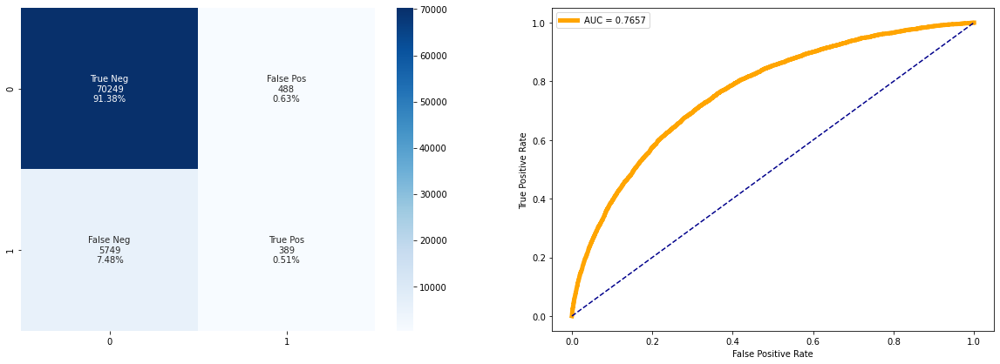

In [59]:
y_pred_c = Pipeline_cat.predict(x_valid)
y_pred_c_proba = Pipeline_cat.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_c_proba[:,1])
print('Catboost Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(Pipeline_cat, y_valid, y_pred_c, y_pred_c_proba[:,1])

XGBoost Model roc_auc_score: 0.7511


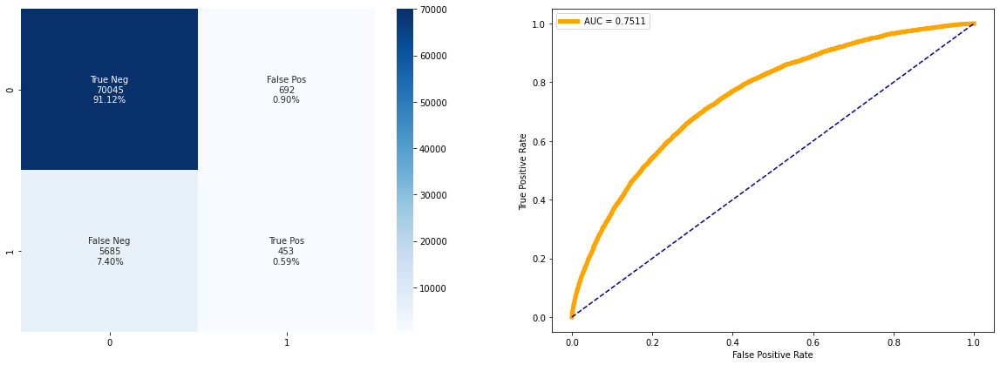

In [60]:
y_pred_x = Pipeline_xg.predict(x_valid)
y_pred_x_proba = Pipeline_xg.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_x_proba[:,1])
print('XGBoost Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(Pipeline_xg, y_valid, y_pred_x, y_pred_x_proba[:,1])

## Construction de la métrique métier 

In [61]:
def metric_score(y_true, y_pred):
    #rate_tn=1 
    #rate_fp=0 
    #rate_fn=-10
    #rate_tp=0
    
    rate_tn=1 
    rate_fp=0 
    rate_fn=-5
    rate_tp=0
    # Matrice de Confusion
    # tn: true neg, fl:false pos, fn : false neg, true pos
    (tn, fp, fn, tp) = metrics.confusion_matrix(y_true, y_pred).ravel()
    # Gain total
    gain_tot = tn * rate_tn + fp * rate_fp + fn * rate_fn + tp * rate_tp
    # Gain maximum
    gain_max = (fp + tn) * rate_tn + (fn + tp) * rate_tp
    # Gain minimum
    gain_min = (fp + tn) * rate_fp + (fn + tp) * rate_fn
    
    # Gain normalisé (entre 0 et 1) Greater is better
    return (gain_tot - gain_min) / (gain_max - gain_min)

#metric_score = make_scorer(metric_score, greater_is_better=True)



## Modèles hyperparamétrages OPTUNA 

In [62]:
from sklearn.utils import resample

### En fonction de l'AUC

#### LightGBM

In [63]:
def objective_lightGBM_auc(trial): 
    train_x, valid_x, train_y, valid_y = train_test_split(train_selec_boost, y, test_size=0.2)
    sc = StandardScaler()
    train_x = sc.fit_transform(train_x)
    valid_x= sc.transform(valid_x)
    sm = SMOTE(random_state = 2)
    train_x, train_y = sm.fit_sample(train_x, train_y.ravel())

    #dtrain = lgb.Dataset(train_x, label=train_y)
    #dvalid = lgb.Dataset(valid_x, label=valid_y)

    #metric_score = make_scorer(metric_score, greater_is_better=True)

    param = {
        # "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "n_estimators": trial.suggest_categorical("n_estimators", [10000]),
        "metric":"auc",
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 200, 10000, step=100),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
        "bagging_fraction", 0.2, 0.95, step=0.1,
        
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [1]),
        "feature_fraction": trial.suggest_float(
        "feature_fraction", 0.2, 0.95, step=0.1
        
        ),
    }


    # Add a callback for pruning.

    pruning_callback = optuna.integration.LightGBMPruningCallback(trial, 'auc')
    gbm = lgb.LGBMClassifier(**param, refit=True)
    gbm.fit(train_x, train_y)
    
    preds = gbm.predict(valid_x)
    pred_labels = np.rint(preds)
    #custom_metric = metric_score(valid_y,pred_labels)
    #print('custom_metric of LightGBM =', custom_metric)
    #return roc_auc_score(valid_y, gbm.predict_proba(valid_x)[:,1])
    return cross_val_score(gbm, valid_x, valid_y, scoring='roc_auc', cv=5).mean()

In [64]:
study_auc = optuna.create_study(direction="maximize", study_name="LGBM Classifier")
study_auc.optimize(objective_lightGBM_auc, n_trials=20)

[I 2021-12-03 16:42:53,275] A new study created in memory with name: LGBM Classifier
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] min_gain_to_split is set=3.5325501183377908, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.5325501183377908
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0

[I 2021-12-03 16:49:55,473] Trial 0 finished with value: 0.7561600106956081 and parameters: {'n_estimators': 10000, 'learning_rate': 0.2773390875146418, 'num_leaves': 2320, 'max_depth': 7, 'min_data_in_leaf': 1200, 'lambda_l1': 50, 'lambda_l2': 80, 'min_gain_to_split': 3.5325501183377908, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 0 with value: 0.7561600106956081.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] min_gain_to_split is set=0.10731961563311965, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.10731961563311965
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be

[I 2021-12-03 17:03:17,682] Trial 1 finished with value: 0.7450259513735229 and parameters: {'n_estimators': 10000, 'learning_rate': 0.023225693620094363, 'num_leaves': 1740, 'max_depth': 11, 'min_data_in_leaf': 700, 'lambda_l1': 70, 'lambda_l2': 5, 'min_gain_to_split': 0.10731961563311965, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 0 with value: 0.7561600106956081.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=2100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2100
[LightGBM] [Warning] min_gain_to_split is set=8.798261961996868, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.798261961996868
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will 

[I 2021-12-03 17:07:17,942] Trial 2 finished with value: 0.739708714687102 and parameters: {'n_estimators': 10000, 'learning_rate': 0.019454910754248246, 'num_leaves': 1280, 'max_depth': 11, 'min_data_in_leaf': 2100, 'lambda_l1': 20, 'lambda_l2': 100, 'min_gain_to_split': 8.798261961996868, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 0 with value: 0.7561600106956081.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=8600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8600
[LightGBM] [Warning] min_gain_to_split is set=12.410112930884605, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.410112930884605
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will 

[I 2021-12-03 17:14:22,327] Trial 3 finished with value: 0.7352909703356276 and parameters: {'n_estimators': 10000, 'learning_rate': 0.10926623965537342, 'num_leaves': 1600, 'max_depth': 8, 'min_data_in_leaf': 8600, 'lambda_l1': 45, 'lambda_l2': 85, 'min_gain_to_split': 12.410112930884605, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 0 with value: 0.7561600106956081.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4500
[LightGBM] [Warning] min_gain_to_split is set=5.238060558137647, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.238060558137647
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, 

[I 2021-12-03 17:27:25,501] Trial 4 finished with value: 0.7652530193326771 and parameters: {'n_estimators': 10000, 'learning_rate': 0.03928263737144597, 'num_leaves': 1360, 'max_depth': 3, 'min_data_in_leaf': 4500, 'lambda_l1': 5, 'lambda_l2': 80, 'min_gain_to_split': 5.238060558137647, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 4 with value: 0.7652530193326771.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=1700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1700
[LightGBM] [Warning] min_gain_to_split is set=0.2914363753960142, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2914363753960142
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be

[I 2021-12-03 17:36:21,825] Trial 5 finished with value: 0.7216601263792801 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11215835557300174, 'num_leaves': 1480, 'max_depth': 6, 'min_data_in_leaf': 1700, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 0.2914363753960142, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 4 with value: 0.7652530193326771.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] min_gain_to_split is set=1.3866766816004121, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3866766816004121
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be

[I 2021-12-03 17:46:36,484] Trial 6 finished with value: 0.7711084777036046 and parameters: {'n_estimators': 10000, 'learning_rate': 0.10089722978741644, 'num_leaves': 160, 'max_depth': 5, 'min_data_in_leaf': 900, 'lambda_l1': 45, 'lambda_l2': 30, 'min_gain_to_split': 1.3866766816004121, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=4500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4500
[LightGBM] [Warning] min_gain_to_split is set=3.4162730316710803, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.4162730316710803
[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will 

[I 2021-12-03 17:51:50,150] Trial 7 finished with value: 0.7275353126008952 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21707164134464232, 'num_leaves': 2820, 'max_depth': 5, 'min_data_in_leaf': 4500, 'lambda_l1': 95, 'lambda_l2': 45, 'min_gain_to_split': 3.4162730316710803, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=3100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3100
[LightGBM] [Warning] min_gain_to_split is set=9.596726351362657, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.596726351362657
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be

[I 2021-12-03 18:02:21,391] Trial 8 finished with value: 0.7452328800675525 and parameters: {'n_estimators': 10000, 'learning_rate': 0.06498485002638771, 'num_leaves': 440, 'max_depth': 5, 'min_data_in_leaf': 3100, 'lambda_l1': 45, 'lambda_l2': 35, 'min_gain_to_split': 9.596726351362657, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=6000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6000
[LightGBM] [Warning] min_gain_to_split is set=5.149792834582102, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.149792834582102
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be

[I 2021-12-03 18:12:04,537] Trial 9 finished with value: 0.743715525955878 and parameters: {'n_estimators': 10000, 'learning_rate': 0.12824074843813324, 'num_leaves': 1880, 'max_depth': 3, 'min_data_in_leaf': 6000, 'lambda_l1': 45, 'lambda_l2': 15, 'min_gain_to_split': 5.149792834582102, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=7300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7300
[LightGBM] [Warning] min_gain_to_split is set=13.573168469507987, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.573168469507987
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will 

[I 2021-12-03 18:20:23,273] Trial 10 finished with value: 0.7413274622373415 and parameters: {'n_estimators': 10000, 'learning_rate': 0.18891327782318063, 'num_leaves': 100, 'max_depth': 9, 'min_data_in_leaf': 7300, 'lambda_l1': 75, 'lambda_l2': 25, 'min_gain_to_split': 13.573168469507987, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=3600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3600
[LightGBM] [Warning] min_gain_to_split is set=5.9657547669328315, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.9657547669328315
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will 

[I 2021-12-03 18:29:37,214] Trial 11 finished with value: 0.7625571251911969 and parameters: {'n_estimators': 10000, 'learning_rate': 0.06542198856234101, 'num_leaves': 800, 'max_depth': 3, 'min_data_in_leaf': 3600, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 5.9657547669328315, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=9900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9900
[LightGBM] [Warning] min_gain_to_split is set=2.136422593761223, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.136422593761223
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be

[I 2021-12-03 18:36:59,157] Trial 12 finished with value: 0.7540375602198097 and parameters: {'n_estimators': 10000, 'learning_rate': 0.0668705785285018, 'num_leaves': 900, 'max_depth': 4, 'min_data_in_leaf': 9900, 'lambda_l1': 25, 'lambda_l2': 50, 'min_gain_to_split': 2.136422593761223, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=5700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5700
[LightGBM] [Warning] min_gain_to_split is set=6.648075026975243, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.648075026975243
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will 

[I 2021-12-03 18:49:05,109] Trial 13 finished with value: 0.7490974031509502 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16721286543382838, 'num_leaves': 20, 'max_depth': 5, 'min_data_in_leaf': 5700, 'lambda_l1': 30, 'lambda_l2': 100, 'min_gain_to_split': 6.648075026975243, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] min_gain_to_split is set=2.3172101058955072, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.3172101058955072
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6

[I 2021-12-03 18:57:34,246] Trial 14 finished with value: 0.7592319764717084 and parameters: {'n_estimators': 10000, 'learning_rate': 0.07809672408501618, 'num_leaves': 940, 'max_depth': 3, 'min_data_in_leaf': 200, 'lambda_l1': 70, 'lambda_l2': 30, 'min_gain_to_split': 2.3172101058955072, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 6 with value: 0.7711084777036046.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3000
[LightGBM] [Warning] min_gain_to_split is set=4.741156511368277, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.741156511368277
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be i

[I 2021-12-03 19:11:28,488] Trial 15 finished with value: 0.7736857652721822 and parameters: {'n_estimators': 10000, 'learning_rate': 0.02885102531058624, 'num_leaves': 2180, 'max_depth': 6, 'min_data_in_leaf': 3000, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 4.741156511368277, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 15 with value: 0.7736857652721822.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=2700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2700
[LightGBM] [Warning] min_gain_to_split is set=8.10328416176297, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.10328416176297
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0

[I 2021-12-03 19:23:10,084] Trial 16 finished with value: 0.7426668025314755 and parameters: {'n_estimators': 10000, 'learning_rate': 0.13370973339912814, 'num_leaves': 2280, 'max_depth': 7, 'min_data_in_leaf': 2700, 'lambda_l1': 100, 'lambda_l2': 40, 'min_gain_to_split': 8.10328416176297, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 15 with value: 0.7736857652721822.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3800
[LightGBM] [Warning] min_gain_to_split is set=3.4200864173637626, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.4200864173637626
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0

[I 2021-12-03 19:35:33,322] Trial 17 finished with value: 0.7691453938263721 and parameters: {'n_estimators': 10000, 'learning_rate': 0.08558713174287388, 'num_leaves': 2780, 'max_depth': 9, 'min_data_in_leaf': 3800, 'lambda_l1': 35, 'lambda_l2': 60, 'min_gain_to_split': 3.4200864173637626, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 15 with value: 0.7736857652721822.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=2200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2200
[LightGBM] [Warning] min_gain_to_split is set=1.9476804505351968, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9476804505351968
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0

[I 2021-12-03 19:47:37,905] Trial 18 finished with value: 0.7662813080157385 and parameters: {'n_estimators': 10000, 'learning_rate': 0.23649419762482804, 'num_leaves': 2160, 'max_depth': 8, 'min_data_in_leaf': 2200, 'lambda_l1': 60, 'lambda_l2': 0, 'min_gain_to_split': 1.9476804505351968, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 15 with value: 0.7736857652721822.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] min_gain_to_split is set=9.924588105628743, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.924588105628743
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6

[I 2021-12-03 19:53:43,655] Trial 19 finished with value: 0.7579308778903371 and parameters: {'n_estimators': 10000, 'learning_rate': 0.039475511024630774, 'num_leaves': 2540, 'max_depth': 6, 'min_data_in_leaf': 1200, 'lambda_l1': 15, 'lambda_l2': 20, 'min_gain_to_split': 9.924588105628743, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 15 with value: 0.7736857652721822.


In [65]:
lgb_model_auc = lgb.LGBMClassifier(**study_auc.best_params)
lgb_model_auc.fit(X_train, Y_train)

[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3000
[LightGBM] [Warning] min_gain_to_split is set=4.741156511368277, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.741156511368277
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


LGBMClassifier(bagging_fraction=0.8, bagging_freq=1, feature_fraction=0.4,
               lambda_l1=0, lambda_l2=60, learning_rate=0.02885102531058624,
               max_depth=6, min_data_in_leaf=3000,
               min_gain_to_split=4.741156511368277, n_estimators=10000,
               num_leaves=2180)

In [66]:
output_lgb_optuna_auc = {
  'AUC': roc_auc_score(y_valid,lgb_model_auc.predict_proba(x_valid)[:,1]),
  'Accuracy': metrics.accuracy_score(y_valid, lgb_model_auc.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, lgb_model_auc.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, lgb_model_auc.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, lgb_model_auc.predict(x_valid)),
  'bank_metric_score': metric_score(y_valid, lgb_model_auc.predict(x_valid))
  }

lighGBM Model roc_auc_score: 0.7681


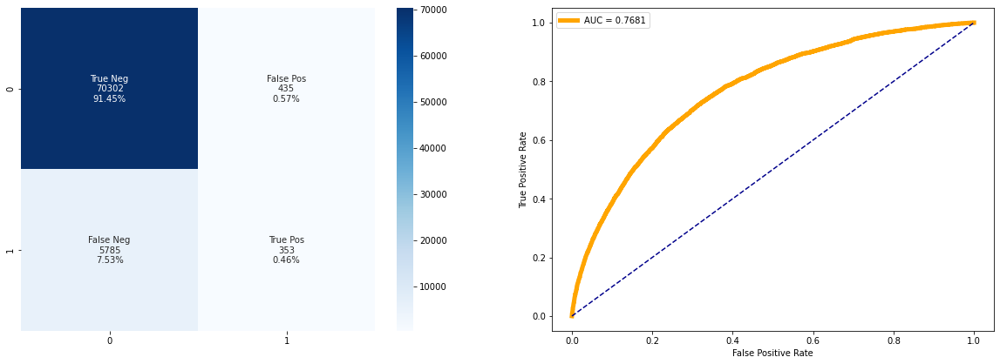

In [67]:
y_pred_l_auc = lgb_model_auc.predict(x_valid)
y_pred_l_proba_auc = lgb_model_auc.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba_auc[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(lgb_model_auc, y_valid, y_pred_l_auc, y_pred_l_proba_auc[:,1])

#### CatBoost

In [68]:
def objective_cat_auc(trial):
    train_x, valid_x, train_y, valid_y = train_test_split(train_selec_boost, y, test_size=0.2)
    sc = StandardScaler()
    train_x = sc.fit_transform(train_x)
    valid_x= sc.transform(valid_x)

    sm = SMOTE(random_state = 2)
    train_x, train_y = sm.fit_sample(train_x, train_y.ravel())

    param = {
        "objective": trial.suggest_categorical("objective", ["Logloss", "CrossEntropy"]),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        "depth": trial.suggest_int("depth", 1, 12),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical(
        "bootstrap_type", ["Bayesian", "Bernoulli", "MVS"],
        
        ),
        "used_ram_limit": "3gb"

    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    #pruning_callback = optuna.integration.LightGBMPruningCallback(trial, 'metric_score')
    gbm = ctb.CatBoostClassifier(eval_metric = 'AUC',**param)

    gbm.fit(train_x, train_y, eval_set=[(valid_x, valid_y)], verbose=0, early_stopping_rounds=100)

    preds = gbm.predict(valid_x)
    pred_labels = np.rint(preds)
 
    #return roc_auc_score(valid_y, gbm.predict_proba(valid_x)[:,1])
    return cross_val_score(gbm, valid_x, valid_y, scoring='roc_auc', cv=5).mean()

In [69]:
study_cat_auc = optuna.create_study(direction="maximize", study_name="CatBoostClassifier")
study_cat_auc.optimize(objective_cat_auc, n_trials=20)

[I 2021-12-03 20:05:34,501] A new study created in memory with name: CatBoostClassifier


0:	total: 18.8ms	remaining: 18.7s
1:	total: 37.1ms	remaining: 18.5s
2:	total: 55.9ms	remaining: 18.6s
3:	total: 75.2ms	remaining: 18.7s
4:	total: 96.2ms	remaining: 19.1s
5:	total: 117ms	remaining: 19.4s
6:	total: 137ms	remaining: 19.5s
7:	total: 158ms	remaining: 19.6s
8:	total: 178ms	remaining: 19.7s
9:	total: 200ms	remaining: 19.8s
10:	total: 222ms	remaining: 20s
11:	total: 244ms	remaining: 20.1s
12:	total: 265ms	remaining: 20.2s
13:	total: 287ms	remaining: 20.2s
14:	total: 309ms	remaining: 20.3s
15:	total: 331ms	remaining: 20.3s
16:	total: 354ms	remaining: 20.5s
17:	total: 377ms	remaining: 20.6s
18:	total: 399ms	remaining: 20.6s
19:	total: 423ms	remaining: 20.7s
20:	total: 445ms	remaining: 20.7s
21:	total: 467ms	remaining: 20.8s
22:	total: 491ms	remaining: 20.9s
23:	total: 512ms	remaining: 20.8s
24:	total: 535ms	remaining: 20.9s
25:	total: 558ms	remaining: 20.9s
26:	total: 583ms	remaining: 21s
27:	total: 608ms	remaining: 21.1s
28:	total: 633ms	remaining: 21.2s
29:	total: 656ms	remain

240:	total: 7.44s	remaining: 23.4s
241:	total: 7.52s	remaining: 23.6s
242:	total: 7.57s	remaining: 23.6s
243:	total: 7.59s	remaining: 23.5s
244:	total: 7.67s	remaining: 23.6s
245:	total: 7.69s	remaining: 23.6s
246:	total: 7.71s	remaining: 23.5s
247:	total: 7.73s	remaining: 23.4s
248:	total: 7.75s	remaining: 23.4s
249:	total: 7.77s	remaining: 23.3s
250:	total: 7.8s	remaining: 23.3s
251:	total: 7.85s	remaining: 23.3s
252:	total: 7.91s	remaining: 23.4s
253:	total: 7.98s	remaining: 23.4s
254:	total: 8.04s	remaining: 23.5s
255:	total: 8.09s	remaining: 23.5s
256:	total: 8.13s	remaining: 23.5s
257:	total: 8.2s	remaining: 23.6s
258:	total: 8.25s	remaining: 23.6s
259:	total: 8.29s	remaining: 23.6s
260:	total: 8.35s	remaining: 23.6s
261:	total: 8.39s	remaining: 23.6s
262:	total: 8.45s	remaining: 23.7s
263:	total: 8.51s	remaining: 23.7s
264:	total: 8.54s	remaining: 23.7s
265:	total: 8.56s	remaining: 23.6s
266:	total: 8.58s	remaining: 23.6s
267:	total: 8.61s	remaining: 23.5s
268:	total: 8.63s	rema

483:	total: 13.8s	remaining: 14.7s
484:	total: 13.8s	remaining: 14.7s
485:	total: 13.9s	remaining: 14.7s
486:	total: 13.9s	remaining: 14.6s
487:	total: 13.9s	remaining: 14.6s
488:	total: 13.9s	remaining: 14.6s
489:	total: 14s	remaining: 14.5s
490:	total: 14s	remaining: 14.5s
491:	total: 14s	remaining: 14.5s
492:	total: 14s	remaining: 14.4s
493:	total: 14.1s	remaining: 14.4s
494:	total: 14.1s	remaining: 14.4s
495:	total: 14.1s	remaining: 14.4s
496:	total: 14.1s	remaining: 14.3s
497:	total: 14.2s	remaining: 14.3s
498:	total: 14.2s	remaining: 14.3s
499:	total: 14.2s	remaining: 14.2s
500:	total: 14.3s	remaining: 14.2s
501:	total: 14.3s	remaining: 14.2s
502:	total: 14.3s	remaining: 14.1s
503:	total: 14.3s	remaining: 14.1s
504:	total: 14.4s	remaining: 14.1s
505:	total: 14.4s	remaining: 14s
506:	total: 14.4s	remaining: 14s
507:	total: 14.4s	remaining: 14s
508:	total: 14.5s	remaining: 14s
509:	total: 14.5s	remaining: 13.9s
510:	total: 14.5s	remaining: 13.9s
511:	total: 14.5s	remaining: 13.9s
5

725:	total: 19.9s	remaining: 7.52s
726:	total: 20s	remaining: 7.49s
727:	total: 20s	remaining: 7.47s
728:	total: 20s	remaining: 7.44s
729:	total: 20s	remaining: 7.41s
730:	total: 20.1s	remaining: 7.38s
731:	total: 20.1s	remaining: 7.35s
732:	total: 20.1s	remaining: 7.33s
733:	total: 20.1s	remaining: 7.3s
734:	total: 20.2s	remaining: 7.27s
735:	total: 20.2s	remaining: 7.24s
736:	total: 20.2s	remaining: 7.21s
737:	total: 20.2s	remaining: 7.18s
738:	total: 20.3s	remaining: 7.16s
739:	total: 20.3s	remaining: 7.13s
740:	total: 20.3s	remaining: 7.1s
741:	total: 20.3s	remaining: 7.07s
742:	total: 20.4s	remaining: 7.04s
743:	total: 20.4s	remaining: 7.01s
744:	total: 20.4s	remaining: 6.99s
745:	total: 20.5s	remaining: 6.96s
746:	total: 20.5s	remaining: 6.94s
747:	total: 20.5s	remaining: 6.91s
748:	total: 20.5s	remaining: 6.88s
749:	total: 20.6s	remaining: 6.86s
750:	total: 20.6s	remaining: 6.83s
751:	total: 20.7s	remaining: 6.81s
752:	total: 20.7s	remaining: 6.79s
753:	total: 20.7s	remaining: 6

962:	total: 27.6s	remaining: 1.06s
963:	total: 27.6s	remaining: 1.03s
964:	total: 27.6s	remaining: 1s
965:	total: 27.7s	remaining: 974ms
966:	total: 27.7s	remaining: 945ms
967:	total: 27.7s	remaining: 916ms
968:	total: 27.7s	remaining: 888ms
969:	total: 27.8s	remaining: 859ms
970:	total: 27.8s	remaining: 830ms
971:	total: 27.8s	remaining: 801ms
972:	total: 27.8s	remaining: 773ms
973:	total: 27.9s	remaining: 744ms
974:	total: 27.9s	remaining: 715ms
975:	total: 27.9s	remaining: 687ms
976:	total: 28s	remaining: 658ms
977:	total: 28s	remaining: 629ms
978:	total: 28s	remaining: 601ms
979:	total: 28s	remaining: 572ms
980:	total: 28s	remaining: 543ms
981:	total: 28.1s	remaining: 515ms
982:	total: 28.1s	remaining: 486ms
983:	total: 28.1s	remaining: 457ms
984:	total: 28.1s	remaining: 429ms
985:	total: 28.2s	remaining: 400ms
986:	total: 28.2s	remaining: 371ms
987:	total: 28.2s	remaining: 343ms
988:	total: 28.2s	remaining: 314ms
989:	total: 28.3s	remaining: 285ms
990:	total: 28.3s	remaining: 257m

205:	total: 5.23s	remaining: 20.2s
206:	total: 5.26s	remaining: 20.2s
207:	total: 5.29s	remaining: 20.1s
208:	total: 5.31s	remaining: 20.1s
209:	total: 5.34s	remaining: 20.1s
210:	total: 5.37s	remaining: 20.1s
211:	total: 5.4s	remaining: 20.1s
212:	total: 5.43s	remaining: 20.1s
213:	total: 5.46s	remaining: 20s
214:	total: 5.5s	remaining: 20.1s
215:	total: 5.53s	remaining: 20.1s
216:	total: 5.57s	remaining: 20.1s
217:	total: 5.6s	remaining: 20.1s
218:	total: 5.64s	remaining: 20.1s
219:	total: 5.67s	remaining: 20.1s
220:	total: 5.7s	remaining: 20.1s
221:	total: 5.73s	remaining: 20.1s
222:	total: 5.75s	remaining: 20.1s
223:	total: 5.79s	remaining: 20.1s
224:	total: 5.84s	remaining: 20.1s
225:	total: 5.9s	remaining: 20.2s
226:	total: 5.96s	remaining: 20.3s
227:	total: 5.99s	remaining: 20.3s
228:	total: 6.05s	remaining: 20.4s
229:	total: 6.09s	remaining: 20.4s
230:	total: 6.15s	remaining: 20.5s
231:	total: 6.21s	remaining: 20.5s
232:	total: 6.26s	remaining: 20.6s
233:	total: 6.33s	remaining

445:	total: 13.1s	remaining: 16.2s
446:	total: 13.1s	remaining: 16.2s
447:	total: 13.1s	remaining: 16.2s
448:	total: 13.1s	remaining: 16.1s
449:	total: 13.2s	remaining: 16.1s
450:	total: 13.2s	remaining: 16.1s
451:	total: 13.2s	remaining: 16s
452:	total: 13.2s	remaining: 16s
453:	total: 13.3s	remaining: 16s
454:	total: 13.3s	remaining: 15.9s
455:	total: 13.3s	remaining: 15.9s
456:	total: 13.3s	remaining: 15.8s
457:	total: 13.4s	remaining: 15.8s
458:	total: 13.4s	remaining: 15.8s
459:	total: 13.4s	remaining: 15.7s
460:	total: 13.4s	remaining: 15.7s
461:	total: 13.5s	remaining: 15.7s
462:	total: 13.5s	remaining: 15.6s
463:	total: 13.5s	remaining: 15.6s
464:	total: 13.5s	remaining: 15.6s
465:	total: 13.6s	remaining: 15.5s
466:	total: 13.6s	remaining: 15.5s
467:	total: 13.6s	remaining: 15.5s
468:	total: 13.6s	remaining: 15.4s
469:	total: 13.7s	remaining: 15.4s
470:	total: 13.7s	remaining: 15.4s
471:	total: 13.7s	remaining: 15.4s
472:	total: 13.8s	remaining: 15.3s
473:	total: 13.8s	remainin

689:	total: 19.3s	remaining: 8.68s
690:	total: 19.3s	remaining: 8.65s
691:	total: 19.4s	remaining: 8.62s
692:	total: 19.4s	remaining: 8.59s
693:	total: 19.4s	remaining: 8.56s
694:	total: 19.4s	remaining: 8.53s
695:	total: 19.5s	remaining: 8.5s
696:	total: 19.5s	remaining: 8.47s
697:	total: 19.5s	remaining: 8.45s
698:	total: 19.6s	remaining: 8.42s
699:	total: 19.6s	remaining: 8.39s
700:	total: 19.6s	remaining: 8.36s
701:	total: 19.6s	remaining: 8.33s
702:	total: 19.7s	remaining: 8.3s
703:	total: 19.7s	remaining: 8.27s
704:	total: 19.7s	remaining: 8.24s
705:	total: 19.7s	remaining: 8.21s
706:	total: 19.8s	remaining: 8.19s
707:	total: 19.8s	remaining: 8.16s
708:	total: 19.8s	remaining: 8.13s
709:	total: 19.8s	remaining: 8.1s
710:	total: 19.9s	remaining: 8.07s
711:	total: 19.9s	remaining: 8.04s
712:	total: 19.9s	remaining: 8.01s
713:	total: 19.9s	remaining: 7.98s
714:	total: 19.9s	remaining: 7.95s
715:	total: 20s	remaining: 7.92s
716:	total: 20s	remaining: 7.89s
717:	total: 20s	remaining: 

926:	total: 27s	remaining: 2.13s
927:	total: 27s	remaining: 2.1s
928:	total: 27.1s	remaining: 2.07s
929:	total: 27.1s	remaining: 2.04s
930:	total: 27.1s	remaining: 2.01s
931:	total: 27.1s	remaining: 1.98s
932:	total: 27.1s	remaining: 1.95s
933:	total: 27.2s	remaining: 1.92s
934:	total: 27.2s	remaining: 1.89s
935:	total: 27.2s	remaining: 1.86s
936:	total: 27.2s	remaining: 1.83s
937:	total: 27.3s	remaining: 1.8s
938:	total: 27.3s	remaining: 1.77s
939:	total: 27.3s	remaining: 1.74s
940:	total: 27.3s	remaining: 1.71s
941:	total: 27.4s	remaining: 1.68s
942:	total: 27.4s	remaining: 1.66s
943:	total: 27.4s	remaining: 1.63s
944:	total: 27.4s	remaining: 1.6s
945:	total: 27.5s	remaining: 1.57s
946:	total: 27.5s	remaining: 1.54s
947:	total: 27.5s	remaining: 1.51s
948:	total: 27.5s	remaining: 1.48s
949:	total: 27.6s	remaining: 1.45s
950:	total: 27.6s	remaining: 1.42s
951:	total: 27.6s	remaining: 1.39s
952:	total: 27.6s	remaining: 1.36s
953:	total: 27.7s	remaining: 1.33s
954:	total: 27.7s	remaining

169:	total: 5.12s	remaining: 25s
170:	total: 5.16s	remaining: 25s
171:	total: 5.19s	remaining: 25s
172:	total: 5.22s	remaining: 25s
173:	total: 5.25s	remaining: 24.9s
174:	total: 5.29s	remaining: 24.9s
175:	total: 5.33s	remaining: 24.9s
176:	total: 5.36s	remaining: 24.9s
177:	total: 5.39s	remaining: 24.9s
178:	total: 5.43s	remaining: 24.9s
179:	total: 5.46s	remaining: 24.9s
180:	total: 5.5s	remaining: 24.9s
181:	total: 5.54s	remaining: 24.9s
182:	total: 5.57s	remaining: 24.9s
183:	total: 5.6s	remaining: 24.8s
184:	total: 5.63s	remaining: 24.8s
185:	total: 5.67s	remaining: 24.8s
186:	total: 5.7s	remaining: 24.8s
187:	total: 5.74s	remaining: 24.8s
188:	total: 5.77s	remaining: 24.8s
189:	total: 5.8s	remaining: 24.8s
190:	total: 5.84s	remaining: 24.7s
191:	total: 5.87s	remaining: 24.7s
192:	total: 5.9s	remaining: 24.7s
193:	total: 5.95s	remaining: 24.7s
194:	total: 6s	remaining: 24.7s
195:	total: 6.05s	remaining: 24.8s
196:	total: 6.09s	remaining: 24.8s
197:	total: 6.12s	remaining: 24.8s
1

406:	total: 14.5s	remaining: 21.1s
407:	total: 14.5s	remaining: 21s
408:	total: 14.5s	remaining: 21s
409:	total: 14.5s	remaining: 20.9s
410:	total: 14.6s	remaining: 20.9s
411:	total: 14.6s	remaining: 20.8s
412:	total: 14.6s	remaining: 20.8s
413:	total: 14.6s	remaining: 20.7s
414:	total: 14.7s	remaining: 20.7s
415:	total: 14.7s	remaining: 20.6s
416:	total: 14.7s	remaining: 20.6s
417:	total: 14.7s	remaining: 20.5s
418:	total: 14.8s	remaining: 20.5s
419:	total: 14.8s	remaining: 20.4s
420:	total: 14.8s	remaining: 20.4s
421:	total: 14.8s	remaining: 20.3s
422:	total: 14.9s	remaining: 20.3s
423:	total: 14.9s	remaining: 20.2s
424:	total: 14.9s	remaining: 20.2s
425:	total: 14.9s	remaining: 20.1s
426:	total: 15s	remaining: 20.1s
427:	total: 15s	remaining: 20s
428:	total: 15s	remaining: 20s
429:	total: 15s	remaining: 19.9s
430:	total: 15.1s	remaining: 19.9s
431:	total: 15.1s	remaining: 19.8s
432:	total: 15.1s	remaining: 19.8s
433:	total: 15.1s	remaining: 19.7s
434:	total: 15.1s	remaining: 19.7s
4

648:	total: 20.7s	remaining: 11.2s
649:	total: 20.7s	remaining: 11.1s
650:	total: 20.7s	remaining: 11.1s
651:	total: 20.8s	remaining: 11.1s
652:	total: 20.8s	remaining: 11s
653:	total: 20.8s	remaining: 11s
654:	total: 20.8s	remaining: 11s
655:	total: 20.8s	remaining: 10.9s
656:	total: 20.9s	remaining: 10.9s
657:	total: 20.9s	remaining: 10.9s
658:	total: 20.9s	remaining: 10.8s
659:	total: 21s	remaining: 10.8s
660:	total: 21s	remaining: 10.8s
661:	total: 21s	remaining: 10.7s
662:	total: 21s	remaining: 10.7s
663:	total: 21.1s	remaining: 10.7s
664:	total: 21.1s	remaining: 10.6s
665:	total: 21.1s	remaining: 10.6s
666:	total: 21.1s	remaining: 10.6s
667:	total: 21.2s	remaining: 10.5s
668:	total: 21.2s	remaining: 10.5s
669:	total: 21.2s	remaining: 10.5s
670:	total: 21.3s	remaining: 10.4s
671:	total: 21.3s	remaining: 10.4s
672:	total: 21.3s	remaining: 10.4s
673:	total: 21.4s	remaining: 10.3s
674:	total: 21.4s	remaining: 10.3s
675:	total: 21.4s	remaining: 10.3s
676:	total: 21.5s	remaining: 10.2s

890:	total: 28.4s	remaining: 3.47s
891:	total: 28.4s	remaining: 3.44s
892:	total: 28.4s	remaining: 3.41s
893:	total: 28.5s	remaining: 3.38s
894:	total: 28.5s	remaining: 3.34s
895:	total: 28.5s	remaining: 3.31s
896:	total: 28.5s	remaining: 3.28s
897:	total: 28.6s	remaining: 3.24s
898:	total: 28.6s	remaining: 3.21s
899:	total: 28.6s	remaining: 3.18s
900:	total: 28.6s	remaining: 3.15s
901:	total: 28.7s	remaining: 3.11s
902:	total: 28.7s	remaining: 3.08s
903:	total: 28.7s	remaining: 3.05s
904:	total: 28.7s	remaining: 3.02s
905:	total: 28.8s	remaining: 2.98s
906:	total: 28.8s	remaining: 2.95s
907:	total: 28.8s	remaining: 2.92s
908:	total: 28.8s	remaining: 2.89s
909:	total: 28.9s	remaining: 2.85s
910:	total: 28.9s	remaining: 2.82s
911:	total: 28.9s	remaining: 2.79s
912:	total: 28.9s	remaining: 2.76s
913:	total: 28.9s	remaining: 2.72s
914:	total: 29s	remaining: 2.69s
915:	total: 29s	remaining: 2.66s
916:	total: 29s	remaining: 2.63s
917:	total: 29s	remaining: 2.59s
918:	total: 29.1s	remaining:

136:	total: 3.44s	remaining: 21.6s
137:	total: 3.46s	remaining: 21.6s
138:	total: 3.49s	remaining: 21.6s
139:	total: 3.53s	remaining: 21.7s
140:	total: 3.58s	remaining: 21.8s
141:	total: 3.62s	remaining: 21.9s
142:	total: 3.65s	remaining: 21.9s
143:	total: 3.67s	remaining: 21.8s
144:	total: 3.7s	remaining: 21.8s
145:	total: 3.72s	remaining: 21.8s
146:	total: 3.75s	remaining: 21.8s
147:	total: 3.81s	remaining: 21.9s
148:	total: 3.84s	remaining: 21.9s
149:	total: 3.87s	remaining: 21.9s
150:	total: 3.95s	remaining: 22.2s
151:	total: 4.03s	remaining: 22.5s
152:	total: 4.09s	remaining: 22.6s
153:	total: 4.14s	remaining: 22.7s
154:	total: 4.19s	remaining: 22.9s
155:	total: 4.28s	remaining: 23.1s
156:	total: 4.33s	remaining: 23.2s
157:	total: 4.37s	remaining: 23.3s
158:	total: 4.44s	remaining: 23.5s
159:	total: 4.48s	remaining: 23.5s
160:	total: 4.54s	remaining: 23.7s
161:	total: 4.61s	remaining: 23.9s
162:	total: 4.68s	remaining: 24s
163:	total: 4.75s	remaining: 24.2s
164:	total: 4.8s	remain

379:	total: 11.5s	remaining: 18.7s
380:	total: 11.5s	remaining: 18.7s
381:	total: 11.5s	remaining: 18.6s
382:	total: 11.5s	remaining: 18.6s
383:	total: 11.6s	remaining: 18.6s
384:	total: 11.6s	remaining: 18.5s
385:	total: 11.6s	remaining: 18.5s
386:	total: 11.6s	remaining: 18.4s
387:	total: 11.7s	remaining: 18.4s
388:	total: 11.7s	remaining: 18.4s
389:	total: 11.7s	remaining: 18.3s
390:	total: 11.7s	remaining: 18.3s
391:	total: 11.8s	remaining: 18.2s
392:	total: 11.8s	remaining: 18.2s
393:	total: 11.8s	remaining: 18.2s
394:	total: 11.8s	remaining: 18.1s
395:	total: 11.9s	remaining: 18.1s
396:	total: 11.9s	remaining: 18s
397:	total: 11.9s	remaining: 18s
398:	total: 11.9s	remaining: 18s
399:	total: 12s	remaining: 17.9s
400:	total: 12s	remaining: 17.9s
401:	total: 12s	remaining: 17.9s
402:	total: 12s	remaining: 17.8s
403:	total: 12.1s	remaining: 17.8s
404:	total: 12.1s	remaining: 17.7s
405:	total: 12.1s	remaining: 17.7s
406:	total: 12.1s	remaining: 17.7s
407:	total: 12.2s	remaining: 17.6s

617:	total: 17.4s	remaining: 10.7s
618:	total: 17.4s	remaining: 10.7s
619:	total: 17.4s	remaining: 10.7s
620:	total: 17.4s	remaining: 10.6s
621:	total: 17.5s	remaining: 10.6s
622:	total: 17.5s	remaining: 10.6s
623:	total: 17.5s	remaining: 10.6s
624:	total: 17.5s	remaining: 10.5s
625:	total: 17.6s	remaining: 10.5s
626:	total: 17.6s	remaining: 10.5s
627:	total: 17.6s	remaining: 10.4s
628:	total: 17.6s	remaining: 10.4s
629:	total: 17.7s	remaining: 10.4s
630:	total: 17.7s	remaining: 10.3s
631:	total: 17.7s	remaining: 10.3s
632:	total: 17.7s	remaining: 10.3s
633:	total: 17.8s	remaining: 10.3s
634:	total: 17.8s	remaining: 10.2s
635:	total: 17.8s	remaining: 10.2s
636:	total: 17.8s	remaining: 10.2s
637:	total: 17.9s	remaining: 10.1s
638:	total: 17.9s	remaining: 10.1s
639:	total: 17.9s	remaining: 10.1s
640:	total: 17.9s	remaining: 10s
641:	total: 18s	remaining: 10s
642:	total: 18s	remaining: 10s
643:	total: 18s	remaining: 9.97s
644:	total: 18.1s	remaining: 9.94s
645:	total: 18.1s	remaining: 9.9

856:	total: 25.1s	remaining: 4.19s
857:	total: 25.2s	remaining: 4.16s
858:	total: 25.2s	remaining: 4.13s
859:	total: 25.2s	remaining: 4.1s
860:	total: 25.2s	remaining: 4.07s
861:	total: 25.3s	remaining: 4.04s
862:	total: 25.3s	remaining: 4.01s
863:	total: 25.3s	remaining: 3.98s
864:	total: 25.3s	remaining: 3.95s
865:	total: 25.4s	remaining: 3.92s
866:	total: 25.4s	remaining: 3.89s
867:	total: 25.4s	remaining: 3.86s
868:	total: 25.4s	remaining: 3.83s
869:	total: 25.5s	remaining: 3.8s
870:	total: 25.5s	remaining: 3.77s
871:	total: 25.5s	remaining: 3.74s
872:	total: 25.5s	remaining: 3.71s
873:	total: 25.6s	remaining: 3.68s
874:	total: 25.6s	remaining: 3.65s
875:	total: 25.6s	remaining: 3.62s
876:	total: 25.6s	remaining: 3.59s
877:	total: 25.7s	remaining: 3.56s
878:	total: 25.7s	remaining: 3.54s
879:	total: 25.7s	remaining: 3.5s
880:	total: 25.7s	remaining: 3.48s
881:	total: 25.8s	remaining: 3.44s
882:	total: 25.8s	remaining: 3.42s
883:	total: 25.8s	remaining: 3.39s
884:	total: 25.8s	remai

98:	total: 2.53s	remaining: 23s
99:	total: 2.55s	remaining: 23s
100:	total: 2.58s	remaining: 22.9s
101:	total: 2.6s	remaining: 22.9s
102:	total: 2.62s	remaining: 22.8s
103:	total: 2.65s	remaining: 22.8s
104:	total: 2.67s	remaining: 22.8s
105:	total: 2.69s	remaining: 22.7s
106:	total: 2.71s	remaining: 22.7s
107:	total: 2.74s	remaining: 22.6s
108:	total: 2.76s	remaining: 22.6s
109:	total: 2.78s	remaining: 22.5s
110:	total: 2.8s	remaining: 22.5s
111:	total: 2.83s	remaining: 22.4s
112:	total: 2.85s	remaining: 22.4s
113:	total: 2.88s	remaining: 22.3s
114:	total: 2.9s	remaining: 22.3s
115:	total: 2.92s	remaining: 22.3s
116:	total: 2.95s	remaining: 22.2s
117:	total: 2.97s	remaining: 22.2s
118:	total: 3s	remaining: 22.2s
119:	total: 3.02s	remaining: 22.1s
120:	total: 3.04s	remaining: 22.1s
121:	total: 3.06s	remaining: 22.1s
122:	total: 3.09s	remaining: 22s
123:	total: 3.11s	remaining: 22s
124:	total: 3.13s	remaining: 21.9s
125:	total: 3.16s	remaining: 21.9s
126:	total: 3.18s	remaining: 21.9s
1

340:	total: 10.2s	remaining: 19.7s
341:	total: 10.2s	remaining: 19.7s
342:	total: 10.2s	remaining: 19.6s
343:	total: 10.3s	remaining: 19.6s
344:	total: 10.3s	remaining: 19.5s
345:	total: 10.3s	remaining: 19.5s
346:	total: 10.3s	remaining: 19.5s
347:	total: 10.4s	remaining: 19.4s
348:	total: 10.4s	remaining: 19.4s
349:	total: 10.4s	remaining: 19.3s
350:	total: 10.4s	remaining: 19.3s
351:	total: 10.5s	remaining: 19.3s
352:	total: 10.5s	remaining: 19.2s
353:	total: 10.5s	remaining: 19.2s
354:	total: 10.5s	remaining: 19.1s
355:	total: 10.6s	remaining: 19.1s
356:	total: 10.6s	remaining: 19.1s
357:	total: 10.6s	remaining: 19s
358:	total: 10.6s	remaining: 19s
359:	total: 10.7s	remaining: 19s
360:	total: 10.7s	remaining: 18.9s
361:	total: 10.7s	remaining: 18.9s
362:	total: 10.7s	remaining: 18.8s
363:	total: 10.8s	remaining: 18.8s
364:	total: 10.8s	remaining: 18.8s
365:	total: 10.8s	remaining: 18.7s
366:	total: 10.8s	remaining: 18.7s
367:	total: 10.8s	remaining: 18.6s
368:	total: 10.9s	remainin

579:	total: 15.9s	remaining: 11.5s
580:	total: 16s	remaining: 11.5s
581:	total: 16s	remaining: 11.5s
582:	total: 16s	remaining: 11.5s
583:	total: 16s	remaining: 11.4s
584:	total: 16.1s	remaining: 11.4s
585:	total: 16.1s	remaining: 11.4s
586:	total: 16.1s	remaining: 11.4s
587:	total: 16.2s	remaining: 11.3s
588:	total: 16.2s	remaining: 11.3s
589:	total: 16.2s	remaining: 11.3s
590:	total: 16.3s	remaining: 11.3s
591:	total: 16.3s	remaining: 11.2s
592:	total: 16.3s	remaining: 11.2s
593:	total: 16.3s	remaining: 11.2s
594:	total: 16.4s	remaining: 11.2s
595:	total: 16.4s	remaining: 11.1s
596:	total: 16.4s	remaining: 11.1s
597:	total: 16.5s	remaining: 11.1s
598:	total: 16.5s	remaining: 11s
599:	total: 16.5s	remaining: 11s
600:	total: 16.6s	remaining: 11s
601:	total: 16.6s	remaining: 11s
602:	total: 16.6s	remaining: 10.9s
603:	total: 16.6s	remaining: 10.9s
604:	total: 16.7s	remaining: 10.9s
605:	total: 16.7s	remaining: 10.9s
606:	total: 16.7s	remaining: 10.8s
607:	total: 16.8s	remaining: 10.8s
6

821:	total: 23.8s	remaining: 5.16s
822:	total: 23.8s	remaining: 5.13s
823:	total: 23.9s	remaining: 5.1s
824:	total: 23.9s	remaining: 5.07s
825:	total: 23.9s	remaining: 5.04s
826:	total: 23.9s	remaining: 5.01s
827:	total: 24s	remaining: 4.98s
828:	total: 24s	remaining: 4.95s
829:	total: 24s	remaining: 4.92s
830:	total: 24s	remaining: 4.89s
831:	total: 24.1s	remaining: 4.86s
832:	total: 24.1s	remaining: 4.83s
833:	total: 24.1s	remaining: 4.8s
834:	total: 24.1s	remaining: 4.77s
835:	total: 24.2s	remaining: 4.74s
836:	total: 24.2s	remaining: 4.71s
837:	total: 24.2s	remaining: 4.68s
838:	total: 24.2s	remaining: 4.65s
839:	total: 24.2s	remaining: 4.62s
840:	total: 24.3s	remaining: 4.59s
841:	total: 24.3s	remaining: 4.56s
842:	total: 24.3s	remaining: 4.53s
843:	total: 24.3s	remaining: 4.5s
844:	total: 24.4s	remaining: 4.47s
845:	total: 24.4s	remaining: 4.44s
846:	total: 24.4s	remaining: 4.41s
847:	total: 24.4s	remaining: 4.38s
848:	total: 24.5s	remaining: 4.35s
849:	total: 24.5s	remaining: 4.

[I 2021-12-03 20:11:48,872] Trial 0 finished with value: 0.7619478172313993 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.06406041257351403, 'depth': 4, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.18962906497123466}. Best is trial 0 with value: 0.7619478172313993.


Learning rate set to 0.054375
0:	total: 80.7ms	remaining: 1m 20s
1:	total: 142ms	remaining: 1m 10s
2:	total: 206ms	remaining: 1m 8s
3:	total: 277ms	remaining: 1m 8s
4:	total: 361ms	remaining: 1m 11s
5:	total: 454ms	remaining: 1m 15s
6:	total: 534ms	remaining: 1m 15s
7:	total: 608ms	remaining: 1m 15s
8:	total: 687ms	remaining: 1m 15s
9:	total: 774ms	remaining: 1m 16s
10:	total: 846ms	remaining: 1m 16s
11:	total: 931ms	remaining: 1m 16s
12:	total: 1.03s	remaining: 1m 18s
13:	total: 1.12s	remaining: 1m 19s
14:	total: 1.2s	remaining: 1m 18s
15:	total: 1.3s	remaining: 1m 19s
16:	total: 1.4s	remaining: 1m 20s
17:	total: 1.49s	remaining: 1m 21s
18:	total: 1.59s	remaining: 1m 21s
19:	total: 1.66s	remaining: 1m 21s
20:	total: 1.77s	remaining: 1m 22s
21:	total: 1.87s	remaining: 1m 23s
22:	total: 1.95s	remaining: 1m 22s
23:	total: 2.03s	remaining: 1m 22s
24:	total: 2.12s	remaining: 1m 22s
25:	total: 2.21s	remaining: 1m 22s
26:	total: 2.28s	remaining: 1m 22s
27:	total: 2.39s	remaining: 1m 22s
28:	

231:	total: 21.5s	remaining: 1m 11s
232:	total: 21.5s	remaining: 1m 10s
233:	total: 21.6s	remaining: 1m 10s
234:	total: 21.7s	remaining: 1m 10s
235:	total: 21.8s	remaining: 1m 10s
236:	total: 21.9s	remaining: 1m 10s
237:	total: 22s	remaining: 1m 10s
238:	total: 22.1s	remaining: 1m 10s
239:	total: 22.2s	remaining: 1m 10s
240:	total: 22.3s	remaining: 1m 10s
241:	total: 22.4s	remaining: 1m 10s
242:	total: 22.5s	remaining: 1m 9s
243:	total: 22.6s	remaining: 1m 9s
244:	total: 22.7s	remaining: 1m 9s
245:	total: 22.8s	remaining: 1m 9s
246:	total: 22.8s	remaining: 1m 9s
247:	total: 22.9s	remaining: 1m 9s
248:	total: 23s	remaining: 1m 9s
249:	total: 23.1s	remaining: 1m 9s
250:	total: 23.2s	remaining: 1m 9s
251:	total: 23.3s	remaining: 1m 9s
252:	total: 23.4s	remaining: 1m 9s
253:	total: 23.5s	remaining: 1m 9s
254:	total: 23.6s	remaining: 1m 8s
255:	total: 23.7s	remaining: 1m 8s
256:	total: 23.8s	remaining: 1m 8s
257:	total: 23.9s	remaining: 1m 8s
258:	total: 24s	remaining: 1m 8s
259:	total: 24.

470:	total: 44.5s	remaining: 50s
471:	total: 44.6s	remaining: 49.9s
472:	total: 44.7s	remaining: 49.8s
473:	total: 44.8s	remaining: 49.7s
474:	total: 44.9s	remaining: 49.6s
475:	total: 45s	remaining: 49.5s
476:	total: 45.1s	remaining: 49.4s
477:	total: 45.2s	remaining: 49.4s
478:	total: 45.4s	remaining: 49.4s
479:	total: 45.6s	remaining: 49.4s
480:	total: 45.9s	remaining: 49.6s
481:	total: 46.1s	remaining: 49.6s
482:	total: 46.3s	remaining: 49.5s
483:	total: 46.5s	remaining: 49.5s
484:	total: 46.6s	remaining: 49.5s
485:	total: 46.8s	remaining: 49.5s
486:	total: 47.1s	remaining: 49.6s
487:	total: 47.3s	remaining: 49.6s
488:	total: 47.5s	remaining: 49.6s
489:	total: 47.6s	remaining: 49.5s
490:	total: 47.6s	remaining: 49.3s
491:	total: 47.7s	remaining: 49.2s
492:	total: 47.8s	remaining: 49.1s
493:	total: 48.1s	remaining: 49.2s
494:	total: 48.3s	remaining: 49.2s
495:	total: 48.5s	remaining: 49.2s
496:	total: 48.5s	remaining: 49.1s
497:	total: 48.6s	remaining: 49s
498:	total: 48.7s	remainin

708:	total: 1m 8s	remaining: 28s
709:	total: 1m 8s	remaining: 27.9s
710:	total: 1m 8s	remaining: 27.8s
711:	total: 1m 8s	remaining: 27.7s
712:	total: 1m 8s	remaining: 27.6s
713:	total: 1m 8s	remaining: 27.5s
714:	total: 1m 8s	remaining: 27.4s
715:	total: 1m 8s	remaining: 27.3s
716:	total: 1m 8s	remaining: 27.2s
717:	total: 1m 9s	remaining: 27.1s
718:	total: 1m 9s	remaining: 27s
719:	total: 1m 9s	remaining: 26.9s
720:	total: 1m 9s	remaining: 26.8s
721:	total: 1m 9s	remaining: 26.7s
722:	total: 1m 9s	remaining: 26.6s
723:	total: 1m 9s	remaining: 26.5s
724:	total: 1m 9s	remaining: 26.4s
725:	total: 1m 9s	remaining: 26.3s
726:	total: 1m 9s	remaining: 26.2s
727:	total: 1m 9s	remaining: 26.1s
728:	total: 1m 9s	remaining: 26s
729:	total: 1m 9s	remaining: 25.9s
730:	total: 1m 10s	remaining: 25.8s
731:	total: 1m 10s	remaining: 25.7s
732:	total: 1m 10s	remaining: 25.6s
733:	total: 1m 10s	remaining: 25.5s
734:	total: 1m 10s	remaining: 25.4s
735:	total: 1m 10s	remaining: 25.3s
736:	total: 1m 10s	r

938:	total: 1m 29s	remaining: 5.8s
939:	total: 1m 29s	remaining: 5.71s
940:	total: 1m 29s	remaining: 5.62s
941:	total: 1m 29s	remaining: 5.52s
942:	total: 1m 29s	remaining: 5.42s
943:	total: 1m 29s	remaining: 5.33s
944:	total: 1m 29s	remaining: 5.23s
945:	total: 1m 29s	remaining: 5.14s
946:	total: 1m 30s	remaining: 5.04s
947:	total: 1m 30s	remaining: 4.94s
948:	total: 1m 30s	remaining: 4.85s
949:	total: 1m 30s	remaining: 4.75s
950:	total: 1m 30s	remaining: 4.66s
951:	total: 1m 30s	remaining: 4.56s
952:	total: 1m 30s	remaining: 4.46s
953:	total: 1m 30s	remaining: 4.37s
954:	total: 1m 30s	remaining: 4.27s
955:	total: 1m 30s	remaining: 4.18s
956:	total: 1m 30s	remaining: 4.08s
957:	total: 1m 30s	remaining: 3.99s
958:	total: 1m 31s	remaining: 3.89s
959:	total: 1m 31s	remaining: 3.8s
960:	total: 1m 31s	remaining: 3.7s
961:	total: 1m 31s	remaining: 3.6s
962:	total: 1m 31s	remaining: 3.51s
963:	total: 1m 31s	remaining: 3.42s
964:	total: 1m 31s	remaining: 3.32s
965:	total: 1m 31s	remaining: 3.

169:	total: 16.1s	remaining: 1m 18s
170:	total: 16.2s	remaining: 1m 18s
171:	total: 16.3s	remaining: 1m 18s
172:	total: 16.4s	remaining: 1m 18s
173:	total: 16.5s	remaining: 1m 18s
174:	total: 16.5s	remaining: 1m 17s
175:	total: 16.6s	remaining: 1m 17s
176:	total: 16.7s	remaining: 1m 17s
177:	total: 16.8s	remaining: 1m 17s
178:	total: 16.9s	remaining: 1m 17s
179:	total: 17s	remaining: 1m 17s
180:	total: 17s	remaining: 1m 17s
181:	total: 17.1s	remaining: 1m 16s
182:	total: 17.2s	remaining: 1m 16s
183:	total: 17.3s	remaining: 1m 16s
184:	total: 17.4s	remaining: 1m 16s
185:	total: 17.4s	remaining: 1m 16s
186:	total: 17.5s	remaining: 1m 16s
187:	total: 17.6s	remaining: 1m 16s
188:	total: 17.7s	remaining: 1m 15s
189:	total: 17.8s	remaining: 1m 15s
190:	total: 17.9s	remaining: 1m 15s
191:	total: 17.9s	remaining: 1m 15s
192:	total: 18s	remaining: 1m 15s
193:	total: 18.1s	remaining: 1m 15s
194:	total: 18.2s	remaining: 1m 15s
195:	total: 18.3s	remaining: 1m 14s
196:	total: 18.4s	remaining: 1m 14

404:	total: 38.2s	remaining: 56.1s
405:	total: 38.3s	remaining: 56s
406:	total: 38.4s	remaining: 55.9s
407:	total: 38.5s	remaining: 55.8s
408:	total: 38.5s	remaining: 55.7s
409:	total: 38.6s	remaining: 55.5s
410:	total: 38.7s	remaining: 55.4s
411:	total: 38.8s	remaining: 55.3s
412:	total: 38.8s	remaining: 55.2s
413:	total: 39s	remaining: 55.1s
414:	total: 39s	remaining: 55s
415:	total: 39.1s	remaining: 54.9s
416:	total: 39.2s	remaining: 54.8s
417:	total: 39.3s	remaining: 54.7s
418:	total: 39.4s	remaining: 54.6s
419:	total: 39.4s	remaining: 54.5s
420:	total: 39.5s	remaining: 54.4s
421:	total: 39.6s	remaining: 54.2s
422:	total: 39.7s	remaining: 54.1s
423:	total: 39.8s	remaining: 54s
424:	total: 39.9s	remaining: 53.9s
425:	total: 39.9s	remaining: 53.8s
426:	total: 40s	remaining: 53.7s
427:	total: 40.1s	remaining: 53.6s
428:	total: 40.2s	remaining: 53.5s
429:	total: 40.3s	remaining: 53.4s
430:	total: 40.3s	remaining: 53.3s
431:	total: 40.4s	remaining: 53.1s
432:	total: 40.5s	remaining: 53s

644:	total: 1m 1s	remaining: 34.1s
645:	total: 1m 1s	remaining: 34s
646:	total: 1m 2s	remaining: 33.9s
647:	total: 1m 2s	remaining: 33.7s
648:	total: 1m 2s	remaining: 33.6s
649:	total: 1m 2s	remaining: 33.5s
650:	total: 1m 2s	remaining: 33.4s
651:	total: 1m 2s	remaining: 33.3s
652:	total: 1m 2s	remaining: 33.2s
653:	total: 1m 2s	remaining: 33.1s
654:	total: 1m 2s	remaining: 33s
655:	total: 1m 2s	remaining: 32.9s
656:	total: 1m 2s	remaining: 32.8s
657:	total: 1m 2s	remaining: 32.7s
658:	total: 1m 3s	remaining: 32.6s
659:	total: 1m 3s	remaining: 32.5s
660:	total: 1m 3s	remaining: 32.4s
661:	total: 1m 3s	remaining: 32.3s
662:	total: 1m 3s	remaining: 32.2s
663:	total: 1m 3s	remaining: 32.1s
664:	total: 1m 3s	remaining: 32s
665:	total: 1m 3s	remaining: 31.9s
666:	total: 1m 3s	remaining: 31.8s
667:	total: 1m 3s	remaining: 31.7s
668:	total: 1m 3s	remaining: 31.6s
669:	total: 1m 3s	remaining: 31.5s
670:	total: 1m 4s	remaining: 31.4s
671:	total: 1m 4s	remaining: 31.3s
672:	total: 1m 4s	remainin

878:	total: 1m 22s	remaining: 11.4s
879:	total: 1m 23s	remaining: 11.3s
880:	total: 1m 23s	remaining: 11.2s
881:	total: 1m 23s	remaining: 11.1s
882:	total: 1m 23s	remaining: 11s
883:	total: 1m 23s	remaining: 10.9s
884:	total: 1m 23s	remaining: 10.8s
885:	total: 1m 23s	remaining: 10.7s
886:	total: 1m 23s	remaining: 10.7s
887:	total: 1m 23s	remaining: 10.6s
888:	total: 1m 23s	remaining: 10.5s
889:	total: 1m 23s	remaining: 10.4s
890:	total: 1m 24s	remaining: 10.3s
891:	total: 1m 24s	remaining: 10.2s
892:	total: 1m 24s	remaining: 10.1s
893:	total: 1m 24s	remaining: 9.99s
894:	total: 1m 24s	remaining: 9.9s
895:	total: 1m 24s	remaining: 9.8s
896:	total: 1m 24s	remaining: 9.71s
897:	total: 1m 24s	remaining: 9.61s
898:	total: 1m 24s	remaining: 9.51s
899:	total: 1m 24s	remaining: 9.42s
900:	total: 1m 24s	remaining: 9.32s
901:	total: 1m 24s	remaining: 9.23s
902:	total: 1m 24s	remaining: 9.13s
903:	total: 1m 25s	remaining: 9.04s
904:	total: 1m 25s	remaining: 8.94s
905:	total: 1m 25s	remaining: 8.

110:	total: 11.7s	remaining: 1m 33s
111:	total: 11.8s	remaining: 1m 33s
112:	total: 11.8s	remaining: 1m 32s
113:	total: 11.9s	remaining: 1m 32s
114:	total: 12s	remaining: 1m 31s
115:	total: 12s	remaining: 1m 31s
116:	total: 12.1s	remaining: 1m 31s
117:	total: 12.2s	remaining: 1m 31s
118:	total: 12.3s	remaining: 1m 30s
119:	total: 12.3s	remaining: 1m 30s
120:	total: 12.4s	remaining: 1m 30s
121:	total: 12.5s	remaining: 1m 30s
122:	total: 12.6s	remaining: 1m 29s
123:	total: 12.7s	remaining: 1m 29s
124:	total: 12.7s	remaining: 1m 29s
125:	total: 12.8s	remaining: 1m 28s
126:	total: 12.9s	remaining: 1m 28s
127:	total: 13s	remaining: 1m 28s
128:	total: 13.1s	remaining: 1m 28s
129:	total: 13.1s	remaining: 1m 27s
130:	total: 13.2s	remaining: 1m 27s
131:	total: 13.3s	remaining: 1m 27s
132:	total: 13.4s	remaining: 1m 27s
133:	total: 13.5s	remaining: 1m 27s
134:	total: 13.6s	remaining: 1m 27s
135:	total: 13.7s	remaining: 1m 27s
136:	total: 13.8s	remaining: 1m 27s
137:	total: 13.9s	remaining: 1m 26

341:	total: 33.9s	remaining: 1m 5s
342:	total: 34s	remaining: 1m 5s
343:	total: 34.1s	remaining: 1m 4s
344:	total: 34.1s	remaining: 1m 4s
345:	total: 34.3s	remaining: 1m 4s
346:	total: 34.3s	remaining: 1m 4s
347:	total: 34.4s	remaining: 1m 4s
348:	total: 34.5s	remaining: 1m 4s
349:	total: 34.6s	remaining: 1m 4s
350:	total: 34.7s	remaining: 1m 4s
351:	total: 34.8s	remaining: 1m 4s
352:	total: 34.9s	remaining: 1m 4s
353:	total: 35s	remaining: 1m 3s
354:	total: 35.1s	remaining: 1m 3s
355:	total: 35.2s	remaining: 1m 3s
356:	total: 35.3s	remaining: 1m 3s
357:	total: 35.4s	remaining: 1m 3s
358:	total: 35.5s	remaining: 1m 3s
359:	total: 35.6s	remaining: 1m 3s
360:	total: 35.7s	remaining: 1m 3s
361:	total: 35.7s	remaining: 1m 3s
362:	total: 35.9s	remaining: 1m 2s
363:	total: 35.9s	remaining: 1m 2s
364:	total: 36s	remaining: 1m 2s
365:	total: 36.1s	remaining: 1m 2s
366:	total: 36.2s	remaining: 1m 2s
367:	total: 36.3s	remaining: 1m 2s
368:	total: 36.4s	remaining: 1m 2s
369:	total: 36.5s	remainin

579:	total: 56.5s	remaining: 40.9s
580:	total: 56.7s	remaining: 40.9s
581:	total: 56.9s	remaining: 40.9s
582:	total: 57.1s	remaining: 40.8s
583:	total: 57.3s	remaining: 40.8s
584:	total: 57.5s	remaining: 40.8s
585:	total: 57.7s	remaining: 40.8s
586:	total: 57.9s	remaining: 40.7s
587:	total: 58s	remaining: 40.6s
588:	total: 58.1s	remaining: 40.6s
589:	total: 58.3s	remaining: 40.5s
590:	total: 58.5s	remaining: 40.5s
591:	total: 58.7s	remaining: 40.4s
592:	total: 58.8s	remaining: 40.3s
593:	total: 58.9s	remaining: 40.2s
594:	total: 59s	remaining: 40.1s
595:	total: 59s	remaining: 40s
596:	total: 59.1s	remaining: 39.9s
597:	total: 59.2s	remaining: 39.8s
598:	total: 59.3s	remaining: 39.7s
599:	total: 59.3s	remaining: 39.6s
600:	total: 59.4s	remaining: 39.5s
601:	total: 59.5s	remaining: 39.3s
602:	total: 59.6s	remaining: 39.2s
603:	total: 59.7s	remaining: 39.1s
604:	total: 59.8s	remaining: 39s
605:	total: 59.8s	remaining: 38.9s
606:	total: 59.9s	remaining: 38.8s
607:	total: 1m	remaining: 38.7

814:	total: 1m 18s	remaining: 17.8s
815:	total: 1m 18s	remaining: 17.7s
816:	total: 1m 18s	remaining: 17.6s
817:	total: 1m 18s	remaining: 17.6s
818:	total: 1m 18s	remaining: 17.5s
819:	total: 1m 19s	remaining: 17.4s
820:	total: 1m 19s	remaining: 17.3s
821:	total: 1m 19s	remaining: 17.2s
822:	total: 1m 19s	remaining: 17.1s
823:	total: 1m 19s	remaining: 17s
824:	total: 1m 19s	remaining: 16.9s
825:	total: 1m 19s	remaining: 16.8s
826:	total: 1m 19s	remaining: 16.7s
827:	total: 1m 19s	remaining: 16.6s
828:	total: 1m 19s	remaining: 16.5s
829:	total: 1m 19s	remaining: 16.4s
830:	total: 1m 19s	remaining: 16.3s
831:	total: 1m 20s	remaining: 16.2s
832:	total: 1m 20s	remaining: 16.1s
833:	total: 1m 20s	remaining: 16s
834:	total: 1m 20s	remaining: 15.9s
835:	total: 1m 20s	remaining: 15.8s
836:	total: 1m 20s	remaining: 15.7s
837:	total: 1m 20s	remaining: 15.6s
838:	total: 1m 20s	remaining: 15.5s
839:	total: 1m 20s	remaining: 15.4s
840:	total: 1m 20s	remaining: 15.3s
841:	total: 1m 20s	remaining: 15

44:	total: 3.9s	remaining: 1m 22s
45:	total: 3.99s	remaining: 1m 22s
46:	total: 4.07s	remaining: 1m 22s
47:	total: 4.15s	remaining: 1m 22s
48:	total: 4.23s	remaining: 1m 22s
49:	total: 4.33s	remaining: 1m 22s
50:	total: 4.42s	remaining: 1m 22s
51:	total: 4.5s	remaining: 1m 22s
52:	total: 4.59s	remaining: 1m 22s
53:	total: 4.69s	remaining: 1m 22s
54:	total: 4.76s	remaining: 1m 21s
55:	total: 4.83s	remaining: 1m 21s
56:	total: 4.93s	remaining: 1m 21s
57:	total: 5.02s	remaining: 1m 21s
58:	total: 5.11s	remaining: 1m 21s
59:	total: 5.23s	remaining: 1m 21s
60:	total: 5.32s	remaining: 1m 21s
61:	total: 5.45s	remaining: 1m 22s
62:	total: 5.68s	remaining: 1m 24s
63:	total: 5.86s	remaining: 1m 25s
64:	total: 6.14s	remaining: 1m 28s
65:	total: 6.32s	remaining: 1m 29s
66:	total: 6.49s	remaining: 1m 30s
67:	total: 6.6s	remaining: 1m 30s
68:	total: 6.77s	remaining: 1m 31s
69:	total: 7.01s	remaining: 1m 33s
70:	total: 7.24s	remaining: 1m 34s
71:	total: 7.45s	remaining: 1m 36s
72:	total: 7.71s	remain

275:	total: 27.4s	remaining: 1m 11s
276:	total: 27.5s	remaining: 1m 11s
277:	total: 27.6s	remaining: 1m 11s
278:	total: 27.7s	remaining: 1m 11s
279:	total: 27.8s	remaining: 1m 11s
280:	total: 27.8s	remaining: 1m 11s
281:	total: 27.9s	remaining: 1m 11s
282:	total: 28s	remaining: 1m 10s
283:	total: 28.1s	remaining: 1m 10s
284:	total: 28.2s	remaining: 1m 10s
285:	total: 28.2s	remaining: 1m 10s
286:	total: 28.3s	remaining: 1m 10s
287:	total: 28.4s	remaining: 1m 10s
288:	total: 28.5s	remaining: 1m 10s
289:	total: 28.6s	remaining: 1m 9s
290:	total: 28.6s	remaining: 1m 9s
291:	total: 28.7s	remaining: 1m 9s
292:	total: 28.8s	remaining: 1m 9s
293:	total: 28.9s	remaining: 1m 9s
294:	total: 29s	remaining: 1m 9s
295:	total: 29s	remaining: 1m 9s
296:	total: 29.1s	remaining: 1m 8s
297:	total: 29.2s	remaining: 1m 8s
298:	total: 29.3s	remaining: 1m 8s
299:	total: 29.4s	remaining: 1m 8s
300:	total: 29.5s	remaining: 1m 8s
301:	total: 29.6s	remaining: 1m 8s
302:	total: 29.6s	remaining: 1m 8s
303:	total: 

512:	total: 48.9s	remaining: 46.5s
513:	total: 49s	remaining: 46.4s
514:	total: 49.1s	remaining: 46.3s
515:	total: 49.2s	remaining: 46.1s
516:	total: 49.3s	remaining: 46s
517:	total: 49.4s	remaining: 45.9s
518:	total: 49.5s	remaining: 45.9s
519:	total: 49.6s	remaining: 45.8s
520:	total: 49.7s	remaining: 45.7s
521:	total: 49.8s	remaining: 45.6s
522:	total: 49.9s	remaining: 45.5s
523:	total: 49.9s	remaining: 45.4s
524:	total: 50.1s	remaining: 45.3s
525:	total: 50.2s	remaining: 45.2s
526:	total: 50.3s	remaining: 45.1s
527:	total: 50.4s	remaining: 45s
528:	total: 50.5s	remaining: 44.9s
529:	total: 50.6s	remaining: 44.8s
530:	total: 50.6s	remaining: 44.7s
531:	total: 50.7s	remaining: 44.6s
532:	total: 50.8s	remaining: 44.5s
533:	total: 50.9s	remaining: 44.4s
534:	total: 51s	remaining: 44.4s
535:	total: 51.1s	remaining: 44.2s
536:	total: 51.2s	remaining: 44.1s
537:	total: 51.3s	remaining: 44.1s
538:	total: 51.4s	remaining: 44s
539:	total: 51.5s	remaining: 43.8s
540:	total: 51.5s	remaining: 4

749:	total: 1m 12s	remaining: 24.3s
750:	total: 1m 12s	remaining: 24.2s
751:	total: 1m 12s	remaining: 24.1s
752:	total: 1m 13s	remaining: 24s
753:	total: 1m 13s	remaining: 23.9s
754:	total: 1m 13s	remaining: 23.8s
755:	total: 1m 13s	remaining: 23.7s
756:	total: 1m 13s	remaining: 23.6s
757:	total: 1m 13s	remaining: 23.5s
758:	total: 1m 13s	remaining: 23.4s
759:	total: 1m 13s	remaining: 23.3s
760:	total: 1m 13s	remaining: 23.2s
761:	total: 1m 13s	remaining: 23.1s
762:	total: 1m 13s	remaining: 23s
763:	total: 1m 13s	remaining: 22.8s
764:	total: 1m 14s	remaining: 22.7s
765:	total: 1m 14s	remaining: 22.6s
766:	total: 1m 14s	remaining: 22.5s
767:	total: 1m 14s	remaining: 22.4s
768:	total: 1m 14s	remaining: 22.3s
769:	total: 1m 14s	remaining: 22.2s
770:	total: 1m 14s	remaining: 22.1s
771:	total: 1m 14s	remaining: 22s
772:	total: 1m 14s	remaining: 21.9s
773:	total: 1m 14s	remaining: 21.8s
774:	total: 1m 14s	remaining: 21.7s
775:	total: 1m 14s	remaining: 21.6s
776:	total: 1m 15s	remaining: 21.5

978:	total: 1m 33s	remaining: 2s
979:	total: 1m 33s	remaining: 1.91s
980:	total: 1m 33s	remaining: 1.81s
981:	total: 1m 33s	remaining: 1.71s
982:	total: 1m 33s	remaining: 1.62s
983:	total: 1m 33s	remaining: 1.52s
984:	total: 1m 33s	remaining: 1.43s
985:	total: 1m 33s	remaining: 1.33s
986:	total: 1m 33s	remaining: 1.24s
987:	total: 1m 34s	remaining: 1.14s
988:	total: 1m 34s	remaining: 1.05s
989:	total: 1m 34s	remaining: 952ms
990:	total: 1m 34s	remaining: 856ms
991:	total: 1m 34s	remaining: 761ms
992:	total: 1m 34s	remaining: 666ms
993:	total: 1m 34s	remaining: 571ms
994:	total: 1m 34s	remaining: 476ms
995:	total: 1m 34s	remaining: 380ms
996:	total: 1m 34s	remaining: 285ms
997:	total: 1m 34s	remaining: 190ms
998:	total: 1m 34s	remaining: 95.1ms
999:	total: 1m 35s	remaining: 0us
Learning rate set to 0.054375
0:	total: 77ms	remaining: 1m 16s
1:	total: 136ms	remaining: 1m 7s
2:	total: 200ms	remaining: 1m 6s
3:	total: 272ms	remaining: 1m 7s
4:	total: 357ms	remaining: 1m 11s
5:	total: 445ms	

210:	total: 21.1s	remaining: 1m 18s
211:	total: 21.3s	remaining: 1m 19s
212:	total: 21.3s	remaining: 1m 18s
213:	total: 21.5s	remaining: 1m 18s
214:	total: 21.6s	remaining: 1m 19s
215:	total: 21.8s	remaining: 1m 19s
216:	total: 22.1s	remaining: 1m 19s
217:	total: 22.2s	remaining: 1m 19s
218:	total: 22.3s	remaining: 1m 19s
219:	total: 22.4s	remaining: 1m 19s
220:	total: 22.4s	remaining: 1m 19s
221:	total: 22.5s	remaining: 1m 18s
222:	total: 22.6s	remaining: 1m 18s
223:	total: 22.7s	remaining: 1m 18s
224:	total: 22.7s	remaining: 1m 18s
225:	total: 22.8s	remaining: 1m 18s
226:	total: 22.9s	remaining: 1m 17s
227:	total: 23s	remaining: 1m 17s
228:	total: 23.1s	remaining: 1m 17s
229:	total: 23.1s	remaining: 1m 17s
230:	total: 23.2s	remaining: 1m 17s
231:	total: 23.3s	remaining: 1m 16s
232:	total: 23.3s	remaining: 1m 16s
233:	total: 23.4s	remaining: 1m 16s
234:	total: 23.5s	remaining: 1m 16s
235:	total: 23.6s	remaining: 1m 16s
236:	total: 23.7s	remaining: 1m 16s
237:	total: 23.8s	remaining: 1

447:	total: 43.2s	remaining: 53.2s
448:	total: 43.3s	remaining: 53.1s
449:	total: 43.3s	remaining: 53s
450:	total: 43.4s	remaining: 52.8s
451:	total: 43.5s	remaining: 52.7s
452:	total: 43.6s	remaining: 52.6s
453:	total: 43.7s	remaining: 52.5s
454:	total: 43.8s	remaining: 52.4s
455:	total: 43.9s	remaining: 52.3s
456:	total: 43.9s	remaining: 52.2s
457:	total: 44s	remaining: 52.1s
458:	total: 44.1s	remaining: 52s
459:	total: 44.2s	remaining: 51.9s
460:	total: 44.3s	remaining: 51.8s
461:	total: 44.3s	remaining: 51.6s
462:	total: 44.5s	remaining: 51.6s
463:	total: 44.5s	remaining: 51.4s
464:	total: 44.6s	remaining: 51.3s
465:	total: 44.7s	remaining: 51.2s
466:	total: 44.8s	remaining: 51.1s
467:	total: 44.9s	remaining: 51s
468:	total: 44.9s	remaining: 50.9s
469:	total: 45s	remaining: 50.8s
470:	total: 45.1s	remaining: 50.7s
471:	total: 45.2s	remaining: 50.5s
472:	total: 45.3s	remaining: 50.4s
473:	total: 45.4s	remaining: 50.3s
474:	total: 45.4s	remaining: 50.2s
475:	total: 45.5s	remaining: 5

685:	total: 1m 5s	remaining: 30s
686:	total: 1m 5s	remaining: 29.9s
687:	total: 1m 5s	remaining: 29.8s
688:	total: 1m 5s	remaining: 29.7s
689:	total: 1m 5s	remaining: 29.6s
690:	total: 1m 6s	remaining: 29.5s
691:	total: 1m 6s	remaining: 29.4s
692:	total: 1m 6s	remaining: 29.3s
693:	total: 1m 6s	remaining: 29.3s
694:	total: 1m 6s	remaining: 29.2s
695:	total: 1m 6s	remaining: 29.1s
696:	total: 1m 6s	remaining: 29s
697:	total: 1m 6s	remaining: 28.9s
698:	total: 1m 6s	remaining: 28.8s
699:	total: 1m 6s	remaining: 28.7s
700:	total: 1m 7s	remaining: 28.6s
701:	total: 1m 7s	remaining: 28.6s
702:	total: 1m 7s	remaining: 28.5s
703:	total: 1m 7s	remaining: 28.4s
704:	total: 1m 7s	remaining: 28.3s
705:	total: 1m 7s	remaining: 28.3s
706:	total: 1m 8s	remaining: 28.2s
707:	total: 1m 8s	remaining: 28.1s
708:	total: 1m 8s	remaining: 28.1s
709:	total: 1m 8s	remaining: 28s
710:	total: 1m 8s	remaining: 27.9s
711:	total: 1m 8s	remaining: 27.8s
712:	total: 1m 8s	remaining: 27.8s
713:	total: 1m 9s	remainin

917:	total: 1m 31s	remaining: 8.19s
918:	total: 1m 31s	remaining: 8.09s
919:	total: 1m 31s	remaining: 7.99s
920:	total: 1m 31s	remaining: 7.88s
921:	total: 1m 32s	remaining: 7.79s
922:	total: 1m 32s	remaining: 7.68s
923:	total: 1m 32s	remaining: 7.58s
924:	total: 1m 32s	remaining: 7.48s
925:	total: 1m 32s	remaining: 7.38s
926:	total: 1m 32s	remaining: 7.28s
927:	total: 1m 32s	remaining: 7.18s
928:	total: 1m 32s	remaining: 7.08s
929:	total: 1m 32s	remaining: 6.98s
930:	total: 1m 32s	remaining: 6.88s
931:	total: 1m 32s	remaining: 6.78s
932:	total: 1m 33s	remaining: 6.68s
933:	total: 1m 33s	remaining: 6.58s
934:	total: 1m 33s	remaining: 6.48s
935:	total: 1m 33s	remaining: 6.38s
936:	total: 1m 33s	remaining: 6.28s
937:	total: 1m 33s	remaining: 6.18s
938:	total: 1m 33s	remaining: 6.08s
939:	total: 1m 33s	remaining: 5.98s
940:	total: 1m 33s	remaining: 5.88s
941:	total: 1m 33s	remaining: 5.78s
942:	total: 1m 33s	remaining: 5.68s
943:	total: 1m 34s	remaining: 5.58s
944:	total: 1m 34s	remaining

[I 2021-12-03 20:24:46,630] Trial 1 finished with value: 0.7625531355551636 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06570218077397355, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.8535075965827105}. Best is trial 1 with value: 0.7625531355551636.


Learning rate set to 0.054375
0:	total: 23.9ms	remaining: 23.9s
1:	total: 56.4ms	remaining: 28.1s
2:	total: 89ms	remaining: 29.6s
3:	total: 118ms	remaining: 29.3s
4:	total: 154ms	remaining: 30.7s
5:	total: 216ms	remaining: 35.8s
6:	total: 260ms	remaining: 36.9s
7:	total: 288ms	remaining: 35.8s
8:	total: 315ms	remaining: 34.7s
9:	total: 380ms	remaining: 37.6s
10:	total: 405ms	remaining: 36.4s
11:	total: 437ms	remaining: 36s
12:	total: 463ms	remaining: 35.2s
13:	total: 490ms	remaining: 34.5s
14:	total: 550ms	remaining: 36.1s
15:	total: 580ms	remaining: 35.7s
16:	total: 615ms	remaining: 35.5s
17:	total: 659ms	remaining: 36s
18:	total: 693ms	remaining: 35.8s
19:	total: 727ms	remaining: 35.6s
20:	total: 794ms	remaining: 37s
21:	total: 847ms	remaining: 37.7s
22:	total: 904ms	remaining: 38.4s
23:	total: 940ms	remaining: 38.2s
24:	total: 975ms	remaining: 38s
25:	total: 1.02s	remaining: 38.2s
26:	total: 1.05s	remaining: 37.9s
27:	total: 1.1s	remaining: 38.1s
28:	total: 1.16s	remaining: 38.8s
29

239:	total: 10.1s	remaining: 32.1s
240:	total: 10.2s	remaining: 32s
241:	total: 10.2s	remaining: 31.9s
242:	total: 10.2s	remaining: 31.8s
243:	total: 10.3s	remaining: 31.8s
244:	total: 10.3s	remaining: 31.7s
245:	total: 10.3s	remaining: 31.6s
246:	total: 10.3s	remaining: 31.6s
247:	total: 10.4s	remaining: 31.5s
248:	total: 10.4s	remaining: 31.4s
249:	total: 10.4s	remaining: 31.3s
250:	total: 10.5s	remaining: 31.3s
251:	total: 10.5s	remaining: 31.2s
252:	total: 10.6s	remaining: 31.2s
253:	total: 10.6s	remaining: 31.1s
254:	total: 10.6s	remaining: 31s
255:	total: 10.7s	remaining: 31s
256:	total: 10.7s	remaining: 30.9s
257:	total: 10.7s	remaining: 30.8s
258:	total: 10.8s	remaining: 30.8s
259:	total: 10.8s	remaining: 30.7s
260:	total: 10.8s	remaining: 30.6s
261:	total: 10.8s	remaining: 30.5s
262:	total: 10.9s	remaining: 30.5s
263:	total: 10.9s	remaining: 30.4s
264:	total: 10.9s	remaining: 30.3s
265:	total: 11s	remaining: 30.3s
266:	total: 11s	remaining: 30.2s
267:	total: 11s	remaining: 30.

480:	total: 20.9s	remaining: 22.5s
481:	total: 20.9s	remaining: 22.4s
482:	total: 20.9s	remaining: 22.4s
483:	total: 21s	remaining: 22.3s
484:	total: 21s	remaining: 22.3s
485:	total: 21s	remaining: 22.3s
486:	total: 21.1s	remaining: 22.2s
487:	total: 21.1s	remaining: 22.1s
488:	total: 21.1s	remaining: 22.1s
489:	total: 21.2s	remaining: 22s
490:	total: 21.2s	remaining: 22s
491:	total: 21.3s	remaining: 21.9s
492:	total: 21.3s	remaining: 21.9s
493:	total: 21.3s	remaining: 21.8s
494:	total: 21.4s	remaining: 21.8s
495:	total: 21.4s	remaining: 21.7s
496:	total: 21.4s	remaining: 21.7s
497:	total: 21.5s	remaining: 21.6s
498:	total: 21.5s	remaining: 21.6s
499:	total: 21.5s	remaining: 21.5s
500:	total: 21.6s	remaining: 21.5s
501:	total: 21.6s	remaining: 21.4s
502:	total: 21.6s	remaining: 21.4s
503:	total: 21.7s	remaining: 21.3s
504:	total: 21.7s	remaining: 21.3s
505:	total: 21.8s	remaining: 21.2s
506:	total: 21.8s	remaining: 21.2s
507:	total: 21.9s	remaining: 21.2s
508:	total: 21.9s	remaining: 2

719:	total: 30.3s	remaining: 11.8s
720:	total: 30.4s	remaining: 11.8s
721:	total: 30.4s	remaining: 11.7s
722:	total: 30.5s	remaining: 11.7s
723:	total: 30.5s	remaining: 11.6s
724:	total: 30.5s	remaining: 11.6s
725:	total: 30.6s	remaining: 11.5s
726:	total: 30.6s	remaining: 11.5s
727:	total: 30.7s	remaining: 11.5s
728:	total: 30.7s	remaining: 11.4s
729:	total: 30.7s	remaining: 11.4s
730:	total: 30.8s	remaining: 11.3s
731:	total: 30.8s	remaining: 11.3s
732:	total: 30.8s	remaining: 11.2s
733:	total: 30.9s	remaining: 11.2s
734:	total: 30.9s	remaining: 11.1s
735:	total: 31s	remaining: 11.1s
736:	total: 31s	remaining: 11.1s
737:	total: 31s	remaining: 11s
738:	total: 31.1s	remaining: 11s
739:	total: 31.1s	remaining: 10.9s
740:	total: 31.2s	remaining: 10.9s
741:	total: 31.2s	remaining: 10.8s
742:	total: 31.2s	remaining: 10.8s
743:	total: 31.3s	remaining: 10.8s
744:	total: 31.3s	remaining: 10.7s
745:	total: 31.3s	remaining: 10.7s
746:	total: 31.4s	remaining: 10.6s
747:	total: 31.4s	remaining: 1

958:	total: 41.2s	remaining: 1.76s
959:	total: 41.2s	remaining: 1.72s
960:	total: 41.2s	remaining: 1.67s
961:	total: 41.3s	remaining: 1.63s
962:	total: 41.3s	remaining: 1.59s
963:	total: 41.3s	remaining: 1.54s
964:	total: 41.4s	remaining: 1.5s
965:	total: 41.4s	remaining: 1.46s
966:	total: 41.4s	remaining: 1.41s
967:	total: 41.5s	remaining: 1.37s
968:	total: 41.5s	remaining: 1.33s
969:	total: 41.5s	remaining: 1.28s
970:	total: 41.6s	remaining: 1.24s
971:	total: 41.6s	remaining: 1.2s
972:	total: 41.7s	remaining: 1.16s
973:	total: 41.7s	remaining: 1.11s
974:	total: 41.7s	remaining: 1.07s
975:	total: 41.8s	remaining: 1.03s
976:	total: 41.8s	remaining: 984ms
977:	total: 41.8s	remaining: 941ms
978:	total: 41.9s	remaining: 898ms
979:	total: 41.9s	remaining: 855ms
980:	total: 41.9s	remaining: 812ms
981:	total: 42s	remaining: 769ms
982:	total: 42s	remaining: 726ms
983:	total: 42s	remaining: 683ms
984:	total: 42.1s	remaining: 641ms
985:	total: 42.1s	remaining: 598ms
986:	total: 42.1s	remaining:

197:	total: 9.05s	remaining: 36.6s
198:	total: 9.08s	remaining: 36.6s
199:	total: 9.13s	remaining: 36.5s
200:	total: 9.17s	remaining: 36.4s
201:	total: 9.2s	remaining: 36.4s
202:	total: 9.23s	remaining: 36.2s
203:	total: 9.26s	remaining: 36.1s
204:	total: 9.29s	remaining: 36s
205:	total: 9.32s	remaining: 35.9s
206:	total: 9.35s	remaining: 35.8s
207:	total: 9.38s	remaining: 35.7s
208:	total: 9.4s	remaining: 35.6s
209:	total: 9.44s	remaining: 35.5s
210:	total: 9.46s	remaining: 35.4s
211:	total: 9.5s	remaining: 35.3s
212:	total: 9.53s	remaining: 35.2s
213:	total: 9.56s	remaining: 35.1s
214:	total: 9.61s	remaining: 35.1s
215:	total: 9.64s	remaining: 35s
216:	total: 9.68s	remaining: 34.9s
217:	total: 9.71s	remaining: 34.8s
218:	total: 9.74s	remaining: 34.7s
219:	total: 9.78s	remaining: 34.7s
220:	total: 9.81s	remaining: 34.6s
221:	total: 9.84s	remaining: 34.5s
222:	total: 9.87s	remaining: 34.4s
223:	total: 9.9s	remaining: 34.3s
224:	total: 9.93s	remaining: 34.2s
225:	total: 9.97s	remaining:

437:	total: 18.1s	remaining: 23.3s
438:	total: 18.2s	remaining: 23.2s
439:	total: 18.2s	remaining: 23.2s
440:	total: 18.3s	remaining: 23.2s
441:	total: 18.3s	remaining: 23.2s
442:	total: 18.4s	remaining: 23.1s
443:	total: 18.5s	remaining: 23.1s
444:	total: 18.5s	remaining: 23s
445:	total: 18.5s	remaining: 23s
446:	total: 18.6s	remaining: 23s
447:	total: 18.6s	remaining: 22.9s
448:	total: 18.6s	remaining: 22.9s
449:	total: 18.7s	remaining: 22.8s
450:	total: 18.7s	remaining: 22.7s
451:	total: 18.7s	remaining: 22.7s
452:	total: 18.8s	remaining: 22.6s
453:	total: 18.8s	remaining: 22.6s
454:	total: 18.8s	remaining: 22.6s
455:	total: 18.9s	remaining: 22.5s
456:	total: 18.9s	remaining: 22.5s
457:	total: 19s	remaining: 22.5s
458:	total: 19s	remaining: 22.4s
459:	total: 19s	remaining: 22.3s
460:	total: 19.1s	remaining: 22.3s
461:	total: 19.1s	remaining: 22.2s
462:	total: 19.1s	remaining: 22.2s
463:	total: 19.2s	remaining: 22.2s
464:	total: 19.3s	remaining: 22.2s
465:	total: 19.3s	remaining: 22.

677:	total: 29.2s	remaining: 13.9s
678:	total: 29.2s	remaining: 13.8s
679:	total: 29.3s	remaining: 13.8s
680:	total: 29.3s	remaining: 13.7s
681:	total: 29.3s	remaining: 13.7s
682:	total: 29.4s	remaining: 13.6s
683:	total: 29.4s	remaining: 13.6s
684:	total: 29.5s	remaining: 13.5s
685:	total: 29.5s	remaining: 13.5s
686:	total: 29.6s	remaining: 13.5s
687:	total: 29.6s	remaining: 13.4s
688:	total: 29.6s	remaining: 13.4s
689:	total: 29.7s	remaining: 13.3s
690:	total: 29.7s	remaining: 13.3s
691:	total: 29.7s	remaining: 13.2s
692:	total: 29.7s	remaining: 13.2s
693:	total: 29.8s	remaining: 13.1s
694:	total: 29.8s	remaining: 13.1s
695:	total: 29.8s	remaining: 13s
696:	total: 29.9s	remaining: 13s
697:	total: 29.9s	remaining: 12.9s
698:	total: 29.9s	remaining: 12.9s
699:	total: 29.9s	remaining: 12.8s
700:	total: 30s	remaining: 12.8s
701:	total: 30s	remaining: 12.7s
702:	total: 30s	remaining: 12.7s
703:	total: 30.1s	remaining: 12.6s
704:	total: 30.1s	remaining: 12.6s
705:	total: 30.1s	remaining: 1

916:	total: 39.6s	remaining: 3.58s
917:	total: 39.6s	remaining: 3.54s
918:	total: 39.7s	remaining: 3.49s
919:	total: 39.7s	remaining: 3.45s
920:	total: 39.7s	remaining: 3.41s
921:	total: 39.7s	remaining: 3.36s
922:	total: 39.8s	remaining: 3.32s
923:	total: 39.8s	remaining: 3.27s
924:	total: 39.8s	remaining: 3.23s
925:	total: 39.9s	remaining: 3.19s
926:	total: 39.9s	remaining: 3.14s
927:	total: 39.9s	remaining: 3.1s
928:	total: 40s	remaining: 3.05s
929:	total: 40s	remaining: 3.01s
930:	total: 40s	remaining: 2.97s
931:	total: 40.1s	remaining: 2.92s
932:	total: 40.1s	remaining: 2.88s
933:	total: 40.1s	remaining: 2.83s
934:	total: 40.2s	remaining: 2.79s
935:	total: 40.2s	remaining: 2.75s
936:	total: 40.2s	remaining: 2.7s
937:	total: 40.2s	remaining: 2.66s
938:	total: 40.3s	remaining: 2.62s
939:	total: 40.3s	remaining: 2.57s
940:	total: 40.3s	remaining: 2.53s
941:	total: 40.4s	remaining: 2.48s
942:	total: 40.4s	remaining: 2.44s
943:	total: 40.4s	remaining: 2.4s
944:	total: 40.5s	remaining: 

158:	total: 6.07s	remaining: 32.1s
159:	total: 6.11s	remaining: 32.1s
160:	total: 6.19s	remaining: 32.2s
161:	total: 6.24s	remaining: 32.3s
162:	total: 6.34s	remaining: 32.5s
163:	total: 6.4s	remaining: 32.6s
164:	total: 6.47s	remaining: 32.8s
165:	total: 6.56s	remaining: 33s
166:	total: 6.65s	remaining: 33.2s
167:	total: 6.7s	remaining: 33.2s
168:	total: 6.78s	remaining: 33.3s
169:	total: 6.86s	remaining: 33.5s
170:	total: 6.92s	remaining: 33.6s
171:	total: 7.02s	remaining: 33.8s
172:	total: 7.13s	remaining: 34.1s
173:	total: 7.23s	remaining: 34.3s
174:	total: 7.3s	remaining: 34.4s
175:	total: 7.43s	remaining: 34.8s
176:	total: 7.5s	remaining: 34.9s
177:	total: 7.57s	remaining: 35s
178:	total: 7.68s	remaining: 35.2s
179:	total: 7.73s	remaining: 35.2s
180:	total: 7.79s	remaining: 35.2s
181:	total: 7.91s	remaining: 35.6s
182:	total: 8.01s	remaining: 35.8s
183:	total: 8.12s	remaining: 36s
184:	total: 8.25s	remaining: 36.3s
185:	total: 8.35s	remaining: 36.5s
186:	total: 8.46s	remaining: 3

396:	total: 16.5s	remaining: 25.1s
397:	total: 16.6s	remaining: 25.1s
398:	total: 16.6s	remaining: 25s
399:	total: 16.6s	remaining: 24.9s
400:	total: 16.7s	remaining: 24.9s
401:	total: 16.7s	remaining: 24.9s
402:	total: 16.8s	remaining: 24.8s
403:	total: 16.8s	remaining: 24.8s
404:	total: 16.8s	remaining: 24.7s
405:	total: 16.8s	remaining: 24.6s
406:	total: 16.9s	remaining: 24.6s
407:	total: 16.9s	remaining: 24.5s
408:	total: 16.9s	remaining: 24.5s
409:	total: 17s	remaining: 24.4s
410:	total: 17s	remaining: 24.4s
411:	total: 17s	remaining: 24.3s
412:	total: 17.1s	remaining: 24.3s
413:	total: 17.1s	remaining: 24.2s
414:	total: 17.2s	remaining: 24.2s
415:	total: 17.2s	remaining: 24.2s
416:	total: 17.2s	remaining: 24.1s
417:	total: 17.3s	remaining: 24s
418:	total: 17.3s	remaining: 24s
419:	total: 17.3s	remaining: 23.9s
420:	total: 17.4s	remaining: 23.9s
421:	total: 17.4s	remaining: 23.8s
422:	total: 17.4s	remaining: 23.8s
423:	total: 17.5s	remaining: 23.7s
424:	total: 17.5s	remaining: 23.

633:	total: 26.1s	remaining: 15.1s
634:	total: 26.2s	remaining: 15s
635:	total: 26.2s	remaining: 15s
636:	total: 26.2s	remaining: 14.9s
637:	total: 26.3s	remaining: 14.9s
638:	total: 26.3s	remaining: 14.9s
639:	total: 26.3s	remaining: 14.8s
640:	total: 26.4s	remaining: 14.8s
641:	total: 26.5s	remaining: 14.8s
642:	total: 26.5s	remaining: 14.7s
643:	total: 26.6s	remaining: 14.7s
644:	total: 26.6s	remaining: 14.6s
645:	total: 26.6s	remaining: 14.6s
646:	total: 26.6s	remaining: 14.5s
647:	total: 26.7s	remaining: 14.5s
648:	total: 26.7s	remaining: 14.4s
649:	total: 26.8s	remaining: 14.4s
650:	total: 26.8s	remaining: 14.4s
651:	total: 26.9s	remaining: 14.3s
652:	total: 26.9s	remaining: 14.3s
653:	total: 26.9s	remaining: 14.2s
654:	total: 27s	remaining: 14.2s
655:	total: 27s	remaining: 14.2s
656:	total: 27s	remaining: 14.1s
657:	total: 27.1s	remaining: 14.1s
658:	total: 27.1s	remaining: 14s
659:	total: 27.2s	remaining: 14s
660:	total: 27.2s	remaining: 14s
661:	total: 27.3s	remaining: 13.9s
6

871:	total: 35.6s	remaining: 5.23s
872:	total: 35.7s	remaining: 5.19s
873:	total: 35.7s	remaining: 5.14s
874:	total: 35.7s	remaining: 5.1s
875:	total: 35.8s	remaining: 5.06s
876:	total: 35.8s	remaining: 5.02s
877:	total: 35.8s	remaining: 4.98s
878:	total: 35.9s	remaining: 4.94s
879:	total: 35.9s	remaining: 4.89s
880:	total: 35.9s	remaining: 4.85s
881:	total: 36s	remaining: 4.81s
882:	total: 36s	remaining: 4.77s
883:	total: 36s	remaining: 4.73s
884:	total: 36.1s	remaining: 4.69s
885:	total: 36.1s	remaining: 4.64s
886:	total: 36.1s	remaining: 4.6s
887:	total: 36.2s	remaining: 4.56s
888:	total: 36.2s	remaining: 4.52s
889:	total: 36.2s	remaining: 4.48s
890:	total: 36.3s	remaining: 4.44s
891:	total: 36.3s	remaining: 4.4s
892:	total: 36.4s	remaining: 4.36s
893:	total: 36.4s	remaining: 4.31s
894:	total: 36.4s	remaining: 4.27s
895:	total: 36.4s	remaining: 4.23s
896:	total: 36.5s	remaining: 4.19s
897:	total: 36.5s	remaining: 4.15s
898:	total: 36.5s	remaining: 4.11s
899:	total: 36.6s	remaining: 

111:	total: 4.48s	remaining: 35.5s
112:	total: 4.51s	remaining: 35.4s
113:	total: 4.54s	remaining: 35.3s
114:	total: 4.6s	remaining: 35.4s
115:	total: 4.67s	remaining: 35.6s
116:	total: 4.7s	remaining: 35.4s
117:	total: 4.75s	remaining: 35.5s
118:	total: 4.77s	remaining: 35.3s
119:	total: 4.81s	remaining: 35.2s
120:	total: 4.85s	remaining: 35.2s
121:	total: 4.88s	remaining: 35.1s
122:	total: 4.92s	remaining: 35.1s
123:	total: 4.95s	remaining: 35s
124:	total: 4.99s	remaining: 34.9s
125:	total: 5.02s	remaining: 34.8s
126:	total: 5.05s	remaining: 34.7s
127:	total: 5.1s	remaining: 34.8s
128:	total: 5.14s	remaining: 34.7s
129:	total: 5.19s	remaining: 34.7s
130:	total: 5.22s	remaining: 34.7s
131:	total: 5.26s	remaining: 34.6s
132:	total: 5.3s	remaining: 34.6s
133:	total: 5.33s	remaining: 34.5s
134:	total: 5.37s	remaining: 34.4s
135:	total: 5.42s	remaining: 34.4s
136:	total: 5.46s	remaining: 34.4s
137:	total: 5.5s	remaining: 34.3s
138:	total: 5.53s	remaining: 34.3s
139:	total: 5.57s	remaining

351:	total: 15.5s	remaining: 28.6s
352:	total: 15.5s	remaining: 28.5s
353:	total: 15.6s	remaining: 28.5s
354:	total: 15.6s	remaining: 28.4s
355:	total: 15.6s	remaining: 28.3s
356:	total: 15.7s	remaining: 28.2s
357:	total: 15.7s	remaining: 28.2s
358:	total: 15.8s	remaining: 28.1s
359:	total: 15.8s	remaining: 28.2s
360:	total: 15.9s	remaining: 28.1s
361:	total: 15.9s	remaining: 28s
362:	total: 15.9s	remaining: 28s
363:	total: 16s	remaining: 27.9s
364:	total: 16s	remaining: 27.8s
365:	total: 16s	remaining: 27.8s
366:	total: 16.1s	remaining: 27.7s
367:	total: 16.1s	remaining: 27.7s
368:	total: 16.2s	remaining: 27.6s
369:	total: 16.2s	remaining: 27.6s
370:	total: 16.2s	remaining: 27.5s
371:	total: 16.3s	remaining: 27.4s
372:	total: 16.3s	remaining: 27.4s
373:	total: 16.3s	remaining: 27.3s
374:	total: 16.3s	remaining: 27.2s
375:	total: 16.4s	remaining: 27.2s
376:	total: 16.4s	remaining: 27.1s
377:	total: 16.5s	remaining: 27.1s
378:	total: 16.5s	remaining: 27.1s
379:	total: 16.6s	remaining: 2

591:	total: 24.6s	remaining: 16.9s
592:	total: 24.6s	remaining: 16.9s
593:	total: 24.6s	remaining: 16.8s
594:	total: 24.7s	remaining: 16.8s
595:	total: 24.8s	remaining: 16.8s
596:	total: 24.8s	remaining: 16.8s
597:	total: 24.9s	remaining: 16.7s
598:	total: 24.9s	remaining: 16.7s
599:	total: 24.9s	remaining: 16.6s
600:	total: 25s	remaining: 16.6s
601:	total: 25.1s	remaining: 16.6s
602:	total: 25.1s	remaining: 16.5s
603:	total: 25.1s	remaining: 16.5s
604:	total: 25.2s	remaining: 16.4s
605:	total: 25.2s	remaining: 16.4s
606:	total: 25.3s	remaining: 16.4s
607:	total: 25.4s	remaining: 16.4s
608:	total: 25.6s	remaining: 16.4s
609:	total: 25.6s	remaining: 16.4s
610:	total: 25.7s	remaining: 16.3s
611:	total: 25.7s	remaining: 16.3s
612:	total: 25.8s	remaining: 16.3s
613:	total: 25.9s	remaining: 16.3s
614:	total: 26s	remaining: 16.3s
615:	total: 26.1s	remaining: 16.3s
616:	total: 26.2s	remaining: 16.3s
617:	total: 26.2s	remaining: 16.2s
618:	total: 26.3s	remaining: 16.2s
619:	total: 26.3s	remain

831:	total: 34.8s	remaining: 7.02s
832:	total: 34.8s	remaining: 6.98s
833:	total: 34.8s	remaining: 6.93s
834:	total: 34.9s	remaining: 6.89s
835:	total: 34.9s	remaining: 6.85s
836:	total: 35s	remaining: 6.81s
837:	total: 35s	remaining: 6.76s
838:	total: 35s	remaining: 6.72s
839:	total: 35.1s	remaining: 6.68s
840:	total: 35.1s	remaining: 6.64s
841:	total: 35.1s	remaining: 6.59s
842:	total: 35.2s	remaining: 6.55s
843:	total: 35.2s	remaining: 6.51s
844:	total: 35.3s	remaining: 6.47s
845:	total: 35.3s	remaining: 6.43s
846:	total: 35.4s	remaining: 6.39s
847:	total: 35.4s	remaining: 6.34s
848:	total: 35.4s	remaining: 6.3s
849:	total: 35.5s	remaining: 6.26s
850:	total: 35.5s	remaining: 6.22s
851:	total: 35.6s	remaining: 6.18s
852:	total: 35.6s	remaining: 6.14s
853:	total: 35.7s	remaining: 6.1s
854:	total: 35.7s	remaining: 6.05s
855:	total: 35.7s	remaining: 6.01s
856:	total: 35.8s	remaining: 5.97s
857:	total: 35.8s	remaining: 5.93s
858:	total: 35.9s	remaining: 5.89s
859:	total: 35.9s	remaining:

70:	total: 2.77s	remaining: 36.2s
71:	total: 2.79s	remaining: 36s
72:	total: 2.83s	remaining: 35.9s
73:	total: 2.87s	remaining: 35.9s
74:	total: 2.9s	remaining: 35.7s
75:	total: 2.94s	remaining: 35.8s
76:	total: 3.01s	remaining: 36.1s
77:	total: 3.04s	remaining: 35.9s
78:	total: 3.12s	remaining: 36.4s
79:	total: 3.15s	remaining: 36.2s
80:	total: 3.18s	remaining: 36s
81:	total: 3.2s	remaining: 35.8s
82:	total: 3.27s	remaining: 36.1s
83:	total: 3.31s	remaining: 36.1s
84:	total: 3.38s	remaining: 36.4s
85:	total: 3.43s	remaining: 36.4s
86:	total: 3.48s	remaining: 36.5s
87:	total: 3.54s	remaining: 36.7s
88:	total: 3.56s	remaining: 36.5s
89:	total: 3.59s	remaining: 36.3s
90:	total: 3.65s	remaining: 36.5s
91:	total: 3.68s	remaining: 36.3s
92:	total: 3.71s	remaining: 36.1s
93:	total: 3.73s	remaining: 35.9s
94:	total: 3.75s	remaining: 35.8s
95:	total: 3.79s	remaining: 35.7s
96:	total: 3.83s	remaining: 35.6s
97:	total: 3.86s	remaining: 35.5s
98:	total: 3.89s	remaining: 35.4s
99:	total: 3.92s	rem

312:	total: 11.9s	remaining: 26.1s
313:	total: 12s	remaining: 26.1s
314:	total: 12s	remaining: 26.1s
315:	total: 12s	remaining: 26s
316:	total: 12.1s	remaining: 26s
317:	total: 12.1s	remaining: 26s
318:	total: 12.2s	remaining: 25.9s
319:	total: 12.2s	remaining: 26s
320:	total: 12.3s	remaining: 26.1s
321:	total: 12.4s	remaining: 26.1s
322:	total: 12.5s	remaining: 26.2s
323:	total: 12.6s	remaining: 26.2s
324:	total: 12.6s	remaining: 26.3s
325:	total: 12.7s	remaining: 26.3s
326:	total: 12.8s	remaining: 26.3s
327:	total: 12.9s	remaining: 26.4s
328:	total: 13s	remaining: 26.4s
329:	total: 13.1s	remaining: 26.5s
330:	total: 13.1s	remaining: 26.5s
331:	total: 13.2s	remaining: 26.6s
332:	total: 13.3s	remaining: 26.7s
333:	total: 13.4s	remaining: 26.6s
334:	total: 13.4s	remaining: 26.7s
335:	total: 13.5s	remaining: 26.7s
336:	total: 13.6s	remaining: 26.7s
337:	total: 13.6s	remaining: 26.7s
338:	total: 13.8s	remaining: 26.9s
339:	total: 13.9s	remaining: 26.9s
340:	total: 14s	remaining: 27s
341:	

552:	total: 23.2s	remaining: 18.8s
553:	total: 23.3s	remaining: 18.7s
554:	total: 23.3s	remaining: 18.7s
555:	total: 23.4s	remaining: 18.7s
556:	total: 23.4s	remaining: 18.6s
557:	total: 23.4s	remaining: 18.6s
558:	total: 23.5s	remaining: 18.5s
559:	total: 23.5s	remaining: 18.5s
560:	total: 23.6s	remaining: 18.4s
561:	total: 23.6s	remaining: 18.4s
562:	total: 23.6s	remaining: 18.3s
563:	total: 23.7s	remaining: 18.3s
564:	total: 23.7s	remaining: 18.3s
565:	total: 23.8s	remaining: 18.2s
566:	total: 23.8s	remaining: 18.2s
567:	total: 23.8s	remaining: 18.1s
568:	total: 23.8s	remaining: 18.1s
569:	total: 23.9s	remaining: 18s
570:	total: 23.9s	remaining: 18s
571:	total: 23.9s	remaining: 17.9s
572:	total: 24s	remaining: 17.9s
573:	total: 24s	remaining: 17.8s
574:	total: 24s	remaining: 17.8s
575:	total: 24.1s	remaining: 17.7s
576:	total: 24.1s	remaining: 17.7s
577:	total: 24.1s	remaining: 17.6s
578:	total: 24.2s	remaining: 17.6s
579:	total: 24.2s	remaining: 17.5s
580:	total: 24.3s	remaining: 1

789:	total: 33.6s	remaining: 8.93s
790:	total: 33.7s	remaining: 8.89s
791:	total: 33.7s	remaining: 8.86s
792:	total: 33.7s	remaining: 8.81s
793:	total: 33.8s	remaining: 8.78s
794:	total: 33.9s	remaining: 8.73s
795:	total: 33.9s	remaining: 8.69s
796:	total: 34s	remaining: 8.65s
797:	total: 34s	remaining: 8.61s
798:	total: 34s	remaining: 8.56s
799:	total: 34.1s	remaining: 8.52s
800:	total: 34.1s	remaining: 8.47s
801:	total: 34.1s	remaining: 8.43s
802:	total: 34.2s	remaining: 8.38s
803:	total: 34.2s	remaining: 8.34s
804:	total: 34.3s	remaining: 8.3s
805:	total: 34.3s	remaining: 8.26s
806:	total: 34.4s	remaining: 8.22s
807:	total: 34.4s	remaining: 8.17s
808:	total: 34.4s	remaining: 8.13s
809:	total: 34.5s	remaining: 8.08s
810:	total: 34.5s	remaining: 8.04s
811:	total: 34.5s	remaining: 8s
812:	total: 34.6s	remaining: 7.96s
813:	total: 34.6s	remaining: 7.91s
814:	total: 34.7s	remaining: 7.87s
815:	total: 34.7s	remaining: 7.83s
816:	total: 34.7s	remaining: 7.78s
817:	total: 34.8s	remaining: 7

[I 2021-12-03 20:33:31,198] Trial 2 finished with value: 0.7580547235848767 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.04547657954422289, 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.657300531491834}. Best is trial 1 with value: 0.7625531355551636.


0:	total: 1.68s	remaining: 27m 59s
1:	total: 3.4s	remaining: 28m 18s
2:	total: 4.96s	remaining: 27m 28s
3:	total: 6.55s	remaining: 27m 12s
4:	total: 8.57s	remaining: 28m 26s
5:	total: 10.2s	remaining: 28m 13s
6:	total: 12.2s	remaining: 28m 47s
7:	total: 14.1s	remaining: 29m 6s
8:	total: 15.5s	remaining: 28m 26s
9:	total: 17.1s	remaining: 28m 16s
10:	total: 18.6s	remaining: 27m 50s
11:	total: 20.3s	remaining: 27m 48s
12:	total: 20.9s	remaining: 26m 28s
13:	total: 22.8s	remaining: 26m 47s
14:	total: 24.5s	remaining: 26m 46s
15:	total: 26.2s	remaining: 26m 48s
16:	total: 28s	remaining: 27m
17:	total: 29.7s	remaining: 27m 2s
18:	total: 31.2s	remaining: 26m 48s
19:	total: 31.2s	remaining: 25m 29s
20:	total: 33.2s	remaining: 25m 48s
21:	total: 34.8s	remaining: 25m 46s
22:	total: 36.4s	remaining: 25m 44s
23:	total: 37.6s	remaining: 25m 30s
24:	total: 39.2s	remaining: 25m 28s
25:	total: 41s	remaining: 25m 37s
26:	total: 42.6s	remaining: 25m 36s
27:	total: 44.8s	remaining: 25m 55s
28:	total: 46

223:	total: 6m 27s	remaining: 22m 23s
224:	total: 6m 29s	remaining: 22m 22s
225:	total: 6m 31s	remaining: 22m 21s
226:	total: 6m 33s	remaining: 22m 20s
227:	total: 6m 35s	remaining: 22m 17s
228:	total: 6m 37s	remaining: 22m 17s
229:	total: 6m 39s	remaining: 22m 17s
230:	total: 6m 41s	remaining: 22m 15s
231:	total: 6m 42s	remaining: 22m 13s
232:	total: 6m 44s	remaining: 22m 12s
233:	total: 6m 46s	remaining: 22m 10s
234:	total: 6m 48s	remaining: 22m 8s
235:	total: 6m 49s	remaining: 22m 6s
236:	total: 6m 51s	remaining: 22m 5s
237:	total: 6m 53s	remaining: 22m 4s
238:	total: 6m 55s	remaining: 22m 2s
239:	total: 6m 55s	remaining: 21m 55s
240:	total: 6m 57s	remaining: 21m 54s
241:	total: 6m 58s	remaining: 21m 51s
242:	total: 7m	remaining: 21m 49s
243:	total: 7m 2s	remaining: 21m 47s
244:	total: 7m 4s	remaining: 21m 47s
245:	total: 7m 5s	remaining: 21m 45s
246:	total: 7m 7s	remaining: 21m 43s
247:	total: 7m 9s	remaining: 21m 42s
248:	total: 7m 11s	remaining: 21m 41s
249:	total: 7m 13s	remaini

439:	total: 12m 51s	remaining: 16m 21s
440:	total: 12m 53s	remaining: 16m 20s
441:	total: 12m 55s	remaining: 16m 18s
442:	total: 12m 57s	remaining: 16m 17s
443:	total: 12m 59s	remaining: 16m 15s
444:	total: 13m 1s	remaining: 16m 14s
445:	total: 13m 3s	remaining: 16m 12s
446:	total: 13m 5s	remaining: 16m 11s
447:	total: 13m 6s	remaining: 16m 9s
448:	total: 13m 8s	remaining: 16m 7s
449:	total: 13m 10s	remaining: 16m 6s
450:	total: 13m 12s	remaining: 16m 4s
451:	total: 13m 13s	remaining: 16m 2s
452:	total: 13m 16s	remaining: 16m 1s
453:	total: 13m 18s	remaining: 16m
454:	total: 13m 20s	remaining: 15m 58s
455:	total: 13m 22s	remaining: 15m 56s
456:	total: 13m 23s	remaining: 15m 55s
457:	total: 13m 25s	remaining: 15m 53s
458:	total: 13m 27s	remaining: 15m 51s
459:	total: 13m 28s	remaining: 15m 49s
460:	total: 13m 30s	remaining: 15m 47s
461:	total: 13m 32s	remaining: 15m 46s
462:	total: 13m 34s	remaining: 15m 45s
463:	total: 13m 36s	remaining: 15m 43s
464:	total: 13m 38s	remaining: 15m 41s
4

652:	total: 19m 20s	remaining: 10m 16s
653:	total: 19m 22s	remaining: 10m 14s
654:	total: 19m 23s	remaining: 10m 13s
655:	total: 19m 26s	remaining: 10m 11s
656:	total: 19m 27s	remaining: 10m 9s
657:	total: 19m 29s	remaining: 10m 7s
658:	total: 19m 31s	remaining: 10m 6s
659:	total: 19m 32s	remaining: 10m 4s
660:	total: 19m 34s	remaining: 10m 2s
661:	total: 19m 36s	remaining: 10m
662:	total: 19m 38s	remaining: 9m 58s
663:	total: 19m 39s	remaining: 9m 56s
664:	total: 19m 41s	remaining: 9m 55s
665:	total: 19m 43s	remaining: 9m 53s
666:	total: 19m 45s	remaining: 9m 52s
667:	total: 19m 47s	remaining: 9m 50s
668:	total: 19m 49s	remaining: 9m 48s
669:	total: 19m 51s	remaining: 9m 47s
670:	total: 19m 53s	remaining: 9m 45s
671:	total: 19m 56s	remaining: 9m 43s
672:	total: 19m 58s	remaining: 9m 42s
673:	total: 20m	remaining: 9m 40s
674:	total: 20m 2s	remaining: 9m 39s
675:	total: 20m 4s	remaining: 9m 37s
676:	total: 20m 6s	remaining: 9m 35s
677:	total: 20m 8s	remaining: 9m 33s
678:	total: 20m 10s

871:	total: 26m 2s	remaining: 3m 49s
872:	total: 26m 4s	remaining: 3m 47s
873:	total: 26m 6s	remaining: 3m 45s
874:	total: 26m 7s	remaining: 3m 43s
875:	total: 26m 9s	remaining: 3m 42s
876:	total: 26m 11s	remaining: 3m 40s
877:	total: 26m 13s	remaining: 3m 38s
878:	total: 26m 15s	remaining: 3m 36s
879:	total: 26m 17s	remaining: 3m 35s
880:	total: 26m 19s	remaining: 3m 33s
881:	total: 26m 21s	remaining: 3m 31s
882:	total: 26m 23s	remaining: 3m 29s
883:	total: 26m 25s	remaining: 3m 28s
884:	total: 26m 27s	remaining: 3m 26s
885:	total: 26m 29s	remaining: 3m 24s
886:	total: 26m 31s	remaining: 3m 22s
887:	total: 26m 33s	remaining: 3m 20s
888:	total: 26m 35s	remaining: 3m 19s
889:	total: 26m 37s	remaining: 3m 17s
890:	total: 26m 39s	remaining: 3m 15s
891:	total: 26m 41s	remaining: 3m 13s
892:	total: 26m 42s	remaining: 3m 12s
893:	total: 26m 44s	remaining: 3m 10s
894:	total: 26m 46s	remaining: 3m 8s
895:	total: 26m 48s	remaining: 3m 6s
896:	total: 26m 49s	remaining: 3m 4s
897:	total: 26m 51s	

94:	total: 2m 38s	remaining: 25m 10s
95:	total: 2m 38s	remaining: 24m 53s
96:	total: 2m 40s	remaining: 24m 52s
97:	total: 2m 42s	remaining: 24m 51s
98:	total: 2m 43s	remaining: 24m 51s
99:	total: 2m 45s	remaining: 24m 53s
100:	total: 2m 47s	remaining: 24m 51s
101:	total: 2m 49s	remaining: 24m 49s
102:	total: 2m 50s	remaining: 24m 48s
103:	total: 2m 52s	remaining: 24m 44s
104:	total: 2m 53s	remaining: 24m 43s
105:	total: 2m 55s	remaining: 24m 41s
106:	total: 2m 57s	remaining: 24m 41s
107:	total: 2m 59s	remaining: 24m 40s
108:	total: 3m 1s	remaining: 24m 42s
109:	total: 3m 3s	remaining: 24m 42s
110:	total: 3m 5s	remaining: 24m 42s
111:	total: 3m 6s	remaining: 24m 41s
112:	total: 3m 8s	remaining: 24m 39s
113:	total: 3m 9s	remaining: 24m 35s
114:	total: 3m 11s	remaining: 24m 32s
115:	total: 3m 12s	remaining: 24m 29s
116:	total: 3m 14s	remaining: 24m 29s
117:	total: 3m 16s	remaining: 24m 28s
118:	total: 3m 18s	remaining: 24m 29s
119:	total: 3m 20s	remaining: 24m 28s
120:	total: 3m 22s	remai

312:	total: 8m 55s	remaining: 19m 34s
313:	total: 8m 56s	remaining: 19m 32s
314:	total: 8m 58s	remaining: 19m 31s
315:	total: 9m	remaining: 19m 30s
316:	total: 9m 2s	remaining: 19m 28s
317:	total: 9m 4s	remaining: 19m 26s
318:	total: 9m 5s	remaining: 19m 24s
319:	total: 9m 7s	remaining: 19m 23s
320:	total: 9m 9s	remaining: 19m 21s
321:	total: 9m 11s	remaining: 19m 21s
322:	total: 9m 13s	remaining: 19m 19s
323:	total: 9m 15s	remaining: 19m 18s
324:	total: 9m 16s	remaining: 19m 15s
325:	total: 9m 18s	remaining: 19m 14s
326:	total: 9m 20s	remaining: 19m 13s
327:	total: 9m 21s	remaining: 19m 11s
328:	total: 9m 22s	remaining: 19m 6s
329:	total: 9m 22s	remaining: 19m 1s
330:	total: 9m 24s	remaining: 19m
331:	total: 9m 26s	remaining: 18m 59s
332:	total: 9m 27s	remaining: 18m 57s
333:	total: 9m 29s	remaining: 18m 55s
334:	total: 9m 31s	remaining: 18m 54s
335:	total: 9m 32s	remaining: 18m 52s
336:	total: 9m 34s	remaining: 18m 50s
337:	total: 9m 36s	remaining: 18m 49s
338:	total: 9m 38s	remainin

526:	total: 15m 11s	remaining: 13m 38s
527:	total: 15m 13s	remaining: 13m 36s
528:	total: 15m 15s	remaining: 13m 34s
529:	total: 15m 17s	remaining: 13m 33s
530:	total: 15m 19s	remaining: 13m 32s
531:	total: 15m 21s	remaining: 13m 30s
532:	total: 15m 23s	remaining: 13m 28s
533:	total: 15m 24s	remaining: 13m 27s
534:	total: 15m 26s	remaining: 13m 25s
535:	total: 15m 28s	remaining: 13m 23s
536:	total: 15m 30s	remaining: 13m 22s
537:	total: 15m 32s	remaining: 13m 20s
538:	total: 15m 34s	remaining: 13m 19s
539:	total: 15m 36s	remaining: 13m 17s
540:	total: 15m 38s	remaining: 13m 16s
541:	total: 15m 40s	remaining: 13m 14s
542:	total: 15m 41s	remaining: 13m 12s
543:	total: 15m 43s	remaining: 13m 10s
544:	total: 15m 45s	remaining: 13m 9s
545:	total: 15m 46s	remaining: 13m 7s
546:	total: 15m 48s	remaining: 13m 5s
547:	total: 15m 50s	remaining: 13m 4s
548:	total: 15m 52s	remaining: 13m 2s
549:	total: 15m 54s	remaining: 13m 1s
550:	total: 15m 56s	remaining: 12m 59s
551:	total: 15m 58s	remaining: 

741:	total: 21m 42s	remaining: 7m 33s
742:	total: 21m 44s	remaining: 7m 31s
743:	total: 21m 46s	remaining: 7m 29s
744:	total: 21m 48s	remaining: 7m 27s
745:	total: 21m 49s	remaining: 7m 26s
746:	total: 21m 51s	remaining: 7m 24s
747:	total: 21m 53s	remaining: 7m 22s
748:	total: 21m 55s	remaining: 7m 20s
749:	total: 21m 57s	remaining: 7m 19s
750:	total: 21m 59s	remaining: 7m 17s
751:	total: 22m 1s	remaining: 7m 15s
752:	total: 22m 3s	remaining: 7m 13s
753:	total: 22m 4s	remaining: 7m 12s
754:	total: 22m 6s	remaining: 7m 10s
755:	total: 22m 8s	remaining: 7m 8s
756:	total: 22m 10s	remaining: 7m 6s
757:	total: 22m 11s	remaining: 7m 5s
758:	total: 22m 13s	remaining: 7m 3s
759:	total: 22m 15s	remaining: 7m 1s
760:	total: 22m 17s	remaining: 7m
761:	total: 22m 19s	remaining: 6m 58s
762:	total: 22m 21s	remaining: 6m 56s
763:	total: 22m 23s	remaining: 6m 54s
764:	total: 22m 24s	remaining: 6m 53s
765:	total: 22m 26s	remaining: 6m 51s
766:	total: 22m 28s	remaining: 6m 49s
767:	total: 22m 30s	remain

960:	total: 28m 22s	remaining: 1m 9s
961:	total: 28m 24s	remaining: 1m 7s
962:	total: 28m 25s	remaining: 1m 5s
963:	total: 28m 27s	remaining: 1m 3s
964:	total: 28m 29s	remaining: 1m 2s
965:	total: 28m 31s	remaining: 1m
966:	total: 28m 32s	remaining: 58.5s
967:	total: 28m 34s	remaining: 56.7s
968:	total: 28m 36s	remaining: 54.9s
969:	total: 28m 38s	remaining: 53.1s
970:	total: 28m 40s	remaining: 51.4s
971:	total: 28m 41s	remaining: 49.6s
972:	total: 28m 43s	remaining: 47.8s
973:	total: 28m 45s	remaining: 46.1s
974:	total: 28m 47s	remaining: 44.3s
975:	total: 28m 48s	remaining: 42.5s
976:	total: 28m 50s	remaining: 40.7s
977:	total: 28m 52s	remaining: 39s
978:	total: 28m 54s	remaining: 37.2s
979:	total: 28m 56s	remaining: 35.4s
980:	total: 28m 57s	remaining: 33.7s
981:	total: 28m 59s	remaining: 31.9s
982:	total: 29m 1s	remaining: 30.1s
983:	total: 29m 3s	remaining: 28.3s
984:	total: 29m 5s	remaining: 26.6s
985:	total: 29m 6s	remaining: 24.8s
986:	total: 29m 8s	remaining: 23s
987:	total: 2

184:	total: 5m 9s	remaining: 22m 43s
185:	total: 5m 11s	remaining: 22m 43s
186:	total: 5m 13s	remaining: 22m 44s
187:	total: 5m 15s	remaining: 22m 42s
188:	total: 5m 17s	remaining: 22m 40s
189:	total: 5m 19s	remaining: 22m 40s
190:	total: 5m 20s	remaining: 22m 39s
191:	total: 5m 22s	remaining: 22m 39s
192:	total: 5m 24s	remaining: 22m 37s
193:	total: 5m 26s	remaining: 22m 35s
194:	total: 5m 28s	remaining: 22m 36s
195:	total: 5m 30s	remaining: 22m 35s
196:	total: 5m 32s	remaining: 22m 34s
197:	total: 5m 34s	remaining: 22m 32s
198:	total: 5m 35s	remaining: 22m 31s
199:	total: 5m 37s	remaining: 22m 30s
200:	total: 5m 39s	remaining: 22m 29s
201:	total: 5m 41s	remaining: 22m 28s
202:	total: 5m 43s	remaining: 22m 26s
203:	total: 5m 45s	remaining: 22m 27s
204:	total: 5m 47s	remaining: 22m 26s
205:	total: 5m 49s	remaining: 22m 25s
206:	total: 5m 50s	remaining: 22m 24s
207:	total: 5m 52s	remaining: 22m 22s
208:	total: 5m 54s	remaining: 22m 21s
209:	total: 5m 56s	remaining: 22m 19s
210:	total: 5

401:	total: 11m 43s	remaining: 17m 26s
402:	total: 11m 45s	remaining: 17m 24s
403:	total: 11m 47s	remaining: 17m 23s
404:	total: 11m 48s	remaining: 17m 21s
405:	total: 11m 50s	remaining: 17m 19s
406:	total: 11m 52s	remaining: 17m 18s
407:	total: 11m 54s	remaining: 17m 16s
408:	total: 11m 56s	remaining: 17m 15s
409:	total: 11m 58s	remaining: 17m 13s
410:	total: 12m	remaining: 17m 12s
411:	total: 12m 1s	remaining: 17m 10s
412:	total: 12m 3s	remaining: 17m 8s
413:	total: 12m 5s	remaining: 17m 6s
414:	total: 12m 7s	remaining: 17m 5s
415:	total: 12m 9s	remaining: 17m 4s
416:	total: 12m 11s	remaining: 17m 2s
417:	total: 12m 13s	remaining: 17m 1s
418:	total: 12m 15s	remaining: 16m 59s
419:	total: 12m 16s	remaining: 16m 57s
420:	total: 12m 19s	remaining: 16m 56s
421:	total: 12m 20s	remaining: 16m 54s
422:	total: 12m 22s	remaining: 16m 52s
423:	total: 12m 24s	remaining: 16m 51s
424:	total: 12m 26s	remaining: 16m 49s
425:	total: 12m 27s	remaining: 16m 47s
426:	total: 12m 29s	remaining: 16m 45s
4

614:	total: 18m 18s	remaining: 11m 27s
615:	total: 18m 20s	remaining: 11m 26s
616:	total: 18m 22s	remaining: 11m 24s
617:	total: 18m 24s	remaining: 11m 22s
618:	total: 18m 26s	remaining: 11m 20s
619:	total: 18m 28s	remaining: 11m 19s
620:	total: 18m 30s	remaining: 11m 17s
621:	total: 18m 32s	remaining: 11m 16s
622:	total: 18m 35s	remaining: 11m 14s
623:	total: 18m 36s	remaining: 11m 13s
624:	total: 18m 38s	remaining: 11m 11s
625:	total: 18m 40s	remaining: 11m 9s
626:	total: 18m 42s	remaining: 11m 7s
627:	total: 18m 44s	remaining: 11m 5s
628:	total: 18m 45s	remaining: 11m 4s
629:	total: 18m 47s	remaining: 11m 2s
630:	total: 18m 49s	remaining: 11m
631:	total: 18m 51s	remaining: 10m 58s
632:	total: 18m 53s	remaining: 10m 57s
633:	total: 18m 55s	remaining: 10m 55s
634:	total: 18m 57s	remaining: 10m 53s
635:	total: 18m 58s	remaining: 10m 51s
636:	total: 19m	remaining: 10m 49s
637:	total: 19m 1s	remaining: 10m 47s
638:	total: 19m 3s	remaining: 10m 46s
639:	total: 19m 5s	remaining: 10m 44s
64

831:	total: 25m 4s	remaining: 5m 3s
832:	total: 25m 6s	remaining: 5m 1s
833:	total: 25m 8s	remaining: 5m
834:	total: 25m 9s	remaining: 4m 58s
835:	total: 25m 11s	remaining: 4m 56s
836:	total: 25m 14s	remaining: 4m 54s
837:	total: 25m 16s	remaining: 4m 53s
838:	total: 25m 18s	remaining: 4m 51s
839:	total: 25m 19s	remaining: 4m 49s
840:	total: 25m 21s	remaining: 4m 47s
841:	total: 25m 23s	remaining: 4m 45s
842:	total: 25m 25s	remaining: 4m 44s
843:	total: 25m 26s	remaining: 4m 42s
844:	total: 25m 28s	remaining: 4m 40s
845:	total: 25m 30s	remaining: 4m 38s
846:	total: 25m 32s	remaining: 4m 36s
847:	total: 25m 34s	remaining: 4m 34s
848:	total: 25m 35s	remaining: 4m 33s
849:	total: 25m 37s	remaining: 4m 31s
850:	total: 25m 39s	remaining: 4m 29s
851:	total: 25m 41s	remaining: 4m 27s
852:	total: 25m 43s	remaining: 4m 25s
853:	total: 25m 44s	remaining: 4m 24s
854:	total: 25m 46s	remaining: 4m 22s
855:	total: 25m 48s	remaining: 4m 20s
856:	total: 25m 50s	remaining: 4m 18s
857:	total: 25m 51s	re

53:	total: 1m 30s	remaining: 26m 26s
54:	total: 1m 32s	remaining: 26m 24s
55:	total: 1m 33s	remaining: 26m 23s
56:	total: 1m 35s	remaining: 26m 22s
57:	total: 1m 37s	remaining: 26m 16s
58:	total: 1m 39s	remaining: 26m 20s
59:	total: 1m 40s	remaining: 26m 18s
60:	total: 1m 42s	remaining: 26m 15s
61:	total: 1m 44s	remaining: 26m 14s
62:	total: 1m 45s	remaining: 26m 16s
63:	total: 1m 47s	remaining: 26m 11s
64:	total: 1m 49s	remaining: 26m 11s
65:	total: 1m 49s	remaining: 25m 49s
66:	total: 1m 51s	remaining: 25m 47s
67:	total: 1m 52s	remaining: 25m 46s
68:	total: 1m 53s	remaining: 25m 32s
69:	total: 1m 55s	remaining: 25m 29s
70:	total: 1m 56s	remaining: 25m 28s
71:	total: 1m 58s	remaining: 25m 28s
72:	total: 2m	remaining: 25m 25s
73:	total: 2m 2s	remaining: 25m 28s
74:	total: 2m 3s	remaining: 25m 23s
75:	total: 2m 5s	remaining: 25m 22s
76:	total: 2m 5s	remaining: 25m 1s
77:	total: 2m 6s	remaining: 24m 59s
78:	total: 2m 8s	remaining: 24m 59s
79:	total: 2m 10s	remaining: 24m 55s
80:	total: 2

273:	total: 7m 44s	remaining: 20m 30s
274:	total: 7m 46s	remaining: 20m 29s
275:	total: 7m 48s	remaining: 20m 27s
276:	total: 7m 49s	remaining: 20m 25s
277:	total: 7m 51s	remaining: 20m 23s
278:	total: 7m 52s	remaining: 20m 21s
279:	total: 7m 54s	remaining: 20m 20s
280:	total: 7m 56s	remaining: 20m 18s
281:	total: 7m 57s	remaining: 20m 16s
282:	total: 7m 59s	remaining: 20m 15s
283:	total: 8m 1s	remaining: 20m 14s
284:	total: 8m 3s	remaining: 20m 13s
285:	total: 8m 5s	remaining: 20m 12s
286:	total: 8m 7s	remaining: 20m 10s
287:	total: 8m 8s	remaining: 20m 8s
288:	total: 8m 11s	remaining: 20m 8s
289:	total: 8m 12s	remaining: 20m 6s
290:	total: 8m 14s	remaining: 20m 4s
291:	total: 8m 16s	remaining: 20m 2s
292:	total: 8m 17s	remaining: 20m
293:	total: 8m 19s	remaining: 19m 58s
294:	total: 8m 21s	remaining: 19m 57s
295:	total: 8m 22s	remaining: 19m 55s
296:	total: 8m 24s	remaining: 19m 54s
297:	total: 8m 26s	remaining: 19m 53s
298:	total: 8m 28s	remaining: 19m 52s
299:	total: 8m 30s	remaini

488:	total: 14m 7s	remaining: 14m 45s
489:	total: 14m 9s	remaining: 14m 43s
490:	total: 14m 11s	remaining: 14m 42s
491:	total: 14m 12s	remaining: 14m 40s
492:	total: 14m 14s	remaining: 14m 38s
493:	total: 14m 16s	remaining: 14m 37s
494:	total: 14m 18s	remaining: 14m 35s
495:	total: 14m 19s	remaining: 14m 33s
496:	total: 14m 21s	remaining: 14m 31s
497:	total: 14m 23s	remaining: 14m 30s
498:	total: 14m 24s	remaining: 14m 28s
499:	total: 14m 26s	remaining: 14m 26s
500:	total: 14m 28s	remaining: 14m 24s
501:	total: 14m 29s	remaining: 14m 22s
502:	total: 14m 31s	remaining: 14m 20s
503:	total: 14m 33s	remaining: 14m 19s
504:	total: 14m 34s	remaining: 14m 17s
505:	total: 14m 36s	remaining: 14m 15s
506:	total: 14m 38s	remaining: 14m 14s
507:	total: 14m 40s	remaining: 14m 12s
508:	total: 14m 42s	remaining: 14m 10s
509:	total: 14m 43s	remaining: 14m 9s
510:	total: 14m 45s	remaining: 14m 7s
511:	total: 14m 47s	remaining: 14m 6s
512:	total: 14m 49s	remaining: 14m 4s
513:	total: 14m 51s	remaining: 

702:	total: 20m 35s	remaining: 8m 42s
703:	total: 20m 37s	remaining: 8m 40s
704:	total: 20m 38s	remaining: 8m 38s
705:	total: 20m 40s	remaining: 8m 36s
706:	total: 20m 42s	remaining: 8m 34s
707:	total: 20m 44s	remaining: 8m 33s
708:	total: 20m 45s	remaining: 8m 31s
709:	total: 20m 47s	remaining: 8m 29s
710:	total: 20m 49s	remaining: 8m 27s
711:	total: 20m 50s	remaining: 8m 25s
712:	total: 20m 52s	remaining: 8m 24s
713:	total: 20m 54s	remaining: 8m 22s
714:	total: 20m 56s	remaining: 8m 20s
715:	total: 20m 58s	remaining: 8m 19s
716:	total: 21m	remaining: 8m 17s
717:	total: 21m 2s	remaining: 8m 15s
718:	total: 21m 3s	remaining: 8m 13s
719:	total: 21m 5s	remaining: 8m 12s
720:	total: 21m 7s	remaining: 8m 10s
721:	total: 21m 8s	remaining: 8m 8s
722:	total: 21m 10s	remaining: 8m 6s
723:	total: 21m 12s	remaining: 8m 5s
724:	total: 21m 14s	remaining: 8m 3s
725:	total: 21m 16s	remaining: 8m 1s
726:	total: 21m 18s	remaining: 7m 59s
727:	total: 21m 19s	remaining: 7m 58s
728:	total: 21m 21s	remain

921:	total: 27m 9s	remaining: 2m 17s
922:	total: 27m 11s	remaining: 2m 16s
923:	total: 27m 12s	remaining: 2m 14s
924:	total: 27m 14s	remaining: 2m 12s
925:	total: 27m 16s	remaining: 2m 10s
926:	total: 27m 18s	remaining: 2m 9s
927:	total: 27m 20s	remaining: 2m 7s
928:	total: 27m 22s	remaining: 2m 5s
929:	total: 27m 24s	remaining: 2m 3s
930:	total: 27m 25s	remaining: 2m 1s
931:	total: 27m 27s	remaining: 2m
932:	total: 27m 29s	remaining: 1m 58s
933:	total: 27m 31s	remaining: 1m 56s
934:	total: 27m 33s	remaining: 1m 54s
935:	total: 27m 35s	remaining: 1m 53s
936:	total: 27m 36s	remaining: 1m 51s
937:	total: 27m 38s	remaining: 1m 49s
938:	total: 27m 40s	remaining: 1m 47s
939:	total: 27m 42s	remaining: 1m 46s
940:	total: 27m 44s	remaining: 1m 44s
941:	total: 27m 45s	remaining: 1m 42s
942:	total: 27m 47s	remaining: 1m 40s
943:	total: 27m 49s	remaining: 1m 39s
944:	total: 27m 51s	remaining: 1m 37s
945:	total: 27m 52s	remaining: 1m 35s
946:	total: 27m 54s	remaining: 1m 33s
947:	total: 27m 55s	re

144:	total: 3m 57s	remaining: 23m 21s
145:	total: 3m 59s	remaining: 23m 20s
146:	total: 4m 1s	remaining: 23m 19s
147:	total: 4m 2s	remaining: 23m 17s
148:	total: 4m 4s	remaining: 23m 14s
149:	total: 4m 6s	remaining: 23m 14s
150:	total: 4m 7s	remaining: 23m 12s
151:	total: 4m 8s	remaining: 23m 8s
152:	total: 4m 10s	remaining: 23m 8s
153:	total: 4m 12s	remaining: 23m 8s
154:	total: 4m 14s	remaining: 23m 7s
155:	total: 4m 16s	remaining: 23m 6s
156:	total: 4m 17s	remaining: 23m 5s
157:	total: 4m 19s	remaining: 23m 2s
158:	total: 4m 21s	remaining: 23m 1s
159:	total: 4m 22s	remaining: 22m 59s
160:	total: 4m 24s	remaining: 22m 59s
161:	total: 4m 26s	remaining: 22m 59s
162:	total: 4m 28s	remaining: 22m 59s
163:	total: 4m 30s	remaining: 22m 57s
164:	total: 4m 32s	remaining: 22m 56s
165:	total: 4m 33s	remaining: 22m 56s
166:	total: 4m 35s	remaining: 22m 53s
167:	total: 4m 37s	remaining: 22m 52s
168:	total: 4m 38s	remaining: 22m 50s
169:	total: 4m 40s	remaining: 22m 48s
170:	total: 4m 42s	remaini

363:	total: 10m 11s	remaining: 17m 48s
364:	total: 10m 13s	remaining: 17m 47s
365:	total: 10m 15s	remaining: 17m 45s
366:	total: 10m 16s	remaining: 17m 44s
367:	total: 10m 18s	remaining: 17m 42s
368:	total: 10m 20s	remaining: 17m 41s
369:	total: 10m 22s	remaining: 17m 40s
370:	total: 10m 24s	remaining: 17m 38s
371:	total: 10m 25s	remaining: 17m 36s
372:	total: 10m 27s	remaining: 17m 34s
373:	total: 10m 29s	remaining: 17m 33s
374:	total: 10m 31s	remaining: 17m 32s
375:	total: 10m 33s	remaining: 17m 30s
376:	total: 10m 35s	remaining: 17m 29s
377:	total: 10m 37s	remaining: 17m 28s
378:	total: 10m 38s	remaining: 17m 26s
379:	total: 10m 40s	remaining: 17m 25s
380:	total: 10m 41s	remaining: 17m 21s
381:	total: 10m 43s	remaining: 17m 20s
382:	total: 10m 44s	remaining: 17m 18s
383:	total: 10m 46s	remaining: 17m 17s
384:	total: 10m 48s	remaining: 17m 16s
385:	total: 10m 50s	remaining: 17m 14s
386:	total: 10m 52s	remaining: 17m 12s
387:	total: 10m 53s	remaining: 17m 11s
388:	total: 10m 55s	remai

576:	total: 16m 27s	remaining: 12m 4s
577:	total: 16m 30s	remaining: 12m 2s
578:	total: 16m 31s	remaining: 12m 1s
579:	total: 16m 33s	remaining: 11m 59s
580:	total: 16m 35s	remaining: 11m 57s
581:	total: 16m 37s	remaining: 11m 56s
582:	total: 16m 38s	remaining: 11m 54s
583:	total: 16m 40s	remaining: 11m 52s
584:	total: 16m 42s	remaining: 11m 51s
585:	total: 16m 44s	remaining: 11m 49s
586:	total: 16m 46s	remaining: 11m 48s
587:	total: 16m 48s	remaining: 11m 46s
588:	total: 16m 50s	remaining: 11m 45s
589:	total: 16m 52s	remaining: 11m 43s
590:	total: 16m 54s	remaining: 11m 41s
591:	total: 16m 55s	remaining: 11m 40s
592:	total: 16m 57s	remaining: 11m 38s
593:	total: 16m 59s	remaining: 11m 36s
594:	total: 17m	remaining: 11m 34s
595:	total: 17m 2s	remaining: 11m 33s
596:	total: 17m 4s	remaining: 11m 31s
597:	total: 17m 6s	remaining: 11m 29s
598:	total: 17m 7s	remaining: 11m 28s
599:	total: 17m 9s	remaining: 11m 26s
600:	total: 17m 11s	remaining: 11m 24s
601:	total: 17m 13s	remaining: 11m 23

792:	total: 22m 56s	remaining: 5m 59s
793:	total: 22m 58s	remaining: 5m 57s
794:	total: 23m	remaining: 5m 55s
795:	total: 23m 1s	remaining: 5m 54s
796:	total: 23m 3s	remaining: 5m 52s
797:	total: 23m 5s	remaining: 5m 50s
798:	total: 23m 7s	remaining: 5m 49s
799:	total: 23m 9s	remaining: 5m 47s
800:	total: 23m 11s	remaining: 5m 45s
801:	total: 23m 13s	remaining: 5m 44s
802:	total: 23m 14s	remaining: 5m 42s
803:	total: 23m 16s	remaining: 5m 40s
804:	total: 23m 18s	remaining: 5m 38s
805:	total: 23m 20s	remaining: 5m 37s
806:	total: 23m 22s	remaining: 5m 35s
807:	total: 23m 24s	remaining: 5m 33s
808:	total: 23m 26s	remaining: 5m 32s
809:	total: 23m 28s	remaining: 5m 30s
810:	total: 23m 30s	remaining: 5m 28s
811:	total: 23m 32s	remaining: 5m 26s
812:	total: 23m 33s	remaining: 5m 25s
813:	total: 23m 35s	remaining: 5m 23s
814:	total: 23m 37s	remaining: 5m 21s
815:	total: 23m 39s	remaining: 5m 20s
816:	total: 23m 41s	remaining: 5m 18s
817:	total: 23m 43s	remaining: 5m 16s
818:	total: 23m 44s	r

[I 2021-12-04 00:02:46,965] Trial 3 finished with value: 0.766331500652632 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.09701680299388978, 'depth': 12, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.36056520271215753}. Best is trial 3 with value: 0.766331500652632.


0:	total: 18.5ms	remaining: 18.5s
1:	total: 35.4ms	remaining: 17.7s
2:	total: 52.8ms	remaining: 17.6s
3:	total: 109ms	remaining: 27.1s
4:	total: 129ms	remaining: 25.7s
5:	total: 147ms	remaining: 24.4s
6:	total: 164ms	remaining: 23.3s
7:	total: 182ms	remaining: 22.5s
8:	total: 198ms	remaining: 21.8s
9:	total: 216ms	remaining: 21.4s
10:	total: 239ms	remaining: 21.5s
11:	total: 257ms	remaining: 21.1s
12:	total: 277ms	remaining: 21s
13:	total: 310ms	remaining: 21.8s
14:	total: 330ms	remaining: 21.7s
15:	total: 347ms	remaining: 21.3s
16:	total: 366ms	remaining: 21.2s
17:	total: 385ms	remaining: 21s
18:	total: 407ms	remaining: 21s
19:	total: 427ms	remaining: 20.9s
20:	total: 456ms	remaining: 21.3s
21:	total: 475ms	remaining: 21.1s
22:	total: 496ms	remaining: 21.1s
23:	total: 515ms	remaining: 20.9s
24:	total: 536ms	remaining: 20.9s
25:	total: 555ms	remaining: 20.8s
26:	total: 576ms	remaining: 20.7s
27:	total: 598ms	remaining: 20.7s
28:	total: 626ms	remaining: 21s
29:	total: 647ms	remaining: 2

243:	total: 5.75s	remaining: 17.8s
244:	total: 5.77s	remaining: 17.8s
245:	total: 5.79s	remaining: 17.8s
246:	total: 5.82s	remaining: 17.7s
247:	total: 5.84s	remaining: 17.7s
248:	total: 5.86s	remaining: 17.7s
249:	total: 5.88s	remaining: 17.6s
250:	total: 5.9s	remaining: 17.6s
251:	total: 5.93s	remaining: 17.6s
252:	total: 5.95s	remaining: 17.6s
253:	total: 5.98s	remaining: 17.6s
254:	total: 6s	remaining: 17.5s
255:	total: 6.03s	remaining: 17.5s
256:	total: 6.05s	remaining: 17.5s
257:	total: 6.07s	remaining: 17.5s
258:	total: 6.1s	remaining: 17.4s
259:	total: 6.13s	remaining: 17.4s
260:	total: 6.15s	remaining: 17.4s
261:	total: 6.17s	remaining: 17.4s
262:	total: 6.2s	remaining: 17.4s
263:	total: 6.22s	remaining: 17.3s
264:	total: 6.24s	remaining: 17.3s
265:	total: 6.26s	remaining: 17.3s
266:	total: 6.29s	remaining: 17.3s
267:	total: 6.31s	remaining: 17.2s
268:	total: 6.34s	remaining: 17.2s
269:	total: 6.36s	remaining: 17.2s
270:	total: 6.38s	remaining: 17.2s
271:	total: 6.41s	remainin

485:	total: 13.4s	remaining: 14.2s
486:	total: 13.4s	remaining: 14.1s
487:	total: 13.4s	remaining: 14.1s
488:	total: 13.4s	remaining: 14.1s
489:	total: 13.5s	remaining: 14s
490:	total: 13.5s	remaining: 14s
491:	total: 13.5s	remaining: 14s
492:	total: 13.5s	remaining: 13.9s
493:	total: 13.6s	remaining: 13.9s
494:	total: 13.6s	remaining: 13.9s
495:	total: 13.6s	remaining: 13.8s
496:	total: 13.6s	remaining: 13.8s
497:	total: 13.6s	remaining: 13.8s
498:	total: 13.7s	remaining: 13.7s
499:	total: 13.7s	remaining: 13.7s
500:	total: 13.7s	remaining: 13.7s
501:	total: 13.7s	remaining: 13.6s
502:	total: 13.8s	remaining: 13.6s
503:	total: 13.8s	remaining: 13.6s
504:	total: 13.8s	remaining: 13.5s
505:	total: 13.8s	remaining: 13.5s
506:	total: 13.9s	remaining: 13.5s
507:	total: 13.9s	remaining: 13.4s
508:	total: 13.9s	remaining: 13.4s
509:	total: 13.9s	remaining: 13.4s
510:	total: 13.9s	remaining: 13.3s
511:	total: 14s	remaining: 13.3s
512:	total: 14s	remaining: 13.3s
513:	total: 14s	remaining: 13.

727:	total: 19s	remaining: 7.08s
728:	total: 19s	remaining: 7.06s
729:	total: 19s	remaining: 7.03s
730:	total: 19s	remaining: 7.01s
731:	total: 19.1s	remaining: 6.98s
732:	total: 19.1s	remaining: 6.95s
733:	total: 19.1s	remaining: 6.93s
734:	total: 19.2s	remaining: 6.91s
735:	total: 19.2s	remaining: 6.88s
736:	total: 19.2s	remaining: 6.85s
737:	total: 19.2s	remaining: 6.83s
738:	total: 19.3s	remaining: 6.8s
739:	total: 19.3s	remaining: 6.78s
740:	total: 19.3s	remaining: 6.75s
741:	total: 19.3s	remaining: 6.72s
742:	total: 19.4s	remaining: 6.7s
743:	total: 19.4s	remaining: 6.67s
744:	total: 19.4s	remaining: 6.64s
745:	total: 19.4s	remaining: 6.62s
746:	total: 19.5s	remaining: 6.59s
747:	total: 19.5s	remaining: 6.56s
748:	total: 19.5s	remaining: 6.54s
749:	total: 19.5s	remaining: 6.51s
750:	total: 19.6s	remaining: 6.49s
751:	total: 19.6s	remaining: 6.46s
752:	total: 19.6s	remaining: 6.43s
753:	total: 19.6s	remaining: 6.41s
754:	total: 19.7s	remaining: 6.38s
755:	total: 19.7s	remaining: 6

966:	total: 26.5s	remaining: 906ms
967:	total: 26.6s	remaining: 879ms
968:	total: 26.6s	remaining: 851ms
969:	total: 26.6s	remaining: 824ms
970:	total: 26.6s	remaining: 796ms
971:	total: 26.7s	remaining: 768ms
972:	total: 26.7s	remaining: 740ms
973:	total: 26.7s	remaining: 713ms
974:	total: 26.7s	remaining: 685ms
975:	total: 26.7s	remaining: 658ms
976:	total: 26.8s	remaining: 630ms
977:	total: 26.8s	remaining: 603ms
978:	total: 26.8s	remaining: 575ms
979:	total: 26.8s	remaining: 548ms
980:	total: 26.9s	remaining: 520ms
981:	total: 26.9s	remaining: 493ms
982:	total: 26.9s	remaining: 465ms
983:	total: 26.9s	remaining: 438ms
984:	total: 26.9s	remaining: 410ms
985:	total: 27s	remaining: 383ms
986:	total: 27s	remaining: 355ms
987:	total: 27s	remaining: 328ms
988:	total: 27s	remaining: 301ms
989:	total: 27s	remaining: 273ms
990:	total: 27.1s	remaining: 246ms
991:	total: 27.1s	remaining: 219ms
992:	total: 27.1s	remaining: 191ms
993:	total: 27.1s	remaining: 164ms
994:	total: 27.2s	remaining: 1

209:	total: 4.72s	remaining: 17.7s
210:	total: 4.74s	remaining: 17.7s
211:	total: 4.77s	remaining: 17.7s
212:	total: 4.8s	remaining: 17.8s
213:	total: 4.83s	remaining: 17.7s
214:	total: 4.85s	remaining: 17.7s
215:	total: 4.87s	remaining: 17.7s
216:	total: 4.9s	remaining: 17.7s
217:	total: 4.93s	remaining: 17.7s
218:	total: 4.95s	remaining: 17.7s
219:	total: 4.97s	remaining: 17.6s
220:	total: 5s	remaining: 17.6s
221:	total: 5.02s	remaining: 17.6s
222:	total: 5.05s	remaining: 17.6s
223:	total: 5.08s	remaining: 17.6s
224:	total: 5.1s	remaining: 17.6s
225:	total: 5.15s	remaining: 17.6s
226:	total: 5.17s	remaining: 17.6s
227:	total: 5.19s	remaining: 17.6s
228:	total: 5.22s	remaining: 17.6s
229:	total: 5.24s	remaining: 17.6s
230:	total: 5.27s	remaining: 17.6s
231:	total: 5.3s	remaining: 17.5s
232:	total: 5.33s	remaining: 17.5s
233:	total: 5.35s	remaining: 17.5s
234:	total: 5.38s	remaining: 17.5s
235:	total: 5.4s	remaining: 17.5s
236:	total: 5.42s	remaining: 17.5s
237:	total: 5.45s	remaining:

453:	total: 12.5s	remaining: 15s
454:	total: 12.5s	remaining: 15s
455:	total: 12.5s	remaining: 14.9s
456:	total: 12.5s	remaining: 14.9s
457:	total: 12.6s	remaining: 14.9s
458:	total: 12.6s	remaining: 14.8s
459:	total: 12.6s	remaining: 14.8s
460:	total: 12.6s	remaining: 14.7s
461:	total: 12.6s	remaining: 14.7s
462:	total: 12.6s	remaining: 14.7s
463:	total: 12.7s	remaining: 14.6s
464:	total: 12.7s	remaining: 14.6s
465:	total: 12.7s	remaining: 14.6s
466:	total: 12.7s	remaining: 14.5s
467:	total: 12.8s	remaining: 14.5s
468:	total: 12.8s	remaining: 14.5s
469:	total: 12.8s	remaining: 14.4s
470:	total: 12.8s	remaining: 14.4s
471:	total: 12.8s	remaining: 14.4s
472:	total: 12.9s	remaining: 14.3s
473:	total: 12.9s	remaining: 14.3s
474:	total: 12.9s	remaining: 14.3s
475:	total: 12.9s	remaining: 14.2s
476:	total: 13s	remaining: 14.2s
477:	total: 13s	remaining: 14.2s
478:	total: 13s	remaining: 14.1s
479:	total: 13s	remaining: 14.1s
480:	total: 13s	remaining: 14.1s
481:	total: 13.1s	remaining: 14s
4

692:	total: 18s	remaining: 7.98s
693:	total: 18s	remaining: 7.95s
694:	total: 18.1s	remaining: 7.92s
695:	total: 18.1s	remaining: 7.89s
696:	total: 18.1s	remaining: 7.87s
697:	total: 18.1s	remaining: 7.84s
698:	total: 18.1s	remaining: 7.81s
699:	total: 18.2s	remaining: 7.78s
700:	total: 18.2s	remaining: 7.75s
701:	total: 18.2s	remaining: 7.74s
702:	total: 18.2s	remaining: 7.71s
703:	total: 18.3s	remaining: 7.68s
704:	total: 18.3s	remaining: 7.65s
705:	total: 18.3s	remaining: 7.62s
706:	total: 18.3s	remaining: 7.59s
707:	total: 18.3s	remaining: 7.57s
708:	total: 18.4s	remaining: 7.54s
709:	total: 18.4s	remaining: 7.51s
710:	total: 18.4s	remaining: 7.48s
711:	total: 18.4s	remaining: 7.46s
712:	total: 18.5s	remaining: 7.43s
713:	total: 18.5s	remaining: 7.4s
714:	total: 18.5s	remaining: 7.37s
715:	total: 18.5s	remaining: 7.34s
716:	total: 18.5s	remaining: 7.32s
717:	total: 18.6s	remaining: 7.29s
718:	total: 18.6s	remaining: 7.26s
719:	total: 18.6s	remaining: 7.23s
720:	total: 18.6s	remaini

936:	total: 23.8s	remaining: 1.6s
937:	total: 23.8s	remaining: 1.57s
938:	total: 23.8s	remaining: 1.55s
939:	total: 23.8s	remaining: 1.52s
940:	total: 23.9s	remaining: 1.5s
941:	total: 23.9s	remaining: 1.47s
942:	total: 23.9s	remaining: 1.44s
943:	total: 23.9s	remaining: 1.42s
944:	total: 24s	remaining: 1.39s
945:	total: 24s	remaining: 1.37s
946:	total: 24s	remaining: 1.34s
947:	total: 24s	remaining: 1.32s
948:	total: 24.1s	remaining: 1.29s
949:	total: 24.1s	remaining: 1.27s
950:	total: 24.1s	remaining: 1.24s
951:	total: 24.1s	remaining: 1.22s
952:	total: 24.2s	remaining: 1.19s
953:	total: 24.2s	remaining: 1.17s
954:	total: 24.2s	remaining: 1.14s
955:	total: 24.3s	remaining: 1.12s
956:	total: 24.3s	remaining: 1.09s
957:	total: 24.3s	remaining: 1.07s
958:	total: 24.4s	remaining: 1.04s
959:	total: 24.4s	remaining: 1.02s
960:	total: 24.4s	remaining: 991ms
961:	total: 24.4s	remaining: 965ms
962:	total: 24.5s	remaining: 940ms
963:	total: 24.5s	remaining: 915ms
964:	total: 24.6s	remaining: 8

177:	total: 4.01s	remaining: 18.5s
178:	total: 4.05s	remaining: 18.6s
179:	total: 4.07s	remaining: 18.5s
180:	total: 4.09s	remaining: 18.5s
181:	total: 4.11s	remaining: 18.5s
182:	total: 4.13s	remaining: 18.5s
183:	total: 4.15s	remaining: 18.4s
184:	total: 4.17s	remaining: 18.4s
185:	total: 4.19s	remaining: 18.3s
186:	total: 4.22s	remaining: 18.4s
187:	total: 4.26s	remaining: 18.4s
188:	total: 4.28s	remaining: 18.4s
189:	total: 4.3s	remaining: 18.3s
190:	total: 4.32s	remaining: 18.3s
191:	total: 4.34s	remaining: 18.3s
192:	total: 4.36s	remaining: 18.2s
193:	total: 4.38s	remaining: 18.2s
194:	total: 4.4s	remaining: 18.2s
195:	total: 4.42s	remaining: 18.1s
196:	total: 4.44s	remaining: 18.1s
197:	total: 4.46s	remaining: 18.1s
198:	total: 4.48s	remaining: 18s
199:	total: 4.5s	remaining: 18s
200:	total: 4.52s	remaining: 18s
201:	total: 4.54s	remaining: 18s
202:	total: 4.57s	remaining: 17.9s
203:	total: 4.59s	remaining: 17.9s
204:	total: 4.61s	remaining: 17.9s
205:	total: 4.63s	remaining: 17

420:	total: 9.72s	remaining: 13.4s
421:	total: 9.74s	remaining: 13.3s
422:	total: 9.76s	remaining: 13.3s
423:	total: 9.78s	remaining: 13.3s
424:	total: 9.81s	remaining: 13.3s
425:	total: 9.83s	remaining: 13.2s
426:	total: 9.85s	remaining: 13.2s
427:	total: 9.87s	remaining: 13.2s
428:	total: 9.89s	remaining: 13.2s
429:	total: 9.91s	remaining: 13.1s
430:	total: 9.94s	remaining: 13.1s
431:	total: 9.96s	remaining: 13.1s
432:	total: 9.99s	remaining: 13.1s
433:	total: 10s	remaining: 13.1s
434:	total: 10s	remaining: 13s
435:	total: 10.1s	remaining: 13s
436:	total: 10.1s	remaining: 13s
437:	total: 10.1s	remaining: 13s
438:	total: 10.1s	remaining: 12.9s
439:	total: 10.1s	remaining: 12.9s
440:	total: 10.2s	remaining: 12.9s
441:	total: 10.2s	remaining: 12.9s
442:	total: 10.2s	remaining: 12.8s
443:	total: 10.2s	remaining: 12.8s
444:	total: 10.3s	remaining: 12.8s
445:	total: 10.3s	remaining: 12.8s
446:	total: 10.3s	remaining: 12.7s
447:	total: 10.3s	remaining: 12.7s
448:	total: 10.3s	remaining: 12.

665:	total: 17.3s	remaining: 8.68s
666:	total: 17.3s	remaining: 8.66s
667:	total: 17.4s	remaining: 8.63s
668:	total: 17.4s	remaining: 8.6s
669:	total: 17.4s	remaining: 8.57s
670:	total: 17.4s	remaining: 8.55s
671:	total: 17.5s	remaining: 8.52s
672:	total: 17.5s	remaining: 8.5s
673:	total: 17.5s	remaining: 8.47s
674:	total: 17.5s	remaining: 8.44s
675:	total: 17.6s	remaining: 8.42s
676:	total: 17.6s	remaining: 8.39s
677:	total: 17.6s	remaining: 8.36s
678:	total: 17.6s	remaining: 8.33s
679:	total: 17.7s	remaining: 8.31s
680:	total: 17.7s	remaining: 8.28s
681:	total: 17.7s	remaining: 8.25s
682:	total: 17.7s	remaining: 8.22s
683:	total: 17.7s	remaining: 8.2s
684:	total: 17.8s	remaining: 8.17s
685:	total: 17.8s	remaining: 8.14s
686:	total: 17.8s	remaining: 8.11s
687:	total: 17.8s	remaining: 8.09s
688:	total: 17.9s	remaining: 8.06s
689:	total: 17.9s	remaining: 8.03s
690:	total: 17.9s	remaining: 8s
691:	total: 17.9s	remaining: 7.98s
692:	total: 18s	remaining: 7.95s
693:	total: 18s	remaining: 7

903:	total: 22.8s	remaining: 2.42s
904:	total: 22.8s	remaining: 2.39s
905:	total: 22.8s	remaining: 2.37s
906:	total: 22.8s	remaining: 2.34s
907:	total: 22.9s	remaining: 2.31s
908:	total: 22.9s	remaining: 2.29s
909:	total: 22.9s	remaining: 2.26s
910:	total: 22.9s	remaining: 2.24s
911:	total: 22.9s	remaining: 2.21s
912:	total: 23s	remaining: 2.19s
913:	total: 23s	remaining: 2.16s
914:	total: 23s	remaining: 2.14s
915:	total: 23s	remaining: 2.11s
916:	total: 23.1s	remaining: 2.09s
917:	total: 23.1s	remaining: 2.06s
918:	total: 23.1s	remaining: 2.04s
919:	total: 23.1s	remaining: 2.01s
920:	total: 23.2s	remaining: 1.99s
921:	total: 23.2s	remaining: 1.96s
922:	total: 23.2s	remaining: 1.94s
923:	total: 23.2s	remaining: 1.91s
924:	total: 23.3s	remaining: 1.89s
925:	total: 23.3s	remaining: 1.86s
926:	total: 23.3s	remaining: 1.84s
927:	total: 23.4s	remaining: 1.81s
928:	total: 23.4s	remaining: 1.79s
929:	total: 23.4s	remaining: 1.76s
930:	total: 23.4s	remaining: 1.74s
931:	total: 23.5s	remaining:

143:	total: 3.29s	remaining: 19.6s
144:	total: 3.31s	remaining: 19.5s
145:	total: 3.33s	remaining: 19.5s
146:	total: 3.35s	remaining: 19.4s
147:	total: 3.37s	remaining: 19.4s
148:	total: 3.39s	remaining: 19.4s
149:	total: 3.41s	remaining: 19.3s
150:	total: 3.43s	remaining: 19.3s
151:	total: 3.45s	remaining: 19.3s
152:	total: 3.48s	remaining: 19.3s
153:	total: 3.5s	remaining: 19.2s
154:	total: 3.52s	remaining: 19.2s
155:	total: 3.54s	remaining: 19.2s
156:	total: 3.57s	remaining: 19.1s
157:	total: 3.59s	remaining: 19.1s
158:	total: 3.61s	remaining: 19.1s
159:	total: 3.63s	remaining: 19.1s
160:	total: 3.65s	remaining: 19s
161:	total: 3.68s	remaining: 19s
162:	total: 3.7s	remaining: 19s
163:	total: 3.72s	remaining: 19s
164:	total: 3.74s	remaining: 18.9s
165:	total: 3.77s	remaining: 18.9s
166:	total: 3.79s	remaining: 18.9s
167:	total: 3.82s	remaining: 18.9s
168:	total: 3.84s	remaining: 18.9s
169:	total: 3.86s	remaining: 18.9s
170:	total: 3.88s	remaining: 18.8s
171:	total: 3.9s	remaining: 18

384:	total: 8.78s	remaining: 14s
385:	total: 8.8s	remaining: 14s
386:	total: 8.83s	remaining: 14s
387:	total: 8.85s	remaining: 14s
388:	total: 8.88s	remaining: 13.9s
389:	total: 8.9s	remaining: 13.9s
390:	total: 8.92s	remaining: 13.9s
391:	total: 8.94s	remaining: 13.9s
392:	total: 8.96s	remaining: 13.8s
393:	total: 8.99s	remaining: 13.8s
394:	total: 9.01s	remaining: 13.8s
395:	total: 9.03s	remaining: 13.8s
396:	total: 9.05s	remaining: 13.8s
397:	total: 9.07s	remaining: 13.7s
398:	total: 9.1s	remaining: 13.7s
399:	total: 9.12s	remaining: 13.7s
400:	total: 9.14s	remaining: 13.7s
401:	total: 9.16s	remaining: 13.6s
402:	total: 9.19s	remaining: 13.6s
403:	total: 9.21s	remaining: 13.6s
404:	total: 9.23s	remaining: 13.6s
405:	total: 9.25s	remaining: 13.5s
406:	total: 9.27s	remaining: 13.5s
407:	total: 9.29s	remaining: 13.5s
408:	total: 9.31s	remaining: 13.5s
409:	total: 9.34s	remaining: 13.4s
410:	total: 9.36s	remaining: 13.4s
411:	total: 9.38s	remaining: 13.4s
412:	total: 9.4s	remaining: 13.

628:	total: 14.6s	remaining: 8.59s
629:	total: 14.6s	remaining: 8.57s
630:	total: 14.6s	remaining: 8.54s
631:	total: 14.6s	remaining: 8.52s
632:	total: 14.7s	remaining: 8.5s
633:	total: 14.7s	remaining: 8.48s
634:	total: 14.7s	remaining: 8.46s
635:	total: 14.7s	remaining: 8.44s
636:	total: 14.8s	remaining: 8.42s
637:	total: 14.8s	remaining: 8.42s
638:	total: 14.9s	remaining: 8.4s
639:	total: 14.9s	remaining: 8.38s
640:	total: 14.9s	remaining: 8.36s
641:	total: 15s	remaining: 8.34s
642:	total: 15s	remaining: 8.33s
643:	total: 15s	remaining: 8.31s
644:	total: 15.1s	remaining: 8.29s
645:	total: 15.1s	remaining: 8.27s
646:	total: 15.1s	remaining: 8.26s
647:	total: 15.2s	remaining: 8.26s
648:	total: 15.2s	remaining: 8.24s
649:	total: 15.3s	remaining: 8.23s
650:	total: 15.3s	remaining: 8.22s
651:	total: 15.4s	remaining: 8.21s
652:	total: 15.4s	remaining: 8.2s
653:	total: 15.5s	remaining: 8.2s
654:	total: 15.6s	remaining: 8.19s
655:	total: 15.6s	remaining: 8.19s
656:	total: 15.7s	remaining: 8

873:	total: 22.1s	remaining: 3.19s
874:	total: 22.2s	remaining: 3.16s
875:	total: 22.2s	remaining: 3.14s
876:	total: 22.2s	remaining: 3.11s
877:	total: 22.2s	remaining: 3.09s
878:	total: 22.2s	remaining: 3.06s
879:	total: 22.3s	remaining: 3.04s
880:	total: 22.3s	remaining: 3.01s
881:	total: 22.3s	remaining: 2.98s
882:	total: 22.3s	remaining: 2.96s
883:	total: 22.4s	remaining: 2.93s
884:	total: 22.4s	remaining: 2.91s
885:	total: 22.4s	remaining: 2.88s
886:	total: 22.4s	remaining: 2.86s
887:	total: 22.5s	remaining: 2.83s
888:	total: 22.5s	remaining: 2.81s
889:	total: 22.5s	remaining: 2.78s
890:	total: 22.6s	remaining: 2.76s
891:	total: 22.6s	remaining: 2.73s
892:	total: 22.6s	remaining: 2.71s
893:	total: 22.6s	remaining: 2.68s
894:	total: 22.6s	remaining: 2.65s
895:	total: 22.6s	remaining: 2.63s
896:	total: 22.7s	remaining: 2.6s
897:	total: 22.7s	remaining: 2.58s
898:	total: 22.7s	remaining: 2.55s
899:	total: 22.7s	remaining: 2.52s
900:	total: 22.8s	remaining: 2.5s
901:	total: 22.8s	rema

116:	total: 2.74s	remaining: 20.7s
117:	total: 2.76s	remaining: 20.6s
118:	total: 2.79s	remaining: 20.7s
119:	total: 2.82s	remaining: 20.7s
120:	total: 2.84s	remaining: 20.6s
121:	total: 2.91s	remaining: 20.9s
122:	total: 2.96s	remaining: 21.1s
123:	total: 3.02s	remaining: 21.4s
124:	total: 3.09s	remaining: 21.6s
125:	total: 3.14s	remaining: 21.8s
126:	total: 3.19s	remaining: 21.9s
127:	total: 3.26s	remaining: 22.2s
128:	total: 3.32s	remaining: 22.4s
129:	total: 3.36s	remaining: 22.5s
130:	total: 3.43s	remaining: 22.8s
131:	total: 3.48s	remaining: 22.9s
132:	total: 3.52s	remaining: 22.9s
133:	total: 3.6s	remaining: 23.3s
134:	total: 3.65s	remaining: 23.4s
135:	total: 3.71s	remaining: 23.5s
136:	total: 3.76s	remaining: 23.7s
137:	total: 3.81s	remaining: 23.8s
138:	total: 3.87s	remaining: 23.9s
139:	total: 3.92s	remaining: 24.1s
140:	total: 3.99s	remaining: 24.3s
141:	total: 4.06s	remaining: 24.5s
142:	total: 4.08s	remaining: 24.5s
143:	total: 4.12s	remaining: 24.5s
144:	total: 4.16s	rem

358:	total: 10.1s	remaining: 18.1s
359:	total: 10.1s	remaining: 18s
360:	total: 10.2s	remaining: 18s
361:	total: 10.2s	remaining: 17.9s
362:	total: 10.2s	remaining: 17.9s
363:	total: 10.2s	remaining: 17.9s
364:	total: 10.2s	remaining: 17.8s
365:	total: 10.3s	remaining: 17.8s
366:	total: 10.3s	remaining: 17.7s
367:	total: 10.3s	remaining: 17.7s
368:	total: 10.3s	remaining: 17.7s
369:	total: 10.4s	remaining: 17.6s
370:	total: 10.4s	remaining: 17.6s
371:	total: 10.4s	remaining: 17.6s
372:	total: 10.4s	remaining: 17.5s
373:	total: 10.5s	remaining: 17.5s
374:	total: 10.5s	remaining: 17.5s
375:	total: 10.5s	remaining: 17.4s
376:	total: 10.5s	remaining: 17.4s
377:	total: 10.5s	remaining: 17.4s
378:	total: 10.6s	remaining: 17.3s
379:	total: 10.6s	remaining: 17.3s
380:	total: 10.6s	remaining: 17.2s
381:	total: 10.6s	remaining: 17.2s
382:	total: 10.7s	remaining: 17.2s
383:	total: 10.7s	remaining: 17.1s
384:	total: 10.7s	remaining: 17.1s
385:	total: 10.7s	remaining: 17.1s
386:	total: 10.7s	remain

602:	total: 15.8s	remaining: 10.4s
603:	total: 15.8s	remaining: 10.4s
604:	total: 15.8s	remaining: 10.3s
605:	total: 15.9s	remaining: 10.3s
606:	total: 15.9s	remaining: 10.3s
607:	total: 15.9s	remaining: 10.3s
608:	total: 15.9s	remaining: 10.2s
609:	total: 16s	remaining: 10.2s
610:	total: 16s	remaining: 10.2s
611:	total: 16s	remaining: 10.2s
612:	total: 16.1s	remaining: 10.1s
613:	total: 16.1s	remaining: 10.1s
614:	total: 16.1s	remaining: 10.1s
615:	total: 16.1s	remaining: 10s
616:	total: 16.1s	remaining: 10s
617:	total: 16.2s	remaining: 9.99s
618:	total: 16.2s	remaining: 9.96s
619:	total: 16.2s	remaining: 9.93s
620:	total: 16.2s	remaining: 9.9s
621:	total: 16.2s	remaining: 9.88s
622:	total: 16.3s	remaining: 9.85s
623:	total: 16.3s	remaining: 9.82s
624:	total: 16.3s	remaining: 9.79s
625:	total: 16.3s	remaining: 9.76s
626:	total: 16.4s	remaining: 9.73s
627:	total: 16.4s	remaining: 9.71s
628:	total: 16.4s	remaining: 9.68s
629:	total: 16.4s	remaining: 9.65s
630:	total: 16.5s	remaining: 9.

843:	total: 22s	remaining: 4.06s
844:	total: 22s	remaining: 4.03s
845:	total: 22s	remaining: 4s
846:	total: 22s	remaining: 3.98s
847:	total: 22s	remaining: 3.95s
848:	total: 22.1s	remaining: 3.92s
849:	total: 22.1s	remaining: 3.9s
850:	total: 22.1s	remaining: 3.87s
851:	total: 22.1s	remaining: 3.84s
852:	total: 22.2s	remaining: 3.82s
853:	total: 22.2s	remaining: 3.79s
854:	total: 22.2s	remaining: 3.77s
855:	total: 22.2s	remaining: 3.74s
856:	total: 22.2s	remaining: 3.71s
857:	total: 22.3s	remaining: 3.69s
858:	total: 22.3s	remaining: 3.66s
859:	total: 22.3s	remaining: 3.63s
860:	total: 22.3s	remaining: 3.61s
861:	total: 22.4s	remaining: 3.58s
862:	total: 22.4s	remaining: 3.55s
863:	total: 22.4s	remaining: 3.53s
864:	total: 22.4s	remaining: 3.5s
865:	total: 22.4s	remaining: 3.47s
866:	total: 22.5s	remaining: 3.45s
867:	total: 22.5s	remaining: 3.42s
868:	total: 22.5s	remaining: 3.39s
869:	total: 22.5s	remaining: 3.37s
870:	total: 22.6s	remaining: 3.34s
871:	total: 22.6s	remaining: 3.31s


[I 2021-12-04 00:06:17,942] Trial 4 finished with value: 0.7571413729504674 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.09956284407384197, 'depth': 6, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 9.657005312441493}. Best is trial 3 with value: 0.766331500652632.


Learning rate set to 0.054375
0:	total: 19.5ms	remaining: 19.5s
1:	total: 29.8ms	remaining: 14.9s
2:	total: 79.1ms	remaining: 26.3s
3:	total: 126ms	remaining: 31.5s
4:	total: 178ms	remaining: 35.3s
5:	total: 229ms	remaining: 38s
6:	total: 276ms	remaining: 39.1s
7:	total: 290ms	remaining: 36s
8:	total: 350ms	remaining: 38.6s
9:	total: 402ms	remaining: 39.8s
10:	total: 454ms	remaining: 40.8s
11:	total: 504ms	remaining: 41.5s
12:	total: 554ms	remaining: 42s
13:	total: 602ms	remaining: 42.4s
14:	total: 658ms	remaining: 43.2s
15:	total: 709ms	remaining: 43.6s
16:	total: 762ms	remaining: 44.1s
17:	total: 821ms	remaining: 44.8s
18:	total: 877ms	remaining: 45.3s
19:	total: 918ms	remaining: 45s
20:	total: 940ms	remaining: 43.8s
21:	total: 995ms	remaining: 44.2s
22:	total: 1.06s	remaining: 44.9s
23:	total: 1.11s	remaining: 45.3s
24:	total: 1.17s	remaining: 45.6s
25:	total: 1.2s	remaining: 44.8s
26:	total: 1.25s	remaining: 45.1s
27:	total: 1.31s	remaining: 45.4s
28:	total: 1.34s	remaining: 44.8s


240:	total: 10.8s	remaining: 34s
241:	total: 10.8s	remaining: 33.8s
242:	total: 10.9s	remaining: 33.8s
243:	total: 10.9s	remaining: 33.8s
244:	total: 11s	remaining: 33.9s
245:	total: 11s	remaining: 33.8s
246:	total: 11.1s	remaining: 33.8s
247:	total: 11.1s	remaining: 33.8s
248:	total: 11.2s	remaining: 33.7s
249:	total: 11.2s	remaining: 33.7s
250:	total: 11.3s	remaining: 33.6s
251:	total: 11.3s	remaining: 33.5s
252:	total: 11.4s	remaining: 33.5s
253:	total: 11.4s	remaining: 33.5s
254:	total: 11.5s	remaining: 33.6s
255:	total: 11.5s	remaining: 33.5s
256:	total: 11.6s	remaining: 33.5s
257:	total: 11.6s	remaining: 33.5s
258:	total: 11.7s	remaining: 33.5s
259:	total: 11.8s	remaining: 33.5s
260:	total: 11.8s	remaining: 33.5s
261:	total: 11.9s	remaining: 33.4s
262:	total: 11.9s	remaining: 33.4s
263:	total: 11.9s	remaining: 33.3s
264:	total: 11.9s	remaining: 33.1s
265:	total: 12s	remaining: 33.1s
266:	total: 12.1s	remaining: 33.1s
267:	total: 12.1s	remaining: 33s
268:	total: 12.1s	remaining: 3

480:	total: 22.4s	remaining: 24.2s
481:	total: 22.5s	remaining: 24.1s
482:	total: 22.5s	remaining: 24.1s
483:	total: 22.6s	remaining: 24s
484:	total: 22.6s	remaining: 24s
485:	total: 22.7s	remaining: 24s
486:	total: 22.7s	remaining: 23.9s
487:	total: 22.7s	remaining: 23.9s
488:	total: 22.8s	remaining: 23.8s
489:	total: 22.9s	remaining: 23.8s
490:	total: 22.9s	remaining: 23.7s
491:	total: 22.9s	remaining: 23.7s
492:	total: 22.9s	remaining: 23.6s
493:	total: 22.9s	remaining: 23.5s
494:	total: 23s	remaining: 23.5s
495:	total: 23.1s	remaining: 23.4s
496:	total: 23.1s	remaining: 23.4s
497:	total: 23.2s	remaining: 23.4s
498:	total: 23.2s	remaining: 23.3s
499:	total: 23.2s	remaining: 23.2s
500:	total: 23.3s	remaining: 23.2s
501:	total: 23.4s	remaining: 23.2s
502:	total: 23.4s	remaining: 23.1s
503:	total: 23.4s	remaining: 23s
504:	total: 23.5s	remaining: 23s
505:	total: 23.5s	remaining: 23s
506:	total: 23.5s	remaining: 22.9s
507:	total: 23.6s	remaining: 22.8s
508:	total: 23.6s	remaining: 22.8s

717:	total: 33.8s	remaining: 13.3s
718:	total: 33.9s	remaining: 13.2s
719:	total: 33.9s	remaining: 13.2s
720:	total: 34s	remaining: 13.1s
721:	total: 34s	remaining: 13.1s
722:	total: 34.1s	remaining: 13.1s
723:	total: 34.1s	remaining: 13s
724:	total: 34.2s	remaining: 13s
725:	total: 34.2s	remaining: 12.9s
726:	total: 34.3s	remaining: 12.9s
727:	total: 34.3s	remaining: 12.8s
728:	total: 34.4s	remaining: 12.8s
729:	total: 34.4s	remaining: 12.7s
730:	total: 34.5s	remaining: 12.7s
731:	total: 34.5s	remaining: 12.6s
732:	total: 34.6s	remaining: 12.6s
733:	total: 34.6s	remaining: 12.6s
734:	total: 34.7s	remaining: 12.5s
735:	total: 34.7s	remaining: 12.5s
736:	total: 34.8s	remaining: 12.4s
737:	total: 34.8s	remaining: 12.4s
738:	total: 34.9s	remaining: 12.3s
739:	total: 35s	remaining: 12.3s
740:	total: 35s	remaining: 12.2s
741:	total: 35.1s	remaining: 12.2s
742:	total: 35.1s	remaining: 12.2s
743:	total: 35.2s	remaining: 12.1s
744:	total: 35.2s	remaining: 12.1s
745:	total: 35.2s	remaining: 12s

957:	total: 44.4s	remaining: 1.95s
958:	total: 44.5s	remaining: 1.9s
959:	total: 44.5s	remaining: 1.85s
960:	total: 44.6s	remaining: 1.81s
961:	total: 44.6s	remaining: 1.76s
962:	total: 44.7s	remaining: 1.72s
963:	total: 44.7s	remaining: 1.67s
964:	total: 44.7s	remaining: 1.62s
965:	total: 44.8s	remaining: 1.58s
966:	total: 44.9s	remaining: 1.53s
967:	total: 44.9s	remaining: 1.48s
968:	total: 44.9s	remaining: 1.44s
969:	total: 45s	remaining: 1.39s
970:	total: 45s	remaining: 1.34s
971:	total: 45.1s	remaining: 1.3s
972:	total: 45.2s	remaining: 1.25s
973:	total: 45.2s	remaining: 1.21s
974:	total: 45.3s	remaining: 1.16s
975:	total: 45.3s	remaining: 1.11s
976:	total: 45.3s	remaining: 1.07s
977:	total: 45.3s	remaining: 1.02s
978:	total: 45.3s	remaining: 972ms
979:	total: 45.4s	remaining: 926ms
980:	total: 45.4s	remaining: 880ms
981:	total: 45.5s	remaining: 833ms
982:	total: 45.5s	remaining: 787ms
983:	total: 45.6s	remaining: 741ms
984:	total: 45.6s	remaining: 694ms
985:	total: 45.6s	remainin

198:	total: 8.44s	remaining: 34s
199:	total: 8.46s	remaining: 33.8s
200:	total: 8.52s	remaining: 33.9s
201:	total: 8.55s	remaining: 33.8s
202:	total: 8.61s	remaining: 33.8s
203:	total: 8.68s	remaining: 33.9s
204:	total: 8.75s	remaining: 33.9s
205:	total: 8.82s	remaining: 34s
206:	total: 8.88s	remaining: 34s
207:	total: 8.94s	remaining: 34.1s
208:	total: 9.01s	remaining: 34.1s
209:	total: 9.02s	remaining: 33.9s
210:	total: 9.04s	remaining: 33.8s
211:	total: 9.07s	remaining: 33.7s
212:	total: 9.1s	remaining: 33.6s
213:	total: 9.11s	remaining: 33.5s
214:	total: 9.17s	remaining: 33.5s
215:	total: 9.24s	remaining: 33.5s
216:	total: 9.3s	remaining: 33.6s
217:	total: 9.35s	remaining: 33.6s
218:	total: 9.41s	remaining: 33.6s
219:	total: 9.47s	remaining: 33.6s
220:	total: 9.53s	remaining: 33.6s
221:	total: 9.59s	remaining: 33.6s
222:	total: 9.64s	remaining: 33.6s
223:	total: 9.7s	remaining: 33.6s
224:	total: 9.73s	remaining: 33.5s
225:	total: 9.78s	remaining: 33.5s
226:	total: 9.84s	remaining: 

436:	total: 20.2s	remaining: 26s
437:	total: 20.2s	remaining: 25.9s
438:	total: 20.2s	remaining: 25.9s
439:	total: 20.3s	remaining: 25.8s
440:	total: 20.3s	remaining: 25.7s
441:	total: 20.4s	remaining: 25.7s
442:	total: 20.4s	remaining: 25.7s
443:	total: 20.5s	remaining: 25.7s
444:	total: 20.5s	remaining: 25.6s
445:	total: 20.6s	remaining: 25.5s
446:	total: 20.6s	remaining: 25.5s
447:	total: 20.7s	remaining: 25.5s
448:	total: 20.7s	remaining: 25.4s
449:	total: 20.8s	remaining: 25.4s
450:	total: 20.8s	remaining: 25.3s
451:	total: 20.9s	remaining: 25.3s
452:	total: 20.9s	remaining: 25.3s
453:	total: 21s	remaining: 25.2s
454:	total: 21s	remaining: 25.2s
455:	total: 21.1s	remaining: 25.1s
456:	total: 21.1s	remaining: 25s
457:	total: 21.1s	remaining: 25s
458:	total: 21.1s	remaining: 24.9s
459:	total: 21.2s	remaining: 24.9s
460:	total: 21.3s	remaining: 24.9s
461:	total: 21.3s	remaining: 24.8s
462:	total: 21.4s	remaining: 24.8s
463:	total: 21.4s	remaining: 24.7s
464:	total: 21.4s	remaining: 2

674:	total: 31s	remaining: 14.9s
675:	total: 31.1s	remaining: 14.9s
676:	total: 31.1s	remaining: 14.9s
677:	total: 31.2s	remaining: 14.8s
678:	total: 31.2s	remaining: 14.7s
679:	total: 31.3s	remaining: 14.7s
680:	total: 31.3s	remaining: 14.7s
681:	total: 31.4s	remaining: 14.6s
682:	total: 31.4s	remaining: 14.6s
683:	total: 31.5s	remaining: 14.5s
684:	total: 31.5s	remaining: 14.5s
685:	total: 31.5s	remaining: 14.4s
686:	total: 31.6s	remaining: 14.4s
687:	total: 31.6s	remaining: 14.3s
688:	total: 31.6s	remaining: 14.3s
689:	total: 31.6s	remaining: 14.2s
690:	total: 31.7s	remaining: 14.2s
691:	total: 31.7s	remaining: 14.1s
692:	total: 31.7s	remaining: 14.1s
693:	total: 31.8s	remaining: 14s
694:	total: 31.8s	remaining: 14s
695:	total: 31.8s	remaining: 13.9s
696:	total: 31.9s	remaining: 13.9s
697:	total: 32s	remaining: 13.8s
698:	total: 32s	remaining: 13.8s
699:	total: 32.1s	remaining: 13.7s
700:	total: 32.1s	remaining: 13.7s
701:	total: 32.2s	remaining: 13.6s
702:	total: 32.2s	remaining: 1

913:	total: 41.5s	remaining: 3.91s
914:	total: 41.6s	remaining: 3.86s
915:	total: 41.6s	remaining: 3.81s
916:	total: 41.6s	remaining: 3.77s
917:	total: 41.6s	remaining: 3.72s
918:	total: 41.7s	remaining: 3.67s
919:	total: 41.7s	remaining: 3.63s
920:	total: 41.8s	remaining: 3.58s
921:	total: 41.8s	remaining: 3.54s
922:	total: 41.9s	remaining: 3.49s
923:	total: 41.9s	remaining: 3.45s
924:	total: 41.9s	remaining: 3.4s
925:	total: 42s	remaining: 3.35s
926:	total: 42s	remaining: 3.31s
927:	total: 42.1s	remaining: 3.27s
928:	total: 42.2s	remaining: 3.22s
929:	total: 42.2s	remaining: 3.18s
930:	total: 42.2s	remaining: 3.13s
931:	total: 42.3s	remaining: 3.08s
932:	total: 42.3s	remaining: 3.04s
933:	total: 42.3s	remaining: 2.99s
934:	total: 42.4s	remaining: 2.95s
935:	total: 42.4s	remaining: 2.9s
936:	total: 42.5s	remaining: 2.86s
937:	total: 42.5s	remaining: 2.81s
938:	total: 42.6s	remaining: 2.77s
939:	total: 42.6s	remaining: 2.72s
940:	total: 42.6s	remaining: 2.67s
941:	total: 42.7s	remainin

154:	total: 6.59s	remaining: 35.9s
155:	total: 6.65s	remaining: 36s
156:	total: 6.7s	remaining: 36s
157:	total: 6.76s	remaining: 36s
158:	total: 6.78s	remaining: 35.8s
159:	total: 6.84s	remaining: 35.9s
160:	total: 6.89s	remaining: 35.9s
161:	total: 6.95s	remaining: 35.9s
162:	total: 7s	remaining: 35.9s
163:	total: 7.06s	remaining: 36s
164:	total: 7.11s	remaining: 36s
165:	total: 7.13s	remaining: 35.8s
166:	total: 7.18s	remaining: 35.8s
167:	total: 7.19s	remaining: 35.6s
168:	total: 7.21s	remaining: 35.5s
169:	total: 7.27s	remaining: 35.5s
170:	total: 7.29s	remaining: 35.3s
171:	total: 7.33s	remaining: 35.3s
172:	total: 7.35s	remaining: 35.1s
173:	total: 7.41s	remaining: 35.2s
174:	total: 7.47s	remaining: 35.2s
175:	total: 7.53s	remaining: 35.3s
176:	total: 7.59s	remaining: 35.3s
177:	total: 7.62s	remaining: 35.2s
178:	total: 7.69s	remaining: 35.3s
179:	total: 7.75s	remaining: 35.3s
180:	total: 7.82s	remaining: 35.4s
181:	total: 7.89s	remaining: 35.5s
182:	total: 7.96s	remaining: 35.5s

398:	total: 20.1s	remaining: 30.3s
399:	total: 20.2s	remaining: 30.3s
400:	total: 20.3s	remaining: 30.3s
401:	total: 20.3s	remaining: 30.2s
402:	total: 20.3s	remaining: 30.1s
403:	total: 20.4s	remaining: 30s
404:	total: 20.4s	remaining: 29.9s
405:	total: 20.4s	remaining: 29.8s
406:	total: 20.5s	remaining: 29.8s
407:	total: 20.5s	remaining: 29.8s
408:	total: 20.6s	remaining: 29.7s
409:	total: 20.6s	remaining: 29.7s
410:	total: 20.6s	remaining: 29.6s
411:	total: 20.7s	remaining: 29.5s
412:	total: 20.7s	remaining: 29.4s
413:	total: 20.7s	remaining: 29.3s
414:	total: 20.8s	remaining: 29.3s
415:	total: 20.9s	remaining: 29.3s
416:	total: 20.9s	remaining: 29.3s
417:	total: 21s	remaining: 29.2s
418:	total: 21.1s	remaining: 29.2s
419:	total: 21.1s	remaining: 29.2s
420:	total: 21.2s	remaining: 29.1s
421:	total: 21.3s	remaining: 29.1s
422:	total: 21.3s	remaining: 29s
423:	total: 21.3s	remaining: 29s
424:	total: 21.4s	remaining: 28.9s
425:	total: 21.4s	remaining: 28.9s
426:	total: 21.5s	remaining:

637:	total: 33s	remaining: 18.7s
638:	total: 33.1s	remaining: 18.7s
639:	total: 33.1s	remaining: 18.6s
640:	total: 33.2s	remaining: 18.6s
641:	total: 33.2s	remaining: 18.5s
642:	total: 33.2s	remaining: 18.5s
643:	total: 33.3s	remaining: 18.4s
644:	total: 33.4s	remaining: 18.4s
645:	total: 33.4s	remaining: 18.3s
646:	total: 33.5s	remaining: 18.3s
647:	total: 33.6s	remaining: 18.2s
648:	total: 33.6s	remaining: 18.2s
649:	total: 33.7s	remaining: 18.1s
650:	total: 33.7s	remaining: 18.1s
651:	total: 33.8s	remaining: 18s
652:	total: 33.8s	remaining: 18s
653:	total: 33.9s	remaining: 17.9s
654:	total: 33.9s	remaining: 17.9s
655:	total: 34s	remaining: 17.8s
656:	total: 34s	remaining: 17.8s
657:	total: 34.1s	remaining: 17.7s
658:	total: 34.1s	remaining: 17.7s
659:	total: 34.2s	remaining: 17.6s
660:	total: 34.2s	remaining: 17.5s
661:	total: 34.3s	remaining: 17.5s
662:	total: 34.3s	remaining: 17.4s
663:	total: 34.3s	remaining: 17.4s
664:	total: 34.4s	remaining: 17.3s
665:	total: 34.4s	remaining: 1

874:	total: 44.6s	remaining: 6.38s
875:	total: 44.7s	remaining: 6.32s
876:	total: 44.8s	remaining: 6.28s
877:	total: 44.8s	remaining: 6.23s
878:	total: 45s	remaining: 6.19s
879:	total: 45s	remaining: 6.14s
880:	total: 45.1s	remaining: 6.09s
881:	total: 45.1s	remaining: 6.04s
882:	total: 45.2s	remaining: 5.99s
883:	total: 45.2s	remaining: 5.93s
884:	total: 45.3s	remaining: 5.89s
885:	total: 45.4s	remaining: 5.84s
886:	total: 45.4s	remaining: 5.79s
887:	total: 45.5s	remaining: 5.74s
888:	total: 45.5s	remaining: 5.68s
889:	total: 45.6s	remaining: 5.64s
890:	total: 45.7s	remaining: 5.59s
891:	total: 45.8s	remaining: 5.54s
892:	total: 45.9s	remaining: 5.5s
893:	total: 46s	remaining: 5.45s
894:	total: 46s	remaining: 5.4s
895:	total: 46.1s	remaining: 5.35s
896:	total: 46.1s	remaining: 5.29s
897:	total: 46.1s	remaining: 5.24s
898:	total: 46.2s	remaining: 5.19s
899:	total: 46.2s	remaining: 5.14s
900:	total: 46.3s	remaining: 5.09s
901:	total: 46.4s	remaining: 5.04s
902:	total: 46.5s	remaining: 4

117:	total: 7.17s	remaining: 53.6s
118:	total: 7.19s	remaining: 53.3s
119:	total: 7.27s	remaining: 53.3s
120:	total: 7.32s	remaining: 53.1s
121:	total: 7.42s	remaining: 53.4s
122:	total: 7.54s	remaining: 53.8s
123:	total: 7.67s	remaining: 54.2s
124:	total: 7.76s	remaining: 54.3s
125:	total: 7.88s	remaining: 54.7s
126:	total: 7.95s	remaining: 54.6s
127:	total: 7.97s	remaining: 54.3s
128:	total: 8s	remaining: 54s
129:	total: 8.07s	remaining: 54s
130:	total: 8.16s	remaining: 54.1s
131:	total: 8.22s	remaining: 54s
132:	total: 8.25s	remaining: 53.8s
133:	total: 8.34s	remaining: 53.9s
134:	total: 8.46s	remaining: 54.2s
135:	total: 8.54s	remaining: 54.2s
136:	total: 8.71s	remaining: 54.8s
137:	total: 8.8s	remaining: 55s
138:	total: 8.82s	remaining: 54.6s
139:	total: 8.86s	remaining: 54.4s
140:	total: 8.87s	remaining: 54.1s
141:	total: 8.94s	remaining: 54s
142:	total: 9.03s	remaining: 54.1s
143:	total: 9.05s	remaining: 53.8s
144:	total: 9.07s	remaining: 53.5s
145:	total: 9.14s	remaining: 53.5s

358:	total: 19.8s	remaining: 35.4s
359:	total: 19.9s	remaining: 35.3s
360:	total: 19.9s	remaining: 35.3s
361:	total: 20s	remaining: 35.3s
362:	total: 20s	remaining: 35.2s
363:	total: 20.1s	remaining: 35s
364:	total: 20.1s	remaining: 34.9s
365:	total: 20.1s	remaining: 34.9s
366:	total: 20.2s	remaining: 34.8s
367:	total: 20.3s	remaining: 34.8s
368:	total: 20.3s	remaining: 34.8s
369:	total: 20.4s	remaining: 34.7s
370:	total: 20.4s	remaining: 34.6s
371:	total: 20.5s	remaining: 34.6s
372:	total: 20.6s	remaining: 34.6s
373:	total: 20.6s	remaining: 34.5s
374:	total: 20.7s	remaining: 34.5s
375:	total: 20.8s	remaining: 34.5s
376:	total: 20.8s	remaining: 34.4s
377:	total: 20.9s	remaining: 34.3s
378:	total: 20.9s	remaining: 34.3s
379:	total: 21s	remaining: 34.3s
380:	total: 21.2s	remaining: 34.5s
381:	total: 21.3s	remaining: 34.5s
382:	total: 21.4s	remaining: 34.5s
383:	total: 21.5s	remaining: 34.5s
384:	total: 21.6s	remaining: 34.5s
385:	total: 21.7s	remaining: 34.5s
386:	total: 21.8s	remaining:

596:	total: 33.1s	remaining: 22.4s
597:	total: 33.2s	remaining: 22.3s
598:	total: 33.2s	remaining: 22.2s
599:	total: 33.3s	remaining: 22.2s
600:	total: 33.4s	remaining: 22.1s
601:	total: 33.4s	remaining: 22.1s
602:	total: 33.5s	remaining: 22s
603:	total: 33.5s	remaining: 22s
604:	total: 33.6s	remaining: 21.9s
605:	total: 33.7s	remaining: 21.9s
606:	total: 33.7s	remaining: 21.8s
607:	total: 33.8s	remaining: 21.8s
608:	total: 33.8s	remaining: 21.7s
609:	total: 33.9s	remaining: 21.7s
610:	total: 33.9s	remaining: 21.6s
611:	total: 34s	remaining: 21.5s
612:	total: 34s	remaining: 21.5s
613:	total: 34s	remaining: 21.4s
614:	total: 34s	remaining: 21.3s
615:	total: 34.1s	remaining: 21.3s
616:	total: 34.2s	remaining: 21.2s
617:	total: 34.2s	remaining: 21.1s
618:	total: 34.2s	remaining: 21.1s
619:	total: 34.3s	remaining: 21s
620:	total: 34.4s	remaining: 21s
621:	total: 34.4s	remaining: 20.9s
622:	total: 34.5s	remaining: 20.9s
623:	total: 34.5s	remaining: 20.8s
624:	total: 34.5s	remaining: 20.7s
6

836:	total: 46.3s	remaining: 9.01s
837:	total: 46.3s	remaining: 8.95s
838:	total: 46.4s	remaining: 8.89s
839:	total: 46.4s	remaining: 8.83s
840:	total: 46.4s	remaining: 8.78s
841:	total: 46.5s	remaining: 8.72s
842:	total: 46.5s	remaining: 8.66s
843:	total: 46.5s	remaining: 8.6s
844:	total: 46.6s	remaining: 8.55s
845:	total: 46.7s	remaining: 8.49s
846:	total: 46.7s	remaining: 8.44s
847:	total: 46.8s	remaining: 8.39s
848:	total: 46.8s	remaining: 8.32s
849:	total: 46.9s	remaining: 8.27s
850:	total: 46.9s	remaining: 8.21s
851:	total: 47s	remaining: 8.16s
852:	total: 47s	remaining: 8.11s
853:	total: 47.1s	remaining: 8.05s
854:	total: 47.1s	remaining: 7.99s
855:	total: 47.2s	remaining: 7.94s
856:	total: 47.2s	remaining: 7.88s
857:	total: 47.3s	remaining: 7.82s
858:	total: 47.3s	remaining: 7.77s
859:	total: 47.4s	remaining: 7.71s
860:	total: 47.4s	remaining: 7.66s
861:	total: 47.5s	remaining: 7.61s
862:	total: 47.6s	remaining: 7.55s
863:	total: 47.6s	remaining: 7.5s
864:	total: 47.6s	remainin

74:	total: 3.96s	remaining: 48.8s
75:	total: 4.03s	remaining: 49s
76:	total: 4.09s	remaining: 49s
77:	total: 4.15s	remaining: 49.1s
78:	total: 4.23s	remaining: 49.3s
79:	total: 4.29s	remaining: 49.4s
80:	total: 4.31s	remaining: 48.9s
81:	total: 4.33s	remaining: 48.5s
82:	total: 4.35s	remaining: 48.1s
83:	total: 4.39s	remaining: 47.8s
84:	total: 4.45s	remaining: 47.9s
85:	total: 4.47s	remaining: 47.5s
86:	total: 4.54s	remaining: 47.6s
87:	total: 4.61s	remaining: 47.8s
88:	total: 4.63s	remaining: 47.3s
89:	total: 4.69s	remaining: 47.4s
90:	total: 4.76s	remaining: 47.6s
91:	total: 4.83s	remaining: 47.7s
92:	total: 4.9s	remaining: 47.8s
93:	total: 4.96s	remaining: 47.8s
94:	total: 5.02s	remaining: 47.9s
95:	total: 5.04s	remaining: 47.5s
96:	total: 5.09s	remaining: 47.4s
97:	total: 5.11s	remaining: 47s
98:	total: 5.14s	remaining: 46.8s
99:	total: 5.22s	remaining: 47s
100:	total: 5.24s	remaining: 46.6s
101:	total: 5.3s	remaining: 46.7s
102:	total: 5.33s	remaining: 46.4s
103:	total: 5.39s	rem

313:	total: 18.2s	remaining: 39.9s
314:	total: 18.3s	remaining: 39.7s
315:	total: 18.3s	remaining: 39.6s
316:	total: 18.3s	remaining: 39.5s
317:	total: 18.4s	remaining: 39.4s
318:	total: 18.4s	remaining: 39.3s
319:	total: 18.4s	remaining: 39.2s
320:	total: 18.5s	remaining: 39.1s
321:	total: 18.5s	remaining: 39s
322:	total: 18.6s	remaining: 39s
323:	total: 18.7s	remaining: 38.9s
324:	total: 18.7s	remaining: 38.9s
325:	total: 18.8s	remaining: 38.8s
326:	total: 18.8s	remaining: 38.7s
327:	total: 18.9s	remaining: 38.6s
328:	total: 18.9s	remaining: 38.6s
329:	total: 19s	remaining: 38.5s
330:	total: 19s	remaining: 38.5s
331:	total: 19.1s	remaining: 38.3s
332:	total: 19.1s	remaining: 38.2s
333:	total: 19.1s	remaining: 38.2s
334:	total: 19.2s	remaining: 38.1s
335:	total: 19.3s	remaining: 38.1s
336:	total: 19.3s	remaining: 38s
337:	total: 19.4s	remaining: 38s
338:	total: 19.4s	remaining: 37.8s
339:	total: 19.5s	remaining: 37.8s
340:	total: 19.5s	remaining: 37.7s
341:	total: 19.6s	remaining: 37.

550:	total: 30.9s	remaining: 25.2s
551:	total: 30.9s	remaining: 25.1s
552:	total: 31s	remaining: 25s
553:	total: 31s	remaining: 25s
554:	total: 31s	remaining: 24.9s
555:	total: 31.1s	remaining: 24.8s
556:	total: 31.1s	remaining: 24.8s
557:	total: 31.2s	remaining: 24.7s
558:	total: 31.2s	remaining: 24.6s
559:	total: 31.3s	remaining: 24.6s
560:	total: 31.3s	remaining: 24.5s
561:	total: 31.4s	remaining: 24.5s
562:	total: 31.5s	remaining: 24.4s
563:	total: 31.5s	remaining: 24.4s
564:	total: 31.5s	remaining: 24.3s
565:	total: 31.6s	remaining: 24.2s
566:	total: 31.6s	remaining: 24.2s
567:	total: 31.6s	remaining: 24.1s
568:	total: 31.7s	remaining: 24s
569:	total: 31.7s	remaining: 23.9s
570:	total: 31.8s	remaining: 23.9s
571:	total: 31.8s	remaining: 23.8s
572:	total: 31.9s	remaining: 23.8s
573:	total: 31.9s	remaining: 23.7s
574:	total: 31.9s	remaining: 23.6s
575:	total: 32s	remaining: 23.6s
576:	total: 32.1s	remaining: 23.5s
577:	total: 32.1s	remaining: 23.5s
578:	total: 32.2s	remaining: 23.4s

788:	total: 41.7s	remaining: 11.1s
789:	total: 41.7s	remaining: 11.1s
790:	total: 41.7s	remaining: 11s
791:	total: 41.9s	remaining: 11s
792:	total: 41.9s	remaining: 10.9s
793:	total: 42s	remaining: 10.9s
794:	total: 42s	remaining: 10.8s
795:	total: 42s	remaining: 10.8s
796:	total: 42.1s	remaining: 10.7s
797:	total: 42.1s	remaining: 10.7s
798:	total: 42.2s	remaining: 10.6s
799:	total: 42.2s	remaining: 10.6s
800:	total: 42.3s	remaining: 10.5s
801:	total: 42.3s	remaining: 10.5s
802:	total: 42.4s	remaining: 10.4s
803:	total: 42.5s	remaining: 10.4s
804:	total: 42.6s	remaining: 10.3s
805:	total: 42.7s	remaining: 10.3s
806:	total: 42.7s	remaining: 10.2s
807:	total: 42.8s	remaining: 10.2s
808:	total: 42.9s	remaining: 10.1s
809:	total: 42.9s	remaining: 10.1s
810:	total: 42.9s	remaining: 9.99s
811:	total: 43s	remaining: 9.94s
812:	total: 43s	remaining: 9.89s
813:	total: 43s	remaining: 9.83s
814:	total: 43.1s	remaining: 9.78s
815:	total: 43.1s	remaining: 9.73s
816:	total: 43.2s	remaining: 9.67s
8

[I 2021-12-04 00:15:24,863] Trial 5 finished with value: 0.7707535078226078 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.018137563975957394, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9164717008704983}. Best is trial 5 with value: 0.7707535078226078.


Learning rate set to 0.054375
0:	total: 19.9ms	remaining: 19.9s
1:	total: 40.1ms	remaining: 20s
2:	total: 58.4ms	remaining: 19.4s
3:	total: 77.4ms	remaining: 19.3s
4:	total: 125ms	remaining: 24.8s
5:	total: 144ms	remaining: 23.9s
6:	total: 167ms	remaining: 23.7s
7:	total: 188ms	remaining: 23.3s
8:	total: 213ms	remaining: 23.5s
9:	total: 236ms	remaining: 23.4s
10:	total: 258ms	remaining: 23.2s
11:	total: 281ms	remaining: 23.1s
12:	total: 328ms	remaining: 24.9s
13:	total: 349ms	remaining: 24.6s
14:	total: 370ms	remaining: 24.3s
15:	total: 435ms	remaining: 26.8s
16:	total: 459ms	remaining: 26.5s
17:	total: 480ms	remaining: 26.2s
18:	total: 502ms	remaining: 25.9s
19:	total: 528ms	remaining: 25.9s
20:	total: 549ms	remaining: 25.6s
21:	total: 573ms	remaining: 25.5s
22:	total: 599ms	remaining: 25.4s
23:	total: 621ms	remaining: 25.2s
24:	total: 645ms	remaining: 25.1s
25:	total: 711ms	remaining: 26.6s
26:	total: 739ms	remaining: 26.6s
27:	total: 759ms	remaining: 26.4s
28:	total: 778ms	remaining

240:	total: 6.72s	remaining: 21.2s
241:	total: 6.75s	remaining: 21.1s
242:	total: 6.77s	remaining: 21.1s
243:	total: 6.8s	remaining: 21.1s
244:	total: 6.82s	remaining: 21s
245:	total: 6.85s	remaining: 21s
246:	total: 6.87s	remaining: 21s
247:	total: 6.9s	remaining: 20.9s
248:	total: 6.92s	remaining: 20.9s
249:	total: 6.95s	remaining: 20.9s
250:	total: 6.97s	remaining: 20.8s
251:	total: 7s	remaining: 20.8s
252:	total: 7.02s	remaining: 20.7s
253:	total: 7.05s	remaining: 20.7s
254:	total: 7.07s	remaining: 20.7s
255:	total: 7.09s	remaining: 20.6s
256:	total: 7.12s	remaining: 20.6s
257:	total: 7.15s	remaining: 20.6s
258:	total: 7.18s	remaining: 20.5s
259:	total: 7.2s	remaining: 20.5s
260:	total: 7.23s	remaining: 20.5s
261:	total: 7.25s	remaining: 20.4s
262:	total: 7.28s	remaining: 20.4s
263:	total: 7.3s	remaining: 20.4s
264:	total: 7.33s	remaining: 20.3s
265:	total: 7.37s	remaining: 20.3s
266:	total: 7.39s	remaining: 20.3s
267:	total: 7.43s	remaining: 20.3s
268:	total: 7.46s	remaining: 20.3

480:	total: 15.2s	remaining: 16.4s
481:	total: 15.2s	remaining: 16.4s
482:	total: 15.3s	remaining: 16.3s
483:	total: 15.3s	remaining: 16.3s
484:	total: 15.3s	remaining: 16.3s
485:	total: 15.3s	remaining: 16.2s
486:	total: 15.4s	remaining: 16.2s
487:	total: 15.4s	remaining: 16.2s
488:	total: 15.4s	remaining: 16.1s
489:	total: 15.5s	remaining: 16.1s
490:	total: 15.5s	remaining: 16s
491:	total: 15.5s	remaining: 16s
492:	total: 15.5s	remaining: 16s
493:	total: 15.6s	remaining: 15.9s
494:	total: 15.6s	remaining: 15.9s
495:	total: 15.6s	remaining: 15.9s
496:	total: 15.6s	remaining: 15.8s
497:	total: 15.7s	remaining: 15.8s
498:	total: 15.7s	remaining: 15.8s
499:	total: 15.7s	remaining: 15.7s
500:	total: 15.7s	remaining: 15.7s
501:	total: 15.8s	remaining: 15.6s
502:	total: 15.8s	remaining: 15.6s
503:	total: 15.8s	remaining: 15.6s
504:	total: 15.9s	remaining: 15.5s
505:	total: 15.9s	remaining: 15.5s
506:	total: 15.9s	remaining: 15.5s
507:	total: 15.9s	remaining: 15.4s
508:	total: 15.9s	remainin

720:	total: 21.6s	remaining: 8.36s
721:	total: 21.6s	remaining: 8.33s
722:	total: 21.7s	remaining: 8.29s
723:	total: 21.7s	remaining: 8.26s
724:	total: 21.7s	remaining: 8.23s
725:	total: 21.7s	remaining: 8.2s
726:	total: 21.8s	remaining: 8.17s
727:	total: 21.8s	remaining: 8.14s
728:	total: 21.8s	remaining: 8.11s
729:	total: 21.9s	remaining: 8.08s
730:	total: 21.9s	remaining: 8.05s
731:	total: 21.9s	remaining: 8.02s
732:	total: 21.9s	remaining: 7.99s
733:	total: 22s	remaining: 7.96s
734:	total: 22s	remaining: 7.93s
735:	total: 22s	remaining: 7.9s
736:	total: 22.1s	remaining: 7.87s
737:	total: 22.1s	remaining: 7.84s
738:	total: 22.1s	remaining: 7.81s
739:	total: 22.1s	remaining: 7.78s
740:	total: 22.2s	remaining: 7.75s
741:	total: 22.2s	remaining: 7.72s
742:	total: 22.2s	remaining: 7.69s
743:	total: 22.3s	remaining: 7.66s
744:	total: 22.3s	remaining: 7.63s
745:	total: 22.3s	remaining: 7.6s
746:	total: 22.4s	remaining: 7.57s
747:	total: 22.4s	remaining: 7.54s
748:	total: 22.4s	remaining: 

961:	total: 30.1s	remaining: 1.19s
962:	total: 30.1s	remaining: 1.16s
963:	total: 30.1s	remaining: 1.12s
964:	total: 30.1s	remaining: 1.09s
965:	total: 30.1s	remaining: 1.06s
966:	total: 30.2s	remaining: 1.03s
967:	total: 30.2s	remaining: 998ms
968:	total: 30.2s	remaining: 966ms
969:	total: 30.2s	remaining: 935ms
970:	total: 30.3s	remaining: 904ms
971:	total: 30.3s	remaining: 873ms
972:	total: 30.3s	remaining: 842ms
973:	total: 30.4s	remaining: 810ms
974:	total: 30.4s	remaining: 779ms
975:	total: 30.4s	remaining: 749ms
976:	total: 30.5s	remaining: 717ms
977:	total: 30.5s	remaining: 686ms
978:	total: 30.5s	remaining: 655ms
979:	total: 30.6s	remaining: 624ms
980:	total: 30.6s	remaining: 593ms
981:	total: 30.6s	remaining: 562ms
982:	total: 30.7s	remaining: 531ms
983:	total: 30.7s	remaining: 500ms
984:	total: 30.7s	remaining: 468ms
985:	total: 30.8s	remaining: 437ms
986:	total: 30.8s	remaining: 406ms
987:	total: 30.8s	remaining: 375ms
988:	total: 30.9s	remaining: 343ms
989:	total: 30.9s	re

202:	total: 5.96s	remaining: 23.4s
203:	total: 5.98s	remaining: 23.3s
204:	total: 6.01s	remaining: 23.3s
205:	total: 6.04s	remaining: 23.3s
206:	total: 6.06s	remaining: 23.2s
207:	total: 6.12s	remaining: 23.3s
208:	total: 6.14s	remaining: 23.3s
209:	total: 6.17s	remaining: 23.2s
210:	total: 6.2s	remaining: 23.2s
211:	total: 6.22s	remaining: 23.1s
212:	total: 6.24s	remaining: 23.1s
213:	total: 6.27s	remaining: 23s
214:	total: 6.3s	remaining: 23s
215:	total: 6.32s	remaining: 23s
216:	total: 6.35s	remaining: 22.9s
217:	total: 6.37s	remaining: 22.9s
218:	total: 6.41s	remaining: 22.8s
219:	total: 6.43s	remaining: 22.8s
220:	total: 6.45s	remaining: 22.7s
221:	total: 6.5s	remaining: 22.8s
222:	total: 6.53s	remaining: 22.7s
223:	total: 6.55s	remaining: 22.7s
224:	total: 6.57s	remaining: 22.6s
225:	total: 6.59s	remaining: 22.6s
226:	total: 6.62s	remaining: 22.5s
227:	total: 6.64s	remaining: 22.5s
228:	total: 6.67s	remaining: 22.4s
229:	total: 6.69s	remaining: 22.4s
230:	total: 6.72s	remaining: 

440:	total: 14.6s	remaining: 18.5s
441:	total: 14.6s	remaining: 18.5s
442:	total: 14.6s	remaining: 18.4s
443:	total: 14.7s	remaining: 18.4s
444:	total: 14.7s	remaining: 18.3s
445:	total: 14.7s	remaining: 18.3s
446:	total: 14.7s	remaining: 18.2s
447:	total: 14.7s	remaining: 18.2s
448:	total: 14.8s	remaining: 18.1s
449:	total: 14.8s	remaining: 18.1s
450:	total: 14.8s	remaining: 18s
451:	total: 14.8s	remaining: 18s
452:	total: 14.9s	remaining: 18s
453:	total: 14.9s	remaining: 17.9s
454:	total: 14.9s	remaining: 17.9s
455:	total: 14.9s	remaining: 17.8s
456:	total: 15s	remaining: 17.8s
457:	total: 15s	remaining: 17.7s
458:	total: 15s	remaining: 17.7s
459:	total: 15s	remaining: 17.7s
460:	total: 15.1s	remaining: 17.6s
461:	total: 15.1s	remaining: 17.6s
462:	total: 15.1s	remaining: 17.5s
463:	total: 15.1s	remaining: 17.5s
464:	total: 15.2s	remaining: 17.5s
465:	total: 15.2s	remaining: 17.4s
466:	total: 15.2s	remaining: 17.4s
467:	total: 15.2s	remaining: 17.3s
468:	total: 15.3s	remaining: 17.3s

680:	total: 21.3s	remaining: 9.96s
681:	total: 21.3s	remaining: 9.94s
682:	total: 21.3s	remaining: 9.9s
683:	total: 21.4s	remaining: 9.87s
684:	total: 21.4s	remaining: 9.83s
685:	total: 21.4s	remaining: 9.8s
686:	total: 21.4s	remaining: 9.76s
687:	total: 21.4s	remaining: 9.72s
688:	total: 21.5s	remaining: 9.69s
689:	total: 21.5s	remaining: 9.66s
690:	total: 21.5s	remaining: 9.62s
691:	total: 21.6s	remaining: 9.62s
692:	total: 21.6s	remaining: 9.58s
693:	total: 21.7s	remaining: 9.55s
694:	total: 21.7s	remaining: 9.51s
695:	total: 21.7s	remaining: 9.48s
696:	total: 21.7s	remaining: 9.45s
697:	total: 21.8s	remaining: 9.41s
698:	total: 21.8s	remaining: 9.38s
699:	total: 21.8s	remaining: 9.34s
700:	total: 21.8s	remaining: 9.32s
701:	total: 21.9s	remaining: 9.28s
702:	total: 21.9s	remaining: 9.25s
703:	total: 21.9s	remaining: 9.21s
704:	total: 21.9s	remaining: 9.18s
705:	total: 22s	remaining: 9.15s
706:	total: 22s	remaining: 9.11s
707:	total: 22s	remaining: 9.08s
708:	total: 22s	remaining: 9

918:	total: 29.7s	remaining: 2.62s
919:	total: 29.8s	remaining: 2.59s
920:	total: 29.8s	remaining: 2.56s
921:	total: 29.8s	remaining: 2.52s
922:	total: 29.8s	remaining: 2.49s
923:	total: 29.9s	remaining: 2.46s
924:	total: 29.9s	remaining: 2.42s
925:	total: 29.9s	remaining: 2.39s
926:	total: 30s	remaining: 2.36s
927:	total: 30s	remaining: 2.33s
928:	total: 30s	remaining: 2.29s
929:	total: 30s	remaining: 2.26s
930:	total: 30.1s	remaining: 2.23s
931:	total: 30.1s	remaining: 2.19s
932:	total: 30.1s	remaining: 2.16s
933:	total: 30.1s	remaining: 2.13s
934:	total: 30.2s	remaining: 2.1s
935:	total: 30.2s	remaining: 2.06s
936:	total: 30.2s	remaining: 2.03s
937:	total: 30.2s	remaining: 2s
938:	total: 30.3s	remaining: 1.97s
939:	total: 30.3s	remaining: 1.93s
940:	total: 30.3s	remaining: 1.9s
941:	total: 30.3s	remaining: 1.87s
942:	total: 30.4s	remaining: 1.83s
943:	total: 30.4s	remaining: 1.8s
944:	total: 30.4s	remaining: 1.77s
945:	total: 30.4s	remaining: 1.74s
946:	total: 30.5s	remaining: 1.71s

157:	total: 5.14s	remaining: 27.4s
158:	total: 5.19s	remaining: 27.4s
159:	total: 5.25s	remaining: 27.6s
160:	total: 5.32s	remaining: 27.7s
161:	total: 5.39s	remaining: 27.9s
162:	total: 5.46s	remaining: 28s
163:	total: 5.54s	remaining: 28.2s
164:	total: 5.56s	remaining: 28.1s
165:	total: 5.62s	remaining: 28.2s
166:	total: 5.66s	remaining: 28.2s
167:	total: 5.74s	remaining: 28.4s
168:	total: 5.81s	remaining: 28.6s
169:	total: 5.87s	remaining: 28.7s
170:	total: 6s	remaining: 29.1s
171:	total: 6.08s	remaining: 29.3s
172:	total: 6.12s	remaining: 29.3s
173:	total: 6.17s	remaining: 29.3s
174:	total: 6.23s	remaining: 29.4s
175:	total: 6.31s	remaining: 29.5s
176:	total: 6.41s	remaining: 29.8s
177:	total: 6.48s	remaining: 29.9s
178:	total: 6.51s	remaining: 29.9s
179:	total: 6.63s	remaining: 30.2s
180:	total: 6.7s	remaining: 30.3s
181:	total: 6.76s	remaining: 30.4s
182:	total: 6.81s	remaining: 30.4s
183:	total: 6.88s	remaining: 30.5s
184:	total: 6.91s	remaining: 30.4s
185:	total: 6.95s	remainin

397:	total: 13.4s	remaining: 20.3s
398:	total: 13.4s	remaining: 20.2s
399:	total: 13.4s	remaining: 20.2s
400:	total: 13.5s	remaining: 20.1s
401:	total: 13.5s	remaining: 20.1s
402:	total: 13.5s	remaining: 20s
403:	total: 13.5s	remaining: 20s
404:	total: 13.6s	remaining: 19.9s
405:	total: 13.6s	remaining: 19.9s
406:	total: 13.6s	remaining: 19.9s
407:	total: 13.7s	remaining: 19.8s
408:	total: 13.7s	remaining: 19.8s
409:	total: 13.7s	remaining: 19.7s
410:	total: 13.7s	remaining: 19.7s
411:	total: 13.8s	remaining: 19.7s
412:	total: 13.8s	remaining: 19.6s
413:	total: 13.9s	remaining: 19.6s
414:	total: 13.9s	remaining: 19.6s
415:	total: 13.9s	remaining: 19.5s
416:	total: 14s	remaining: 19.5s
417:	total: 14s	remaining: 19.5s
418:	total: 14s	remaining: 19.4s
419:	total: 14s	remaining: 19.4s
420:	total: 14.1s	remaining: 19.3s
421:	total: 14.1s	remaining: 19.3s
422:	total: 14.1s	remaining: 19.2s
423:	total: 14.1s	remaining: 19.2s
424:	total: 14.2s	remaining: 19.1s
425:	total: 14.2s	remaining: 19.

636:	total: 20.7s	remaining: 11.8s
637:	total: 20.7s	remaining: 11.7s
638:	total: 20.8s	remaining: 11.7s
639:	total: 20.8s	remaining: 11.7s
640:	total: 20.9s	remaining: 11.7s
641:	total: 21s	remaining: 11.7s
642:	total: 21s	remaining: 11.7s
643:	total: 21.1s	remaining: 11.7s
644:	total: 21.2s	remaining: 11.6s
645:	total: 21.2s	remaining: 11.6s
646:	total: 21.3s	remaining: 11.6s
647:	total: 21.3s	remaining: 11.6s
648:	total: 21.4s	remaining: 11.6s
649:	total: 21.4s	remaining: 11.6s
650:	total: 21.5s	remaining: 11.5s
651:	total: 21.6s	remaining: 11.5s
652:	total: 21.7s	remaining: 11.5s
653:	total: 21.7s	remaining: 11.5s
654:	total: 21.8s	remaining: 11.5s
655:	total: 21.8s	remaining: 11.4s
656:	total: 21.9s	remaining: 11.4s
657:	total: 21.9s	remaining: 11.4s
658:	total: 22s	remaining: 11.4s
659:	total: 22s	remaining: 11.3s
660:	total: 22.1s	remaining: 11.3s
661:	total: 22.2s	remaining: 11.3s
662:	total: 22.3s	remaining: 11.3s
663:	total: 22.3s	remaining: 11.3s
664:	total: 22.4s	remaining:

878:	total: 29.2s	remaining: 4.01s
879:	total: 29.2s	remaining: 3.98s
880:	total: 29.2s	remaining: 3.94s
881:	total: 29.2s	remaining: 3.91s
882:	total: 29.3s	remaining: 3.88s
883:	total: 29.3s	remaining: 3.84s
884:	total: 29.3s	remaining: 3.81s
885:	total: 29.4s	remaining: 3.78s
886:	total: 29.4s	remaining: 3.74s
887:	total: 29.4s	remaining: 3.71s
888:	total: 29.4s	remaining: 3.67s
889:	total: 29.5s	remaining: 3.64s
890:	total: 29.5s	remaining: 3.61s
891:	total: 29.5s	remaining: 3.58s
892:	total: 29.6s	remaining: 3.54s
893:	total: 29.6s	remaining: 3.51s
894:	total: 29.6s	remaining: 3.48s
895:	total: 29.7s	remaining: 3.44s
896:	total: 29.7s	remaining: 3.41s
897:	total: 29.7s	remaining: 3.38s
898:	total: 29.8s	remaining: 3.34s
899:	total: 29.8s	remaining: 3.31s
900:	total: 29.8s	remaining: 3.27s
901:	total: 29.8s	remaining: 3.24s
902:	total: 29.8s	remaining: 3.21s
903:	total: 29.9s	remaining: 3.17s
904:	total: 29.9s	remaining: 3.14s
905:	total: 29.9s	remaining: 3.1s
906:	total: 29.9s	rem

117:	total: 3.95s	remaining: 29.5s
118:	total: 3.98s	remaining: 29.4s
119:	total: 4s	remaining: 29.3s
120:	total: 4.02s	remaining: 29.2s
121:	total: 4.06s	remaining: 29.2s
122:	total: 4.08s	remaining: 29.1s
123:	total: 4.1s	remaining: 29s
124:	total: 4.13s	remaining: 28.9s
125:	total: 4.15s	remaining: 28.8s
126:	total: 4.18s	remaining: 28.7s
127:	total: 4.2s	remaining: 28.6s
128:	total: 4.24s	remaining: 28.6s
129:	total: 4.26s	remaining: 28.5s
130:	total: 4.28s	remaining: 28.4s
131:	total: 4.31s	remaining: 28.3s
132:	total: 4.33s	remaining: 28.2s
133:	total: 4.36s	remaining: 28.2s
134:	total: 4.38s	remaining: 28.1s
135:	total: 4.43s	remaining: 28.1s
136:	total: 4.45s	remaining: 28s
137:	total: 4.47s	remaining: 27.9s
138:	total: 4.5s	remaining: 27.9s
139:	total: 4.53s	remaining: 27.8s
140:	total: 4.55s	remaining: 27.7s
141:	total: 4.58s	remaining: 27.6s
142:	total: 4.62s	remaining: 27.7s
143:	total: 4.67s	remaining: 27.8s
144:	total: 4.69s	remaining: 27.7s
145:	total: 4.71s	remaining: 2

363:	total: 10.9s	remaining: 19.1s
364:	total: 11s	remaining: 19.1s
365:	total: 11s	remaining: 19s
366:	total: 11s	remaining: 19s
367:	total: 11s	remaining: 18.9s
368:	total: 11.1s	remaining: 18.9s
369:	total: 11.1s	remaining: 18.9s
370:	total: 11.1s	remaining: 18.8s
371:	total: 11.1s	remaining: 18.8s
372:	total: 11.2s	remaining: 18.8s
373:	total: 11.2s	remaining: 18.7s
374:	total: 11.2s	remaining: 18.7s
375:	total: 11.2s	remaining: 18.6s
376:	total: 11.3s	remaining: 18.6s
377:	total: 11.3s	remaining: 18.6s
378:	total: 11.3s	remaining: 18.6s
379:	total: 11.3s	remaining: 18.5s
380:	total: 11.4s	remaining: 18.6s
381:	total: 11.4s	remaining: 18.5s
382:	total: 11.5s	remaining: 18.5s
383:	total: 11.5s	remaining: 18.4s
384:	total: 11.5s	remaining: 18.4s
385:	total: 11.5s	remaining: 18.4s
386:	total: 11.6s	remaining: 18.3s
387:	total: 11.6s	remaining: 18.3s
388:	total: 11.6s	remaining: 18.3s
389:	total: 11.7s	remaining: 18.2s
390:	total: 11.7s	remaining: 18.2s
391:	total: 11.7s	remaining: 18.

606:	total: 18.6s	remaining: 12s
607:	total: 18.6s	remaining: 12s
608:	total: 18.6s	remaining: 11.9s
609:	total: 18.6s	remaining: 11.9s
610:	total: 18.7s	remaining: 11.9s
611:	total: 18.7s	remaining: 11.9s
612:	total: 18.7s	remaining: 11.8s
613:	total: 18.8s	remaining: 11.8s
614:	total: 18.8s	remaining: 11.8s
615:	total: 18.8s	remaining: 11.7s
616:	total: 18.8s	remaining: 11.7s
617:	total: 18.8s	remaining: 11.6s
618:	total: 18.9s	remaining: 11.6s
619:	total: 18.9s	remaining: 11.6s
620:	total: 18.9s	remaining: 11.5s
621:	total: 18.9s	remaining: 11.5s
622:	total: 19s	remaining: 11.5s
623:	total: 19s	remaining: 11.4s
624:	total: 19s	remaining: 11.4s
625:	total: 19s	remaining: 11.4s
626:	total: 19.1s	remaining: 11.3s
627:	total: 19.1s	remaining: 11.3s
628:	total: 19.1s	remaining: 11.3s
629:	total: 19.1s	remaining: 11.2s
630:	total: 19.2s	remaining: 11.2s
631:	total: 19.2s	remaining: 11.2s
632:	total: 19.2s	remaining: 11.2s
633:	total: 19.3s	remaining: 11.1s
634:	total: 19.3s	remaining: 11.

845:	total: 25.1s	remaining: 4.57s
846:	total: 25.1s	remaining: 4.54s
847:	total: 25.2s	remaining: 4.51s
848:	total: 25.2s	remaining: 4.48s
849:	total: 25.2s	remaining: 4.45s
850:	total: 25.2s	remaining: 4.42s
851:	total: 25.3s	remaining: 4.39s
852:	total: 25.3s	remaining: 4.36s
853:	total: 25.3s	remaining: 4.33s
854:	total: 25.3s	remaining: 4.3s
855:	total: 25.4s	remaining: 4.27s
856:	total: 25.4s	remaining: 4.24s
857:	total: 25.4s	remaining: 4.21s
858:	total: 25.5s	remaining: 4.18s
859:	total: 25.5s	remaining: 4.15s
860:	total: 25.5s	remaining: 4.12s
861:	total: 25.5s	remaining: 4.09s
862:	total: 25.6s	remaining: 4.06s
863:	total: 25.6s	remaining: 4.03s
864:	total: 25.6s	remaining: 4s
865:	total: 25.7s	remaining: 3.97s
866:	total: 25.7s	remaining: 3.94s
867:	total: 25.7s	remaining: 3.91s
868:	total: 25.8s	remaining: 3.88s
869:	total: 25.8s	remaining: 3.85s
870:	total: 25.8s	remaining: 3.82s
871:	total: 25.8s	remaining: 3.79s
872:	total: 25.9s	remaining: 3.76s
873:	total: 25.9s	remain

87:	total: 3.03s	remaining: 31.4s
88:	total: 3.06s	remaining: 31.3s
89:	total: 3.08s	remaining: 31.2s
90:	total: 3.11s	remaining: 31s
91:	total: 3.16s	remaining: 31.2s
92:	total: 3.22s	remaining: 31.4s
93:	total: 3.24s	remaining: 31.2s
94:	total: 3.27s	remaining: 31.1s
95:	total: 3.29s	remaining: 30.9s
96:	total: 3.31s	remaining: 30.8s
97:	total: 3.33s	remaining: 30.7s
98:	total: 3.35s	remaining: 30.5s
99:	total: 3.4s	remaining: 30.6s
100:	total: 3.43s	remaining: 30.5s
101:	total: 3.45s	remaining: 30.4s
102:	total: 3.47s	remaining: 30.3s
103:	total: 3.5s	remaining: 30.2s
104:	total: 3.53s	remaining: 30.1s
105:	total: 3.55s	remaining: 29.9s
106:	total: 3.6s	remaining: 30s
107:	total: 3.63s	remaining: 29.9s
108:	total: 3.65s	remaining: 29.8s
109:	total: 3.67s	remaining: 29.7s
110:	total: 3.69s	remaining: 29.6s
111:	total: 3.72s	remaining: 29.5s
112:	total: 3.74s	remaining: 29.4s
113:	total: 3.77s	remaining: 29.3s
114:	total: 3.79s	remaining: 29.2s
115:	total: 3.83s	remaining: 29.2s
116:	

327:	total: 9.54s	remaining: 19.6s
328:	total: 9.57s	remaining: 19.5s
329:	total: 9.6s	remaining: 19.5s
330:	total: 9.62s	remaining: 19.4s
331:	total: 9.64s	remaining: 19.4s
332:	total: 9.67s	remaining: 19.4s
333:	total: 9.69s	remaining: 19.3s
334:	total: 9.72s	remaining: 19.3s
335:	total: 9.74s	remaining: 19.3s
336:	total: 9.77s	remaining: 19.2s
337:	total: 9.8s	remaining: 19.2s
338:	total: 9.82s	remaining: 19.1s
339:	total: 9.85s	remaining: 19.1s
340:	total: 9.87s	remaining: 19.1s
341:	total: 9.9s	remaining: 19s
342:	total: 9.92s	remaining: 19s
343:	total: 9.95s	remaining: 19s
344:	total: 9.97s	remaining: 18.9s
345:	total: 10s	remaining: 18.9s
346:	total: 10s	remaining: 18.9s
347:	total: 10.1s	remaining: 18.9s
348:	total: 10.1s	remaining: 18.8s
349:	total: 10.1s	remaining: 18.8s
350:	total: 10.1s	remaining: 18.8s
351:	total: 10.2s	remaining: 18.7s
352:	total: 10.2s	remaining: 18.7s
353:	total: 10.2s	remaining: 18.7s
354:	total: 10.3s	remaining: 18.7s
355:	total: 10.3s	remaining: 18.6

567:	total: 16.3s	remaining: 12.4s
568:	total: 16.4s	remaining: 12.4s
569:	total: 16.4s	remaining: 12.4s
570:	total: 16.5s	remaining: 12.4s
571:	total: 16.5s	remaining: 12.4s
572:	total: 16.6s	remaining: 12.4s
573:	total: 16.7s	remaining: 12.4s
574:	total: 16.7s	remaining: 12.3s
575:	total: 16.8s	remaining: 12.4s
576:	total: 16.8s	remaining: 12.3s
577:	total: 16.9s	remaining: 12.3s
578:	total: 17s	remaining: 12.3s
579:	total: 17s	remaining: 12.3s
580:	total: 17.1s	remaining: 12.3s
581:	total: 17.2s	remaining: 12.4s
582:	total: 17.3s	remaining: 12.3s
583:	total: 17.3s	remaining: 12.3s
584:	total: 17.4s	remaining: 12.3s
585:	total: 17.5s	remaining: 12.3s
586:	total: 17.5s	remaining: 12.3s
587:	total: 17.6s	remaining: 12.3s
588:	total: 17.7s	remaining: 12.3s
589:	total: 17.7s	remaining: 12.3s
590:	total: 17.8s	remaining: 12.3s
591:	total: 17.8s	remaining: 12.3s
592:	total: 17.9s	remaining: 12.3s
593:	total: 17.9s	remaining: 12.3s
594:	total: 18s	remaining: 12.2s
595:	total: 18s	remaining:

804:	total: 24.6s	remaining: 5.97s
805:	total: 24.7s	remaining: 5.94s
806:	total: 24.7s	remaining: 5.91s
807:	total: 24.7s	remaining: 5.87s
808:	total: 24.8s	remaining: 5.84s
809:	total: 24.8s	remaining: 5.81s
810:	total: 24.8s	remaining: 5.78s
811:	total: 24.9s	remaining: 5.76s
812:	total: 24.9s	remaining: 5.72s
813:	total: 24.9s	remaining: 5.69s
814:	total: 24.9s	remaining: 5.66s
815:	total: 25s	remaining: 5.63s
816:	total: 25s	remaining: 5.6s
817:	total: 25s	remaining: 5.57s
818:	total: 25.1s	remaining: 5.54s
819:	total: 25.1s	remaining: 5.51s
820:	total: 25.1s	remaining: 5.47s
821:	total: 25.1s	remaining: 5.44s
822:	total: 25.2s	remaining: 5.41s
823:	total: 25.2s	remaining: 5.38s
824:	total: 25.2s	remaining: 5.35s
825:	total: 25.2s	remaining: 5.32s
826:	total: 25.3s	remaining: 5.29s
827:	total: 25.3s	remaining: 5.26s
828:	total: 25.3s	remaining: 5.22s
829:	total: 25.4s	remaining: 5.19s
830:	total: 25.4s	remaining: 5.17s
831:	total: 25.4s	remaining: 5.13s
832:	total: 25.4s	remaining

[I 2021-12-04 00:19:45,729] Trial 6 finished with value: 0.7617011653543365 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.043011518863017704, 'depth': 8, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS'}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 58.1ms	remaining: 58.1s
1:	total: 113ms	remaining: 56.5s
2:	total: 180ms	remaining: 59.7s
3:	total: 240ms	remaining: 59.7s
4:	total: 318ms	remaining: 1m 3s
5:	total: 379ms	remaining: 1m 2s
6:	total: 449ms	remaining: 1m 3s
7:	total: 518ms	remaining: 1m 4s
8:	total: 602ms	remaining: 1m 6s
9:	total: 671ms	remaining: 1m 6s
10:	total: 750ms	remaining: 1m 7s
11:	total: 828ms	remaining: 1m 8s
12:	total: 906ms	remaining: 1m 8s
13:	total: 978ms	remaining: 1m 8s
14:	total: 1.05s	remaining: 1m 8s
15:	total: 1.13s	remaining: 1m 9s
16:	total: 1.2s	remaining: 1m 9s
17:	total: 1.26s	remaining: 1m 9s
18:	total: 1.33s	remaining: 1m 8s
19:	total: 1.4s	remaining: 1m 8s
20:	total: 1.47s	remaining: 1m 8s
21:	total: 1.55s	remaining: 1m 8s
22:	total: 1.61s	remaining: 1m 8s
23:	total: 1.69s	remaining: 1m 8s
24:	total: 1.75s	remaining: 1m 8s
25:	total: 1.82s	remaining: 1m 8s
26:	total: 1.9s	remaining: 1m 8s
27:	total: 1.97s	remaining: 1m 8s
28:	total: 2.03s	remaining: 1m 8s
29:	total: 2.1s	remaining:

243:	total: 19.3s	remaining: 59.8s
244:	total: 19.4s	remaining: 59.7s
245:	total: 19.4s	remaining: 59.6s
246:	total: 19.5s	remaining: 59.5s
247:	total: 19.6s	remaining: 59.4s
248:	total: 19.7s	remaining: 59.3s
249:	total: 19.8s	remaining: 59.3s
250:	total: 19.8s	remaining: 59.1s
251:	total: 19.9s	remaining: 59s
252:	total: 20s	remaining: 59s
253:	total: 20s	remaining: 58.9s
254:	total: 20.1s	remaining: 58.8s
255:	total: 20.2s	remaining: 58.7s
256:	total: 20.3s	remaining: 58.6s
257:	total: 20.3s	remaining: 58.5s
258:	total: 20.4s	remaining: 58.3s
259:	total: 20.5s	remaining: 58.2s
260:	total: 20.5s	remaining: 58.1s
261:	total: 20.6s	remaining: 58s
262:	total: 20.7s	remaining: 57.9s
263:	total: 20.7s	remaining: 57.8s
264:	total: 20.8s	remaining: 57.8s
265:	total: 20.9s	remaining: 57.7s
266:	total: 21s	remaining: 57.6s
267:	total: 21.1s	remaining: 57.6s
268:	total: 21.1s	remaining: 57.4s
269:	total: 21.2s	remaining: 57.4s
270:	total: 21.3s	remaining: 57.3s
271:	total: 21.4s	remaining: 57.

480:	total: 38.6s	remaining: 41.6s
481:	total: 38.7s	remaining: 41.5s
482:	total: 38.7s	remaining: 41.5s
483:	total: 38.8s	remaining: 41.4s
484:	total: 38.9s	remaining: 41.3s
485:	total: 38.9s	remaining: 41.2s
486:	total: 39s	remaining: 41.1s
487:	total: 39.1s	remaining: 41s
488:	total: 39.2s	remaining: 40.9s
489:	total: 39.3s	remaining: 40.9s
490:	total: 39.3s	remaining: 40.8s
491:	total: 39.4s	remaining: 40.7s
492:	total: 39.5s	remaining: 40.6s
493:	total: 39.5s	remaining: 40.5s
494:	total: 39.6s	remaining: 40.4s
495:	total: 39.7s	remaining: 40.3s
496:	total: 39.8s	remaining: 40.2s
497:	total: 39.8s	remaining: 40.2s
498:	total: 39.9s	remaining: 40.1s
499:	total: 40s	remaining: 40s
500:	total: 40s	remaining: 39.9s
501:	total: 40.1s	remaining: 39.8s
502:	total: 40.2s	remaining: 39.7s
503:	total: 40.2s	remaining: 39.6s
504:	total: 40.3s	remaining: 39.5s
505:	total: 40.4s	remaining: 39.4s
506:	total: 40.5s	remaining: 39.3s
507:	total: 40.5s	remaining: 39.2s
508:	total: 40.6s	remaining: 3

718:	total: 57.4s	remaining: 22.4s
719:	total: 57.5s	remaining: 22.4s
720:	total: 57.6s	remaining: 22.3s
721:	total: 57.6s	remaining: 22.2s
722:	total: 57.7s	remaining: 22.1s
723:	total: 57.8s	remaining: 22s
724:	total: 57.8s	remaining: 21.9s
725:	total: 57.9s	remaining: 21.8s
726:	total: 58s	remaining: 21.8s
727:	total: 58s	remaining: 21.7s
728:	total: 58.1s	remaining: 21.6s
729:	total: 58.2s	remaining: 21.5s
730:	total: 58.3s	remaining: 21.4s
731:	total: 58.3s	remaining: 21.4s
732:	total: 58.4s	remaining: 21.3s
733:	total: 58.5s	remaining: 21.2s
734:	total: 58.6s	remaining: 21.1s
735:	total: 58.7s	remaining: 21s
736:	total: 58.8s	remaining: 21s
737:	total: 58.8s	remaining: 20.9s
738:	total: 58.9s	remaining: 20.8s
739:	total: 59s	remaining: 20.7s
740:	total: 59.1s	remaining: 20.6s
741:	total: 59.2s	remaining: 20.6s
742:	total: 59.2s	remaining: 20.5s
743:	total: 59.3s	remaining: 20.4s
744:	total: 59.4s	remaining: 20.3s
745:	total: 59.5s	remaining: 20.2s
746:	total: 59.5s	remaining: 20.

954:	total: 1m 16s	remaining: 3.61s
955:	total: 1m 16s	remaining: 3.52s
956:	total: 1m 16s	remaining: 3.44s
957:	total: 1m 16s	remaining: 3.37s
958:	total: 1m 16s	remaining: 3.29s
959:	total: 1m 16s	remaining: 3.2s
960:	total: 1m 16s	remaining: 3.12s
961:	total: 1m 17s	remaining: 3.04s
962:	total: 1m 17s	remaining: 2.96s
963:	total: 1m 17s	remaining: 2.88s
964:	total: 1m 17s	remaining: 2.8s
965:	total: 1m 17s	remaining: 2.72s
966:	total: 1m 17s	remaining: 2.64s
967:	total: 1m 17s	remaining: 2.56s
968:	total: 1m 17s	remaining: 2.48s
969:	total: 1m 17s	remaining: 2.4s
970:	total: 1m 17s	remaining: 2.32s
971:	total: 1m 17s	remaining: 2.24s
972:	total: 1m 17s	remaining: 2.16s
973:	total: 1m 17s	remaining: 2.08s
974:	total: 1m 18s	remaining: 2s
975:	total: 1m 18s	remaining: 1.92s
976:	total: 1m 18s	remaining: 1.84s
977:	total: 1m 18s	remaining: 1.76s
978:	total: 1m 18s	remaining: 1.68s
979:	total: 1m 18s	remaining: 1.6s
980:	total: 1m 18s	remaining: 1.53s
981:	total: 1m 18s	remaining: 1.45s

193:	total: 15.9s	remaining: 1m 5s
194:	total: 15.9s	remaining: 1m 5s
195:	total: 16s	remaining: 1m 5s
196:	total: 16.1s	remaining: 1m 5s
197:	total: 16.1s	remaining: 1m 5s
198:	total: 16.2s	remaining: 1m 5s
199:	total: 16.3s	remaining: 1m 5s
200:	total: 16.4s	remaining: 1m 5s
201:	total: 16.4s	remaining: 1m 4s
202:	total: 16.5s	remaining: 1m 4s
203:	total: 16.6s	remaining: 1m 4s
204:	total: 16.6s	remaining: 1m 4s
205:	total: 16.7s	remaining: 1m 4s
206:	total: 16.8s	remaining: 1m 4s
207:	total: 16.8s	remaining: 1m 4s
208:	total: 16.9s	remaining: 1m 3s
209:	total: 17s	remaining: 1m 3s
210:	total: 17s	remaining: 1m 3s
211:	total: 17.1s	remaining: 1m 3s
212:	total: 17.2s	remaining: 1m 3s
213:	total: 17.3s	remaining: 1m 3s
214:	total: 17.4s	remaining: 1m 3s
215:	total: 17.4s	remaining: 1m 3s
216:	total: 17.5s	remaining: 1m 3s
217:	total: 17.6s	remaining: 1m 2s
218:	total: 17.6s	remaining: 1m 2s
219:	total: 17.7s	remaining: 1m 2s
220:	total: 17.8s	remaining: 1m 2s
221:	total: 17.8s	remainin

432:	total: 35.1s	remaining: 46s
433:	total: 35.2s	remaining: 45.9s
434:	total: 35.3s	remaining: 45.8s
435:	total: 35.3s	remaining: 45.7s
436:	total: 35.4s	remaining: 45.6s
437:	total: 35.5s	remaining: 45.5s
438:	total: 35.6s	remaining: 45.4s
439:	total: 35.6s	remaining: 45.3s
440:	total: 35.7s	remaining: 45.2s
441:	total: 35.8s	remaining: 45.2s
442:	total: 35.8s	remaining: 45.1s
443:	total: 35.9s	remaining: 45s
444:	total: 36s	remaining: 44.9s
445:	total: 36s	remaining: 44.8s
446:	total: 36.1s	remaining: 44.7s
447:	total: 36.2s	remaining: 44.6s
448:	total: 36.3s	remaining: 44.5s
449:	total: 36.3s	remaining: 44.4s
450:	total: 36.4s	remaining: 44.3s
451:	total: 36.5s	remaining: 44.2s
452:	total: 36.6s	remaining: 44.1s
453:	total: 36.6s	remaining: 44.1s
454:	total: 36.7s	remaining: 44s
455:	total: 36.8s	remaining: 43.9s
456:	total: 36.8s	remaining: 43.8s
457:	total: 36.9s	remaining: 43.7s
458:	total: 37s	remaining: 43.6s
459:	total: 37.1s	remaining: 43.5s
460:	total: 37.1s	remaining: 43.

669:	total: 54.3s	remaining: 26.8s
670:	total: 54.4s	remaining: 26.7s
671:	total: 54.5s	remaining: 26.6s
672:	total: 54.6s	remaining: 26.5s
673:	total: 54.6s	remaining: 26.4s
674:	total: 54.7s	remaining: 26.4s
675:	total: 54.8s	remaining: 26.3s
676:	total: 54.9s	remaining: 26.2s
677:	total: 55s	remaining: 26.1s
678:	total: 55s	remaining: 26s
679:	total: 55.1s	remaining: 25.9s
680:	total: 55.2s	remaining: 25.9s
681:	total: 55.3s	remaining: 25.8s
682:	total: 55.3s	remaining: 25.7s
683:	total: 55.4s	remaining: 25.6s
684:	total: 55.5s	remaining: 25.5s
685:	total: 55.5s	remaining: 25.4s
686:	total: 55.6s	remaining: 25.3s
687:	total: 55.6s	remaining: 25.2s
688:	total: 55.7s	remaining: 25.1s
689:	total: 55.8s	remaining: 25s
690:	total: 55.8s	remaining: 25s
691:	total: 55.9s	remaining: 24.9s
692:	total: 56s	remaining: 24.8s
693:	total: 56s	remaining: 24.7s
694:	total: 56.1s	remaining: 24.6s
695:	total: 56.2s	remaining: 24.5s
696:	total: 56.3s	remaining: 24.5s
697:	total: 56.4s	remaining: 24.4s

907:	total: 1m 13s	remaining: 7.48s
908:	total: 1m 13s	remaining: 7.39s
909:	total: 1m 13s	remaining: 7.32s
910:	total: 1m 14s	remaining: 7.24s
911:	total: 1m 14s	remaining: 7.17s
912:	total: 1m 14s	remaining: 7.1s
913:	total: 1m 14s	remaining: 7.02s
914:	total: 1m 14s	remaining: 6.95s
915:	total: 1m 15s	remaining: 6.88s
916:	total: 1m 15s	remaining: 6.81s
917:	total: 1m 15s	remaining: 6.73s
918:	total: 1m 15s	remaining: 6.65s
919:	total: 1m 15s	remaining: 6.59s
920:	total: 1m 15s	remaining: 6.51s
921:	total: 1m 16s	remaining: 6.45s
922:	total: 1m 16s	remaining: 6.36s
923:	total: 1m 16s	remaining: 6.28s
924:	total: 1m 16s	remaining: 6.2s
925:	total: 1m 16s	remaining: 6.12s
926:	total: 1m 16s	remaining: 6.04s
927:	total: 1m 16s	remaining: 5.96s
928:	total: 1m 16s	remaining: 5.88s
929:	total: 1m 17s	remaining: 5.81s
930:	total: 1m 17s	remaining: 5.73s
931:	total: 1m 17s	remaining: 5.64s
932:	total: 1m 17s	remaining: 5.56s
933:	total: 1m 17s	remaining: 5.48s
934:	total: 1m 17s	remaining: 

142:	total: 12.3s	remaining: 1m 13s
143:	total: 12.3s	remaining: 1m 13s
144:	total: 12.4s	remaining: 1m 13s
145:	total: 12.5s	remaining: 1m 13s
146:	total: 12.5s	remaining: 1m 12s
147:	total: 12.6s	remaining: 1m 12s
148:	total: 12.7s	remaining: 1m 12s
149:	total: 12.8s	remaining: 1m 12s
150:	total: 12.8s	remaining: 1m 12s
151:	total: 12.9s	remaining: 1m 11s
152:	total: 13s	remaining: 1m 11s
153:	total: 13s	remaining: 1m 11s
154:	total: 13.1s	remaining: 1m 11s
155:	total: 13.2s	remaining: 1m 11s
156:	total: 13.3s	remaining: 1m 11s
157:	total: 13.3s	remaining: 1m 11s
158:	total: 13.4s	remaining: 1m 10s
159:	total: 13.5s	remaining: 1m 10s
160:	total: 13.5s	remaining: 1m 10s
161:	total: 13.6s	remaining: 1m 10s
162:	total: 13.6s	remaining: 1m 10s
163:	total: 13.7s	remaining: 1m 9s
164:	total: 13.8s	remaining: 1m 9s
165:	total: 13.8s	remaining: 1m 9s
166:	total: 13.9s	remaining: 1m 9s
167:	total: 14s	remaining: 1m 9s
168:	total: 14.1s	remaining: 1m 9s
169:	total: 14.2s	remaining: 1m 9s
170:	

380:	total: 31.6s	remaining: 51.3s
381:	total: 31.6s	remaining: 51.2s
382:	total: 31.7s	remaining: 51.1s
383:	total: 31.8s	remaining: 51s
384:	total: 31.9s	remaining: 50.9s
385:	total: 31.9s	remaining: 50.8s
386:	total: 32s	remaining: 50.7s
387:	total: 32.1s	remaining: 50.6s
388:	total: 32.1s	remaining: 50.5s
389:	total: 32.2s	remaining: 50.4s
390:	total: 32.3s	remaining: 50.3s
391:	total: 32.4s	remaining: 50.2s
392:	total: 32.4s	remaining: 50.1s
393:	total: 32.5s	remaining: 50s
394:	total: 32.6s	remaining: 49.9s
395:	total: 32.7s	remaining: 49.9s
396:	total: 32.8s	remaining: 49.8s
397:	total: 32.8s	remaining: 49.7s
398:	total: 32.9s	remaining: 49.6s
399:	total: 33s	remaining: 49.5s
400:	total: 33.1s	remaining: 49.4s
401:	total: 33.2s	remaining: 49.3s
402:	total: 33.2s	remaining: 49.2s
403:	total: 33.3s	remaining: 49.2s
404:	total: 33.4s	remaining: 49.1s
405:	total: 33.5s	remaining: 49s
406:	total: 33.6s	remaining: 48.9s
407:	total: 33.7s	remaining: 48.8s
408:	total: 33.7s	remaining: 4

619:	total: 52s	remaining: 31.9s
620:	total: 52s	remaining: 31.8s
621:	total: 52.1s	remaining: 31.7s
622:	total: 52.2s	remaining: 31.6s
623:	total: 52.3s	remaining: 31.5s
624:	total: 52.4s	remaining: 31.4s
625:	total: 52.4s	remaining: 31.3s
626:	total: 52.5s	remaining: 31.3s
627:	total: 52.6s	remaining: 31.2s
628:	total: 52.7s	remaining: 31.1s
629:	total: 52.8s	remaining: 31s
630:	total: 53s	remaining: 31s
631:	total: 53.2s	remaining: 30.9s
632:	total: 53.3s	remaining: 30.9s
633:	total: 53.4s	remaining: 30.8s
634:	total: 53.6s	remaining: 30.8s
635:	total: 53.8s	remaining: 30.8s
636:	total: 53.9s	remaining: 30.7s
637:	total: 54.1s	remaining: 30.7s
638:	total: 54.3s	remaining: 30.6s
639:	total: 54.4s	remaining: 30.6s
640:	total: 54.5s	remaining: 30.5s
641:	total: 54.6s	remaining: 30.5s
642:	total: 54.9s	remaining: 30.5s
643:	total: 54.9s	remaining: 30.4s
644:	total: 55.1s	remaining: 30.3s
645:	total: 55.2s	remaining: 30.2s
646:	total: 55.3s	remaining: 30.2s
647:	total: 55.4s	remaining: 3

858:	total: 1m 13s	remaining: 12s
859:	total: 1m 13s	remaining: 11.9s
860:	total: 1m 13s	remaining: 11.8s
861:	total: 1m 13s	remaining: 11.8s
862:	total: 1m 13s	remaining: 11.7s
863:	total: 1m 13s	remaining: 11.6s
864:	total: 1m 13s	remaining: 11.5s
865:	total: 1m 13s	remaining: 11.4s
866:	total: 1m 13s	remaining: 11.3s
867:	total: 1m 13s	remaining: 11.2s
868:	total: 1m 13s	remaining: 11.2s
869:	total: 1m 14s	remaining: 11.1s
870:	total: 1m 14s	remaining: 11s
871:	total: 1m 14s	remaining: 10.9s
872:	total: 1m 14s	remaining: 10.8s
873:	total: 1m 14s	remaining: 10.7s
874:	total: 1m 14s	remaining: 10.6s
875:	total: 1m 14s	remaining: 10.5s
876:	total: 1m 14s	remaining: 10.5s
877:	total: 1m 14s	remaining: 10.4s
878:	total: 1m 14s	remaining: 10.3s
879:	total: 1m 14s	remaining: 10.2s
880:	total: 1m 14s	remaining: 10.1s
881:	total: 1m 14s	remaining: 10s
882:	total: 1m 14s	remaining: 9.93s
883:	total: 1m 15s	remaining: 9.84s
884:	total: 1m 15s	remaining: 9.76s
885:	total: 1m 15s	remaining: 9.67

93:	total: 6.82s	remaining: 1m 5s
94:	total: 6.89s	remaining: 1m 5s
95:	total: 6.96s	remaining: 1m 5s
96:	total: 7.04s	remaining: 1m 5s
97:	total: 7.1s	remaining: 1m 5s
98:	total: 7.18s	remaining: 1m 5s
99:	total: 7.24s	remaining: 1m 5s
100:	total: 7.32s	remaining: 1m 5s
101:	total: 7.38s	remaining: 1m 5s
102:	total: 7.45s	remaining: 1m 4s
103:	total: 7.51s	remaining: 1m 4s
104:	total: 7.58s	remaining: 1m 4s
105:	total: 7.64s	remaining: 1m 4s
106:	total: 7.72s	remaining: 1m 4s
107:	total: 7.78s	remaining: 1m 4s
108:	total: 7.85s	remaining: 1m 4s
109:	total: 7.93s	remaining: 1m 4s
110:	total: 8.03s	remaining: 1m 4s
111:	total: 8.12s	remaining: 1m 4s
112:	total: 8.2s	remaining: 1m 4s
113:	total: 8.27s	remaining: 1m 4s
114:	total: 8.36s	remaining: 1m 4s
115:	total: 8.46s	remaining: 1m 4s
116:	total: 8.54s	remaining: 1m 4s
117:	total: 8.62s	remaining: 1m 4s
118:	total: 8.69s	remaining: 1m 4s
119:	total: 8.77s	remaining: 1m 4s
120:	total: 8.85s	remaining: 1m 4s
121:	total: 8.93s	remaining: 

334:	total: 26.5s	remaining: 52.6s
335:	total: 26.6s	remaining: 52.5s
336:	total: 26.7s	remaining: 52.5s
337:	total: 26.8s	remaining: 52.4s
338:	total: 26.9s	remaining: 52.4s
339:	total: 26.9s	remaining: 52.3s
340:	total: 27s	remaining: 52.2s
341:	total: 27.1s	remaining: 52.1s
342:	total: 27.1s	remaining: 52s
343:	total: 27.2s	remaining: 51.9s
344:	total: 27.3s	remaining: 51.8s
345:	total: 27.4s	remaining: 51.7s
346:	total: 27.4s	remaining: 51.6s
347:	total: 27.5s	remaining: 51.6s
348:	total: 27.6s	remaining: 51.5s
349:	total: 27.7s	remaining: 51.4s
350:	total: 27.8s	remaining: 51.3s
351:	total: 27.8s	remaining: 51.2s
352:	total: 27.9s	remaining: 51.1s
353:	total: 28s	remaining: 51.1s
354:	total: 28s	remaining: 51s
355:	total: 28.1s	remaining: 50.9s
356:	total: 28.2s	remaining: 50.8s
357:	total: 28.3s	remaining: 50.7s
358:	total: 28.3s	remaining: 50.6s
359:	total: 28.4s	remaining: 50.5s
360:	total: 28.5s	remaining: 50.4s
361:	total: 28.5s	remaining: 50.3s
362:	total: 28.6s	remaining: 5

572:	total: 45.9s	remaining: 34.2s
573:	total: 46s	remaining: 34.2s
574:	total: 46.2s	remaining: 34.1s
575:	total: 46.3s	remaining: 34.1s
576:	total: 46.5s	remaining: 34.1s
577:	total: 46.6s	remaining: 34s
578:	total: 46.7s	remaining: 34s
579:	total: 46.9s	remaining: 33.9s
580:	total: 47s	remaining: 33.9s
581:	total: 47.1s	remaining: 33.8s
582:	total: 47.3s	remaining: 33.8s
583:	total: 47.5s	remaining: 33.8s
584:	total: 47.6s	remaining: 33.7s
585:	total: 47.6s	remaining: 33.7s
586:	total: 47.8s	remaining: 33.6s
587:	total: 48.1s	remaining: 33.7s
588:	total: 48.2s	remaining: 33.7s
589:	total: 48.4s	remaining: 33.6s
590:	total: 48.6s	remaining: 33.6s
591:	total: 48.6s	remaining: 33.5s
592:	total: 48.7s	remaining: 33.4s
593:	total: 48.8s	remaining: 33.4s
594:	total: 49s	remaining: 33.4s
595:	total: 49.2s	remaining: 33.3s
596:	total: 49.4s	remaining: 33.3s
597:	total: 49.5s	remaining: 33.3s
598:	total: 49.6s	remaining: 33.2s
599:	total: 49.7s	remaining: 33.1s
600:	total: 49.8s	remaining: 3

810:	total: 1m 6s	remaining: 15.6s
811:	total: 1m 6s	remaining: 15.5s
812:	total: 1m 7s	remaining: 15.4s
813:	total: 1m 7s	remaining: 15.3s
814:	total: 1m 7s	remaining: 15.2s
815:	total: 1m 7s	remaining: 15.2s
816:	total: 1m 7s	remaining: 15.1s
817:	total: 1m 7s	remaining: 15s
818:	total: 1m 7s	remaining: 14.9s
819:	total: 1m 7s	remaining: 14.8s
820:	total: 1m 7s	remaining: 14.7s
821:	total: 1m 7s	remaining: 14.7s
822:	total: 1m 7s	remaining: 14.6s
823:	total: 1m 7s	remaining: 14.5s
824:	total: 1m 7s	remaining: 14.4s
825:	total: 1m 7s	remaining: 14.3s
826:	total: 1m 8s	remaining: 14.2s
827:	total: 1m 8s	remaining: 14.1s
828:	total: 1m 8s	remaining: 14.1s
829:	total: 1m 8s	remaining: 14s
830:	total: 1m 8s	remaining: 13.9s
831:	total: 1m 8s	remaining: 13.8s
832:	total: 1m 8s	remaining: 13.7s
833:	total: 1m 8s	remaining: 13.6s
834:	total: 1m 8s	remaining: 13.6s
835:	total: 1m 8s	remaining: 13.5s
836:	total: 1m 8s	remaining: 13.4s
837:	total: 1m 8s	remaining: 13.3s
838:	total: 1m 8s	remain

45:	total: 3.29s	remaining: 1m 8s
46:	total: 3.36s	remaining: 1m 8s
47:	total: 3.43s	remaining: 1m 8s
48:	total: 3.51s	remaining: 1m 8s
49:	total: 3.58s	remaining: 1m 7s
50:	total: 3.68s	remaining: 1m 8s
51:	total: 3.76s	remaining: 1m 8s
52:	total: 3.82s	remaining: 1m 8s
53:	total: 3.9s	remaining: 1m 8s
54:	total: 3.97s	remaining: 1m 8s
55:	total: 4.05s	remaining: 1m 8s
56:	total: 4.13s	remaining: 1m 8s
57:	total: 4.21s	remaining: 1m 8s
58:	total: 4.29s	remaining: 1m 8s
59:	total: 4.36s	remaining: 1m 8s
60:	total: 4.44s	remaining: 1m 8s
61:	total: 4.52s	remaining: 1m 8s
62:	total: 4.61s	remaining: 1m 8s
63:	total: 4.68s	remaining: 1m 8s
64:	total: 4.76s	remaining: 1m 8s
65:	total: 4.85s	remaining: 1m 8s
66:	total: 4.93s	remaining: 1m 8s
67:	total: 5.02s	remaining: 1m 8s
68:	total: 5.09s	remaining: 1m 8s
69:	total: 5.16s	remaining: 1m 8s
70:	total: 5.24s	remaining: 1m 8s
71:	total: 5.31s	remaining: 1m 8s
72:	total: 5.38s	remaining: 1m 8s
73:	total: 5.45s	remaining: 1m 8s
74:	total: 5.53

282:	total: 23.2s	remaining: 58.8s
283:	total: 23.3s	remaining: 58.7s
284:	total: 23.3s	remaining: 58.6s
285:	total: 23.4s	remaining: 58.5s
286:	total: 23.5s	remaining: 58.4s
287:	total: 23.6s	remaining: 58.3s
288:	total: 23.6s	remaining: 58.2s
289:	total: 23.7s	remaining: 58.1s
290:	total: 23.8s	remaining: 58s
291:	total: 23.9s	remaining: 57.9s
292:	total: 24s	remaining: 57.8s
293:	total: 24s	remaining: 57.7s
294:	total: 24.1s	remaining: 57.6s
295:	total: 24.2s	remaining: 57.7s
296:	total: 24.3s	remaining: 57.5s
297:	total: 24.4s	remaining: 57.5s
298:	total: 24.5s	remaining: 57.4s
299:	total: 24.7s	remaining: 57.6s
300:	total: 24.8s	remaining: 57.6s
301:	total: 24.9s	remaining: 57.7s
302:	total: 25.2s	remaining: 57.9s
303:	total: 25.3s	remaining: 58s
304:	total: 25.4s	remaining: 57.9s
305:	total: 25.5s	remaining: 57.9s
306:	total: 25.7s	remaining: 57.9s
307:	total: 25.8s	remaining: 58.1s
308:	total: 25.9s	remaining: 58s
309:	total: 26.1s	remaining: 58.1s
310:	total: 26.3s	remaining: 5

519:	total: 44.4s	remaining: 41s
520:	total: 44.5s	remaining: 40.9s
521:	total: 44.6s	remaining: 40.8s
522:	total: 44.7s	remaining: 40.7s
523:	total: 44.8s	remaining: 40.7s
524:	total: 44.8s	remaining: 40.6s
525:	total: 44.9s	remaining: 40.5s
526:	total: 45s	remaining: 40.3s
527:	total: 45s	remaining: 40.2s
528:	total: 45.1s	remaining: 40.2s
529:	total: 45.2s	remaining: 40.1s
530:	total: 45.2s	remaining: 39.9s
531:	total: 45.3s	remaining: 39.9s
532:	total: 45.4s	remaining: 39.8s
533:	total: 45.4s	remaining: 39.7s
534:	total: 45.5s	remaining: 39.6s
535:	total: 45.6s	remaining: 39.5s
536:	total: 45.7s	remaining: 39.4s
537:	total: 45.7s	remaining: 39.3s
538:	total: 45.8s	remaining: 39.2s
539:	total: 45.9s	remaining: 39.1s
540:	total: 46s	remaining: 39s
541:	total: 46s	remaining: 38.9s
542:	total: 46.1s	remaining: 38.8s
543:	total: 46.2s	remaining: 38.7s
544:	total: 46.2s	remaining: 38.6s
545:	total: 46.3s	remaining: 38.5s
546:	total: 46.4s	remaining: 38.4s
547:	total: 46.5s	remaining: 38.

759:	total: 1m 2s	remaining: 19.7s
760:	total: 1m 2s	remaining: 19.6s
761:	total: 1m 2s	remaining: 19.5s
762:	total: 1m 2s	remaining: 19.4s
763:	total: 1m 2s	remaining: 19.4s
764:	total: 1m 2s	remaining: 19.3s
765:	total: 1m 2s	remaining: 19.2s
766:	total: 1m 2s	remaining: 19.1s
767:	total: 1m 2s	remaining: 19s
768:	total: 1m 3s	remaining: 18.9s
769:	total: 1m 3s	remaining: 18.8s
770:	total: 1m 3s	remaining: 18.8s
771:	total: 1m 3s	remaining: 18.7s
772:	total: 1m 3s	remaining: 18.6s
773:	total: 1m 3s	remaining: 18.5s
774:	total: 1m 3s	remaining: 18.4s
775:	total: 1m 3s	remaining: 18.3s
776:	total: 1m 3s	remaining: 18.3s
777:	total: 1m 3s	remaining: 18.2s
778:	total: 1m 3s	remaining: 18.1s
779:	total: 1m 3s	remaining: 18s
780:	total: 1m 3s	remaining: 17.9s
781:	total: 1m 3s	remaining: 17.8s
782:	total: 1m 4s	remaining: 17.7s
783:	total: 1m 4s	remaining: 17.7s
784:	total: 1m 4s	remaining: 17.6s
785:	total: 1m 4s	remaining: 17.5s
786:	total: 1m 4s	remaining: 17.4s
787:	total: 1m 4s	remain

993:	total: 1m 21s	remaining: 490ms
994:	total: 1m 21s	remaining: 408ms
995:	total: 1m 21s	remaining: 327ms
996:	total: 1m 21s	remaining: 245ms
997:	total: 1m 21s	remaining: 163ms
998:	total: 1m 21s	remaining: 81.6ms
999:	total: 1m 21s	remaining: 0us


[I 2021-12-04 00:33:49,949] Trial 7 finished with value: 0.762525805778682 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.0414804216481933, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.546318248091695}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 13.2ms	remaining: 13.2s
1:	total: 27.4ms	remaining: 13.7s
2:	total: 42.5ms	remaining: 14.1s
3:	total: 55.9ms	remaining: 13.9s
4:	total: 69.5ms	remaining: 13.8s
5:	total: 85.4ms	remaining: 14.2s
6:	total: 99.6ms	remaining: 14.1s
7:	total: 115ms	remaining: 14.3s
8:	total: 132ms	remaining: 14.5s
9:	total: 146ms	remaining: 14.5s
10:	total: 163ms	remaining: 14.7s
11:	total: 178ms	remaining: 14.6s
12:	total: 194ms	remaining: 14.7s
13:	total: 211ms	remaining: 14.8s
14:	total: 229ms	remaining: 15s
15:	total: 249ms	remaining: 15.3s
16:	total: 264ms	remaining: 15.3s
17:	total: 282ms	remaining: 15.4s
18:	total: 299ms	remaining: 15.5s
19:	total: 318ms	remaining: 15.6s
20:	total: 335ms	remaining: 15.6s
21:	total: 355ms	remaining: 15.8s
22:	total: 373ms	remaining: 15.8s
23:	total: 402ms	remaining: 16.3s
24:	total: 422ms	remaining: 16.5s
25:	total: 441ms	remaining: 16.5s
26:	total: 459ms	remaining: 16.5s
27:	total: 482ms	remaining: 16.7s
28:	total: 500ms	remaining: 16.7s
29:	total: 520ms	re

245:	total: 6.43s	remaining: 19.7s
246:	total: 6.46s	remaining: 19.7s
247:	total: 6.47s	remaining: 19.6s
248:	total: 6.5s	remaining: 19.6s
249:	total: 6.51s	remaining: 19.5s
250:	total: 6.53s	remaining: 19.5s
251:	total: 6.55s	remaining: 19.4s
252:	total: 6.56s	remaining: 19.4s
253:	total: 6.58s	remaining: 19.3s
254:	total: 6.6s	remaining: 19.3s
255:	total: 6.62s	remaining: 19.2s
256:	total: 6.63s	remaining: 19.2s
257:	total: 6.66s	remaining: 19.1s
258:	total: 6.68s	remaining: 19.1s
259:	total: 6.7s	remaining: 19.1s
260:	total: 6.74s	remaining: 19.1s
261:	total: 6.76s	remaining: 19s
262:	total: 6.78s	remaining: 19s
263:	total: 6.79s	remaining: 18.9s
264:	total: 6.81s	remaining: 18.9s
265:	total: 6.83s	remaining: 18.9s
266:	total: 6.85s	remaining: 18.8s
267:	total: 6.87s	remaining: 18.8s
268:	total: 6.89s	remaining: 18.7s
269:	total: 6.91s	remaining: 18.7s
270:	total: 6.93s	remaining: 18.6s
271:	total: 6.94s	remaining: 18.6s
272:	total: 6.96s	remaining: 18.5s
273:	total: 6.98s	remaining

483:	total: 10.9s	remaining: 11.6s
484:	total: 10.9s	remaining: 11.6s
485:	total: 10.9s	remaining: 11.6s
486:	total: 10.9s	remaining: 11.5s
487:	total: 11s	remaining: 11.5s
488:	total: 11s	remaining: 11.5s
489:	total: 11s	remaining: 11.5s
490:	total: 11s	remaining: 11.4s
491:	total: 11s	remaining: 11.4s
492:	total: 11.1s	remaining: 11.4s
493:	total: 11.1s	remaining: 11.4s
494:	total: 11.1s	remaining: 11.3s
495:	total: 11.1s	remaining: 11.3s
496:	total: 11.1s	remaining: 11.3s
497:	total: 11.2s	remaining: 11.2s
498:	total: 11.2s	remaining: 11.2s
499:	total: 11.2s	remaining: 11.2s
500:	total: 11.2s	remaining: 11.2s
501:	total: 11.2s	remaining: 11.1s
502:	total: 11.2s	remaining: 11.1s
503:	total: 11.3s	remaining: 11.1s
504:	total: 11.3s	remaining: 11.1s
505:	total: 11.3s	remaining: 11s
506:	total: 11.3s	remaining: 11s
507:	total: 11.3s	remaining: 11s
508:	total: 11.4s	remaining: 11s
509:	total: 11.4s	remaining: 10.9s
510:	total: 11.4s	remaining: 10.9s
511:	total: 11.4s	remaining: 10.9s
512

723:	total: 15.6s	remaining: 5.94s
724:	total: 15.6s	remaining: 5.92s
725:	total: 15.6s	remaining: 5.9s
726:	total: 15.7s	remaining: 5.88s
727:	total: 15.7s	remaining: 5.85s
728:	total: 15.7s	remaining: 5.83s
729:	total: 15.7s	remaining: 5.81s
730:	total: 15.7s	remaining: 5.79s
731:	total: 15.7s	remaining: 5.76s
732:	total: 15.8s	remaining: 5.74s
733:	total: 15.8s	remaining: 5.72s
734:	total: 15.8s	remaining: 5.7s
735:	total: 15.8s	remaining: 5.67s
736:	total: 15.8s	remaining: 5.65s
737:	total: 15.9s	remaining: 5.63s
738:	total: 15.9s	remaining: 5.61s
739:	total: 15.9s	remaining: 5.58s
740:	total: 15.9s	remaining: 5.56s
741:	total: 15.9s	remaining: 5.54s
742:	total: 15.9s	remaining: 5.52s
743:	total: 16s	remaining: 5.49s
744:	total: 16s	remaining: 5.47s
745:	total: 16s	remaining: 5.45s
746:	total: 16s	remaining: 5.43s
747:	total: 16.1s	remaining: 5.41s
748:	total: 16.1s	remaining: 5.38s
749:	total: 16.1s	remaining: 5.36s
750:	total: 16.1s	remaining: 5.34s
751:	total: 16.1s	remaining: 5

965:	total: 22.2s	remaining: 780ms
966:	total: 22.2s	remaining: 757ms
967:	total: 22.2s	remaining: 734ms
968:	total: 22.2s	remaining: 711ms
969:	total: 22.2s	remaining: 688ms
970:	total: 22.3s	remaining: 665ms
971:	total: 22.3s	remaining: 642ms
972:	total: 22.3s	remaining: 618ms
973:	total: 22.3s	remaining: 595ms
974:	total: 22.3s	remaining: 572ms
975:	total: 22.3s	remaining: 550ms
976:	total: 22.4s	remaining: 527ms
977:	total: 22.4s	remaining: 504ms
978:	total: 22.4s	remaining: 481ms
979:	total: 22.4s	remaining: 458ms
980:	total: 22.4s	remaining: 435ms
981:	total: 22.5s	remaining: 412ms
982:	total: 22.5s	remaining: 389ms
983:	total: 22.5s	remaining: 366ms
984:	total: 22.5s	remaining: 343ms
985:	total: 22.5s	remaining: 320ms
986:	total: 22.6s	remaining: 297ms
987:	total: 22.6s	remaining: 274ms
988:	total: 22.6s	remaining: 251ms
989:	total: 22.6s	remaining: 228ms
990:	total: 22.6s	remaining: 205ms
991:	total: 22.6s	remaining: 183ms
992:	total: 22.7s	remaining: 160ms
993:	total: 22.7s	re

208:	total: 4.01s	remaining: 15.2s
209:	total: 4.04s	remaining: 15.2s
210:	total: 4.05s	remaining: 15.2s
211:	total: 4.07s	remaining: 15.1s
212:	total: 4.09s	remaining: 15.1s
213:	total: 4.11s	remaining: 15.1s
214:	total: 4.13s	remaining: 15.1s
215:	total: 4.14s	remaining: 15s
216:	total: 4.16s	remaining: 15s
217:	total: 4.18s	remaining: 15s
218:	total: 4.22s	remaining: 15s
219:	total: 4.23s	remaining: 15s
220:	total: 4.25s	remaining: 15s
221:	total: 4.27s	remaining: 15s
222:	total: 4.29s	remaining: 14.9s
223:	total: 4.31s	remaining: 14.9s
224:	total: 4.34s	remaining: 15s
225:	total: 4.36s	remaining: 14.9s
226:	total: 4.38s	remaining: 14.9s
227:	total: 4.39s	remaining: 14.9s
228:	total: 4.41s	remaining: 14.9s
229:	total: 4.43s	remaining: 14.8s
230:	total: 4.45s	remaining: 14.8s
231:	total: 4.46s	remaining: 14.8s
232:	total: 4.48s	remaining: 14.8s
233:	total: 4.5s	remaining: 14.7s
234:	total: 4.52s	remaining: 14.7s
235:	total: 4.53s	remaining: 14.7s
236:	total: 4.55s	remaining: 14.7s
23

446:	total: 10.3s	remaining: 12.7s
447:	total: 10.3s	remaining: 12.7s
448:	total: 10.3s	remaining: 12.7s
449:	total: 10.4s	remaining: 12.7s
450:	total: 10.4s	remaining: 12.7s
451:	total: 10.4s	remaining: 12.6s
452:	total: 10.4s	remaining: 12.6s
453:	total: 10.5s	remaining: 12.6s
454:	total: 10.5s	remaining: 12.6s
455:	total: 10.5s	remaining: 12.5s
456:	total: 10.5s	remaining: 12.5s
457:	total: 10.6s	remaining: 12.5s
458:	total: 10.6s	remaining: 12.5s
459:	total: 10.6s	remaining: 12.5s
460:	total: 10.6s	remaining: 12.4s
461:	total: 10.6s	remaining: 12.4s
462:	total: 10.7s	remaining: 12.4s
463:	total: 10.7s	remaining: 12.3s
464:	total: 10.7s	remaining: 12.3s
465:	total: 10.7s	remaining: 12.3s
466:	total: 10.7s	remaining: 12.2s
467:	total: 10.7s	remaining: 12.2s
468:	total: 10.8s	remaining: 12.2s
469:	total: 10.8s	remaining: 12.1s
470:	total: 10.8s	remaining: 12.1s
471:	total: 10.8s	remaining: 12.1s
472:	total: 10.8s	remaining: 12.1s
473:	total: 10.8s	remaining: 12s
474:	total: 10.9s	rema

689:	total: 14.8s	remaining: 6.65s
690:	total: 14.8s	remaining: 6.64s
691:	total: 14.9s	remaining: 6.61s
692:	total: 14.9s	remaining: 6.59s
693:	total: 14.9s	remaining: 6.57s
694:	total: 14.9s	remaining: 6.54s
695:	total: 14.9s	remaining: 6.52s
696:	total: 14.9s	remaining: 6.5s
697:	total: 15s	remaining: 6.47s
698:	total: 15s	remaining: 6.45s
699:	total: 15s	remaining: 6.43s
700:	total: 15s	remaining: 6.41s
701:	total: 15s	remaining: 6.38s
702:	total: 15.1s	remaining: 6.36s
703:	total: 15.1s	remaining: 6.34s
704:	total: 15.1s	remaining: 6.32s
705:	total: 15.1s	remaining: 6.29s
706:	total: 15.1s	remaining: 6.27s
707:	total: 15.1s	remaining: 6.25s
708:	total: 15.2s	remaining: 6.22s
709:	total: 15.2s	remaining: 6.2s
710:	total: 15.2s	remaining: 6.18s
711:	total: 15.2s	remaining: 6.16s
712:	total: 15.2s	remaining: 6.13s
713:	total: 15.3s	remaining: 6.11s
714:	total: 15.3s	remaining: 6.09s
715:	total: 15.3s	remaining: 6.07s
716:	total: 15.3s	remaining: 6.05s
717:	total: 15.3s	remaining: 6.0

931:	total: 19.5s	remaining: 1.42s
932:	total: 19.5s	remaining: 1.4s
933:	total: 19.5s	remaining: 1.38s
934:	total: 19.5s	remaining: 1.36s
935:	total: 19.6s	remaining: 1.34s
936:	total: 19.6s	remaining: 1.32s
937:	total: 19.6s	remaining: 1.29s
938:	total: 19.6s	remaining: 1.27s
939:	total: 19.6s	remaining: 1.25s
940:	total: 19.7s	remaining: 1.23s
941:	total: 19.7s	remaining: 1.21s
942:	total: 19.7s	remaining: 1.19s
943:	total: 19.7s	remaining: 1.17s
944:	total: 19.7s	remaining: 1.15s
945:	total: 19.8s	remaining: 1.13s
946:	total: 19.8s	remaining: 1.11s
947:	total: 19.8s	remaining: 1.08s
948:	total: 19.8s	remaining: 1.06s
949:	total: 19.8s	remaining: 1.04s
950:	total: 19.9s	remaining: 1.02s
951:	total: 19.9s	remaining: 1s
952:	total: 19.9s	remaining: 981ms
953:	total: 19.9s	remaining: 960ms
954:	total: 19.9s	remaining: 939ms
955:	total: 19.9s	remaining: 918ms
956:	total: 20s	remaining: 897ms
957:	total: 20s	remaining: 876ms
958:	total: 20s	remaining: 855ms
959:	total: 20s	remaining: 834

172:	total: 3.23s	remaining: 15.5s
173:	total: 3.25s	remaining: 15.4s
174:	total: 3.27s	remaining: 15.4s
175:	total: 3.29s	remaining: 15.4s
176:	total: 3.31s	remaining: 15.4s
177:	total: 3.33s	remaining: 15.4s
178:	total: 3.35s	remaining: 15.4s
179:	total: 3.37s	remaining: 15.4s
180:	total: 3.39s	remaining: 15.3s
181:	total: 3.41s	remaining: 15.3s
182:	total: 3.43s	remaining: 15.3s
183:	total: 3.45s	remaining: 15.3s
184:	total: 3.47s	remaining: 15.3s
185:	total: 3.49s	remaining: 15.3s
186:	total: 3.5s	remaining: 15.2s
187:	total: 3.52s	remaining: 15.2s
188:	total: 3.54s	remaining: 15.2s
189:	total: 3.56s	remaining: 15.2s
190:	total: 3.58s	remaining: 15.1s
191:	total: 3.6s	remaining: 15.1s
192:	total: 3.61s	remaining: 15.1s
193:	total: 3.63s	remaining: 15.1s
194:	total: 3.65s	remaining: 15.1s
195:	total: 3.67s	remaining: 15s
196:	total: 3.68s	remaining: 15s
197:	total: 3.7s	remaining: 15s
198:	total: 3.72s	remaining: 15s
199:	total: 3.74s	remaining: 15s
200:	total: 3.76s	remaining: 14.9

412:	total: 7.75s	remaining: 11s
413:	total: 7.76s	remaining: 11s
414:	total: 7.79s	remaining: 11s
415:	total: 7.8s	remaining: 11s
416:	total: 7.82s	remaining: 10.9s
417:	total: 7.84s	remaining: 10.9s
418:	total: 7.86s	remaining: 10.9s
419:	total: 7.87s	remaining: 10.9s
420:	total: 7.89s	remaining: 10.9s
421:	total: 7.91s	remaining: 10.8s
422:	total: 7.93s	remaining: 10.8s
423:	total: 7.95s	remaining: 10.8s
424:	total: 7.97s	remaining: 10.8s
425:	total: 7.99s	remaining: 10.8s
426:	total: 8.01s	remaining: 10.7s
427:	total: 8.03s	remaining: 10.7s
428:	total: 8.04s	remaining: 10.7s
429:	total: 8.06s	remaining: 10.7s
430:	total: 8.08s	remaining: 10.7s
431:	total: 8.1s	remaining: 10.7s
432:	total: 8.12s	remaining: 10.6s
433:	total: 8.14s	remaining: 10.6s
434:	total: 8.16s	remaining: 10.6s
435:	total: 8.18s	remaining: 10.6s
436:	total: 8.2s	remaining: 10.6s
437:	total: 8.22s	remaining: 10.5s
438:	total: 8.23s	remaining: 10.5s
439:	total: 8.25s	remaining: 10.5s
440:	total: 8.27s	remaining: 10

655:	total: 12.4s	remaining: 6.53s
656:	total: 12.5s	remaining: 6.51s
657:	total: 12.5s	remaining: 6.49s
658:	total: 12.5s	remaining: 6.47s
659:	total: 12.5s	remaining: 6.45s
660:	total: 12.5s	remaining: 6.43s
661:	total: 12.6s	remaining: 6.42s
662:	total: 12.6s	remaining: 6.4s
663:	total: 12.6s	remaining: 6.38s
664:	total: 12.6s	remaining: 6.36s
665:	total: 12.6s	remaining: 6.34s
666:	total: 12.7s	remaining: 6.32s
667:	total: 12.7s	remaining: 6.3s
668:	total: 12.7s	remaining: 6.28s
669:	total: 12.7s	remaining: 6.26s
670:	total: 12.7s	remaining: 6.24s
671:	total: 12.8s	remaining: 6.23s
672:	total: 12.8s	remaining: 6.21s
673:	total: 12.8s	remaining: 6.19s
674:	total: 12.8s	remaining: 6.17s
675:	total: 12.8s	remaining: 6.15s
676:	total: 12.9s	remaining: 6.13s
677:	total: 12.9s	remaining: 6.11s
678:	total: 12.9s	remaining: 6.09s
679:	total: 12.9s	remaining: 6.08s
680:	total: 12.9s	remaining: 6.05s
681:	total: 12.9s	remaining: 6.04s
682:	total: 13s	remaining: 6.02s
683:	total: 13s	remainin

898:	total: 19s	remaining: 2.14s
899:	total: 19s	remaining: 2.12s
900:	total: 19.1s	remaining: 2.09s
901:	total: 19.1s	remaining: 2.07s
902:	total: 19.1s	remaining: 2.05s
903:	total: 19.1s	remaining: 2.03s
904:	total: 19.1s	remaining: 2.01s
905:	total: 19.1s	remaining: 1.99s
906:	total: 19.2s	remaining: 1.96s
907:	total: 19.2s	remaining: 1.94s
908:	total: 19.2s	remaining: 1.92s
909:	total: 19.2s	remaining: 1.9s
910:	total: 19.2s	remaining: 1.88s
911:	total: 19.3s	remaining: 1.86s
912:	total: 19.3s	remaining: 1.84s
913:	total: 19.3s	remaining: 1.81s
914:	total: 19.3s	remaining: 1.79s
915:	total: 19.3s	remaining: 1.77s
916:	total: 19.4s	remaining: 1.75s
917:	total: 19.4s	remaining: 1.73s
918:	total: 19.4s	remaining: 1.71s
919:	total: 19.4s	remaining: 1.69s
920:	total: 19.4s	remaining: 1.67s
921:	total: 19.5s	remaining: 1.65s
922:	total: 19.5s	remaining: 1.62s
923:	total: 19.5s	remaining: 1.6s
924:	total: 19.5s	remaining: 1.58s
925:	total: 19.5s	remaining: 1.56s
926:	total: 19.5s	remainin

143:	total: 2.68s	remaining: 15.9s
144:	total: 2.7s	remaining: 15.9s
145:	total: 2.72s	remaining: 15.9s
146:	total: 2.73s	remaining: 15.9s
147:	total: 2.75s	remaining: 15.8s
148:	total: 2.78s	remaining: 15.9s
149:	total: 2.8s	remaining: 15.9s
150:	total: 2.82s	remaining: 15.9s
151:	total: 2.84s	remaining: 15.8s
152:	total: 2.87s	remaining: 15.9s
153:	total: 2.89s	remaining: 15.9s
154:	total: 2.9s	remaining: 15.8s
155:	total: 2.92s	remaining: 15.8s
156:	total: 2.94s	remaining: 15.8s
157:	total: 2.96s	remaining: 15.8s
158:	total: 2.98s	remaining: 15.8s
159:	total: 3s	remaining: 15.8s
160:	total: 3.03s	remaining: 15.8s
161:	total: 3.05s	remaining: 15.8s
162:	total: 3.07s	remaining: 15.8s
163:	total: 3.09s	remaining: 15.8s
164:	total: 3.11s	remaining: 15.8s
165:	total: 3.13s	remaining: 15.7s
166:	total: 3.15s	remaining: 15.7s
167:	total: 3.18s	remaining: 15.7s
168:	total: 3.2s	remaining: 15.7s
169:	total: 3.22s	remaining: 15.7s
170:	total: 3.24s	remaining: 15.7s
171:	total: 3.27s	remaining

382:	total: 7.98s	remaining: 12.9s
383:	total: 8.02s	remaining: 12.9s
384:	total: 8.04s	remaining: 12.8s
385:	total: 8.08s	remaining: 12.9s
386:	total: 8.11s	remaining: 12.9s
387:	total: 8.15s	remaining: 12.9s
388:	total: 8.2s	remaining: 12.9s
389:	total: 8.27s	remaining: 12.9s
390:	total: 8.31s	remaining: 12.9s
391:	total: 8.36s	remaining: 13s
392:	total: 8.41s	remaining: 13s
393:	total: 8.46s	remaining: 13s
394:	total: 8.5s	remaining: 13s
395:	total: 8.53s	remaining: 13s
396:	total: 8.56s	remaining: 13s
397:	total: 8.62s	remaining: 13s
398:	total: 8.66s	remaining: 13s
399:	total: 8.7s	remaining: 13s
400:	total: 8.73s	remaining: 13s
401:	total: 8.76s	remaining: 13s
402:	total: 8.8s	remaining: 13s
403:	total: 8.85s	remaining: 13.1s
404:	total: 8.9s	remaining: 13.1s
405:	total: 8.94s	remaining: 13.1s
406:	total: 8.96s	remaining: 13.1s
407:	total: 8.98s	remaining: 13s
408:	total: 9.01s	remaining: 13s
409:	total: 9.06s	remaining: 13s
410:	total: 9.1s	remaining: 13s
411:	total: 9.13s	remai

626:	total: 13.8s	remaining: 8.18s
627:	total: 13.8s	remaining: 8.16s
628:	total: 13.8s	remaining: 8.14s
629:	total: 13.8s	remaining: 8.11s
630:	total: 13.8s	remaining: 8.09s
631:	total: 13.9s	remaining: 8.06s
632:	total: 13.9s	remaining: 8.04s
633:	total: 13.9s	remaining: 8.02s
634:	total: 13.9s	remaining: 7.99s
635:	total: 13.9s	remaining: 7.97s
636:	total: 13.9s	remaining: 7.95s
637:	total: 14s	remaining: 7.92s
638:	total: 14s	remaining: 7.9s
639:	total: 14s	remaining: 7.88s
640:	total: 14s	remaining: 7.85s
641:	total: 14s	remaining: 7.83s
642:	total: 14.1s	remaining: 7.8s
643:	total: 14.1s	remaining: 7.79s
644:	total: 14.1s	remaining: 7.76s
645:	total: 14.1s	remaining: 7.74s
646:	total: 14.1s	remaining: 7.72s
647:	total: 14.2s	remaining: 7.69s
648:	total: 14.2s	remaining: 7.67s
649:	total: 14.2s	remaining: 7.64s
650:	total: 14.2s	remaining: 7.62s
651:	total: 14.2s	remaining: 7.59s
652:	total: 14.2s	remaining: 7.57s
653:	total: 14.3s	remaining: 7.54s
654:	total: 14.3s	remaining: 7.5

869:	total: 18.3s	remaining: 2.74s
870:	total: 18.4s	remaining: 2.72s
871:	total: 18.4s	remaining: 2.7s
872:	total: 18.4s	remaining: 2.68s
873:	total: 18.4s	remaining: 2.65s
874:	total: 18.4s	remaining: 2.63s
875:	total: 18.4s	remaining: 2.61s
876:	total: 18.5s	remaining: 2.59s
877:	total: 18.5s	remaining: 2.57s
878:	total: 18.5s	remaining: 2.55s
879:	total: 18.5s	remaining: 2.53s
880:	total: 18.5s	remaining: 2.5s
881:	total: 18.6s	remaining: 2.48s
882:	total: 18.6s	remaining: 2.46s
883:	total: 18.6s	remaining: 2.44s
884:	total: 18.6s	remaining: 2.42s
885:	total: 18.6s	remaining: 2.4s
886:	total: 18.7s	remaining: 2.38s
887:	total: 18.7s	remaining: 2.36s
888:	total: 18.7s	remaining: 2.34s
889:	total: 18.7s	remaining: 2.31s
890:	total: 18.8s	remaining: 2.29s
891:	total: 18.8s	remaining: 2.27s
892:	total: 18.8s	remaining: 2.25s
893:	total: 18.8s	remaining: 2.23s
894:	total: 18.8s	remaining: 2.21s
895:	total: 18.8s	remaining: 2.19s
896:	total: 18.9s	remaining: 2.17s
897:	total: 18.9s	remai

109:	total: 2.08s	remaining: 16.8s
110:	total: 2.09s	remaining: 16.8s
111:	total: 2.11s	remaining: 16.7s
112:	total: 2.12s	remaining: 16.7s
113:	total: 2.14s	remaining: 16.7s
114:	total: 2.16s	remaining: 16.6s
115:	total: 2.17s	remaining: 16.6s
116:	total: 2.19s	remaining: 16.6s
117:	total: 2.21s	remaining: 16.5s
118:	total: 2.23s	remaining: 16.5s
119:	total: 2.25s	remaining: 16.5s
120:	total: 2.27s	remaining: 16.5s
121:	total: 2.29s	remaining: 16.4s
122:	total: 2.31s	remaining: 16.4s
123:	total: 2.32s	remaining: 16.4s
124:	total: 2.34s	remaining: 16.4s
125:	total: 2.36s	remaining: 16.4s
126:	total: 2.38s	remaining: 16.3s
127:	total: 2.39s	remaining: 16.3s
128:	total: 2.41s	remaining: 16.3s
129:	total: 2.43s	remaining: 16.3s
130:	total: 2.45s	remaining: 16.3s
131:	total: 2.47s	remaining: 16.3s
132:	total: 2.54s	remaining: 16.5s
133:	total: 2.56s	remaining: 16.6s
134:	total: 2.58s	remaining: 16.5s
135:	total: 2.59s	remaining: 16.5s
136:	total: 2.61s	remaining: 16.5s
137:	total: 2.63s	re

352:	total: 6.7s	remaining: 12.3s
353:	total: 6.72s	remaining: 12.3s
354:	total: 6.74s	remaining: 12.3s
355:	total: 6.76s	remaining: 12.2s
356:	total: 6.78s	remaining: 12.2s
357:	total: 6.8s	remaining: 12.2s
358:	total: 6.83s	remaining: 12.2s
359:	total: 6.85s	remaining: 12.2s
360:	total: 6.87s	remaining: 12.2s
361:	total: 6.88s	remaining: 12.1s
362:	total: 6.9s	remaining: 12.1s
363:	total: 6.92s	remaining: 12.1s
364:	total: 6.94s	remaining: 12.1s
365:	total: 6.96s	remaining: 12.1s
366:	total: 6.98s	remaining: 12s
367:	total: 6.99s	remaining: 12s
368:	total: 7.01s	remaining: 12s
369:	total: 7.03s	remaining: 12s
370:	total: 7.06s	remaining: 12s
371:	total: 7.08s	remaining: 11.9s
372:	total: 7.1s	remaining: 11.9s
373:	total: 7.12s	remaining: 11.9s
374:	total: 7.13s	remaining: 11.9s
375:	total: 7.15s	remaining: 11.9s
376:	total: 7.17s	remaining: 11.8s
377:	total: 7.19s	remaining: 11.8s
378:	total: 7.21s	remaining: 11.8s
379:	total: 7.23s	remaining: 11.8s
380:	total: 7.24s	remaining: 11.8s

595:	total: 11.4s	remaining: 7.7s
596:	total: 11.4s	remaining: 7.68s
597:	total: 11.4s	remaining: 7.67s
598:	total: 11.4s	remaining: 7.65s
599:	total: 11.4s	remaining: 7.63s
600:	total: 11.5s	remaining: 7.61s
601:	total: 11.5s	remaining: 7.59s
602:	total: 11.5s	remaining: 7.58s
603:	total: 11.5s	remaining: 7.56s
604:	total: 11.6s	remaining: 7.54s
605:	total: 11.6s	remaining: 7.52s
606:	total: 11.6s	remaining: 7.51s
607:	total: 11.6s	remaining: 7.49s
608:	total: 11.6s	remaining: 7.47s
609:	total: 11.7s	remaining: 7.46s
610:	total: 11.7s	remaining: 7.44s
611:	total: 11.7s	remaining: 7.42s
612:	total: 11.7s	remaining: 7.4s
613:	total: 11.7s	remaining: 7.38s
614:	total: 11.8s	remaining: 7.37s
615:	total: 11.8s	remaining: 7.35s
616:	total: 11.8s	remaining: 7.33s
617:	total: 11.8s	remaining: 7.32s
618:	total: 11.9s	remaining: 7.3s
619:	total: 11.9s	remaining: 7.28s
620:	total: 11.9s	remaining: 7.26s
621:	total: 11.9s	remaining: 7.24s
622:	total: 11.9s	remaining: 7.22s
623:	total: 12s	remaini

833:	total: 17.5s	remaining: 3.48s
834:	total: 17.6s	remaining: 3.47s
835:	total: 17.6s	remaining: 3.45s
836:	total: 17.6s	remaining: 3.43s
837:	total: 17.6s	remaining: 3.41s
838:	total: 17.7s	remaining: 3.39s
839:	total: 17.7s	remaining: 3.36s
840:	total: 17.7s	remaining: 3.34s
841:	total: 17.7s	remaining: 3.32s
842:	total: 17.7s	remaining: 3.3s
843:	total: 17.7s	remaining: 3.28s
844:	total: 17.8s	remaining: 3.26s
845:	total: 17.8s	remaining: 3.24s
846:	total: 17.8s	remaining: 3.22s
847:	total: 17.9s	remaining: 3.21s
848:	total: 17.9s	remaining: 3.19s
849:	total: 18s	remaining: 3.17s
850:	total: 18s	remaining: 3.15s
851:	total: 18.1s	remaining: 3.13s
852:	total: 18.1s	remaining: 3.12s
853:	total: 18.1s	remaining: 3.1s
854:	total: 18.2s	remaining: 3.08s
855:	total: 18.2s	remaining: 3.07s
856:	total: 18.3s	remaining: 3.05s
857:	total: 18.3s	remaining: 3.03s
858:	total: 18.3s	remaining: 3.01s
859:	total: 18.4s	remaining: 2.99s
860:	total: 18.4s	remaining: 2.97s
861:	total: 18.4s	remainin

[I 2021-12-04 00:38:02,549] Trial 8 finished with value: 0.7693112468167738 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.09222619866310597, 'depth': 6, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.4648480945149561}. Best is trial 5 with value: 0.7707535078226078.


Learning rate set to 0.054375
0:	total: 15.2ms	remaining: 15.2s
1:	total: 29.9ms	remaining: 14.9s
2:	total: 45.5ms	remaining: 15.1s
3:	total: 64.1ms	remaining: 16s
4:	total: 79.6ms	remaining: 15.8s
5:	total: 96.1ms	remaining: 15.9s
6:	total: 119ms	remaining: 16.8s
7:	total: 136ms	remaining: 16.8s
8:	total: 154ms	remaining: 17s
9:	total: 177ms	remaining: 17.5s
10:	total: 196ms	remaining: 17.6s
11:	total: 220ms	remaining: 18.1s
12:	total: 247ms	remaining: 18.7s
13:	total: 267ms	remaining: 18.8s
14:	total: 285ms	remaining: 18.7s
15:	total: 306ms	remaining: 18.8s
16:	total: 340ms	remaining: 19.7s
17:	total: 361ms	remaining: 19.7s
18:	total: 384ms	remaining: 19.8s
19:	total: 404ms	remaining: 19.8s
20:	total: 427ms	remaining: 19.9s
21:	total: 447ms	remaining: 19.9s
22:	total: 467ms	remaining: 19.8s
23:	total: 489ms	remaining: 19.9s
24:	total: 508ms	remaining: 19.8s
25:	total: 526ms	remaining: 19.7s
26:	total: 548ms	remaining: 19.7s
27:	total: 568ms	remaining: 19.7s
28:	total: 590ms	remaining

245:	total: 7.47s	remaining: 22.9s
246:	total: 7.49s	remaining: 22.8s
247:	total: 7.51s	remaining: 22.8s
248:	total: 7.59s	remaining: 22.9s
249:	total: 7.61s	remaining: 22.8s
250:	total: 7.63s	remaining: 22.8s
251:	total: 7.65s	remaining: 22.7s
252:	total: 7.67s	remaining: 22.6s
253:	total: 7.69s	remaining: 22.6s
254:	total: 7.71s	remaining: 22.5s
255:	total: 7.73s	remaining: 22.5s
256:	total: 7.75s	remaining: 22.4s
257:	total: 7.79s	remaining: 22.4s
258:	total: 7.8s	remaining: 22.3s
259:	total: 7.83s	remaining: 22.3s
260:	total: 7.84s	remaining: 22.2s
261:	total: 7.87s	remaining: 22.2s
262:	total: 7.89s	remaining: 22.1s
263:	total: 7.9s	remaining: 22s
264:	total: 7.92s	remaining: 22s
265:	total: 7.94s	remaining: 21.9s
266:	total: 7.96s	remaining: 21.9s
267:	total: 7.98s	remaining: 21.8s
268:	total: 8s	remaining: 21.7s
269:	total: 8.02s	remaining: 21.7s
270:	total: 8.04s	remaining: 21.6s
271:	total: 8.07s	remaining: 21.6s
272:	total: 8.09s	remaining: 21.5s
273:	total: 8.11s	remaining: 

487:	total: 13.4s	remaining: 14.1s
488:	total: 13.4s	remaining: 14s
489:	total: 13.5s	remaining: 14s
490:	total: 13.5s	remaining: 14s
491:	total: 13.5s	remaining: 14s
492:	total: 13.5s	remaining: 13.9s
493:	total: 13.6s	remaining: 13.9s
494:	total: 13.6s	remaining: 13.9s
495:	total: 13.7s	remaining: 13.9s
496:	total: 13.7s	remaining: 13.8s
497:	total: 13.7s	remaining: 13.8s
498:	total: 13.7s	remaining: 13.8s
499:	total: 13.8s	remaining: 13.8s
500:	total: 13.8s	remaining: 13.7s
501:	total: 13.8s	remaining: 13.7s
502:	total: 13.9s	remaining: 13.7s
503:	total: 13.9s	remaining: 13.7s
504:	total: 13.9s	remaining: 13.6s
505:	total: 13.9s	remaining: 13.6s
506:	total: 14s	remaining: 13.6s
507:	total: 14s	remaining: 13.6s
508:	total: 14s	remaining: 13.5s
509:	total: 14.1s	remaining: 13.5s
510:	total: 14.1s	remaining: 13.5s
511:	total: 14.1s	remaining: 13.4s
512:	total: 14.1s	remaining: 13.4s
513:	total: 14.2s	remaining: 13.4s
514:	total: 14.2s	remaining: 13.4s
515:	total: 14.2s	remaining: 13.3s

727:	total: 22.6s	remaining: 8.43s
728:	total: 22.6s	remaining: 8.39s
729:	total: 22.6s	remaining: 8.36s
730:	total: 22.6s	remaining: 8.33s
731:	total: 22.7s	remaining: 8.29s
732:	total: 22.7s	remaining: 8.26s
733:	total: 22.7s	remaining: 8.23s
734:	total: 22.7s	remaining: 8.2s
735:	total: 22.8s	remaining: 8.16s
736:	total: 22.8s	remaining: 8.13s
737:	total: 22.8s	remaining: 8.1s
738:	total: 22.8s	remaining: 8.07s
739:	total: 22.9s	remaining: 8.03s
740:	total: 22.9s	remaining: 8s
741:	total: 22.9s	remaining: 7.97s
742:	total: 23s	remaining: 7.94s
743:	total: 23s	remaining: 7.91s
744:	total: 23s	remaining: 7.88s
745:	total: 23s	remaining: 7.84s
746:	total: 23.1s	remaining: 7.81s
747:	total: 23.1s	remaining: 7.78s
748:	total: 23.1s	remaining: 7.75s
749:	total: 23.1s	remaining: 7.71s
750:	total: 23.2s	remaining: 7.68s
751:	total: 23.2s	remaining: 7.65s
752:	total: 23.2s	remaining: 7.62s
753:	total: 23.2s	remaining: 7.58s
754:	total: 23.3s	remaining: 7.55s
755:	total: 23.3s	remaining: 7.52

966:	total: 28.3s	remaining: 965ms
967:	total: 28.4s	remaining: 938ms
968:	total: 28.4s	remaining: 908ms
969:	total: 28.4s	remaining: 879ms
970:	total: 28.4s	remaining: 849ms
971:	total: 28.4s	remaining: 820ms
972:	total: 28.5s	remaining: 790ms
973:	total: 28.5s	remaining: 761ms
974:	total: 28.5s	remaining: 731ms
975:	total: 28.5s	remaining: 702ms
976:	total: 28.6s	remaining: 673ms
977:	total: 28.6s	remaining: 643ms
978:	total: 28.6s	remaining: 614ms
979:	total: 28.6s	remaining: 585ms
980:	total: 28.7s	remaining: 555ms
981:	total: 28.7s	remaining: 526ms
982:	total: 28.7s	remaining: 497ms
983:	total: 28.7s	remaining: 467ms
984:	total: 28.8s	remaining: 438ms
985:	total: 28.8s	remaining: 409ms
986:	total: 28.8s	remaining: 380ms
987:	total: 28.9s	remaining: 351ms
988:	total: 28.9s	remaining: 321ms
989:	total: 28.9s	remaining: 292ms
990:	total: 28.9s	remaining: 263ms
991:	total: 29s	remaining: 234ms
992:	total: 29s	remaining: 204ms
993:	total: 29s	remaining: 175ms
994:	total: 29s	remaining:

211:	total: 5.4s	remaining: 20.1s
212:	total: 5.42s	remaining: 20s
213:	total: 5.44s	remaining: 20s
214:	total: 5.46s	remaining: 19.9s
215:	total: 5.48s	remaining: 19.9s
216:	total: 5.51s	remaining: 19.9s
217:	total: 5.54s	remaining: 19.9s
218:	total: 5.56s	remaining: 19.8s
219:	total: 5.59s	remaining: 19.8s
220:	total: 5.61s	remaining: 19.8s
221:	total: 5.63s	remaining: 19.7s
222:	total: 5.65s	remaining: 19.7s
223:	total: 5.67s	remaining: 19.6s
224:	total: 5.69s	remaining: 19.6s
225:	total: 5.71s	remaining: 19.6s
226:	total: 5.74s	remaining: 19.5s
227:	total: 5.76s	remaining: 19.5s
228:	total: 5.78s	remaining: 19.5s
229:	total: 5.81s	remaining: 19.4s
230:	total: 5.83s	remaining: 19.4s
231:	total: 5.85s	remaining: 19.4s
232:	total: 5.87s	remaining: 19.3s
233:	total: 5.89s	remaining: 19.3s
234:	total: 5.92s	remaining: 19.3s
235:	total: 5.94s	remaining: 19.2s
236:	total: 5.96s	remaining: 19.2s
237:	total: 5.99s	remaining: 19.2s
238:	total: 6.02s	remaining: 19.2s
239:	total: 6.04s	remaini

450:	total: 10.8s	remaining: 13.1s
451:	total: 10.8s	remaining: 13.1s
452:	total: 10.8s	remaining: 13.1s
453:	total: 10.9s	remaining: 13.1s
454:	total: 10.9s	remaining: 13s
455:	total: 10.9s	remaining: 13s
456:	total: 10.9s	remaining: 13s
457:	total: 10.9s	remaining: 13s
458:	total: 11s	remaining: 12.9s
459:	total: 11s	remaining: 12.9s
460:	total: 11s	remaining: 12.9s
461:	total: 11s	remaining: 12.9s
462:	total: 11.1s	remaining: 12.8s
463:	total: 11.1s	remaining: 12.8s
464:	total: 11.1s	remaining: 12.8s
465:	total: 11.1s	remaining: 12.7s
466:	total: 11.1s	remaining: 12.7s
467:	total: 11.2s	remaining: 12.7s
468:	total: 11.2s	remaining: 12.7s
469:	total: 11.2s	remaining: 12.6s
470:	total: 11.2s	remaining: 12.6s
471:	total: 11.3s	remaining: 12.6s
472:	total: 11.3s	remaining: 12.6s
473:	total: 11.3s	remaining: 12.5s
474:	total: 11.3s	remaining: 12.5s
475:	total: 11.3s	remaining: 12.5s
476:	total: 11.4s	remaining: 12.5s
477:	total: 11.4s	remaining: 12.4s
478:	total: 11.4s	remaining: 12.4s
4

690:	total: 16.4s	remaining: 7.35s
691:	total: 16.5s	remaining: 7.33s
692:	total: 16.5s	remaining: 7.33s
693:	total: 16.6s	remaining: 7.3s
694:	total: 16.6s	remaining: 7.28s
695:	total: 16.6s	remaining: 7.25s
696:	total: 16.6s	remaining: 7.23s
697:	total: 16.7s	remaining: 7.21s
698:	total: 16.7s	remaining: 7.18s
699:	total: 16.7s	remaining: 7.16s
700:	total: 16.7s	remaining: 7.14s
701:	total: 16.8s	remaining: 7.12s
702:	total: 16.9s	remaining: 7.12s
703:	total: 16.9s	remaining: 7.11s
704:	total: 17s	remaining: 7.1s
705:	total: 17s	remaining: 7.09s
706:	total: 17.1s	remaining: 7.08s
707:	total: 17.1s	remaining: 7.07s
708:	total: 17.2s	remaining: 7.05s
709:	total: 17.3s	remaining: 7.05s
710:	total: 17.3s	remaining: 7.03s
711:	total: 17.3s	remaining: 7.01s
712:	total: 17.4s	remaining: 6.99s
713:	total: 17.4s	remaining: 6.98s
714:	total: 17.5s	remaining: 6.97s
715:	total: 17.6s	remaining: 6.96s
716:	total: 17.6s	remaining: 6.96s
717:	total: 17.7s	remaining: 6.94s
718:	total: 17.7s	remainin

929:	total: 23.8s	remaining: 1.79s
930:	total: 23.8s	remaining: 1.76s
931:	total: 23.8s	remaining: 1.74s
932:	total: 23.8s	remaining: 1.71s
933:	total: 23.8s	remaining: 1.68s
934:	total: 23.9s	remaining: 1.66s
935:	total: 23.9s	remaining: 1.63s
936:	total: 23.9s	remaining: 1.61s
937:	total: 23.9s	remaining: 1.58s
938:	total: 24s	remaining: 1.56s
939:	total: 24s	remaining: 1.53s
940:	total: 24s	remaining: 1.5s
941:	total: 24s	remaining: 1.48s
942:	total: 24.1s	remaining: 1.45s
943:	total: 24.1s	remaining: 1.43s
944:	total: 24.1s	remaining: 1.4s
945:	total: 24.1s	remaining: 1.38s
946:	total: 24.1s	remaining: 1.35s
947:	total: 24.2s	remaining: 1.32s
948:	total: 24.2s	remaining: 1.3s
949:	total: 24.2s	remaining: 1.27s
950:	total: 24.2s	remaining: 1.25s
951:	total: 24.3s	remaining: 1.22s
952:	total: 24.3s	remaining: 1.2s
953:	total: 24.3s	remaining: 1.17s
954:	total: 24.3s	remaining: 1.15s
955:	total: 24.3s	remaining: 1.12s
956:	total: 24.4s	remaining: 1.09s
957:	total: 24.4s	remaining: 1.0

170:	total: 4.01s	remaining: 19.4s
171:	total: 4.03s	remaining: 19.4s
172:	total: 4.05s	remaining: 19.4s
173:	total: 4.08s	remaining: 19.4s
174:	total: 4.1s	remaining: 19.3s
175:	total: 4.12s	remaining: 19.3s
176:	total: 4.14s	remaining: 19.3s
177:	total: 4.16s	remaining: 19.2s
178:	total: 4.19s	remaining: 19.2s
179:	total: 4.21s	remaining: 19.2s
180:	total: 4.24s	remaining: 19.2s
181:	total: 4.26s	remaining: 19.2s
182:	total: 4.29s	remaining: 19.1s
183:	total: 4.32s	remaining: 19.1s
184:	total: 4.34s	remaining: 19.1s
185:	total: 4.37s	remaining: 19.1s
186:	total: 4.4s	remaining: 19.1s
187:	total: 4.45s	remaining: 19.2s
188:	total: 4.49s	remaining: 19.3s
189:	total: 4.53s	remaining: 19.3s
190:	total: 4.56s	remaining: 19.3s
191:	total: 4.59s	remaining: 19.3s
192:	total: 4.62s	remaining: 19.3s
193:	total: 4.64s	remaining: 19.3s
194:	total: 4.67s	remaining: 19.3s
195:	total: 4.7s	remaining: 19.3s
196:	total: 4.72s	remaining: 19.2s
197:	total: 4.75s	remaining: 19.3s
198:	total: 4.82s	remai

407:	total: 11.5s	remaining: 16.7s
408:	total: 11.5s	remaining: 16.6s
409:	total: 11.5s	remaining: 16.6s
410:	total: 11.5s	remaining: 16.6s
411:	total: 11.6s	remaining: 16.5s
412:	total: 11.6s	remaining: 16.5s
413:	total: 11.6s	remaining: 16.4s
414:	total: 11.6s	remaining: 16.4s
415:	total: 11.7s	remaining: 16.4s
416:	total: 11.7s	remaining: 16.3s
417:	total: 11.7s	remaining: 16.3s
418:	total: 11.7s	remaining: 16.2s
419:	total: 11.7s	remaining: 16.2s
420:	total: 11.8s	remaining: 16.2s
421:	total: 11.8s	remaining: 16.1s
422:	total: 11.8s	remaining: 16.1s
423:	total: 11.8s	remaining: 16.1s
424:	total: 11.8s	remaining: 16s
425:	total: 11.9s	remaining: 16s
426:	total: 11.9s	remaining: 16s
427:	total: 11.9s	remaining: 15.9s
428:	total: 11.9s	remaining: 15.9s
429:	total: 12s	remaining: 15.8s
430:	total: 12s	remaining: 15.8s
431:	total: 12s	remaining: 15.8s
432:	total: 12s	remaining: 15.7s
433:	total: 12s	remaining: 15.7s
434:	total: 12.1s	remaining: 15.7s
435:	total: 12.1s	remaining: 15.6s
4

646:	total: 17s	remaining: 9.25s
647:	total: 17s	remaining: 9.22s
648:	total: 17s	remaining: 9.2s
649:	total: 17.1s	remaining: 9.18s
650:	total: 17.1s	remaining: 9.16s
651:	total: 17.1s	remaining: 9.13s
652:	total: 17.1s	remaining: 9.11s
653:	total: 17.2s	remaining: 9.08s
654:	total: 17.2s	remaining: 9.05s
655:	total: 17.2s	remaining: 9.03s
656:	total: 17.2s	remaining: 9s
657:	total: 17.3s	remaining: 8.98s
658:	total: 17.3s	remaining: 8.95s
659:	total: 17.3s	remaining: 8.93s
660:	total: 17.4s	remaining: 8.9s
661:	total: 17.4s	remaining: 8.87s
662:	total: 17.4s	remaining: 8.84s
663:	total: 17.4s	remaining: 8.82s
664:	total: 17.5s	remaining: 8.79s
665:	total: 17.5s	remaining: 8.76s
666:	total: 17.5s	remaining: 8.73s
667:	total: 17.5s	remaining: 8.71s
668:	total: 17.5s	remaining: 8.68s
669:	total: 17.6s	remaining: 8.65s
670:	total: 17.6s	remaining: 8.62s
671:	total: 17.6s	remaining: 8.59s
672:	total: 17.6s	remaining: 8.56s
673:	total: 17.6s	remaining: 8.54s
674:	total: 17.7s	remaining: 8.

884:	total: 24.3s	remaining: 3.15s
885:	total: 24.3s	remaining: 3.13s
886:	total: 24.3s	remaining: 3.1s
887:	total: 24.3s	remaining: 3.07s
888:	total: 24.4s	remaining: 3.04s
889:	total: 24.4s	remaining: 3.01s
890:	total: 24.4s	remaining: 2.98s
891:	total: 24.4s	remaining: 2.96s
892:	total: 24.4s	remaining: 2.93s
893:	total: 24.5s	remaining: 2.9s
894:	total: 24.5s	remaining: 2.87s
895:	total: 24.5s	remaining: 2.85s
896:	total: 24.5s	remaining: 2.82s
897:	total: 24.6s	remaining: 2.79s
898:	total: 24.6s	remaining: 2.76s
899:	total: 24.6s	remaining: 2.73s
900:	total: 24.6s	remaining: 2.71s
901:	total: 24.6s	remaining: 2.68s
902:	total: 24.7s	remaining: 2.65s
903:	total: 24.7s	remaining: 2.62s
904:	total: 24.7s	remaining: 2.59s
905:	total: 24.7s	remaining: 2.56s
906:	total: 24.8s	remaining: 2.54s
907:	total: 24.8s	remaining: 2.51s
908:	total: 24.8s	remaining: 2.48s
909:	total: 24.8s	remaining: 2.45s
910:	total: 24.9s	remaining: 2.43s
911:	total: 24.9s	remaining: 2.4s
912:	total: 24.9s	remai

129:	total: 2.84s	remaining: 19s
130:	total: 2.87s	remaining: 19s
131:	total: 2.89s	remaining: 19s
132:	total: 2.92s	remaining: 19s
133:	total: 2.94s	remaining: 19s
134:	total: 2.97s	remaining: 19s
135:	total: 2.99s	remaining: 19s
136:	total: 3.02s	remaining: 19s
137:	total: 3.04s	remaining: 19s
138:	total: 3.07s	remaining: 19s
139:	total: 3.1s	remaining: 19s
140:	total: 3.12s	remaining: 19s
141:	total: 3.15s	remaining: 19s
142:	total: 3.17s	remaining: 19s
143:	total: 3.2s	remaining: 19s
144:	total: 3.22s	remaining: 19s
145:	total: 3.25s	remaining: 19s
146:	total: 3.28s	remaining: 19s
147:	total: 3.3s	remaining: 19s
148:	total: 3.33s	remaining: 19s
149:	total: 3.36s	remaining: 19s
150:	total: 3.38s	remaining: 19s
151:	total: 3.42s	remaining: 19.1s
152:	total: 3.44s	remaining: 19.1s
153:	total: 3.47s	remaining: 19s
154:	total: 3.49s	remaining: 19s
155:	total: 3.52s	remaining: 19s
156:	total: 3.54s	remaining: 19s
157:	total: 3.57s	remaining: 19s
158:	total: 3.59s	remaining: 19s
159:	tota

368:	total: 10.2s	remaining: 17.4s
369:	total: 10.2s	remaining: 17.4s
370:	total: 10.3s	remaining: 17.4s
371:	total: 10.3s	remaining: 17.3s
372:	total: 10.3s	remaining: 17.3s
373:	total: 10.3s	remaining: 17.3s
374:	total: 10.3s	remaining: 17.2s
375:	total: 10.3s	remaining: 17.2s
376:	total: 10.4s	remaining: 17.1s
377:	total: 10.4s	remaining: 17.1s
378:	total: 10.4s	remaining: 17.1s
379:	total: 10.5s	remaining: 17.1s
380:	total: 10.5s	remaining: 17s
381:	total: 10.5s	remaining: 17s
382:	total: 10.5s	remaining: 17s
383:	total: 10.5s	remaining: 16.9s
384:	total: 10.6s	remaining: 16.9s
385:	total: 10.6s	remaining: 16.8s
386:	total: 10.6s	remaining: 16.8s
387:	total: 10.6s	remaining: 16.7s
388:	total: 10.6s	remaining: 16.7s
389:	total: 10.7s	remaining: 16.7s
390:	total: 10.7s	remaining: 16.6s
391:	total: 10.7s	remaining: 16.6s
392:	total: 10.7s	remaining: 16.6s
393:	total: 10.7s	remaining: 16.5s
394:	total: 10.8s	remaining: 16.5s
395:	total: 10.8s	remaining: 16.5s
396:	total: 10.8s	remainin

612:	total: 15.7s	remaining: 9.9s
613:	total: 15.7s	remaining: 9.88s
614:	total: 15.7s	remaining: 9.85s
615:	total: 15.8s	remaining: 9.82s
616:	total: 15.8s	remaining: 9.79s
617:	total: 15.8s	remaining: 9.77s
618:	total: 15.8s	remaining: 9.74s
619:	total: 15.8s	remaining: 9.71s
620:	total: 15.9s	remaining: 9.71s
621:	total: 15.9s	remaining: 9.68s
622:	total: 16s	remaining: 9.66s
623:	total: 16s	remaining: 9.63s
624:	total: 16s	remaining: 9.6s
625:	total: 16s	remaining: 9.57s
626:	total: 16s	remaining: 9.54s
627:	total: 16.1s	remaining: 9.51s
628:	total: 16.1s	remaining: 9.48s
629:	total: 16.1s	remaining: 9.45s
630:	total: 16.1s	remaining: 9.42s
631:	total: 16.1s	remaining: 9.39s
632:	total: 16.2s	remaining: 9.37s
633:	total: 16.2s	remaining: 9.34s
634:	total: 16.2s	remaining: 9.31s
635:	total: 16.2s	remaining: 9.29s
636:	total: 16.3s	remaining: 9.28s
637:	total: 16.3s	remaining: 9.26s
638:	total: 16.3s	remaining: 9.22s
639:	total: 16.3s	remaining: 9.19s
640:	total: 16.4s	remaining: 9.1

854:	total: 21.3s	remaining: 3.61s
855:	total: 21.3s	remaining: 3.58s
856:	total: 21.3s	remaining: 3.56s
857:	total: 21.3s	remaining: 3.53s
858:	total: 21.4s	remaining: 3.51s
859:	total: 21.4s	remaining: 3.48s
860:	total: 21.4s	remaining: 3.46s
861:	total: 21.5s	remaining: 3.44s
862:	total: 21.5s	remaining: 3.41s
863:	total: 21.5s	remaining: 3.38s
864:	total: 21.5s	remaining: 3.36s
865:	total: 21.6s	remaining: 3.33s
866:	total: 21.6s	remaining: 3.31s
867:	total: 21.6s	remaining: 3.29s
868:	total: 21.6s	remaining: 3.26s
869:	total: 21.6s	remaining: 3.23s
870:	total: 21.7s	remaining: 3.21s
871:	total: 21.7s	remaining: 3.19s
872:	total: 21.7s	remaining: 3.16s
873:	total: 21.7s	remaining: 3.13s
874:	total: 21.8s	remaining: 3.11s
875:	total: 21.8s	remaining: 3.08s
876:	total: 21.8s	remaining: 3.06s
877:	total: 21.8s	remaining: 3.03s
878:	total: 21.9s	remaining: 3.01s
879:	total: 21.9s	remaining: 2.98s
880:	total: 21.9s	remaining: 2.96s
881:	total: 21.9s	remaining: 2.93s
882:	total: 21.9s	re

95:	total: 2.06s	remaining: 19.4s
96:	total: 2.08s	remaining: 19.4s
97:	total: 2.1s	remaining: 19.4s
98:	total: 2.13s	remaining: 19.4s
99:	total: 2.15s	remaining: 19.3s
100:	total: 2.17s	remaining: 19.3s
101:	total: 2.19s	remaining: 19.3s
102:	total: 2.21s	remaining: 19.3s
103:	total: 2.24s	remaining: 19.3s
104:	total: 2.26s	remaining: 19.3s
105:	total: 2.28s	remaining: 19.2s
106:	total: 2.3s	remaining: 19.2s
107:	total: 2.32s	remaining: 19.2s
108:	total: 2.34s	remaining: 19.1s
109:	total: 2.36s	remaining: 19.1s
110:	total: 2.38s	remaining: 19.1s
111:	total: 2.4s	remaining: 19s
112:	total: 2.43s	remaining: 19.1s
113:	total: 2.45s	remaining: 19s
114:	total: 2.47s	remaining: 19s
115:	total: 2.49s	remaining: 19s
116:	total: 2.51s	remaining: 19s
117:	total: 2.54s	remaining: 19s
118:	total: 2.56s	remaining: 18.9s
119:	total: 2.58s	remaining: 18.9s
120:	total: 2.61s	remaining: 19s
121:	total: 2.63s	remaining: 18.9s
122:	total: 2.65s	remaining: 18.9s
123:	total: 2.68s	remaining: 18.9s
124:	to

339:	total: 7.61s	remaining: 14.8s
340:	total: 7.64s	remaining: 14.8s
341:	total: 7.66s	remaining: 14.7s
342:	total: 7.68s	remaining: 14.7s
343:	total: 7.7s	remaining: 14.7s
344:	total: 7.72s	remaining: 14.7s
345:	total: 7.74s	remaining: 14.6s
346:	total: 7.76s	remaining: 14.6s
347:	total: 7.78s	remaining: 14.6s
348:	total: 7.81s	remaining: 14.6s
349:	total: 7.83s	remaining: 14.5s
350:	total: 7.85s	remaining: 14.5s
351:	total: 7.87s	remaining: 14.5s
352:	total: 7.89s	remaining: 14.5s
353:	total: 7.92s	remaining: 14.4s
354:	total: 7.94s	remaining: 14.4s
355:	total: 7.96s	remaining: 14.4s
356:	total: 7.98s	remaining: 14.4s
357:	total: 8s	remaining: 14.4s
358:	total: 8.03s	remaining: 14.3s
359:	total: 8.05s	remaining: 14.3s
360:	total: 8.07s	remaining: 14.3s
361:	total: 8.09s	remaining: 14.3s
362:	total: 8.13s	remaining: 14.3s
363:	total: 8.15s	remaining: 14.2s
364:	total: 8.17s	remaining: 14.2s
365:	total: 8.19s	remaining: 14.2s
366:	total: 8.22s	remaining: 14.2s
367:	total: 8.24s	remain

583:	total: 14.9s	remaining: 10.6s
584:	total: 14.9s	remaining: 10.6s
585:	total: 15s	remaining: 10.6s
586:	total: 15s	remaining: 10.5s
587:	total: 15s	remaining: 10.5s
588:	total: 15s	remaining: 10.5s
589:	total: 15s	remaining: 10.5s
590:	total: 15.1s	remaining: 10.4s
591:	total: 15.1s	remaining: 10.4s
592:	total: 15.1s	remaining: 10.4s
593:	total: 15.1s	remaining: 10.3s
594:	total: 15.2s	remaining: 10.3s
595:	total: 15.2s	remaining: 10.3s
596:	total: 15.2s	remaining: 10.3s
597:	total: 15.2s	remaining: 10.2s
598:	total: 15.2s	remaining: 10.2s
599:	total: 15.3s	remaining: 10.2s
600:	total: 15.3s	remaining: 10.1s
601:	total: 15.3s	remaining: 10.1s
602:	total: 15.3s	remaining: 10.1s
603:	total: 15.4s	remaining: 10.1s
604:	total: 15.4s	remaining: 10s
605:	total: 15.4s	remaining: 10s
606:	total: 15.4s	remaining: 9.99s
607:	total: 15.4s	remaining: 9.96s
608:	total: 15.5s	remaining: 9.94s
609:	total: 15.5s	remaining: 9.91s
610:	total: 15.5s	remaining: 9.88s
611:	total: 15.5s	remaining: 9.86s

827:	total: 20.4s	remaining: 4.23s
828:	total: 20.4s	remaining: 4.2s
829:	total: 20.4s	remaining: 4.18s
830:	total: 20.4s	remaining: 4.15s
831:	total: 20.4s	remaining: 4.13s
832:	total: 20.5s	remaining: 4.1s
833:	total: 20.5s	remaining: 4.08s
834:	total: 20.5s	remaining: 4.05s
835:	total: 20.5s	remaining: 4.03s
836:	total: 20.6s	remaining: 4s
837:	total: 20.6s	remaining: 3.98s
838:	total: 20.6s	remaining: 3.95s
839:	total: 20.6s	remaining: 3.93s
840:	total: 20.6s	remaining: 3.9s
841:	total: 20.7s	remaining: 3.88s
842:	total: 20.7s	remaining: 3.85s
843:	total: 20.7s	remaining: 3.83s
844:	total: 20.7s	remaining: 3.8s
845:	total: 20.8s	remaining: 3.78s
846:	total: 20.8s	remaining: 3.76s
847:	total: 20.8s	remaining: 3.74s
848:	total: 20.9s	remaining: 3.71s
849:	total: 20.9s	remaining: 3.69s
850:	total: 20.9s	remaining: 3.66s
851:	total: 20.9s	remaining: 3.63s
852:	total: 21s	remaining: 3.61s
853:	total: 21s	remaining: 3.59s
854:	total: 21s	remaining: 3.56s
855:	total: 21s	remaining: 3.54s


[I 2021-12-04 00:42:27,688] Trial 9 finished with value: 0.768542965363406 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07680321167924956, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.4917941055636672}. Best is trial 5 with value: 0.7707535078226078.


Learning rate set to 0.054375
0:	total: 16.5ms	remaining: 16.5s
1:	total: 31.7ms	remaining: 15.8s
2:	total: 46.5ms	remaining: 15.5s
3:	total: 63.6ms	remaining: 15.8s
4:	total: 79.6ms	remaining: 15.8s
5:	total: 95.3ms	remaining: 15.8s
6:	total: 111ms	remaining: 15.7s
7:	total: 126ms	remaining: 15.6s
8:	total: 141ms	remaining: 15.6s
9:	total: 157ms	remaining: 15.5s
10:	total: 173ms	remaining: 15.6s
11:	total: 189ms	remaining: 15.6s
12:	total: 214ms	remaining: 16.2s
13:	total: 230ms	remaining: 16.2s
14:	total: 246ms	remaining: 16.2s
15:	total: 260ms	remaining: 16s
16:	total: 274ms	remaining: 15.9s
17:	total: 289ms	remaining: 15.8s
18:	total: 304ms	remaining: 15.7s
19:	total: 319ms	remaining: 15.7s
20:	total: 334ms	remaining: 15.6s
21:	total: 348ms	remaining: 15.5s
22:	total: 363ms	remaining: 15.4s
23:	total: 377ms	remaining: 15.3s
24:	total: 394ms	remaining: 15.4s
25:	total: 413ms	remaining: 15.5s
26:	total: 427ms	remaining: 15.4s
27:	total: 441ms	remaining: 15.3s
28:	total: 457ms	remaini

238:	total: 4.36s	remaining: 13.9s
239:	total: 4.39s	remaining: 13.9s
240:	total: 4.42s	remaining: 13.9s
241:	total: 4.45s	remaining: 13.9s
242:	total: 4.48s	remaining: 14s
243:	total: 4.52s	remaining: 14s
244:	total: 4.56s	remaining: 14s
245:	total: 4.58s	remaining: 14s
246:	total: 4.64s	remaining: 14.1s
247:	total: 4.66s	remaining: 14.1s
248:	total: 4.7s	remaining: 14.2s
249:	total: 4.74s	remaining: 14.2s
250:	total: 4.79s	remaining: 14.3s
251:	total: 4.82s	remaining: 14.3s
252:	total: 4.85s	remaining: 14.3s
253:	total: 4.88s	remaining: 14.3s
254:	total: 4.91s	remaining: 14.3s
255:	total: 4.93s	remaining: 14.3s
256:	total: 5.06s	remaining: 14.6s
257:	total: 5.09s	remaining: 14.6s
258:	total: 5.14s	remaining: 14.7s
259:	total: 5.17s	remaining: 14.7s
260:	total: 5.21s	remaining: 14.8s
261:	total: 5.28s	remaining: 14.9s
262:	total: 5.31s	remaining: 14.9s
263:	total: 5.33s	remaining: 14.9s
264:	total: 5.34s	remaining: 14.8s
265:	total: 5.37s	remaining: 14.8s
266:	total: 5.45s	remaining: 

477:	total: 9.49s	remaining: 10.4s
478:	total: 9.51s	remaining: 10.3s
479:	total: 9.53s	remaining: 10.3s
480:	total: 9.55s	remaining: 10.3s
481:	total: 9.56s	remaining: 10.3s
482:	total: 9.58s	remaining: 10.3s
483:	total: 9.59s	remaining: 10.2s
484:	total: 9.61s	remaining: 10.2s
485:	total: 9.62s	remaining: 10.2s
486:	total: 9.64s	remaining: 10.2s
487:	total: 9.65s	remaining: 10.1s
488:	total: 9.66s	remaining: 10.1s
489:	total: 9.68s	remaining: 10.1s
490:	total: 9.69s	remaining: 10.1s
491:	total: 9.71s	remaining: 10s
492:	total: 9.72s	remaining: 10s
493:	total: 9.74s	remaining: 9.97s
494:	total: 9.75s	remaining: 9.95s
495:	total: 9.77s	remaining: 9.92s
496:	total: 9.78s	remaining: 9.9s
497:	total: 9.79s	remaining: 9.87s
498:	total: 9.81s	remaining: 9.85s
499:	total: 9.82s	remaining: 9.82s
500:	total: 9.84s	remaining: 9.8s
501:	total: 9.86s	remaining: 9.78s
502:	total: 9.88s	remaining: 9.76s
503:	total: 9.89s	remaining: 9.73s
504:	total: 9.91s	remaining: 9.71s
505:	total: 9.92s	remainin

717:	total: 13.1s	remaining: 5.16s
718:	total: 13.1s	remaining: 5.14s
719:	total: 13.2s	remaining: 5.12s
720:	total: 13.2s	remaining: 5.1s
721:	total: 13.2s	remaining: 5.08s
722:	total: 13.2s	remaining: 5.06s
723:	total: 13.2s	remaining: 5.04s
724:	total: 13.2s	remaining: 5.02s
725:	total: 13.2s	remaining: 5s
726:	total: 13.3s	remaining: 4.98s
727:	total: 13.3s	remaining: 4.96s
728:	total: 13.3s	remaining: 4.94s
729:	total: 13.3s	remaining: 4.92s
730:	total: 13.3s	remaining: 4.9s
731:	total: 13.3s	remaining: 4.88s
732:	total: 13.4s	remaining: 4.87s
733:	total: 13.4s	remaining: 4.84s
734:	total: 13.4s	remaining: 4.83s
735:	total: 13.4s	remaining: 4.81s
736:	total: 13.4s	remaining: 4.79s
737:	total: 13.4s	remaining: 4.77s
738:	total: 13.4s	remaining: 4.75s
739:	total: 13.5s	remaining: 4.73s
740:	total: 13.5s	remaining: 4.71s
741:	total: 13.5s	remaining: 4.69s
742:	total: 13.5s	remaining: 4.67s
743:	total: 13.5s	remaining: 4.65s
744:	total: 13.5s	remaining: 4.63s
745:	total: 13.5s	remaini

962:	total: 16.9s	remaining: 651ms
963:	total: 17s	remaining: 634ms
964:	total: 17s	remaining: 616ms
965:	total: 17s	remaining: 598ms
966:	total: 17s	remaining: 581ms
967:	total: 17s	remaining: 563ms
968:	total: 17s	remaining: 545ms
969:	total: 17.1s	remaining: 527ms
970:	total: 17.1s	remaining: 510ms
971:	total: 17.1s	remaining: 492ms
972:	total: 17.1s	remaining: 474ms
973:	total: 17.1s	remaining: 457ms
974:	total: 17.1s	remaining: 439ms
975:	total: 17.1s	remaining: 422ms
976:	total: 17.2s	remaining: 404ms
977:	total: 17.2s	remaining: 386ms
978:	total: 17.2s	remaining: 369ms
979:	total: 17.2s	remaining: 351ms
980:	total: 17.2s	remaining: 333ms
981:	total: 17.2s	remaining: 316ms
982:	total: 17.2s	remaining: 298ms
983:	total: 17.3s	remaining: 281ms
984:	total: 17.3s	remaining: 263ms
985:	total: 17.3s	remaining: 246ms
986:	total: 17.3s	remaining: 228ms
987:	total: 17.3s	remaining: 210ms
988:	total: 17.3s	remaining: 193ms
989:	total: 17.4s	remaining: 175ms
990:	total: 17.4s	remaining: 158

207:	total: 3.13s	remaining: 11.9s
208:	total: 3.15s	remaining: 11.9s
209:	total: 3.16s	remaining: 11.9s
210:	total: 3.18s	remaining: 11.9s
211:	total: 3.19s	remaining: 11.9s
212:	total: 3.21s	remaining: 11.8s
213:	total: 3.22s	remaining: 11.8s
214:	total: 3.23s	remaining: 11.8s
215:	total: 3.25s	remaining: 11.8s
216:	total: 3.26s	remaining: 11.8s
217:	total: 3.28s	remaining: 11.8s
218:	total: 3.29s	remaining: 11.7s
219:	total: 3.31s	remaining: 11.7s
220:	total: 3.33s	remaining: 11.7s
221:	total: 3.34s	remaining: 11.7s
222:	total: 3.35s	remaining: 11.7s
223:	total: 3.37s	remaining: 11.7s
224:	total: 3.38s	remaining: 11.7s
225:	total: 3.4s	remaining: 11.6s
226:	total: 3.41s	remaining: 11.6s
227:	total: 3.43s	remaining: 11.6s
228:	total: 3.44s	remaining: 11.6s
229:	total: 3.46s	remaining: 11.6s
230:	total: 3.47s	remaining: 11.6s
231:	total: 3.49s	remaining: 11.6s
232:	total: 3.51s	remaining: 11.5s
233:	total: 3.52s	remaining: 11.5s
234:	total: 3.54s	remaining: 11.5s
235:	total: 3.55s	rem

451:	total: 6.98s	remaining: 8.46s
452:	total: 6.99s	remaining: 8.44s
453:	total: 7.01s	remaining: 8.43s
454:	total: 7.03s	remaining: 8.42s
455:	total: 7.04s	remaining: 8.4s
456:	total: 7.06s	remaining: 8.39s
457:	total: 7.08s	remaining: 8.37s
458:	total: 7.09s	remaining: 8.36s
459:	total: 7.1s	remaining: 8.34s
460:	total: 7.12s	remaining: 8.32s
461:	total: 7.13s	remaining: 8.3s
462:	total: 7.15s	remaining: 8.29s
463:	total: 7.17s	remaining: 8.28s
464:	total: 7.18s	remaining: 8.26s
465:	total: 7.2s	remaining: 8.25s
466:	total: 7.21s	remaining: 8.23s
467:	total: 7.23s	remaining: 8.22s
468:	total: 7.24s	remaining: 8.2s
469:	total: 7.26s	remaining: 8.19s
470:	total: 7.27s	remaining: 8.17s
471:	total: 7.29s	remaining: 8.15s
472:	total: 7.3s	remaining: 8.14s
473:	total: 7.32s	remaining: 8.12s
474:	total: 7.33s	remaining: 8.11s
475:	total: 7.35s	remaining: 8.09s
476:	total: 7.37s	remaining: 8.08s
477:	total: 7.38s	remaining: 8.06s
478:	total: 7.4s	remaining: 8.05s
479:	total: 7.42s	remaining

691:	total: 10.7s	remaining: 4.75s
692:	total: 10.7s	remaining: 4.73s
693:	total: 10.7s	remaining: 4.72s
694:	total: 10.7s	remaining: 4.71s
695:	total: 10.8s	remaining: 4.7s
696:	total: 10.8s	remaining: 4.68s
697:	total: 10.8s	remaining: 4.67s
698:	total: 10.8s	remaining: 4.65s
699:	total: 10.8s	remaining: 4.64s
700:	total: 10.8s	remaining: 4.62s
701:	total: 10.9s	remaining: 4.61s
702:	total: 10.9s	remaining: 4.59s
703:	total: 10.9s	remaining: 4.58s
704:	total: 10.9s	remaining: 4.57s
705:	total: 10.9s	remaining: 4.55s
706:	total: 10.9s	remaining: 4.54s
707:	total: 11s	remaining: 4.52s
708:	total: 11s	remaining: 4.51s
709:	total: 11s	remaining: 4.49s
710:	total: 11s	remaining: 4.48s
711:	total: 11s	remaining: 4.46s
712:	total: 11.1s	remaining: 4.45s
713:	total: 11.1s	remaining: 4.44s
714:	total: 11.1s	remaining: 4.42s
715:	total: 11.1s	remaining: 4.41s
716:	total: 11.1s	remaining: 4.39s
717:	total: 11.1s	remaining: 4.38s
718:	total: 11.2s	remaining: 4.36s
719:	total: 11.2s	remaining: 4.

930:	total: 14.5s	remaining: 1.08s
931:	total: 14.5s	remaining: 1.06s
932:	total: 14.6s	remaining: 1.05s
933:	total: 14.6s	remaining: 1.03s
934:	total: 14.6s	remaining: 1.01s
935:	total: 14.6s	remaining: 1s
936:	total: 14.7s	remaining: 985ms
937:	total: 14.7s	remaining: 971ms
938:	total: 14.7s	remaining: 956ms
939:	total: 14.8s	remaining: 942ms
940:	total: 14.8s	remaining: 926ms
941:	total: 14.8s	remaining: 910ms
942:	total: 14.8s	remaining: 895ms
943:	total: 14.8s	remaining: 879ms
944:	total: 14.8s	remaining: 863ms
945:	total: 14.8s	remaining: 847ms
946:	total: 14.9s	remaining: 832ms
947:	total: 14.9s	remaining: 816ms
948:	total: 14.9s	remaining: 801ms
949:	total: 14.9s	remaining: 785ms
950:	total: 14.9s	remaining: 770ms
951:	total: 15s	remaining: 754ms
952:	total: 15s	remaining: 738ms
953:	total: 15s	remaining: 723ms
954:	total: 15s	remaining: 709ms
955:	total: 15.1s	remaining: 694ms
956:	total: 15.1s	remaining: 679ms
957:	total: 15.1s	remaining: 664ms
958:	total: 15.2s	remaining: 64

170:	total: 2.54s	remaining: 12.3s
171:	total: 2.55s	remaining: 12.3s
172:	total: 2.57s	remaining: 12.3s
173:	total: 2.58s	remaining: 12.3s
174:	total: 2.6s	remaining: 12.3s
175:	total: 2.62s	remaining: 12.3s
176:	total: 2.63s	remaining: 12.3s
177:	total: 2.65s	remaining: 12.3s
178:	total: 2.67s	remaining: 12.2s
179:	total: 2.68s	remaining: 12.2s
180:	total: 2.7s	remaining: 12.2s
181:	total: 2.71s	remaining: 12.2s
182:	total: 2.73s	remaining: 12.2s
183:	total: 2.75s	remaining: 12.2s
184:	total: 2.76s	remaining: 12.2s
185:	total: 2.78s	remaining: 12.2s
186:	total: 2.79s	remaining: 12.1s
187:	total: 2.81s	remaining: 12.1s
188:	total: 2.82s	remaining: 12.1s
189:	total: 2.83s	remaining: 12.1s
190:	total: 2.85s	remaining: 12.1s
191:	total: 2.86s	remaining: 12.1s
192:	total: 2.88s	remaining: 12s
193:	total: 2.89s	remaining: 12s
194:	total: 2.91s	remaining: 12s
195:	total: 2.92s	remaining: 12s
196:	total: 2.94s	remaining: 12s
197:	total: 2.96s	remaining: 12s
198:	total: 2.97s	remaining: 12s
1

413:	total: 6.25s	remaining: 8.85s
414:	total: 6.27s	remaining: 8.84s
415:	total: 6.29s	remaining: 8.83s
416:	total: 6.31s	remaining: 8.82s
417:	total: 6.32s	remaining: 8.8s
418:	total: 6.34s	remaining: 8.79s
419:	total: 6.36s	remaining: 8.78s
420:	total: 6.37s	remaining: 8.76s
421:	total: 6.38s	remaining: 8.74s
422:	total: 6.4s	remaining: 8.73s
423:	total: 6.41s	remaining: 8.71s
424:	total: 6.44s	remaining: 8.71s
425:	total: 6.45s	remaining: 8.7s
426:	total: 6.47s	remaining: 8.68s
427:	total: 6.48s	remaining: 8.66s
428:	total: 6.5s	remaining: 8.65s
429:	total: 6.51s	remaining: 8.63s
430:	total: 6.53s	remaining: 8.62s
431:	total: 6.54s	remaining: 8.6s
432:	total: 6.56s	remaining: 8.59s
433:	total: 6.57s	remaining: 8.57s
434:	total: 6.58s	remaining: 8.55s
435:	total: 6.59s	remaining: 8.53s
436:	total: 6.61s	remaining: 8.52s
437:	total: 6.63s	remaining: 8.51s
438:	total: 6.65s	remaining: 8.5s
439:	total: 6.66s	remaining: 8.48s
440:	total: 6.68s	remaining: 8.46s
441:	total: 6.69s	remainin

655:	total: 10.1s	remaining: 5.31s
656:	total: 10.1s	remaining: 5.3s
657:	total: 10.2s	remaining: 5.28s
658:	total: 10.2s	remaining: 5.27s
659:	total: 10.2s	remaining: 5.25s
660:	total: 10.2s	remaining: 5.24s
661:	total: 10.2s	remaining: 5.22s
662:	total: 10.2s	remaining: 5.21s
663:	total: 10.3s	remaining: 5.19s
664:	total: 10.3s	remaining: 5.17s
665:	total: 10.3s	remaining: 5.16s
666:	total: 10.3s	remaining: 5.14s
667:	total: 10.3s	remaining: 5.13s
668:	total: 10.3s	remaining: 5.11s
669:	total: 10.3s	remaining: 5.1s
670:	total: 10.4s	remaining: 5.08s
671:	total: 10.4s	remaining: 5.07s
672:	total: 10.4s	remaining: 5.05s
673:	total: 10.4s	remaining: 5.03s
674:	total: 10.4s	remaining: 5.02s
675:	total: 10.4s	remaining: 5s
676:	total: 10.5s	remaining: 4.99s
677:	total: 10.5s	remaining: 4.97s
678:	total: 10.5s	remaining: 4.96s
679:	total: 10.5s	remaining: 4.95s
680:	total: 10.5s	remaining: 4.93s
681:	total: 10.5s	remaining: 4.92s
682:	total: 10.6s	remaining: 4.9s
683:	total: 10.6s	remainin

894:	total: 15.8s	remaining: 1.85s
895:	total: 15.8s	remaining: 1.83s
896:	total: 15.8s	remaining: 1.82s
897:	total: 15.8s	remaining: 1.8s
898:	total: 15.9s	remaining: 1.78s
899:	total: 15.9s	remaining: 1.76s
900:	total: 15.9s	remaining: 1.75s
901:	total: 15.9s	remaining: 1.73s
902:	total: 15.9s	remaining: 1.71s
903:	total: 15.9s	remaining: 1.69s
904:	total: 15.9s	remaining: 1.67s
905:	total: 16s	remaining: 1.66s
906:	total: 16s	remaining: 1.64s
907:	total: 16s	remaining: 1.62s
908:	total: 16s	remaining: 1.6s
909:	total: 16s	remaining: 1.58s
910:	total: 16s	remaining: 1.57s
911:	total: 16.1s	remaining: 1.55s
912:	total: 16.1s	remaining: 1.53s
913:	total: 16.1s	remaining: 1.51s
914:	total: 16.1s	remaining: 1.5s
915:	total: 16.1s	remaining: 1.48s
916:	total: 16.1s	remaining: 1.46s
917:	total: 16.1s	remaining: 1.44s
918:	total: 16.2s	remaining: 1.42s
919:	total: 16.2s	remaining: 1.41s
920:	total: 16.2s	remaining: 1.39s
921:	total: 16.2s	remaining: 1.37s
922:	total: 16.2s	remaining: 1.35s


135:	total: 2.01s	remaining: 12.8s
136:	total: 2.02s	remaining: 12.8s
137:	total: 2.04s	remaining: 12.8s
138:	total: 2.06s	remaining: 12.7s
139:	total: 2.07s	remaining: 12.7s
140:	total: 2.09s	remaining: 12.7s
141:	total: 2.1s	remaining: 12.7s
142:	total: 2.12s	remaining: 12.7s
143:	total: 2.13s	remaining: 12.7s
144:	total: 2.15s	remaining: 12.7s
145:	total: 2.16s	remaining: 12.6s
146:	total: 2.17s	remaining: 12.6s
147:	total: 2.19s	remaining: 12.6s
148:	total: 2.21s	remaining: 12.6s
149:	total: 2.22s	remaining: 12.6s
150:	total: 2.24s	remaining: 12.6s
151:	total: 2.25s	remaining: 12.6s
152:	total: 2.27s	remaining: 12.5s
153:	total: 2.28s	remaining: 12.5s
154:	total: 2.29s	remaining: 12.5s
155:	total: 2.31s	remaining: 12.5s
156:	total: 2.32s	remaining: 12.5s
157:	total: 2.34s	remaining: 12.5s
158:	total: 2.36s	remaining: 12.5s
159:	total: 2.38s	remaining: 12.5s
160:	total: 2.39s	remaining: 12.5s
161:	total: 2.41s	remaining: 12.5s
162:	total: 2.43s	remaining: 12.5s
163:	total: 2.44s	rem

379:	total: 6.05s	remaining: 9.88s
380:	total: 6.07s	remaining: 9.87s
381:	total: 6.09s	remaining: 9.85s
382:	total: 6.11s	remaining: 9.84s
383:	total: 6.12s	remaining: 9.82s
384:	total: 6.13s	remaining: 9.8s
385:	total: 6.15s	remaining: 9.78s
386:	total: 6.16s	remaining: 9.76s
387:	total: 6.18s	remaining: 9.74s
388:	total: 6.19s	remaining: 9.72s
389:	total: 6.21s	remaining: 9.71s
390:	total: 6.22s	remaining: 9.69s
391:	total: 6.24s	remaining: 9.68s
392:	total: 6.25s	remaining: 9.66s
393:	total: 6.27s	remaining: 9.65s
394:	total: 6.29s	remaining: 9.63s
395:	total: 6.31s	remaining: 9.62s
396:	total: 6.32s	remaining: 9.61s
397:	total: 6.34s	remaining: 9.6s
398:	total: 6.36s	remaining: 9.58s
399:	total: 6.38s	remaining: 9.56s
400:	total: 6.39s	remaining: 9.55s
401:	total: 6.41s	remaining: 9.54s
402:	total: 6.43s	remaining: 9.52s
403:	total: 6.45s	remaining: 9.51s
404:	total: 6.46s	remaining: 9.5s
405:	total: 6.48s	remaining: 9.48s
406:	total: 6.49s	remaining: 9.46s
407:	total: 6.5s	remain

624:	total: 11.7s	remaining: 7.05s
625:	total: 11.8s	remaining: 7.03s
626:	total: 11.8s	remaining: 7.01s
627:	total: 11.8s	remaining: 6.99s
628:	total: 11.8s	remaining: 6.96s
629:	total: 11.8s	remaining: 6.94s
630:	total: 11.8s	remaining: 6.92s
631:	total: 11.9s	remaining: 6.9s
632:	total: 11.9s	remaining: 6.88s
633:	total: 11.9s	remaining: 6.86s
634:	total: 11.9s	remaining: 6.84s
635:	total: 11.9s	remaining: 6.82s
636:	total: 11.9s	remaining: 6.8s
637:	total: 11.9s	remaining: 6.78s
638:	total: 12s	remaining: 6.76s
639:	total: 12s	remaining: 6.74s
640:	total: 12s	remaining: 6.72s
641:	total: 12s	remaining: 6.7s
642:	total: 12s	remaining: 6.68s
643:	total: 12s	remaining: 6.66s
644:	total: 12.1s	remaining: 6.64s
645:	total: 12.1s	remaining: 6.62s
646:	total: 12.1s	remaining: 6.6s
647:	total: 12.1s	remaining: 6.58s
648:	total: 12.1s	remaining: 6.56s
649:	total: 12.1s	remaining: 6.54s
650:	total: 12.2s	remaining: 6.52s
651:	total: 12.2s	remaining: 6.5s
652:	total: 12.2s	remaining: 6.47s
65

863:	total: 15.4s	remaining: 2.42s
864:	total: 15.4s	remaining: 2.4s
865:	total: 15.4s	remaining: 2.39s
866:	total: 15.4s	remaining: 2.37s
867:	total: 15.5s	remaining: 2.35s
868:	total: 15.5s	remaining: 2.33s
869:	total: 15.5s	remaining: 2.31s
870:	total: 15.5s	remaining: 2.29s
871:	total: 15.5s	remaining: 2.28s
872:	total: 15.5s	remaining: 2.26s
873:	total: 15.5s	remaining: 2.24s
874:	total: 15.6s	remaining: 2.22s
875:	total: 15.6s	remaining: 2.2s
876:	total: 15.6s	remaining: 2.19s
877:	total: 15.6s	remaining: 2.17s
878:	total: 15.6s	remaining: 2.15s
879:	total: 15.6s	remaining: 2.13s
880:	total: 15.7s	remaining: 2.11s
881:	total: 15.7s	remaining: 2.1s
882:	total: 15.7s	remaining: 2.08s
883:	total: 15.7s	remaining: 2.06s
884:	total: 15.7s	remaining: 2.04s
885:	total: 15.7s	remaining: 2.02s
886:	total: 15.7s	remaining: 2s
887:	total: 15.8s	remaining: 1.99s
888:	total: 15.8s	remaining: 1.97s
889:	total: 15.8s	remaining: 1.95s
890:	total: 15.8s	remaining: 1.94s
891:	total: 15.8s	remainin

111:	total: 1.68s	remaining: 13.3s
112:	total: 1.69s	remaining: 13.3s
113:	total: 1.71s	remaining: 13.3s
114:	total: 1.73s	remaining: 13.3s
115:	total: 1.74s	remaining: 13.3s
116:	total: 1.76s	remaining: 13.3s
117:	total: 1.78s	remaining: 13.3s
118:	total: 1.79s	remaining: 13.3s
119:	total: 1.81s	remaining: 13.3s
120:	total: 1.83s	remaining: 13.3s
121:	total: 1.85s	remaining: 13.3s
122:	total: 1.87s	remaining: 13.3s
123:	total: 1.89s	remaining: 13.3s
124:	total: 1.91s	remaining: 13.4s
125:	total: 1.92s	remaining: 13.3s
126:	total: 1.95s	remaining: 13.4s
127:	total: 1.97s	remaining: 13.4s
128:	total: 2s	remaining: 13.5s
129:	total: 2.03s	remaining: 13.6s
130:	total: 2.05s	remaining: 13.6s
131:	total: 2.09s	remaining: 13.8s
132:	total: 2.11s	remaining: 13.8s
133:	total: 2.13s	remaining: 13.8s
134:	total: 2.15s	remaining: 13.7s
135:	total: 2.16s	remaining: 13.7s
136:	total: 2.18s	remaining: 13.7s
137:	total: 2.2s	remaining: 13.7s
138:	total: 2.21s	remaining: 13.7s
139:	total: 2.23s	remain

356:	total: 7.41s	remaining: 13.3s
357:	total: 7.43s	remaining: 13.3s
358:	total: 7.45s	remaining: 13.3s
359:	total: 7.46s	remaining: 13.3s
360:	total: 7.48s	remaining: 13.2s
361:	total: 7.49s	remaining: 13.2s
362:	total: 7.51s	remaining: 13.2s
363:	total: 7.52s	remaining: 13.1s
364:	total: 7.54s	remaining: 13.1s
365:	total: 7.55s	remaining: 13.1s
366:	total: 7.57s	remaining: 13.1s
367:	total: 7.58s	remaining: 13s
368:	total: 7.6s	remaining: 13s
369:	total: 7.62s	remaining: 13s
370:	total: 7.63s	remaining: 12.9s
371:	total: 7.65s	remaining: 12.9s
372:	total: 7.66s	remaining: 12.9s
373:	total: 7.68s	remaining: 12.8s
374:	total: 7.69s	remaining: 12.8s
375:	total: 7.71s	remaining: 12.8s
376:	total: 7.72s	remaining: 12.8s
377:	total: 7.74s	remaining: 12.7s
378:	total: 7.75s	remaining: 12.7s
379:	total: 7.76s	remaining: 12.7s
380:	total: 7.79s	remaining: 12.7s
381:	total: 7.81s	remaining: 12.6s
382:	total: 7.83s	remaining: 12.6s
383:	total: 7.84s	remaining: 12.6s
384:	total: 7.86s	remaining

595:	total: 11s	remaining: 7.48s
596:	total: 11.1s	remaining: 7.46s
597:	total: 11.1s	remaining: 7.44s
598:	total: 11.1s	remaining: 7.42s
599:	total: 11.1s	remaining: 7.4s
600:	total: 11.1s	remaining: 7.38s
601:	total: 11.1s	remaining: 7.36s
602:	total: 11.1s	remaining: 7.34s
603:	total: 11.2s	remaining: 7.32s
604:	total: 11.2s	remaining: 7.3s
605:	total: 11.2s	remaining: 7.27s
606:	total: 11.2s	remaining: 7.25s
607:	total: 11.2s	remaining: 7.23s
608:	total: 11.2s	remaining: 7.21s
609:	total: 11.3s	remaining: 7.2s
610:	total: 11.3s	remaining: 7.17s
611:	total: 11.3s	remaining: 7.15s
612:	total: 11.3s	remaining: 7.13s
613:	total: 11.3s	remaining: 7.11s
614:	total: 11.3s	remaining: 7.09s
615:	total: 11.3s	remaining: 7.07s
616:	total: 11.4s	remaining: 7.05s
617:	total: 11.4s	remaining: 7.03s
618:	total: 11.4s	remaining: 7.01s
619:	total: 11.4s	remaining: 6.99s
620:	total: 11.4s	remaining: 6.97s
621:	total: 11.4s	remaining: 6.95s
622:	total: 11.4s	remaining: 6.93s
623:	total: 11.5s	remaini

833:	total: 14.7s	remaining: 2.93s
834:	total: 14.7s	remaining: 2.91s
835:	total: 14.7s	remaining: 2.89s
836:	total: 14.8s	remaining: 2.88s
837:	total: 14.8s	remaining: 2.86s
838:	total: 14.8s	remaining: 2.84s
839:	total: 14.8s	remaining: 2.82s
840:	total: 14.8s	remaining: 2.8s
841:	total: 14.8s	remaining: 2.79s
842:	total: 14.9s	remaining: 2.77s
843:	total: 14.9s	remaining: 2.75s
844:	total: 14.9s	remaining: 2.73s
845:	total: 14.9s	remaining: 2.71s
846:	total: 14.9s	remaining: 2.7s
847:	total: 14.9s	remaining: 2.68s
848:	total: 15s	remaining: 2.66s
849:	total: 15s	remaining: 2.64s
850:	total: 15s	remaining: 2.63s
851:	total: 15s	remaining: 2.61s
852:	total: 15s	remaining: 2.59s
853:	total: 15s	remaining: 2.57s
854:	total: 15.1s	remaining: 2.56s
855:	total: 15.1s	remaining: 2.54s
856:	total: 15.1s	remaining: 2.52s
857:	total: 15.1s	remaining: 2.5s
858:	total: 15.1s	remaining: 2.49s
859:	total: 15.2s	remaining: 2.47s
860:	total: 15.2s	remaining: 2.45s
861:	total: 15.2s	remaining: 2.43s


[I 2021-12-04 00:45:55,334] Trial 10 finished with value: 0.7523368400325282 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.010568690717437147, 'depth': 1, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 6.84ms	remaining: 6.83s
1:	total: 13.4ms	remaining: 6.67s
2:	total: 79.1ms	remaining: 26.3s
3:	total: 89.4ms	remaining: 22.3s
4:	total: 165ms	remaining: 32.8s
5:	total: 201ms	remaining: 33.2s
6:	total: 280ms	remaining: 39.7s
7:	total: 286ms	remaining: 35.4s
8:	total: 292ms	remaining: 32.1s
9:	total: 301ms	remaining: 29.8s
10:	total: 338ms	remaining: 30.4s
11:	total: 348ms	remaining: 28.6s
12:	total: 354ms	remaining: 26.8s
13:	total: 363ms	remaining: 25.6s
14:	total: 373ms	remaining: 24.5s
15:	total: 383ms	remaining: 23.5s
16:	total: 392ms	remaining: 22.7s
17:	total: 401ms	remaining: 21.9s
18:	total: 415ms	remaining: 21.4s
19:	total: 423ms	remaining: 20.7s
20:	total: 429ms	remaining: 20s
21:	total: 455ms	remaining: 20.2s
22:	total: 463ms	remaining: 19.7s
23:	total: 470ms	remaining: 19.1s
24:	total: 489ms	remaining: 19.1s
25:	total: 503ms	remaining: 18.8s
26:	total: 510ms	remaining: 18.4s
27:	total: 517ms	remaining: 18s
28:	total: 528ms	remaining: 17.7s
29:	total: 534ms	remaini

250:	total: 6.21s	remaining: 18.5s
251:	total: 6.21s	remaining: 18.4s
252:	total: 6.23s	remaining: 18.4s
253:	total: 6.31s	remaining: 18.5s
254:	total: 6.4s	remaining: 18.7s
255:	total: 6.4s	remaining: 18.6s
256:	total: 6.41s	remaining: 18.5s
257:	total: 6.42s	remaining: 18.5s
258:	total: 6.44s	remaining: 18.4s
259:	total: 6.45s	remaining: 18.3s
260:	total: 6.45s	remaining: 18.3s
261:	total: 6.46s	remaining: 18.2s
262:	total: 6.47s	remaining: 18.1s
263:	total: 6.48s	remaining: 18.1s
264:	total: 6.48s	remaining: 18s
265:	total: 6.5s	remaining: 17.9s
266:	total: 6.5s	remaining: 17.8s
267:	total: 6.51s	remaining: 17.8s
268:	total: 6.51s	remaining: 17.7s
269:	total: 6.54s	remaining: 17.7s
270:	total: 6.55s	remaining: 17.6s
271:	total: 6.56s	remaining: 17.6s
272:	total: 6.57s	remaining: 17.5s
273:	total: 6.66s	remaining: 17.6s
274:	total: 6.66s	remaining: 17.6s
275:	total: 6.69s	remaining: 17.5s
276:	total: 6.7s	remaining: 17.5s
277:	total: 6.71s	remaining: 17.4s
278:	total: 6.72s	remaining

493:	total: 12.1s	remaining: 12.4s
494:	total: 12.1s	remaining: 12.4s
495:	total: 12.1s	remaining: 12.3s
496:	total: 12.1s	remaining: 12.3s
497:	total: 12.2s	remaining: 12.3s
498:	total: 12.2s	remaining: 12.2s
499:	total: 12.2s	remaining: 12.2s
500:	total: 12.3s	remaining: 12.3s
501:	total: 12.4s	remaining: 12.3s
502:	total: 12.4s	remaining: 12.2s
503:	total: 12.4s	remaining: 12.2s
504:	total: 12.4s	remaining: 12.1s
505:	total: 12.4s	remaining: 12.1s
506:	total: 12.4s	remaining: 12.1s
507:	total: 12.4s	remaining: 12s
508:	total: 12.4s	remaining: 12s
509:	total: 12.4s	remaining: 12s
510:	total: 12.5s	remaining: 11.9s
511:	total: 12.5s	remaining: 11.9s
512:	total: 12.5s	remaining: 11.9s
513:	total: 12.6s	remaining: 11.9s
514:	total: 12.6s	remaining: 11.9s
515:	total: 12.7s	remaining: 11.9s
516:	total: 12.7s	remaining: 11.9s
517:	total: 12.7s	remaining: 11.9s
518:	total: 12.7s	remaining: 11.8s
519:	total: 12.8s	remaining: 11.8s
520:	total: 12.8s	remaining: 11.7s
521:	total: 12.8s	remainin

739:	total: 19.6s	remaining: 6.87s
740:	total: 19.6s	remaining: 6.84s
741:	total: 19.6s	remaining: 6.81s
742:	total: 19.6s	remaining: 6.77s
743:	total: 19.6s	remaining: 6.74s
744:	total: 19.6s	remaining: 6.71s
745:	total: 19.6s	remaining: 6.67s
746:	total: 19.6s	remaining: 6.64s
747:	total: 19.6s	remaining: 6.62s
748:	total: 19.6s	remaining: 6.58s
749:	total: 19.7s	remaining: 6.55s
750:	total: 19.7s	remaining: 6.52s
751:	total: 19.7s	remaining: 6.49s
752:	total: 19.7s	remaining: 6.46s
753:	total: 19.7s	remaining: 6.42s
754:	total: 19.7s	remaining: 6.39s
755:	total: 19.7s	remaining: 6.36s
756:	total: 19.8s	remaining: 6.35s
757:	total: 19.8s	remaining: 6.32s
758:	total: 19.8s	remaining: 6.29s
759:	total: 19.8s	remaining: 6.25s
760:	total: 19.8s	remaining: 6.22s
761:	total: 19.9s	remaining: 6.21s
762:	total: 19.9s	remaining: 6.18s
763:	total: 20s	remaining: 6.17s
764:	total: 20s	remaining: 6.14s
765:	total: 20.1s	remaining: 6.13s
766:	total: 20.1s	remaining: 6.1s
767:	total: 20.1s	remaini

980:	total: 24.6s	remaining: 475ms
981:	total: 24.6s	remaining: 450ms
982:	total: 24.6s	remaining: 425ms
983:	total: 24.6s	remaining: 400ms
984:	total: 24.6s	remaining: 375ms
985:	total: 24.7s	remaining: 351ms
986:	total: 24.7s	remaining: 325ms
987:	total: 24.8s	remaining: 301ms
988:	total: 24.8s	remaining: 276ms
989:	total: 24.8s	remaining: 251ms
990:	total: 24.8s	remaining: 226ms
991:	total: 24.9s	remaining: 201ms
992:	total: 25s	remaining: 176ms
993:	total: 25.1s	remaining: 151ms
994:	total: 25.1s	remaining: 126ms
995:	total: 25.1s	remaining: 101ms
996:	total: 25.1s	remaining: 75.5ms
997:	total: 25.1s	remaining: 50.3ms
998:	total: 25.2s	remaining: 25.2ms
999:	total: 25.3s	remaining: 0us
0:	total: 10.1ms	remaining: 10.1s
1:	total: 17.4ms	remaining: 8.67s
2:	total: 77.6ms	remaining: 25.8s
3:	total: 87.5ms	remaining: 21.8s
4:	total: 155ms	remaining: 30.8s
5:	total: 188ms	remaining: 31.1s
6:	total: 260ms	remaining: 36.9s
7:	total: 267ms	remaining: 33.1s
8:	total: 274ms	remaining: 30.1s


231:	total: 5.54s	remaining: 18.3s
232:	total: 5.61s	remaining: 18.5s
233:	total: 5.62s	remaining: 18.4s
234:	total: 5.62s	remaining: 18.3s
235:	total: 5.7s	remaining: 18.5s
236:	total: 5.71s	remaining: 18.4s
237:	total: 5.72s	remaining: 18.3s
238:	total: 5.73s	remaining: 18.2s
239:	total: 5.74s	remaining: 18.2s
240:	total: 5.74s	remaining: 18.1s
241:	total: 5.82s	remaining: 18.2s
242:	total: 5.83s	remaining: 18.2s
243:	total: 5.85s	remaining: 18.1s
244:	total: 5.93s	remaining: 18.3s
245:	total: 5.96s	remaining: 18.3s
246:	total: 5.97s	remaining: 18.2s
247:	total: 6.04s	remaining: 18.3s
248:	total: 6.05s	remaining: 18.3s
249:	total: 6.07s	remaining: 18.2s
250:	total: 6.08s	remaining: 18.1s
251:	total: 6.08s	remaining: 18.1s
252:	total: 6.09s	remaining: 18s
253:	total: 6.09s	remaining: 17.9s
254:	total: 6.1s	remaining: 17.8s
255:	total: 6.12s	remaining: 17.8s
256:	total: 6.19s	remaining: 17.9s
257:	total: 6.26s	remaining: 18s
258:	total: 6.33s	remaining: 18.1s
259:	total: 6.34s	remainin

478:	total: 11.3s	remaining: 12.3s
479:	total: 11.3s	remaining: 12.3s
480:	total: 11.4s	remaining: 12.3s
481:	total: 11.4s	remaining: 12.2s
482:	total: 11.4s	remaining: 12.2s
483:	total: 11.5s	remaining: 12.2s
484:	total: 11.5s	remaining: 12.2s
485:	total: 11.5s	remaining: 12.1s
486:	total: 11.5s	remaining: 12.2s
487:	total: 11.6s	remaining: 12.1s
488:	total: 11.6s	remaining: 12.1s
489:	total: 11.7s	remaining: 12.2s
490:	total: 11.7s	remaining: 12.1s
491:	total: 11.7s	remaining: 12.1s
492:	total: 11.7s	remaining: 12.1s
493:	total: 11.7s	remaining: 12s
494:	total: 11.8s	remaining: 12.1s
495:	total: 11.8s	remaining: 12s
496:	total: 11.8s	remaining: 12s
497:	total: 11.9s	remaining: 12s
498:	total: 11.9s	remaining: 11.9s
499:	total: 11.9s	remaining: 11.9s
500:	total: 12s	remaining: 11.9s
501:	total: 12s	remaining: 11.9s
502:	total: 12s	remaining: 11.9s
503:	total: 12.1s	remaining: 11.9s
504:	total: 12.1s	remaining: 11.9s
505:	total: 12.1s	remaining: 11.8s
506:	total: 12.1s	remaining: 11.8s

718:	total: 18s	remaining: 7.05s
719:	total: 18.1s	remaining: 7.04s
720:	total: 18.1s	remaining: 7.01s
721:	total: 18.1s	remaining: 6.98s
722:	total: 18.1s	remaining: 6.95s
723:	total: 18.1s	remaining: 6.91s
724:	total: 18.1s	remaining: 6.88s
725:	total: 18.2s	remaining: 6.87s
726:	total: 18.3s	remaining: 6.87s
727:	total: 18.3s	remaining: 6.84s
728:	total: 18.3s	remaining: 6.8s
729:	total: 18.3s	remaining: 6.77s
730:	total: 18.3s	remaining: 6.74s
731:	total: 18.3s	remaining: 6.71s
732:	total: 18.4s	remaining: 6.7s
733:	total: 18.4s	remaining: 6.67s
734:	total: 18.5s	remaining: 6.66s
735:	total: 18.6s	remaining: 6.66s
736:	total: 18.6s	remaining: 6.65s
737:	total: 18.6s	remaining: 6.62s
738:	total: 18.7s	remaining: 6.59s
739:	total: 18.7s	remaining: 6.56s
740:	total: 18.7s	remaining: 6.53s
741:	total: 18.7s	remaining: 6.49s
742:	total: 18.7s	remaining: 6.46s
743:	total: 18.7s	remaining: 6.43s
744:	total: 18.7s	remaining: 6.4s
745:	total: 18.7s	remaining: 6.37s
746:	total: 18.7s	remaini

959:	total: 23.6s	remaining: 983ms
960:	total: 23.6s	remaining: 958ms
961:	total: 23.6s	remaining: 933ms
962:	total: 23.7s	remaining: 910ms
963:	total: 23.7s	remaining: 885ms
964:	total: 23.8s	remaining: 863ms
965:	total: 23.8s	remaining: 838ms
966:	total: 23.9s	remaining: 815ms
967:	total: 23.9s	remaining: 790ms
968:	total: 23.9s	remaining: 765ms
969:	total: 23.9s	remaining: 739ms
970:	total: 23.9s	remaining: 714ms
971:	total: 23.9s	remaining: 689ms
972:	total: 23.9s	remaining: 664ms
973:	total: 24s	remaining: 641ms
974:	total: 24.1s	remaining: 617ms
975:	total: 24.1s	remaining: 592ms
976:	total: 24.1s	remaining: 567ms
977:	total: 24.2s	remaining: 543ms
978:	total: 24.2s	remaining: 518ms
979:	total: 24.2s	remaining: 493ms
980:	total: 24.2s	remaining: 468ms
981:	total: 24.2s	remaining: 444ms
982:	total: 24.2s	remaining: 419ms
983:	total: 24.3s	remaining: 394ms
984:	total: 24.3s	remaining: 370ms
985:	total: 24.3s	remaining: 346ms
986:	total: 24.4s	remaining: 321ms
987:	total: 24.4s	rema

200:	total: 5.44s	remaining: 21.6s
201:	total: 5.45s	remaining: 21.5s
202:	total: 5.53s	remaining: 21.7s
203:	total: 5.55s	remaining: 21.7s
204:	total: 5.57s	remaining: 21.6s
205:	total: 5.6s	remaining: 21.6s
206:	total: 5.61s	remaining: 21.5s
207:	total: 5.62s	remaining: 21.4s
208:	total: 5.74s	remaining: 21.7s
209:	total: 5.83s	remaining: 21.9s
210:	total: 5.85s	remaining: 21.9s
211:	total: 5.9s	remaining: 21.9s
212:	total: 5.92s	remaining: 21.9s
213:	total: 5.93s	remaining: 21.8s
214:	total: 5.94s	remaining: 21.7s
215:	total: 6.05s	remaining: 22s
216:	total: 6.06s	remaining: 21.9s
217:	total: 6.08s	remaining: 21.8s
218:	total: 6.18s	remaining: 22s
219:	total: 6.21s	remaining: 22s
220:	total: 6.22s	remaining: 21.9s
221:	total: 6.26s	remaining: 21.9s
222:	total: 6.3s	remaining: 21.9s
223:	total: 6.32s	remaining: 21.9s
224:	total: 6.33s	remaining: 21.8s
225:	total: 6.33s	remaining: 21.7s
226:	total: 6.34s	remaining: 21.6s
227:	total: 6.36s	remaining: 21.5s
228:	total: 6.37s	remaining: 

444:	total: 11.6s	remaining: 14.4s
445:	total: 11.6s	remaining: 14.4s
446:	total: 11.6s	remaining: 14.3s
447:	total: 11.6s	remaining: 14.3s
448:	total: 11.6s	remaining: 14.2s
449:	total: 11.6s	remaining: 14.2s
450:	total: 11.7s	remaining: 14.2s
451:	total: 11.7s	remaining: 14.1s
452:	total: 11.7s	remaining: 14.1s
453:	total: 11.7s	remaining: 14.1s
454:	total: 11.7s	remaining: 14s
455:	total: 11.7s	remaining: 14s
456:	total: 11.7s	remaining: 13.9s
457:	total: 11.7s	remaining: 13.9s
458:	total: 11.7s	remaining: 13.8s
459:	total: 11.7s	remaining: 13.8s
460:	total: 11.8s	remaining: 13.7s
461:	total: 11.8s	remaining: 13.7s
462:	total: 11.8s	remaining: 13.7s
463:	total: 11.9s	remaining: 13.7s
464:	total: 11.9s	remaining: 13.6s
465:	total: 11.9s	remaining: 13.6s
466:	total: 11.9s	remaining: 13.5s
467:	total: 11.9s	remaining: 13.5s
468:	total: 12s	remaining: 13.6s
469:	total: 12.1s	remaining: 13.6s
470:	total: 12.1s	remaining: 13.5s
471:	total: 12.1s	remaining: 13.5s
472:	total: 12.1s	remainin

686:	total: 17.5s	remaining: 7.97s
687:	total: 17.5s	remaining: 7.94s
688:	total: 17.5s	remaining: 7.91s
689:	total: 17.5s	remaining: 7.88s
690:	total: 17.5s	remaining: 7.85s
691:	total: 17.6s	remaining: 7.81s
692:	total: 17.6s	remaining: 7.78s
693:	total: 17.6s	remaining: 7.75s
694:	total: 17.7s	remaining: 7.75s
695:	total: 17.8s	remaining: 7.77s
696:	total: 17.8s	remaining: 7.73s
697:	total: 17.8s	remaining: 7.7s
698:	total: 17.9s	remaining: 7.71s
699:	total: 17.9s	remaining: 7.67s
700:	total: 18s	remaining: 7.68s
701:	total: 18s	remaining: 7.64s
702:	total: 18s	remaining: 7.61s
703:	total: 18s	remaining: 7.58s
704:	total: 18s	remaining: 7.54s
705:	total: 18.1s	remaining: 7.54s
706:	total: 18.1s	remaining: 7.51s
707:	total: 18.2s	remaining: 7.51s
708:	total: 18.3s	remaining: 7.5s
709:	total: 18.3s	remaining: 7.47s
710:	total: 18.3s	remaining: 7.44s
711:	total: 18.3s	remaining: 7.41s
712:	total: 18.3s	remaining: 7.37s
713:	total: 18.3s	remaining: 7.34s
714:	total: 18.3s	remaining: 7.3

931:	total: 24.1s	remaining: 1.76s
932:	total: 24.1s	remaining: 1.73s
933:	total: 24.2s	remaining: 1.71s
934:	total: 24.2s	remaining: 1.68s
935:	total: 24.2s	remaining: 1.65s
936:	total: 24.3s	remaining: 1.63s
937:	total: 24.3s	remaining: 1.61s
938:	total: 24.4s	remaining: 1.58s
939:	total: 24.4s	remaining: 1.55s
940:	total: 24.4s	remaining: 1.53s
941:	total: 24.4s	remaining: 1.5s
942:	total: 24.4s	remaining: 1.48s
943:	total: 24.5s	remaining: 1.45s
944:	total: 24.6s	remaining: 1.43s
945:	total: 24.6s	remaining: 1.4s
946:	total: 24.6s	remaining: 1.38s
947:	total: 24.6s	remaining: 1.35s
948:	total: 24.6s	remaining: 1.32s
949:	total: 24.6s	remaining: 1.3s
950:	total: 24.7s	remaining: 1.27s
951:	total: 24.7s	remaining: 1.24s
952:	total: 24.7s	remaining: 1.22s
953:	total: 24.7s	remaining: 1.19s
954:	total: 24.8s	remaining: 1.17s
955:	total: 24.8s	remaining: 1.14s
956:	total: 24.9s	remaining: 1.12s
957:	total: 24.9s	remaining: 1.09s
958:	total: 24.9s	remaining: 1.06s
959:	total: 24.9s	remai

179:	total: 3.83s	remaining: 17.4s
180:	total: 3.84s	remaining: 17.4s
181:	total: 3.85s	remaining: 17.3s
182:	total: 3.88s	remaining: 17.3s
183:	total: 3.88s	remaining: 17.2s
184:	total: 3.96s	remaining: 17.4s
185:	total: 3.97s	remaining: 17.4s
186:	total: 3.98s	remaining: 17.3s
187:	total: 3.98s	remaining: 17.2s
188:	total: 3.99s	remaining: 17.1s
189:	total: 4s	remaining: 17.1s
190:	total: 4.02s	remaining: 17s
191:	total: 4.03s	remaining: 17s
192:	total: 4.03s	remaining: 16.9s
193:	total: 4.04s	remaining: 16.8s
194:	total: 4.07s	remaining: 16.8s
195:	total: 4.09s	remaining: 16.8s
196:	total: 4.1s	remaining: 16.7s
197:	total: 4.11s	remaining: 16.7s
198:	total: 4.12s	remaining: 16.6s
199:	total: 4.13s	remaining: 16.5s
200:	total: 4.21s	remaining: 16.7s
201:	total: 4.21s	remaining: 16.6s
202:	total: 4.22s	remaining: 16.6s
203:	total: 4.24s	remaining: 16.5s
204:	total: 4.24s	remaining: 16.5s
205:	total: 4.33s	remaining: 16.7s
206:	total: 4.34s	remaining: 16.6s
207:	total: 4.35s	remaining:

419:	total: 10.2s	remaining: 14.1s
420:	total: 10.2s	remaining: 14s
421:	total: 10.2s	remaining: 14s
422:	total: 10.2s	remaining: 13.9s
423:	total: 10.2s	remaining: 13.9s
424:	total: 10.3s	remaining: 13.9s
425:	total: 10.3s	remaining: 13.9s
426:	total: 10.3s	remaining: 13.8s
427:	total: 10.4s	remaining: 13.9s
428:	total: 10.4s	remaining: 13.9s
429:	total: 10.5s	remaining: 13.9s
430:	total: 10.5s	remaining: 13.9s
431:	total: 10.5s	remaining: 13.8s
432:	total: 10.5s	remaining: 13.8s
433:	total: 10.5s	remaining: 13.7s
434:	total: 10.5s	remaining: 13.7s
435:	total: 10.6s	remaining: 13.7s
436:	total: 10.6s	remaining: 13.7s
437:	total: 10.6s	remaining: 13.7s
438:	total: 10.6s	remaining: 13.6s
439:	total: 10.7s	remaining: 13.6s
440:	total: 10.7s	remaining: 13.6s
441:	total: 10.8s	remaining: 13.6s
442:	total: 10.8s	remaining: 13.6s
443:	total: 10.8s	remaining: 13.5s
444:	total: 10.8s	remaining: 13.5s
445:	total: 10.8s	remaining: 13.4s
446:	total: 10.8s	remaining: 13.4s
447:	total: 10.8s	remain

660:	total: 16s	remaining: 8.23s
661:	total: 16.1s	remaining: 8.2s
662:	total: 16.1s	remaining: 8.17s
663:	total: 16.1s	remaining: 8.14s
664:	total: 16.2s	remaining: 8.14s
665:	total: 16.2s	remaining: 8.1s
666:	total: 16.2s	remaining: 8.07s
667:	total: 16.2s	remaining: 8.04s
668:	total: 16.2s	remaining: 8.04s
669:	total: 16.3s	remaining: 8.04s
670:	total: 16.4s	remaining: 8.04s
671:	total: 16.4s	remaining: 8.01s
672:	total: 16.5s	remaining: 8.01s
673:	total: 16.5s	remaining: 7.98s
674:	total: 16.5s	remaining: 7.95s
675:	total: 16.6s	remaining: 7.95s
676:	total: 16.6s	remaining: 7.92s
677:	total: 16.6s	remaining: 7.88s
678:	total: 16.6s	remaining: 7.86s
679:	total: 16.6s	remaining: 7.82s
680:	total: 16.6s	remaining: 7.79s
681:	total: 16.6s	remaining: 7.76s
682:	total: 16.7s	remaining: 7.76s
683:	total: 16.7s	remaining: 7.72s
684:	total: 16.7s	remaining: 7.69s
685:	total: 16.7s	remaining: 7.66s
686:	total: 16.7s	remaining: 7.63s
687:	total: 16.8s	remaining: 7.63s
688:	total: 16.8s	remain

899:	total: 22.5s	remaining: 2.5s
900:	total: 22.5s	remaining: 2.47s
901:	total: 22.5s	remaining: 2.44s
902:	total: 22.5s	remaining: 2.42s
903:	total: 22.5s	remaining: 2.39s
904:	total: 22.6s	remaining: 2.37s
905:	total: 22.6s	remaining: 2.35s
906:	total: 22.7s	remaining: 2.32s
907:	total: 22.7s	remaining: 2.3s
908:	total: 22.7s	remaining: 2.27s
909:	total: 22.7s	remaining: 2.25s
910:	total: 22.7s	remaining: 2.22s
911:	total: 22.7s	remaining: 2.19s
912:	total: 22.7s	remaining: 2.17s
913:	total: 22.8s	remaining: 2.14s
914:	total: 22.8s	remaining: 2.11s
915:	total: 22.8s	remaining: 2.09s
916:	total: 22.9s	remaining: 2.07s
917:	total: 22.9s	remaining: 2.04s
918:	total: 22.9s	remaining: 2.02s
919:	total: 23s	remaining: 2s
920:	total: 23.1s	remaining: 1.98s
921:	total: 23.1s	remaining: 1.95s
922:	total: 23.1s	remaining: 1.93s
923:	total: 23.1s	remaining: 1.9s
924:	total: 23.1s	remaining: 1.87s
925:	total: 23.1s	remaining: 1.85s
926:	total: 23.1s	remaining: 1.82s
927:	total: 23.2s	remaining:

139:	total: 3.67s	remaining: 22.5s
140:	total: 3.75s	remaining: 22.8s
141:	total: 3.83s	remaining: 23.1s
142:	total: 3.83s	remaining: 23s
143:	total: 3.84s	remaining: 22.8s
144:	total: 3.86s	remaining: 22.7s
145:	total: 3.87s	remaining: 22.6s
146:	total: 3.88s	remaining: 22.5s
147:	total: 3.88s	remaining: 22.4s
148:	total: 3.9s	remaining: 22.3s
149:	total: 3.9s	remaining: 22.1s
150:	total: 3.99s	remaining: 22.4s
151:	total: 4.08s	remaining: 22.7s
152:	total: 4.09s	remaining: 22.6s
153:	total: 4.09s	remaining: 22.5s
154:	total: 4.1s	remaining: 22.4s
155:	total: 4.11s	remaining: 22.3s
156:	total: 4.12s	remaining: 22.1s
157:	total: 4.13s	remaining: 22s
158:	total: 4.14s	remaining: 21.9s
159:	total: 4.15s	remaining: 21.8s
160:	total: 4.23s	remaining: 22.1s
161:	total: 4.24s	remaining: 21.9s
162:	total: 4.24s	remaining: 21.8s
163:	total: 4.25s	remaining: 21.7s
164:	total: 4.34s	remaining: 22s
165:	total: 4.35s	remaining: 21.8s
166:	total: 4.35s	remaining: 21.7s
167:	total: 4.37s	remaining: 

389:	total: 9.79s	remaining: 15.3s
390:	total: 9.8s	remaining: 15.3s
391:	total: 9.81s	remaining: 15.2s
392:	total: 9.89s	remaining: 15.3s
393:	total: 9.9s	remaining: 15.2s
394:	total: 9.91s	remaining: 15.2s
395:	total: 9.92s	remaining: 15.1s
396:	total: 10s	remaining: 15.2s
397:	total: 10s	remaining: 15.1s
398:	total: 10s	remaining: 15.1s
399:	total: 10.1s	remaining: 15.2s
400:	total: 10.1s	remaining: 15.1s
401:	total: 10.2s	remaining: 15.2s
402:	total: 10.2s	remaining: 15.1s
403:	total: 10.2s	remaining: 15.1s
404:	total: 10.3s	remaining: 15.1s
405:	total: 10.3s	remaining: 15.1s
406:	total: 10.3s	remaining: 15.1s
407:	total: 10.4s	remaining: 15s
408:	total: 10.4s	remaining: 15s
409:	total: 10.4s	remaining: 14.9s
410:	total: 10.4s	remaining: 14.9s
411:	total: 10.4s	remaining: 14.8s
412:	total: 10.5s	remaining: 14.9s
413:	total: 10.5s	remaining: 14.9s
414:	total: 10.5s	remaining: 14.8s
415:	total: 10.5s	remaining: 14.8s
416:	total: 10.5s	remaining: 14.7s
417:	total: 10.5s	remaining: 14.

629:	total: 17.3s	remaining: 10.2s
630:	total: 17.3s	remaining: 10.1s
631:	total: 17.4s	remaining: 10.1s
632:	total: 17.5s	remaining: 10.2s
633:	total: 17.6s	remaining: 10.2s
634:	total: 17.6s	remaining: 10.1s
635:	total: 17.7s	remaining: 10.1s
636:	total: 17.7s	remaining: 10.1s
637:	total: 17.8s	remaining: 10.1s
638:	total: 17.9s	remaining: 10.1s
639:	total: 17.9s	remaining: 10.1s
640:	total: 18s	remaining: 10.1s
641:	total: 18s	remaining: 10s
642:	total: 18s	remaining: 9.98s
643:	total: 18s	remaining: 9.95s
644:	total: 18s	remaining: 9.91s
645:	total: 18s	remaining: 9.88s
646:	total: 18s	remaining: 9.84s
647:	total: 18.1s	remaining: 9.84s
648:	total: 18.1s	remaining: 9.81s
649:	total: 18.2s	remaining: 9.77s
650:	total: 18.2s	remaining: 9.74s
651:	total: 18.2s	remaining: 9.7s
652:	total: 18.2s	remaining: 9.69s
653:	total: 18.3s	remaining: 9.69s
654:	total: 18.3s	remaining: 9.65s
655:	total: 18.4s	remaining: 9.66s
656:	total: 18.4s	remaining: 9.63s
657:	total: 18.5s	remaining: 9.59s
65

866:	total: 24.4s	remaining: 3.74s
867:	total: 24.4s	remaining: 3.71s
868:	total: 24.4s	remaining: 3.68s
869:	total: 24.4s	remaining: 3.65s
870:	total: 24.4s	remaining: 3.62s
871:	total: 24.5s	remaining: 3.6s
872:	total: 24.5s	remaining: 3.56s
873:	total: 24.5s	remaining: 3.53s
874:	total: 24.6s	remaining: 3.51s
875:	total: 24.6s	remaining: 3.48s
876:	total: 24.7s	remaining: 3.46s
877:	total: 24.7s	remaining: 3.43s
878:	total: 24.7s	remaining: 3.4s
879:	total: 24.7s	remaining: 3.37s
880:	total: 24.7s	remaining: 3.34s
881:	total: 24.7s	remaining: 3.31s
882:	total: 24.8s	remaining: 3.28s
883:	total: 24.8s	remaining: 3.25s
884:	total: 24.8s	remaining: 3.22s
885:	total: 24.8s	remaining: 3.19s
886:	total: 24.9s	remaining: 3.17s
887:	total: 25s	remaining: 3.15s
888:	total: 25s	remaining: 3.12s
889:	total: 25s	remaining: 3.09s
890:	total: 25s	remaining: 3.06s
891:	total: 25s	remaining: 3.03s
892:	total: 25s	remaining: 3s
893:	total: 25s	remaining: 2.97s
894:	total: 25.1s	remaining: 2.94s
895:

[I 2021-12-04 00:50:28,207] Trial 11 finished with value: 0.769911568414338 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.012446099889744926, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9964884188340891}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 7.46ms	remaining: 7.45s
1:	total: 13.4ms	remaining: 6.67s
2:	total: 20.5ms	remaining: 6.8s
3:	total: 27ms	remaining: 6.71s
4:	total: 36.8ms	remaining: 7.33s
5:	total: 109ms	remaining: 18.1s
6:	total: 181ms	remaining: 25.6s
7:	total: 189ms	remaining: 23.4s
8:	total: 201ms	remaining: 22.1s
9:	total: 207ms	remaining: 20.5s
10:	total: 215ms	remaining: 19.3s
11:	total: 224ms	remaining: 18.4s
12:	total: 230ms	remaining: 17.5s
13:	total: 240ms	remaining: 16.9s
14:	total: 249ms	remaining: 16.4s
15:	total: 257ms	remaining: 15.8s
16:	total: 265ms	remaining: 15.3s
17:	total: 273ms	remaining: 14.9s
18:	total: 279ms	remaining: 14.4s
19:	total: 320ms	remaining: 15.7s
20:	total: 327ms	remaining: 15.2s
21:	total: 333ms	remaining: 14.8s
22:	total: 353ms	remaining: 15s
23:	total: 363ms	remaining: 14.8s
24:	total: 369ms	remaining: 14.4s
25:	total: 377ms	remaining: 14.1s
26:	total: 384ms	remaining: 13.8s
27:	total: 445ms	remaining: 15.5s
28:	total: 522ms	remaining: 17.5s
29:	total: 530ms	remaini

250:	total: 4.33s	remaining: 12.9s
251:	total: 4.34s	remaining: 12.9s
252:	total: 4.35s	remaining: 12.8s
253:	total: 4.37s	remaining: 12.8s
254:	total: 4.37s	remaining: 12.8s
255:	total: 4.38s	remaining: 12.7s
256:	total: 4.39s	remaining: 12.7s
257:	total: 4.4s	remaining: 12.6s
258:	total: 4.46s	remaining: 12.8s
259:	total: 4.47s	remaining: 12.7s
260:	total: 4.48s	remaining: 12.7s
261:	total: 4.49s	remaining: 12.6s
262:	total: 4.49s	remaining: 12.6s
263:	total: 4.5s	remaining: 12.6s
264:	total: 4.52s	remaining: 12.5s
265:	total: 4.53s	remaining: 12.5s
266:	total: 4.54s	remaining: 12.5s
267:	total: 4.55s	remaining: 12.4s
268:	total: 4.57s	remaining: 12.4s
269:	total: 4.58s	remaining: 12.4s
270:	total: 4.59s	remaining: 12.3s
271:	total: 4.6s	remaining: 12.3s
272:	total: 4.63s	remaining: 12.3s
273:	total: 4.67s	remaining: 12.4s
274:	total: 4.67s	remaining: 12.3s
275:	total: 4.68s	remaining: 12.3s
276:	total: 4.72s	remaining: 12.3s
277:	total: 4.73s	remaining: 12.3s
278:	total: 4.81s	remai

493:	total: 10s	remaining: 10.3s
494:	total: 10.1s	remaining: 10.3s
495:	total: 10.1s	remaining: 10.3s
496:	total: 10.1s	remaining: 10.2s
497:	total: 10.1s	remaining: 10.2s
498:	total: 10.2s	remaining: 10.2s
499:	total: 10.2s	remaining: 10.2s
500:	total: 10.3s	remaining: 10.3s
501:	total: 10.3s	remaining: 10.2s
502:	total: 10.3s	remaining: 10.2s
503:	total: 10.4s	remaining: 10.2s
504:	total: 10.4s	remaining: 10.2s
505:	total: 10.4s	remaining: 10.2s
506:	total: 10.4s	remaining: 10.1s
507:	total: 10.5s	remaining: 10.1s
508:	total: 10.5s	remaining: 10.1s
509:	total: 10.5s	remaining: 10.1s
510:	total: 10.5s	remaining: 10s
511:	total: 10.6s	remaining: 10.1s
512:	total: 10.6s	remaining: 10s
513:	total: 10.6s	remaining: 10s
514:	total: 10.6s	remaining: 9.97s
515:	total: 10.6s	remaining: 9.95s
516:	total: 10.6s	remaining: 9.91s
517:	total: 10.6s	remaining: 9.88s
518:	total: 10.7s	remaining: 9.92s
519:	total: 10.7s	remaining: 9.89s
520:	total: 10.7s	remaining: 9.86s
521:	total: 10.7s	remaining:

733:	total: 14.6s	remaining: 5.29s
734:	total: 14.6s	remaining: 5.27s
735:	total: 14.6s	remaining: 5.24s
736:	total: 14.6s	remaining: 5.22s
737:	total: 14.6s	remaining: 5.2s
738:	total: 14.7s	remaining: 5.19s
739:	total: 14.7s	remaining: 5.17s
740:	total: 14.7s	remaining: 5.15s
741:	total: 14.7s	remaining: 5.13s
742:	total: 14.8s	remaining: 5.13s
743:	total: 14.8s	remaining: 5.1s
744:	total: 14.8s	remaining: 5.08s
745:	total: 14.8s	remaining: 5.06s
746:	total: 14.9s	remaining: 5.03s
747:	total: 14.9s	remaining: 5.01s
748:	total: 14.9s	remaining: 4.99s
749:	total: 14.9s	remaining: 4.97s
750:	total: 15s	remaining: 4.96s
751:	total: 15s	remaining: 4.96s
752:	total: 15.1s	remaining: 4.94s
753:	total: 15.1s	remaining: 4.91s
754:	total: 15.1s	remaining: 4.91s
755:	total: 15.1s	remaining: 4.89s
756:	total: 15.1s	remaining: 4.86s
757:	total: 15.2s	remaining: 4.84s
758:	total: 15.2s	remaining: 4.81s
759:	total: 15.2s	remaining: 4.81s
760:	total: 15.2s	remaining: 4.79s
761:	total: 15.3s	remainin

977:	total: 19.7s	remaining: 444ms
978:	total: 19.8s	remaining: 424ms
979:	total: 19.8s	remaining: 403ms
980:	total: 19.9s	remaining: 385ms
981:	total: 19.9s	remaining: 364ms
982:	total: 19.9s	remaining: 345ms
983:	total: 20s	remaining: 325ms
984:	total: 20s	remaining: 304ms
985:	total: 20s	remaining: 284ms
986:	total: 20s	remaining: 263ms
987:	total: 20s	remaining: 243ms
988:	total: 20s	remaining: 223ms
989:	total: 20s	remaining: 202ms
990:	total: 20.1s	remaining: 182ms
991:	total: 20.1s	remaining: 162ms
992:	total: 20.1s	remaining: 142ms
993:	total: 20.1s	remaining: 121ms
994:	total: 20.1s	remaining: 101ms
995:	total: 20.1s	remaining: 80.8ms
996:	total: 20.1s	remaining: 60.6ms
997:	total: 20.1s	remaining: 40.4ms
998:	total: 20.2s	remaining: 20.2ms
999:	total: 20.2s	remaining: 0us
0:	total: 8.21ms	remaining: 8.2s
1:	total: 16.2ms	remaining: 8.08s
2:	total: 26.5ms	remaining: 8.79s
3:	total: 34.6ms	remaining: 8.61s
4:	total: 47.4ms	remaining: 9.43s
5:	total: 98.5ms	remaining: 16.3s
6:	t

218:	total: 4.51s	remaining: 16.1s
219:	total: 4.59s	remaining: 16.3s
220:	total: 4.62s	remaining: 16.3s
221:	total: 4.62s	remaining: 16.2s
222:	total: 4.7s	remaining: 16.4s
223:	total: 4.71s	remaining: 16.3s
224:	total: 4.79s	remaining: 16.5s
225:	total: 4.79s	remaining: 16.4s
226:	total: 4.8s	remaining: 16.4s
227:	total: 4.88s	remaining: 16.5s
228:	total: 4.92s	remaining: 16.6s
229:	total: 4.93s	remaining: 16.5s
230:	total: 4.94s	remaining: 16.4s
231:	total: 4.95s	remaining: 16.4s
232:	total: 4.96s	remaining: 16.3s
233:	total: 4.97s	remaining: 16.3s
234:	total: 4.98s	remaining: 16.2s
235:	total: 5.01s	remaining: 16.2s
236:	total: 5.01s	remaining: 16.1s
237:	total: 5.02s	remaining: 16.1s
238:	total: 5.11s	remaining: 16.3s
239:	total: 5.12s	remaining: 16.2s
240:	total: 5.13s	remaining: 16.2s
241:	total: 5.14s	remaining: 16.1s
242:	total: 5.15s	remaining: 16s
243:	total: 5.16s	remaining: 16s
244:	total: 5.17s	remaining: 15.9s
245:	total: 5.17s	remaining: 15.9s
246:	total: 5.18s	remainin

464:	total: 8.81s	remaining: 10.1s
465:	total: 8.83s	remaining: 10.1s
466:	total: 8.84s	remaining: 10.1s
467:	total: 8.85s	remaining: 10.1s
468:	total: 8.93s	remaining: 10.1s
469:	total: 9.01s	remaining: 10.2s
470:	total: 9.02s	remaining: 10.1s
471:	total: 9.03s	remaining: 10.1s
472:	total: 9.04s	remaining: 10.1s
473:	total: 9.05s	remaining: 10s
474:	total: 9.13s	remaining: 10.1s
475:	total: 9.14s	remaining: 10.1s
476:	total: 9.15s	remaining: 10s
477:	total: 9.15s	remaining: 9.99s
478:	total: 9.22s	remaining: 10s
479:	total: 9.24s	remaining: 10s
480:	total: 9.24s	remaining: 9.98s
481:	total: 9.32s	remaining: 10s
482:	total: 9.4s	remaining: 10.1s
483:	total: 9.4s	remaining: 10s
484:	total: 9.41s	remaining: 10s
485:	total: 9.42s	remaining: 9.96s
486:	total: 9.43s	remaining: 9.93s
487:	total: 9.44s	remaining: 9.9s
488:	total: 9.45s	remaining: 9.87s
489:	total: 9.46s	remaining: 9.84s
490:	total: 9.53s	remaining: 9.88s
491:	total: 9.54s	remaining: 9.85s
492:	total: 9.54s	remaining: 9.81s
49

704:	total: 13.1s	remaining: 5.5s
705:	total: 13.2s	remaining: 5.48s
706:	total: 13.2s	remaining: 5.46s
707:	total: 13.2s	remaining: 5.43s
708:	total: 13.2s	remaining: 5.41s
709:	total: 13.2s	remaining: 5.38s
710:	total: 13.2s	remaining: 5.37s
711:	total: 13.2s	remaining: 5.36s
712:	total: 13.3s	remaining: 5.33s
713:	total: 13.3s	remaining: 5.32s
714:	total: 13.3s	remaining: 5.29s
715:	total: 13.3s	remaining: 5.27s
716:	total: 13.3s	remaining: 5.25s
717:	total: 13.3s	remaining: 5.23s
718:	total: 13.3s	remaining: 5.2s
719:	total: 13.3s	remaining: 5.18s
720:	total: 13.3s	remaining: 5.16s
721:	total: 13.3s	remaining: 5.13s
722:	total: 13.3s	remaining: 5.11s
723:	total: 13.4s	remaining: 5.09s
724:	total: 13.4s	remaining: 5.07s
725:	total: 13.4s	remaining: 5.05s
726:	total: 13.4s	remaining: 5.03s
727:	total: 13.4s	remaining: 5s
728:	total: 13.4s	remaining: 4.98s
729:	total: 13.4s	remaining: 4.96s
730:	total: 13.4s	remaining: 4.94s
731:	total: 13.4s	remaining: 4.92s
732:	total: 13.5s	remaini

951:	total: 19.2s	remaining: 967ms
952:	total: 19.2s	remaining: 948ms
953:	total: 19.3s	remaining: 928ms
954:	total: 19.3s	remaining: 908ms
955:	total: 19.3s	remaining: 888ms
956:	total: 19.3s	remaining: 868ms
957:	total: 19.4s	remaining: 851ms
958:	total: 19.4s	remaining: 831ms
959:	total: 19.4s	remaining: 810ms
960:	total: 19.4s	remaining: 789ms
961:	total: 19.5s	remaining: 769ms
962:	total: 19.5s	remaining: 748ms
963:	total: 19.5s	remaining: 728ms
964:	total: 19.5s	remaining: 707ms
965:	total: 19.5s	remaining: 686ms
966:	total: 19.5s	remaining: 666ms
967:	total: 19.6s	remaining: 650ms
968:	total: 19.7s	remaining: 629ms
969:	total: 19.8s	remaining: 613ms
970:	total: 19.8s	remaining: 593ms
971:	total: 19.9s	remaining: 572ms
972:	total: 19.9s	remaining: 552ms
973:	total: 19.9s	remaining: 531ms
974:	total: 19.9s	remaining: 511ms
975:	total: 19.9s	remaining: 490ms
976:	total: 19.9s	remaining: 470ms
977:	total: 20s	remaining: 449ms
978:	total: 20s	remaining: 428ms
979:	total: 20.1s	remain

191:	total: 3.13s	remaining: 13.2s
192:	total: 3.13s	remaining: 13.1s
193:	total: 3.14s	remaining: 13.1s
194:	total: 3.15s	remaining: 13s
195:	total: 3.16s	remaining: 13s
196:	total: 3.17s	remaining: 12.9s
197:	total: 3.17s	remaining: 12.9s
198:	total: 3.26s	remaining: 13.1s
199:	total: 3.27s	remaining: 13.1s
200:	total: 3.29s	remaining: 13.1s
201:	total: 3.3s	remaining: 13s
202:	total: 3.3s	remaining: 13s
203:	total: 3.33s	remaining: 13s
204:	total: 3.35s	remaining: 13s
205:	total: 3.35s	remaining: 12.9s
206:	total: 3.37s	remaining: 12.9s
207:	total: 3.38s	remaining: 12.9s
208:	total: 3.39s	remaining: 12.8s
209:	total: 3.4s	remaining: 12.8s
210:	total: 3.4s	remaining: 12.7s
211:	total: 3.42s	remaining: 12.7s
212:	total: 3.43s	remaining: 12.7s
213:	total: 3.44s	remaining: 12.6s
214:	total: 3.45s	remaining: 12.6s
215:	total: 3.46s	remaining: 12.5s
216:	total: 3.55s	remaining: 12.8s
217:	total: 3.65s	remaining: 13.1s
218:	total: 3.73s	remaining: 13.3s
219:	total: 3.75s	remaining: 13.3s
2

432:	total: 8.05s	remaining: 10.5s
433:	total: 8.07s	remaining: 10.5s
434:	total: 8.09s	remaining: 10.5s
435:	total: 8.1s	remaining: 10.5s
436:	total: 8.11s	remaining: 10.4s
437:	total: 8.14s	remaining: 10.4s
438:	total: 8.17s	remaining: 10.4s
439:	total: 8.18s	remaining: 10.4s
440:	total: 8.2s	remaining: 10.4s
441:	total: 8.22s	remaining: 10.4s
442:	total: 8.23s	remaining: 10.3s
443:	total: 8.24s	remaining: 10.3s
444:	total: 8.25s	remaining: 10.3s
445:	total: 8.38s	remaining: 10.4s
446:	total: 8.42s	remaining: 10.4s
447:	total: 8.44s	remaining: 10.4s
448:	total: 8.46s	remaining: 10.4s
449:	total: 8.48s	remaining: 10.4s
450:	total: 8.49s	remaining: 10.3s
451:	total: 8.59s	remaining: 10.4s
452:	total: 8.64s	remaining: 10.4s
453:	total: 8.66s	remaining: 10.4s
454:	total: 8.68s	remaining: 10.4s
455:	total: 8.69s	remaining: 10.4s
456:	total: 8.72s	remaining: 10.4s
457:	total: 8.73s	remaining: 10.3s
458:	total: 8.77s	remaining: 10.3s
459:	total: 8.78s	remaining: 10.3s
460:	total: 8.81s	rema

673:	total: 12.6s	remaining: 6.1s
674:	total: 12.6s	remaining: 6.07s
675:	total: 12.6s	remaining: 6.05s
676:	total: 12.7s	remaining: 6.06s
677:	total: 12.7s	remaining: 6.03s
678:	total: 12.7s	remaining: 6.01s
679:	total: 12.7s	remaining: 5.99s
680:	total: 12.7s	remaining: 5.96s
681:	total: 12.7s	remaining: 5.94s
682:	total: 12.7s	remaining: 5.92s
683:	total: 12.8s	remaining: 5.89s
684:	total: 12.8s	remaining: 5.87s
685:	total: 12.8s	remaining: 5.84s
686:	total: 12.8s	remaining: 5.82s
687:	total: 12.8s	remaining: 5.8s
688:	total: 12.8s	remaining: 5.77s
689:	total: 12.8s	remaining: 5.75s
690:	total: 12.8s	remaining: 5.73s
691:	total: 12.8s	remaining: 5.7s
692:	total: 12.8s	remaining: 5.68s
693:	total: 12.8s	remaining: 5.65s
694:	total: 12.8s	remaining: 5.63s
695:	total: 12.9s	remaining: 5.62s
696:	total: 12.9s	remaining: 5.6s
697:	total: 12.9s	remaining: 5.59s
698:	total: 12.9s	remaining: 5.57s
699:	total: 12.9s	remaining: 5.54s
700:	total: 12.9s	remaining: 5.52s
701:	total: 13s	remainin

914:	total: 16.1s	remaining: 1.5s
915:	total: 16.2s	remaining: 1.48s
916:	total: 16.2s	remaining: 1.46s
917:	total: 16.2s	remaining: 1.44s
918:	total: 16.2s	remaining: 1.43s
919:	total: 16.2s	remaining: 1.41s
920:	total: 16.2s	remaining: 1.39s
921:	total: 16.2s	remaining: 1.37s
922:	total: 16.2s	remaining: 1.35s
923:	total: 16.3s	remaining: 1.34s
924:	total: 16.3s	remaining: 1.32s
925:	total: 16.3s	remaining: 1.3s
926:	total: 16.3s	remaining: 1.28s
927:	total: 16.4s	remaining: 1.27s
928:	total: 16.4s	remaining: 1.25s
929:	total: 16.4s	remaining: 1.23s
930:	total: 16.4s	remaining: 1.21s
931:	total: 16.4s	remaining: 1.2s
932:	total: 16.4s	remaining: 1.18s
933:	total: 16.4s	remaining: 1.16s
934:	total: 16.4s	remaining: 1.14s
935:	total: 16.4s	remaining: 1.12s
936:	total: 16.4s	remaining: 1.1s
937:	total: 16.4s	remaining: 1.09s
938:	total: 16.4s	remaining: 1.07s
939:	total: 16.5s	remaining: 1.05s
940:	total: 16.5s	remaining: 1.03s
941:	total: 16.5s	remaining: 1.01s
942:	total: 16.5s	remain

163:	total: 2.9s	remaining: 14.8s
164:	total: 2.91s	remaining: 14.7s
165:	total: 2.92s	remaining: 14.7s
166:	total: 2.98s	remaining: 14.9s
167:	total: 2.99s	remaining: 14.8s
168:	total: 3.01s	remaining: 14.8s
169:	total: 3.02s	remaining: 14.8s
170:	total: 3.04s	remaining: 14.7s
171:	total: 3.05s	remaining: 14.7s
172:	total: 3.09s	remaining: 14.8s
173:	total: 3.18s	remaining: 15.1s
174:	total: 3.19s	remaining: 15.1s
175:	total: 3.2s	remaining: 15s
176:	total: 3.21s	remaining: 14.9s
177:	total: 3.21s	remaining: 14.8s
178:	total: 3.22s	remaining: 14.8s
179:	total: 3.23s	remaining: 14.7s
180:	total: 3.25s	remaining: 14.7s
181:	total: 3.26s	remaining: 14.7s
182:	total: 3.27s	remaining: 14.6s
183:	total: 3.29s	remaining: 14.6s
184:	total: 3.3s	remaining: 14.5s
185:	total: 3.31s	remaining: 14.5s
186:	total: 3.32s	remaining: 14.4s
187:	total: 3.33s	remaining: 14.4s
188:	total: 3.34s	remaining: 14.3s
189:	total: 3.35s	remaining: 14.3s
190:	total: 3.37s	remaining: 14.3s
191:	total: 3.39s	remaini

405:	total: 7.3s	remaining: 10.7s
406:	total: 7.31s	remaining: 10.7s
407:	total: 7.32s	remaining: 10.6s
408:	total: 7.33s	remaining: 10.6s
409:	total: 7.35s	remaining: 10.6s
410:	total: 7.35s	remaining: 10.5s
411:	total: 7.36s	remaining: 10.5s
412:	total: 7.37s	remaining: 10.5s
413:	total: 7.45s	remaining: 10.5s
414:	total: 7.46s	remaining: 10.5s
415:	total: 7.47s	remaining: 10.5s
416:	total: 7.47s	remaining: 10.4s
417:	total: 7.48s	remaining: 10.4s
418:	total: 7.48s	remaining: 10.4s
419:	total: 7.49s	remaining: 10.3s
420:	total: 7.5s	remaining: 10.3s
421:	total: 7.57s	remaining: 10.4s
422:	total: 7.58s	remaining: 10.3s
423:	total: 7.59s	remaining: 10.3s
424:	total: 7.59s	remaining: 10.3s
425:	total: 7.64s	remaining: 10.3s
426:	total: 7.64s	remaining: 10.3s
427:	total: 7.65s	remaining: 10.2s
428:	total: 7.66s	remaining: 10.2s
429:	total: 7.67s	remaining: 10.2s
430:	total: 7.68s	remaining: 10.1s
431:	total: 7.69s	remaining: 10.1s
432:	total: 7.69s	remaining: 10.1s
433:	total: 7.7s	remai

647:	total: 10.8s	remaining: 5.84s
648:	total: 10.8s	remaining: 5.82s
649:	total: 10.8s	remaining: 5.8s
650:	total: 10.8s	remaining: 5.78s
651:	total: 10.8s	remaining: 5.76s
652:	total: 10.8s	remaining: 5.74s
653:	total: 10.8s	remaining: 5.72s
654:	total: 10.9s	remaining: 5.74s
655:	total: 10.9s	remaining: 5.71s
656:	total: 10.9s	remaining: 5.69s
657:	total: 10.9s	remaining: 5.67s
658:	total: 10.9s	remaining: 5.65s
659:	total: 10.9s	remaining: 5.64s
660:	total: 11s	remaining: 5.62s
661:	total: 11s	remaining: 5.59s
662:	total: 11s	remaining: 5.57s
663:	total: 11s	remaining: 5.55s
664:	total: 11s	remaining: 5.53s
665:	total: 11s	remaining: 5.51s
666:	total: 11s	remaining: 5.49s
667:	total: 11.1s	remaining: 5.5s
668:	total: 11.1s	remaining: 5.51s
669:	total: 11.2s	remaining: 5.52s
670:	total: 11.2s	remaining: 5.5s
671:	total: 11.2s	remaining: 5.48s
672:	total: 11.2s	remaining: 5.46s
673:	total: 11.2s	remaining: 5.44s
674:	total: 11.3s	remaining: 5.42s
675:	total: 11.3s	remaining: 5.4s
676

901:	total: 14.9s	remaining: 1.61s
902:	total: 14.9s	remaining: 1.6s
903:	total: 14.9s	remaining: 1.58s
904:	total: 14.9s	remaining: 1.57s
905:	total: 14.9s	remaining: 1.55s
906:	total: 15s	remaining: 1.53s
907:	total: 15s	remaining: 1.51s
908:	total: 15s	remaining: 1.5s
909:	total: 15s	remaining: 1.48s
910:	total: 15.1s	remaining: 1.47s
911:	total: 15.1s	remaining: 1.46s
912:	total: 15.2s	remaining: 1.45s
913:	total: 15.3s	remaining: 1.44s
914:	total: 15.3s	remaining: 1.42s
915:	total: 15.3s	remaining: 1.4s
916:	total: 15.3s	remaining: 1.39s
917:	total: 15.4s	remaining: 1.37s
918:	total: 15.4s	remaining: 1.36s
919:	total: 15.5s	remaining: 1.34s
920:	total: 15.5s	remaining: 1.33s
921:	total: 15.5s	remaining: 1.31s
922:	total: 15.5s	remaining: 1.29s
923:	total: 15.5s	remaining: 1.27s
924:	total: 15.5s	remaining: 1.25s
925:	total: 15.5s	remaining: 1.24s
926:	total: 15.5s	remaining: 1.22s
927:	total: 15.5s	remaining: 1.2s
928:	total: 15.6s	remaining: 1.19s
929:	total: 15.6s	remaining: 1.1

141:	total: 2.53s	remaining: 15.3s
142:	total: 2.54s	remaining: 15.2s
143:	total: 2.55s	remaining: 15.1s
144:	total: 2.55s	remaining: 15.1s
145:	total: 2.56s	remaining: 15s
146:	total: 2.57s	remaining: 14.9s
147:	total: 2.58s	remaining: 14.9s
148:	total: 2.61s	remaining: 14.9s
149:	total: 2.62s	remaining: 14.8s
150:	total: 2.62s	remaining: 14.7s
151:	total: 2.63s	remaining: 14.7s
152:	total: 2.65s	remaining: 14.7s
153:	total: 2.68s	remaining: 14.7s
154:	total: 2.69s	remaining: 14.7s
155:	total: 2.69s	remaining: 14.6s
156:	total: 2.7s	remaining: 14.5s
157:	total: 2.72s	remaining: 14.5s
158:	total: 2.72s	remaining: 14.4s
159:	total: 2.73s	remaining: 14.3s
160:	total: 2.74s	remaining: 14.3s
161:	total: 2.75s	remaining: 14.2s
162:	total: 2.83s	remaining: 14.5s
163:	total: 2.84s	remaining: 14.5s
164:	total: 2.86s	remaining: 14.5s
165:	total: 2.87s	remaining: 14.4s
166:	total: 2.88s	remaining: 14.4s
167:	total: 2.96s	remaining: 14.6s
168:	total: 3.03s	remaining: 14.9s
169:	total: 3.04s	remai

378:	total: 6.88s	remaining: 11.3s
379:	total: 6.89s	remaining: 11.2s
380:	total: 6.98s	remaining: 11.3s
381:	total: 6.99s	remaining: 11.3s
382:	total: 7.01s	remaining: 11.3s
383:	total: 7.01s	remaining: 11.3s
384:	total: 7.09s	remaining: 11.3s
385:	total: 7.1s	remaining: 11.3s
386:	total: 7.11s	remaining: 11.3s
387:	total: 7.12s	remaining: 11.2s
388:	total: 7.13s	remaining: 11.2s
389:	total: 7.14s	remaining: 11.2s
390:	total: 7.14s	remaining: 11.1s
391:	total: 7.16s	remaining: 11.1s
392:	total: 7.18s	remaining: 11.1s
393:	total: 7.19s	remaining: 11.1s
394:	total: 7.2s	remaining: 11s
395:	total: 7.22s	remaining: 11s
396:	total: 7.23s	remaining: 11s
397:	total: 7.25s	remaining: 11s
398:	total: 7.25s	remaining: 10.9s
399:	total: 7.27s	remaining: 10.9s
400:	total: 7.28s	remaining: 10.9s
401:	total: 7.32s	remaining: 10.9s
402:	total: 7.34s	remaining: 10.9s
403:	total: 7.38s	remaining: 10.9s
404:	total: 7.4s	remaining: 10.9s
405:	total: 7.41s	remaining: 10.8s
406:	total: 7.5s	remaining: 10.

622:	total: 10.7s	remaining: 6.48s
623:	total: 10.7s	remaining: 6.45s
624:	total: 10.7s	remaining: 6.43s
625:	total: 10.7s	remaining: 6.41s
626:	total: 10.7s	remaining: 6.38s
627:	total: 10.7s	remaining: 6.36s
628:	total: 10.8s	remaining: 6.39s
629:	total: 10.8s	remaining: 6.37s
630:	total: 10.9s	remaining: 6.35s
631:	total: 10.9s	remaining: 6.33s
632:	total: 10.9s	remaining: 6.31s
633:	total: 10.9s	remaining: 6.29s
634:	total: 10.9s	remaining: 6.27s
635:	total: 10.9s	remaining: 6.25s
636:	total: 10.9s	remaining: 6.23s
637:	total: 11s	remaining: 6.25s
638:	total: 11s	remaining: 6.23s
639:	total: 11s	remaining: 6.21s
640:	total: 11.1s	remaining: 6.19s
641:	total: 11.1s	remaining: 6.17s
642:	total: 11.1s	remaining: 6.15s
643:	total: 11.1s	remaining: 6.13s
644:	total: 11.1s	remaining: 6.11s
645:	total: 11.1s	remaining: 6.09s
646:	total: 11.1s	remaining: 6.07s
647:	total: 11.1s	remaining: 6.05s
648:	total: 11.2s	remaining: 6.05s
649:	total: 11.2s	remaining: 6.03s
650:	total: 11.2s	remainin

862:	total: 15.2s	remaining: 2.41s
863:	total: 15.2s	remaining: 2.4s
864:	total: 15.2s	remaining: 2.38s
865:	total: 15.3s	remaining: 2.36s
866:	total: 15.4s	remaining: 2.36s
867:	total: 15.4s	remaining: 2.34s
868:	total: 15.4s	remaining: 2.32s
869:	total: 15.4s	remaining: 2.31s
870:	total: 15.5s	remaining: 2.29s
871:	total: 15.5s	remaining: 2.27s
872:	total: 15.5s	remaining: 2.25s
873:	total: 15.5s	remaining: 2.23s
874:	total: 15.5s	remaining: 2.22s
875:	total: 15.5s	remaining: 2.2s
876:	total: 15.6s	remaining: 2.18s
877:	total: 15.6s	remaining: 2.17s
878:	total: 15.6s	remaining: 2.15s
879:	total: 15.6s	remaining: 2.13s
880:	total: 15.6s	remaining: 2.11s
881:	total: 15.6s	remaining: 2.09s
882:	total: 15.7s	remaining: 2.07s
883:	total: 15.7s	remaining: 2.06s
884:	total: 15.7s	remaining: 2.04s
885:	total: 15.8s	remaining: 2.03s
886:	total: 15.9s	remaining: 2.02s
887:	total: 15.9s	remaining: 2.01s
888:	total: 15.9s	remaining: 1.99s
889:	total: 15.9s	remaining: 1.97s
890:	total: 15.9s	rema

[I 2021-12-04 00:53:12,550] Trial 12 finished with value: 0.7638208372819836 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.010356257856333088, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9638245145032565}. Best is trial 5 with value: 0.7707535078226078.


Learning rate set to 0.054375
0:	total: 37.4ms	remaining: 37.4s
1:	total: 47ms	remaining: 23.4s
2:	total: 83ms	remaining: 27.6s
3:	total: 116ms	remaining: 28.9s
4:	total: 150ms	remaining: 29.9s
5:	total: 188ms	remaining: 31.2s
6:	total: 225ms	remaining: 31.9s
7:	total: 259ms	remaining: 32.1s
8:	total: 294ms	remaining: 32.4s
9:	total: 308ms	remaining: 30.5s
10:	total: 343ms	remaining: 30.9s
11:	total: 379ms	remaining: 31.2s
12:	total: 417ms	remaining: 31.7s
13:	total: 426ms	remaining: 30s
14:	total: 432ms	remaining: 28.4s
15:	total: 468ms	remaining: 28.8s
16:	total: 485ms	remaining: 28s
17:	total: 536ms	remaining: 29.2s
18:	total: 575ms	remaining: 29.7s
19:	total: 611ms	remaining: 29.9s
20:	total: 649ms	remaining: 30.3s
21:	total: 690ms	remaining: 30.7s
22:	total: 730ms	remaining: 31s
23:	total: 773ms	remaining: 31.5s
24:	total: 814ms	remaining: 31.7s
25:	total: 824ms	remaining: 30.9s
26:	total: 862ms	remaining: 31.1s
27:	total: 900ms	remaining: 31.2s
28:	total: 936ms	remaining: 31.3s
2

240:	total: 10.1s	remaining: 31.9s
241:	total: 10.2s	remaining: 31.9s
242:	total: 10.2s	remaining: 31.7s
243:	total: 10.2s	remaining: 31.7s
244:	total: 10.3s	remaining: 31.6s
245:	total: 10.3s	remaining: 31.6s
246:	total: 10.3s	remaining: 31.5s
247:	total: 10.4s	remaining: 31.5s
248:	total: 10.4s	remaining: 31.4s
249:	total: 10.5s	remaining: 31.4s
250:	total: 10.5s	remaining: 31.3s
251:	total: 10.5s	remaining: 31.3s
252:	total: 10.5s	remaining: 31.1s
253:	total: 10.6s	remaining: 31.1s
254:	total: 10.6s	remaining: 31s
255:	total: 10.7s	remaining: 31s
256:	total: 10.7s	remaining: 30.9s
257:	total: 10.7s	remaining: 30.9s
258:	total: 10.8s	remaining: 30.8s
259:	total: 10.8s	remaining: 30.7s
260:	total: 10.8s	remaining: 30.6s
261:	total: 10.9s	remaining: 30.6s
262:	total: 10.9s	remaining: 30.5s
263:	total: 10.9s	remaining: 30.5s
264:	total: 11s	remaining: 30.5s
265:	total: 11s	remaining: 30.4s
266:	total: 11.1s	remaining: 30.4s
267:	total: 11.1s	remaining: 30.3s
268:	total: 11.1s	remaining:

477:	total: 18.8s	remaining: 20.6s
478:	total: 18.9s	remaining: 20.5s
479:	total: 18.9s	remaining: 20.5s
480:	total: 18.9s	remaining: 20.4s
481:	total: 18.9s	remaining: 20.3s
482:	total: 19s	remaining: 20.3s
483:	total: 19s	remaining: 20.3s
484:	total: 19.1s	remaining: 20.3s
485:	total: 19.1s	remaining: 20.2s
486:	total: 19.2s	remaining: 20.2s
487:	total: 19.2s	remaining: 20.1s
488:	total: 19.2s	remaining: 20.1s
489:	total: 19.2s	remaining: 20s
490:	total: 19.3s	remaining: 20s
491:	total: 19.3s	remaining: 19.9s
492:	total: 19.4s	remaining: 19.9s
493:	total: 19.4s	remaining: 19.9s
494:	total: 19.4s	remaining: 19.8s
495:	total: 19.5s	remaining: 19.8s
496:	total: 19.5s	remaining: 19.8s
497:	total: 19.6s	remaining: 19.7s
498:	total: 19.6s	remaining: 19.7s
499:	total: 19.6s	remaining: 19.6s
500:	total: 19.7s	remaining: 19.6s
501:	total: 19.7s	remaining: 19.6s
502:	total: 19.8s	remaining: 19.5s
503:	total: 19.8s	remaining: 19.5s
504:	total: 19.8s	remaining: 19.4s
505:	total: 19.9s	remaining:

716:	total: 28.7s	remaining: 11.3s
717:	total: 28.7s	remaining: 11.3s
718:	total: 28.8s	remaining: 11.2s
719:	total: 28.8s	remaining: 11.2s
720:	total: 28.8s	remaining: 11.2s
721:	total: 28.9s	remaining: 11.1s
722:	total: 28.9s	remaining: 11.1s
723:	total: 28.9s	remaining: 11s
724:	total: 28.9s	remaining: 11s
725:	total: 29s	remaining: 10.9s
726:	total: 29s	remaining: 10.9s
727:	total: 29.1s	remaining: 10.9s
728:	total: 29.1s	remaining: 10.8s
729:	total: 29.1s	remaining: 10.8s
730:	total: 29.2s	remaining: 10.7s
731:	total: 29.2s	remaining: 10.7s
732:	total: 29.2s	remaining: 10.6s
733:	total: 29.3s	remaining: 10.6s
734:	total: 29.3s	remaining: 10.6s
735:	total: 29.3s	remaining: 10.5s
736:	total: 29.4s	remaining: 10.5s
737:	total: 29.4s	remaining: 10.4s
738:	total: 29.4s	remaining: 10.4s
739:	total: 29.5s	remaining: 10.3s
740:	total: 29.5s	remaining: 10.3s
741:	total: 29.5s	remaining: 10.3s
742:	total: 29.6s	remaining: 10.2s
743:	total: 29.6s	remaining: 10.2s
744:	total: 29.7s	remaining:

957:	total: 39s	remaining: 1.71s
958:	total: 39.1s	remaining: 1.67s
959:	total: 39.2s	remaining: 1.63s
960:	total: 39.2s	remaining: 1.59s
961:	total: 39.3s	remaining: 1.55s
962:	total: 39.3s	remaining: 1.51s
963:	total: 39.4s	remaining: 1.47s
964:	total: 39.5s	remaining: 1.43s
965:	total: 39.6s	remaining: 1.39s
966:	total: 39.6s	remaining: 1.35s
967:	total: 39.7s	remaining: 1.31s
968:	total: 39.7s	remaining: 1.27s
969:	total: 39.7s	remaining: 1.23s
970:	total: 39.8s	remaining: 1.19s
971:	total: 39.8s	remaining: 1.15s
972:	total: 39.9s	remaining: 1.11s
973:	total: 39.9s	remaining: 1.06s
974:	total: 40s	remaining: 1.02s
975:	total: 40s	remaining: 984ms
976:	total: 40.1s	remaining: 943ms
977:	total: 40.1s	remaining: 901ms
978:	total: 40.1s	remaining: 860ms
979:	total: 40.1s	remaining: 819ms
980:	total: 40.2s	remaining: 778ms
981:	total: 40.2s	remaining: 737ms
982:	total: 40.2s	remaining: 696ms
983:	total: 40.3s	remaining: 655ms
984:	total: 40.3s	remaining: 614ms
985:	total: 40.4s	remainin

196:	total: 7.76s	remaining: 31.6s
197:	total: 7.8s	remaining: 31.6s
198:	total: 7.84s	remaining: 31.6s
199:	total: 7.88s	remaining: 31.5s
200:	total: 7.92s	remaining: 31.5s
201:	total: 7.96s	remaining: 31.5s
202:	total: 7.97s	remaining: 31.3s
203:	total: 8.01s	remaining: 31.3s
204:	total: 8.03s	remaining: 31.2s
205:	total: 8.07s	remaining: 31.1s
206:	total: 8.12s	remaining: 31.1s
207:	total: 8.16s	remaining: 31.1s
208:	total: 8.21s	remaining: 31.1s
209:	total: 8.27s	remaining: 31.1s
210:	total: 8.31s	remaining: 31.1s
211:	total: 8.36s	remaining: 31.1s
212:	total: 8.41s	remaining: 31.1s
213:	total: 8.45s	remaining: 31s
214:	total: 8.5s	remaining: 31s
215:	total: 8.54s	remaining: 31s
216:	total: 8.58s	remaining: 31s
217:	total: 8.59s	remaining: 30.8s
218:	total: 8.64s	remaining: 30.8s
219:	total: 8.68s	remaining: 30.8s
220:	total: 8.69s	remaining: 30.6s
221:	total: 8.74s	remaining: 30.6s
222:	total: 8.79s	remaining: 30.6s
223:	total: 8.83s	remaining: 30.6s
224:	total: 8.88s	remaining: 3

435:	total: 18.3s	remaining: 23.6s
436:	total: 18.3s	remaining: 23.6s
437:	total: 18.4s	remaining: 23.6s
438:	total: 18.4s	remaining: 23.5s
439:	total: 18.5s	remaining: 23.5s
440:	total: 18.5s	remaining: 23.4s
441:	total: 18.5s	remaining: 23.4s
442:	total: 18.6s	remaining: 23.4s
443:	total: 18.6s	remaining: 23.3s
444:	total: 18.6s	remaining: 23.3s
445:	total: 18.7s	remaining: 23.2s
446:	total: 18.7s	remaining: 23.1s
447:	total: 18.7s	remaining: 23.1s
448:	total: 18.8s	remaining: 23s
449:	total: 18.8s	remaining: 23s
450:	total: 18.8s	remaining: 22.9s
451:	total: 18.9s	remaining: 22.9s
452:	total: 18.9s	remaining: 22.8s
453:	total: 19s	remaining: 22.8s
454:	total: 19s	remaining: 22.8s
455:	total: 19s	remaining: 22.7s
456:	total: 19.1s	remaining: 22.6s
457:	total: 19.1s	remaining: 22.6s
458:	total: 19.1s	remaining: 22.6s
459:	total: 19.2s	remaining: 22.5s
460:	total: 19.2s	remaining: 22.5s
461:	total: 19.3s	remaining: 22.5s
462:	total: 19.3s	remaining: 22.4s
463:	total: 19.3s	remaining: 2

674:	total: 29.1s	remaining: 14s
675:	total: 29.2s	remaining: 14s
676:	total: 29.2s	remaining: 13.9s
677:	total: 29.3s	remaining: 13.9s
678:	total: 29.3s	remaining: 13.8s
679:	total: 29.3s	remaining: 13.8s
680:	total: 29.3s	remaining: 13.7s
681:	total: 29.3s	remaining: 13.7s
682:	total: 29.3s	remaining: 13.6s
683:	total: 29.4s	remaining: 13.6s
684:	total: 29.4s	remaining: 13.5s
685:	total: 29.5s	remaining: 13.5s
686:	total: 29.5s	remaining: 13.4s
687:	total: 29.6s	remaining: 13.4s
688:	total: 29.6s	remaining: 13.4s
689:	total: 29.6s	remaining: 13.3s
690:	total: 29.7s	remaining: 13.3s
691:	total: 29.7s	remaining: 13.2s
692:	total: 29.7s	remaining: 13.2s
693:	total: 29.8s	remaining: 13.1s
694:	total: 29.8s	remaining: 13.1s
695:	total: 29.8s	remaining: 13s
696:	total: 29.9s	remaining: 13s
697:	total: 29.9s	remaining: 12.9s
698:	total: 29.9s	remaining: 12.9s
699:	total: 30s	remaining: 12.8s
700:	total: 30s	remaining: 12.8s
701:	total: 30.1s	remaining: 12.8s
702:	total: 30.1s	remaining: 12.

912:	total: 38.5s	remaining: 3.67s
913:	total: 38.5s	remaining: 3.62s
914:	total: 38.5s	remaining: 3.58s
915:	total: 38.6s	remaining: 3.54s
916:	total: 38.6s	remaining: 3.5s
917:	total: 38.7s	remaining: 3.46s
918:	total: 38.7s	remaining: 3.41s
919:	total: 38.8s	remaining: 3.37s
920:	total: 38.8s	remaining: 3.33s
921:	total: 38.8s	remaining: 3.28s
922:	total: 38.9s	remaining: 3.24s
923:	total: 38.9s	remaining: 3.2s
924:	total: 39s	remaining: 3.16s
925:	total: 39s	remaining: 3.12s
926:	total: 39s	remaining: 3.07s
927:	total: 39.1s	remaining: 3.03s
928:	total: 39.1s	remaining: 2.99s
929:	total: 39.2s	remaining: 2.95s
930:	total: 39.2s	remaining: 2.91s
931:	total: 39.2s	remaining: 2.86s
932:	total: 39.3s	remaining: 2.82s
933:	total: 39.3s	remaining: 2.78s
934:	total: 39.4s	remaining: 2.74s
935:	total: 39.4s	remaining: 2.69s
936:	total: 39.4s	remaining: 2.65s
937:	total: 39.4s	remaining: 2.61s
938:	total: 39.5s	remaining: 2.56s
939:	total: 39.5s	remaining: 2.52s
940:	total: 39.6s	remaining:

153:	total: 5.7s	remaining: 31.3s
154:	total: 5.71s	remaining: 31.1s
155:	total: 5.71s	remaining: 30.9s
156:	total: 5.75s	remaining: 30.9s
157:	total: 5.8s	remaining: 30.9s
158:	total: 5.84s	remaining: 30.9s
159:	total: 5.88s	remaining: 30.9s
160:	total: 5.93s	remaining: 30.9s
161:	total: 5.93s	remaining: 30.7s
162:	total: 5.97s	remaining: 30.7s
163:	total: 6.02s	remaining: 30.7s
164:	total: 6.07s	remaining: 30.7s
165:	total: 6.11s	remaining: 30.7s
166:	total: 6.15s	remaining: 30.7s
167:	total: 6.2s	remaining: 30.7s
168:	total: 6.25s	remaining: 30.8s
169:	total: 6.3s	remaining: 30.8s
170:	total: 6.35s	remaining: 30.8s
171:	total: 6.39s	remaining: 30.7s
172:	total: 6.43s	remaining: 30.7s
173:	total: 6.47s	remaining: 30.7s
174:	total: 6.51s	remaining: 30.7s
175:	total: 6.55s	remaining: 30.7s
176:	total: 6.59s	remaining: 30.6s
177:	total: 6.63s	remaining: 30.6s
178:	total: 6.68s	remaining: 30.6s
179:	total: 6.72s	remaining: 30.6s
180:	total: 6.78s	remaining: 30.7s
181:	total: 6.82s	remain

394:	total: 15.5s	remaining: 23.7s
395:	total: 15.5s	remaining: 23.7s
396:	total: 15.6s	remaining: 23.6s
397:	total: 15.6s	remaining: 23.6s
398:	total: 15.6s	remaining: 23.5s
399:	total: 15.7s	remaining: 23.5s
400:	total: 15.7s	remaining: 23.4s
401:	total: 15.7s	remaining: 23.4s
402:	total: 15.8s	remaining: 23.3s
403:	total: 15.8s	remaining: 23.3s
404:	total: 15.8s	remaining: 23.2s
405:	total: 15.8s	remaining: 23.2s
406:	total: 15.9s	remaining: 23.1s
407:	total: 15.9s	remaining: 23.1s
408:	total: 16s	remaining: 23.1s
409:	total: 16s	remaining: 23.1s
410:	total: 16.1s	remaining: 23s
411:	total: 16.1s	remaining: 23s
412:	total: 16.2s	remaining: 23s
413:	total: 16.2s	remaining: 22.9s
414:	total: 16.2s	remaining: 22.9s
415:	total: 16.3s	remaining: 22.9s
416:	total: 16.3s	remaining: 22.8s
417:	total: 16.4s	remaining: 22.8s
418:	total: 16.4s	remaining: 22.8s
419:	total: 16.5s	remaining: 22.7s
420:	total: 16.5s	remaining: 22.7s
421:	total: 16.5s	remaining: 22.7s
422:	total: 16.6s	remaining: 2

636:	total: 24.7s	remaining: 14s
637:	total: 24.7s	remaining: 14s
638:	total: 24.7s	remaining: 14s
639:	total: 24.8s	remaining: 13.9s
640:	total: 24.8s	remaining: 13.9s
641:	total: 24.9s	remaining: 13.9s
642:	total: 24.9s	remaining: 13.8s
643:	total: 25s	remaining: 13.8s
644:	total: 25s	remaining: 13.8s
645:	total: 25s	remaining: 13.7s
646:	total: 25.1s	remaining: 13.7s
647:	total: 25.1s	remaining: 13.6s
648:	total: 25.2s	remaining: 13.6s
649:	total: 25.2s	remaining: 13.6s
650:	total: 25.2s	remaining: 13.5s
651:	total: 25.3s	remaining: 13.5s
652:	total: 25.3s	remaining: 13.4s
653:	total: 25.3s	remaining: 13.4s
654:	total: 25.4s	remaining: 13.4s
655:	total: 25.4s	remaining: 13.3s
656:	total: 25.5s	remaining: 13.3s
657:	total: 25.5s	remaining: 13.3s
658:	total: 25.6s	remaining: 13.2s
659:	total: 25.6s	remaining: 13.2s
660:	total: 25.6s	remaining: 13.2s
661:	total: 25.7s	remaining: 13.1s
662:	total: 25.7s	remaining: 13.1s
663:	total: 25.8s	remaining: 13s
664:	total: 25.8s	remaining: 13s
6

873:	total: 35.1s	remaining: 5.06s
874:	total: 35.1s	remaining: 5.02s
875:	total: 35.2s	remaining: 4.98s
876:	total: 35.2s	remaining: 4.94s
877:	total: 35.2s	remaining: 4.9s
878:	total: 35.3s	remaining: 4.86s
879:	total: 35.3s	remaining: 4.81s
880:	total: 35.3s	remaining: 4.77s
881:	total: 35.4s	remaining: 4.73s
882:	total: 35.4s	remaining: 4.69s
883:	total: 35.5s	remaining: 4.65s
884:	total: 35.5s	remaining: 4.61s
885:	total: 35.5s	remaining: 4.57s
886:	total: 35.6s	remaining: 4.53s
887:	total: 35.6s	remaining: 4.49s
888:	total: 35.6s	remaining: 4.45s
889:	total: 35.7s	remaining: 4.41s
890:	total: 35.7s	remaining: 4.37s
891:	total: 35.8s	remaining: 4.33s
892:	total: 35.8s	remaining: 4.29s
893:	total: 35.8s	remaining: 4.25s
894:	total: 35.9s	remaining: 4.21s
895:	total: 35.9s	remaining: 4.17s
896:	total: 35.9s	remaining: 4.13s
897:	total: 36s	remaining: 4.08s
898:	total: 36s	remaining: 4.04s
899:	total: 36.1s	remaining: 4.01s
900:	total: 36.1s	remaining: 3.97s
901:	total: 36.1s	remaini

117:	total: 4.6s	remaining: 34.4s
118:	total: 4.64s	remaining: 34.3s
119:	total: 4.67s	remaining: 34.2s
120:	total: 4.71s	remaining: 34.2s
121:	total: 4.75s	remaining: 34.2s
122:	total: 4.76s	remaining: 33.9s
123:	total: 4.78s	remaining: 33.7s
124:	total: 4.82s	remaining: 33.8s
125:	total: 4.87s	remaining: 33.8s
126:	total: 4.91s	remaining: 33.8s
127:	total: 4.93s	remaining: 33.6s
128:	total: 4.93s	remaining: 33.3s
129:	total: 4.97s	remaining: 33.3s
130:	total: 5.02s	remaining: 33.3s
131:	total: 5.06s	remaining: 33.3s
132:	total: 5.1s	remaining: 33.2s
133:	total: 5.14s	remaining: 33.2s
134:	total: 5.18s	remaining: 33.2s
135:	total: 5.22s	remaining: 33.1s
136:	total: 5.26s	remaining: 33.1s
137:	total: 5.3s	remaining: 33.1s
138:	total: 5.33s	remaining: 33s
139:	total: 5.37s	remaining: 33s
140:	total: 5.42s	remaining: 33s
141:	total: 5.46s	remaining: 33s
142:	total: 5.5s	remaining: 33s
143:	total: 5.56s	remaining: 33s
144:	total: 5.6s	remaining: 33s
145:	total: 5.64s	remaining: 33s
146:	t

356:	total: 13.6s	remaining: 24.5s
357:	total: 13.7s	remaining: 24.5s
358:	total: 13.7s	remaining: 24.5s
359:	total: 13.7s	remaining: 24.4s
360:	total: 13.8s	remaining: 24.4s
361:	total: 13.8s	remaining: 24.4s
362:	total: 13.9s	remaining: 24.3s
363:	total: 13.9s	remaining: 24.3s
364:	total: 13.9s	remaining: 24.2s
365:	total: 14s	remaining: 24.2s
366:	total: 14s	remaining: 24.1s
367:	total: 14s	remaining: 24.1s
368:	total: 14.1s	remaining: 24s
369:	total: 14.1s	remaining: 24s
370:	total: 14.1s	remaining: 23.9s
371:	total: 14.1s	remaining: 23.9s
372:	total: 14.2s	remaining: 23.8s
373:	total: 14.2s	remaining: 23.8s
374:	total: 14.3s	remaining: 23.8s
375:	total: 14.3s	remaining: 23.7s
376:	total: 14.3s	remaining: 23.6s
377:	total: 14.3s	remaining: 23.6s
378:	total: 14.4s	remaining: 23.5s
379:	total: 14.4s	remaining: 23.5s
380:	total: 14.4s	remaining: 23.5s
381:	total: 14.5s	remaining: 23.4s
382:	total: 14.5s	remaining: 23.4s
383:	total: 14.6s	remaining: 23.4s
384:	total: 14.6s	remaining: 2

595:	total: 24s	remaining: 16.3s
596:	total: 24s	remaining: 16.2s
597:	total: 24.1s	remaining: 16.2s
598:	total: 24.1s	remaining: 16.1s
599:	total: 24.2s	remaining: 16.1s
600:	total: 24.2s	remaining: 16s
601:	total: 24.2s	remaining: 16s
602:	total: 24.2s	remaining: 16s
603:	total: 24.3s	remaining: 15.9s
604:	total: 24.3s	remaining: 15.9s
605:	total: 24.4s	remaining: 15.8s
606:	total: 24.4s	remaining: 15.8s
607:	total: 24.4s	remaining: 15.8s
608:	total: 24.5s	remaining: 15.7s
609:	total: 24.5s	remaining: 15.7s
610:	total: 24.5s	remaining: 15.6s
611:	total: 24.6s	remaining: 15.6s
612:	total: 24.6s	remaining: 15.5s
613:	total: 24.7s	remaining: 15.5s
614:	total: 24.7s	remaining: 15.5s
615:	total: 24.7s	remaining: 15.4s
616:	total: 24.8s	remaining: 15.4s
617:	total: 24.8s	remaining: 15.3s
618:	total: 24.8s	remaining: 15.3s
619:	total: 24.9s	remaining: 15.2s
620:	total: 24.9s	remaining: 15.2s
621:	total: 24.9s	remaining: 15.1s
622:	total: 25s	remaining: 15.1s
623:	total: 25s	remaining: 15.1s

835:	total: 34.2s	remaining: 6.7s
836:	total: 34.2s	remaining: 6.67s
837:	total: 34.3s	remaining: 6.63s
838:	total: 34.3s	remaining: 6.59s
839:	total: 34.4s	remaining: 6.54s
840:	total: 34.4s	remaining: 6.51s
841:	total: 34.5s	remaining: 6.48s
842:	total: 34.6s	remaining: 6.44s
843:	total: 34.6s	remaining: 6.39s
844:	total: 34.6s	remaining: 6.35s
845:	total: 34.7s	remaining: 6.31s
846:	total: 34.7s	remaining: 6.27s
847:	total: 34.8s	remaining: 6.23s
848:	total: 34.8s	remaining: 6.19s
849:	total: 34.8s	remaining: 6.15s
850:	total: 34.9s	remaining: 6.1s
851:	total: 34.9s	remaining: 6.06s
852:	total: 34.9s	remaining: 6.02s
853:	total: 35s	remaining: 5.98s
854:	total: 35s	remaining: 5.94s
855:	total: 35.1s	remaining: 5.9s
856:	total: 35.1s	remaining: 5.86s
857:	total: 35.1s	remaining: 5.81s
858:	total: 35.2s	remaining: 5.77s
859:	total: 35.2s	remaining: 5.73s
860:	total: 35.2s	remaining: 5.69s
861:	total: 35.3s	remaining: 5.65s
862:	total: 35.3s	remaining: 5.61s
863:	total: 35.4s	remaining

75:	total: 2.98s	remaining: 36.2s
76:	total: 3.02s	remaining: 36.2s
77:	total: 3.06s	remaining: 36.2s
78:	total: 3.1s	remaining: 36.2s
79:	total: 3.15s	remaining: 36.2s
80:	total: 3.15s	remaining: 35.8s
81:	total: 3.2s	remaining: 35.8s
82:	total: 3.24s	remaining: 35.8s
83:	total: 3.28s	remaining: 35.8s
84:	total: 3.33s	remaining: 35.8s
85:	total: 3.37s	remaining: 35.8s
86:	total: 3.41s	remaining: 35.8s
87:	total: 3.45s	remaining: 35.8s
88:	total: 3.49s	remaining: 35.8s
89:	total: 3.54s	remaining: 35.7s
90:	total: 3.58s	remaining: 35.7s
91:	total: 3.63s	remaining: 35.8s
92:	total: 3.67s	remaining: 35.8s
93:	total: 3.7s	remaining: 35.6s
94:	total: 3.75s	remaining: 35.7s
95:	total: 3.79s	remaining: 35.7s
96:	total: 3.83s	remaining: 35.7s
97:	total: 3.88s	remaining: 35.7s
98:	total: 3.92s	remaining: 35.7s
99:	total: 3.95s	remaining: 35.6s
100:	total: 4s	remaining: 35.6s
101:	total: 4.04s	remaining: 35.6s
102:	total: 4.08s	remaining: 35.6s
103:	total: 4.13s	remaining: 35.6s
104:	total: 4.17

315:	total: 13.5s	remaining: 29.3s
316:	total: 13.6s	remaining: 29.2s
317:	total: 13.6s	remaining: 29.2s
318:	total: 13.6s	remaining: 29.1s
319:	total: 13.7s	remaining: 29.1s
320:	total: 13.7s	remaining: 29s
321:	total: 13.7s	remaining: 28.9s
322:	total: 13.7s	remaining: 28.8s
323:	total: 13.8s	remaining: 28.8s
324:	total: 13.8s	remaining: 28.7s
325:	total: 13.9s	remaining: 28.7s
326:	total: 13.9s	remaining: 28.6s
327:	total: 14s	remaining: 28.6s
328:	total: 14s	remaining: 28.6s
329:	total: 14s	remaining: 28.5s
330:	total: 14.1s	remaining: 28.5s
331:	total: 14.1s	remaining: 28.4s
332:	total: 14.1s	remaining: 28.3s
333:	total: 14.1s	remaining: 28.2s
334:	total: 14.2s	remaining: 28.1s
335:	total: 14.2s	remaining: 28.1s
336:	total: 14.2s	remaining: 28s
337:	total: 14.3s	remaining: 28s
338:	total: 14.3s	remaining: 27.9s
339:	total: 14.4s	remaining: 27.9s
340:	total: 14.4s	remaining: 27.9s
341:	total: 14.5s	remaining: 27.8s
342:	total: 14.5s	remaining: 27.8s
343:	total: 14.5s	remaining: 27.

553:	total: 23.9s	remaining: 19.2s
554:	total: 23.9s	remaining: 19.2s
555:	total: 23.9s	remaining: 19.1s
556:	total: 24s	remaining: 19.1s
557:	total: 24s	remaining: 19s
558:	total: 24s	remaining: 19s
559:	total: 24.1s	remaining: 18.9s
560:	total: 24.1s	remaining: 18.9s
561:	total: 24.2s	remaining: 18.8s
562:	total: 24.2s	remaining: 18.8s
563:	total: 24.2s	remaining: 18.7s
564:	total: 24.3s	remaining: 18.7s
565:	total: 24.3s	remaining: 18.6s
566:	total: 24.4s	remaining: 18.6s
567:	total: 24.4s	remaining: 18.6s
568:	total: 24.5s	remaining: 18.5s
569:	total: 24.5s	remaining: 18.5s
570:	total: 24.5s	remaining: 18.4s
571:	total: 24.6s	remaining: 18.4s
572:	total: 24.6s	remaining: 18.3s
573:	total: 24.6s	remaining: 18.3s
574:	total: 24.6s	remaining: 18.2s
575:	total: 24.6s	remaining: 18.1s
576:	total: 24.7s	remaining: 18.1s
577:	total: 24.7s	remaining: 18s
578:	total: 24.7s	remaining: 18s
579:	total: 24.8s	remaining: 17.9s
580:	total: 24.8s	remaining: 17.9s
581:	total: 24.8s	remaining: 17.8s

791:	total: 32.7s	remaining: 8.6s
792:	total: 32.8s	remaining: 8.56s
793:	total: 32.8s	remaining: 8.52s
794:	total: 32.9s	remaining: 8.48s
795:	total: 32.9s	remaining: 8.44s
796:	total: 33s	remaining: 8.4s
797:	total: 33s	remaining: 8.36s
798:	total: 33.1s	remaining: 8.32s
799:	total: 33.1s	remaining: 8.28s
800:	total: 33.2s	remaining: 8.25s
801:	total: 33.2s	remaining: 8.21s
802:	total: 33.3s	remaining: 8.17s
803:	total: 33.3s	remaining: 8.12s
804:	total: 33.3s	remaining: 8.08s
805:	total: 33.4s	remaining: 8.04s
806:	total: 33.4s	remaining: 8s
807:	total: 33.5s	remaining: 7.96s
808:	total: 33.5s	remaining: 7.92s
809:	total: 33.6s	remaining: 7.88s
810:	total: 33.6s	remaining: 7.84s
811:	total: 33.7s	remaining: 7.79s
812:	total: 33.7s	remaining: 7.75s
813:	total: 33.7s	remaining: 7.71s
814:	total: 33.8s	remaining: 7.67s
815:	total: 33.8s	remaining: 7.63s
816:	total: 33.9s	remaining: 7.58s
817:	total: 33.9s	remaining: 7.54s
818:	total: 33.9s	remaining: 7.5s
819:	total: 34s	remaining: 7.4

[I 2021-12-04 00:58:18,436] Trial 13 finished with value: 0.7546185283426662 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.02480730666374444, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.7674330855023288}. Best is trial 5 with value: 0.7707535078226078.


Learning rate set to 0.054375
0:	total: 40.7ms	remaining: 40.7s
1:	total: 51.1ms	remaining: 25.5s
2:	total: 88.5ms	remaining: 29.4s
3:	total: 126ms	remaining: 31.4s
4:	total: 162ms	remaining: 32.2s
5:	total: 200ms	remaining: 33.1s
6:	total: 239ms	remaining: 33.9s
7:	total: 275ms	remaining: 34.1s
8:	total: 312ms	remaining: 34.4s
9:	total: 350ms	remaining: 34.6s
10:	total: 391ms	remaining: 35.2s
11:	total: 402ms	remaining: 33.1s
12:	total: 447ms	remaining: 33.9s
13:	total: 496ms	remaining: 34.9s
14:	total: 538ms	remaining: 35.3s
15:	total: 584ms	remaining: 35.9s
16:	total: 633ms	remaining: 36.6s
17:	total: 693ms	remaining: 37.8s
18:	total: 750ms	remaining: 38.7s
19:	total: 771ms	remaining: 37.8s
20:	total: 787ms	remaining: 36.7s
21:	total: 838ms	remaining: 37.3s
22:	total: 847ms	remaining: 36s
23:	total: 897ms	remaining: 36.5s
24:	total: 956ms	remaining: 37.3s
25:	total: 1.08s	remaining: 40.6s
26:	total: 1.15s	remaining: 41.4s
27:	total: 1.2s	remaining: 41.7s
28:	total: 1.25s	remaining: 

239:	total: 10.7s	remaining: 33.8s
240:	total: 10.7s	remaining: 33.7s
241:	total: 10.7s	remaining: 33.7s
242:	total: 10.8s	remaining: 33.6s
243:	total: 10.8s	remaining: 33.5s
244:	total: 10.9s	remaining: 33.5s
245:	total: 10.9s	remaining: 33.4s
246:	total: 11s	remaining: 33.4s
247:	total: 11s	remaining: 33.3s
248:	total: 11s	remaining: 33.3s
249:	total: 11.1s	remaining: 33.2s
250:	total: 11.1s	remaining: 33.2s
251:	total: 11.2s	remaining: 33.1s
252:	total: 11.2s	remaining: 33.1s
253:	total: 11.2s	remaining: 33s
254:	total: 11.3s	remaining: 32.9s
255:	total: 11.3s	remaining: 32.9s
256:	total: 11.4s	remaining: 32.8s
257:	total: 11.4s	remaining: 32.8s
258:	total: 11.4s	remaining: 32.7s
259:	total: 11.5s	remaining: 32.7s
260:	total: 11.5s	remaining: 32.6s
261:	total: 11.6s	remaining: 32.6s
262:	total: 11.6s	remaining: 32.5s
263:	total: 11.6s	remaining: 32.5s
264:	total: 11.7s	remaining: 32.4s
265:	total: 11.7s	remaining: 32.4s
266:	total: 11.8s	remaining: 32.3s
267:	total: 11.8s	remaining:

479:	total: 21.5s	remaining: 23.3s
480:	total: 21.6s	remaining: 23.3s
481:	total: 21.6s	remaining: 23.2s
482:	total: 21.7s	remaining: 23.2s
483:	total: 21.7s	remaining: 23.1s
484:	total: 21.7s	remaining: 23.1s
485:	total: 21.8s	remaining: 23s
486:	total: 21.8s	remaining: 23s
487:	total: 21.9s	remaining: 22.9s
488:	total: 21.9s	remaining: 22.9s
489:	total: 22s	remaining: 22.9s
490:	total: 22s	remaining: 22.8s
491:	total: 22s	remaining: 22.8s
492:	total: 22.1s	remaining: 22.7s
493:	total: 22.1s	remaining: 22.7s
494:	total: 22.2s	remaining: 22.6s
495:	total: 22.2s	remaining: 22.6s
496:	total: 22.2s	remaining: 22.5s
497:	total: 22.3s	remaining: 22.4s
498:	total: 22.3s	remaining: 22.4s
499:	total: 22.3s	remaining: 22.3s
500:	total: 22.4s	remaining: 22.3s
501:	total: 22.4s	remaining: 22.2s
502:	total: 22.5s	remaining: 22.2s
503:	total: 22.5s	remaining: 22.2s
504:	total: 22.6s	remaining: 22.1s
505:	total: 22.6s	remaining: 22.1s
506:	total: 22.6s	remaining: 22s
507:	total: 22.7s	remaining: 22s

716:	total: 32.3s	remaining: 12.7s
717:	total: 32.3s	remaining: 12.7s
718:	total: 32.4s	remaining: 12.7s
719:	total: 32.5s	remaining: 12.6s
720:	total: 32.5s	remaining: 12.6s
721:	total: 32.6s	remaining: 12.5s
722:	total: 32.6s	remaining: 12.5s
723:	total: 32.7s	remaining: 12.5s
724:	total: 32.8s	remaining: 12.4s
725:	total: 32.9s	remaining: 12.4s
726:	total: 33s	remaining: 12.4s
727:	total: 33.1s	remaining: 12.4s
728:	total: 33.2s	remaining: 12.3s
729:	total: 33.3s	remaining: 12.3s
730:	total: 33.4s	remaining: 12.3s
731:	total: 33.4s	remaining: 12.2s
732:	total: 33.5s	remaining: 12.2s
733:	total: 33.6s	remaining: 12.2s
734:	total: 33.7s	remaining: 12.1s
735:	total: 33.7s	remaining: 12.1s
736:	total: 33.9s	remaining: 12.1s
737:	total: 33.9s	remaining: 12s
738:	total: 34.1s	remaining: 12s
739:	total: 34.2s	remaining: 12s
740:	total: 34.3s	remaining: 12s
741:	total: 34.3s	remaining: 11.9s
742:	total: 34.4s	remaining: 11.9s
743:	total: 34.5s	remaining: 11.9s
744:	total: 34.5s	remaining: 1

953:	total: 43.3s	remaining: 2.09s
954:	total: 43.3s	remaining: 2.04s
955:	total: 43.4s	remaining: 2s
956:	total: 43.4s	remaining: 1.95s
957:	total: 43.4s	remaining: 1.9s
958:	total: 43.5s	remaining: 1.86s
959:	total: 43.5s	remaining: 1.81s
960:	total: 43.6s	remaining: 1.77s
961:	total: 43.6s	remaining: 1.72s
962:	total: 43.7s	remaining: 1.68s
963:	total: 43.7s	remaining: 1.63s
964:	total: 43.8s	remaining: 1.59s
965:	total: 43.8s	remaining: 1.54s
966:	total: 43.8s	remaining: 1.5s
967:	total: 43.9s	remaining: 1.45s
968:	total: 43.9s	remaining: 1.4s
969:	total: 43.9s	remaining: 1.36s
970:	total: 43.9s	remaining: 1.31s
971:	total: 44s	remaining: 1.27s
972:	total: 44s	remaining: 1.22s
973:	total: 44.1s	remaining: 1.18s
974:	total: 44.1s	remaining: 1.13s
975:	total: 44.2s	remaining: 1.08s
976:	total: 44.2s	remaining: 1.04s
977:	total: 44.2s	remaining: 995ms
978:	total: 44.3s	remaining: 950ms
979:	total: 44.3s	remaining: 905ms
980:	total: 44.4s	remaining: 860ms
981:	total: 44.4s	remaining: 8

193:	total: 8.62s	remaining: 35.8s
194:	total: 8.66s	remaining: 35.8s
195:	total: 8.67s	remaining: 35.6s
196:	total: 8.71s	remaining: 35.5s
197:	total: 8.75s	remaining: 35.4s
198:	total: 8.79s	remaining: 35.4s
199:	total: 8.83s	remaining: 35.3s
200:	total: 8.87s	remaining: 35.2s
201:	total: 8.9s	remaining: 35.2s
202:	total: 8.94s	remaining: 35.1s
203:	total: 8.96s	remaining: 34.9s
204:	total: 9s	remaining: 34.9s
205:	total: 9.01s	remaining: 34.7s
206:	total: 9.05s	remaining: 34.7s
207:	total: 9.09s	remaining: 34.6s
208:	total: 9.13s	remaining: 34.6s
209:	total: 9.17s	remaining: 34.5s
210:	total: 9.22s	remaining: 34.5s
211:	total: 9.26s	remaining: 34.4s
212:	total: 9.3s	remaining: 34.4s
213:	total: 9.34s	remaining: 34.3s
214:	total: 9.39s	remaining: 34.3s
215:	total: 9.43s	remaining: 34.2s
216:	total: 9.47s	remaining: 34.2s
217:	total: 9.52s	remaining: 34.1s
218:	total: 9.53s	remaining: 34s
219:	total: 9.57s	remaining: 33.9s
220:	total: 9.57s	remaining: 33.7s
221:	total: 9.62s	remaining

434:	total: 19.1s	remaining: 24.8s
435:	total: 19.2s	remaining: 24.8s
436:	total: 19.3s	remaining: 24.8s
437:	total: 19.3s	remaining: 24.8s
438:	total: 19.3s	remaining: 24.7s
439:	total: 19.4s	remaining: 24.7s
440:	total: 19.4s	remaining: 24.6s
441:	total: 19.4s	remaining: 24.5s
442:	total: 19.5s	remaining: 24.5s
443:	total: 19.5s	remaining: 24.5s
444:	total: 19.6s	remaining: 24.4s
445:	total: 19.6s	remaining: 24.4s
446:	total: 19.7s	remaining: 24.3s
447:	total: 19.7s	remaining: 24.2s
448:	total: 19.7s	remaining: 24.2s
449:	total: 19.7s	remaining: 24.1s
450:	total: 19.8s	remaining: 24.1s
451:	total: 19.8s	remaining: 24s
452:	total: 19.8s	remaining: 23.9s
453:	total: 19.9s	remaining: 23.9s
454:	total: 19.9s	remaining: 23.8s
455:	total: 19.9s	remaining: 23.8s
456:	total: 20s	remaining: 23.7s
457:	total: 20s	remaining: 23.7s
458:	total: 20.1s	remaining: 23.7s
459:	total: 20.1s	remaining: 23.6s
460:	total: 20.2s	remaining: 23.6s
461:	total: 20.2s	remaining: 23.5s
462:	total: 20.2s	remainin

675:	total: 28.6s	remaining: 13.7s
676:	total: 28.6s	remaining: 13.7s
677:	total: 28.7s	remaining: 13.6s
678:	total: 28.7s	remaining: 13.6s
679:	total: 28.8s	remaining: 13.5s
680:	total: 28.8s	remaining: 13.5s
681:	total: 28.8s	remaining: 13.4s
682:	total: 28.9s	remaining: 13.4s
683:	total: 28.9s	remaining: 13.4s
684:	total: 29s	remaining: 13.3s
685:	total: 29.1s	remaining: 13.3s
686:	total: 29.1s	remaining: 13.3s
687:	total: 29.2s	remaining: 13.2s
688:	total: 29.2s	remaining: 13.2s
689:	total: 29.2s	remaining: 13.1s
690:	total: 29.3s	remaining: 13.1s
691:	total: 29.3s	remaining: 13.1s
692:	total: 29.3s	remaining: 13s
693:	total: 29.4s	remaining: 13s
694:	total: 29.4s	remaining: 12.9s
695:	total: 29.5s	remaining: 12.9s
696:	total: 29.5s	remaining: 12.8s
697:	total: 29.5s	remaining: 12.8s
698:	total: 29.6s	remaining: 12.7s
699:	total: 29.6s	remaining: 12.7s
700:	total: 29.7s	remaining: 12.7s
701:	total: 29.7s	remaining: 12.6s
702:	total: 29.8s	remaining: 12.6s
703:	total: 29.8s	remainin

916:	total: 39.4s	remaining: 3.56s
917:	total: 39.4s	remaining: 3.52s
918:	total: 39.5s	remaining: 3.48s
919:	total: 39.5s	remaining: 3.43s
920:	total: 39.5s	remaining: 3.39s
921:	total: 39.5s	remaining: 3.35s
922:	total: 39.6s	remaining: 3.3s
923:	total: 39.6s	remaining: 3.26s
924:	total: 39.6s	remaining: 3.21s
925:	total: 39.7s	remaining: 3.17s
926:	total: 39.7s	remaining: 3.13s
927:	total: 39.8s	remaining: 3.08s
928:	total: 39.8s	remaining: 3.04s
929:	total: 39.8s	remaining: 3s
930:	total: 39.9s	remaining: 2.96s
931:	total: 39.9s	remaining: 2.91s
932:	total: 40s	remaining: 2.87s
933:	total: 40s	remaining: 2.83s
934:	total: 40.1s	remaining: 2.78s
935:	total: 40.1s	remaining: 2.74s
936:	total: 40.1s	remaining: 2.7s
937:	total: 40.2s	remaining: 2.65s
938:	total: 40.2s	remaining: 2.61s
939:	total: 40.3s	remaining: 2.57s
940:	total: 40.3s	remaining: 2.53s
941:	total: 40.3s	remaining: 2.48s
942:	total: 40.4s	remaining: 2.44s
943:	total: 40.4s	remaining: 2.4s
944:	total: 40.5s	remaining: 2

158:	total: 7.45s	remaining: 39.4s
159:	total: 7.49s	remaining: 39.3s
160:	total: 7.53s	remaining: 39.3s
161:	total: 7.57s	remaining: 39.2s
162:	total: 7.58s	remaining: 38.9s
163:	total: 7.64s	remaining: 38.9s
164:	total: 7.68s	remaining: 38.9s
165:	total: 7.72s	remaining: 38.8s
166:	total: 7.77s	remaining: 38.8s
167:	total: 7.81s	remaining: 38.7s
168:	total: 7.86s	remaining: 38.6s
169:	total: 7.9s	remaining: 38.6s
170:	total: 7.94s	remaining: 38.5s
171:	total: 7.98s	remaining: 38.4s
172:	total: 8.02s	remaining: 38.4s
173:	total: 8.07s	remaining: 38.3s
174:	total: 8.11s	remaining: 38.2s
175:	total: 8.12s	remaining: 38s
176:	total: 8.15s	remaining: 37.9s
177:	total: 8.2s	remaining: 37.8s
178:	total: 8.21s	remaining: 37.6s
179:	total: 8.25s	remaining: 37.6s
180:	total: 8.29s	remaining: 37.5s
181:	total: 8.33s	remaining: 37.4s
182:	total: 8.37s	remaining: 37.4s
183:	total: 8.39s	remaining: 37.2s
184:	total: 8.43s	remaining: 37.1s
185:	total: 8.47s	remaining: 37.1s
186:	total: 8.52s	remain

396:	total: 17.1s	remaining: 25.9s
397:	total: 17.1s	remaining: 25.9s
398:	total: 17.2s	remaining: 25.8s
399:	total: 17.2s	remaining: 25.7s
400:	total: 17.2s	remaining: 25.7s
401:	total: 17.3s	remaining: 25.7s
402:	total: 17.3s	remaining: 25.6s
403:	total: 17.3s	remaining: 25.5s
404:	total: 17.4s	remaining: 25.5s
405:	total: 17.4s	remaining: 25.4s
406:	total: 17.4s	remaining: 25.4s
407:	total: 17.5s	remaining: 25.4s
408:	total: 17.5s	remaining: 25.3s
409:	total: 17.6s	remaining: 25.3s
410:	total: 17.6s	remaining: 25.2s
411:	total: 17.6s	remaining: 25.1s
412:	total: 17.7s	remaining: 25.1s
413:	total: 17.7s	remaining: 25.1s
414:	total: 17.8s	remaining: 25s
415:	total: 17.8s	remaining: 25s
416:	total: 17.8s	remaining: 24.9s
417:	total: 17.9s	remaining: 24.9s
418:	total: 17.9s	remaining: 24.9s
419:	total: 18s	remaining: 24.8s
420:	total: 18s	remaining: 24.8s
421:	total: 18s	remaining: 24.7s
422:	total: 18.1s	remaining: 24.6s
423:	total: 18.1s	remaining: 24.6s
424:	total: 18.1s	remaining: 2

636:	total: 27.9s	remaining: 15.9s
637:	total: 27.9s	remaining: 15.9s
638:	total: 28s	remaining: 15.8s
639:	total: 28s	remaining: 15.8s
640:	total: 28.1s	remaining: 15.7s
641:	total: 28.1s	remaining: 15.7s
642:	total: 28.1s	remaining: 15.6s
643:	total: 28.2s	remaining: 15.6s
644:	total: 28.2s	remaining: 15.5s
645:	total: 28.2s	remaining: 15.5s
646:	total: 28.3s	remaining: 15.4s
647:	total: 28.3s	remaining: 15.4s
648:	total: 28.4s	remaining: 15.3s
649:	total: 28.4s	remaining: 15.3s
650:	total: 28.4s	remaining: 15.3s
651:	total: 28.5s	remaining: 15.2s
652:	total: 28.5s	remaining: 15.2s
653:	total: 28.6s	remaining: 15.1s
654:	total: 28.6s	remaining: 15.1s
655:	total: 28.7s	remaining: 15s
656:	total: 28.7s	remaining: 15s
657:	total: 28.7s	remaining: 14.9s
658:	total: 28.8s	remaining: 14.9s
659:	total: 28.8s	remaining: 14.8s
660:	total: 28.8s	remaining: 14.8s
661:	total: 28.9s	remaining: 14.7s
662:	total: 28.9s	remaining: 14.7s
663:	total: 29s	remaining: 14.7s
664:	total: 29s	remaining: 14.

875:	total: 38.1s	remaining: 5.39s
876:	total: 38.1s	remaining: 5.35s
877:	total: 38.1s	remaining: 5.3s
878:	total: 38.2s	remaining: 5.25s
879:	total: 38.2s	remaining: 5.21s
880:	total: 38.3s	remaining: 5.17s
881:	total: 38.3s	remaining: 5.12s
882:	total: 38.3s	remaining: 5.08s
883:	total: 38.4s	remaining: 5.04s
884:	total: 38.4s	remaining: 4.99s
885:	total: 38.5s	remaining: 4.95s
886:	total: 38.5s	remaining: 4.91s
887:	total: 38.6s	remaining: 4.86s
888:	total: 38.6s	remaining: 4.82s
889:	total: 38.6s	remaining: 4.78s
890:	total: 38.7s	remaining: 4.73s
891:	total: 38.7s	remaining: 4.69s
892:	total: 38.8s	remaining: 4.65s
893:	total: 38.8s	remaining: 4.6s
894:	total: 38.9s	remaining: 4.56s
895:	total: 38.9s	remaining: 4.51s
896:	total: 38.9s	remaining: 4.47s
897:	total: 39s	remaining: 4.43s
898:	total: 39s	remaining: 4.38s
899:	total: 39.1s	remaining: 4.34s
900:	total: 39.1s	remaining: 4.3s
901:	total: 39.2s	remaining: 4.25s
902:	total: 39.2s	remaining: 4.21s
903:	total: 39.2s	remaining

116:	total: 7.34s	remaining: 55.4s
117:	total: 7.39s	remaining: 55.2s
118:	total: 7.44s	remaining: 55.1s
119:	total: 7.5s	remaining: 55s
120:	total: 7.56s	remaining: 54.9s
121:	total: 7.61s	remaining: 54.8s
122:	total: 7.66s	remaining: 54.6s
123:	total: 7.72s	remaining: 54.5s
124:	total: 7.77s	remaining: 54.4s
125:	total: 7.82s	remaining: 54.2s
126:	total: 7.88s	remaining: 54.2s
127:	total: 7.93s	remaining: 54.1s
128:	total: 7.99s	remaining: 53.9s
129:	total: 8.04s	remaining: 53.8s
130:	total: 8.09s	remaining: 53.6s
131:	total: 8.09s	remaining: 53.2s
132:	total: 8.1s	remaining: 52.8s
133:	total: 8.15s	remaining: 52.7s
134:	total: 8.2s	remaining: 52.6s
135:	total: 8.26s	remaining: 52.4s
136:	total: 8.31s	remaining: 52.3s
137:	total: 8.32s	remaining: 52s
138:	total: 8.33s	remaining: 51.6s
139:	total: 8.38s	remaining: 51.5s
140:	total: 8.44s	remaining: 51.4s
141:	total: 8.48s	remaining: 51.3s
142:	total: 8.54s	remaining: 51.2s
143:	total: 8.6s	remaining: 51.1s
144:	total: 8.65s	remaining:

356:	total: 18.4s	remaining: 33.2s
357:	total: 18.5s	remaining: 33.1s
358:	total: 18.5s	remaining: 33.1s
359:	total: 18.6s	remaining: 33s
360:	total: 18.6s	remaining: 33s
361:	total: 18.7s	remaining: 33s
362:	total: 18.8s	remaining: 32.9s
363:	total: 18.8s	remaining: 32.9s
364:	total: 18.9s	remaining: 32.8s
365:	total: 18.9s	remaining: 32.8s
366:	total: 19s	remaining: 32.7s
367:	total: 19s	remaining: 32.7s
368:	total: 19.1s	remaining: 32.6s
369:	total: 19.1s	remaining: 32.6s
370:	total: 19.2s	remaining: 32.5s
371:	total: 19.2s	remaining: 32.5s
372:	total: 19.3s	remaining: 32.4s
373:	total: 19.3s	remaining: 32.4s
374:	total: 19.4s	remaining: 32.3s
375:	total: 19.4s	remaining: 32.3s
376:	total: 19.5s	remaining: 32.2s
377:	total: 19.6s	remaining: 32.2s
378:	total: 19.6s	remaining: 32.2s
379:	total: 19.7s	remaining: 32.1s
380:	total: 19.8s	remaining: 32.1s
381:	total: 19.8s	remaining: 32.1s
382:	total: 19.8s	remaining: 31.9s
383:	total: 19.9s	remaining: 32s
384:	total: 20s	remaining: 31.9s

593:	total: 31s	remaining: 21.2s
594:	total: 31.1s	remaining: 21.1s
595:	total: 31.1s	remaining: 21.1s
596:	total: 31.2s	remaining: 21s
597:	total: 31.2s	remaining: 21s
598:	total: 31.3s	remaining: 20.9s
599:	total: 31.3s	remaining: 20.9s
600:	total: 31.4s	remaining: 20.8s
601:	total: 31.4s	remaining: 20.8s
602:	total: 31.5s	remaining: 20.7s
603:	total: 31.5s	remaining: 20.6s
604:	total: 31.6s	remaining: 20.6s
605:	total: 31.6s	remaining: 20.6s
606:	total: 31.7s	remaining: 20.5s
607:	total: 31.7s	remaining: 20.5s
608:	total: 31.8s	remaining: 20.4s
609:	total: 31.9s	remaining: 20.4s
610:	total: 31.9s	remaining: 20.3s
611:	total: 32s	remaining: 20.3s
612:	total: 32s	remaining: 20.2s
613:	total: 32.1s	remaining: 20.2s
614:	total: 32.2s	remaining: 20.1s
615:	total: 32.2s	remaining: 20.1s
616:	total: 32.2s	remaining: 20s
617:	total: 32.3s	remaining: 20s
618:	total: 32.4s	remaining: 19.9s
619:	total: 32.4s	remaining: 19.9s
620:	total: 32.5s	remaining: 19.8s
621:	total: 32.5s	remaining: 19.8s

834:	total: 44.7s	remaining: 8.84s
835:	total: 44.8s	remaining: 8.78s
836:	total: 44.8s	remaining: 8.73s
837:	total: 44.9s	remaining: 8.67s
838:	total: 44.9s	remaining: 8.62s
839:	total: 44.9s	remaining: 8.56s
840:	total: 45s	remaining: 8.5s
841:	total: 45s	remaining: 8.44s
842:	total: 45s	remaining: 8.39s
843:	total: 45.1s	remaining: 8.33s
844:	total: 45.1s	remaining: 8.27s
845:	total: 45.1s	remaining: 8.21s
846:	total: 45.1s	remaining: 8.15s
847:	total: 45.2s	remaining: 8.1s
848:	total: 45.2s	remaining: 8.04s
849:	total: 45.3s	remaining: 7.99s
850:	total: 45.3s	remaining: 7.93s
851:	total: 45.4s	remaining: 7.88s
852:	total: 45.4s	remaining: 7.82s
853:	total: 45.4s	remaining: 7.77s
854:	total: 45.4s	remaining: 7.71s
855:	total: 45.5s	remaining: 7.65s
856:	total: 45.5s	remaining: 7.6s
857:	total: 45.6s	remaining: 7.54s
858:	total: 45.6s	remaining: 7.49s
859:	total: 45.7s	remaining: 7.43s
860:	total: 45.7s	remaining: 7.38s
861:	total: 45.7s	remaining: 7.32s
862:	total: 45.8s	remaining: 

75:	total: 2.9s	remaining: 35.3s
76:	total: 2.91s	remaining: 34.9s
77:	total: 2.95s	remaining: 34.8s
78:	total: 2.99s	remaining: 34.9s
79:	total: 3.03s	remaining: 34.8s
80:	total: 3.07s	remaining: 34.8s
81:	total: 3.11s	remaining: 34.8s
82:	total: 3.15s	remaining: 34.9s
83:	total: 3.19s	remaining: 34.8s
84:	total: 3.23s	remaining: 34.8s
85:	total: 3.27s	remaining: 34.8s
86:	total: 3.31s	remaining: 34.8s
87:	total: 3.36s	remaining: 34.8s
88:	total: 3.4s	remaining: 34.8s
89:	total: 3.41s	remaining: 34.5s
90:	total: 3.46s	remaining: 34.6s
91:	total: 3.5s	remaining: 34.6s
92:	total: 3.55s	remaining: 34.6s
93:	total: 3.59s	remaining: 34.6s
94:	total: 3.63s	remaining: 34.6s
95:	total: 3.68s	remaining: 34.6s
96:	total: 3.72s	remaining: 34.7s
97:	total: 3.77s	remaining: 34.7s
98:	total: 3.79s	remaining: 34.5s
99:	total: 3.83s	remaining: 34.5s
100:	total: 3.87s	remaining: 34.5s
101:	total: 3.92s	remaining: 34.5s
102:	total: 3.94s	remaining: 34.3s
103:	total: 3.98s	remaining: 34.3s
104:	total: 4

315:	total: 12.4s	remaining: 26.7s
316:	total: 12.4s	remaining: 26.7s
317:	total: 12.4s	remaining: 26.7s
318:	total: 12.5s	remaining: 26.7s
319:	total: 12.5s	remaining: 26.7s
320:	total: 12.6s	remaining: 26.6s
321:	total: 12.7s	remaining: 26.6s
322:	total: 12.7s	remaining: 26.7s
323:	total: 12.8s	remaining: 26.7s
324:	total: 12.8s	remaining: 26.6s
325:	total: 12.9s	remaining: 26.6s
326:	total: 12.9s	remaining: 26.6s
327:	total: 13s	remaining: 26.6s
328:	total: 13s	remaining: 26.5s
329:	total: 13.1s	remaining: 26.6s
330:	total: 13.1s	remaining: 26.5s
331:	total: 13.2s	remaining: 26.6s
332:	total: 13.3s	remaining: 26.6s
333:	total: 13.4s	remaining: 26.7s
334:	total: 13.4s	remaining: 26.6s
335:	total: 13.4s	remaining: 26.6s
336:	total: 13.5s	remaining: 26.6s
337:	total: 13.6s	remaining: 26.6s
338:	total: 13.6s	remaining: 26.6s
339:	total: 13.7s	remaining: 26.6s
340:	total: 13.8s	remaining: 26.7s
341:	total: 13.9s	remaining: 26.7s
342:	total: 14s	remaining: 26.7s
343:	total: 14s	remaining:

552:	total: 22.8s	remaining: 18.4s
553:	total: 22.9s	remaining: 18.4s
554:	total: 22.9s	remaining: 18.4s
555:	total: 22.9s	remaining: 18.3s
556:	total: 22.9s	remaining: 18.2s
557:	total: 23s	remaining: 18.2s
558:	total: 23s	remaining: 18.1s
559:	total: 23s	remaining: 18.1s
560:	total: 23.1s	remaining: 18s
561:	total: 23.1s	remaining: 18s
562:	total: 23.2s	remaining: 18s
563:	total: 23.2s	remaining: 17.9s
564:	total: 23.2s	remaining: 17.9s
565:	total: 23.3s	remaining: 17.9s
566:	total: 23.3s	remaining: 17.8s
567:	total: 23.4s	remaining: 17.8s
568:	total: 23.4s	remaining: 17.7s
569:	total: 23.4s	remaining: 17.7s
570:	total: 23.5s	remaining: 17.6s
571:	total: 23.5s	remaining: 17.6s
572:	total: 23.6s	remaining: 17.6s
573:	total: 23.6s	remaining: 17.5s
574:	total: 23.6s	remaining: 17.5s
575:	total: 23.7s	remaining: 17.4s
576:	total: 23.7s	remaining: 17.4s
577:	total: 23.7s	remaining: 17.3s
578:	total: 23.8s	remaining: 17.3s
579:	total: 23.8s	remaining: 17.3s
580:	total: 23.9s	remaining: 17.

792:	total: 33.8s	remaining: 8.83s
793:	total: 33.9s	remaining: 8.79s
794:	total: 33.9s	remaining: 8.75s
795:	total: 34s	remaining: 8.71s
796:	total: 34s	remaining: 8.67s
797:	total: 34.1s	remaining: 8.62s
798:	total: 34.1s	remaining: 8.57s
799:	total: 34.1s	remaining: 8.53s
800:	total: 34.2s	remaining: 8.48s
801:	total: 34.2s	remaining: 8.44s
802:	total: 34.2s	remaining: 8.39s
803:	total: 34.3s	remaining: 8.35s
804:	total: 34.3s	remaining: 8.31s
805:	total: 34.3s	remaining: 8.27s
806:	total: 34.4s	remaining: 8.22s
807:	total: 34.4s	remaining: 8.18s
808:	total: 34.5s	remaining: 8.14s
809:	total: 34.5s	remaining: 8.1s
810:	total: 34.6s	remaining: 8.05s
811:	total: 34.6s	remaining: 8.01s
812:	total: 34.6s	remaining: 7.97s
813:	total: 34.7s	remaining: 7.92s
814:	total: 34.7s	remaining: 7.88s
815:	total: 34.8s	remaining: 7.84s
816:	total: 34.8s	remaining: 7.79s
817:	total: 34.8s	remaining: 7.75s
818:	total: 34.9s	remaining: 7.71s
819:	total: 34.9s	remaining: 7.67s
820:	total: 35s	remaining

[I 2021-12-04 01:03:46,470] Trial 14 finished with value: 0.7548498785911225 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.02729872298937034, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.7044980548846197}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 246ms	remaining: 4m 5s
1:	total: 469ms	remaining: 3m 54s
2:	total: 716ms	remaining: 3m 57s
3:	total: 984ms	remaining: 4m 5s
4:	total: 1.02s	remaining: 3m 23s
5:	total: 1.26s	remaining: 3m 28s
6:	total: 1.28s	remaining: 3m 2s
7:	total: 1.53s	remaining: 3m 9s
8:	total: 1.82s	remaining: 3m 20s
9:	total: 2.03s	remaining: 3m 20s
10:	total: 2.27s	remaining: 3m 23s
11:	total: 2.48s	remaining: 3m 24s
12:	total: 2.66s	remaining: 3m 22s
13:	total: 2.86s	remaining: 3m 21s
14:	total: 2.92s	remaining: 3m 11s
15:	total: 3.19s	remaining: 3m 16s
16:	total: 3.4s	remaining: 3m 16s
17:	total: 3.45s	remaining: 3m 8s
18:	total: 3.62s	remaining: 3m 7s
19:	total: 3.81s	remaining: 3m 6s
20:	total: 3.99s	remaining: 3m 6s
21:	total: 4.18s	remaining: 3m 5s
22:	total: 4.2s	remaining: 2m 58s
23:	total: 4.39s	remaining: 2m 58s
24:	total: 4.41s	remaining: 2m 51s
25:	total: 4.62s	remaining: 2m 53s
26:	total: 4.81s	remaining: 2m 53s
27:	total: 4.9s	remaining: 2m 50s
28:	total: 5.1s	remaining: 2m 50s
29:	tota

233:	total: 41.3s	remaining: 2m 15s
234:	total: 41.5s	remaining: 2m 15s
235:	total: 41.5s	remaining: 2m 14s
236:	total: 41.7s	remaining: 2m 14s
237:	total: 41.9s	remaining: 2m 14s
238:	total: 42.1s	remaining: 2m 14s
239:	total: 42.1s	remaining: 2m 13s
240:	total: 42.3s	remaining: 2m 13s
241:	total: 42.5s	remaining: 2m 13s
242:	total: 42.7s	remaining: 2m 12s
243:	total: 42.9s	remaining: 2m 12s
244:	total: 42.9s	remaining: 2m 12s
245:	total: 43.1s	remaining: 2m 12s
246:	total: 43.3s	remaining: 2m 11s
247:	total: 43.5s	remaining: 2m 11s
248:	total: 43.7s	remaining: 2m 11s
249:	total: 43.8s	remaining: 2m 11s
250:	total: 44s	remaining: 2m 11s
251:	total: 44.2s	remaining: 2m 11s
252:	total: 44.4s	remaining: 2m 11s
253:	total: 44.6s	remaining: 2m 11s
254:	total: 44.8s	remaining: 2m 10s
255:	total: 45s	remaining: 2m 10s
256:	total: 45.1s	remaining: 2m 10s
257:	total: 45.3s	remaining: 2m 10s
258:	total: 45.3s	remaining: 2m 9s
259:	total: 45.5s	remaining: 2m 9s
260:	total: 45.6s	remaining: 2m 9s

462:	total: 1m 19s	remaining: 1m 32s
463:	total: 1m 20s	remaining: 1m 32s
464:	total: 1m 20s	remaining: 1m 32s
465:	total: 1m 20s	remaining: 1m 32s
466:	total: 1m 20s	remaining: 1m 32s
467:	total: 1m 21s	remaining: 1m 32s
468:	total: 1m 21s	remaining: 1m 32s
469:	total: 1m 21s	remaining: 1m 31s
470:	total: 1m 21s	remaining: 1m 31s
471:	total: 1m 22s	remaining: 1m 31s
472:	total: 1m 22s	remaining: 1m 31s
473:	total: 1m 22s	remaining: 1m 31s
474:	total: 1m 22s	remaining: 1m 31s
475:	total: 1m 23s	remaining: 1m 31s
476:	total: 1m 23s	remaining: 1m 31s
477:	total: 1m 23s	remaining: 1m 31s
478:	total: 1m 23s	remaining: 1m 31s
479:	total: 1m 23s	remaining: 1m 30s
480:	total: 1m 24s	remaining: 1m 30s
481:	total: 1m 24s	remaining: 1m 30s
482:	total: 1m 24s	remaining: 1m 30s
483:	total: 1m 24s	remaining: 1m 30s
484:	total: 1m 24s	remaining: 1m 29s
485:	total: 1m 24s	remaining: 1m 29s
486:	total: 1m 25s	remaining: 1m 29s
487:	total: 1m 25s	remaining: 1m 29s
488:	total: 1m 25s	remaining: 1m 29s
4

687:	total: 2m	remaining: 54.8s
688:	total: 2m 1s	remaining: 54.6s
689:	total: 2m 1s	remaining: 54.4s
690:	total: 2m 1s	remaining: 54.2s
691:	total: 2m 1s	remaining: 54s
692:	total: 2m 1s	remaining: 53.8s
693:	total: 2m 1s	remaining: 53.6s
694:	total: 2m 1s	remaining: 53.5s
695:	total: 2m 2s	remaining: 53.3s
696:	total: 2m 2s	remaining: 53.1s
697:	total: 2m 2s	remaining: 52.9s
698:	total: 2m 2s	remaining: 52.7s
699:	total: 2m 2s	remaining: 52.5s
700:	total: 2m 2s	remaining: 52.3s
701:	total: 2m 2s	remaining: 52.1s
702:	total: 2m 2s	remaining: 51.9s
703:	total: 2m 3s	remaining: 51.7s
704:	total: 2m 3s	remaining: 51.5s
705:	total: 2m 3s	remaining: 51.4s
706:	total: 2m 3s	remaining: 51.2s
707:	total: 2m 3s	remaining: 51s
708:	total: 2m 3s	remaining: 50.9s
709:	total: 2m 4s	remaining: 50.7s
710:	total: 2m 4s	remaining: 50.5s
711:	total: 2m 4s	remaining: 50.4s
712:	total: 2m 4s	remaining: 50.2s
713:	total: 2m 4s	remaining: 50s
714:	total: 2m 5s	remaining: 49.9s
715:	total: 2m 5s	remaining: 

918:	total: 2m 40s	remaining: 14.1s
919:	total: 2m 40s	remaining: 14s
920:	total: 2m 40s	remaining: 13.8s
921:	total: 2m 40s	remaining: 13.6s
922:	total: 2m 41s	remaining: 13.4s
923:	total: 2m 41s	remaining: 13.3s
924:	total: 2m 41s	remaining: 13.1s
925:	total: 2m 41s	remaining: 12.9s
926:	total: 2m 42s	remaining: 12.8s
927:	total: 2m 42s	remaining: 12.6s
928:	total: 2m 42s	remaining: 12.4s
929:	total: 2m 42s	remaining: 12.3s
930:	total: 2m 42s	remaining: 12.1s
931:	total: 2m 42s	remaining: 11.9s
932:	total: 2m 43s	remaining: 11.7s
933:	total: 2m 43s	remaining: 11.5s
934:	total: 2m 43s	remaining: 11.4s
935:	total: 2m 43s	remaining: 11.2s
936:	total: 2m 43s	remaining: 11s
937:	total: 2m 44s	remaining: 10.8s
938:	total: 2m 44s	remaining: 10.7s
939:	total: 2m 44s	remaining: 10.5s
940:	total: 2m 44s	remaining: 10.3s
941:	total: 2m 44s	remaining: 10.1s
942:	total: 2m 44s	remaining: 9.96s
943:	total: 2m 44s	remaining: 9.78s
944:	total: 2m 45s	remaining: 9.61s
945:	total: 2m 45s	remaining: 9.

150:	total: 24s	remaining: 2m 14s
151:	total: 24.1s	remaining: 2m 14s
152:	total: 24.3s	remaining: 2m 14s
153:	total: 24.5s	remaining: 2m 14s
154:	total: 24.7s	remaining: 2m 14s
155:	total: 24.9s	remaining: 2m 14s
156:	total: 25.1s	remaining: 2m 14s
157:	total: 25.3s	remaining: 2m 14s
158:	total: 25.5s	remaining: 2m 14s
159:	total: 25.6s	remaining: 2m 14s
160:	total: 25.8s	remaining: 2m 14s
161:	total: 26s	remaining: 2m 14s
162:	total: 26.2s	remaining: 2m 14s
163:	total: 26.2s	remaining: 2m 13s
164:	total: 26.2s	remaining: 2m 12s
165:	total: 26.4s	remaining: 2m 12s
166:	total: 26.6s	remaining: 2m 12s
167:	total: 26.8s	remaining: 2m 12s
168:	total: 27s	remaining: 2m 12s
169:	total: 27.2s	remaining: 2m 12s
170:	total: 27.4s	remaining: 2m 12s
171:	total: 27.6s	remaining: 2m 12s
172:	total: 27.8s	remaining: 2m 12s
173:	total: 28s	remaining: 2m 12s
174:	total: 28.2s	remaining: 2m 12s
175:	total: 28.4s	remaining: 2m 12s
176:	total: 28.6s	remaining: 2m 12s
177:	total: 28.8s	remaining: 2m 12s


383:	total: 1m 6s	remaining: 1m 46s
384:	total: 1m 6s	remaining: 1m 46s
385:	total: 1m 6s	remaining: 1m 45s
386:	total: 1m 6s	remaining: 1m 45s
387:	total: 1m 6s	remaining: 1m 45s
388:	total: 1m 7s	remaining: 1m 45s
389:	total: 1m 7s	remaining: 1m 45s
390:	total: 1m 7s	remaining: 1m 45s
391:	total: 1m 7s	remaining: 1m 45s
392:	total: 1m 7s	remaining: 1m 44s
393:	total: 1m 8s	remaining: 1m 44s
394:	total: 1m 8s	remaining: 1m 44s
395:	total: 1m 8s	remaining: 1m 44s
396:	total: 1m 8s	remaining: 1m 44s
397:	total: 1m 8s	remaining: 1m 43s
398:	total: 1m 8s	remaining: 1m 43s
399:	total: 1m 8s	remaining: 1m 43s
400:	total: 1m 9s	remaining: 1m 43s
401:	total: 1m 9s	remaining: 1m 43s
402:	total: 1m 9s	remaining: 1m 42s
403:	total: 1m 9s	remaining: 1m 42s
404:	total: 1m 9s	remaining: 1m 42s
405:	total: 1m 9s	remaining: 1m 42s
406:	total: 1m 10s	remaining: 1m 42s
407:	total: 1m 10s	remaining: 1m 42s
408:	total: 1m 10s	remaining: 1m 41s
409:	total: 1m 10s	remaining: 1m 41s
410:	total: 1m 10s	remai

607:	total: 1m 44s	remaining: 1m 7s
608:	total: 1m 44s	remaining: 1m 7s
609:	total: 1m 45s	remaining: 1m 7s
610:	total: 1m 45s	remaining: 1m 6s
611:	total: 1m 45s	remaining: 1m 6s
612:	total: 1m 45s	remaining: 1m 6s
613:	total: 1m 45s	remaining: 1m 6s
614:	total: 1m 45s	remaining: 1m 6s
615:	total: 1m 46s	remaining: 1m 6s
616:	total: 1m 46s	remaining: 1m 5s
617:	total: 1m 46s	remaining: 1m 5s
618:	total: 1m 46s	remaining: 1m 5s
619:	total: 1m 46s	remaining: 1m 5s
620:	total: 1m 47s	remaining: 1m 5s
621:	total: 1m 47s	remaining: 1m 5s
622:	total: 1m 47s	remaining: 1m 5s
623:	total: 1m 47s	remaining: 1m 4s
624:	total: 1m 47s	remaining: 1m 4s
625:	total: 1m 47s	remaining: 1m 4s
626:	total: 1m 47s	remaining: 1m 4s
627:	total: 1m 48s	remaining: 1m 4s
628:	total: 1m 48s	remaining: 1m 3s
629:	total: 1m 48s	remaining: 1m 3s
630:	total: 1m 48s	remaining: 1m 3s
631:	total: 1m 48s	remaining: 1m 3s
632:	total: 1m 48s	remaining: 1m 3s
633:	total: 1m 48s	remaining: 1m 2s
634:	total: 1m 48s	remaining

840:	total: 2m 23s	remaining: 27.1s
841:	total: 2m 23s	remaining: 26.9s
842:	total: 2m 23s	remaining: 26.8s
843:	total: 2m 24s	remaining: 26.6s
844:	total: 2m 24s	remaining: 26.4s
845:	total: 2m 24s	remaining: 26.3s
846:	total: 2m 24s	remaining: 26.1s
847:	total: 2m 24s	remaining: 25.9s
848:	total: 2m 24s	remaining: 25.8s
849:	total: 2m 25s	remaining: 25.6s
850:	total: 2m 25s	remaining: 25.4s
851:	total: 2m 25s	remaining: 25.3s
852:	total: 2m 25s	remaining: 25.1s
853:	total: 2m 25s	remaining: 25s
854:	total: 2m 26s	remaining: 24.8s
855:	total: 2m 26s	remaining: 24.6s
856:	total: 2m 26s	remaining: 24.4s
857:	total: 2m 26s	remaining: 24.3s
858:	total: 2m 26s	remaining: 24.1s
859:	total: 2m 26s	remaining: 23.9s
860:	total: 2m 27s	remaining: 23.7s
861:	total: 2m 27s	remaining: 23.6s
862:	total: 2m 27s	remaining: 23.4s
863:	total: 2m 27s	remaining: 23.2s
864:	total: 2m 27s	remaining: 23.1s
865:	total: 2m 27s	remaining: 22.9s
866:	total: 2m 28s	remaining: 22.7s
867:	total: 2m 28s	remaining: 

72:	total: 12.4s	remaining: 2m 37s
73:	total: 12.6s	remaining: 2m 37s
74:	total: 12.8s	remaining: 2m 37s
75:	total: 13s	remaining: 2m 37s
76:	total: 13.2s	remaining: 2m 37s
77:	total: 13.3s	remaining: 2m 36s
78:	total: 13.5s	remaining: 2m 37s
79:	total: 13.5s	remaining: 2m 35s
80:	total: 13.7s	remaining: 2m 35s
81:	total: 13.9s	remaining: 2m 35s
82:	total: 14s	remaining: 2m 34s
83:	total: 14.2s	remaining: 2m 34s
84:	total: 14.4s	remaining: 2m 34s
85:	total: 14.6s	remaining: 2m 34s
86:	total: 14.8s	remaining: 2m 35s
87:	total: 14.8s	remaining: 2m 33s
88:	total: 15s	remaining: 2m 33s
89:	total: 15.3s	remaining: 2m 34s
90:	total: 15.5s	remaining: 2m 34s
91:	total: 15.5s	remaining: 2m 33s
92:	total: 15.7s	remaining: 2m 33s
93:	total: 15.9s	remaining: 2m 33s
94:	total: 16.1s	remaining: 2m 33s
95:	total: 16.3s	remaining: 2m 33s
96:	total: 16.5s	remaining: 2m 33s
97:	total: 16.5s	remaining: 2m 31s
98:	total: 16.5s	remaining: 2m 30s
99:	total: 16.7s	remaining: 2m 30s
100:	total: 16.9s	remainin

304:	total: 52.1s	remaining: 1m 58s
305:	total: 52.4s	remaining: 1m 58s
306:	total: 52.7s	remaining: 1m 58s
307:	total: 52.9s	remaining: 1m 58s
308:	total: 52.9s	remaining: 1m 58s
309:	total: 53.2s	remaining: 1m 58s
310:	total: 53.4s	remaining: 1m 58s
311:	total: 53.6s	remaining: 1m 58s
312:	total: 53.8s	remaining: 1m 58s
313:	total: 54s	remaining: 1m 57s
314:	total: 54.2s	remaining: 1m 57s
315:	total: 54.4s	remaining: 1m 57s
316:	total: 54.4s	remaining: 1m 57s
317:	total: 54.6s	remaining: 1m 57s
318:	total: 54.7s	remaining: 1m 56s
319:	total: 54.9s	remaining: 1m 56s
320:	total: 55.1s	remaining: 1m 56s
321:	total: 55.3s	remaining: 1m 56s
322:	total: 55.5s	remaining: 1m 56s
323:	total: 55.6s	remaining: 1m 56s
324:	total: 55.8s	remaining: 1m 55s
325:	total: 55.8s	remaining: 1m 55s
326:	total: 56s	remaining: 1m 55s
327:	total: 56.2s	remaining: 1m 55s
328:	total: 56.4s	remaining: 1m 54s
329:	total: 56.6s	remaining: 1m 54s
330:	total: 56.7s	remaining: 1m 54s
331:	total: 56.9s	remaining: 1m 

530:	total: 1m 31s	remaining: 1m 20s
531:	total: 1m 31s	remaining: 1m 20s
532:	total: 1m 31s	remaining: 1m 20s
533:	total: 1m 31s	remaining: 1m 20s
534:	total: 1m 32s	remaining: 1m 20s
535:	total: 1m 32s	remaining: 1m 19s
536:	total: 1m 32s	remaining: 1m 19s
537:	total: 1m 32s	remaining: 1m 19s
538:	total: 1m 32s	remaining: 1m 19s
539:	total: 1m 33s	remaining: 1m 19s
540:	total: 1m 33s	remaining: 1m 19s
541:	total: 1m 33s	remaining: 1m 18s
542:	total: 1m 33s	remaining: 1m 18s
543:	total: 1m 33s	remaining: 1m 18s
544:	total: 1m 33s	remaining: 1m 18s
545:	total: 1m 34s	remaining: 1m 18s
546:	total: 1m 34s	remaining: 1m 18s
547:	total: 1m 34s	remaining: 1m 18s
548:	total: 1m 34s	remaining: 1m 17s
549:	total: 1m 35s	remaining: 1m 17s
550:	total: 1m 35s	remaining: 1m 17s
551:	total: 1m 35s	remaining: 1m 17s
552:	total: 1m 35s	remaining: 1m 17s
553:	total: 1m 35s	remaining: 1m 17s
554:	total: 1m 35s	remaining: 1m 16s
555:	total: 1m 35s	remaining: 1m 16s
556:	total: 1m 36s	remaining: 1m 16s
5

760:	total: 2m 9s	remaining: 40.7s
761:	total: 2m 9s	remaining: 40.5s
762:	total: 2m 9s	remaining: 40.3s
763:	total: 2m 10s	remaining: 40.2s
764:	total: 2m 10s	remaining: 40s
765:	total: 2m 10s	remaining: 39.9s
766:	total: 2m 10s	remaining: 39.7s
767:	total: 2m 11s	remaining: 39.6s
768:	total: 2m 11s	remaining: 39.4s
769:	total: 2m 11s	remaining: 39.2s
770:	total: 2m 11s	remaining: 39.1s
771:	total: 2m 11s	remaining: 38.9s
772:	total: 2m 12s	remaining: 38.8s
773:	total: 2m 12s	remaining: 38.6s
774:	total: 2m 12s	remaining: 38.5s
775:	total: 2m 12s	remaining: 38.2s
776:	total: 2m 12s	remaining: 38s
777:	total: 2m 12s	remaining: 37.8s
778:	total: 2m 12s	remaining: 37.7s
779:	total: 2m 13s	remaining: 37.5s
780:	total: 2m 13s	remaining: 37.3s
781:	total: 2m 13s	remaining: 37.1s
782:	total: 2m 13s	remaining: 37s
783:	total: 2m 13s	remaining: 36.8s
784:	total: 2m 13s	remaining: 36.6s
785:	total: 2m 13s	remaining: 36.4s
786:	total: 2m 13s	remaining: 36.2s
787:	total: 2m 14s	remaining: 36.1s
7

990:	total: 2m 48s	remaining: 1.53s
991:	total: 2m 48s	remaining: 1.36s
992:	total: 2m 49s	remaining: 1.19s
993:	total: 2m 49s	remaining: 1.02s
994:	total: 2m 49s	remaining: 852ms
995:	total: 2m 49s	remaining: 681ms
996:	total: 2m 49s	remaining: 511ms
997:	total: 2m 49s	remaining: 341ms
998:	total: 2m 50s	remaining: 170ms
999:	total: 2m 50s	remaining: 0us
0:	total: 163ms	remaining: 2m 42s
1:	total: 338ms	remaining: 2m 48s
2:	total: 516ms	remaining: 2m 51s
3:	total: 699ms	remaining: 2m 54s
4:	total: 718ms	remaining: 2m 22s
5:	total: 875ms	remaining: 2m 25s
6:	total: 890ms	remaining: 2m 6s
7:	total: 1.07s	remaining: 2m 13s
8:	total: 1.28s	remaining: 2m 20s
9:	total: 1.49s	remaining: 2m 27s
10:	total: 1.69s	remaining: 2m 31s
11:	total: 1.89s	remaining: 2m 35s
12:	total: 2.06s	remaining: 2m 36s
13:	total: 2.24s	remaining: 2m 38s
14:	total: 2.26s	remaining: 2m 28s
15:	total: 2.45s	remaining: 2m 30s
16:	total: 2.63s	remaining: 2m 31s
17:	total: 2.67s	remaining: 2m 25s
18:	total: 2.86s	remain

222:	total: 38.3s	remaining: 2m 13s
223:	total: 38.6s	remaining: 2m 13s
224:	total: 38.6s	remaining: 2m 13s
225:	total: 38.9s	remaining: 2m 13s
226:	total: 39.1s	remaining: 2m 13s
227:	total: 39.3s	remaining: 2m 13s
228:	total: 39.6s	remaining: 2m 13s
229:	total: 39.8s	remaining: 2m 13s
230:	total: 40.1s	remaining: 2m 13s
231:	total: 40.3s	remaining: 2m 13s
232:	total: 40.4s	remaining: 2m 12s
233:	total: 40.5s	remaining: 2m 12s
234:	total: 40.7s	remaining: 2m 12s
235:	total: 40.9s	remaining: 2m 12s
236:	total: 40.9s	remaining: 2m 11s
237:	total: 41.1s	remaining: 2m 11s
238:	total: 41.3s	remaining: 2m 11s
239:	total: 41.5s	remaining: 2m 11s
240:	total: 41.5s	remaining: 2m 10s
241:	total: 41.7s	remaining: 2m 10s
242:	total: 41.9s	remaining: 2m 10s
243:	total: 42.1s	remaining: 2m 10s
244:	total: 42.3s	remaining: 2m 10s
245:	total: 42.3s	remaining: 2m 9s
246:	total: 42.5s	remaining: 2m 9s
247:	total: 42.7s	remaining: 2m 9s
248:	total: 42.9s	remaining: 2m 9s
249:	total: 43.1s	remaining: 2m 

452:	total: 1m 17s	remaining: 1m 33s
453:	total: 1m 17s	remaining: 1m 32s
454:	total: 1m 17s	remaining: 1m 32s
455:	total: 1m 17s	remaining: 1m 32s
456:	total: 1m 17s	remaining: 1m 32s
457:	total: 1m 18s	remaining: 1m 32s
458:	total: 1m 18s	remaining: 1m 32s
459:	total: 1m 18s	remaining: 1m 32s
460:	total: 1m 18s	remaining: 1m 32s
461:	total: 1m 18s	remaining: 1m 31s
462:	total: 1m 19s	remaining: 1m 31s
463:	total: 1m 19s	remaining: 1m 31s
464:	total: 1m 19s	remaining: 1m 31s
465:	total: 1m 19s	remaining: 1m 31s
466:	total: 1m 19s	remaining: 1m 31s
467:	total: 1m 20s	remaining: 1m 30s
468:	total: 1m 20s	remaining: 1m 30s
469:	total: 1m 20s	remaining: 1m 30s
470:	total: 1m 20s	remaining: 1m 30s
471:	total: 1m 20s	remaining: 1m 30s
472:	total: 1m 20s	remaining: 1m 30s
473:	total: 1m 21s	remaining: 1m 30s
474:	total: 1m 21s	remaining: 1m 29s
475:	total: 1m 21s	remaining: 1m 29s
476:	total: 1m 21s	remaining: 1m 29s
477:	total: 1m 21s	remaining: 1m 29s
478:	total: 1m 21s	remaining: 1m 29s
4

677:	total: 1m 56s	remaining: 55.2s
678:	total: 1m 56s	remaining: 55.1s
679:	total: 1m 56s	remaining: 54.9s
680:	total: 1m 56s	remaining: 54.8s
681:	total: 1m 57s	remaining: 54.6s
682:	total: 1m 57s	remaining: 54.4s
683:	total: 1m 57s	remaining: 54.2s
684:	total: 1m 57s	remaining: 54s
685:	total: 1m 57s	remaining: 53.8s
686:	total: 1m 57s	remaining: 53.7s
687:	total: 1m 58s	remaining: 53.6s
688:	total: 1m 58s	remaining: 53.4s
689:	total: 1m 58s	remaining: 53.3s
690:	total: 1m 58s	remaining: 53.1s
691:	total: 1m 58s	remaining: 52.9s
692:	total: 1m 59s	remaining: 52.8s
693:	total: 1m 59s	remaining: 52.6s
694:	total: 1m 59s	remaining: 52.4s
695:	total: 1m 59s	remaining: 52.1s
696:	total: 1m 59s	remaining: 52s
697:	total: 1m 59s	remaining: 51.9s
698:	total: 2m	remaining: 51.7s
699:	total: 2m	remaining: 51.5s
700:	total: 2m	remaining: 51.4s
701:	total: 2m	remaining: 51.2s
702:	total: 2m	remaining: 51s
703:	total: 2m	remaining: 50.9s
704:	total: 2m	remaining: 50.6s
705:	total: 2m 1s	remainin

909:	total: 2m 35s	remaining: 15.4s
910:	total: 2m 35s	remaining: 15.2s
911:	total: 2m 35s	remaining: 15s
912:	total: 2m 36s	remaining: 14.9s
913:	total: 2m 36s	remaining: 14.7s
914:	total: 2m 36s	remaining: 14.5s
915:	total: 2m 36s	remaining: 14.4s
916:	total: 2m 36s	remaining: 14.2s
917:	total: 2m 37s	remaining: 14s
918:	total: 2m 37s	remaining: 13.8s
919:	total: 2m 37s	remaining: 13.7s
920:	total: 2m 37s	remaining: 13.5s
921:	total: 2m 37s	remaining: 13.3s
922:	total: 2m 37s	remaining: 13.2s
923:	total: 2m 37s	remaining: 13s
924:	total: 2m 38s	remaining: 12.8s
925:	total: 2m 38s	remaining: 12.7s
926:	total: 2m 38s	remaining: 12.5s
927:	total: 2m 38s	remaining: 12.3s
928:	total: 2m 38s	remaining: 12.1s
929:	total: 2m 38s	remaining: 12s
930:	total: 2m 39s	remaining: 11.8s
931:	total: 2m 39s	remaining: 11.6s
932:	total: 2m 39s	remaining: 11.5s
933:	total: 2m 39s	remaining: 11.3s
934:	total: 2m 39s	remaining: 11.1s
935:	total: 2m 39s	remaining: 10.9s
936:	total: 2m 40s	remaining: 10.8s


141:	total: 24.6s	remaining: 2m 28s
142:	total: 24.7s	remaining: 2m 27s
143:	total: 24.7s	remaining: 2m 26s
144:	total: 24.9s	remaining: 2m 27s
145:	total: 25.2s	remaining: 2m 27s
146:	total: 25.4s	remaining: 2m 27s
147:	total: 25.4s	remaining: 2m 26s
148:	total: 25.6s	remaining: 2m 26s
149:	total: 25.9s	remaining: 2m 26s
150:	total: 26.1s	remaining: 2m 26s
151:	total: 26.3s	remaining: 2m 26s
152:	total: 26.5s	remaining: 2m 26s
153:	total: 26.7s	remaining: 2m 26s
154:	total: 26.9s	remaining: 2m 26s
155:	total: 27.1s	remaining: 2m 26s
156:	total: 27.3s	remaining: 2m 26s
157:	total: 27.5s	remaining: 2m 26s
158:	total: 27.8s	remaining: 2m 26s
159:	total: 28s	remaining: 2m 26s
160:	total: 28.2s	remaining: 2m 26s
161:	total: 28.3s	remaining: 2m 26s
162:	total: 28.4s	remaining: 2m 26s
163:	total: 28.6s	remaining: 2m 25s
164:	total: 28.7s	remaining: 2m 25s
165:	total: 28.8s	remaining: 2m 24s
166:	total: 28.9s	remaining: 2m 24s
167:	total: 29.1s	remaining: 2m 23s
168:	total: 29.2s	remaining: 2

372:	total: 1m 4s	remaining: 1m 47s
373:	total: 1m 4s	remaining: 1m 47s
374:	total: 1m 4s	remaining: 1m 47s
375:	total: 1m 4s	remaining: 1m 47s
376:	total: 1m 4s	remaining: 1m 47s
377:	total: 1m 4s	remaining: 1m 46s
378:	total: 1m 5s	remaining: 1m 46s
379:	total: 1m 5s	remaining: 1m 46s
380:	total: 1m 5s	remaining: 1m 46s
381:	total: 1m 5s	remaining: 1m 46s
382:	total: 1m 5s	remaining: 1m 46s
383:	total: 1m 5s	remaining: 1m 45s
384:	total: 1m 6s	remaining: 1m 45s
385:	total: 1m 6s	remaining: 1m 45s
386:	total: 1m 6s	remaining: 1m 45s
387:	total: 1m 6s	remaining: 1m 45s
388:	total: 1m 6s	remaining: 1m 45s
389:	total: 1m 7s	remaining: 1m 44s
390:	total: 1m 7s	remaining: 1m 44s
391:	total: 1m 7s	remaining: 1m 44s
392:	total: 1m 7s	remaining: 1m 44s
393:	total: 1m 7s	remaining: 1m 44s
394:	total: 1m 8s	remaining: 1m 44s
395:	total: 1m 8s	remaining: 1m 44s
396:	total: 1m 8s	remaining: 1m 44s
397:	total: 1m 8s	remaining: 1m 43s
398:	total: 1m 8s	remaining: 1m 43s
399:	total: 1m 8s	remaining:

596:	total: 1m 42s	remaining: 1m 9s
597:	total: 1m 42s	remaining: 1m 9s
598:	total: 1m 42s	remaining: 1m 8s
599:	total: 1m 43s	remaining: 1m 8s
600:	total: 1m 43s	remaining: 1m 8s
601:	total: 1m 43s	remaining: 1m 8s
602:	total: 1m 43s	remaining: 1m 8s
603:	total: 1m 43s	remaining: 1m 8s
604:	total: 1m 44s	remaining: 1m 7s
605:	total: 1m 44s	remaining: 1m 7s
606:	total: 1m 44s	remaining: 1m 7s
607:	total: 1m 44s	remaining: 1m 7s
608:	total: 1m 44s	remaining: 1m 7s
609:	total: 1m 45s	remaining: 1m 7s
610:	total: 1m 45s	remaining: 1m 7s
611:	total: 1m 45s	remaining: 1m 6s
612:	total: 1m 45s	remaining: 1m 6s
613:	total: 1m 45s	remaining: 1m 6s
614:	total: 1m 46s	remaining: 1m 6s
615:	total: 1m 46s	remaining: 1m 6s
616:	total: 1m 46s	remaining: 1m 6s
617:	total: 1m 46s	remaining: 1m 5s
618:	total: 1m 46s	remaining: 1m 5s
619:	total: 1m 47s	remaining: 1m 5s
620:	total: 1m 47s	remaining: 1m 5s
621:	total: 1m 47s	remaining: 1m 5s
622:	total: 1m 47s	remaining: 1m 5s
623:	total: 1m 47s	remaining

829:	total: 2m 21s	remaining: 29.1s
830:	total: 2m 22s	remaining: 28.9s
831:	total: 2m 22s	remaining: 28.7s
832:	total: 2m 22s	remaining: 28.5s
833:	total: 2m 22s	remaining: 28.4s
834:	total: 2m 22s	remaining: 28.2s
835:	total: 2m 22s	remaining: 28s
836:	total: 2m 23s	remaining: 27.9s
837:	total: 2m 23s	remaining: 27.7s
838:	total: 2m 23s	remaining: 27.5s
839:	total: 2m 23s	remaining: 27.3s
840:	total: 2m 23s	remaining: 27.2s
841:	total: 2m 23s	remaining: 27s
842:	total: 2m 24s	remaining: 26.8s
843:	total: 2m 24s	remaining: 26.7s
844:	total: 2m 24s	remaining: 26.5s
845:	total: 2m 24s	remaining: 26.3s
846:	total: 2m 24s	remaining: 26.1s
847:	total: 2m 24s	remaining: 25.9s
848:	total: 2m 24s	remaining: 25.8s
849:	total: 2m 25s	remaining: 25.6s
850:	total: 2m 25s	remaining: 25.4s
851:	total: 2m 25s	remaining: 25.3s
852:	total: 2m 25s	remaining: 25.1s
853:	total: 2m 25s	remaining: 24.9s
854:	total: 2m 26s	remaining: 24.8s
855:	total: 2m 26s	remaining: 24.6s
856:	total: 2m 26s	remaining: 24

[I 2021-12-04 01:27:54,476] Trial 15 finished with value: 0.7697728438049488 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.024874048682896686, 'depth': 10, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 5 with value: 0.7707535078226078.


Learning rate set to 0.054375
0:	total: 995ms	remaining: 16m 33s
1:	total: 2.02s	remaining: 16m 46s
2:	total: 2.95s	remaining: 16m 19s
3:	total: 3.95s	remaining: 16m 24s
4:	total: 4.93s	remaining: 16m 20s
5:	total: 4.99s	remaining: 13m 46s
6:	total: 6.03s	remaining: 14m 15s
7:	total: 7.12s	remaining: 14m 42s
8:	total: 8.2s	remaining: 15m 2s
9:	total: 9.09s	remaining: 15m
10:	total: 10.1s	remaining: 15m 8s
11:	total: 11.1s	remaining: 15m 14s
12:	total: 12.2s	remaining: 15m 23s
13:	total: 13.3s	remaining: 15m 38s
14:	total: 14.4s	remaining: 15m 42s
15:	total: 15.5s	remaining: 15m 52s
16:	total: 16.5s	remaining: 15m 55s
17:	total: 17.4s	remaining: 15m 51s
18:	total: 18.5s	remaining: 15m 57s
19:	total: 19.6s	remaining: 15m 58s
20:	total: 20.6s	remaining: 15m 58s
21:	total: 21.6s	remaining: 15m 59s
22:	total: 22.5s	remaining: 15m 54s
23:	total: 23.4s	remaining: 15m 52s
24:	total: 23.6s	remaining: 15m 20s
25:	total: 24.8s	remaining: 15m 28s
26:	total: 25.8s	remaining: 15m 30s
27:	total: 26.4

223:	total: 3m 42s	remaining: 12m 52s
224:	total: 3m 44s	remaining: 12m 51s
225:	total: 3m 45s	remaining: 12m 50s
226:	total: 3m 46s	remaining: 12m 49s
227:	total: 3m 47s	remaining: 12m 49s
228:	total: 3m 48s	remaining: 12m 48s
229:	total: 3m 49s	remaining: 12m 47s
230:	total: 3m 50s	remaining: 12m 46s
231:	total: 3m 51s	remaining: 12m 45s
232:	total: 3m 51s	remaining: 12m 41s
233:	total: 3m 52s	remaining: 12m 41s
234:	total: 3m 53s	remaining: 12m 40s
235:	total: 3m 54s	remaining: 12m 40s
236:	total: 3m 55s	remaining: 12m 38s
237:	total: 3m 56s	remaining: 12m 38s
238:	total: 3m 58s	remaining: 12m 38s
239:	total: 3m 59s	remaining: 12m 38s
240:	total: 4m	remaining: 12m 37s
241:	total: 4m 1s	remaining: 12m 37s
242:	total: 4m 2s	remaining: 12m 36s
243:	total: 4m 4s	remaining: 12m 36s
244:	total: 4m 5s	remaining: 12m 35s
245:	total: 4m 5s	remaining: 12m 31s
246:	total: 4m 6s	remaining: 12m 31s
247:	total: 4m 7s	remaining: 12m 30s
248:	total: 4m 8s	remaining: 12m 29s
249:	total: 4m 8s	remain

443:	total: 7m 27s	remaining: 9m 20s
444:	total: 7m 28s	remaining: 9m 19s
445:	total: 7m 29s	remaining: 9m 18s
446:	total: 7m 31s	remaining: 9m 18s
447:	total: 7m 32s	remaining: 9m 17s
448:	total: 7m 32s	remaining: 9m 15s
449:	total: 7m 33s	remaining: 9m 14s
450:	total: 7m 34s	remaining: 9m 13s
451:	total: 7m 35s	remaining: 9m 12s
452:	total: 7m 36s	remaining: 9m 11s
453:	total: 7m 37s	remaining: 9m 10s
454:	total: 7m 39s	remaining: 9m 9s
455:	total: 7m 40s	remaining: 9m 8s
456:	total: 7m 40s	remaining: 9m 7s
457:	total: 7m 41s	remaining: 9m 6s
458:	total: 7m 43s	remaining: 9m 6s
459:	total: 7m 44s	remaining: 9m 5s
460:	total: 7m 44s	remaining: 9m 3s
461:	total: 7m 45s	remaining: 9m 2s
462:	total: 7m 46s	remaining: 9m 1s
463:	total: 7m 47s	remaining: 9m
464:	total: 7m 49s	remaining: 8m 59s
465:	total: 7m 50s	remaining: 8m 58s
466:	total: 7m 51s	remaining: 8m 58s
467:	total: 7m 52s	remaining: 8m 57s
468:	total: 7m 54s	remaining: 8m 56s
469:	total: 7m 55s	remaining: 8m 55s
470:	total: 7m

666:	total: 11m 11s	remaining: 5m 35s
667:	total: 11m 11s	remaining: 5m 33s
668:	total: 11m 11s	remaining: 5m 32s
669:	total: 11m 11s	remaining: 5m 30s
670:	total: 11m 13s	remaining: 5m 30s
671:	total: 11m 13s	remaining: 5m 28s
672:	total: 11m 14s	remaining: 5m 27s
673:	total: 11m 15s	remaining: 5m 26s
674:	total: 11m 16s	remaining: 5m 25s
675:	total: 11m 17s	remaining: 5m 24s
676:	total: 11m 18s	remaining: 5m 23s
677:	total: 11m 20s	remaining: 5m 22s
678:	total: 11m 21s	remaining: 5m 22s
679:	total: 11m 21s	remaining: 5m 20s
680:	total: 11m 21s	remaining: 5m 19s
681:	total: 11m 21s	remaining: 5m 17s
682:	total: 11m 22s	remaining: 5m 16s
683:	total: 11m 24s	remaining: 5m 16s
684:	total: 11m 25s	remaining: 5m 15s
685:	total: 11m 26s	remaining: 5m 14s
686:	total: 11m 27s	remaining: 5m 13s
687:	total: 11m 28s	remaining: 5m 12s
688:	total: 11m 29s	remaining: 5m 11s
689:	total: 11m 30s	remaining: 5m 10s
690:	total: 11m 31s	remaining: 5m 9s
691:	total: 11m 32s	remaining: 5m 8s
692:	total: 11

885:	total: 14m 39s	remaining: 1m 53s
886:	total: 14m 40s	remaining: 1m 52s
887:	total: 14m 41s	remaining: 1m 51s
888:	total: 14m 42s	remaining: 1m 50s
889:	total: 14m 43s	remaining: 1m 49s
890:	total: 14m 44s	remaining: 1m 48s
891:	total: 14m 46s	remaining: 1m 47s
892:	total: 14m 47s	remaining: 1m 46s
893:	total: 14m 48s	remaining: 1m 45s
894:	total: 14m 49s	remaining: 1m 44s
895:	total: 14m 50s	remaining: 1m 43s
896:	total: 14m 51s	remaining: 1m 42s
897:	total: 14m 52s	remaining: 1m 41s
898:	total: 14m 54s	remaining: 1m 40s
899:	total: 14m 55s	remaining: 1m 39s
900:	total: 14m 55s	remaining: 1m 38s
901:	total: 14m 56s	remaining: 1m 37s
902:	total: 14m 57s	remaining: 1m 36s
903:	total: 14m 59s	remaining: 1m 35s
904:	total: 14m 59s	remaining: 1m 34s
905:	total: 15m	remaining: 1m 33s
906:	total: 15m 1s	remaining: 1m 32s
907:	total: 15m 2s	remaining: 1m 31s
908:	total: 15m 3s	remaining: 1m 30s
909:	total: 15m 5s	remaining: 1m 29s
910:	total: 15m 5s	remaining: 1m 28s
911:	total: 15m 6s	re

109:	total: 1m 48s	remaining: 14m 36s
110:	total: 1m 49s	remaining: 14m 36s
111:	total: 1m 50s	remaining: 14m 36s
112:	total: 1m 51s	remaining: 14m 35s
113:	total: 1m 52s	remaining: 14m 35s
114:	total: 1m 53s	remaining: 14m 34s
115:	total: 1m 53s	remaining: 14m 27s
116:	total: 1m 55s	remaining: 14m 28s
117:	total: 1m 56s	remaining: 14m 27s
118:	total: 1m 57s	remaining: 14m 26s
119:	total: 1m 58s	remaining: 14m 26s
120:	total: 1m 59s	remaining: 14m 27s
121:	total: 2m	remaining: 14m 27s
122:	total: 2m 1s	remaining: 14m 26s
123:	total: 2m 2s	remaining: 14m 24s
124:	total: 2m 3s	remaining: 14m 23s
125:	total: 2m 4s	remaining: 14m 23s
126:	total: 2m 5s	remaining: 14m 23s
127:	total: 2m 6s	remaining: 14m 22s
128:	total: 2m 6s	remaining: 14m 15s
129:	total: 2m 7s	remaining: 14m 13s
130:	total: 2m 8s	remaining: 14m 12s
131:	total: 2m 9s	remaining: 14m 12s
132:	total: 2m 10s	remaining: 14m 12s
133:	total: 2m 11s	remaining: 14m 12s
134:	total: 2m 12s	remaining: 14m 12s
135:	total: 2m 14s	remaini

328:	total: 5m 27s	remaining: 11m 7s
329:	total: 5m 28s	remaining: 11m 6s
330:	total: 5m 29s	remaining: 11m 5s
331:	total: 5m 30s	remaining: 11m 4s
332:	total: 5m 31s	remaining: 11m 4s
333:	total: 5m 32s	remaining: 11m 3s
334:	total: 5m 33s	remaining: 11m 2s
335:	total: 5m 34s	remaining: 11m 1s
336:	total: 5m 35s	remaining: 11m
337:	total: 5m 37s	remaining: 11m
338:	total: 5m 38s	remaining: 10m 59s
339:	total: 5m 39s	remaining: 10m 58s
340:	total: 5m 40s	remaining: 10m 58s
341:	total: 5m 41s	remaining: 10m 57s
342:	total: 5m 42s	remaining: 10m 56s
343:	total: 5m 43s	remaining: 10m 55s
344:	total: 5m 44s	remaining: 10m 54s
345:	total: 5m 45s	remaining: 10m 53s
346:	total: 5m 46s	remaining: 10m 51s
347:	total: 5m 46s	remaining: 10m 49s
348:	total: 5m 47s	remaining: 10m 48s
349:	total: 5m 48s	remaining: 10m 47s
350:	total: 5m 49s	remaining: 10m 46s
351:	total: 5m 50s	remaining: 10m 45s
352:	total: 5m 51s	remaining: 10m 44s
353:	total: 5m 51s	remaining: 10m 42s
354:	total: 5m 51s	remaining

552:	total: 9m 11s	remaining: 7m 26s
553:	total: 9m 12s	remaining: 7m 25s
554:	total: 9m 12s	remaining: 7m 23s
555:	total: 9m 14s	remaining: 7m 22s
556:	total: 9m 14s	remaining: 7m 20s
557:	total: 9m 15s	remaining: 7m 19s
558:	total: 9m 16s	remaining: 7m 18s
559:	total: 9m 17s	remaining: 7m 18s
560:	total: 9m 18s	remaining: 7m 17s
561:	total: 9m 20s	remaining: 7m 16s
562:	total: 9m 21s	remaining: 7m 15s
563:	total: 9m 22s	remaining: 7m 15s
564:	total: 9m 22s	remaining: 7m 13s
565:	total: 9m 23s	remaining: 7m 12s
566:	total: 9m 25s	remaining: 7m 11s
567:	total: 9m 26s	remaining: 7m 11s
568:	total: 9m 28s	remaining: 7m 10s
569:	total: 9m 29s	remaining: 7m 9s
570:	total: 9m 30s	remaining: 7m 8s
571:	total: 9m 31s	remaining: 7m 7s
572:	total: 9m 32s	remaining: 7m 6s
573:	total: 9m 33s	remaining: 7m 5s
574:	total: 9m 34s	remaining: 7m 4s
575:	total: 9m 35s	remaining: 7m 3s
576:	total: 9m 36s	remaining: 7m 2s
577:	total: 9m 38s	remaining: 7m 2s
578:	total: 9m 38s	remaining: 7m
579:	total: 9m

772:	total: 12m 46s	remaining: 3m 45s
773:	total: 12m 48s	remaining: 3m 44s
774:	total: 12m 49s	remaining: 3m 43s
775:	total: 12m 50s	remaining: 3m 42s
776:	total: 12m 50s	remaining: 3m 41s
777:	total: 12m 51s	remaining: 3m 40s
778:	total: 12m 53s	remaining: 3m 39s
779:	total: 12m 54s	remaining: 3m 38s
780:	total: 12m 56s	remaining: 3m 37s
781:	total: 12m 57s	remaining: 3m 36s
782:	total: 12m 58s	remaining: 3m 35s
783:	total: 12m 59s	remaining: 3m 34s
784:	total: 13m	remaining: 3m 33s
785:	total: 13m	remaining: 3m 32s
786:	total: 13m	remaining: 3m 31s
787:	total: 13m 1s	remaining: 3m 30s
788:	total: 13m 2s	remaining: 3m 29s
789:	total: 13m 4s	remaining: 3m 28s
790:	total: 13m 5s	remaining: 3m 27s
791:	total: 13m 6s	remaining: 3m 26s
792:	total: 13m 7s	remaining: 3m 25s
793:	total: 13m 8s	remaining: 3m 24s
794:	total: 13m 10s	remaining: 3m 23s
795:	total: 13m 11s	remaining: 3m 22s
796:	total: 13m 12s	remaining: 3m 21s
797:	total: 13m 13s	remaining: 3m 20s
798:	total: 13m 14s	remaining: 

992:	total: 16m 24s	remaining: 6.94s
993:	total: 16m 25s	remaining: 5.95s
994:	total: 16m 26s	remaining: 4.95s
995:	total: 16m 27s	remaining: 3.96s
996:	total: 16m 27s	remaining: 2.97s
997:	total: 16m 28s	remaining: 1.98s
998:	total: 16m 29s	remaining: 991ms
999:	total: 16m 30s	remaining: 0us
Learning rate set to 0.054375
0:	total: 1.06s	remaining: 17m 36s
1:	total: 2.06s	remaining: 17m 5s
2:	total: 3s	remaining: 16m 37s
3:	total: 3.95s	remaining: 16m 24s
4:	total: 5.09s	remaining: 16m 53s
5:	total: 6.1s	remaining: 16m 50s
6:	total: 7.04s	remaining: 16m 38s
7:	total: 7.97s	remaining: 16m 28s
8:	total: 8.93s	remaining: 16m 23s
9:	total: 9.88s	remaining: 16m 18s
10:	total: 11s	remaining: 16m 27s
11:	total: 11.8s	remaining: 16m 14s
12:	total: 12.9s	remaining: 16m 16s
13:	total: 13.8s	remaining: 16m 9s
14:	total: 14.7s	remaining: 16m 3s
15:	total: 15.7s	remaining: 16m 4s
16:	total: 16.7s	remaining: 16m 8s
17:	total: 17.7s	remaining: 16m 5s
18:	total: 18.6s	remaining: 16m 2s
19:	total: 19.5

215:	total: 3m 25s	remaining: 12m 24s
216:	total: 3m 26s	remaining: 12m 24s
217:	total: 3m 27s	remaining: 12m 23s
218:	total: 3m 27s	remaining: 12m 19s
219:	total: 3m 28s	remaining: 12m 18s
220:	total: 3m 29s	remaining: 12m 18s
221:	total: 3m 30s	remaining: 12m 17s
222:	total: 3m 31s	remaining: 12m 17s
223:	total: 3m 32s	remaining: 12m 17s
224:	total: 3m 33s	remaining: 12m 16s
225:	total: 3m 34s	remaining: 12m 16s
226:	total: 3m 34s	remaining: 12m 12s
227:	total: 3m 35s	remaining: 12m 11s
228:	total: 3m 36s	remaining: 12m 10s
229:	total: 3m 38s	remaining: 12m 9s
230:	total: 3m 39s	remaining: 12m 9s
231:	total: 3m 40s	remaining: 12m 8s
232:	total: 3m 41s	remaining: 12m 8s
233:	total: 3m 42s	remaining: 12m 8s
234:	total: 3m 43s	remaining: 12m 7s
235:	total: 3m 44s	remaining: 12m 7s
236:	total: 3m 45s	remaining: 12m 6s
237:	total: 3m 46s	remaining: 12m 6s
238:	total: 3m 48s	remaining: 12m 6s
239:	total: 3m 49s	remaining: 12m 5s
240:	total: 3m 50s	remaining: 12m 5s
241:	total: 3m 51s	remai

435:	total: 6m 57s	remaining: 9m
436:	total: 6m 58s	remaining: 8m 59s
437:	total: 6m 59s	remaining: 8m 58s
438:	total: 7m 1s	remaining: 8m 58s
439:	total: 7m 2s	remaining: 8m 57s
440:	total: 7m 3s	remaining: 8m 56s
441:	total: 7m 4s	remaining: 8m 55s
442:	total: 7m 4s	remaining: 8m 53s
443:	total: 7m 5s	remaining: 8m 52s
444:	total: 7m 6s	remaining: 8m 51s
445:	total: 7m 6s	remaining: 8m 49s
446:	total: 7m 7s	remaining: 8m 49s
447:	total: 7m 8s	remaining: 8m 48s
448:	total: 7m 9s	remaining: 8m 47s
449:	total: 7m 11s	remaining: 8m 46s
450:	total: 7m 11s	remaining: 8m 44s
451:	total: 7m 11s	remaining: 8m 42s
452:	total: 7m 12s	remaining: 8m 41s
453:	total: 7m 13s	remaining: 8m 41s
454:	total: 7m 14s	remaining: 8m 40s
455:	total: 7m 15s	remaining: 8m 39s
456:	total: 7m 16s	remaining: 8m 38s
457:	total: 7m 16s	remaining: 8m 36s
458:	total: 7m 17s	remaining: 8m 35s
459:	total: 7m 18s	remaining: 8m 34s
460:	total: 7m 19s	remaining: 8m 33s
461:	total: 7m 20s	remaining: 8m 32s
462:	total: 7m 2

659:	total: 10m 21s	remaining: 5m 20s
660:	total: 10m 22s	remaining: 5m 19s
661:	total: 10m 24s	remaining: 5m 18s
662:	total: 10m 25s	remaining: 5m 17s
663:	total: 10m 26s	remaining: 5m 16s
664:	total: 10m 27s	remaining: 5m 16s
665:	total: 10m 28s	remaining: 5m 15s
666:	total: 10m 29s	remaining: 5m 14s
667:	total: 10m 29s	remaining: 5m 12s
668:	total: 10m 30s	remaining: 5m 12s
669:	total: 10m 31s	remaining: 5m 11s
670:	total: 10m 32s	remaining: 5m 10s
671:	total: 10m 33s	remaining: 5m 9s
672:	total: 10m 35s	remaining: 5m 8s
673:	total: 10m 36s	remaining: 5m 7s
674:	total: 10m 37s	remaining: 5m 6s
675:	total: 10m 38s	remaining: 5m 5s
676:	total: 10m 39s	remaining: 5m 5s
677:	total: 10m 40s	remaining: 5m 4s
678:	total: 10m 40s	remaining: 5m 2s
679:	total: 10m 41s	remaining: 5m 2s
680:	total: 10m 42s	remaining: 5m 1s
681:	total: 10m 44s	remaining: 5m
682:	total: 10m 45s	remaining: 4m 59s
683:	total: 10m 46s	remaining: 4m 58s
684:	total: 10m 48s	remaining: 4m 58s
685:	total: 10m 49s	remain

878:	total: 14m 2s	remaining: 1m 55s
879:	total: 14m 3s	remaining: 1m 54s
880:	total: 14m 4s	remaining: 1m 54s
881:	total: 14m 4s	remaining: 1m 52s
882:	total: 14m 5s	remaining: 1m 51s
883:	total: 14m 6s	remaining: 1m 51s
884:	total: 14m 7s	remaining: 1m 50s
885:	total: 14m 7s	remaining: 1m 49s
886:	total: 14m 8s	remaining: 1m 48s
887:	total: 14m 10s	remaining: 1m 47s
888:	total: 14m 11s	remaining: 1m 46s
889:	total: 14m 12s	remaining: 1m 45s
890:	total: 14m 12s	remaining: 1m 44s
891:	total: 14m 14s	remaining: 1m 43s
892:	total: 14m 15s	remaining: 1m 42s
893:	total: 14m 16s	remaining: 1m 41s
894:	total: 14m 17s	remaining: 1m 40s
895:	total: 14m 18s	remaining: 1m 39s
896:	total: 14m 20s	remaining: 1m 38s
897:	total: 14m 21s	remaining: 1m 37s
898:	total: 14m 22s	remaining: 1m 36s
899:	total: 14m 23s	remaining: 1m 35s
900:	total: 14m 23s	remaining: 1m 34s
901:	total: 14m 24s	remaining: 1m 33s
902:	total: 14m 25s	remaining: 1m 33s
903:	total: 14m 27s	remaining: 1m 32s
904:	total: 14m 28s	r

102:	total: 1m 36s	remaining: 14m 3s
103:	total: 1m 37s	remaining: 14m 4s
104:	total: 1m 39s	remaining: 14m 5s
105:	total: 1m 40s	remaining: 14m 7s
106:	total: 1m 41s	remaining: 14m 9s
107:	total: 1m 42s	remaining: 14m 10s
108:	total: 1m 43s	remaining: 14m 10s
109:	total: 1m 44s	remaining: 14m 9s
110:	total: 1m 45s	remaining: 14m 8s
111:	total: 1m 46s	remaining: 14m 7s
112:	total: 1m 47s	remaining: 14m 7s
113:	total: 1m 48s	remaining: 14m 6s
114:	total: 1m 49s	remaining: 14m 6s
115:	total: 1m 50s	remaining: 14m 5s
116:	total: 1m 52s	remaining: 14m 5s
117:	total: 1m 53s	remaining: 14m 6s
118:	total: 1m 53s	remaining: 13m 59s
119:	total: 1m 54s	remaining: 13m 59s
120:	total: 1m 55s	remaining: 13m 59s
121:	total: 1m 56s	remaining: 13m 59s
122:	total: 1m 57s	remaining: 13m 59s
123:	total: 1m 58s	remaining: 13m 59s
124:	total: 1m 59s	remaining: 13m 59s
125:	total: 2m 1s	remaining: 13m 59s
126:	total: 2m 2s	remaining: 13m 59s
127:	total: 2m 3s	remaining: 14m
128:	total: 2m 4s	remaining: 13m 

322:	total: 5m 25s	remaining: 11m 22s
323:	total: 5m 26s	remaining: 11m 22s
324:	total: 5m 28s	remaining: 11m 21s
325:	total: 5m 29s	remaining: 11m 20s
326:	total: 5m 30s	remaining: 11m 19s
327:	total: 5m 31s	remaining: 11m 18s
328:	total: 5m 32s	remaining: 11m 17s
329:	total: 5m 33s	remaining: 11m 16s
330:	total: 5m 33s	remaining: 11m 13s
331:	total: 5m 33s	remaining: 11m 11s
332:	total: 5m 34s	remaining: 11m 10s
333:	total: 5m 35s	remaining: 11m 9s
334:	total: 5m 36s	remaining: 11m 8s
335:	total: 5m 38s	remaining: 11m 8s
336:	total: 5m 39s	remaining: 11m 8s
337:	total: 5m 40s	remaining: 11m 7s
338:	total: 5m 41s	remaining: 11m 6s
339:	total: 5m 42s	remaining: 11m 5s
340:	total: 5m 44s	remaining: 11m 4s
341:	total: 5m 45s	remaining: 11m 4s
342:	total: 5m 46s	remaining: 11m 3s
343:	total: 5m 47s	remaining: 11m 2s
344:	total: 5m 48s	remaining: 11m 1s
345:	total: 5m 48s	remaining: 10m 59s
346:	total: 5m 49s	remaining: 10m 58s
347:	total: 5m 50s	remaining: 10m 57s
348:	total: 5m 51s	remai

544:	total: 9m 3s	remaining: 7m 34s
545:	total: 9m 4s	remaining: 7m 33s
546:	total: 9m 6s	remaining: 7m 32s
547:	total: 9m 7s	remaining: 7m 31s
548:	total: 9m 8s	remaining: 7m 30s
549:	total: 9m 8s	remaining: 7m 28s
550:	total: 9m 9s	remaining: 7m 27s
551:	total: 9m 10s	remaining: 7m 27s
552:	total: 9m 12s	remaining: 7m 26s
553:	total: 9m 13s	remaining: 7m 25s
554:	total: 9m 14s	remaining: 7m 24s
555:	total: 9m 14s	remaining: 7m 22s
556:	total: 9m 15s	remaining: 7m 21s
557:	total: 9m 16s	remaining: 7m 20s
558:	total: 9m 17s	remaining: 7m 19s
559:	total: 9m 17s	remaining: 7m 18s
560:	total: 9m 18s	remaining: 7m 17s
561:	total: 9m 19s	remaining: 7m 15s
562:	total: 9m 20s	remaining: 7m 14s
563:	total: 9m 20s	remaining: 7m 13s
564:	total: 9m 22s	remaining: 7m 12s
565:	total: 9m 22s	remaining: 7m 11s
566:	total: 9m 23s	remaining: 7m 10s
567:	total: 9m 24s	remaining: 7m 9s
568:	total: 9m 25s	remaining: 7m 8s
569:	total: 9m 27s	remaining: 7m 7s
570:	total: 9m 28s	remaining: 7m 7s
571:	total: 

764:	total: 12m 43s	remaining: 3m 54s
765:	total: 12m 44s	remaining: 3m 53s
766:	total: 12m 45s	remaining: 3m 52s
767:	total: 12m 46s	remaining: 3m 51s
768:	total: 12m 47s	remaining: 3m 50s
769:	total: 12m 49s	remaining: 3m 49s
770:	total: 12m 49s	remaining: 3m 48s
771:	total: 12m 51s	remaining: 3m 47s
772:	total: 12m 52s	remaining: 3m 46s
773:	total: 12m 53s	remaining: 3m 45s
774:	total: 12m 54s	remaining: 3m 44s
775:	total: 12m 55s	remaining: 3m 43s
776:	total: 12m 56s	remaining: 3m 42s
777:	total: 12m 58s	remaining: 3m 42s
778:	total: 12m 59s	remaining: 3m 41s
779:	total: 13m	remaining: 3m 40s
780:	total: 13m 1s	remaining: 3m 39s
781:	total: 13m 2s	remaining: 3m 38s
782:	total: 13m 3s	remaining: 3m 37s
783:	total: 13m 4s	remaining: 3m 36s
784:	total: 13m 5s	remaining: 3m 35s
785:	total: 13m 6s	remaining: 3m 34s
786:	total: 13m 8s	remaining: 3m 33s
787:	total: 13m 9s	remaining: 3m 32s
788:	total: 13m 10s	remaining: 3m 31s
789:	total: 13m 11s	remaining: 3m 30s
790:	total: 13m 12s	rema

985:	total: 16m 28s	remaining: 14s
986:	total: 16m 29s	remaining: 13s
987:	total: 16m 30s	remaining: 12s
988:	total: 16m 32s	remaining: 11s
989:	total: 16m 33s	remaining: 10s
990:	total: 16m 34s	remaining: 9.03s
991:	total: 16m 35s	remaining: 8.03s
992:	total: 16m 37s	remaining: 7.03s
993:	total: 16m 37s	remaining: 6.02s
994:	total: 16m 38s	remaining: 5.02s
995:	total: 16m 38s	remaining: 4.01s
996:	total: 16m 39s	remaining: 3.01s
997:	total: 16m 40s	remaining: 2s
998:	total: 16m 42s	remaining: 1s
999:	total: 16m 43s	remaining: 0us
Learning rate set to 0.054375
0:	total: 1s	remaining: 16m 43s
1:	total: 2.08s	remaining: 17m 19s
2:	total: 2.96s	remaining: 16m 24s
3:	total: 3.91s	remaining: 16m 14s
4:	total: 5.08s	remaining: 16m 52s
5:	total: 5.18s	remaining: 14m 18s
6:	total: 6.4s	remaining: 15m 7s
7:	total: 7.59s	remaining: 15m 41s
8:	total: 8.77s	remaining: 16m 5s
9:	total: 9.58s	remaining: 15m 48s
10:	total: 10.5s	remaining: 15m 44s
11:	total: 11.5s	remaining: 15m 43s
12:	total: 12.5s	

209:	total: 3m 24s	remaining: 12m 48s
210:	total: 3m 25s	remaining: 12m 47s
211:	total: 3m 26s	remaining: 12m 47s
212:	total: 3m 27s	remaining: 12m 47s
213:	total: 3m 28s	remaining: 12m 46s
214:	total: 3m 29s	remaining: 12m 45s
215:	total: 3m 31s	remaining: 12m 45s
216:	total: 3m 32s	remaining: 12m 45s
217:	total: 3m 32s	remaining: 12m 41s
218:	total: 3m 33s	remaining: 12m 41s
219:	total: 3m 34s	remaining: 12m 41s
220:	total: 3m 36s	remaining: 12m 41s
221:	total: 3m 37s	remaining: 12m 40s
222:	total: 3m 38s	remaining: 12m 40s
223:	total: 3m 39s	remaining: 12m 39s
224:	total: 3m 40s	remaining: 12m 38s
225:	total: 3m 41s	remaining: 12m 37s
226:	total: 3m 42s	remaining: 12m 37s
227:	total: 3m 43s	remaining: 12m 36s
228:	total: 3m 44s	remaining: 12m 36s
229:	total: 3m 45s	remaining: 12m 35s
230:	total: 3m 46s	remaining: 12m 34s
231:	total: 3m 47s	remaining: 12m 34s
232:	total: 3m 47s	remaining: 12m 29s
233:	total: 3m 49s	remaining: 12m 29s
234:	total: 3m 50s	remaining: 12m 29s
235:	total: 

428:	total: 7m 2s	remaining: 9m 22s
429:	total: 7m 3s	remaining: 9m 22s
430:	total: 7m 5s	remaining: 9m 21s
431:	total: 7m 6s	remaining: 9m 20s
432:	total: 7m 7s	remaining: 9m 19s
433:	total: 7m 8s	remaining: 9m 18s
434:	total: 7m 9s	remaining: 9m 17s
435:	total: 7m 10s	remaining: 9m 16s
436:	total: 7m 11s	remaining: 9m 15s
437:	total: 7m 12s	remaining: 9m 15s
438:	total: 7m 13s	remaining: 9m 14s
439:	total: 7m 14s	remaining: 9m 13s
440:	total: 7m 16s	remaining: 9m 12s
441:	total: 7m 17s	remaining: 9m 11s
442:	total: 7m 18s	remaining: 9m 10s
443:	total: 7m 18s	remaining: 9m 8s
444:	total: 7m 19s	remaining: 9m 7s
445:	total: 7m 20s	remaining: 9m 6s
446:	total: 7m 21s	remaining: 9m 6s
447:	total: 7m 22s	remaining: 9m 5s
448:	total: 7m 23s	remaining: 9m 4s
449:	total: 7m 24s	remaining: 9m 3s
450:	total: 7m 24s	remaining: 9m 1s
451:	total: 7m 25s	remaining: 9m
452:	total: 7m 26s	remaining: 8m 59s
453:	total: 7m 27s	remaining: 8m 57s
454:	total: 7m 28s	remaining: 8m 56s
455:	total: 7m 29s	r

651:	total: 11m 15s	remaining: 6m
652:	total: 11m 15s	remaining: 5m 58s
653:	total: 11m 16s	remaining: 5m 57s
654:	total: 11m 17s	remaining: 5m 56s
655:	total: 11m 18s	remaining: 5m 55s
656:	total: 11m 19s	remaining: 5m 55s
657:	total: 11m 21s	remaining: 5m 54s
658:	total: 11m 22s	remaining: 5m 53s
659:	total: 11m 23s	remaining: 5m 52s
660:	total: 11m 24s	remaining: 5m 51s
661:	total: 11m 26s	remaining: 5m 50s
662:	total: 11m 26s	remaining: 5m 48s
663:	total: 11m 27s	remaining: 5m 47s
664:	total: 11m 28s	remaining: 5m 46s
665:	total: 11m 30s	remaining: 5m 46s
666:	total: 11m 31s	remaining: 5m 45s
667:	total: 11m 32s	remaining: 5m 44s
668:	total: 11m 33s	remaining: 5m 43s
669:	total: 11m 35s	remaining: 5m 42s
670:	total: 11m 36s	remaining: 5m 41s
671:	total: 11m 37s	remaining: 5m 40s
672:	total: 11m 39s	remaining: 5m 39s
673:	total: 11m 40s	remaining: 5m 38s
674:	total: 11m 41s	remaining: 5m 37s
675:	total: 11m 42s	remaining: 5m 36s
676:	total: 11m 43s	remaining: 5m 35s
677:	total: 11m 

869:	total: 15m 1s	remaining: 2m 14s
870:	total: 15m 2s	remaining: 2m 13s
871:	total: 15m 3s	remaining: 2m 12s
872:	total: 15m 4s	remaining: 2m 11s
873:	total: 15m 5s	remaining: 2m 10s
874:	total: 15m 5s	remaining: 2m 9s
875:	total: 15m 7s	remaining: 2m 8s
876:	total: 15m 8s	remaining: 2m 7s
877:	total: 15m 9s	remaining: 2m 6s
878:	total: 15m 10s	remaining: 2m 5s
879:	total: 15m 11s	remaining: 2m 4s
880:	total: 15m 12s	remaining: 2m 3s
881:	total: 15m 12s	remaining: 2m 2s
882:	total: 15m 13s	remaining: 2m 1s
883:	total: 15m 14s	remaining: 2m
884:	total: 15m 16s	remaining: 1m 59s
885:	total: 15m 17s	remaining: 1m 58s
886:	total: 15m 18s	remaining: 1m 57s
887:	total: 15m 19s	remaining: 1m 56s
888:	total: 15m 21s	remaining: 1m 54s
889:	total: 15m 21s	remaining: 1m 53s
890:	total: 15m 22s	remaining: 1m 52s
891:	total: 15m 22s	remaining: 1m 51s
892:	total: 15m 23s	remaining: 1m 50s
893:	total: 15m 24s	remaining: 1m 49s
894:	total: 15m 25s	remaining: 1m 48s
895:	total: 15m 26s	remaining: 1m 

[I 2021-12-04 03:09:26,895] Trial 16 finished with value: 0.7566064909780365 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.032700100962196804, 'depth': 12, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9805204837590776}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 8.14ms	remaining: 8.14s
1:	total: 30.8ms	remaining: 15.4s
2:	total: 55.2ms	remaining: 18.4s
3:	total: 77.7ms	remaining: 19.3s
4:	total: 98.4ms	remaining: 19.6s
5:	total: 120ms	remaining: 19.9s
6:	total: 126ms	remaining: 17.9s
7:	total: 190ms	remaining: 23.5s
8:	total: 218ms	remaining: 24s
9:	total: 240ms	remaining: 23.8s
10:	total: 246ms	remaining: 22.1s
11:	total: 268ms	remaining: 22s
12:	total: 288ms	remaining: 21.8s
13:	total: 294ms	remaining: 20.7s
14:	total: 316ms	remaining: 20.7s
15:	total: 356ms	remaining: 21.9s
16:	total: 369ms	remaining: 21.3s
17:	total: 376ms	remaining: 20.5s
18:	total: 399ms	remaining: 20.6s
19:	total: 411ms	remaining: 20.1s
20:	total: 433ms	remaining: 20.2s
21:	total: 457ms	remaining: 20.3s
22:	total: 470ms	remaining: 20s
23:	total: 487ms	remaining: 19.8s
24:	total: 498ms	remaining: 19.4s
25:	total: 525ms	remaining: 19.7s
26:	total: 547ms	remaining: 19.7s
27:	total: 570ms	remaining: 19.8s
28:	total: 594ms	remaining: 19.9s
29:	total: 618ms	remainin

242:	total: 6.85s	remaining: 21.3s
243:	total: 6.89s	remaining: 21.4s
244:	total: 6.95s	remaining: 21.4s
245:	total: 7.02s	remaining: 21.5s
246:	total: 7.05s	remaining: 21.5s
247:	total: 7.07s	remaining: 21.4s
248:	total: 7.08s	remaining: 21.4s
249:	total: 7.09s	remaining: 21.3s
250:	total: 7.1s	remaining: 21.2s
251:	total: 7.13s	remaining: 21.2s
252:	total: 7.16s	remaining: 21.1s
253:	total: 7.25s	remaining: 21.3s
254:	total: 7.33s	remaining: 21.4s
255:	total: 7.37s	remaining: 21.4s
256:	total: 7.39s	remaining: 21.4s
257:	total: 7.45s	remaining: 21.4s
258:	total: 7.49s	remaining: 21.4s
259:	total: 7.53s	remaining: 21.4s
260:	total: 7.57s	remaining: 21.4s
261:	total: 7.68s	remaining: 21.6s
262:	total: 7.76s	remaining: 21.8s
263:	total: 7.82s	remaining: 21.8s
264:	total: 7.85s	remaining: 21.8s
265:	total: 7.88s	remaining: 21.8s
266:	total: 7.92s	remaining: 21.7s
267:	total: 7.97s	remaining: 21.8s
268:	total: 8s	remaining: 21.7s
269:	total: 8.05s	remaining: 21.8s
270:	total: 8.08s	remain

479:	total: 13s	remaining: 14.1s
480:	total: 13.1s	remaining: 14.1s
481:	total: 13.1s	remaining: 14.1s
482:	total: 13.1s	remaining: 14s
483:	total: 13.1s	remaining: 14s
484:	total: 13.1s	remaining: 14s
485:	total: 13.2s	remaining: 14s
486:	total: 13.2s	remaining: 13.9s
487:	total: 13.2s	remaining: 13.9s
488:	total: 13.3s	remaining: 13.9s
489:	total: 13.3s	remaining: 13.8s
490:	total: 13.4s	remaining: 13.8s
491:	total: 13.4s	remaining: 13.8s
492:	total: 13.4s	remaining: 13.8s
493:	total: 13.4s	remaining: 13.8s
494:	total: 13.4s	remaining: 13.7s
495:	total: 13.5s	remaining: 13.7s
496:	total: 13.5s	remaining: 13.7s
497:	total: 13.6s	remaining: 13.7s
498:	total: 13.6s	remaining: 13.6s
499:	total: 13.6s	remaining: 13.6s
500:	total: 13.6s	remaining: 13.6s
501:	total: 13.7s	remaining: 13.5s
502:	total: 13.7s	remaining: 13.5s
503:	total: 13.7s	remaining: 13.5s
504:	total: 13.7s	remaining: 13.4s
505:	total: 13.7s	remaining: 13.4s
506:	total: 13.7s	remaining: 13.4s
507:	total: 13.8s	remaining: 1

719:	total: 19.1s	remaining: 7.44s
720:	total: 19.1s	remaining: 7.41s
721:	total: 19.2s	remaining: 7.38s
722:	total: 19.2s	remaining: 7.36s
723:	total: 19.2s	remaining: 7.33s
724:	total: 19.2s	remaining: 7.29s
725:	total: 19.3s	remaining: 7.27s
726:	total: 19.3s	remaining: 7.24s
727:	total: 19.3s	remaining: 7.21s
728:	total: 19.3s	remaining: 7.18s
729:	total: 19.4s	remaining: 7.16s
730:	total: 19.4s	remaining: 7.14s
731:	total: 19.4s	remaining: 7.11s
732:	total: 19.5s	remaining: 7.09s
733:	total: 19.5s	remaining: 7.06s
734:	total: 19.5s	remaining: 7.03s
735:	total: 19.5s	remaining: 7.01s
736:	total: 19.6s	remaining: 6.98s
737:	total: 19.6s	remaining: 6.96s
738:	total: 19.6s	remaining: 6.93s
739:	total: 19.6s	remaining: 6.9s
740:	total: 19.7s	remaining: 6.87s
741:	total: 19.7s	remaining: 6.84s
742:	total: 19.7s	remaining: 6.81s
743:	total: 19.7s	remaining: 6.78s
744:	total: 19.7s	remaining: 6.75s
745:	total: 19.8s	remaining: 6.73s
746:	total: 19.8s	remaining: 6.69s
747:	total: 19.8s	rem

959:	total: 25.1s	remaining: 1.05s
960:	total: 25.2s	remaining: 1.02s
961:	total: 25.2s	remaining: 994ms
962:	total: 25.2s	remaining: 968ms
963:	total: 25.2s	remaining: 941ms
964:	total: 25.2s	remaining: 914ms
965:	total: 25.2s	remaining: 888ms
966:	total: 25.3s	remaining: 863ms
967:	total: 25.3s	remaining: 837ms
968:	total: 25.3s	remaining: 810ms
969:	total: 25.4s	remaining: 784ms
970:	total: 25.4s	remaining: 758ms
971:	total: 25.4s	remaining: 731ms
972:	total: 25.4s	remaining: 705ms
973:	total: 25.4s	remaining: 679ms
974:	total: 25.5s	remaining: 653ms
975:	total: 25.5s	remaining: 627ms
976:	total: 25.5s	remaining: 601ms
977:	total: 25.5s	remaining: 574ms
978:	total: 25.6s	remaining: 548ms
979:	total: 25.6s	remaining: 522ms
980:	total: 25.6s	remaining: 496ms
981:	total: 25.6s	remaining: 470ms
982:	total: 25.7s	remaining: 444ms
983:	total: 25.7s	remaining: 417ms
984:	total: 25.7s	remaining: 391ms
985:	total: 25.7s	remaining: 365ms
986:	total: 25.7s	remaining: 339ms
987:	total: 25.7s	re

200:	total: 4.83s	remaining: 19.2s
201:	total: 4.84s	remaining: 19.1s
202:	total: 4.87s	remaining: 19.1s
203:	total: 4.9s	remaining: 19.1s
204:	total: 4.91s	remaining: 19s
205:	total: 4.91s	remaining: 18.9s
206:	total: 4.94s	remaining: 18.9s
207:	total: 4.96s	remaining: 18.9s
208:	total: 4.99s	remaining: 18.9s
209:	total: 5s	remaining: 18.8s
210:	total: 5.04s	remaining: 18.9s
211:	total: 5.09s	remaining: 18.9s
212:	total: 5.1s	remaining: 18.8s
213:	total: 5.14s	remaining: 18.9s
214:	total: 5.15s	remaining: 18.8s
215:	total: 5.17s	remaining: 18.8s
216:	total: 5.19s	remaining: 18.7s
217:	total: 5.24s	remaining: 18.8s
218:	total: 5.27s	remaining: 18.8s
219:	total: 5.29s	remaining: 18.8s
220:	total: 5.3s	remaining: 18.7s
221:	total: 5.32s	remaining: 18.7s
222:	total: 5.35s	remaining: 18.6s
223:	total: 5.36s	remaining: 18.6s
224:	total: 5.36s	remaining: 18.5s
225:	total: 5.39s	remaining: 18.5s
226:	total: 5.42s	remaining: 18.5s
227:	total: 5.45s	remaining: 18.5s
228:	total: 5.48s	remaining:

438:	total: 11.6s	remaining: 14.9s
439:	total: 11.7s	remaining: 14.9s
440:	total: 11.7s	remaining: 14.8s
441:	total: 11.7s	remaining: 14.8s
442:	total: 11.7s	remaining: 14.8s
443:	total: 11.8s	remaining: 14.8s
444:	total: 11.8s	remaining: 14.7s
445:	total: 11.8s	remaining: 14.7s
446:	total: 11.9s	remaining: 14.7s
447:	total: 11.9s	remaining: 14.6s
448:	total: 11.9s	remaining: 14.6s
449:	total: 11.9s	remaining: 14.6s
450:	total: 11.9s	remaining: 14.5s
451:	total: 11.9s	remaining: 14.5s
452:	total: 12s	remaining: 14.5s
453:	total: 12s	remaining: 14.4s
454:	total: 12s	remaining: 14.4s
455:	total: 12.1s	remaining: 14.4s
456:	total: 12.1s	remaining: 14.3s
457:	total: 12.1s	remaining: 14.3s
458:	total: 12.1s	remaining: 14.3s
459:	total: 12.2s	remaining: 14.3s
460:	total: 12.2s	remaining: 14.3s
461:	total: 12.2s	remaining: 14.2s
462:	total: 12.3s	remaining: 14.2s
463:	total: 12.3s	remaining: 14.2s
464:	total: 12.3s	remaining: 14.1s
465:	total: 12.3s	remaining: 14.1s
466:	total: 12.4s	remainin

676:	total: 17.4s	remaining: 8.28s
677:	total: 17.4s	remaining: 8.25s
678:	total: 17.4s	remaining: 8.22s
679:	total: 17.4s	remaining: 8.19s
680:	total: 17.4s	remaining: 8.16s
681:	total: 17.5s	remaining: 8.14s
682:	total: 17.5s	remaining: 8.11s
683:	total: 17.5s	remaining: 8.09s
684:	total: 17.5s	remaining: 8.06s
685:	total: 17.5s	remaining: 8.03s
686:	total: 17.6s	remaining: 8s
687:	total: 17.6s	remaining: 7.99s
688:	total: 17.6s	remaining: 7.96s
689:	total: 17.6s	remaining: 7.93s
690:	total: 17.7s	remaining: 7.89s
691:	total: 17.7s	remaining: 7.86s
692:	total: 17.7s	remaining: 7.83s
693:	total: 17.7s	remaining: 7.8s
694:	total: 17.7s	remaining: 7.77s
695:	total: 17.7s	remaining: 7.75s
696:	total: 17.8s	remaining: 7.72s
697:	total: 17.8s	remaining: 7.7s
698:	total: 17.8s	remaining: 7.67s
699:	total: 17.8s	remaining: 7.65s
700:	total: 17.9s	remaining: 7.62s
701:	total: 17.9s	remaining: 7.59s
702:	total: 17.9s	remaining: 7.57s
703:	total: 17.9s	remaining: 7.54s
704:	total: 18s	remaining

919:	total: 23.4s	remaining: 2.04s
920:	total: 23.5s	remaining: 2.02s
921:	total: 23.5s	remaining: 1.99s
922:	total: 23.6s	remaining: 1.97s
923:	total: 23.7s	remaining: 1.95s
924:	total: 23.7s	remaining: 1.92s
925:	total: 23.8s	remaining: 1.9s
926:	total: 23.8s	remaining: 1.87s
927:	total: 23.8s	remaining: 1.85s
928:	total: 23.9s	remaining: 1.82s
929:	total: 23.9s	remaining: 1.8s
930:	total: 24s	remaining: 1.78s
931:	total: 24s	remaining: 1.75s
932:	total: 24.1s	remaining: 1.73s
933:	total: 24.1s	remaining: 1.7s
934:	total: 24.1s	remaining: 1.68s
935:	total: 24.2s	remaining: 1.66s
936:	total: 24.3s	remaining: 1.63s
937:	total: 24.3s	remaining: 1.61s
938:	total: 24.4s	remaining: 1.59s
939:	total: 24.5s	remaining: 1.56s
940:	total: 24.5s	remaining: 1.54s
941:	total: 24.6s	remaining: 1.51s
942:	total: 24.6s	remaining: 1.49s
943:	total: 24.7s	remaining: 1.46s
944:	total: 24.7s	remaining: 1.44s
945:	total: 24.7s	remaining: 1.41s
946:	total: 24.8s	remaining: 1.39s
947:	total: 24.8s	remaining

165:	total: 4.05s	remaining: 20.4s
166:	total: 4.08s	remaining: 20.4s
167:	total: 4.11s	remaining: 20.3s
168:	total: 4.17s	remaining: 20.5s
169:	total: 4.2s	remaining: 20.5s
170:	total: 4.21s	remaining: 20.4s
171:	total: 4.22s	remaining: 20.3s
172:	total: 4.24s	remaining: 20.3s
173:	total: 4.26s	remaining: 20.2s
174:	total: 4.29s	remaining: 20.2s
175:	total: 4.34s	remaining: 20.3s
176:	total: 4.41s	remaining: 20.5s
177:	total: 4.42s	remaining: 20.4s
178:	total: 4.45s	remaining: 20.4s
179:	total: 4.46s	remaining: 20.3s
180:	total: 4.48s	remaining: 20.3s
181:	total: 4.49s	remaining: 20.2s
182:	total: 4.51s	remaining: 20.2s
183:	total: 4.54s	remaining: 20.1s
184:	total: 4.55s	remaining: 20.1s
185:	total: 4.58s	remaining: 20s
186:	total: 4.6s	remaining: 20s
187:	total: 4.63s	remaining: 20s
188:	total: 4.63s	remaining: 19.9s
189:	total: 4.66s	remaining: 19.8s
190:	total: 4.68s	remaining: 19.8s
191:	total: 4.7s	remaining: 19.8s
192:	total: 4.71s	remaining: 19.7s
193:	total: 4.74s	remaining: 

404:	total: 10.2s	remaining: 14.9s
405:	total: 10.2s	remaining: 14.9s
406:	total: 10.3s	remaining: 15s
407:	total: 10.3s	remaining: 15s
408:	total: 10.4s	remaining: 15s
409:	total: 10.4s	remaining: 15s
410:	total: 10.5s	remaining: 15s
411:	total: 10.5s	remaining: 15s
412:	total: 10.6s	remaining: 15s
413:	total: 10.6s	remaining: 15s
414:	total: 10.6s	remaining: 15s
415:	total: 10.7s	remaining: 15s
416:	total: 10.8s	remaining: 15.1s
417:	total: 10.8s	remaining: 15.1s
418:	total: 10.8s	remaining: 15s
419:	total: 10.9s	remaining: 15s
420:	total: 10.9s	remaining: 15s
421:	total: 10.9s	remaining: 15s
422:	total: 11s	remaining: 15s
423:	total: 11.1s	remaining: 15s
424:	total: 11.1s	remaining: 15s
425:	total: 11.2s	remaining: 15s
426:	total: 11.2s	remaining: 15s
427:	total: 11.3s	remaining: 15s
428:	total: 11.3s	remaining: 15s
429:	total: 11.4s	remaining: 15.1s
430:	total: 11.5s	remaining: 15.1s
431:	total: 11.5s	remaining: 15.1s
432:	total: 11.5s	remaining: 15.1s
433:	total: 11.6s	remaining: 

652:	total: 17.3s	remaining: 9.22s
653:	total: 17.4s	remaining: 9.19s
654:	total: 17.4s	remaining: 9.17s
655:	total: 17.4s	remaining: 9.15s
656:	total: 17.5s	remaining: 9.12s
657:	total: 17.5s	remaining: 9.08s
658:	total: 17.5s	remaining: 9.05s
659:	total: 17.5s	remaining: 9.02s
660:	total: 17.5s	remaining: 8.98s
661:	total: 17.5s	remaining: 8.96s
662:	total: 17.5s	remaining: 8.92s
663:	total: 17.6s	remaining: 8.89s
664:	total: 17.6s	remaining: 8.88s
665:	total: 17.7s	remaining: 8.86s
666:	total: 17.7s	remaining: 8.82s
667:	total: 17.7s	remaining: 8.8s
668:	total: 17.7s	remaining: 8.77s
669:	total: 17.7s	remaining: 8.74s
670:	total: 17.8s	remaining: 8.71s
671:	total: 17.8s	remaining: 8.67s
672:	total: 17.8s	remaining: 8.64s
673:	total: 17.8s	remaining: 8.61s
674:	total: 17.8s	remaining: 8.59s
675:	total: 17.9s	remaining: 8.56s
676:	total: 17.9s	remaining: 8.53s
677:	total: 17.9s	remaining: 8.49s
678:	total: 17.9s	remaining: 8.46s
679:	total: 17.9s	remaining: 8.44s
680:	total: 17.9s	rem

895:	total: 23.1s	remaining: 2.69s
896:	total: 23.2s	remaining: 2.66s
897:	total: 23.2s	remaining: 2.63s
898:	total: 23.2s	remaining: 2.61s
899:	total: 23.3s	remaining: 2.58s
900:	total: 23.3s	remaining: 2.56s
901:	total: 23.3s	remaining: 2.54s
902:	total: 23.4s	remaining: 2.51s
903:	total: 23.4s	remaining: 2.48s
904:	total: 23.4s	remaining: 2.46s
905:	total: 23.4s	remaining: 2.43s
906:	total: 23.5s	remaining: 2.41s
907:	total: 23.5s	remaining: 2.38s
908:	total: 23.5s	remaining: 2.36s
909:	total: 23.6s	remaining: 2.33s
910:	total: 23.6s	remaining: 2.3s
911:	total: 23.6s	remaining: 2.28s
912:	total: 23.6s	remaining: 2.25s
913:	total: 23.6s	remaining: 2.22s
914:	total: 23.6s	remaining: 2.2s
915:	total: 23.7s	remaining: 2.17s
916:	total: 23.7s	remaining: 2.15s
917:	total: 23.7s	remaining: 2.12s
918:	total: 23.8s	remaining: 2.09s
919:	total: 23.8s	remaining: 2.07s
920:	total: 23.8s	remaining: 2.04s
921:	total: 23.8s	remaining: 2.01s
922:	total: 23.9s	remaining: 1.99s
923:	total: 23.9s	rema

141:	total: 3.42s	remaining: 20.7s
142:	total: 3.45s	remaining: 20.7s
143:	total: 3.5s	remaining: 20.8s
144:	total: 3.51s	remaining: 20.7s
145:	total: 3.53s	remaining: 20.7s
146:	total: 3.54s	remaining: 20.6s
147:	total: 3.57s	remaining: 20.5s
148:	total: 3.59s	remaining: 20.5s
149:	total: 3.61s	remaining: 20.5s
150:	total: 3.64s	remaining: 20.5s
151:	total: 3.69s	remaining: 20.6s
152:	total: 3.7s	remaining: 20.5s
153:	total: 3.72s	remaining: 20.4s
154:	total: 3.74s	remaining: 20.4s
155:	total: 3.77s	remaining: 20.4s
156:	total: 3.78s	remaining: 20.3s
157:	total: 3.8s	remaining: 20.2s
158:	total: 3.82s	remaining: 20.2s
159:	total: 3.85s	remaining: 20.2s
160:	total: 3.88s	remaining: 20.2s
161:	total: 3.88s	remaining: 20.1s
162:	total: 3.91s	remaining: 20.1s
163:	total: 3.94s	remaining: 20.1s
164:	total: 3.96s	remaining: 20.1s
165:	total: 3.99s	remaining: 20.1s
166:	total: 4.01s	remaining: 20s
167:	total: 4.02s	remaining: 19.9s
168:	total: 4.03s	remaining: 19.8s
169:	total: 4.05s	remaini

380:	total: 9.3s	remaining: 15.1s
381:	total: 9.31s	remaining: 15.1s
382:	total: 9.33s	remaining: 15s
383:	total: 9.36s	remaining: 15s
384:	total: 9.39s	remaining: 15s
385:	total: 9.4s	remaining: 15s
386:	total: 9.45s	remaining: 15s
387:	total: 9.47s	remaining: 14.9s
388:	total: 9.49s	remaining: 14.9s
389:	total: 9.52s	remaining: 14.9s
390:	total: 9.54s	remaining: 14.9s
391:	total: 9.55s	remaining: 14.8s
392:	total: 9.58s	remaining: 14.8s
393:	total: 9.61s	remaining: 14.8s
394:	total: 9.64s	remaining: 14.8s
395:	total: 9.66s	remaining: 14.7s
396:	total: 9.68s	remaining: 14.7s
397:	total: 9.68s	remaining: 14.6s
398:	total: 9.69s	remaining: 14.6s
399:	total: 9.72s	remaining: 14.6s
400:	total: 9.75s	remaining: 14.6s
401:	total: 9.78s	remaining: 14.5s
402:	total: 9.79s	remaining: 14.5s
403:	total: 9.82s	remaining: 14.5s
404:	total: 9.85s	remaining: 14.5s
405:	total: 9.88s	remaining: 14.4s
406:	total: 9.89s	remaining: 14.4s
407:	total: 9.9s	remaining: 14.4s
408:	total: 9.93s	remaining: 14.3

619:	total: 16.3s	remaining: 9.99s
620:	total: 16.3s	remaining: 9.96s
621:	total: 16.3s	remaining: 9.93s
622:	total: 16.3s	remaining: 9.89s
623:	total: 16.4s	remaining: 9.86s
624:	total: 16.4s	remaining: 9.84s
625:	total: 16.4s	remaining: 9.81s
626:	total: 16.4s	remaining: 9.78s
627:	total: 16.5s	remaining: 9.76s
628:	total: 16.5s	remaining: 9.73s
629:	total: 16.5s	remaining: 9.71s
630:	total: 16.6s	remaining: 9.68s
631:	total: 16.6s	remaining: 9.66s
632:	total: 16.6s	remaining: 9.62s
633:	total: 16.6s	remaining: 9.6s
634:	total: 16.7s	remaining: 9.58s
635:	total: 16.7s	remaining: 9.55s
636:	total: 16.7s	remaining: 9.53s
637:	total: 16.7s	remaining: 9.5s
638:	total: 16.8s	remaining: 9.47s
639:	total: 16.8s	remaining: 9.44s
640:	total: 16.8s	remaining: 9.42s
641:	total: 16.9s	remaining: 9.4s
642:	total: 16.9s	remaining: 9.37s
643:	total: 16.9s	remaining: 9.35s
644:	total: 16.9s	remaining: 9.32s
645:	total: 17s	remaining: 9.29s
646:	total: 17s	remaining: 9.27s
647:	total: 17s	remaining: 

863:	total: 22.4s	remaining: 3.52s
864:	total: 22.4s	remaining: 3.49s
865:	total: 22.4s	remaining: 3.47s
866:	total: 22.4s	remaining: 3.44s
867:	total: 22.5s	remaining: 3.42s
868:	total: 22.5s	remaining: 3.39s
869:	total: 22.5s	remaining: 3.36s
870:	total: 22.5s	remaining: 3.34s
871:	total: 22.5s	remaining: 3.31s
872:	total: 22.6s	remaining: 3.28s
873:	total: 22.6s	remaining: 3.26s
874:	total: 22.6s	remaining: 3.23s
875:	total: 22.6s	remaining: 3.2s
876:	total: 22.6s	remaining: 3.18s
877:	total: 22.7s	remaining: 3.15s
878:	total: 22.7s	remaining: 3.12s
879:	total: 22.7s	remaining: 3.1s
880:	total: 22.7s	remaining: 3.07s
881:	total: 22.7s	remaining: 3.04s
882:	total: 22.8s	remaining: 3.02s
883:	total: 22.8s	remaining: 2.99s
884:	total: 22.8s	remaining: 2.97s
885:	total: 22.8s	remaining: 2.94s
886:	total: 22.9s	remaining: 2.91s
887:	total: 22.9s	remaining: 2.89s
888:	total: 22.9s	remaining: 2.86s
889:	total: 22.9s	remaining: 2.84s
890:	total: 23s	remaining: 2.81s
891:	total: 23s	remainin

110:	total: 2.72s	remaining: 21.8s
111:	total: 2.77s	remaining: 22s
112:	total: 2.8s	remaining: 22s
113:	total: 2.83s	remaining: 22s
114:	total: 2.85s	remaining: 22s
115:	total: 2.86s	remaining: 21.8s
116:	total: 2.88s	remaining: 21.8s
117:	total: 2.89s	remaining: 21.6s
118:	total: 2.93s	remaining: 21.7s
119:	total: 2.95s	remaining: 21.6s
120:	total: 2.98s	remaining: 21.6s
121:	total: 3s	remaining: 21.6s
122:	total: 3.03s	remaining: 21.6s
123:	total: 3.05s	remaining: 21.6s
124:	total: 3.08s	remaining: 21.5s
125:	total: 3.09s	remaining: 21.4s
126:	total: 3.12s	remaining: 21.5s
127:	total: 3.14s	remaining: 21.4s
128:	total: 3.15s	remaining: 21.3s
129:	total: 3.17s	remaining: 21.2s
130:	total: 3.2s	remaining: 21.2s
131:	total: 3.22s	remaining: 21.2s
132:	total: 3.24s	remaining: 21.1s
133:	total: 3.27s	remaining: 21.1s
134:	total: 3.29s	remaining: 21.1s
135:	total: 3.37s	remaining: 21.4s
136:	total: 3.38s	remaining: 21.3s
137:	total: 3.4s	remaining: 21.3s
138:	total: 3.41s	remaining: 21.2s

352:	total: 8.74s	remaining: 16s
353:	total: 8.76s	remaining: 16s
354:	total: 8.77s	remaining: 15.9s
355:	total: 8.79s	remaining: 15.9s
356:	total: 8.8s	remaining: 15.9s
357:	total: 8.83s	remaining: 15.8s
358:	total: 8.84s	remaining: 15.8s
359:	total: 8.86s	remaining: 15.8s
360:	total: 8.89s	remaining: 15.7s
361:	total: 8.91s	remaining: 15.7s
362:	total: 8.92s	remaining: 15.7s
363:	total: 8.94s	remaining: 15.6s
364:	total: 8.96s	remaining: 15.6s
365:	total: 8.99s	remaining: 15.6s
366:	total: 8.99s	remaining: 15.5s
367:	total: 9.02s	remaining: 15.5s
368:	total: 9.07s	remaining: 15.5s
369:	total: 9.1s	remaining: 15.5s
370:	total: 9.13s	remaining: 15.5s
371:	total: 9.14s	remaining: 15.4s
372:	total: 9.16s	remaining: 15.4s
373:	total: 9.18s	remaining: 15.4s
374:	total: 9.19s	remaining: 15.3s
375:	total: 9.21s	remaining: 15.3s
376:	total: 9.24s	remaining: 15.3s
377:	total: 9.29s	remaining: 15.3s
378:	total: 9.31s	remaining: 15.3s
379:	total: 9.34s	remaining: 15.2s
380:	total: 9.36s	remainin

590:	total: 14.6s	remaining: 10.1s
591:	total: 14.6s	remaining: 10.1s
592:	total: 14.7s	remaining: 10.1s
593:	total: 14.7s	remaining: 10s
594:	total: 14.7s	remaining: 10s
595:	total: 14.7s	remaining: 9.99s
596:	total: 14.8s	remaining: 9.97s
597:	total: 14.8s	remaining: 9.96s
598:	total: 14.9s	remaining: 9.95s
599:	total: 14.9s	remaining: 9.92s
600:	total: 14.9s	remaining: 9.88s
601:	total: 14.9s	remaining: 9.86s
602:	total: 14.9s	remaining: 9.83s
603:	total: 15s	remaining: 9.81s
604:	total: 15s	remaining: 9.78s
605:	total: 15s	remaining: 9.76s
606:	total: 15s	remaining: 9.74s
607:	total: 15.1s	remaining: 9.72s
608:	total: 15.1s	remaining: 9.69s
609:	total: 15.1s	remaining: 9.67s
610:	total: 15.2s	remaining: 9.68s
611:	total: 15.2s	remaining: 9.66s
612:	total: 15.3s	remaining: 9.67s
613:	total: 15.4s	remaining: 9.65s
614:	total: 15.4s	remaining: 9.63s
615:	total: 15.4s	remaining: 9.62s
616:	total: 15.5s	remaining: 9.59s
617:	total: 15.5s	remaining: 9.6s
618:	total: 15.6s	remaining: 9.58

830:	total: 22.2s	remaining: 4.51s
831:	total: 22.2s	remaining: 4.49s
832:	total: 22.3s	remaining: 4.46s
833:	total: 22.3s	remaining: 4.43s
834:	total: 22.3s	remaining: 4.41s
835:	total: 22.3s	remaining: 4.38s
836:	total: 22.4s	remaining: 4.36s
837:	total: 22.4s	remaining: 4.33s
838:	total: 22.4s	remaining: 4.3s
839:	total: 22.4s	remaining: 4.27s
840:	total: 22.5s	remaining: 4.25s
841:	total: 22.5s	remaining: 4.22s
842:	total: 22.5s	remaining: 4.19s
843:	total: 22.5s	remaining: 4.16s
844:	total: 22.5s	remaining: 4.13s
845:	total: 22.6s	remaining: 4.11s
846:	total: 22.6s	remaining: 4.08s
847:	total: 22.6s	remaining: 4.05s
848:	total: 22.6s	remaining: 4.03s
849:	total: 22.7s	remaining: 4s
850:	total: 22.7s	remaining: 3.98s
851:	total: 22.7s	remaining: 3.94s
852:	total: 22.7s	remaining: 3.92s
853:	total: 22.8s	remaining: 3.89s
854:	total: 22.8s	remaining: 3.86s
855:	total: 22.8s	remaining: 3.83s
856:	total: 22.8s	remaining: 3.81s
857:	total: 22.8s	remaining: 3.78s
858:	total: 22.9s	remain

[I 2021-12-04 03:14:11,643] Trial 17 finished with value: 0.7665534608647894 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.01925095361328178, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.6406815754309692}. Best is trial 5 with value: 0.7707535078226078.


0:	total: 24.6ms	remaining: 24.6s
1:	total: 45.5ms	remaining: 22.7s
2:	total: 68.3ms	remaining: 22.7s
3:	total: 89.3ms	remaining: 22.2s
4:	total: 111ms	remaining: 22s
5:	total: 135ms	remaining: 22.4s
6:	total: 159ms	remaining: 22.6s
7:	total: 182ms	remaining: 22.6s
8:	total: 206ms	remaining: 22.7s
9:	total: 230ms	remaining: 22.8s
10:	total: 254ms	remaining: 22.8s
11:	total: 278ms	remaining: 22.9s
12:	total: 301ms	remaining: 22.9s
13:	total: 327ms	remaining: 23s
14:	total: 346ms	remaining: 22.7s
15:	total: 370ms	remaining: 22.7s
16:	total: 393ms	remaining: 22.8s
17:	total: 419ms	remaining: 22.9s
18:	total: 444ms	remaining: 22.9s
19:	total: 470ms	remaining: 23s
20:	total: 497ms	remaining: 23.2s
21:	total: 524ms	remaining: 23.3s
22:	total: 551ms	remaining: 23.4s
23:	total: 577ms	remaining: 23.5s
24:	total: 604ms	remaining: 23.6s
25:	total: 631ms	remaining: 23.6s
26:	total: 657ms	remaining: 23.7s
27:	total: 683ms	remaining: 23.7s
28:	total: 710ms	remaining: 23.8s
29:	total: 741ms	remaining

245:	total: 8.35s	remaining: 25.6s
246:	total: 8.38s	remaining: 25.5s
247:	total: 8.4s	remaining: 25.5s
248:	total: 8.43s	remaining: 25.4s
249:	total: 8.46s	remaining: 25.4s
250:	total: 8.49s	remaining: 25.3s
251:	total: 8.52s	remaining: 25.3s
252:	total: 8.55s	remaining: 25.2s
253:	total: 8.58s	remaining: 25.2s
254:	total: 8.61s	remaining: 25.1s
255:	total: 8.63s	remaining: 25.1s
256:	total: 8.66s	remaining: 25s
257:	total: 8.69s	remaining: 25s
258:	total: 8.72s	remaining: 24.9s
259:	total: 8.74s	remaining: 24.9s
260:	total: 8.77s	remaining: 24.8s
261:	total: 8.8s	remaining: 24.8s
262:	total: 8.83s	remaining: 24.7s
263:	total: 8.86s	remaining: 24.7s
264:	total: 8.88s	remaining: 24.6s
265:	total: 8.91s	remaining: 24.6s
266:	total: 8.93s	remaining: 24.5s
267:	total: 8.96s	remaining: 24.5s
268:	total: 8.99s	remaining: 24.4s
269:	total: 9.01s	remaining: 24.4s
270:	total: 9.04s	remaining: 24.3s
271:	total: 9.07s	remaining: 24.3s
272:	total: 9.1s	remaining: 24.2s
273:	total: 9.13s	remaining

487:	total: 15.3s	remaining: 16.1s
488:	total: 15.3s	remaining: 16s
489:	total: 15.4s	remaining: 16s
490:	total: 15.4s	remaining: 15.9s
491:	total: 15.4s	remaining: 15.9s
492:	total: 15.4s	remaining: 15.9s
493:	total: 15.5s	remaining: 15.8s
494:	total: 15.5s	remaining: 15.8s
495:	total: 15.5s	remaining: 15.8s
496:	total: 15.6s	remaining: 15.7s
497:	total: 15.6s	remaining: 15.7s
498:	total: 15.6s	remaining: 15.7s
499:	total: 15.7s	remaining: 15.7s
500:	total: 15.7s	remaining: 15.6s
501:	total: 15.7s	remaining: 15.6s
502:	total: 15.7s	remaining: 15.5s
503:	total: 15.8s	remaining: 15.5s
504:	total: 15.8s	remaining: 15.5s
505:	total: 15.8s	remaining: 15.4s
506:	total: 15.8s	remaining: 15.4s
507:	total: 15.9s	remaining: 15.4s
508:	total: 15.9s	remaining: 15.4s
509:	total: 15.9s	remaining: 15.3s
510:	total: 16s	remaining: 15.3s
511:	total: 16s	remaining: 15.3s
512:	total: 16s	remaining: 15.2s
513:	total: 16.1s	remaining: 15.2s
514:	total: 16.1s	remaining: 15.1s
515:	total: 16.1s	remaining: 1

725:	total: 23.7s	remaining: 8.93s
726:	total: 23.7s	remaining: 8.89s
727:	total: 23.7s	remaining: 8.86s
728:	total: 23.7s	remaining: 8.82s
729:	total: 23.8s	remaining: 8.79s
730:	total: 23.8s	remaining: 8.75s
731:	total: 23.8s	remaining: 8.72s
732:	total: 23.8s	remaining: 8.69s
733:	total: 23.9s	remaining: 8.65s
734:	total: 23.9s	remaining: 8.62s
735:	total: 23.9s	remaining: 8.58s
736:	total: 24s	remaining: 8.55s
737:	total: 24s	remaining: 8.52s
738:	total: 24s	remaining: 8.48s
739:	total: 24s	remaining: 8.45s
740:	total: 24.1s	remaining: 8.41s
741:	total: 24.1s	remaining: 8.38s
742:	total: 24.1s	remaining: 8.35s
743:	total: 24.2s	remaining: 8.31s
744:	total: 24.2s	remaining: 8.28s
745:	total: 24.2s	remaining: 8.25s
746:	total: 24.2s	remaining: 8.21s
747:	total: 24.3s	remaining: 8.18s
748:	total: 24.3s	remaining: 8.14s
749:	total: 24.3s	remaining: 8.11s
750:	total: 24.4s	remaining: 8.08s
751:	total: 24.4s	remaining: 8.04s
752:	total: 24.4s	remaining: 8.01s
753:	total: 24.4s	remaining:

967:	total: 30.7s	remaining: 1.01s
968:	total: 30.7s	remaining: 983ms
969:	total: 30.8s	remaining: 951ms
970:	total: 30.8s	remaining: 919ms
971:	total: 30.8s	remaining: 888ms
972:	total: 30.8s	remaining: 856ms
973:	total: 30.9s	remaining: 824ms
974:	total: 30.9s	remaining: 792ms
975:	total: 30.9s	remaining: 761ms
976:	total: 31s	remaining: 729ms
977:	total: 31s	remaining: 697ms
978:	total: 31s	remaining: 665ms
979:	total: 31s	remaining: 634ms
980:	total: 31.1s	remaining: 602ms
981:	total: 31.1s	remaining: 570ms
982:	total: 31.1s	remaining: 539ms
983:	total: 31.2s	remaining: 507ms
984:	total: 31.2s	remaining: 475ms
985:	total: 31.2s	remaining: 443ms
986:	total: 31.3s	remaining: 412ms
987:	total: 31.3s	remaining: 380ms
988:	total: 31.3s	remaining: 348ms
989:	total: 31.4s	remaining: 317ms
990:	total: 31.4s	remaining: 285ms
991:	total: 31.4s	remaining: 254ms
992:	total: 31.5s	remaining: 222ms
993:	total: 31.5s	remaining: 190ms
994:	total: 31.6s	remaining: 159ms
995:	total: 31.6s	remaining:

208:	total: 5.82s	remaining: 22s
209:	total: 5.85s	remaining: 22s
210:	total: 5.88s	remaining: 22s
211:	total: 5.91s	remaining: 22s
212:	total: 5.94s	remaining: 21.9s
213:	total: 5.96s	remaining: 21.9s
214:	total: 6s	remaining: 21.9s
215:	total: 6.02s	remaining: 21.9s
216:	total: 6.05s	remaining: 21.8s
217:	total: 6.07s	remaining: 21.8s
218:	total: 6.1s	remaining: 21.8s
219:	total: 6.13s	remaining: 21.7s
220:	total: 6.16s	remaining: 21.7s
221:	total: 6.18s	remaining: 21.7s
222:	total: 6.21s	remaining: 21.6s
223:	total: 6.24s	remaining: 21.6s
224:	total: 6.27s	remaining: 21.6s
225:	total: 6.3s	remaining: 21.6s
226:	total: 6.32s	remaining: 21.5s
227:	total: 6.35s	remaining: 21.5s
228:	total: 6.38s	remaining: 21.5s
229:	total: 6.4s	remaining: 21.4s
230:	total: 6.43s	remaining: 21.4s
231:	total: 6.46s	remaining: 21.4s
232:	total: 6.48s	remaining: 21.3s
233:	total: 6.51s	remaining: 21.3s
234:	total: 6.54s	remaining: 21.3s
235:	total: 6.61s	remaining: 21.4s
236:	total: 6.63s	remaining: 21.4s

447:	total: 12.7s	remaining: 15.7s
448:	total: 12.8s	remaining: 15.7s
449:	total: 12.8s	remaining: 15.6s
450:	total: 12.8s	remaining: 15.6s
451:	total: 12.8s	remaining: 15.6s
452:	total: 12.9s	remaining: 15.5s
453:	total: 12.9s	remaining: 15.5s
454:	total: 12.9s	remaining: 15.5s
455:	total: 13s	remaining: 15.5s
456:	total: 13s	remaining: 15.4s
457:	total: 13s	remaining: 15.4s
458:	total: 13s	remaining: 15.4s
459:	total: 13.1s	remaining: 15.3s
460:	total: 13.1s	remaining: 15.3s
461:	total: 13.1s	remaining: 15.3s
462:	total: 13.1s	remaining: 15.3s
463:	total: 13.2s	remaining: 15.2s
464:	total: 13.2s	remaining: 15.2s
465:	total: 13.2s	remaining: 15.2s
466:	total: 13.3s	remaining: 15.1s
467:	total: 13.3s	remaining: 15.1s
468:	total: 13.3s	remaining: 15.1s
469:	total: 13.4s	remaining: 15.1s
470:	total: 13.4s	remaining: 15s
471:	total: 13.4s	remaining: 15s
472:	total: 13.4s	remaining: 15s
473:	total: 13.5s	remaining: 14.9s
474:	total: 13.5s	remaining: 14.9s
475:	total: 13.5s	remaining: 14.9s

687:	total: 21.1s	remaining: 9.59s
688:	total: 21.2s	remaining: 9.56s
689:	total: 21.2s	remaining: 9.52s
690:	total: 21.2s	remaining: 9.49s
691:	total: 21.3s	remaining: 9.46s
692:	total: 21.3s	remaining: 9.43s
693:	total: 21.3s	remaining: 9.4s
694:	total: 21.3s	remaining: 9.37s
695:	total: 21.4s	remaining: 9.34s
696:	total: 21.4s	remaining: 9.3s
697:	total: 21.4s	remaining: 9.27s
698:	total: 21.5s	remaining: 9.24s
699:	total: 21.5s	remaining: 9.21s
700:	total: 21.5s	remaining: 9.18s
701:	total: 21.6s	remaining: 9.15s
702:	total: 21.6s	remaining: 9.12s
703:	total: 21.6s	remaining: 9.09s
704:	total: 21.6s	remaining: 9.05s
705:	total: 21.7s	remaining: 9.02s
706:	total: 21.7s	remaining: 8.99s
707:	total: 21.7s	remaining: 8.96s
708:	total: 21.8s	remaining: 8.93s
709:	total: 21.8s	remaining: 8.9s
710:	total: 21.8s	remaining: 8.87s
711:	total: 21.8s	remaining: 8.83s
712:	total: 21.9s	remaining: 8.8s
713:	total: 21.9s	remaining: 8.77s
714:	total: 21.9s	remaining: 8.74s
715:	total: 22s	remainin

927:	total: 28.1s	remaining: 2.18s
928:	total: 28.2s	remaining: 2.15s
929:	total: 28.2s	remaining: 2.12s
930:	total: 28.2s	remaining: 2.09s
931:	total: 28.3s	remaining: 2.06s
932:	total: 28.3s	remaining: 2.03s
933:	total: 28.3s	remaining: 2s
934:	total: 28.3s	remaining: 1.97s
935:	total: 28.4s	remaining: 1.94s
936:	total: 28.4s	remaining: 1.91s
937:	total: 28.4s	remaining: 1.88s
938:	total: 28.5s	remaining: 1.85s
939:	total: 28.5s	remaining: 1.82s
940:	total: 28.5s	remaining: 1.79s
941:	total: 28.6s	remaining: 1.76s
942:	total: 28.6s	remaining: 1.73s
943:	total: 28.6s	remaining: 1.7s
944:	total: 28.6s	remaining: 1.67s
945:	total: 28.7s	remaining: 1.64s
946:	total: 28.7s	remaining: 1.61s
947:	total: 28.7s	remaining: 1.57s
948:	total: 28.8s	remaining: 1.54s
949:	total: 28.8s	remaining: 1.51s
950:	total: 28.8s	remaining: 1.48s
951:	total: 28.8s	remaining: 1.45s
952:	total: 28.9s	remaining: 1.42s
953:	total: 28.9s	remaining: 1.39s
954:	total: 28.9s	remaining: 1.36s
955:	total: 29s	remainin

167:	total: 4.71s	remaining: 23.3s
168:	total: 4.74s	remaining: 23.3s
169:	total: 4.77s	remaining: 23.3s
170:	total: 4.79s	remaining: 23.2s
171:	total: 4.82s	remaining: 23.2s
172:	total: 4.85s	remaining: 23.2s
173:	total: 4.88s	remaining: 23.2s
174:	total: 4.91s	remaining: 23.1s
175:	total: 4.94s	remaining: 23.1s
176:	total: 4.97s	remaining: 23.1s
177:	total: 5s	remaining: 23.1s
178:	total: 5.03s	remaining: 23s
179:	total: 5.05s	remaining: 23s
180:	total: 5.08s	remaining: 23s
181:	total: 5.11s	remaining: 23s
182:	total: 5.14s	remaining: 22.9s
183:	total: 5.17s	remaining: 22.9s
184:	total: 5.2s	remaining: 22.9s
185:	total: 5.23s	remaining: 22.9s
186:	total: 5.26s	remaining: 22.9s
187:	total: 5.29s	remaining: 22.8s
188:	total: 5.32s	remaining: 22.8s
189:	total: 5.34s	remaining: 22.8s
190:	total: 5.37s	remaining: 22.8s
191:	total: 5.4s	remaining: 22.7s
192:	total: 5.43s	remaining: 22.7s
193:	total: 5.45s	remaining: 22.7s
194:	total: 5.48s	remaining: 22.6s
195:	total: 5.51s	remaining: 22.6

410:	total: 11.9s	remaining: 17s
411:	total: 11.9s	remaining: 17s
412:	total: 11.9s	remaining: 17s
413:	total: 12s	remaining: 16.9s
414:	total: 12s	remaining: 16.9s
415:	total: 12s	remaining: 16.9s
416:	total: 12.1s	remaining: 16.9s
417:	total: 12.1s	remaining: 16.8s
418:	total: 12.1s	remaining: 16.8s
419:	total: 12.1s	remaining: 16.8s
420:	total: 12.2s	remaining: 16.7s
421:	total: 12.2s	remaining: 16.7s
422:	total: 12.2s	remaining: 16.7s
423:	total: 12.3s	remaining: 16.7s
424:	total: 12.3s	remaining: 16.6s
425:	total: 12.3s	remaining: 16.6s
426:	total: 12.3s	remaining: 16.6s
427:	total: 12.4s	remaining: 16.5s
428:	total: 12.4s	remaining: 16.5s
429:	total: 12.4s	remaining: 16.5s
430:	total: 12.5s	remaining: 16.4s
431:	total: 12.5s	remaining: 16.4s
432:	total: 12.5s	remaining: 16.4s
433:	total: 12.5s	remaining: 16.4s
434:	total: 12.6s	remaining: 16.3s
435:	total: 12.6s	remaining: 16.3s
436:	total: 12.6s	remaining: 16.3s
437:	total: 12.7s	remaining: 16.2s
438:	total: 12.7s	remaining: 16.

647:	total: 20.4s	remaining: 11.1s
648:	total: 20.4s	remaining: 11s
649:	total: 20.4s	remaining: 11s
650:	total: 20.5s	remaining: 11s
651:	total: 20.5s	remaining: 10.9s
652:	total: 20.5s	remaining: 10.9s
653:	total: 20.6s	remaining: 10.9s
654:	total: 20.6s	remaining: 10.8s
655:	total: 20.6s	remaining: 10.8s
656:	total: 20.7s	remaining: 10.8s
657:	total: 20.7s	remaining: 10.8s
658:	total: 20.7s	remaining: 10.7s
659:	total: 20.8s	remaining: 10.7s
660:	total: 20.8s	remaining: 10.7s
661:	total: 20.8s	remaining: 10.6s
662:	total: 20.9s	remaining: 10.6s
663:	total: 20.9s	remaining: 10.6s
664:	total: 20.9s	remaining: 10.5s
665:	total: 21s	remaining: 10.5s
666:	total: 21s	remaining: 10.5s
667:	total: 21s	remaining: 10.4s
668:	total: 21s	remaining: 10.4s
669:	total: 21.1s	remaining: 10.4s
670:	total: 21.1s	remaining: 10.3s
671:	total: 21.2s	remaining: 10.3s
672:	total: 21.2s	remaining: 10.3s
673:	total: 21.2s	remaining: 10.3s
674:	total: 21.3s	remaining: 10.2s
675:	total: 21.3s	remaining: 10.2s

885:	total: 27.5s	remaining: 3.54s
886:	total: 27.5s	remaining: 3.51s
887:	total: 27.6s	remaining: 3.48s
888:	total: 27.6s	remaining: 3.45s
889:	total: 27.6s	remaining: 3.41s
890:	total: 27.7s	remaining: 3.38s
891:	total: 27.7s	remaining: 3.36s
892:	total: 27.8s	remaining: 3.33s
893:	total: 27.8s	remaining: 3.29s
894:	total: 27.8s	remaining: 3.26s
895:	total: 27.9s	remaining: 3.23s
896:	total: 27.9s	remaining: 3.2s
897:	total: 27.9s	remaining: 3.17s
898:	total: 27.9s	remaining: 3.14s
899:	total: 28s	remaining: 3.11s
900:	total: 28s	remaining: 3.08s
901:	total: 28s	remaining: 3.04s
902:	total: 28s	remaining: 3.01s
903:	total: 28.1s	remaining: 2.98s
904:	total: 28.1s	remaining: 2.95s
905:	total: 28.1s	remaining: 2.92s
906:	total: 28.1s	remaining: 2.89s
907:	total: 28.2s	remaining: 2.85s
908:	total: 28.2s	remaining: 2.82s
909:	total: 28.2s	remaining: 2.79s
910:	total: 28.3s	remaining: 2.76s
911:	total: 28.3s	remaining: 2.73s
912:	total: 28.3s	remaining: 2.7s
913:	total: 28.4s	remaining: 2

127:	total: 3.58s	remaining: 24.4s
128:	total: 3.61s	remaining: 24.4s
129:	total: 3.63s	remaining: 24.3s
130:	total: 3.71s	remaining: 24.6s
131:	total: 3.73s	remaining: 24.5s
132:	total: 3.75s	remaining: 24.5s
133:	total: 3.78s	remaining: 24.4s
134:	total: 3.8s	remaining: 24.4s
135:	total: 3.83s	remaining: 24.3s
136:	total: 3.85s	remaining: 24.3s
137:	total: 3.87s	remaining: 24.2s
138:	total: 3.9s	remaining: 24.2s
139:	total: 3.93s	remaining: 24.1s
140:	total: 3.98s	remaining: 24.3s
141:	total: 4.01s	remaining: 24.2s
142:	total: 4.04s	remaining: 24.2s
143:	total: 4.06s	remaining: 24.1s
144:	total: 4.08s	remaining: 24.1s
145:	total: 4.11s	remaining: 24s
146:	total: 4.14s	remaining: 24s
147:	total: 4.16s	remaining: 24s
148:	total: 4.19s	remaining: 23.9s
149:	total: 4.21s	remaining: 23.9s
150:	total: 4.24s	remaining: 23.8s
151:	total: 4.3s	remaining: 24s
152:	total: 4.38s	remaining: 24.3s
153:	total: 4.41s	remaining: 24.2s
154:	total: 4.43s	remaining: 24.1s
155:	total: 4.45s	remaining: 24

365:	total: 10.5s	remaining: 18.2s
366:	total: 10.6s	remaining: 18.2s
367:	total: 10.6s	remaining: 18.2s
368:	total: 10.6s	remaining: 18.2s
369:	total: 10.7s	remaining: 18.2s
370:	total: 10.7s	remaining: 18.1s
371:	total: 10.7s	remaining: 18.1s
372:	total: 10.8s	remaining: 18.1s
373:	total: 10.8s	remaining: 18.1s
374:	total: 10.8s	remaining: 18.1s
375:	total: 10.9s	remaining: 18.1s
376:	total: 10.9s	remaining: 18.1s
377:	total: 11s	remaining: 18.1s
378:	total: 11s	remaining: 18.1s
379:	total: 11.1s	remaining: 18.1s
380:	total: 11.1s	remaining: 18s
381:	total: 11.2s	remaining: 18.1s
382:	total: 11.2s	remaining: 18.1s
383:	total: 11.3s	remaining: 18.1s
384:	total: 11.3s	remaining: 18.1s
385:	total: 11.4s	remaining: 18.1s
386:	total: 11.4s	remaining: 18.1s
387:	total: 11.5s	remaining: 18.1s
388:	total: 11.6s	remaining: 18.1s
389:	total: 11.6s	remaining: 18.2s
390:	total: 11.7s	remaining: 18.2s
391:	total: 11.7s	remaining: 18.2s
392:	total: 11.8s	remaining: 18.2s
393:	total: 11.8s	remainin

606:	total: 19s	remaining: 12.3s
607:	total: 19.1s	remaining: 12.3s
608:	total: 19.1s	remaining: 12.3s
609:	total: 19.1s	remaining: 12.2s
610:	total: 19.1s	remaining: 12.2s
611:	total: 19.2s	remaining: 12.2s
612:	total: 19.2s	remaining: 12.1s
613:	total: 19.2s	remaining: 12.1s
614:	total: 19.3s	remaining: 12.1s
615:	total: 19.3s	remaining: 12s
616:	total: 19.3s	remaining: 12s
617:	total: 19.3s	remaining: 12s
618:	total: 19.4s	remaining: 11.9s
619:	total: 19.4s	remaining: 11.9s
620:	total: 19.4s	remaining: 11.9s
621:	total: 19.5s	remaining: 11.8s
622:	total: 19.5s	remaining: 11.8s
623:	total: 19.5s	remaining: 11.8s
624:	total: 19.5s	remaining: 11.7s
625:	total: 19.6s	remaining: 11.7s
626:	total: 19.6s	remaining: 11.7s
627:	total: 19.6s	remaining: 11.6s
628:	total: 19.6s	remaining: 11.6s
629:	total: 19.7s	remaining: 11.6s
630:	total: 19.7s	remaining: 11.5s
631:	total: 19.7s	remaining: 11.5s
632:	total: 19.8s	remaining: 11.5s
633:	total: 19.8s	remaining: 11.4s
634:	total: 19.8s	remaining:

846:	total: 26.1s	remaining: 4.72s
847:	total: 26.2s	remaining: 4.69s
848:	total: 26.2s	remaining: 4.66s
849:	total: 26.2s	remaining: 4.63s
850:	total: 26.2s	remaining: 4.59s
851:	total: 26.3s	remaining: 4.57s
852:	total: 26.3s	remaining: 4.54s
853:	total: 26.4s	remaining: 4.51s
854:	total: 26.4s	remaining: 4.48s
855:	total: 26.4s	remaining: 4.45s
856:	total: 26.5s	remaining: 4.42s
857:	total: 26.5s	remaining: 4.39s
858:	total: 26.5s	remaining: 4.36s
859:	total: 26.6s	remaining: 4.33s
860:	total: 26.6s	remaining: 4.29s
861:	total: 26.8s	remaining: 4.28s
862:	total: 26.8s	remaining: 4.26s
863:	total: 26.9s	remaining: 4.23s
864:	total: 26.9s	remaining: 4.2s
865:	total: 27s	remaining: 4.17s
866:	total: 27s	remaining: 4.15s
867:	total: 27.1s	remaining: 4.12s
868:	total: 27.2s	remaining: 4.1s
869:	total: 27.3s	remaining: 4.07s
870:	total: 27.3s	remaining: 4.05s
871:	total: 27.4s	remaining: 4.02s
872:	total: 27.4s	remaining: 3.99s
873:	total: 27.5s	remaining: 3.97s
874:	total: 27.6s	remainin

90:	total: 2.56s	remaining: 25.5s
91:	total: 2.58s	remaining: 25.5s
92:	total: 2.61s	remaining: 25.5s
93:	total: 2.64s	remaining: 25.5s
94:	total: 2.67s	remaining: 25.4s
95:	total: 2.7s	remaining: 25.4s
96:	total: 2.72s	remaining: 25.4s
97:	total: 2.75s	remaining: 25.3s
98:	total: 2.78s	remaining: 25.3s
99:	total: 2.81s	remaining: 25.3s
100:	total: 2.83s	remaining: 25.2s
101:	total: 2.86s	remaining: 25.2s
102:	total: 2.89s	remaining: 25.2s
103:	total: 2.92s	remaining: 25.2s
104:	total: 2.95s	remaining: 25.1s
105:	total: 2.97s	remaining: 25.1s
106:	total: 3s	remaining: 25s
107:	total: 3.03s	remaining: 25s
108:	total: 3.06s	remaining: 25s
109:	total: 3.09s	remaining: 25s
110:	total: 3.12s	remaining: 25s
111:	total: 3.15s	remaining: 25s
112:	total: 3.18s	remaining: 24.9s
113:	total: 3.2s	remaining: 24.9s
114:	total: 3.23s	remaining: 24.9s
115:	total: 3.26s	remaining: 24.8s
116:	total: 3.28s	remaining: 24.8s
117:	total: 3.31s	remaining: 24.7s
118:	total: 3.34s	remaining: 24.7s
119:	total: 

329:	total: 11.1s	remaining: 22.6s
330:	total: 11.2s	remaining: 22.5s
331:	total: 11.2s	remaining: 22.5s
332:	total: 11.2s	remaining: 22.5s
333:	total: 11.3s	remaining: 22.4s
334:	total: 11.3s	remaining: 22.4s
335:	total: 11.3s	remaining: 22.4s
336:	total: 11.3s	remaining: 22.3s
337:	total: 11.4s	remaining: 22.3s
338:	total: 11.4s	remaining: 22.2s
339:	total: 11.4s	remaining: 22.2s
340:	total: 11.5s	remaining: 22.2s
341:	total: 11.5s	remaining: 22.1s
342:	total: 11.5s	remaining: 22.1s
343:	total: 11.5s	remaining: 22s
344:	total: 11.6s	remaining: 22s
345:	total: 11.6s	remaining: 21.9s
346:	total: 11.6s	remaining: 21.9s
347:	total: 11.6s	remaining: 21.8s
348:	total: 11.7s	remaining: 21.8s
349:	total: 11.7s	remaining: 21.7s
350:	total: 11.7s	remaining: 21.7s
351:	total: 11.8s	remaining: 21.7s
352:	total: 11.8s	remaining: 21.6s
353:	total: 11.8s	remaining: 21.6s
354:	total: 11.9s	remaining: 21.5s
355:	total: 11.9s	remaining: 21.5s
356:	total: 11.9s	remaining: 21.5s
357:	total: 12s	remainin

567:	total: 18.7s	remaining: 14.2s
568:	total: 18.7s	remaining: 14.2s
569:	total: 18.8s	remaining: 14.2s
570:	total: 18.8s	remaining: 14.1s
571:	total: 18.8s	remaining: 14.1s
572:	total: 18.9s	remaining: 14.1s
573:	total: 18.9s	remaining: 14s
574:	total: 18.9s	remaining: 14s
575:	total: 19s	remaining: 14s
576:	total: 19s	remaining: 13.9s
577:	total: 19s	remaining: 13.9s
578:	total: 19.1s	remaining: 13.9s
579:	total: 19.1s	remaining: 13.8s
580:	total: 19.1s	remaining: 13.8s
581:	total: 19.1s	remaining: 13.7s
582:	total: 19.2s	remaining: 13.7s
583:	total: 19.2s	remaining: 13.7s
584:	total: 19.2s	remaining: 13.6s
585:	total: 19.3s	remaining: 13.6s
586:	total: 19.3s	remaining: 13.6s
587:	total: 19.3s	remaining: 13.6s
588:	total: 19.4s	remaining: 13.5s
589:	total: 19.4s	remaining: 13.5s
590:	total: 19.5s	remaining: 13.5s
591:	total: 19.5s	remaining: 13.4s
592:	total: 19.5s	remaining: 13.4s
593:	total: 19.6s	remaining: 13.4s
594:	total: 19.6s	remaining: 13.4s
595:	total: 19.7s	remaining: 13.

805:	total: 27.9s	remaining: 6.72s
806:	total: 28s	remaining: 6.69s
807:	total: 28s	remaining: 6.65s
808:	total: 28s	remaining: 6.62s
809:	total: 28.1s	remaining: 6.58s
810:	total: 28.1s	remaining: 6.54s
811:	total: 28.1s	remaining: 6.51s
812:	total: 28.1s	remaining: 6.47s
813:	total: 28.2s	remaining: 6.44s
814:	total: 28.2s	remaining: 6.4s
815:	total: 28.2s	remaining: 6.36s
816:	total: 28.3s	remaining: 6.33s
817:	total: 28.3s	remaining: 6.29s
818:	total: 28.3s	remaining: 6.26s
819:	total: 28.3s	remaining: 6.22s
820:	total: 28.4s	remaining: 6.18s
821:	total: 28.4s	remaining: 6.15s
822:	total: 28.4s	remaining: 6.11s
823:	total: 28.5s	remaining: 6.08s
824:	total: 28.5s	remaining: 6.04s
825:	total: 28.5s	remaining: 6.01s
826:	total: 28.5s	remaining: 5.97s
827:	total: 28.6s	remaining: 5.93s
828:	total: 28.6s	remaining: 5.9s
829:	total: 28.6s	remaining: 5.86s
830:	total: 28.7s	remaining: 5.83s
831:	total: 28.7s	remaining: 5.79s
832:	total: 28.7s	remaining: 5.76s
833:	total: 28.7s	remaining:

[I 2021-12-04 03:20:34,968] Trial 18 finished with value: 0.7716392008756047 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.035961682759805394, 'depth': 3, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 18 with value: 0.7716392008756047.


Learning rate set to 0.054375
0:	total: 63.7ms	remaining: 1m 3s
1:	total: 110ms	remaining: 54.7s
2:	total: 161ms	remaining: 53.4s
3:	total: 202ms	remaining: 50.2s
4:	total: 244ms	remaining: 48.5s
5:	total: 288ms	remaining: 47.7s
6:	total: 346ms	remaining: 49s
7:	total: 397ms	remaining: 49.3s
8:	total: 423ms	remaining: 46.6s
9:	total: 444ms	remaining: 44s
10:	total: 466ms	remaining: 41.9s
11:	total: 489ms	remaining: 40.2s
12:	total: 512ms	remaining: 38.8s
13:	total: 545ms	remaining: 38.4s
14:	total: 576ms	remaining: 37.8s
15:	total: 626ms	remaining: 38.5s
16:	total: 654ms	remaining: 37.8s
17:	total: 676ms	remaining: 36.9s
18:	total: 700ms	remaining: 36.1s
19:	total: 722ms	remaining: 35.4s
20:	total: 745ms	remaining: 34.8s
21:	total: 770ms	remaining: 34.2s
22:	total: 793ms	remaining: 33.7s
23:	total: 814ms	remaining: 33.1s
24:	total: 840ms	remaining: 32.7s
25:	total: 866ms	remaining: 32.4s
26:	total: 890ms	remaining: 32.1s
27:	total: 914ms	remaining: 31.7s
28:	total: 938ms	remaining: 31.

245:	total: 6.54s	remaining: 20s
246:	total: 6.56s	remaining: 20s
247:	total: 6.59s	remaining: 20s
248:	total: 6.61s	remaining: 19.9s
249:	total: 6.64s	remaining: 19.9s
250:	total: 6.67s	remaining: 19.9s
251:	total: 6.69s	remaining: 19.9s
252:	total: 6.72s	remaining: 19.8s
253:	total: 6.74s	remaining: 19.8s
254:	total: 6.77s	remaining: 19.8s
255:	total: 6.8s	remaining: 19.8s
256:	total: 6.82s	remaining: 19.7s
257:	total: 6.85s	remaining: 19.7s
258:	total: 6.87s	remaining: 19.7s
259:	total: 6.9s	remaining: 19.6s
260:	total: 6.92s	remaining: 19.6s
261:	total: 6.95s	remaining: 19.6s
262:	total: 6.97s	remaining: 19.5s
263:	total: 7s	remaining: 19.5s
264:	total: 7.03s	remaining: 19.5s
265:	total: 7.05s	remaining: 19.5s
266:	total: 7.08s	remaining: 19.4s
267:	total: 7.1s	remaining: 19.4s
268:	total: 7.13s	remaining: 19.4s
269:	total: 7.16s	remaining: 19.4s
270:	total: 7.18s	remaining: 19.3s
271:	total: 7.21s	remaining: 19.3s
272:	total: 7.23s	remaining: 19.3s
273:	total: 7.26s	remaining: 19.

485:	total: 13s	remaining: 13.7s
486:	total: 13s	remaining: 13.7s
487:	total: 13s	remaining: 13.7s
488:	total: 13.1s	remaining: 13.7s
489:	total: 13.1s	remaining: 13.6s
490:	total: 13.1s	remaining: 13.6s
491:	total: 13.1s	remaining: 13.6s
492:	total: 13.2s	remaining: 13.5s
493:	total: 13.2s	remaining: 13.5s
494:	total: 13.2s	remaining: 13.5s
495:	total: 13.2s	remaining: 13.5s
496:	total: 13.3s	remaining: 13.4s
497:	total: 13.3s	remaining: 13.4s
498:	total: 13.3s	remaining: 13.4s
499:	total: 13.3s	remaining: 13.3s
500:	total: 13.4s	remaining: 13.3s
501:	total: 13.4s	remaining: 13.3s
502:	total: 13.4s	remaining: 13.2s
503:	total: 13.4s	remaining: 13.2s
504:	total: 13.5s	remaining: 13.2s
505:	total: 13.5s	remaining: 13.2s
506:	total: 13.5s	remaining: 13.1s
507:	total: 13.5s	remaining: 13.1s
508:	total: 13.6s	remaining: 13.1s
509:	total: 13.6s	remaining: 13.1s
510:	total: 13.6s	remaining: 13s
511:	total: 13.6s	remaining: 13s
512:	total: 13.7s	remaining: 13s
513:	total: 13.7s	remaining: 13s

724:	total: 20.7s	remaining: 7.86s
725:	total: 20.7s	remaining: 7.83s
726:	total: 20.8s	remaining: 7.79s
727:	total: 20.8s	remaining: 7.77s
728:	total: 20.8s	remaining: 7.74s
729:	total: 20.8s	remaining: 7.71s
730:	total: 20.9s	remaining: 7.68s
731:	total: 20.9s	remaining: 7.65s
732:	total: 20.9s	remaining: 7.62s
733:	total: 20.9s	remaining: 7.59s
734:	total: 21s	remaining: 7.56s
735:	total: 21s	remaining: 7.53s
736:	total: 21s	remaining: 7.5s
737:	total: 21s	remaining: 7.47s
738:	total: 21.1s	remaining: 7.44s
739:	total: 21.1s	remaining: 7.41s
740:	total: 21.1s	remaining: 7.38s
741:	total: 21.1s	remaining: 7.35s
742:	total: 21.2s	remaining: 7.33s
743:	total: 21.2s	remaining: 7.29s
744:	total: 21.2s	remaining: 7.27s
745:	total: 21.3s	remaining: 7.24s
746:	total: 21.3s	remaining: 7.21s
747:	total: 21.3s	remaining: 7.18s
748:	total: 21.3s	remaining: 7.15s
749:	total: 21.4s	remaining: 7.12s
750:	total: 21.4s	remaining: 7.09s
751:	total: 21.4s	remaining: 7.06s
752:	total: 21.4s	remaining: 

965:	total: 27.1s	remaining: 953ms
966:	total: 27.1s	remaining: 925ms
967:	total: 27.1s	remaining: 897ms
968:	total: 27.2s	remaining: 869ms
969:	total: 27.2s	remaining: 841ms
970:	total: 27.2s	remaining: 813ms
971:	total: 27.3s	remaining: 785ms
972:	total: 27.3s	remaining: 757ms
973:	total: 27.3s	remaining: 729ms
974:	total: 27.4s	remaining: 701ms
975:	total: 27.4s	remaining: 673ms
976:	total: 27.4s	remaining: 645ms
977:	total: 27.4s	remaining: 617ms
978:	total: 27.5s	remaining: 589ms
979:	total: 27.5s	remaining: 561ms
980:	total: 27.5s	remaining: 533ms
981:	total: 27.6s	remaining: 505ms
982:	total: 27.6s	remaining: 477ms
983:	total: 27.6s	remaining: 449ms
984:	total: 27.7s	remaining: 421ms
985:	total: 27.7s	remaining: 393ms
986:	total: 27.7s	remaining: 365ms
987:	total: 27.7s	remaining: 337ms
988:	total: 27.8s	remaining: 309ms
989:	total: 27.8s	remaining: 281ms
990:	total: 27.8s	remaining: 253ms
991:	total: 27.9s	remaining: 225ms
992:	total: 27.9s	remaining: 197ms
993:	total: 27.9s	re

209:	total: 7.04s	remaining: 26.5s
210:	total: 7.06s	remaining: 26.4s
211:	total: 7.09s	remaining: 26.4s
212:	total: 7.12s	remaining: 26.3s
213:	total: 7.14s	remaining: 26.2s
214:	total: 7.17s	remaining: 26.2s
215:	total: 7.19s	remaining: 26.1s
216:	total: 7.22s	remaining: 26.1s
217:	total: 7.25s	remaining: 26s
218:	total: 7.28s	remaining: 26s
219:	total: 7.3s	remaining: 25.9s
220:	total: 7.33s	remaining: 25.8s
221:	total: 7.35s	remaining: 25.8s
222:	total: 7.38s	remaining: 25.7s
223:	total: 7.41s	remaining: 25.7s
224:	total: 7.43s	remaining: 25.6s
225:	total: 7.46s	remaining: 25.6s
226:	total: 7.49s	remaining: 25.5s
227:	total: 7.51s	remaining: 25.4s
228:	total: 7.54s	remaining: 25.4s
229:	total: 7.56s	remaining: 25.3s
230:	total: 7.59s	remaining: 25.3s
231:	total: 7.62s	remaining: 25.2s
232:	total: 7.64s	remaining: 25.2s
233:	total: 7.67s	remaining: 25.1s
234:	total: 7.69s	remaining: 25s
235:	total: 7.72s	remaining: 25s
236:	total: 7.74s	remaining: 24.9s
237:	total: 7.77s	remaining: 

448:	total: 13.5s	remaining: 16.6s
449:	total: 13.5s	remaining: 16.5s
450:	total: 13.6s	remaining: 16.5s
451:	total: 13.6s	remaining: 16.5s
452:	total: 13.6s	remaining: 16.4s
453:	total: 13.6s	remaining: 16.4s
454:	total: 13.7s	remaining: 16.4s
455:	total: 13.7s	remaining: 16.3s
456:	total: 13.7s	remaining: 16.3s
457:	total: 13.7s	remaining: 16.3s
458:	total: 13.8s	remaining: 16.2s
459:	total: 13.8s	remaining: 16.2s
460:	total: 13.8s	remaining: 16.2s
461:	total: 13.8s	remaining: 16.1s
462:	total: 13.9s	remaining: 16.1s
463:	total: 13.9s	remaining: 16.1s
464:	total: 13.9s	remaining: 16s
465:	total: 14s	remaining: 16s
466:	total: 14s	remaining: 16s
467:	total: 14s	remaining: 15.9s
468:	total: 14s	remaining: 15.9s
469:	total: 14.1s	remaining: 15.9s
470:	total: 14.1s	remaining: 15.8s
471:	total: 14.1s	remaining: 15.8s
472:	total: 14.1s	remaining: 15.8s
473:	total: 14.2s	remaining: 15.7s
474:	total: 14.2s	remaining: 15.7s
475:	total: 14.2s	remaining: 15.7s
476:	total: 14.3s	remaining: 15.6s

686:	total: 20.3s	remaining: 9.24s
687:	total: 20.3s	remaining: 9.21s
688:	total: 20.3s	remaining: 9.18s
689:	total: 20.4s	remaining: 9.14s
690:	total: 20.4s	remaining: 9.11s
691:	total: 20.4s	remaining: 9.08s
692:	total: 20.4s	remaining: 9.05s
693:	total: 20.5s	remaining: 9.04s
694:	total: 20.5s	remaining: 9.01s
695:	total: 20.6s	remaining: 8.98s
696:	total: 20.6s	remaining: 8.95s
697:	total: 20.6s	remaining: 8.91s
698:	total: 20.6s	remaining: 8.88s
699:	total: 20.7s	remaining: 8.85s
700:	total: 20.7s	remaining: 8.82s
701:	total: 20.7s	remaining: 8.79s
702:	total: 20.7s	remaining: 8.76s
703:	total: 20.8s	remaining: 8.72s
704:	total: 20.8s	remaining: 8.69s
705:	total: 20.8s	remaining: 8.66s
706:	total: 20.8s	remaining: 8.63s
707:	total: 20.8s	remaining: 8.6s
708:	total: 20.9s	remaining: 8.57s
709:	total: 20.9s	remaining: 8.54s
710:	total: 20.9s	remaining: 8.51s
711:	total: 20.9s	remaining: 8.47s
712:	total: 21s	remaining: 8.44s
713:	total: 21s	remaining: 8.41s
714:	total: 21s	remaining

928:	total: 26.7s	remaining: 2.04s
929:	total: 26.7s	remaining: 2.01s
930:	total: 26.8s	remaining: 1.98s
931:	total: 26.8s	remaining: 1.95s
932:	total: 26.8s	remaining: 1.92s
933:	total: 26.8s	remaining: 1.9s
934:	total: 26.9s	remaining: 1.87s
935:	total: 26.9s	remaining: 1.84s
936:	total: 26.9s	remaining: 1.81s
937:	total: 26.9s	remaining: 1.78s
938:	total: 27s	remaining: 1.75s
939:	total: 27s	remaining: 1.72s
940:	total: 27s	remaining: 1.69s
941:	total: 27s	remaining: 1.66s
942:	total: 27.1s	remaining: 1.64s
943:	total: 27.1s	remaining: 1.61s
944:	total: 27.1s	remaining: 1.58s
945:	total: 27.1s	remaining: 1.55s
946:	total: 27.2s	remaining: 1.52s
947:	total: 27.2s	remaining: 1.49s
948:	total: 27.2s	remaining: 1.46s
949:	total: 27.2s	remaining: 1.43s
950:	total: 27.3s	remaining: 1.41s
951:	total: 27.3s	remaining: 1.38s
952:	total: 27.3s	remaining: 1.35s
953:	total: 27.4s	remaining: 1.32s
954:	total: 27.4s	remaining: 1.29s
955:	total: 27.4s	remaining: 1.26s
956:	total: 27.4s	remaining: 

167:	total: 5.98s	remaining: 29.6s
168:	total: 6.01s	remaining: 29.5s
169:	total: 6.03s	remaining: 29.4s
170:	total: 6.06s	remaining: 29.4s
171:	total: 6.08s	remaining: 29.3s
172:	total: 6.11s	remaining: 29.2s
173:	total: 6.14s	remaining: 29.1s
174:	total: 6.16s	remaining: 29.1s
175:	total: 6.19s	remaining: 29s
176:	total: 6.21s	remaining: 28.9s
177:	total: 6.24s	remaining: 28.8s
178:	total: 6.27s	remaining: 28.7s
179:	total: 6.29s	remaining: 28.7s
180:	total: 6.32s	remaining: 28.6s
181:	total: 6.34s	remaining: 28.5s
182:	total: 6.37s	remaining: 28.4s
183:	total: 6.4s	remaining: 28.4s
184:	total: 6.42s	remaining: 28.3s
185:	total: 6.44s	remaining: 28.2s
186:	total: 6.47s	remaining: 28.1s
187:	total: 6.5s	remaining: 28.1s
188:	total: 6.52s	remaining: 28s
189:	total: 6.55s	remaining: 27.9s
190:	total: 6.57s	remaining: 27.8s
191:	total: 6.6s	remaining: 27.8s
192:	total: 6.63s	remaining: 27.7s
193:	total: 6.65s	remaining: 27.6s
194:	total: 6.68s	remaining: 27.6s
195:	total: 6.71s	remaining

404:	total: 12.2s	remaining: 17.9s
405:	total: 12.2s	remaining: 17.9s
406:	total: 12.3s	remaining: 17.9s
407:	total: 12.3s	remaining: 17.8s
408:	total: 12.3s	remaining: 17.8s
409:	total: 12.3s	remaining: 17.7s
410:	total: 12.4s	remaining: 17.7s
411:	total: 12.4s	remaining: 17.7s
412:	total: 12.4s	remaining: 17.6s
413:	total: 12.4s	remaining: 17.6s
414:	total: 12.5s	remaining: 17.6s
415:	total: 12.5s	remaining: 17.5s
416:	total: 12.5s	remaining: 17.5s
417:	total: 12.6s	remaining: 17.5s
418:	total: 12.6s	remaining: 17.5s
419:	total: 12.6s	remaining: 17.4s
420:	total: 12.6s	remaining: 17.4s
421:	total: 12.7s	remaining: 17.4s
422:	total: 12.7s	remaining: 17.3s
423:	total: 12.7s	remaining: 17.3s
424:	total: 12.8s	remaining: 17.3s
425:	total: 12.8s	remaining: 17.2s
426:	total: 12.8s	remaining: 17.2s
427:	total: 12.9s	remaining: 17.2s
428:	total: 12.9s	remaining: 17.1s
429:	total: 12.9s	remaining: 17.1s
430:	total: 12.9s	remaining: 17.1s
431:	total: 13s	remaining: 17.1s
432:	total: 13s	remain

646:	total: 20.6s	remaining: 11.2s
647:	total: 20.6s	remaining: 11.2s
648:	total: 20.6s	remaining: 11.2s
649:	total: 20.7s	remaining: 11.1s
650:	total: 20.7s	remaining: 11.1s
651:	total: 20.7s	remaining: 11.1s
652:	total: 20.7s	remaining: 11s
653:	total: 20.8s	remaining: 11s
654:	total: 20.8s	remaining: 10.9s
655:	total: 20.8s	remaining: 10.9s
656:	total: 20.8s	remaining: 10.9s
657:	total: 20.9s	remaining: 10.8s
658:	total: 20.9s	remaining: 10.8s
659:	total: 20.9s	remaining: 10.8s
660:	total: 20.9s	remaining: 10.7s
661:	total: 21s	remaining: 10.7s
662:	total: 21s	remaining: 10.7s
663:	total: 21s	remaining: 10.6s
664:	total: 21s	remaining: 10.6s
665:	total: 21.1s	remaining: 10.6s
666:	total: 21.1s	remaining: 10.5s
667:	total: 21.1s	remaining: 10.5s
668:	total: 21.1s	remaining: 10.5s
669:	total: 21.2s	remaining: 10.4s
670:	total: 21.2s	remaining: 10.4s
671:	total: 21.2s	remaining: 10.4s
672:	total: 21.2s	remaining: 10.3s
673:	total: 21.3s	remaining: 10.3s
674:	total: 21.3s	remaining: 10.

886:	total: 26.9s	remaining: 3.43s
887:	total: 26.9s	remaining: 3.4s
888:	total: 27s	remaining: 3.37s
889:	total: 27s	remaining: 3.34s
890:	total: 27s	remaining: 3.31s
891:	total: 27.1s	remaining: 3.27s
892:	total: 27.1s	remaining: 3.24s
893:	total: 27.1s	remaining: 3.21s
894:	total: 27.1s	remaining: 3.18s
895:	total: 27.2s	remaining: 3.15s
896:	total: 27.2s	remaining: 3.12s
897:	total: 27.2s	remaining: 3.09s
898:	total: 27.2s	remaining: 3.06s
899:	total: 27.3s	remaining: 3.03s
900:	total: 27.3s	remaining: 3s
901:	total: 27.3s	remaining: 2.97s
902:	total: 27.3s	remaining: 2.94s
903:	total: 27.4s	remaining: 2.9s
904:	total: 27.4s	remaining: 2.88s
905:	total: 27.4s	remaining: 2.84s
906:	total: 27.4s	remaining: 2.81s
907:	total: 27.5s	remaining: 2.78s
908:	total: 27.5s	remaining: 2.75s
909:	total: 27.5s	remaining: 2.72s
910:	total: 27.5s	remaining: 2.69s
911:	total: 27.6s	remaining: 2.66s
912:	total: 27.6s	remaining: 2.63s
913:	total: 27.6s	remaining: 2.6s
914:	total: 27.6s	remaining: 2.5

132:	total: 3.65s	remaining: 23.8s
133:	total: 3.68s	remaining: 23.8s
134:	total: 3.71s	remaining: 23.8s
135:	total: 3.73s	remaining: 23.7s
136:	total: 3.76s	remaining: 23.7s
137:	total: 3.79s	remaining: 23.7s
138:	total: 3.81s	remaining: 23.6s
139:	total: 3.84s	remaining: 23.6s
140:	total: 3.87s	remaining: 23.6s
141:	total: 3.89s	remaining: 23.5s
142:	total: 3.92s	remaining: 23.5s
143:	total: 3.95s	remaining: 23.5s
144:	total: 3.98s	remaining: 23.4s
145:	total: 4s	remaining: 23.4s
146:	total: 4.03s	remaining: 23.4s
147:	total: 4.06s	remaining: 23.4s
148:	total: 4.08s	remaining: 23.3s
149:	total: 4.11s	remaining: 23.3s
150:	total: 4.13s	remaining: 23.3s
151:	total: 4.16s	remaining: 23.2s
152:	total: 4.19s	remaining: 23.2s
153:	total: 4.22s	remaining: 23.2s
154:	total: 4.24s	remaining: 23.1s
155:	total: 4.27s	remaining: 23.1s
156:	total: 4.3s	remaining: 23.1s
157:	total: 4.32s	remaining: 23s
158:	total: 4.35s	remaining: 23s
159:	total: 4.38s	remaining: 23s
160:	total: 4.4s	remaining: 22

373:	total: 10s	remaining: 16.8s
374:	total: 10s	remaining: 16.7s
375:	total: 10.1s	remaining: 16.7s
376:	total: 10.1s	remaining: 16.7s
377:	total: 10.1s	remaining: 16.7s
378:	total: 10.1s	remaining: 16.6s
379:	total: 10.2s	remaining: 16.6s
380:	total: 10.2s	remaining: 16.6s
381:	total: 10.2s	remaining: 16.5s
382:	total: 10.3s	remaining: 16.5s
383:	total: 10.3s	remaining: 16.5s
384:	total: 10.3s	remaining: 16.5s
385:	total: 10.3s	remaining: 16.4s
386:	total: 10.4s	remaining: 16.4s
387:	total: 10.4s	remaining: 16.4s
388:	total: 10.4s	remaining: 16.4s
389:	total: 10.4s	remaining: 16.3s
390:	total: 10.5s	remaining: 16.3s
391:	total: 10.5s	remaining: 16.3s
392:	total: 10.5s	remaining: 16.2s
393:	total: 10.5s	remaining: 16.2s
394:	total: 10.6s	remaining: 16.2s
395:	total: 10.6s	remaining: 16.2s
396:	total: 10.6s	remaining: 16.1s
397:	total: 10.7s	remaining: 16.1s
398:	total: 10.7s	remaining: 16.1s
399:	total: 10.7s	remaining: 16.1s
400:	total: 10.7s	remaining: 16s
401:	total: 10.8s	remainin

610:	total: 17s	remaining: 10.8s
611:	total: 17s	remaining: 10.8s
612:	total: 17s	remaining: 10.7s
613:	total: 17s	remaining: 10.7s
614:	total: 17.1s	remaining: 10.7s
615:	total: 17.1s	remaining: 10.7s
616:	total: 17.1s	remaining: 10.6s
617:	total: 17.1s	remaining: 10.6s
618:	total: 17.2s	remaining: 10.6s
619:	total: 17.2s	remaining: 10.5s
620:	total: 17.2s	remaining: 10.5s
621:	total: 17.2s	remaining: 10.5s
622:	total: 17.3s	remaining: 10.4s
623:	total: 17.3s	remaining: 10.4s
624:	total: 17.3s	remaining: 10.4s
625:	total: 17.3s	remaining: 10.4s
626:	total: 17.4s	remaining: 10.3s
627:	total: 17.4s	remaining: 10.3s
628:	total: 17.4s	remaining: 10.3s
629:	total: 17.4s	remaining: 10.2s
630:	total: 17.5s	remaining: 10.2s
631:	total: 17.5s	remaining: 10.2s
632:	total: 17.5s	remaining: 10.2s
633:	total: 17.5s	remaining: 10.1s
634:	total: 17.6s	remaining: 10.1s
635:	total: 17.6s	remaining: 10.1s
636:	total: 17.6s	remaining: 10s
637:	total: 17.7s	remaining: 10s
638:	total: 17.7s	remaining: 9.9

854:	total: 23.4s	remaining: 3.97s
855:	total: 23.4s	remaining: 3.94s
856:	total: 23.5s	remaining: 3.92s
857:	total: 23.5s	remaining: 3.89s
858:	total: 23.5s	remaining: 3.86s
859:	total: 23.6s	remaining: 3.83s
860:	total: 23.6s	remaining: 3.81s
861:	total: 23.6s	remaining: 3.78s
862:	total: 23.6s	remaining: 3.75s
863:	total: 23.7s	remaining: 3.72s
864:	total: 23.7s	remaining: 3.7s
865:	total: 23.7s	remaining: 3.67s
866:	total: 23.7s	remaining: 3.64s
867:	total: 23.8s	remaining: 3.61s
868:	total: 23.8s	remaining: 3.58s
869:	total: 23.8s	remaining: 3.56s
870:	total: 23.8s	remaining: 3.53s
871:	total: 23.9s	remaining: 3.5s
872:	total: 23.9s	remaining: 3.48s
873:	total: 23.9s	remaining: 3.45s
874:	total: 23.9s	remaining: 3.42s
875:	total: 24s	remaining: 3.39s
876:	total: 24s	remaining: 3.37s
877:	total: 24s	remaining: 3.34s
878:	total: 24s	remaining: 3.31s
879:	total: 24.1s	remaining: 3.28s
880:	total: 24.1s	remaining: 3.25s
881:	total: 24.1s	remaining: 3.23s
882:	total: 24.1s	remaining: 3

95:	total: 3.65s	remaining: 34.4s
96:	total: 3.71s	remaining: 34.5s
97:	total: 3.77s	remaining: 34.7s
98:	total: 3.81s	remaining: 34.7s
99:	total: 3.89s	remaining: 35s
100:	total: 3.94s	remaining: 35s
101:	total: 3.99s	remaining: 35.2s
102:	total: 4.06s	remaining: 35.4s
103:	total: 4.08s	remaining: 35.2s
104:	total: 4.15s	remaining: 35.4s
105:	total: 4.18s	remaining: 35.3s
106:	total: 4.2s	remaining: 35.1s
107:	total: 4.22s	remaining: 34.9s
108:	total: 4.25s	remaining: 34.7s
109:	total: 4.27s	remaining: 34.5s
110:	total: 4.3s	remaining: 34.4s
111:	total: 4.33s	remaining: 34.3s
112:	total: 4.35s	remaining: 34.2s
113:	total: 4.38s	remaining: 34.1s
114:	total: 4.41s	remaining: 34s
115:	total: 4.43s	remaining: 33.8s
116:	total: 4.46s	remaining: 33.6s
117:	total: 4.48s	remaining: 33.5s
118:	total: 4.51s	remaining: 33.4s
119:	total: 4.53s	remaining: 33.2s
120:	total: 4.55s	remaining: 33.1s
121:	total: 4.57s	remaining: 32.9s
122:	total: 4.6s	remaining: 32.8s
123:	total: 4.62s	remaining: 32.7s

339:	total: 10.2s	remaining: 19.7s
340:	total: 10.2s	remaining: 19.7s
341:	total: 10.2s	remaining: 19.6s
342:	total: 10.2s	remaining: 19.6s
343:	total: 10.3s	remaining: 19.6s
344:	total: 10.3s	remaining: 19.5s
345:	total: 10.3s	remaining: 19.5s
346:	total: 10.3s	remaining: 19.4s
347:	total: 10.4s	remaining: 19.4s
348:	total: 10.4s	remaining: 19.4s
349:	total: 10.4s	remaining: 19.3s
350:	total: 10.4s	remaining: 19.3s
351:	total: 10.5s	remaining: 19.3s
352:	total: 10.5s	remaining: 19.2s
353:	total: 10.5s	remaining: 19.2s
354:	total: 10.5s	remaining: 19.2s
355:	total: 10.6s	remaining: 19.2s
356:	total: 10.6s	remaining: 19.2s
357:	total: 10.7s	remaining: 19.1s
358:	total: 10.7s	remaining: 19.1s
359:	total: 10.7s	remaining: 19.1s
360:	total: 10.7s	remaining: 19s
361:	total: 10.8s	remaining: 19s
362:	total: 10.8s	remaining: 18.9s
363:	total: 10.8s	remaining: 18.9s
364:	total: 10.8s	remaining: 18.9s
365:	total: 10.9s	remaining: 18.9s
366:	total: 10.9s	remaining: 18.8s
367:	total: 10.9s	remain

578:	total: 16.6s	remaining: 12.1s
579:	total: 16.6s	remaining: 12.1s
580:	total: 16.7s	remaining: 12s
581:	total: 16.7s	remaining: 12s
582:	total: 16.7s	remaining: 12s
583:	total: 16.8s	remaining: 11.9s
584:	total: 16.8s	remaining: 11.9s
585:	total: 16.8s	remaining: 11.9s
586:	total: 16.9s	remaining: 11.9s
587:	total: 16.9s	remaining: 11.8s
588:	total: 16.9s	remaining: 11.8s
589:	total: 17s	remaining: 11.8s
590:	total: 17s	remaining: 11.8s
591:	total: 17s	remaining: 11.7s
592:	total: 17.1s	remaining: 11.7s
593:	total: 17.1s	remaining: 11.7s
594:	total: 17.1s	remaining: 11.7s
595:	total: 17.2s	remaining: 11.6s
596:	total: 17.2s	remaining: 11.6s
597:	total: 17.2s	remaining: 11.6s
598:	total: 17.3s	remaining: 11.6s
599:	total: 17.4s	remaining: 11.6s
600:	total: 17.4s	remaining: 11.6s
601:	total: 17.5s	remaining: 11.5s
602:	total: 17.5s	remaining: 11.6s
603:	total: 17.6s	remaining: 11.5s
604:	total: 17.7s	remaining: 11.5s
605:	total: 17.7s	remaining: 11.5s
606:	total: 17.8s	remaining: 11.

817:	total: 24.4s	remaining: 5.42s
818:	total: 24.4s	remaining: 5.39s
819:	total: 24.4s	remaining: 5.36s
820:	total: 24.5s	remaining: 5.33s
821:	total: 24.5s	remaining: 5.3s
822:	total: 24.5s	remaining: 5.27s
823:	total: 24.5s	remaining: 5.24s
824:	total: 24.6s	remaining: 5.21s
825:	total: 24.6s	remaining: 5.18s
826:	total: 24.6s	remaining: 5.15s
827:	total: 24.7s	remaining: 5.12s
828:	total: 24.7s	remaining: 5.09s
829:	total: 24.7s	remaining: 5.06s
830:	total: 24.7s	remaining: 5.03s
831:	total: 24.8s	remaining: 5s
832:	total: 24.8s	remaining: 4.97s
833:	total: 24.8s	remaining: 4.94s
834:	total: 24.8s	remaining: 4.91s
835:	total: 24.9s	remaining: 4.88s
836:	total: 24.9s	remaining: 4.84s
837:	total: 24.9s	remaining: 4.82s
838:	total: 24.9s	remaining: 4.79s
839:	total: 25s	remaining: 4.75s
840:	total: 25s	remaining: 4.73s
841:	total: 25s	remaining: 4.7s
842:	total: 25.1s	remaining: 4.67s
843:	total: 25.1s	remaining: 4.64s
844:	total: 25.1s	remaining: 4.61s
845:	total: 25.1s	remaining: 4.

[I 2021-12-04 03:26:29,190] Trial 19 finished with value: 0.7699364733221692 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.05520662455573498, 'depth': 2, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 18 with value: 0.7716392008756047.


In [70]:
cat_model_auc = ctb.CatBoostClassifier(**study_cat_auc.best_params)
cat_model_auc.fit(X_train, Y_train)

0:	learn: 0.6870628	total: 154ms	remaining: 2m 33s
1:	learn: 0.6810634	total: 298ms	remaining: 2m 28s
2:	learn: 0.6773860	total: 458ms	remaining: 2m 32s
3:	learn: 0.6741310	total: 665ms	remaining: 2m 45s
4:	learn: 0.6696714	total: 934ms	remaining: 3m 5s
5:	learn: 0.6649953	total: 1.15s	remaining: 3m 11s
6:	learn: 0.6607434	total: 1.51s	remaining: 3m 34s
7:	learn: 0.6566013	total: 1.87s	remaining: 3m 51s
8:	learn: 0.6434463	total: 2.22s	remaining: 4m 4s
9:	learn: 0.6411537	total: 2.46s	remaining: 4m 3s
10:	learn: 0.6380451	total: 2.75s	remaining: 4m 6s
11:	learn: 0.6347779	total: 3.09s	remaining: 4m 14s
12:	learn: 0.6331113	total: 3.37s	remaining: 4m 16s
13:	learn: 0.6297591	total: 3.74s	remaining: 4m 23s
14:	learn: 0.6258599	total: 4.02s	remaining: 4m 23s
15:	learn: 0.6223961	total: 4.26s	remaining: 4m 22s
16:	learn: 0.6195443	total: 4.51s	remaining: 4m 21s
17:	learn: 0.6173169	total: 4.8s	remaining: 4m 21s
18:	learn: 0.6154523	total: 4.96s	remaining: 4m 15s
19:	learn: 0.6116464	total:

158:	learn: 0.3862691	total: 28.6s	remaining: 2m 31s
159:	learn: 0.3854101	total: 28.8s	remaining: 2m 31s
160:	learn: 0.3845221	total: 28.9s	remaining: 2m 30s
161:	learn: 0.3839481	total: 29.1s	remaining: 2m 30s
162:	learn: 0.3832832	total: 29.3s	remaining: 2m 30s
163:	learn: 0.3824907	total: 29.5s	remaining: 2m 30s
164:	learn: 0.3818400	total: 29.6s	remaining: 2m 30s
165:	learn: 0.3812074	total: 29.8s	remaining: 2m 29s
166:	learn: 0.3805569	total: 30s	remaining: 2m 29s
167:	learn: 0.3797750	total: 30.2s	remaining: 2m 29s
168:	learn: 0.3792409	total: 30.4s	remaining: 2m 29s
169:	learn: 0.3786146	total: 30.5s	remaining: 2m 29s
170:	learn: 0.3774677	total: 30.7s	remaining: 2m 28s
171:	learn: 0.3768314	total: 30.8s	remaining: 2m 28s
172:	learn: 0.3758942	total: 31s	remaining: 2m 28s
173:	learn: 0.3728160	total: 31.1s	remaining: 2m 27s
174:	learn: 0.3722067	total: 31.3s	remaining: 2m 27s
175:	learn: 0.3717454	total: 31.4s	remaining: 2m 27s
176:	learn: 0.3709789	total: 31.6s	remaining: 2m 2

314:	learn: 0.3004366	total: 56.3s	remaining: 2m 2s
315:	learn: 0.3001880	total: 56.4s	remaining: 2m 2s
316:	learn: 0.2998824	total: 56.6s	remaining: 2m 1s
317:	learn: 0.2996247	total: 56.7s	remaining: 2m 1s
318:	learn: 0.2993527	total: 56.9s	remaining: 2m 1s
319:	learn: 0.2990749	total: 57s	remaining: 2m 1s
320:	learn: 0.2988344	total: 57.1s	remaining: 2m
321:	learn: 0.2986324	total: 57.3s	remaining: 2m
322:	learn: 0.2983418	total: 57.4s	remaining: 2m
323:	learn: 0.2979696	total: 57.6s	remaining: 2m
324:	learn: 0.2976648	total: 57.7s	remaining: 1m 59s
325:	learn: 0.2974493	total: 57.9s	remaining: 1m 59s
326:	learn: 0.2971378	total: 58s	remaining: 1m 59s
327:	learn: 0.2969186	total: 58.2s	remaining: 1m 59s
328:	learn: 0.2965988	total: 58.3s	remaining: 1m 58s
329:	learn: 0.2963216	total: 58.5s	remaining: 1m 58s
330:	learn: 0.2955333	total: 58.6s	remaining: 1m 58s
331:	learn: 0.2953270	total: 58.8s	remaining: 1m 58s
332:	learn: 0.2950609	total: 58.9s	remaining: 1m 58s
333:	learn: 0.29483

469:	learn: 0.2596797	total: 1m 22s	remaining: 1m 32s
470:	learn: 0.2595540	total: 1m 22s	remaining: 1m 32s
471:	learn: 0.2593624	total: 1m 22s	remaining: 1m 32s
472:	learn: 0.2592168	total: 1m 23s	remaining: 1m 32s
473:	learn: 0.2579063	total: 1m 23s	remaining: 1m 32s
474:	learn: 0.2577582	total: 1m 23s	remaining: 1m 32s
475:	learn: 0.2576347	total: 1m 23s	remaining: 1m 32s
476:	learn: 0.2574958	total: 1m 24s	remaining: 1m 32s
477:	learn: 0.2570177	total: 1m 24s	remaining: 1m 32s
478:	learn: 0.2569141	total: 1m 24s	remaining: 1m 32s
479:	learn: 0.2567746	total: 1m 24s	remaining: 1m 31s
480:	learn: 0.2566206	total: 1m 24s	remaining: 1m 31s
481:	learn: 0.2564791	total: 1m 25s	remaining: 1m 31s
482:	learn: 0.2563185	total: 1m 25s	remaining: 1m 31s
483:	learn: 0.2561699	total: 1m 25s	remaining: 1m 31s
484:	learn: 0.2560461	total: 1m 25s	remaining: 1m 30s
485:	learn: 0.2558456	total: 1m 25s	remaining: 1m 30s
486:	learn: 0.2557138	total: 1m 25s	remaining: 1m 30s
487:	learn: 0.2555224	total:

623:	learn: 0.2279657	total: 1m 48s	remaining: 1m 5s
624:	learn: 0.2279002	total: 1m 48s	remaining: 1m 5s
625:	learn: 0.2278253	total: 1m 48s	remaining: 1m 4s
626:	learn: 0.2277512	total: 1m 48s	remaining: 1m 4s
627:	learn: 0.2276675	total: 1m 49s	remaining: 1m 4s
628:	learn: 0.2275749	total: 1m 49s	remaining: 1m 4s
629:	learn: 0.2274435	total: 1m 49s	remaining: 1m 4s
630:	learn: 0.2273617	total: 1m 49s	remaining: 1m 4s
631:	learn: 0.2271192	total: 1m 49s	remaining: 1m 3s
632:	learn: 0.2270458	total: 1m 49s	remaining: 1m 3s
633:	learn: 0.2268951	total: 1m 50s	remaining: 1m 3s
634:	learn: 0.2267960	total: 1m 50s	remaining: 1m 3s
635:	learn: 0.2267194	total: 1m 50s	remaining: 1m 3s
636:	learn: 0.2266348	total: 1m 50s	remaining: 1m 2s
637:	learn: 0.2265434	total: 1m 50s	remaining: 1m 2s
638:	learn: 0.2256836	total: 1m 50s	remaining: 1m 2s
639:	learn: 0.2256047	total: 1m 51s	remaining: 1m 2s
640:	learn: 0.2255236	total: 1m 51s	remaining: 1m 2s
641:	learn: 0.2254514	total: 1m 51s	remaining:

780:	learn: 0.2122700	total: 2m 15s	remaining: 38.1s
781:	learn: 0.2121642	total: 2m 16s	remaining: 37.9s
782:	learn: 0.2116270	total: 2m 16s	remaining: 37.8s
783:	learn: 0.2115784	total: 2m 16s	remaining: 37.6s
784:	learn: 0.2114990	total: 2m 16s	remaining: 37.4s
785:	learn: 0.2114446	total: 2m 16s	remaining: 37.2s
786:	learn: 0.2113963	total: 2m 16s	remaining: 37s
787:	learn: 0.2113389	total: 2m 17s	remaining: 36.9s
788:	learn: 0.2112904	total: 2m 17s	remaining: 36.7s
789:	learn: 0.2112251	total: 2m 17s	remaining: 36.5s
790:	learn: 0.2111800	total: 2m 17s	remaining: 36.3s
791:	learn: 0.2111090	total: 2m 17s	remaining: 36.1s
792:	learn: 0.2110430	total: 2m 17s	remaining: 36s
793:	learn: 0.2110039	total: 2m 17s	remaining: 35.8s
794:	learn: 0.2109319	total: 2m 18s	remaining: 35.6s
795:	learn: 0.2108763	total: 2m 18s	remaining: 35.4s
796:	learn: 0.2108066	total: 2m 18s	remaining: 35.2s
797:	learn: 0.2107623	total: 2m 18s	remaining: 35.1s
798:	learn: 0.2107202	total: 2m 18s	remaining: 34.

936:	learn: 0.1992343	total: 2m 42s	remaining: 10.9s
937:	learn: 0.1991967	total: 2m 43s	remaining: 10.8s
938:	learn: 0.1991509	total: 2m 43s	remaining: 10.6s
939:	learn: 0.1990939	total: 2m 43s	remaining: 10.4s
940:	learn: 0.1990551	total: 2m 43s	remaining: 10.3s
941:	learn: 0.1990070	total: 2m 44s	remaining: 10.1s
942:	learn: 0.1989522	total: 2m 44s	remaining: 9.94s
943:	learn: 0.1989146	total: 2m 44s	remaining: 9.77s
944:	learn: 0.1988892	total: 2m 44s	remaining: 9.59s
945:	learn: 0.1988385	total: 2m 44s	remaining: 9.41s
946:	learn: 0.1988022	total: 2m 45s	remaining: 9.24s
947:	learn: 0.1987587	total: 2m 45s	remaining: 9.06s
948:	learn: 0.1987307	total: 2m 45s	remaining: 8.89s
949:	learn: 0.1986963	total: 2m 45s	remaining: 8.71s
950:	learn: 0.1986611	total: 2m 45s	remaining: 8.53s
951:	learn: 0.1986291	total: 2m 45s	remaining: 8.36s
952:	learn: 0.1985983	total: 2m 45s	remaining: 8.18s
953:	learn: 0.1985545	total: 2m 46s	remaining: 8.01s
954:	learn: 0.1985098	total: 2m 46s	remaining:

In [71]:
output_cat_optuna_auc = {
  'AUC': roc_auc_score(y_valid, cat_model_auc.predict_proba(x_valid)[:,1]),
  'Accuracy': metrics.accuracy_score(y_valid, cat_model_auc.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, cat_model_auc.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, cat_model_auc.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, cat_model_auc.predict(x_valid)),
  'bank_metric_score': metric_score(y_valid, cat_model_auc.predict(x_valid))
  }

In [72]:
output_cat_optuna_auc['AUC']

0.6878471805204041

#### XGBoost

In [73]:
def objective_xg_auc(trial):
        train_x, valid_x, train_y, valid_y = train_test_split(train_selec_boost, y, test_size=0.2)
        sc = StandardScaler()
        train_x = sc.fit_transform(train_x)
        valid_x= sc.transform(valid_x)

        sm = SMOTE(random_state = 2)
        train_x, train_y = sm.fit_sample(train_x, train_y.ravel())
                
        
        param = {
            "verbosity": 0,
            "objective": "binary:logistic",
            # use exact for small dataset.
            "tree_method": "exact",
            # defines booster, gblinear for linear functions.
            "booster": trial.suggest_categorical("booster", ["gbtree", "gblinear", "dart"]),
            # L2 regularization weight.
            "lambda": trial.suggest_float("lambda", 1e-8, 1.0, log=True),
            # L1 regularization weight.
            "alpha": trial.suggest_float("alpha", 1e-8, 1.0, log=True),
            # sampling ratio for training data.
            "subsample": trial.suggest_float("subsample", 0.2, 1.0),
            # sampling according to each tree.
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.2, 1.0),
        }

        if param["booster"] in ["gbtree", "dart"]:
            # maximum depth of the tree, signifies complexity of the tree.
            param["max_depth"] = trial.suggest_int("max_depth", 3, 9, step=2)
            # minimum child weight, larger the term more conservative the tree.
            param["min_child_weight"] = trial.suggest_int("min_child_weight", 2, 10)
            param["eta"] = trial.suggest_float("eta", 1e-8, 1.0, log=True)
            # defines how selective algorithm is.
            param["gamma"] = trial.suggest_float("gamma", 1e-8, 1.0, log=True)
            param["grow_policy"] = trial.suggest_categorical("grow_policy", ["depthwise", "lossguide"])

        if param["booster"] == "dart":
            param["sample_type"] = trial.suggest_categorical("sample_type", ["uniform", "weighted"])
            param["normalize_type"] = trial.suggest_categorical("normalize_type", ["tree", "forest"])
            param["rate_drop"] = trial.suggest_float("rate_drop", 1e-8, 1.0, log=True)
            param["skip_drop"] = trial.suggest_float("skip_drop", 1e-8, 1.0, log=True)

        xg = xgb.XGBClassifier(**param)
        xg.fit(train_x,train_y, eval_metric= "auc")
        preds = xg.predict(valid_x)
        pred_labels = np.rint(preds)

        #return roc_auc_score(valid_y, gbm.predict_proba(valid_x)[:,1])
        return cross_val_score(xg, valid_x, valid_y, scoring='roc_auc', cv=5).mean()

In [74]:
study_xg_auc = optuna.create_study(direction="maximize", study_name="XGBoostClassifier")
study_xg_auc.optimize(objective_xg_auc, n_trials=20)

[I 2021-12-04 03:29:25,514] A new study created in memory with name: XGBoostClassifier
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\x

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[I 2021-12-04 03:40:58,375] Trial 2 finished with value: 0.7352717777178981 and parameters: {'booster': 'dart', 'lambda': 0.07002101902404714, 'alpha': 0.018374831437437407, 'subsample': 0.8199026369844464, 'colsample_bytree': 0.3571238494669694, 'max_depth': 3, 'min_child_weight': 8, 'eta': 1.4438724838129387e-06, 'gamma': 2.7521331584470586e-08, 'grow_policy': 'depthwise', 'sample_type': 'uniform', 'normalize_type': 'forest', 'rate_drop': 0.13302693699415746, 'skip_drop': 1.5857315942344633e-06}. Best is trial 1 with value: 0.7637164952585247.
C:\Anac

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

[I 2021-12-04 04:37:57,560] Trial 10 finished with value: 0.7602054246293882 and parameters: {'booster': 'gblinear', 'lambda': 0.3764433866882227, 'alpha': 0.3726609020840759, 'subsample': 0.7600934489693922, 'colsample_bytree': 0.22233135312194852}. Best is trial 1 with value: 0.7637164952585247.
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when construct

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[I 2021-12-04 04:39:46,558] Trial 13 finished with value: 0.7530681597914493 and parameters: {'booster': 'gblinear', 'lambda': 6.54358562787004e-07, 'alpha': 0.0005633488859126648, 'subsample': 0.4296086273324774, 'colsample_bytree': 0.5316650117259536}. Best is trial 1 with value: 0.7637164952585247.
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when const

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[I 2021-12-04 04:41:40,908] Trial 16 finished with value: 0.758978577955061 and parameters: {'booster': 'gblinear', 'l

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

In [75]:
xg_model_auc = xgb.XGBClassifier(**study_xg_auc.best_params)
xg_model_auc.fit(X_train, Y_train)

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


XGBClassifier(alpha=0.1263001553119704, base_score=0.5, booster='gblinear',
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.7311931902093802, gamma=None, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              lambda=4.248016950012007e-05, learning_rate=0.5,
              max_delta_step=None, max_depth=None, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=100,
              n_jobs=8, num_parallel_tree=None, random_state=0, reg_alpha=0,
              reg_lambda=0, scale_pos_weight=1, subsample=0.5085582770138397,
              tree_method=None, validate_parameters=1, verbosity=None)

In [76]:
output_xg_optuna_auc = {
  'AUC': roc_auc_score(y_valid, xg_model_auc.predict_proba(x_valid)[:,1]),
  'Accuracy': metrics.accuracy_score(y_valid,xg_model_auc.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, xg_model_auc.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, xg_model_auc.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, xg_model_auc.predict(x_valid)),
  'bank_metric_score': metric_score(y_valid, xg_model_auc.predict(x_valid))
  }

### En fonction de la métrique métier

#### LightGBM

In [77]:
def objective_lightGBM_custom_metric(trial): 
    train_x, valid_x, train_y, valid_y = train_test_split(train_selec_boost, y, test_size=0.2)
    sc = StandardScaler()
    train_x = sc.fit_transform(train_x)
    valid_x= sc.transform(valid_x)
    sm = SMOTE(random_state = 2)
    train_x, train_y = sm.fit_sample(train_x, train_y.ravel())

    #dtrain = lgb.Dataset(train_x, label=train_y)
    #dvalid = lgb.Dataset(valid_x, label=valid_y)
    def metric_score(y_true, y_pred):
        rate_tn=1 
        rate_fp=0 
        rate_fn=-10
        rate_tp=0
        # Matrice de Confusion
        # tn: true neg, fl:false pos, fn : false neg, true pos
        (tn, fp, fn, tp) = metrics.confusion_matrix(y_true, y_pred).ravel()
        # Gain total
        gain_tot = tn * rate_tn + fp * rate_fp + fn * rate_fn + tp * rate_tp
        # Gain maximum
        gain_max = (fp + tn) * rate_tn + (fn + tp) * rate_tp
        # Gain minimum
        gain_min = (fp + tn) * rate_fp + (fn + tp) * rate_fn

        # Gain normalisé (entre 0 et 1) Greater is better
        return (gain_tot - gain_min) / (gain_max - gain_min)

    

    param = {
        # "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "n_estimators": trial.suggest_categorical("n_estimators", [10000]),
        "metric":"metric_score",
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 200, 10000, step=100),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
        "bagging_fraction", 0.2, 0.95, step=0.1,
        
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [1]),
        "feature_fraction": trial.suggest_float(
        "feature_fraction", 0.2, 0.95, step=0.1
        
        ),
    }


    # Add a callback for pruning.

    pruning_callback = optuna.integration.LightGBMPruningCallback(trial, 'metric_score')
    gbm = lgb.LGBMClassifier(**param, refit=True)
    gbm.fit(train_x, train_y)
    
    preds = gbm.predict(valid_x)
    pred_labels = np.rint(preds)
    #custom_metric = metric_score(valid_y,pred_labels)
    #print('custom_metric of LightGBM =', custom_metric)
    #return metric_score(valid_y, pred_labels)
    return cross_val_score(gbm, valid_x, valid_y, scoring=make_scorer(metric_score, greater_is_better=True) , cv=5).mean()

In [78]:
study = optuna.create_study(direction="maximize", study_name="LGBM Classifier")
study.optimize(objective_lightGBM_custom_metric, n_trials=20)

[I 2021-12-04 04:46:58,773] A new study created in memory with name: LGBM Classifier
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] min_gain_to_split is set=1.2537789153468504, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2537789153468504
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be

[I 2021-12-04 04:56:09,550] Trial 0 finished with value: 0.5304591883744155 and parameters: {'n_estimators': 10000, 'learning_rate': 0.179304751321573, 'num_leaves': 360, 'max_depth': 6, 'min_data_in_leaf': 800, 'lambda_l1': 75, 'lambda_l2': 95, 'min_gain_to_split': 1.2537789153468504, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 0 with value: 0.5304591883744155.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=4300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4300
[LightGBM] [Warning] min_gain_to_split is set=11.6167178553489, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.6167178553489
[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2

[I 2021-12-04 05:05:45,439] Trial 1 finished with value: 0.5363159379602139 and parameters: {'n_estimators': 10000, 'learning_rate': 0.08983405717537604, 'num_leaves': 2780, 'max_depth': 12, 'min_data_in_leaf': 4300, 'lambda_l1': 90, 'lambda_l2': 35, 'min_gain_to_split': 11.6167178553489, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=8800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8800
[LightGBM] [Warning] min_gain_to_split is set=7.622432088274788, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.622432088274788
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6

[I 2021-12-04 05:13:32,398] Trial 2 finished with value: 0.52800822122571 and parameters: {'n_estimators': 10000, 'learning_rate': 0.059521511798932655, 'num_leaves': 2840, 'max_depth': 10, 'min_data_in_leaf': 8800, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 7.622432088274788, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=7000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7000
[LightGBM] [Warning] min_gain_to_split is set=9.283033328923993, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.283033328923993
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.9

[I 2021-12-04 05:20:57,899] Trial 3 finished with value: 0.5325652844047327 and parameters: {'n_estimators': 10000, 'learning_rate': 0.0556022645382514, 'num_leaves': 1420, 'max_depth': 7, 'min_data_in_leaf': 7000, 'lambda_l1': 20, 'lambda_l2': 15, 'min_gain_to_split': 9.283033328923993, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=4400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4400
[LightGBM] [Warning] min_gain_to_split is set=8.101813683236934, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.101813683236934
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0

[I 2021-12-04 05:32:48,585] Trial 4 finished with value: 0.5301912828192441 and parameters: {'n_estimators': 10000, 'learning_rate': 0.12904159173096952, 'num_leaves': 1880, 'max_depth': 8, 'min_data_in_leaf': 4400, 'lambda_l1': 60, 'lambda_l2': 25, 'min_gain_to_split': 8.101813683236934, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=4900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4900
[LightGBM] [Warning] min_gain_to_split is set=9.648991602127774, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.648991602127774
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be

[I 2021-12-04 05:42:18,554] Trial 5 finished with value: 0.5321472277134519 and parameters: {'n_estimators': 10000, 'learning_rate': 0.22793596809635458, 'num_leaves': 2060, 'max_depth': 9, 'min_data_in_leaf': 4900, 'lambda_l1': 55, 'lambda_l2': 30, 'min_gain_to_split': 9.648991602127774, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=2400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2400
[LightGBM] [Warning] min_gain_to_split is set=4.754773448149628, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.754773448149628
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value: lambda_l2=95
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be

[I 2021-12-04 05:52:07,206] Trial 6 finished with value: 0.5331550802139038 and parameters: {'n_estimators': 10000, 'learning_rate': 0.09866299108395489, 'num_leaves': 800, 'max_depth': 6, 'min_data_in_leaf': 2400, 'lambda_l1': 15, 'lambda_l2': 95, 'min_gain_to_split': 4.754773448149628, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=3600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3600
[LightGBM] [Warning] min_gain_to_split is set=4.906750343190589, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.906750343190589
[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be

[I 2021-12-04 06:02:33,088] Trial 7 finished with value: 0.5279429403683211 and parameters: {'n_estimators': 10000, 'learning_rate': 0.12470650899780687, 'num_leaves': 1580, 'max_depth': 6, 'min_data_in_leaf': 3600, 'lambda_l1': 60, 'lambda_l2': 85, 'min_gain_to_split': 4.906750343190589, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 1 with value: 0.5363159379602139.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=2500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2500
[LightGBM] [Warning] min_gain_to_split is set=0.8681244826922901, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8681244826922901
[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0

[I 2021-12-04 06:10:17,357] Trial 8 finished with value: 0.5407728008663479 and parameters: {'n_estimators': 10000, 'learning_rate': 0.1277587925303456, 'num_leaves': 1680, 'max_depth': 5, 'min_data_in_leaf': 2500, 'lambda_l1': 70, 'lambda_l2': 75, 'min_gain_to_split': 0.8681244826922901, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 8 with value: 0.5407728008663479.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=6200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6200
[LightGBM] [Warning] min_gain_to_split is set=8.759760621377886, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.759760621377886
[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be

[I 2021-12-04 06:20:54,429] Trial 9 finished with value: 0.5340055320114224 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26200419109227674, 'num_leaves': 1940, 'max_depth': 6, 'min_data_in_leaf': 6200, 'lambda_l1': 65, 'lambda_l2': 25, 'min_gain_to_split': 8.759760621377886, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 8 with value: 0.5407728008663479.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] min_gain_to_split is set=0.2956129515255217, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2956129515255217
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be

[I 2021-12-04 06:29:38,731] Trial 10 finished with value: 0.5414592811562359 and parameters: {'n_estimators': 10000, 'learning_rate': 0.012507832140910335, 'num_leaves': 980, 'max_depth': 3, 'min_data_in_leaf': 600, 'lambda_l1': 35, 'lambda_l2': 60, 'min_gain_to_split': 0.2956129515255217, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 10 with value: 0.5414592811562359.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] min_gain_to_split is set=0.5150670773807668, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5150670773807668
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be

[I 2021-12-04 06:38:00,469] Trial 11 finished with value: 0.540345937711914 and parameters: {'n_estimators': 10000, 'learning_rate': 0.015531109776171531, 'num_leaves': 900, 'max_depth': 3, 'min_data_in_leaf': 200, 'lambda_l1': 35, 'lambda_l2': 60, 'min_gain_to_split': 0.5150670773807668, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 10 with value: 0.5414592811562359.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=2100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2100
[LightGBM] [Warning] min_gain_to_split is set=2.887002666414676, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.887002666414676
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be

[I 2021-12-04 06:45:23,040] Trial 12 finished with value: 0.5418216502768696 and parameters: {'n_estimators': 10000, 'learning_rate': 0.20449414509624642, 'num_leaves': 1260, 'max_depth': 3, 'min_data_in_leaf': 2100, 'lambda_l1': 35, 'lambda_l2': 75, 'min_gain_to_split': 2.887002666414676, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 12 with value: 0.5418216502768696.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1700
[LightGBM] [Warning] min_gain_to_split is set=4.228244952990841, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.228244952990841
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6

[I 2021-12-04 06:53:01,671] Trial 13 finished with value: 0.5390026197783975 and parameters: {'n_estimators': 10000, 'learning_rate': 0.1955604384214465, 'num_leaves': 20, 'max_depth': 3, 'min_data_in_leaf': 1700, 'lambda_l1': 40, 'lambda_l2': 50, 'min_gain_to_split': 4.228244952990841, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 12 with value: 0.5418216502768696.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1400
[LightGBM] [Warning] min_gain_to_split is set=14.874198159318688, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.874198159318688
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will 

[I 2021-12-04 07:04:33,670] Trial 14 finished with value: 0.5284484372075612 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26444887981022425, 'num_leaves': 1060, 'max_depth': 4, 'min_data_in_leaf': 1400, 'lambda_l1': 35, 'lambda_l2': 50, 'min_gain_to_split': 14.874198159318688, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 12 with value: 0.5418216502768696.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=3200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3200
[LightGBM] [Warning] min_gain_to_split is set=2.5156703057075873, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5156703057075873
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be

[I 2021-12-04 07:13:11,844] Trial 15 finished with value: 0.5617815971021637 and parameters: {'n_estimators': 10000, 'learning_rate': 0.20036115855946246, 'num_leaves': 1240, 'max_depth': 4, 'min_data_in_leaf': 3200, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 2.5156703057075873, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 15 with value: 0.5617815971021637.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=3000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3000
[LightGBM] [Warning] min_gain_to_split is set=2.9799677369619864, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.9799677369619864
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be

[I 2021-12-04 07:21:14,405] Trial 16 finished with value: 0.5567586914591173 and parameters: {'n_estimators': 10000, 'learning_rate': 0.22174002873145846, 'num_leaves': 2240, 'max_depth': 4, 'min_data_in_leaf': 3000, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 2.9799677369619864, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 15 with value: 0.5617815971021637.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3200
[LightGBM] [Warning] min_gain_to_split is set=3.042466607421504, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.042466607421504
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ign

[I 2021-12-04 07:29:02,187] Trial 17 finished with value: 0.5514984193226387 and parameters: {'n_estimators': 10000, 'learning_rate': 0.23670946266701268, 'num_leaves': 2360, 'max_depth': 5, 'min_data_in_leaf': 3200, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 3.042466607421504, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 15 with value: 0.5617815971021637.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=6400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6400
[LightGBM] [Warning] min_gain_to_split is set=6.104551038493236, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.104551038493236
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be i

[I 2021-12-04 07:37:09,628] Trial 18 finished with value: 0.5337977152410142 and parameters: {'n_estimators': 10000, 'learning_rate': 0.2952726349296339, 'num_leaves': 2400, 'max_depth': 4, 'min_data_in_leaf': 6400, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 6.104551038493236, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 15 with value: 0.5617815971021637.
C:\Anaconda\lib\site-packages\optuna\distributions.py:545: UserWarning: The distribution is specified by [0.2, 0.95] and q=0.1, but the range is not divisible by `q`. It will be replaced by [0.2, 0.9].
  warnings.warn(


[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9800
[LightGBM] [Warning] min_gain_to_split is set=2.5083179943346696, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5083179943346696
[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] Unknown parameter: refit
[LightGBM] [Warning] feature_fraction is set

[I 2021-12-04 07:45:27,742] Trial 19 finished with value: 0.5333409961451233 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16620674586499284, 'num_leaves': 2440, 'max_depth': 8, 'min_data_in_leaf': 9800, 'lambda_l1': 20, 'lambda_l2': 100, 'min_gain_to_split': 2.5083179943346696, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 15 with value: 0.5617815971021637.


In [79]:
lgb_model = lgb.LGBMClassifier(**study.best_params)
lgb_model.fit(X_train, Y_train)

[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=3200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3200
[LightGBM] [Warning] min_gain_to_split is set=2.5156703057075873, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5156703057075873
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1


LGBMClassifier(bagging_fraction=0.7, bagging_freq=1, feature_fraction=0.7,
               lambda_l1=0, lambda_l2=75, learning_rate=0.20036115855946246,
               max_depth=4, min_data_in_leaf=3200,
               min_gain_to_split=2.5156703057075873, n_estimators=10000,
               num_leaves=1240)

In [80]:
output_lgb_optuna = {
  'AUC': roc_auc_score(y_valid,lgb_model.predict_proba(x_valid)[:,1]),
  'Accuracy': metrics.accuracy_score(y_valid, lgb_model.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, lgb_model.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, lgb_model.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, lgb_model.predict(x_valid)),
  'bank_metric_score': metric_score(y_valid, lgb_model.predict(x_valid))
  }

#### Catboost

In [81]:
class CatBoostEvalMetricBank(object):
    def get_final_error(self, error, weight):
        return error

    def is_max_optimal(self):
        # the larger metric value the better
        return True
    @staticmethod
    def metric_score(y_true, y_pred):
        rate_tn=1 
        rate_fp=0 
        rate_fn=-10
        rate_tp=0
        # Matrice de Confusion
        # tn: true neg, fl:false pos, fn : false neg, true pos
        tn, fp, fn, tp = metrics.confusion_matrix(y_true, y_pred, labels=[0,1]).ravel()
        # Gain total
        gain_tot = tn * rate_tn + fp * rate_fp + fn * rate_fn + tp * rate_tp
        # Gain maximum
        gain_max = (fp + tn) * rate_tn + (fn + tp) * rate_tp
        # Gain minimum
        gain_min = (fp + tn) * rate_fp + (fn + tp) * rate_fn
        score = (gain_tot - gain_min) / (gain_max - gain_min)

        # Gain normalisé (entre 0 et 1) Greater is better
        return score
    
    def evaluate(self, approxes, target, weight):
        assert len(approxes) == 1
        assert len(target) == len(approxes[0])
        
        approx = approxes[0]

        y_pred = np.rint(approx)

        y_true = np.array(target)

        score = self.metric_score(y_true, y_pred)
        return score , 0.0
    


In [82]:
def objective_cat(trial):
    train_x, valid_x, train_y, valid_y = train_test_split(train_selec_boost, y, test_size=0.2)
    sc = StandardScaler()
    train_x = sc.fit_transform(train_x)
    valid_x= sc.transform(valid_x)

    sm = SMOTE(random_state = 2)
    train_x, train_y = sm.fit_sample(train_x, train_y.ravel())
    #metric_score = make_scorer(metric_score, greater_is_better=True)
    param = {
        "objective": trial.suggest_categorical("objective", ["Logloss", "CrossEntropy"]),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        "depth": trial.suggest_int("depth", 1, 12),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical(
        "bootstrap_type", ["Bayesian", "Bernoulli", "MVS"],
        
        ),
        "used_ram_limit": "3gb"

    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    pruning_callback = optuna.integration.LightGBMPruningCallback(trial, 'metric_score')
    gbm = ctb.CatBoostClassifier(eval_metric = CatBoostEvalMetricBank(),**param)

    gbm.fit(train_x, train_y, eval_set=[(valid_x, valid_y)], verbose=0, early_stopping_rounds=100)

    preds = gbm.predict(valid_x)
    pred_labels = np.rint(preds)
 
    #return metric_score(valid_y, pred_labels)
    return cross_val_score(gbm, valid_x, valid_y, cv=5).mean()

In [83]:
study_cat = optuna.create_study(direction="maximize", study_name="CatBoostClassifier")
study_cat.optimize(objective_cat, n_trials=20)

[I 2021-12-04 07:51:36,590] A new study created in memory with name: CatBoostClassifier
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5338548	total: 64.2ms	remaining: 1m 4s
1:	learn: 0.5338548	total: 88.7ms	remaining: 44.3s
2:	learn: 0.5338548	total: 116ms	remaining: 38.6s
3:	learn: 0.4713752	total: 343ms	remaining: 1m 25s
4:	learn: nan	total: 495ms	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 640ms	remaining: 1m 46s
6:	learn: nan	total: 785ms	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 934ms	remaining: 1m 55s
8:	learn: nan	total: 1.08s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.23s	remaining: 2m 1s
10:	learn: nan	total: 1.38s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.53s	remaining: 2m 6s
12:	learn: nan	total: 1.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.88s	remaining: 2m 12s
14:	learn: nan	total: 2.06s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.23s	remaining: 2m 17s
16:	learn: nan	total: 2.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.56s	remaining: 2m 19s
18:	learn: nan	total: 2.7s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.85s	remaining: 2m 19s
20:	learn: nan	total: 3s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.15s	remaining: 2m 19s
22:	learn: nan	total: 3.29s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.46s	remaining: 2m 20s
24:	learn: nan	total: 3.6s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.74s	remaining: 2m 20s
26:	learn: nan	total: 3.88s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.03s	remaining: 2m 19s
28:	learn: nan	total: 4.17s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.34s	remaining: 2m 20s
30:	learn: nan	total: 4.49s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.64s	remaining: 2m 20s
32:	learn: nan	total: 4.8s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.97s	remaining: 2m 21s
34:	learn: nan	total: 5.14s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.3s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.49s	remaining: 2m 22s
37:	learn: nan	total: 5.66s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.83s	remaining: 2m 23s
39:	learn: nan	total: 5.98s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.14s	remaining: 2m 23s
41:	learn: nan	total: 6.29s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.44s	remaining: 2m 23s
43:	learn: nan	total: 6.59s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.73s	remaining: 2m 22s
45:	learn: nan	total: 6.88s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.03s	remaining: 2m 22s
47:	learn: nan	total: 7.17s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.33s	remaining: 2m 22s
49:	learn: nan	total: 7.47s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.62s	remaining: 2m 21s
51:	learn: nan	total: 7.76s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.91s	remaining: 2m 21s
53:	learn: nan	total: 8.05s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.2s	remaining: 2m 20s
55:	learn: nan	total: 8.35s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.52s	remaining: 2m 20s
57:	learn: nan	total: 8.66s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.81s	remaining: 2m 20s
59:	learn: nan	total: 8.96s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.1s	remaining: 2m 20s
61:	learn: nan	total: 9.25s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.39s	remaining: 2m 19s
63:	learn: nan	total: 9.54s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.68s	remaining: 2m 19s
65:	learn: nan	total: 9.82s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.97s	remaining: 2m 18s
67:	learn: nan	total: 10.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 10.3s	remaining: 2m 18s
69:	learn: nan	total: 10.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.6s	remaining: 2m 18s
71:	learn: nan	total: 10.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.8s	remaining: 2m 17s
73:	learn: nan	total: 11s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11.1s	remaining: 2m 17s
75:	learn: nan	total: 11.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 11.4s	remaining: 2m 16s
77:	learn: nan	total: 11.6s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.7s	remaining: 2m 16s
79:	learn: nan	total: 11.8s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 12s	remaining: 2m 15s
81:	learn: nan	total: 12.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 12.3s	remaining: 2m 15s
83:	learn: nan	total: 12.4s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 12.6s	remaining: 2m 15s
85:	learn: nan	total: 12.7s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12.8s	remaining: 2m 14s
87:	learn: nan	total: 13s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 13.1s	remaining: 2m 14s
89:	learn: nan	total: 13.3s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 13.4s	remaining: 2m 13s
91:	learn: nan	total: 13.5s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 13.7s	remaining: 2m 13s
93:	learn: nan	total: 13.8s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 14s	remaining: 2m 12s
95:	learn: nan	total: 14.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 14.3s	remaining: 2m 12s
97:	learn: nan	total: 14.5s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 14.6s	remaining: 2m 12s
99:	learn: nan	total: 14.8s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 14.9s	remaining: 2m 12s
101:	learn: nan	total: 15.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 15.2s	remaining: 2m 12s
103:	learn: nan	total: 15.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 15.5s	remaining: 2m 11s
105:	learn: nan	total: 15.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 15.7s	remaining: 2m 11s
107:	learn: nan	total: 15.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 16s	remaining: 2m 11s
109:	learn: nan	total: 16.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 16.3s	remaining: 2m 10s
111:	learn: nan	total: 16.4s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 16.6s	remaining: 2m 10s
113:	learn: nan	total: 16.7s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16.9s	remaining: 2m 9s
115:	learn: nan	total: 17s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 17.2s	remaining: 2m 9s
117:	learn: nan	total: 17.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 17.5s	remaining: 2m 9s
119:	learn: nan	total: 17.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 17.8s	remaining: 2m 9s
121:	learn: nan	total: 18s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 18.1s	remaining: 2m 9s
123:	learn: nan	total: 18.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 18.4s	remaining: 2m 8s
125:	learn: nan	total: 18.6s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 18.7s	remaining: 2m 8s
127:	learn: nan	total: 18.8s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 19s	remaining: 2m 8s
129:	learn: nan	total: 19.1s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 19.3s	remaining: 2m 7s
131:	learn: nan	total: 19.4s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 19.5s	remaining: 2m 7s
133:	learn: nan	total: 19.7s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 19.8s	remaining: 2m 7s
135:	learn: nan	total: 20s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 20.1s	remaining: 2m 6s
137:	learn: nan	total: 20.2s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 20.4s	remaining: 2m 6s
139:	learn: nan	total: 20.5s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 20.7s	remaining: 2m 5s
141:	learn: nan	total: 20.8s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 21s	remaining: 2m 5s
143:	learn: nan	total: 21.2s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 21.3s	remaining: 2m 5s
145:	learn: nan	total: 21.5s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 21.7s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 21.9s	remaining: 2m 5s
148:	learn: nan	total: 22s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 22.2s	remaining: 2m 5s
150:	learn: nan	total: 22.3s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 22.5s	remaining: 2m 5s
152:	learn: nan	total: 22.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 22.8s	remaining: 2m 5s
154:	learn: nan	total: 22.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 23.1s	remaining: 2m 4s
156:	learn: nan	total: 23.2s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 23.4s	remaining: 2m 4s
158:	learn: nan	total: 23.5s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 23.6s	remaining: 2m 4s
160:	learn: nan	total: 23.8s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 23.9s	remaining: 2m 3s
162:	learn: nan	total: 24.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 24.2s	remaining: 2m 3s
164:	learn: nan	total: 24.4s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 24.5s	remaining: 2m 3s
166:	learn: nan	total: 24.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 24.8s	remaining: 2m 2s
168:	learn: nan	total: 24.9s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 25.1s	remaining: 2m 2s
170:	learn: nan	total: 25.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 25.4s	remaining: 2m 2s
172:	learn: nan	total: 25.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 25.7s	remaining: 2m 1s
174:	learn: nan	total: 25.8s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 26s	remaining: 2m 1s
176:	learn: nan	total: 26.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 26.3s	remaining: 2m 1s
178:	learn: nan	total: 26.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 26.6s	remaining: 2m 1s
180:	learn: nan	total: 26.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 26.9s	remaining: 2m
182:	learn: nan	total: 27s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 27.1s	remaining: 2m
184:	learn: nan	total: 27.3s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 27.4s	remaining: 2m
186:	learn: nan	total: 27.6s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 27.7s	remaining: 1m 59s
188:	learn: nan	total: 27.9s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 28s	remaining: 1m 59s
190:	learn: nan	total: 28.1s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 28.3s	remaining: 1m 58s
192:	learn: nan	total: 28.4s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 28.5s	remaining: 1m 58s
194:	learn: nan	total: 28.7s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 28.8s	remaining: 1m 58s
196:	learn: nan	total: 29s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 29.1s	remaining: 1m 57s
198:	learn: nan	total: 29.2s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 29.4s	remaining: 1m 57s
200:	learn: nan	total: 29.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 29.6s	remaining: 1m 57s
202:	learn: nan	total: 29.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 29.9s	remaining: 1m 56s
204:	learn: nan	total: 30.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 30.2s	remaining: 1m 56s
206:	learn: nan	total: 30.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 30.5s	remaining: 1m 56s
208:	learn: nan	total: 30.6s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 30.8s	remaining: 1m 55s
210:	learn: nan	total: 30.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 31s	remaining: 1m 55s
212:	learn: nan	total: 31.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


213:	learn: nan	total: 31.3s	remaining: 1m 55s
214:	learn: nan	total: 31.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 31.6s	remaining: 1m 54s
216:	learn: nan	total: 31.7s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 31.9s	remaining: 1m 54s
218:	learn: nan	total: 32s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


219:	learn: nan	total: 32.1s	remaining: 1m 53s
220:	learn: nan	total: 32.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


221:	learn: nan	total: 32.4s	remaining: 1m 53s
222:	learn: nan	total: 32.5s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


223:	learn: nan	total: 32.7s	remaining: 1m 53s
224:	learn: nan	total: 32.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


225:	learn: nan	total: 33s	remaining: 1m 52s
226:	learn: nan	total: 33.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


227:	learn: nan	total: 33.2s	remaining: 1m 52s
228:	learn: nan	total: 33.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


229:	learn: nan	total: 33.5s	remaining: 1m 52s
230:	learn: nan	total: 33.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


231:	learn: nan	total: 33.8s	remaining: 1m 52s
232:	learn: nan	total: 34s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


233:	learn: nan	total: 34.2s	remaining: 1m 51s
234:	learn: nan	total: 34.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


235:	learn: nan	total: 34.4s	remaining: 1m 51s
236:	learn: nan	total: 34.6s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


237:	learn: nan	total: 34.7s	remaining: 1m 51s
238:	learn: nan	total: 34.9s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


239:	learn: nan	total: 35s	remaining: 1m 50s
240:	learn: nan	total: 35.2s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


241:	learn: nan	total: 35.3s	remaining: 1m 50s
242:	learn: nan	total: 35.4s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


243:	learn: nan	total: 35.6s	remaining: 1m 50s
244:	learn: nan	total: 35.7s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


245:	learn: nan	total: 35.8s	remaining: 1m 49s
246:	learn: nan	total: 36s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


247:	learn: nan	total: 36.1s	remaining: 1m 49s
248:	learn: nan	total: 36.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


249:	learn: nan	total: 36.4s	remaining: 1m 49s
250:	learn: nan	total: 36.6s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


251:	learn: nan	total: 36.7s	remaining: 1m 48s
252:	learn: nan	total: 36.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


253:	learn: nan	total: 37s	remaining: 1m 48s
254:	learn: nan	total: 37.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


255:	learn: nan	total: 37.4s	remaining: 1m 48s
256:	learn: nan	total: 37.6s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


257:	learn: nan	total: 37.7s	remaining: 1m 48s
258:	learn: nan	total: 37.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


259:	learn: nan	total: 38s	remaining: 1m 48s
260:	learn: nan	total: 38.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


261:	learn: nan	total: 38.4s	remaining: 1m 48s
262:	learn: nan	total: 38.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


263:	learn: nan	total: 38.6s	remaining: 1m 47s
264:	learn: nan	total: 38.8s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


265:	learn: nan	total: 38.9s	remaining: 1m 47s
266:	learn: nan	total: 39.1s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


267:	learn: nan	total: 39.2s	remaining: 1m 47s
268:	learn: nan	total: 39.4s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


269:	learn: nan	total: 39.5s	remaining: 1m 46s
270:	learn: nan	total: 39.6s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


271:	learn: nan	total: 39.8s	remaining: 1m 46s
272:	learn: nan	total: 39.9s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


273:	learn: nan	total: 40.1s	remaining: 1m 46s
274:	learn: nan	total: 40.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


275:	learn: nan	total: 40.4s	remaining: 1m 45s
276:	learn: nan	total: 40.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


277:	learn: nan	total: 40.6s	remaining: 1m 45s
278:	learn: nan	total: 40.8s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


279:	learn: nan	total: 40.9s	remaining: 1m 45s
280:	learn: nan	total: 41.1s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


281:	learn: nan	total: 41.2s	remaining: 1m 44s
282:	learn: nan	total: 41.3s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


283:	learn: nan	total: 41.5s	remaining: 1m 44s
284:	learn: nan	total: 41.6s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


285:	learn: nan	total: 41.8s	remaining: 1m 44s
286:	learn: nan	total: 41.9s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


287:	learn: nan	total: 42.1s	remaining: 1m 44s
288:	learn: nan	total: 42.2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


289:	learn: nan	total: 42.4s	remaining: 1m 43s
290:	learn: nan	total: 42.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


291:	learn: nan	total: 42.7s	remaining: 1m 43s
292:	learn: nan	total: 42.8s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


293:	learn: nan	total: 43s	remaining: 1m 43s
294:	learn: nan	total: 43.1s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


295:	learn: nan	total: 43.2s	remaining: 1m 42s
296:	learn: nan	total: 43.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


297:	learn: nan	total: 43.5s	remaining: 1m 42s
298:	learn: nan	total: 43.7s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


299:	learn: nan	total: 43.8s	remaining: 1m 42s
300:	learn: nan	total: 43.9s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


301:	learn: nan	total: 44.1s	remaining: 1m 41s
302:	learn: nan	total: 44.2s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


303:	learn: nan	total: 44.4s	remaining: 1m 41s
304:	learn: nan	total: 44.5s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


305:	learn: nan	total: 44.6s	remaining: 1m 41s
306:	learn: nan	total: 44.8s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


307:	learn: nan	total: 44.9s	remaining: 1m 40s
308:	learn: nan	total: 45s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


309:	learn: nan	total: 45.2s	remaining: 1m 40s
310:	learn: nan	total: 45.3s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


311:	learn: nan	total: 45.5s	remaining: 1m 40s
312:	learn: nan	total: 45.6s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


313:	learn: nan	total: 45.7s	remaining: 1m 39s
314:	learn: nan	total: 45.9s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


315:	learn: nan	total: 46s	remaining: 1m 39s
316:	learn: nan	total: 46.1s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


317:	learn: nan	total: 46.3s	remaining: 1m 39s
318:	learn: nan	total: 46.4s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


319:	learn: nan	total: 46.5s	remaining: 1m 38s
320:	learn: nan	total: 46.7s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


321:	learn: nan	total: 46.8s	remaining: 1m 38s
322:	learn: nan	total: 47s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


323:	learn: nan	total: 47.1s	remaining: 1m 38s
324:	learn: nan	total: 47.2s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


325:	learn: nan	total: 47.4s	remaining: 1m 37s
326:	learn: nan	total: 47.5s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


327:	learn: nan	total: 47.6s	remaining: 1m 37s
328:	learn: nan	total: 47.8s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


329:	learn: nan	total: 47.9s	remaining: 1m 37s
330:	learn: nan	total: 48.1s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


331:	learn: nan	total: 48.2s	remaining: 1m 36s
332:	learn: nan	total: 48.3s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


333:	learn: nan	total: 48.5s	remaining: 1m 36s
334:	learn: nan	total: 48.6s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


335:	learn: nan	total: 48.7s	remaining: 1m 36s
336:	learn: nan	total: 48.9s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


337:	learn: nan	total: 49s	remaining: 1m 35s
338:	learn: nan	total: 49.1s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


339:	learn: nan	total: 49.3s	remaining: 1m 35s
340:	learn: nan	total: 49.4s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


341:	learn: nan	total: 49.6s	remaining: 1m 35s
342:	learn: nan	total: 49.7s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


343:	learn: nan	total: 49.9s	remaining: 1m 35s
344:	learn: nan	total: 50.1s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


345:	learn: nan	total: 50.2s	remaining: 1m 34s
346:	learn: nan	total: 50.4s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


347:	learn: nan	total: 50.5s	remaining: 1m 34s
348:	learn: nan	total: 50.6s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


349:	learn: nan	total: 50.8s	remaining: 1m 34s
350:	learn: nan	total: 50.9s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


351:	learn: nan	total: 51.1s	remaining: 1m 33s
352:	learn: nan	total: 51.2s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


353:	learn: nan	total: 51.3s	remaining: 1m 33s
354:	learn: nan	total: 51.5s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


355:	learn: nan	total: 51.6s	remaining: 1m 33s
356:	learn: nan	total: 51.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


357:	learn: nan	total: 51.9s	remaining: 1m 33s
358:	learn: nan	total: 52s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


359:	learn: nan	total: 52.2s	remaining: 1m 32s
360:	learn: nan	total: 52.3s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


361:	learn: nan	total: 52.4s	remaining: 1m 32s
362:	learn: nan	total: 52.6s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


363:	learn: nan	total: 52.7s	remaining: 1m 32s
364:	learn: nan	total: 52.9s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


365:	learn: nan	total: 53s	remaining: 1m 31s
366:	learn: nan	total: 53.2s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


367:	learn: nan	total: 53.4s	remaining: 1m 31s
368:	learn: nan	total: 53.6s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


369:	learn: nan	total: 53.7s	remaining: 1m 31s
370:	learn: nan	total: 53.9s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


371:	learn: nan	total: 54s	remaining: 1m 31s
372:	learn: nan	total: 54.2s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


373:	learn: nan	total: 54.3s	remaining: 1m 30s
374:	learn: nan	total: 54.5s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


375:	learn: nan	total: 54.6s	remaining: 1m 30s
376:	learn: nan	total: 54.8s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


377:	learn: nan	total: 54.9s	remaining: 1m 30s
378:	learn: nan	total: 55s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


379:	learn: nan	total: 55.2s	remaining: 1m 30s
380:	learn: nan	total: 55.3s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


381:	learn: nan	total: 55.5s	remaining: 1m 29s
382:	learn: nan	total: 55.6s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


383:	learn: nan	total: 55.8s	remaining: 1m 29s
384:	learn: nan	total: 55.9s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


385:	learn: nan	total: 56.1s	remaining: 1m 29s
386:	learn: nan	total: 56.2s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


387:	learn: nan	total: 56.4s	remaining: 1m 28s
388:	learn: nan	total: 56.5s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


389:	learn: nan	total: 56.7s	remaining: 1m 28s
390:	learn: nan	total: 56.8s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


391:	learn: nan	total: 56.9s	remaining: 1m 28s
392:	learn: nan	total: 57.1s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


393:	learn: nan	total: 57.2s	remaining: 1m 28s
394:	learn: nan	total: 57.4s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


395:	learn: nan	total: 57.5s	remaining: 1m 27s
396:	learn: nan	total: 57.7s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


397:	learn: nan	total: 57.8s	remaining: 1m 27s
398:	learn: nan	total: 57.9s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


399:	learn: nan	total: 58.1s	remaining: 1m 27s
400:	learn: nan	total: 58.2s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


401:	learn: nan	total: 58.4s	remaining: 1m 26s
402:	learn: nan	total: 58.5s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


403:	learn: nan	total: 58.7s	remaining: 1m 26s
404:	learn: nan	total: 58.8s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


405:	learn: nan	total: 59s	remaining: 1m 26s
406:	learn: nan	total: 59.1s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


407:	learn: nan	total: 59.2s	remaining: 1m 25s
408:	learn: nan	total: 59.4s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


409:	learn: nan	total: 59.5s	remaining: 1m 25s
410:	learn: nan	total: 59.7s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


411:	learn: nan	total: 59.8s	remaining: 1m 25s
412:	learn: nan	total: 59.9s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


413:	learn: nan	total: 1m	remaining: 1m 25s
414:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


415:	learn: nan	total: 1m	remaining: 1m 24s
416:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


417:	learn: nan	total: 1m	remaining: 1m 24s
418:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


419:	learn: nan	total: 1m	remaining: 1m 24s
420:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


421:	learn: nan	total: 1m 1s	remaining: 1m 23s
422:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


423:	learn: nan	total: 1m 1s	remaining: 1m 23s
424:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


425:	learn: nan	total: 1m 1s	remaining: 1m 23s
426:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


427:	learn: nan	total: 1m 1s	remaining: 1m 22s
428:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


429:	learn: nan	total: 1m 2s	remaining: 1m 22s
430:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


431:	learn: nan	total: 1m 2s	remaining: 1m 22s
432:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


433:	learn: nan	total: 1m 2s	remaining: 1m 21s
434:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


435:	learn: nan	total: 1m 3s	remaining: 1m 21s
436:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


437:	learn: nan	total: 1m 3s	remaining: 1m 21s
438:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


439:	learn: nan	total: 1m 3s	remaining: 1m 21s
440:	learn: nan	total: 1m 3s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


441:	learn: nan	total: 1m 3s	remaining: 1m 20s
442:	learn: nan	total: 1m 4s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


443:	learn: nan	total: 1m 4s	remaining: 1m 20s
444:	learn: nan	total: 1m 4s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


445:	learn: nan	total: 1m 4s	remaining: 1m 20s
446:	learn: nan	total: 1m 4s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


447:	learn: nan	total: 1m 4s	remaining: 1m 19s
448:	learn: nan	total: 1m 4s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


449:	learn: nan	total: 1m 5s	remaining: 1m 19s
450:	learn: nan	total: 1m 5s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


451:	learn: nan	total: 1m 5s	remaining: 1m 19s
452:	learn: nan	total: 1m 5s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


453:	learn: nan	total: 1m 5s	remaining: 1m 18s
454:	learn: nan	total: 1m 5s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


455:	learn: nan	total: 1m 5s	remaining: 1m 18s
456:	learn: nan	total: 1m 6s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


457:	learn: nan	total: 1m 6s	remaining: 1m 18s
458:	learn: nan	total: 1m 6s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


459:	learn: nan	total: 1m 6s	remaining: 1m 18s
460:	learn: nan	total: 1m 6s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


461:	learn: nan	total: 1m 6s	remaining: 1m 17s
462:	learn: nan	total: 1m 6s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


463:	learn: nan	total: 1m 7s	remaining: 1m 17s
464:	learn: nan	total: 1m 7s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


465:	learn: nan	total: 1m 7s	remaining: 1m 17s
466:	learn: nan	total: 1m 7s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


467:	learn: nan	total: 1m 7s	remaining: 1m 16s
468:	learn: nan	total: 1m 7s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


469:	learn: nan	total: 1m 7s	remaining: 1m 16s
470:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


471:	learn: nan	total: 1m 8s	remaining: 1m 16s
472:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


473:	learn: nan	total: 1m 8s	remaining: 1m 15s
474:	learn: nan	total: 1m 8s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


475:	learn: nan	total: 1m 8s	remaining: 1m 15s
476:	learn: 0.0000000	total: 1m 8s	remaining: 1m 15s
477:	learn: 0.0000000	total: 1m 9s	remaining: 1m 15s
478:	learn: 0.0000000	total: 1m 9s	remaining: 1m 15s
479:	learn: 0.0000000	total: 1m 9s	remaining: 1m 15s
480:	learn: 0.0000000	total: 1m 9s	remaining: 1m 15s
481:	learn: 0.0000000	total: 1m 9s	remaining: 1m 14s
482:	learn: 0.0000000	total: 1m 9s	remaining: 1m 14s
483:	learn: 0.0000000	total: 1m 10s	remaining: 1m 14s
484:	learn: 0.0000000	total: 1m 10s	remaining: 1m 14s
485:	learn: 0.0000000	total: 1m 10s	remaining: 1m 14s
486:	learn: 0.0000000	total: 1m 10s	remaining: 1m 14s
487:	learn: 0.0000000	total: 1m 10s	remaining: 1m 14s
488:	learn: 0.0000000	total: 1m 10s	remaining: 1m 13s
489:	learn: 0.0000000	total: 1m 10s	remaining: 1m 13s
490:	learn: 0.0000000	total: 1m 11s	remaining: 1m 13s
491:	learn: 0.0000000	total: 1m 11s	remaining: 1m 13s
492:	learn: 0.0000000	total: 1m 11s	remaining: 1m 13s
493:	learn: 0.0000000	total: 1m 11s	remain

630:	learn: 0.0625000	total: 1m 30s	remaining: 53s
631:	learn: 0.0625000	total: 1m 30s	remaining: 52.9s
632:	learn: 0.0625000	total: 1m 30s	remaining: 52.8s
633:	learn: 0.0625000	total: 1m 31s	remaining: 52.6s
634:	learn: 0.0625000	total: 1m 31s	remaining: 52.5s
635:	learn: 0.0625000	total: 1m 31s	remaining: 52.3s
636:	learn: 0.0625000	total: 1m 31s	remaining: 52.2s
637:	learn: 0.0476190	total: 1m 31s	remaining: 52.1s
638:	learn: 0.0476190	total: 1m 31s	remaining: 51.9s
639:	learn: 0.0476190	total: 1m 32s	remaining: 51.8s
640:	learn: 0.0476190	total: 1m 32s	remaining: 51.7s
641:	learn: 0.0625000	total: 1m 32s	remaining: 51.5s
642:	learn: 0.0625000	total: 1m 32s	remaining: 51.4s
643:	learn: 0.0625000	total: 1m 32s	remaining: 51.2s
644:	learn: 0.0625000	total: 1m 32s	remaining: 51.1s
645:	learn: 0.0625000	total: 1m 32s	remaining: 50.9s
646:	learn: 0.0625000	total: 1m 33s	remaining: 50.8s
647:	learn: 0.0625000	total: 1m 33s	remaining: 50.6s
648:	learn: 0.0625000	total: 1m 33s	remaining: 5

786:	learn: 0.0361446	total: 1m 52s	remaining: 30.5s
787:	learn: 0.0361446	total: 1m 52s	remaining: 30.3s
788:	learn: 0.0334572	total: 1m 52s	remaining: 30.2s
789:	learn: 0.0370370	total: 1m 52s	remaining: 30s
790:	learn: 0.0370370	total: 1m 53s	remaining: 29.9s
791:	learn: 0.0370370	total: 1m 53s	remaining: 29.7s
792:	learn: 0.0370370	total: 1m 53s	remaining: 29.6s
793:	learn: 0.0370370	total: 1m 53s	remaining: 29.4s
794:	learn: 0.0370370	total: 1m 53s	remaining: 29.3s
795:	learn: 0.0370370	total: 1m 53s	remaining: 29.2s
796:	learn: 0.0370370	total: 1m 53s	remaining: 29s
797:	learn: 0.0370370	total: 1m 54s	remaining: 28.9s
798:	learn: 0.0370370	total: 1m 54s	remaining: 28.7s
799:	learn: 0.0370370	total: 1m 54s	remaining: 28.6s
800:	learn: 0.0370370	total: 1m 54s	remaining: 28.5s
801:	learn: 0.0429043	total: 1m 54s	remaining: 28.3s
802:	learn: 0.0429043	total: 1m 54s	remaining: 28.2s
803:	learn: 0.0415335	total: 1m 54s	remaining: 28s
804:	learn: 0.0429043	total: 1m 55s	remaining: 27.9s

945:	learn: 0.0573013	total: 2m 15s	remaining: 7.71s
946:	learn: 0.0774908	total: 2m 15s	remaining: 7.57s
947:	learn: 0.0774908	total: 2m 15s	remaining: 7.43s
948:	learn: 0.0777577	total: 2m 15s	remaining: 7.29s
949:	learn: 0.0777577	total: 2m 15s	remaining: 7.14s
950:	learn: 0.0777577	total: 2m 15s	remaining: 7s
951:	learn: 0.0777577	total: 2m 15s	remaining: 6.86s
952:	learn: 0.0794224	total: 2m 16s	remaining: 6.71s
953:	learn: 0.0613718	total: 2m 16s	remaining: 6.57s
954:	learn: 0.0613718	total: 2m 16s	remaining: 6.43s
955:	learn: 0.0613718	total: 2m 16s	remaining: 6.28s
956:	learn: 0.0613718	total: 2m 16s	remaining: 6.14s
957:	learn: 0.0613718	total: 2m 16s	remaining: 6s
958:	learn: 0.0613718	total: 2m 16s	remaining: 5.86s
959:	learn: 0.0973451	total: 2m 17s	remaining: 5.71s
960:	learn: 0.0973451	total: 2m 17s	remaining: 5.57s
961:	learn: 0.0956522	total: 2m 17s	remaining: 5.43s
962:	learn: 0.0956522	total: 2m 17s	remaining: 5.28s
963:	learn: 0.0956522	total: 2m 17s	remaining: 5.14s

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5338548	total: 63.8ms	remaining: 1m 3s
1:	learn: 0.5338548	total: 89.6ms	remaining: 44.7s
2:	learn: 0.5338548	total: 114ms	remaining: 37.9s
3:	learn: 0.5334259	total: 368ms	remaining: 1m 31s
4:	learn: 0.0000000	total: 520ms	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 676ms	remaining: 1m 52s
6:	learn: nan	total: 849ms	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 1.01s	remaining: 2m 5s
8:	learn: nan	total: 1.17s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.33s	remaining: 2m 11s
10:	learn: nan	total: 1.48s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.64s	remaining: 2m 15s
12:	learn: nan	total: 1.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.99s	remaining: 2m 20s
14:	learn: nan	total: 2.18s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.35s	remaining: 2m 24s
16:	learn: nan	total: 2.52s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.67s	remaining: 2m 25s
18:	learn: nan	total: 2.81s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.96s	remaining: 2m 25s
20:	learn: nan	total: 3.11s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.28s	remaining: 2m 25s
22:	learn: nan	total: 3.44s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.61s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.79s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.98s	remaining: 2m 29s
26:	learn: nan	total: 4.16s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.33s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.51s	remaining: 2m 30s
29:	learn: nan	total: 4.69s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.87s	remaining: 2m 32s
31:	learn: nan	total: 5.03s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.22s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.4s	remaining: 2m 33s
34:	learn: nan	total: 5.57s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.75s	remaining: 2m 33s
36:	learn: nan	total: 5.92s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.09s	remaining: 2m 34s
38:	learn: nan	total: 6.27s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.51s	remaining: 2m 36s
40:	learn: nan	total: 6.68s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.85s	remaining: 2m 36s
42:	learn: nan	total: 7.02s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.21s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.39s	remaining: 2m 36s
45:	learn: nan	total: 7.57s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.76s	remaining: 2m 37s
47:	learn: nan	total: 7.93s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.1s	remaining: 2m 37s
49:	learn: nan	total: 8.27s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 8.44s	remaining: 2m 37s
51:	learn: nan	total: 8.63s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.81s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.98s	remaining: 2m 37s
54:	learn: nan	total: 9.15s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 9.32s	remaining: 2m 37s
56:	learn: nan	total: 9.5s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 9.67s	remaining: 2m 37s
58:	learn: nan	total: 9.85s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 10s	remaining: 2m 37s
60:	learn: nan	total: 10.2s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 10.4s	remaining: 2m 36s
62:	learn: nan	total: 10.5s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 10.7s	remaining: 2m 36s
64:	learn: nan	total: 10.9s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 11.1s	remaining: 2m 36s
66:	learn: nan	total: 11.2s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 11.4s	remaining: 2m 36s
68:	learn: nan	total: 11.6s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 11.8s	remaining: 2m 36s
70:	learn: nan	total: 11.9s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 12.1s	remaining: 2m 35s
72:	learn: nan	total: 12.3s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 12.4s	remaining: 2m 35s
74:	learn: nan	total: 12.6s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 12.7s	remaining: 2m 34s
76:	learn: nan	total: 12.9s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 13s	remaining: 2m 33s
78:	learn: nan	total: 13.1s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 13.3s	remaining: 2m 32s
80:	learn: nan	total: 13.4s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 13.6s	remaining: 2m 31s
82:	learn: nan	total: 13.7s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 13.8s	remaining: 2m 30s
84:	learn: nan	total: 14s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 14.1s	remaining: 2m 30s
86:	learn: nan	total: 14.3s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 14.4s	remaining: 2m 29s
88:	learn: nan	total: 14.6s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 14.7s	remaining: 2m 28s
90:	learn: nan	total: 14.9s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 15s	remaining: 2m 27s
92:	learn: nan	total: 15.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 15.3s	remaining: 2m 27s
94:	learn: nan	total: 15.4s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 15.6s	remaining: 2m 26s
96:	learn: nan	total: 15.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 15.8s	remaining: 2m 25s
98:	learn: nan	total: 16s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 16.1s	remaining: 2m 24s
100:	learn: nan	total: 16.2s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 16.4s	remaining: 2m 24s
102:	learn: nan	total: 16.5s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 16.7s	remaining: 2m 23s
104:	learn: nan	total: 16.9s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 17s	remaining: 2m 23s
106:	learn: nan	total: 17.2s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 17.3s	remaining: 2m 23s
108:	learn: nan	total: 17.5s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 17.6s	remaining: 2m 22s
110:	learn: nan	total: 17.8s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 17.9s	remaining: 2m 21s
112:	learn: nan	total: 18s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 18.2s	remaining: 2m 21s
114:	learn: nan	total: 18.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 18.5s	remaining: 2m 20s
116:	learn: nan	total: 18.6s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 18.8s	remaining: 2m 20s
118:	learn: nan	total: 18.9s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 19s	remaining: 2m 19s
120:	learn: nan	total: 19.2s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 19.3s	remaining: 2m 19s
122:	learn: nan	total: 19.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 19.6s	remaining: 2m 18s
124:	learn: nan	total: 19.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 19.9s	remaining: 2m 18s
126:	learn: nan	total: 20.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 20.3s	remaining: 2m 18s
128:	learn: nan	total: 20.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 20.6s	remaining: 2m 17s
130:	learn: nan	total: 20.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 21s	remaining: 2m 17s
132:	learn: nan	total: 21.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 21.3s	remaining: 2m 17s
134:	learn: nan	total: 21.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 21.6s	remaining: 2m 16s
136:	learn: nan	total: 21.7s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 21.8s	remaining: 2m 16s
138:	learn: nan	total: 22s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 22.1s	remaining: 2m 15s
140:	learn: nan	total: 22.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 22.4s	remaining: 2m 15s
142:	learn: nan	total: 22.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 22.7s	remaining: 2m 15s
144:	learn: nan	total: 22.9s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 23s	remaining: 2m 14s
146:	learn: nan	total: 23.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 23.3s	remaining: 2m 14s
148:	learn: nan	total: 23.5s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 23.6s	remaining: 2m 13s
150:	learn: nan	total: 23.7s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 23.9s	remaining: 2m 13s
152:	learn: nan	total: 24s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 24.2s	remaining: 2m 12s
154:	learn: nan	total: 24.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 24.5s	remaining: 2m 12s
156:	learn: nan	total: 24.6s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 24.8s	remaining: 2m 11s
158:	learn: nan	total: 24.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 25.1s	remaining: 2m 11s
160:	learn: nan	total: 25.2s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 25.4s	remaining: 2m 11s
162:	learn: nan	total: 25.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 25.6s	remaining: 2m 10s
164:	learn: nan	total: 25.8s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 25.9s	remaining: 2m 10s
166:	learn: nan	total: 26.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 26.2s	remaining: 2m 9s
168:	learn: nan	total: 26.4s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 26.5s	remaining: 2m 9s
170:	learn: nan	total: 26.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 26.8s	remaining: 2m 8s
172:	learn: nan	total: 26.9s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 27.1s	remaining: 2m 8s
174:	learn: nan	total: 27.2s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 27.3s	remaining: 2m 7s
176:	learn: nan	total: 27.5s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 27.6s	remaining: 2m 7s
178:	learn: nan	total: 27.7s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 27.9s	remaining: 2m 7s
180:	learn: nan	total: 28s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 28.2s	remaining: 2m 6s
182:	learn: nan	total: 28.3s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 28.4s	remaining: 2m 6s
184:	learn: nan	total: 28.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 28.7s	remaining: 2m 5s
186:	learn: nan	total: 28.8s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 29s	remaining: 2m 5s
188:	learn: nan	total: 29.1s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 29.3s	remaining: 2m 4s
190:	learn: nan	total: 29.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 29.5s	remaining: 2m 4s
192:	learn: nan	total: 29.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 29.8s	remaining: 2m 3s
194:	learn: nan	total: 29.9s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 30.1s	remaining: 2m 3s
196:	learn: nan	total: 30.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 30.4s	remaining: 2m 2s
198:	learn: nan	total: 30.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 30.6s	remaining: 2m 2s
200:	learn: nan	total: 30.8s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 30.9s	remaining: 2m 2s
202:	learn: nan	total: 31.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 31.2s	remaining: 2m 1s
204:	learn: nan	total: 31.3s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 31.5s	remaining: 2m 1s
206:	learn: nan	total: 31.6s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 31.8s	remaining: 2m
208:	learn: nan	total: 31.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 32s	remaining: 2m
210:	learn: nan	total: 32.2s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 32.3s	remaining: 2m
212:	learn: nan	total: 32.5s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


213:	learn: nan	total: 32.6s	remaining: 1m 59s
214:	learn: nan	total: 32.8s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 33s	remaining: 1m 59s
216:	learn: nan	total: 33.2s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 33.3s	remaining: 1m 59s
218:	learn: nan	total: 33.5s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


219:	learn: nan	total: 33.6s	remaining: 1m 59s
220:	learn: nan	total: 33.8s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


221:	learn: nan	total: 33.9s	remaining: 1m 58s
222:	learn: nan	total: 34s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


223:	learn: nan	total: 34.2s	remaining: 1m 58s
224:	learn: nan	total: 34.3s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


225:	learn: nan	total: 34.5s	remaining: 1m 58s
226:	learn: nan	total: 34.6s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


227:	learn: nan	total: 34.7s	remaining: 1m 57s
228:	learn: nan	total: 34.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


229:	learn: nan	total: 35s	remaining: 1m 57s
230:	learn: nan	total: 35.1s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


231:	learn: nan	total: 35.3s	remaining: 1m 56s
232:	learn: nan	total: 35.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


233:	learn: nan	total: 35.6s	remaining: 1m 56s
234:	learn: nan	total: 35.7s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


235:	learn: nan	total: 35.9s	remaining: 1m 56s
236:	learn: nan	total: 36s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


237:	learn: nan	total: 36.2s	remaining: 1m 55s
238:	learn: nan	total: 36.4s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


239:	learn: nan	total: 36.5s	remaining: 1m 55s
240:	learn: nan	total: 36.7s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


241:	learn: nan	total: 36.9s	remaining: 1m 55s
242:	learn: nan	total: 37s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


243:	learn: nan	total: 37.2s	remaining: 1m 55s
244:	learn: nan	total: 37.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


245:	learn: nan	total: 37.5s	remaining: 1m 54s
246:	learn: nan	total: 37.6s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


247:	learn: nan	total: 37.7s	remaining: 1m 54s
248:	learn: nan	total: 37.9s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


249:	learn: nan	total: 38s	remaining: 1m 54s
250:	learn: nan	total: 38.2s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


251:	learn: nan	total: 38.3s	remaining: 1m 53s
252:	learn: nan	total: 38.5s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


253:	learn: nan	total: 38.6s	remaining: 1m 53s
254:	learn: nan	total: 38.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


255:	learn: nan	total: 38.9s	remaining: 1m 53s
256:	learn: nan	total: 39s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


257:	learn: nan	total: 39.2s	remaining: 1m 52s
258:	learn: nan	total: 39.3s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


259:	learn: nan	total: 39.5s	remaining: 1m 52s
260:	learn: nan	total: 39.6s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


261:	learn: nan	total: 39.8s	remaining: 1m 52s
262:	learn: nan	total: 39.9s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


263:	learn: nan	total: 40.1s	remaining: 1m 51s
264:	learn: nan	total: 40.2s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


265:	learn: nan	total: 40.3s	remaining: 1m 51s
266:	learn: nan	total: 40.5s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


267:	learn: nan	total: 40.6s	remaining: 1m 50s
268:	learn: nan	total: 40.8s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


269:	learn: nan	total: 40.9s	remaining: 1m 50s
270:	learn: nan	total: 41.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


271:	learn: nan	total: 41.2s	remaining: 1m 50s
272:	learn: nan	total: 41.4s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


273:	learn: nan	total: 41.5s	remaining: 1m 49s
274:	learn: nan	total: 41.7s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


275:	learn: nan	total: 41.8s	remaining: 1m 49s
276:	learn: nan	total: 41.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


277:	learn: nan	total: 42.1s	remaining: 1m 49s
278:	learn: nan	total: 42.2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


279:	learn: nan	total: 42.4s	remaining: 1m 48s
280:	learn: nan	total: 42.5s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


281:	learn: nan	total: 42.6s	remaining: 1m 48s
282:	learn: nan	total: 42.8s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


283:	learn: nan	total: 42.9s	remaining: 1m 48s
284:	learn: nan	total: 43.1s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


285:	learn: nan	total: 43.2s	remaining: 1m 47s
286:	learn: nan	total: 43.3s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


287:	learn: nan	total: 43.5s	remaining: 1m 47s
288:	learn: nan	total: 43.6s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


289:	learn: nan	total: 43.8s	remaining: 1m 47s
290:	learn: nan	total: 43.9s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


291:	learn: nan	total: 44s	remaining: 1m 46s
292:	learn: nan	total: 44.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


293:	learn: nan	total: 44.3s	remaining: 1m 46s
294:	learn: nan	total: 44.4s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


295:	learn: nan	total: 44.6s	remaining: 1m 46s
296:	learn: nan	total: 44.7s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


297:	learn: nan	total: 44.8s	remaining: 1m 45s
298:	learn: nan	total: 45s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


299:	learn: nan	total: 45.1s	remaining: 1m 45s
300:	learn: nan	total: 45.3s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


301:	learn: nan	total: 45.4s	remaining: 1m 44s
302:	learn: nan	total: 45.5s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


303:	learn: nan	total: 45.7s	remaining: 1m 44s
304:	learn: nan	total: 45.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


305:	learn: nan	total: 45.9s	remaining: 1m 44s
306:	learn: nan	total: 46.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


307:	learn: nan	total: 46.2s	remaining: 1m 43s
308:	learn: nan	total: 46.4s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


309:	learn: nan	total: 46.5s	remaining: 1m 43s
310:	learn: nan	total: 46.6s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


311:	learn: nan	total: 46.8s	remaining: 1m 43s
312:	learn: nan	total: 46.9s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


313:	learn: nan	total: 47.1s	remaining: 1m 42s
314:	learn: nan	total: 47.2s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


315:	learn: nan	total: 47.3s	remaining: 1m 42s
316:	learn: nan	total: 47.5s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


317:	learn: nan	total: 47.6s	remaining: 1m 42s
318:	learn: nan	total: 47.7s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


319:	learn: nan	total: 47.9s	remaining: 1m 41s
320:	learn: nan	total: 48s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


321:	learn: nan	total: 48.1s	remaining: 1m 41s
322:	learn: nan	total: 48.3s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


323:	learn: nan	total: 48.4s	remaining: 1m 41s
324:	learn: nan	total: 48.6s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


325:	learn: nan	total: 48.7s	remaining: 1m 40s
326:	learn: nan	total: 48.9s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


327:	learn: nan	total: 49.1s	remaining: 1m 40s
328:	learn: nan	total: 49.2s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


329:	learn: nan	total: 49.4s	remaining: 1m 40s
330:	learn: nan	total: 49.5s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


331:	learn: nan	total: 49.6s	remaining: 1m 39s
332:	learn: nan	total: 49.8s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


333:	learn: nan	total: 49.9s	remaining: 1m 39s
334:	learn: nan	total: 50.1s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


335:	learn: nan	total: 50.2s	remaining: 1m 39s
336:	learn: nan	total: 50.3s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


337:	learn: nan	total: 50.5s	remaining: 1m 38s
338:	learn: nan	total: 50.6s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


339:	learn: nan	total: 50.7s	remaining: 1m 38s
340:	learn: nan	total: 50.9s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


341:	learn: nan	total: 51s	remaining: 1m 38s
342:	learn: nan	total: 51.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


343:	learn: nan	total: 51.3s	remaining: 1m 37s
344:	learn: nan	total: 51.5s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


345:	learn: nan	total: 51.6s	remaining: 1m 37s
346:	learn: nan	total: 51.8s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


347:	learn: nan	total: 51.9s	remaining: 1m 37s
348:	learn: nan	total: 52.1s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


349:	learn: nan	total: 52.3s	remaining: 1m 37s
350:	learn: nan	total: 52.4s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


351:	learn: nan	total: 52.7s	remaining: 1m 36s
352:	learn: nan	total: 52.8s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


353:	learn: nan	total: 53s	remaining: 1m 36s
354:	learn: nan	total: 53.1s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


355:	learn: nan	total: 53.3s	remaining: 1m 36s
356:	learn: nan	total: 53.4s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


357:	learn: nan	total: 53.6s	remaining: 1m 36s
358:	learn: nan	total: 53.7s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


359:	learn: nan	total: 53.9s	remaining: 1m 35s
360:	learn: nan	total: 54s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


361:	learn: nan	total: 54.2s	remaining: 1m 35s
362:	learn: nan	total: 54.3s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


363:	learn: nan	total: 54.4s	remaining: 1m 35s
364:	learn: nan	total: 54.6s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


365:	learn: nan	total: 54.7s	remaining: 1m 34s
366:	learn: nan	total: 54.9s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


367:	learn: nan	total: 55s	remaining: 1m 34s
368:	learn: nan	total: 55.1s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


369:	learn: nan	total: 55.3s	remaining: 1m 34s
370:	learn: nan	total: 55.4s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


371:	learn: nan	total: 55.6s	remaining: 1m 33s
372:	learn: nan	total: 55.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


373:	learn: nan	total: 55.9s	remaining: 1m 33s
374:	learn: nan	total: 56s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


375:	learn: nan	total: 56.1s	remaining: 1m 33s
376:	learn: nan	total: 56.3s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


377:	learn: nan	total: 56.4s	remaining: 1m 32s
378:	learn: nan	total: 56.6s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


379:	learn: nan	total: 56.7s	remaining: 1m 32s
380:	learn: nan	total: 56.9s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


381:	learn: nan	total: 57s	remaining: 1m 32s
382:	learn: nan	total: 57.2s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


383:	learn: nan	total: 57.3s	remaining: 1m 31s
384:	learn: nan	total: 57.5s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


385:	learn: nan	total: 57.6s	remaining: 1m 31s
386:	learn: nan	total: 57.7s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


387:	learn: nan	total: 57.9s	remaining: 1m 31s
388:	learn: nan	total: 58s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


389:	learn: nan	total: 58.2s	remaining: 1m 30s
390:	learn: nan	total: 58.3s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


391:	learn: nan	total: 58.5s	remaining: 1m 30s
392:	learn: nan	total: 58.6s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


393:	learn: nan	total: 58.7s	remaining: 1m 30s
394:	learn: nan	total: 58.9s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


395:	learn: nan	total: 59s	remaining: 1m 29s
396:	learn: nan	total: 59.1s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


397:	learn: nan	total: 59.3s	remaining: 1m 29s
398:	learn: nan	total: 59.4s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


399:	learn: nan	total: 59.5s	remaining: 1m 29s
400:	learn: nan	total: 59.7s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


401:	learn: nan	total: 59.8s	remaining: 1m 28s
402:	learn: nan	total: 60s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


403:	learn: nan	total: 1m	remaining: 1m 28s
404:	learn: nan	total: 1m	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


405:	learn: nan	total: 1m	remaining: 1m 28s
406:	learn: nan	total: 1m	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


407:	learn: nan	total: 1m	remaining: 1m 27s
408:	learn: nan	total: 1m	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


409:	learn: nan	total: 1m	remaining: 1m 27s
410:	learn: nan	total: 1m 1s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


411:	learn: nan	total: 1m 1s	remaining: 1m 27s
412:	learn: nan	total: 1m 1s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


413:	learn: nan	total: 1m 1s	remaining: 1m 26s
414:	learn: nan	total: 1m 1s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


415:	learn: nan	total: 1m 1s	remaining: 1m 26s
416:	learn: nan	total: 1m 1s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


417:	learn: nan	total: 1m 2s	remaining: 1m 26s
418:	learn: nan	total: 1m 2s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


419:	learn: nan	total: 1m 2s	remaining: 1m 26s
420:	learn: nan	total: 1m 2s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


421:	learn: nan	total: 1m 2s	remaining: 1m 25s
422:	learn: nan	total: 1m 2s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


423:	learn: nan	total: 1m 2s	remaining: 1m 25s
424:	learn: nan	total: 1m 2s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


425:	learn: nan	total: 1m 3s	remaining: 1m 25s
426:	learn: nan	total: 1m 3s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


427:	learn: nan	total: 1m 3s	remaining: 1m 24s
428:	learn: nan	total: 1m 3s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


429:	learn: nan	total: 1m 3s	remaining: 1m 24s
430:	learn: nan	total: 1m 3s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


431:	learn: nan	total: 1m 3s	remaining: 1m 24s
432:	learn: nan	total: 1m 4s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


433:	learn: nan	total: 1m 4s	remaining: 1m 23s
434:	learn: nan	total: 1m 4s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


435:	learn: nan	total: 1m 4s	remaining: 1m 23s
436:	learn: nan	total: 1m 4s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


437:	learn: nan	total: 1m 4s	remaining: 1m 23s
438:	learn: nan	total: 1m 4s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


439:	learn: nan	total: 1m 5s	remaining: 1m 22s
440:	learn: nan	total: 1m 5s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


441:	learn: nan	total: 1m 5s	remaining: 1m 22s
442:	learn: nan	total: 1m 5s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


443:	learn: nan	total: 1m 5s	remaining: 1m 22s
444:	learn: nan	total: 1m 5s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


445:	learn: nan	total: 1m 5s	remaining: 1m 21s
446:	learn: nan	total: 1m 6s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


447:	learn: nan	total: 1m 6s	remaining: 1m 21s
448:	learn: nan	total: 1m 6s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


449:	learn: nan	total: 1m 6s	remaining: 1m 21s
450:	learn: nan	total: 1m 6s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


451:	learn: nan	total: 1m 6s	remaining: 1m 21s
452:	learn: nan	total: 1m 7s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


453:	learn: nan	total: 1m 7s	remaining: 1m 20s
454:	learn: nan	total: 1m 7s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


455:	learn: nan	total: 1m 7s	remaining: 1m 20s
456:	learn: nan	total: 1m 7s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


457:	learn: nan	total: 1m 7s	remaining: 1m 20s
458:	learn: nan	total: 1m 8s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


459:	learn: nan	total: 1m 8s	remaining: 1m 20s
460:	learn: nan	total: 1m 8s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


461:	learn: nan	total: 1m 8s	remaining: 1m 19s
462:	learn: nan	total: 1m 8s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


463:	learn: nan	total: 1m 8s	remaining: 1m 19s
464:	learn: nan	total: 1m 9s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


465:	learn: nan	total: 1m 9s	remaining: 1m 19s
466:	learn: nan	total: 1m 9s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


467:	learn: nan	total: 1m 9s	remaining: 1m 18s
468:	learn: nan	total: 1m 9s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


469:	learn: nan	total: 1m 9s	remaining: 1m 18s
470:	learn: nan	total: 1m 9s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


471:	learn: nan	total: 1m 10s	remaining: 1m 18s
472:	learn: nan	total: 1m 10s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


473:	learn: nan	total: 1m 10s	remaining: 1m 18s
474:	learn: nan	total: 1m 10s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


475:	learn: nan	total: 1m 10s	remaining: 1m 17s
476:	learn: nan	total: 1m 10s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


477:	learn: nan	total: 1m 10s	remaining: 1m 17s
478:	learn: nan	total: 1m 11s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


479:	learn: nan	total: 1m 11s	remaining: 1m 17s
480:	learn: nan	total: 1m 11s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


481:	learn: nan	total: 1m 11s	remaining: 1m 16s
482:	learn: nan	total: 1m 11s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


483:	learn: nan	total: 1m 11s	remaining: 1m 16s
484:	learn: nan	total: 1m 11s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


485:	learn: nan	total: 1m 12s	remaining: 1m 16s
486:	learn: nan	total: 1m 12s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


487:	learn: nan	total: 1m 12s	remaining: 1m 15s
488:	learn: nan	total: 1m 12s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


489:	learn: nan	total: 1m 12s	remaining: 1m 15s
490:	learn: nan	total: 1m 12s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


491:	learn: nan	total: 1m 12s	remaining: 1m 15s
492:	learn: nan	total: 1m 13s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


493:	learn: nan	total: 1m 13s	remaining: 1m 14s
494:	learn: nan	total: 1m 13s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


495:	learn: nan	total: 1m 13s	remaining: 1m 14s
496:	learn: nan	total: 1m 13s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


497:	learn: nan	total: 1m 13s	remaining: 1m 14s
498:	learn: nan	total: 1m 13s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


499:	learn: nan	total: 1m 14s	remaining: 1m 14s
500:	learn: nan	total: 1m 14s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


501:	learn: nan	total: 1m 14s	remaining: 1m 13s
502:	learn: nan	total: 1m 14s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


503:	learn: nan	total: 1m 14s	remaining: 1m 13s
504:	learn: nan	total: 1m 14s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


505:	learn: nan	total: 1m 14s	remaining: 1m 13s
506:	learn: nan	total: 1m 14s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


507:	learn: nan	total: 1m 15s	remaining: 1m 12s
508:	learn: nan	total: 1m 15s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


509:	learn: nan	total: 1m 15s	remaining: 1m 12s
510:	learn: nan	total: 1m 15s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


511:	learn: nan	total: 1m 15s	remaining: 1m 12s
512:	learn: nan	total: 1m 15s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


513:	learn: nan	total: 1m 15s	remaining: 1m 11s
514:	learn: nan	total: 1m 16s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


515:	learn: nan	total: 1m 16s	remaining: 1m 11s
516:	learn: nan	total: 1m 16s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


517:	learn: nan	total: 1m 16s	remaining: 1m 11s
518:	learn: nan	total: 1m 16s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


519:	learn: nan	total: 1m 16s	remaining: 1m 10s
520:	learn: nan	total: 1m 16s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


521:	learn: nan	total: 1m 17s	remaining: 1m 10s
522:	learn: nan	total: 1m 17s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


523:	learn: nan	total: 1m 17s	remaining: 1m 10s
524:	learn: nan	total: 1m 17s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


525:	learn: nan	total: 1m 17s	remaining: 1m 9s
526:	learn: nan	total: 1m 17s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


527:	learn: nan	total: 1m 17s	remaining: 1m 9s
528:	learn: nan	total: 1m 18s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


529:	learn: nan	total: 1m 18s	remaining: 1m 9s
530:	learn: nan	total: 1m 18s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


531:	learn: nan	total: 1m 18s	remaining: 1m 9s
532:	learn: nan	total: 1m 18s	remaining: 1m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


533:	learn: nan	total: 1m 18s	remaining: 1m 8s
534:	learn: nan	total: 1m 18s	remaining: 1m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


535:	learn: nan	total: 1m 19s	remaining: 1m 8s
536:	learn: nan	total: 1m 19s	remaining: 1m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


537:	learn: nan	total: 1m 19s	remaining: 1m 8s
538:	learn: nan	total: 1m 19s	remaining: 1m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


539:	learn: nan	total: 1m 19s	remaining: 1m 7s
540:	learn: nan	total: 1m 19s	remaining: 1m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


541:	learn: nan	total: 1m 19s	remaining: 1m 7s
542:	learn: nan	total: 1m 19s	remaining: 1m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


543:	learn: nan	total: 1m 20s	remaining: 1m 7s
544:	learn: nan	total: 1m 20s	remaining: 1m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


545:	learn: nan	total: 1m 20s	remaining: 1m 6s
546:	learn: 1.0000000	total: 1m 20s	remaining: 1m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


547:	learn: nan	total: 1m 20s	remaining: 1m 6s
548:	learn: 1.0000000	total: 1m 20s	remaining: 1m 6s
549:	learn: 1.0000000	total: 1m 21s	remaining: 1m 6s
550:	learn: 1.0000000	total: 1m 21s	remaining: 1m 6s
551:	learn: 1.0000000	total: 1m 21s	remaining: 1m 6s
552:	learn: 1.0000000	total: 1m 21s	remaining: 1m 5s
553:	learn: 1.0000000	total: 1m 21s	remaining: 1m 5s
554:	learn: 1.0000000	total: 1m 21s	remaining: 1m 5s
555:	learn: 1.0000000	total: 1m 21s	remaining: 1m 5s
556:	learn: 1.0000000	total: 1m 22s	remaining: 1m 5s
557:	learn: 0.1666667	total: 1m 22s	remaining: 1m 5s
558:	learn: 0.1666667	total: 1m 22s	remaining: 1m 4s
559:	learn: 0.1666667	total: 1m 22s	remaining: 1m 4s
560:	learn: 0.1666667	total: 1m 22s	remaining: 1m 4s
561:	learn: 0.1666667	total: 1m 22s	remaining: 1m 4s
562:	learn: 0.1666667	total: 1m 22s	remaining: 1m 4s
563:	learn: 0.1666667	total: 1m 22s	remaining: 1m 4s
564:	learn: 0.1666667	total: 1m 23s	remaining: 1m 3s
565:	learn: 0.1666667	total: 1m 23s	remaining: 1m 3s

703:	learn: 0.0566038	total: 1m 42s	remaining: 43.2s
704:	learn: 0.0566038	total: 1m 42s	remaining: 43.1s
705:	learn: 0.0566038	total: 1m 43s	remaining: 42.9s
706:	learn: 0.0566038	total: 1m 43s	remaining: 42.8s
707:	learn: 0.0566038	total: 1m 43s	remaining: 42.6s
708:	learn: 0.0566038	total: 1m 43s	remaining: 42.5s
709:	learn: 0.0566038	total: 1m 43s	remaining: 42.3s
710:	learn: 0.0566038	total: 1m 43s	remaining: 42.2s
711:	learn: 0.0566038	total: 1m 43s	remaining: 42s
712:	learn: 0.0566038	total: 1m 44s	remaining: 41.9s
713:	learn: 0.0566038	total: 1m 44s	remaining: 41.7s
714:	learn: 0.0566038	total: 1m 44s	remaining: 41.6s
715:	learn: 0.0566038	total: 1m 44s	remaining: 41.4s
716:	learn: 0.0566038	total: 1m 44s	remaining: 41.3s
717:	learn: 0.0566038	total: 1m 44s	remaining: 41.1s
718:	learn: 0.0566038	total: 1m 44s	remaining: 41s
719:	learn: 0.0566038	total: 1m 45s	remaining: 40.9s
720:	learn: 0.0566038	total: 1m 45s	remaining: 40.7s
721:	learn: 0.0566038	total: 1m 45s	remaining: 40.

861:	learn: 0.0425532	total: 2m 4s	remaining: 20s
862:	learn: 0.0425532	total: 2m 5s	remaining: 19.8s
863:	learn: 0.0425532	total: 2m 5s	remaining: 19.7s
864:	learn: 0.0425532	total: 2m 5s	remaining: 19.6s
865:	learn: 0.0425532	total: 2m 5s	remaining: 19.4s
866:	learn: 0.0425532	total: 2m 5s	remaining: 19.3s
867:	learn: 0.0425532	total: 2m 5s	remaining: 19.1s
868:	learn: 0.0425532	total: 2m 5s	remaining: 19s
869:	learn: 0.0425532	total: 2m 5s	remaining: 18.8s
870:	learn: 0.0476190	total: 2m 6s	remaining: 18.7s
871:	learn: 0.0476190	total: 2m 6s	remaining: 18.5s
872:	learn: 0.0476190	total: 2m 6s	remaining: 18.4s
873:	learn: 0.0476190	total: 2m 6s	remaining: 18.2s
874:	learn: 0.0476190	total: 2m 6s	remaining: 18.1s
875:	learn: 0.0526316	total: 2m 6s	remaining: 17.9s
876:	learn: 0.0526316	total: 2m 6s	remaining: 17.8s
877:	learn: 0.0476190	total: 2m 7s	remaining: 17.6s
878:	learn: 0.0476190	total: 2m 7s	remaining: 17.5s
879:	learn: 0.0476190	total: 2m 7s	remaining: 17.4s
880:	learn: 0.04

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5339233	total: 73.9ms	remaining: 1m 13s
1:	learn: 0.5339233	total: 101ms	remaining: 50.4s
2:	learn: 0.5339233	total: 142ms	remaining: 47.1s
3:	learn: 0.4549790	total: 382ms	remaining: 1m 35s
4:	learn: nan	total: 557ms	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 725ms	remaining: 2m
6:	learn: nan	total: 879ms	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 1.04s	remaining: 2m 8s
8:	learn: nan	total: 1.19s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.34s	remaining: 2m 12s
10:	learn: nan	total: 1.49s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.64s	remaining: 2m 14s
12:	learn: nan	total: 1.78s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.92s	remaining: 2m 15s
14:	learn: nan	total: 2.07s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.22s	remaining: 2m 16s
16:	learn: nan	total: 2.36s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.51s	remaining: 2m 17s
18:	learn: nan	total: 2.66s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.81s	remaining: 2m 17s
20:	learn: nan	total: 2.95s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.09s	remaining: 2m 17s
22:	learn: nan	total: 3.24s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.39s	remaining: 2m 17s
24:	learn: nan	total: 3.54s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.69s	remaining: 2m 18s
26:	learn: nan	total: 3.83s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4s	remaining: 2m 18s
28:	learn: nan	total: 4.14s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.29s	remaining: 2m 18s
30:	learn: nan	total: 4.43s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.58s	remaining: 2m 18s
32:	learn: nan	total: 4.73s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.87s	remaining: 2m 18s
34:	learn: nan	total: 5.01s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.16s	remaining: 2m 18s
36:	learn: nan	total: 5.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.44s	remaining: 2m 17s
38:	learn: nan	total: 5.59s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.73s	remaining: 2m 17s
40:	learn: nan	total: 5.88s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.03s	remaining: 2m 17s
42:	learn: nan	total: 6.17s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.31s	remaining: 2m 17s
44:	learn: nan	total: 6.45s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.59s	remaining: 2m 16s
46:	learn: nan	total: 6.74s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.88s	remaining: 2m 16s
48:	learn: nan	total: 7.02s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.16s	remaining: 2m 16s
50:	learn: nan	total: 7.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.44s	remaining: 2m 15s
52:	learn: nan	total: 7.58s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.72s	remaining: 2m 15s
54:	learn: nan	total: 7.85s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8s	remaining: 2m 14s
56:	learn: nan	total: 8.13s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.29s	remaining: 2m 14s
58:	learn: nan	total: 8.43s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.57s	remaining: 2m 14s
60:	learn: nan	total: 8.71s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.85s	remaining: 2m 13s
62:	learn: nan	total: 8.99s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.13s	remaining: 2m 13s
64:	learn: nan	total: 9.26s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.4s	remaining: 2m 13s
66:	learn: nan	total: 9.54s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.68s	remaining: 2m 12s
68:	learn: nan	total: 9.82s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 9.95s	remaining: 2m 12s
70:	learn: nan	total: 10.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.2s	remaining: 2m 11s
72:	learn: nan	total: 10.4s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10.5s	remaining: 2m 11s
74:	learn: nan	total: 10.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 10.8s	remaining: 2m 11s
76:	learn: nan	total: 10.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11.1s	remaining: 2m 10s
78:	learn: nan	total: 11.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 11.3s	remaining: 2m 10s
80:	learn: nan	total: 11.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 11.6s	remaining: 2m 10s
82:	learn: nan	total: 11.8s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 11.9s	remaining: 2m 9s
84:	learn: nan	total: 12.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 12.2s	remaining: 2m 9s
86:	learn: nan	total: 12.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 12.5s	remaining: 2m 9s
88:	learn: nan	total: 12.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 12.8s	remaining: 2m 9s
90:	learn: nan	total: 13s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 13.1s	remaining: 2m 9s
92:	learn: nan	total: 13.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 13.4s	remaining: 2m 9s
94:	learn: nan	total: 13.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 13.7s	remaining: 2m 9s
96:	learn: nan	total: 13.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 14s	remaining: 2m 8s
98:	learn: nan	total: 14.1s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 14.3s	remaining: 2m 8s
100:	learn: nan	total: 14.4s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 14.6s	remaining: 2m 8s
102:	learn: nan	total: 14.7s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 14.8s	remaining: 2m 7s
104:	learn: nan	total: 15s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 15.2s	remaining: 2m 7s
106:	learn: nan	total: 15.3s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 15.4s	remaining: 2m 7s
108:	learn: nan	total: 15.6s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 15.7s	remaining: 2m 7s
110:	learn: nan	total: 15.9s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 16.1s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 16.3s	remaining: 2m 7s
113:	learn: nan	total: 16.4s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16.6s	remaining: 2m 7s
115:	learn: nan	total: 16.8s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 16.9s	remaining: 2m 7s
117:	learn: nan	total: 17.1s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 17.2s	remaining: 2m 7s
119:	learn: nan	total: 17.4s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 17.5s	remaining: 2m 7s
121:	learn: nan	total: 17.7s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 17.8s	remaining: 2m 7s
123:	learn: nan	total: 18s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 18.1s	remaining: 2m 6s
125:	learn: nan	total: 18.2s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 18.4s	remaining: 2m 6s
127:	learn: nan	total: 18.5s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 18.7s	remaining: 2m 6s
129:	learn: nan	total: 18.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 19s	remaining: 2m 5s
131:	learn: nan	total: 19.1s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 19.3s	remaining: 2m 5s
133:	learn: nan	total: 19.4s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 19.6s	remaining: 2m 5s
135:	learn: nan	total: 19.7s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 19.9s	remaining: 2m 5s
137:	learn: nan	total: 20s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 20.1s	remaining: 2m 4s
139:	learn: nan	total: 20.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 20.4s	remaining: 2m 4s
141:	learn: nan	total: 20.6s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 20.7s	remaining: 2m 4s
143:	learn: nan	total: 20.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 21s	remaining: 2m 3s
145:	learn: nan	total: 21.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 21.3s	remaining: 2m 3s
147:	learn: nan	total: 21.5s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 21.6s	remaining: 2m 3s
149:	learn: nan	total: 21.8s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 21.9s	remaining: 2m 3s
151:	learn: nan	total: 22.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 22.2s	remaining: 2m 2s
153:	learn: nan	total: 22.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 22.5s	remaining: 2m 2s
155:	learn: nan	total: 22.6s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 22.8s	remaining: 2m 2s
157:	learn: nan	total: 22.9s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 23.1s	remaining: 2m 1s
159:	learn: nan	total: 23.2s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 23.3s	remaining: 2m 1s
161:	learn: nan	total: 23.5s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 23.6s	remaining: 2m 1s
163:	learn: nan	total: 23.7s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 23.9s	remaining: 2m
165:	learn: nan	total: 24s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 24.2s	remaining: 2m
167:	learn: nan	total: 24.3s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 24.4s	remaining: 2m
169:	learn: nan	total: 24.6s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 24.7s	remaining: 1m 59s
171:	learn: nan	total: 24.9s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 25s	remaining: 1m 59s
173:	learn: nan	total: 25.1s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 25.3s	remaining: 1m 59s
175:	learn: nan	total: 25.4s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 25.6s	remaining: 1m 58s
177:	learn: nan	total: 25.7s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 25.8s	remaining: 1m 58s
179:	learn: nan	total: 26s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 26.1s	remaining: 1m 58s
181:	learn: nan	total: 26.3s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 26.4s	remaining: 1m 57s
183:	learn: nan	total: 26.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 26.7s	remaining: 1m 57s
185:	learn: nan	total: 26.8s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 27s	remaining: 1m 57s
187:	learn: nan	total: 27.1s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 27.2s	remaining: 1m 56s
189:	learn: nan	total: 27.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 27.5s	remaining: 1m 56s
191:	learn: nan	total: 27.7s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 27.8s	remaining: 1m 56s
193:	learn: nan	total: 27.9s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 28.1s	remaining: 1m 55s
195:	learn: nan	total: 28.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 28.4s	remaining: 1m 55s
197:	learn: nan	total: 28.5s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 28.7s	remaining: 1m 55s
199:	learn: nan	total: 28.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 29s	remaining: 1m 55s
201:	learn: nan	total: 29.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 29.3s	remaining: 1m 55s
203:	learn: nan	total: 29.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 29.6s	remaining: 1m 54s
205:	learn: nan	total: 29.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 29.9s	remaining: 1m 54s
207:	learn: nan	total: 30s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 30.2s	remaining: 1m 54s
209:	learn: nan	total: 30.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 30.5s	remaining: 1m 53s
211:	learn: nan	total: 30.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 30.8s	remaining: 1m 53s
213:	learn: nan	total: 30.9s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 31s	remaining: 1m 53s
215:	learn: nan	total: 31.2s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 31.3s	remaining: 1m 53s
217:	learn: nan	total: 31.5s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 31.6s	remaining: 1m 52s
219:	learn: nan	total: 31.8s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: nan	total: 31.9s	remaining: 1m 52s
221:	learn: nan	total: 32.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


222:	learn: nan	total: 32.4s	remaining: 1m 52s
223:	learn: nan	total: 32.5s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 32.7s	remaining: 1m 52s
225:	learn: nan	total: 32.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 33s	remaining: 1m 52s
227:	learn: nan	total: 33.2s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 33.3s	remaining: 1m 52s
229:	learn: nan	total: 33.4s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


230:	learn: nan	total: 33.6s	remaining: 1m 51s
231:	learn: nan	total: 33.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


232:	learn: nan	total: 33.9s	remaining: 1m 51s
233:	learn: nan	total: 34s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


234:	learn: nan	total: 34.2s	remaining: 1m 51s
235:	learn: nan	total: 34.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


236:	learn: nan	total: 34.5s	remaining: 1m 50s
237:	learn: nan	total: 34.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 34.7s	remaining: 1m 50s
239:	learn: nan	total: 34.9s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 35s	remaining: 1m 50s
241:	learn: nan	total: 35.2s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 35.3s	remaining: 1m 50s
243:	learn: nan	total: 35.5s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 35.6s	remaining: 1m 49s
245:	learn: nan	total: 35.8s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 35.9s	remaining: 1m 49s
247:	learn: nan	total: 36s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 36.2s	remaining: 1m 49s
249:	learn: nan	total: 36.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 36.5s	remaining: 1m 48s
251:	learn: nan	total: 36.6s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 36.8s	remaining: 1m 48s
253:	learn: nan	total: 36.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 37.1s	remaining: 1m 48s
255:	learn: nan	total: 37.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 37.4s	remaining: 1m 48s
257:	learn: nan	total: 37.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.7s	remaining: 1m 47s
259:	learn: nan	total: 37.8s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 38s	remaining: 1m 47s
261:	learn: nan	total: 38.1s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 38.3s	remaining: 1m 47s
263:	learn: nan	total: 38.4s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38.6s	remaining: 1m 47s
265:	learn: nan	total: 38.8s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 38.9s	remaining: 1m 46s
267:	learn: nan	total: 39.1s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 39.3s	remaining: 1m 46s
269:	learn: nan	total: 39.4s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 39.6s	remaining: 1m 46s
271:	learn: nan	total: 39.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.9s	remaining: 1m 46s
273:	learn: nan	total: 40s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 40.2s	remaining: 1m 45s
275:	learn: nan	total: 40.3s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 40.4s	remaining: 1m 45s
277:	learn: nan	total: 40.6s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.7s	remaining: 1m 45s
279:	learn: nan	total: 40.9s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 41s	remaining: 1m 44s
281:	learn: nan	total: 41.2s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 41.3s	remaining: 1m 44s
283:	learn: nan	total: 41.4s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 41.6s	remaining: 1m 44s
285:	learn: nan	total: 41.7s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.8s	remaining: 1m 43s
287:	learn: nan	total: 42s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 42.1s	remaining: 1m 43s
289:	learn: nan	total: 42.3s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 42.4s	remaining: 1m 43s
291:	learn: nan	total: 42.6s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42.7s	remaining: 1m 43s
293:	learn: nan	total: 42.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 43s	remaining: 1m 42s
295:	learn: nan	total: 43.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 43.2s	remaining: 1m 42s
297:	learn: nan	total: 43.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 43.5s	remaining: 1m 42s
299:	learn: nan	total: 43.7s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.8s	remaining: 1m 41s
301:	learn: nan	total: 43.9s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 44.1s	remaining: 1m 41s
303:	learn: nan	total: 44.2s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 44.4s	remaining: 1m 41s
305:	learn: nan	total: 44.5s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44.7s	remaining: 1m 40s
307:	learn: nan	total: 44.8s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 45s	remaining: 1m 40s
309:	learn: nan	total: 45.1s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 45.3s	remaining: 1m 40s
311:	learn: nan	total: 45.4s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 45.6s	remaining: 1m 40s
313:	learn: nan	total: 45.7s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.8s	remaining: 1m 39s
315:	learn: nan	total: 46s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 46.1s	remaining: 1m 39s
317:	learn: nan	total: 46.3s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 46.4s	remaining: 1m 39s
319:	learn: nan	total: 46.5s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46.7s	remaining: 1m 38s
321:	learn: nan	total: 46.8s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 46.9s	remaining: 1m 38s
323:	learn: nan	total: 47.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 47.2s	remaining: 1m 38s
325:	learn: nan	total: 47.4s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 47.5s	remaining: 1m 37s
327:	learn: nan	total: 47.7s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 47.8s	remaining: 1m 37s
329:	learn: nan	total: 48s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 48.2s	remaining: 1m 37s
331:	learn: nan	total: 48.3s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 48.5s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


333:	learn: nan	total: 48.7s	remaining: 1m 37s
334:	learn: nan	total: 48.9s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


335:	learn: nan	total: 49s	remaining: 1m 36s
336:	learn: nan	total: 49.2s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


337:	learn: nan	total: 49.3s	remaining: 1m 36s
338:	learn: nan	total: 49.5s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


339:	learn: nan	total: 49.6s	remaining: 1m 36s
340:	learn: nan	total: 49.8s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


341:	learn: nan	total: 49.9s	remaining: 1m 36s
342:	learn: nan	total: 50s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


343:	learn: nan	total: 50.2s	remaining: 1m 35s
344:	learn: nan	total: 50.3s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


345:	learn: nan	total: 50.5s	remaining: 1m 35s
346:	learn: nan	total: 50.6s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


347:	learn: nan	total: 50.8s	remaining: 1m 35s
348:	learn: nan	total: 50.9s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


349:	learn: nan	total: 51.1s	remaining: 1m 34s
350:	learn: nan	total: 51.2s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


351:	learn: nan	total: 51.3s	remaining: 1m 34s
352:	learn: nan	total: 51.5s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


353:	learn: nan	total: 51.6s	remaining: 1m 34s
354:	learn: nan	total: 51.8s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


355:	learn: nan	total: 51.9s	remaining: 1m 33s
356:	learn: nan	total: 52.1s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


357:	learn: nan	total: 52.2s	remaining: 1m 33s
358:	learn: nan	total: 52.4s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


359:	learn: nan	total: 52.5s	remaining: 1m 33s
360:	learn: nan	total: 52.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


361:	learn: nan	total: 52.8s	remaining: 1m 33s
362:	learn: nan	total: 53s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


363:	learn: nan	total: 53.1s	remaining: 1m 32s
364:	learn: nan	total: 53.3s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


365:	learn: nan	total: 53.4s	remaining: 1m 32s
366:	learn: nan	total: 53.5s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


367:	learn: nan	total: 53.7s	remaining: 1m 32s
368:	learn: nan	total: 53.8s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


369:	learn: nan	total: 54s	remaining: 1m 31s
370:	learn: nan	total: 54.1s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


371:	learn: nan	total: 54.3s	remaining: 1m 31s
372:	learn: nan	total: 54.4s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


373:	learn: nan	total: 54.5s	remaining: 1m 31s
374:	learn: nan	total: 54.7s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


375:	learn: nan	total: 54.8s	remaining: 1m 30s
376:	learn: nan	total: 55s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


377:	learn: nan	total: 55.1s	remaining: 1m 30s
378:	learn: nan	total: 55.2s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


379:	learn: nan	total: 55.4s	remaining: 1m 30s
380:	learn: nan	total: 55.5s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


381:	learn: nan	total: 55.6s	remaining: 1m 30s
382:	learn: nan	total: 55.8s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


383:	learn: nan	total: 55.9s	remaining: 1m 29s
384:	learn: nan	total: 56.1s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


385:	learn: nan	total: 56.2s	remaining: 1m 29s
386:	learn: nan	total: 56.3s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


387:	learn: nan	total: 56.5s	remaining: 1m 29s
388:	learn: nan	total: 56.6s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


389:	learn: nan	total: 56.7s	remaining: 1m 28s
390:	learn: nan	total: 56.9s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


391:	learn: nan	total: 57s	remaining: 1m 28s
392:	learn: nan	total: 57.2s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


393:	learn: nan	total: 57.3s	remaining: 1m 28s
394:	learn: nan	total: 57.4s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


395:	learn: nan	total: 57.6s	remaining: 1m 27s
396:	learn: nan	total: 57.7s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


397:	learn: nan	total: 57.8s	remaining: 1m 27s
398:	learn: nan	total: 58s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


399:	learn: nan	total: 58.1s	remaining: 1m 27s
400:	learn: nan	total: 58.3s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


401:	learn: nan	total: 58.4s	remaining: 1m 26s
402:	learn: nan	total: 58.5s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


403:	learn: nan	total: 58.7s	remaining: 1m 26s
404:	learn: nan	total: 58.8s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


405:	learn: nan	total: 58.9s	remaining: 1m 26s
406:	learn: nan	total: 59.1s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


407:	learn: nan	total: 59.2s	remaining: 1m 25s
408:	learn: nan	total: 59.4s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


409:	learn: nan	total: 59.5s	remaining: 1m 25s
410:	learn: nan	total: 59.6s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


411:	learn: nan	total: 59.8s	remaining: 1m 25s
412:	learn: nan	total: 59.9s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


413:	learn: nan	total: 1m	remaining: 1m 25s
414:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


415:	learn: nan	total: 1m	remaining: 1m 24s
416:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


417:	learn: nan	total: 1m	remaining: 1m 24s
418:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


419:	learn: nan	total: 1m	remaining: 1m 24s
420:	learn: nan	total: 1m 1s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


421:	learn: nan	total: 1m 1s	remaining: 1m 23s
422:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


423:	learn: nan	total: 1m 1s	remaining: 1m 23s
424:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


425:	learn: nan	total: 1m 1s	remaining: 1m 23s
426:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


427:	learn: nan	total: 1m 2s	remaining: 1m 23s
428:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


429:	learn: nan	total: 1m 2s	remaining: 1m 22s
430:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


431:	learn: nan	total: 1m 2s	remaining: 1m 22s
432:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


433:	learn: nan	total: 1m 2s	remaining: 1m 22s
434:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


435:	learn: nan	total: 1m 3s	remaining: 1m 21s
436:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


437:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


438:	learn: nan	total: 1m 3s	remaining: 1m 21s
439:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


440:	learn: nan	total: 1m 4s	remaining: 1m 21s
441:	learn: nan	total: 1m 4s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


442:	learn: nan	total: 1m 4s	remaining: 1m 20s
443:	learn: nan	total: 1m 4s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


444:	learn: nan	total: 1m 4s	remaining: 1m 20s
445:	learn: nan	total: 1m 4s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


446:	learn: nan	total: 1m 5s	remaining: 1m 20s
447:	learn: nan	total: 1m 5s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


448:	learn: nan	total: 1m 5s	remaining: 1m 20s
449:	learn: nan	total: 1m 5s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


450:	learn: nan	total: 1m 5s	remaining: 1m 19s
451:	learn: nan	total: 1m 5s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


452:	learn: nan	total: 1m 5s	remaining: 1m 19s
453:	learn: nan	total: 1m 6s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


454:	learn: nan	total: 1m 6s	remaining: 1m 19s
455:	learn: nan	total: 1m 6s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


456:	learn: nan	total: 1m 6s	remaining: 1m 18s
457:	learn: nan	total: 1m 6s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


458:	learn: nan	total: 1m 6s	remaining: 1m 18s
459:	learn: nan	total: 1m 6s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


460:	learn: nan	total: 1m 7s	remaining: 1m 18s
461:	learn: nan	total: 1m 7s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


462:	learn: nan	total: 1m 7s	remaining: 1m 18s
463:	learn: nan	total: 1m 7s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


464:	learn: nan	total: 1m 7s	remaining: 1m 17s
465:	learn: nan	total: 1m 7s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


466:	learn: nan	total: 1m 7s	remaining: 1m 17s
467:	learn: nan	total: 1m 8s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


468:	learn: nan	total: 1m 8s	remaining: 1m 17s
469:	learn: nan	total: 1m 8s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


470:	learn: nan	total: 1m 8s	remaining: 1m 16s
471:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


472:	learn: nan	total: 1m 8s	remaining: 1m 16s
473:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


474:	learn: nan	total: 1m 9s	remaining: 1m 16s
475:	learn: nan	total: 1m 9s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


476:	learn: nan	total: 1m 9s	remaining: 1m 16s
477:	learn: nan	total: 1m 9s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


478:	learn: nan	total: 1m 9s	remaining: 1m 15s
479:	learn: nan	total: 1m 9s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


480:	learn: nan	total: 1m 9s	remaining: 1m 15s
481:	learn: nan	total: 1m 10s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


482:	learn: nan	total: 1m 10s	remaining: 1m 15s
483:	learn: nan	total: 1m 10s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


484:	learn: nan	total: 1m 10s	remaining: 1m 14s
485:	learn: nan	total: 1m 10s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


486:	learn: nan	total: 1m 10s	remaining: 1m 14s
487:	learn: nan	total: 1m 10s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


488:	learn: nan	total: 1m 11s	remaining: 1m 14s
489:	learn: nan	total: 1m 11s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


490:	learn: nan	total: 1m 11s	remaining: 1m 13s
491:	learn: nan	total: 1m 11s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


492:	learn: nan	total: 1m 11s	remaining: 1m 13s
493:	learn: nan	total: 1m 11s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


494:	learn: nan	total: 1m 11s	remaining: 1m 13s
495:	learn: nan	total: 1m 12s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


496:	learn: nan	total: 1m 12s	remaining: 1m 13s
497:	learn: nan	total: 1m 12s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


498:	learn: nan	total: 1m 12s	remaining: 1m 12s
499:	learn: nan	total: 1m 12s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


500:	learn: nan	total: 1m 12s	remaining: 1m 12s
501:	learn: nan	total: 1m 12s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


502:	learn: nan	total: 1m 13s	remaining: 1m 12s
503:	learn: nan	total: 1m 13s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


504:	learn: nan	total: 1m 13s	remaining: 1m 11s
505:	learn: nan	total: 1m 13s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


506:	learn: nan	total: 1m 13s	remaining: 1m 11s
507:	learn: nan	total: 1m 13s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


508:	learn: nan	total: 1m 13s	remaining: 1m 11s
509:	learn: nan	total: 1m 13s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


510:	learn: nan	total: 1m 14s	remaining: 1m 10s
511:	learn: nan	total: 1m 14s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


512:	learn: nan	total: 1m 14s	remaining: 1m 10s
513:	learn: 0.0000000	total: 1m 14s	remaining: 1m 10s
514:	learn: 0.0000000	total: 1m 14s	remaining: 1m 10s
515:	learn: 0.0000000	total: 1m 14s	remaining: 1m 10s
516:	learn: 0.0000000	total: 1m 14s	remaining: 1m 10s
517:	learn: 0.0000000	total: 1m 15s	remaining: 1m 9s
518:	learn: 0.0000000	total: 1m 15s	remaining: 1m 9s
519:	learn: 0.0000000	total: 1m 15s	remaining: 1m 9s
520:	learn: 0.0000000	total: 1m 15s	remaining: 1m 9s
521:	learn: 0.0000000	total: 1m 15s	remaining: 1m 9s
522:	learn: 0.0000000	total: 1m 15s	remaining: 1m 9s
523:	learn: 0.0000000	total: 1m 15s	remaining: 1m 8s
524:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
525:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
526:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
527:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
528:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
529:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
530:	learn: 0.0000000	total: 1m 16s	remaining: 

669:	learn: 0.0163934	total: 1m 36s	remaining: 47.7s
670:	learn: 0.0163934	total: 1m 37s	remaining: 47.6s
671:	learn: 0.0163934	total: 1m 37s	remaining: 47.4s
672:	learn: 0.0163934	total: 1m 37s	remaining: 47.3s
673:	learn: 0.0163934	total: 1m 37s	remaining: 47.1s
674:	learn: 0.0163934	total: 1m 37s	remaining: 47s
675:	learn: 0.0163934	total: 1m 37s	remaining: 46.8s
676:	learn: 0.0163934	total: 1m 37s	remaining: 46.7s
677:	learn: 0.0163934	total: 1m 38s	remaining: 46.6s
678:	learn: 0.0123457	total: 1m 38s	remaining: 46.4s
679:	learn: 0.0243902	total: 1m 38s	remaining: 46.3s
680:	learn: 0.0243902	total: 1m 38s	remaining: 46.1s
681:	learn: 0.0243902	total: 1m 38s	remaining: 46s
682:	learn: 0.0217391	total: 1m 38s	remaining: 45.8s
683:	learn: 0.0217391	total: 1m 38s	remaining: 45.7s
684:	learn: 0.0217391	total: 1m 39s	remaining: 45.5s
685:	learn: 0.0217391	total: 1m 39s	remaining: 45.4s
686:	learn: 0.0217391	total: 1m 39s	remaining: 45.2s
687:	learn: 0.0217391	total: 1m 39s	remaining: 45.

826:	learn: 0.0400000	total: 1m 59s	remaining: 24.9s
827:	learn: 0.0400000	total: 1m 59s	remaining: 24.8s
828:	learn: 0.0400000	total: 1m 59s	remaining: 24.6s
829:	learn: 0.0400000	total: 1m 59s	remaining: 24.5s
830:	learn: 0.0400000	total: 1m 59s	remaining: 24.3s
831:	learn: 0.0400000	total: 1m 59s	remaining: 24.2s
832:	learn: 0.0400000	total: 1m 59s	remaining: 24s
833:	learn: 0.0400000	total: 2m	remaining: 23.9s
834:	learn: 0.0400000	total: 2m	remaining: 23.7s
835:	learn: 0.0400000	total: 2m	remaining: 23.6s
836:	learn: 0.0400000	total: 2m	remaining: 23.5s
837:	learn: 0.0400000	total: 2m	remaining: 23.3s
838:	learn: 0.0400000	total: 2m	remaining: 23.2s
839:	learn: 0.0400000	total: 2m	remaining: 23s
840:	learn: 0.0400000	total: 2m	remaining: 22.9s
841:	learn: 0.0400000	total: 2m 1s	remaining: 22.7s
842:	learn: 0.0400000	total: 2m 1s	remaining: 22.6s
843:	learn: 0.0400000	total: 2m 1s	remaining: 22.4s
844:	learn: 0.0400000	total: 2m 1s	remaining: 22.3s
845:	learn: 0.0400000	total: 2m 1

984:	learn: 0.0430622	total: 2m 21s	remaining: 2.15s
985:	learn: 0.0430622	total: 2m 21s	remaining: 2.01s
986:	learn: 0.0430622	total: 2m 21s	remaining: 1.86s
987:	learn: 0.0430622	total: 2m 21s	remaining: 1.72s
988:	learn: 0.0430622	total: 2m 21s	remaining: 1.58s
989:	learn: 0.0430622	total: 2m 22s	remaining: 1.43s
990:	learn: 0.0420561	total: 2m 22s	remaining: 1.29s
991:	learn: 0.0420561	total: 2m 22s	remaining: 1.15s
992:	learn: 0.0410959	total: 2m 22s	remaining: 1s
993:	learn: 0.0420561	total: 2m 22s	remaining: 861ms
994:	learn: 0.0410959	total: 2m 22s	remaining: 717ms
995:	learn: 0.0410959	total: 2m 22s	remaining: 574ms
996:	learn: 0.0410959	total: 2m 22s	remaining: 430ms
997:	learn: 0.0420561	total: 2m 23s	remaining: 287ms
998:	learn: 0.0420561	total: 2m 23s	remaining: 143ms
999:	learn: 0.0420561	total: 2m 23s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5339233	total: 64.1ms	remaining: 1m 4s
1:	learn: 0.5339233	total: 94.9ms	remaining: 47.3s
2:	learn: 0.5339233	total: 120ms	remaining: 40s
3:	learn: 0.5332607	total: 387ms	remaining: 1m 36s
4:	learn: 0.0625000	total: 537ms	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 686ms	remaining: 1m 53s
6:	learn: nan	total: 832ms	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 978ms	remaining: 2m 1s
8:	learn: nan	total: 1.12s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.27s	remaining: 2m 5s
10:	learn: nan	total: 1.42s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.56s	remaining: 2m 8s
12:	learn: nan	total: 1.71s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.85s	remaining: 2m 10s
14:	learn: nan	total: 2s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.17s	remaining: 2m 13s
16:	learn: nan	total: 2.31s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.45s	remaining: 2m 13s
18:	learn: nan	total: 2.6s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.74s	remaining: 2m 14s
20:	learn: nan	total: 2.89s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.03s	remaining: 2m 14s
22:	learn: nan	total: 3.19s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.34s	remaining: 2m 15s
24:	learn: nan	total: 3.48s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.62s	remaining: 2m 15s
26:	learn: nan	total: 3.77s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.91s	remaining: 2m 15s
28:	learn: nan	total: 4.05s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.19s	remaining: 2m 15s
30:	learn: nan	total: 4.33s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.47s	remaining: 2m 15s
32:	learn: nan	total: 4.61s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.76s	remaining: 2m 15s
34:	learn: nan	total: 4.89s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.04s	remaining: 2m 15s
36:	learn: nan	total: 5.18s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.32s	remaining: 2m 14s
38:	learn: nan	total: 5.46s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.59s	remaining: 2m 14s
40:	learn: nan	total: 5.73s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.87s	remaining: 2m 13s
42:	learn: nan	total: 6.01s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.15s	remaining: 2m 13s
44:	learn: nan	total: 6.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.44s	remaining: 2m 13s
46:	learn: nan	total: 6.58s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.71s	remaining: 2m 13s
48:	learn: nan	total: 6.86s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7s	remaining: 2m 12s
50:	learn: nan	total: 7.14s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.28s	remaining: 2m 12s
52:	learn: nan	total: 7.42s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.57s	remaining: 2m 12s
54:	learn: nan	total: 7.71s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 7.85s	remaining: 2m 12s
56:	learn: nan	total: 8s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.13s	remaining: 2m 12s
58:	learn: nan	total: 8.27s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.41s	remaining: 2m 11s
60:	learn: nan	total: 8.55s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.69s	remaining: 2m 11s
62:	learn: nan	total: 8.82s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 8.96s	remaining: 2m 11s
64:	learn: nan	total: 9.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.24s	remaining: 2m 10s
66:	learn: nan	total: 9.38s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.52s	remaining: 2m 10s
68:	learn: nan	total: 9.66s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 9.79s	remaining: 2m 10s
70:	learn: nan	total: 9.93s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.1s	remaining: 2m 9s
72:	learn: nan	total: 10.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10.4s	remaining: 2m 9s
74:	learn: nan	total: 10.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 10.7s	remaining: 2m 10s
76:	learn: nan	total: 10.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11s	remaining: 2m 10s
78:	learn: nan	total: 11.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 11.3s	remaining: 2m 10s
80:	learn: nan	total: 11.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 11.6s	remaining: 2m 10s
82:	learn: nan	total: 11.8s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 11.9s	remaining: 2m 10s
84:	learn: nan	total: 12.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 12.3s	remaining: 2m 10s
86:	learn: nan	total: 12.4s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 12.6s	remaining: 2m 10s
88:	learn: nan	total: 12.7s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 12.9s	remaining: 2m 10s
90:	learn: nan	total: 13.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 13.3s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 13.5s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 13.7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13.9s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 14.1s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 14.4s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 14.6s	remaining: 2m 14s
98:	learn: nan	total: 14.7s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 14.9s	remaining: 2m 14s
100:	learn: nan	total: 15.1s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 15.2s	remaining: 2m 14s
102:	learn: nan	total: 15.4s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 15.5s	remaining: 2m 13s
104:	learn: nan	total: 15.7s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 15.8s	remaining: 2m 13s
106:	learn: nan	total: 16s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 16.1s	remaining: 2m 13s
108:	learn: nan	total: 16.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 16.4s	remaining: 2m 13s
110:	learn: nan	total: 16.6s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 16.7s	remaining: 2m 12s
112:	learn: nan	total: 16.9s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 17s	remaining: 2m 12s
114:	learn: nan	total: 17.2s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 17.3s	remaining: 2m 12s
116:	learn: nan	total: 17.5s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 17.6s	remaining: 2m 11s
118:	learn: nan	total: 17.8s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 17.9s	remaining: 2m 11s
120:	learn: nan	total: 18s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 18.2s	remaining: 2m 10s
122:	learn: nan	total: 18.3s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 18.5s	remaining: 2m 10s
124:	learn: nan	total: 18.6s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 18.8s	remaining: 2m 10s
126:	learn: nan	total: 18.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 19.1s	remaining: 2m 9s
128:	learn: nan	total: 19.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 19.3s	remaining: 2m 9s
130:	learn: nan	total: 19.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 19.6s	remaining: 2m 9s
132:	learn: nan	total: 19.8s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 19.9s	remaining: 2m 8s
134:	learn: nan	total: 20.1s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 20.2s	remaining: 2m 8s
136:	learn: nan	total: 20.4s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 20.5s	remaining: 2m 8s
138:	learn: nan	total: 20.6s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 20.8s	remaining: 2m 7s
140:	learn: nan	total: 20.9s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 21.1s	remaining: 2m 7s
142:	learn: nan	total: 21.2s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 21.3s	remaining: 2m 6s
144:	learn: nan	total: 21.5s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 21.6s	remaining: 2m 6s
146:	learn: nan	total: 21.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 21.9s	remaining: 2m 6s
148:	learn: nan	total: 22s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 22.2s	remaining: 2m 5s
150:	learn: nan	total: 22.3s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 22.5s	remaining: 2m 5s
152:	learn: nan	total: 22.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 22.7s	remaining: 2m 4s
154:	learn: nan	total: 22.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 23s	remaining: 2m 4s
156:	learn: nan	total: 23.1s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 23.3s	remaining: 2m 4s
158:	learn: nan	total: 23.4s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 23.6s	remaining: 2m 3s
160:	learn: nan	total: 23.7s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 23.8s	remaining: 2m 3s
162:	learn: nan	total: 24s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 24.1s	remaining: 2m 2s
164:	learn: nan	total: 24.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 24.4s	remaining: 2m 2s
166:	learn: nan	total: 24.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 24.7s	remaining: 2m 2s
168:	learn: nan	total: 24.8s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 25s	remaining: 2m 1s
170:	learn: nan	total: 25.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 25.2s	remaining: 2m 1s
172:	learn: nan	total: 25.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 25.5s	remaining: 2m 1s
174:	learn: nan	total: 25.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 25.8s	remaining: 2m
176:	learn: nan	total: 25.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 26.1s	remaining: 2m
178:	learn: nan	total: 26.3s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 26.4s	remaining: 2m
180:	learn: nan	total: 26.6s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 26.7s	remaining: 2m
182:	learn: nan	total: 26.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 27.1s	remaining: 1m 59s
184:	learn: nan	total: 27.2s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 27.3s	remaining: 1m 59s
186:	learn: nan	total: 27.5s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 27.6s	remaining: 1m 59s
188:	learn: nan	total: 27.8s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 27.9s	remaining: 1m 58s
190:	learn: nan	total: 28s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 28.2s	remaining: 1m 58s
192:	learn: nan	total: 28.3s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 28.5s	remaining: 1m 58s
194:	learn: nan	total: 28.6s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 28.7s	remaining: 1m 57s
196:	learn: nan	total: 28.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 29s	remaining: 1m 57s
198:	learn: nan	total: 29.1s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 29.3s	remaining: 1m 57s
200:	learn: nan	total: 29.4s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 29.6s	remaining: 1m 56s
202:	learn: nan	total: 29.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 29.9s	remaining: 1m 56s
204:	learn: nan	total: 30.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 30.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 30.4s	remaining: 1m 56s
207:	learn: nan	total: 30.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 30.7s	remaining: 1m 56s
209:	learn: nan	total: 30.9s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 31s	remaining: 1m 56s
211:	learn: nan	total: 31.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 31.3s	remaining: 1m 55s
213:	learn: nan	total: 31.5s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 31.6s	remaining: 1m 55s
215:	learn: nan	total: 31.8s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 31.9s	remaining: 1m 55s
217:	learn: nan	total: 32.1s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 32.2s	remaining: 1m 54s
219:	learn: nan	total: 32.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: nan	total: 32.5s	remaining: 1m 54s
221:	learn: nan	total: 32.6s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


222:	learn: nan	total: 32.8s	remaining: 1m 54s
223:	learn: nan	total: 32.9s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 33.1s	remaining: 1m 53s
225:	learn: nan	total: 33.2s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 33.4s	remaining: 1m 53s
227:	learn: nan	total: 33.5s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 33.7s	remaining: 1m 53s
229:	learn: nan	total: 33.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


230:	learn: nan	total: 34s	remaining: 1m 53s
231:	learn: nan	total: 34.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


232:	learn: nan	total: 34.3s	remaining: 1m 52s
233:	learn: nan	total: 34.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


234:	learn: nan	total: 34.5s	remaining: 1m 52s
235:	learn: nan	total: 34.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


236:	learn: nan	total: 34.8s	remaining: 1m 52s
237:	learn: nan	total: 35s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 35.1s	remaining: 1m 51s
239:	learn: nan	total: 35.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 35.4s	remaining: 1m 51s
241:	learn: nan	total: 35.5s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 35.7s	remaining: 1m 51s
243:	learn: nan	total: 35.8s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 36s	remaining: 1m 50s
245:	learn: nan	total: 36.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 36.3s	remaining: 1m 50s
247:	learn: nan	total: 36.4s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 36.5s	remaining: 1m 50s
249:	learn: nan	total: 36.7s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 36.8s	remaining: 1m 49s
251:	learn: nan	total: 36.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 37.1s	remaining: 1m 49s
253:	learn: nan	total: 37.2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 37.4s	remaining: 1m 49s
255:	learn: nan	total: 37.5s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 37.6s	remaining: 1m 48s
257:	learn: nan	total: 37.8s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.9s	remaining: 1m 48s
259:	learn: nan	total: 38s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 38.2s	remaining: 1m 48s
261:	learn: nan	total: 38.3s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 38.5s	remaining: 1m 47s
263:	learn: nan	total: 38.6s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38.7s	remaining: 1m 47s
265:	learn: nan	total: 38.9s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 39s	remaining: 1m 47s
267:	learn: nan	total: 39.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 39.3s	remaining: 1m 46s
269:	learn: nan	total: 39.4s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 39.6s	remaining: 1m 46s
271:	learn: nan	total: 39.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.8s	remaining: 1m 46s
273:	learn: nan	total: 40s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 40.1s	remaining: 1m 45s
275:	learn: nan	total: 40.3s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 40.4s	remaining: 1m 45s
277:	learn: nan	total: 40.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.7s	remaining: 1m 45s
279:	learn: nan	total: 40.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 40.9s	remaining: 1m 44s
281:	learn: nan	total: 41.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 41.2s	remaining: 1m 44s
283:	learn: nan	total: 41.3s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 41.5s	remaining: 1m 44s
285:	learn: nan	total: 41.6s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.8s	remaining: 1m 43s
287:	learn: nan	total: 41.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 42s	remaining: 1m 43s
289:	learn: nan	total: 42.2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 42.3s	remaining: 1m 43s
291:	learn: nan	total: 42.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42.7s	remaining: 1m 42s
293:	learn: nan	total: 42.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 43s	remaining: 1m 42s
295:	learn: nan	total: 43.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 43.3s	remaining: 1m 42s
297:	learn: nan	total: 43.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 43.5s	remaining: 1m 42s
299:	learn: nan	total: 43.7s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.8s	remaining: 1m 41s
301:	learn: nan	total: 44s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 44.1s	remaining: 1m 41s
303:	learn: nan	total: 44.2s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 44.4s	remaining: 1m 41s
305:	learn: nan	total: 44.5s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44.6s	remaining: 1m 40s
307:	learn: nan	total: 44.8s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 44.9s	remaining: 1m 40s
309:	learn: nan	total: 45.1s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 45.2s	remaining: 1m 40s
311:	learn: nan	total: 45.4s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 45.5s	remaining: 1m 39s
313:	learn: nan	total: 45.7s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.8s	remaining: 1m 39s
315:	learn: nan	total: 46s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 46.2s	remaining: 1m 39s
317:	learn: nan	total: 46.4s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 46.5s	remaining: 1m 39s
319:	learn: nan	total: 46.7s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46.9s	remaining: 1m 39s
321:	learn: nan	total: 47s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 47.2s	remaining: 1m 38s
323:	learn: nan	total: 47.3s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 47.5s	remaining: 1m 38s
325:	learn: nan	total: 47.6s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 47.7s	remaining: 1m 38s
327:	learn: nan	total: 47.9s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 48s	remaining: 1m 37s
329:	learn: nan	total: 48.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 48.3s	remaining: 1m 37s
331:	learn: nan	total: 48.5s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 48.6s	remaining: 1m 37s
333:	learn: nan	total: 48.8s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


334:	learn: nan	total: 48.9s	remaining: 1m 37s
335:	learn: nan	total: 49s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


336:	learn: nan	total: 49.2s	remaining: 1m 36s
337:	learn: nan	total: 49.3s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


338:	learn: nan	total: 49.5s	remaining: 1m 36s
339:	learn: nan	total: 49.6s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


340:	learn: nan	total: 49.8s	remaining: 1m 36s
341:	learn: nan	total: 49.9s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


342:	learn: nan	total: 50.1s	remaining: 1m 35s
343:	learn: nan	total: 50.2s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


344:	learn: nan	total: 50.3s	remaining: 1m 35s
345:	learn: nan	total: 50.5s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


346:	learn: nan	total: 50.6s	remaining: 1m 35s
347:	learn: nan	total: 50.8s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


348:	learn: nan	total: 50.9s	remaining: 1m 34s
349:	learn: nan	total: 51.1s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


350:	learn: nan	total: 51.2s	remaining: 1m 34s
351:	learn: nan	total: 51.4s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


352:	learn: nan	total: 51.5s	remaining: 1m 34s
353:	learn: nan	total: 51.7s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


354:	learn: nan	total: 51.8s	remaining: 1m 34s
355:	learn: nan	total: 51.9s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


356:	learn: nan	total: 52.1s	remaining: 1m 33s
357:	learn: nan	total: 52.2s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


358:	learn: nan	total: 52.4s	remaining: 1m 33s
359:	learn: nan	total: 52.5s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


360:	learn: nan	total: 52.6s	remaining: 1m 33s
361:	learn: nan	total: 52.8s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


362:	learn: nan	total: 52.9s	remaining: 1m 32s
363:	learn: nan	total: 53.1s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


364:	learn: nan	total: 53.2s	remaining: 1m 32s
365:	learn: nan	total: 53.3s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


366:	learn: nan	total: 53.5s	remaining: 1m 32s
367:	learn: nan	total: 53.6s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


368:	learn: nan	total: 53.8s	remaining: 1m 31s
369:	learn: nan	total: 53.9s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


370:	learn: nan	total: 54s	remaining: 1m 31s
371:	learn: nan	total: 54.2s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


372:	learn: nan	total: 54.3s	remaining: 1m 31s
373:	learn: nan	total: 54.4s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


374:	learn: nan	total: 54.6s	remaining: 1m 30s
375:	learn: nan	total: 54.7s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


376:	learn: nan	total: 54.8s	remaining: 1m 30s
377:	learn: nan	total: 55s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


378:	learn: nan	total: 55.1s	remaining: 1m 30s
379:	learn: nan	total: 55.3s	remaining: 1m 30s
380:	learn: nan	total: 55.4s	remaining: 1m 29s
381:	learn: nan	total: 55.5s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


382:	learn: nan	total: 55.7s	remaining: 1m 29s
383:	learn: nan	total: 55.8s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


384:	learn: nan	total: 55.9s	remaining: 1m 29s
385:	learn: nan	total: 56.1s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


386:	learn: nan	total: 56.2s	remaining: 1m 29s
387:	learn: nan	total: 56.4s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


388:	learn: nan	total: 56.5s	remaining: 1m 28s
389:	learn: nan	total: 56.6s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


390:	learn: nan	total: 56.8s	remaining: 1m 28s
391:	learn: nan	total: 56.9s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


392:	learn: nan	total: 57s	remaining: 1m 28s
393:	learn: nan	total: 57.2s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


394:	learn: nan	total: 57.3s	remaining: 1m 27s
395:	learn: nan	total: 57.5s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


396:	learn: nan	total: 57.6s	remaining: 1m 27s
397:	learn: nan	total: 57.7s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


398:	learn: nan	total: 57.9s	remaining: 1m 27s
399:	learn: nan	total: 58s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


400:	learn: nan	total: 58.2s	remaining: 1m 26s
401:	learn: nan	total: 58.3s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


402:	learn: nan	total: 58.5s	remaining: 1m 26s
403:	learn: nan	total: 58.6s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


404:	learn: nan	total: 58.8s	remaining: 1m 26s
405:	learn: nan	total: 58.9s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


406:	learn: nan	total: 59.1s	remaining: 1m 26s
407:	learn: nan	total: 59.2s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


408:	learn: nan	total: 59.4s	remaining: 1m 25s
409:	learn: nan	total: 59.5s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


410:	learn: nan	total: 59.6s	remaining: 1m 25s
411:	learn: nan	total: 59.8s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


412:	learn: nan	total: 59.9s	remaining: 1m 25s
413:	learn: nan	total: 1m	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


414:	learn: nan	total: 1m	remaining: 1m 24s
415:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


416:	learn: nan	total: 1m	remaining: 1m 24s
417:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


418:	learn: nan	total: 1m	remaining: 1m 24s
419:	learn: nan	total: 1m	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


420:	learn: nan	total: 1m 1s	remaining: 1m 23s
421:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


422:	learn: nan	total: 1m 1s	remaining: 1m 23s
423:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


424:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


425:	learn: nan	total: 1m 1s	remaining: 1m 23s
426:	learn: nan	total: 1m 1s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


427:	learn: nan	total: 1m 2s	remaining: 1m 23s
428:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


429:	learn: nan	total: 1m 2s	remaining: 1m 22s
430:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


431:	learn: nan	total: 1m 2s	remaining: 1m 22s
432:	learn: nan	total: 1m 2s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


433:	learn: nan	total: 1m 3s	remaining: 1m 22s
434:	learn: nan	total: 1m 3s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


435:	learn: nan	total: 1m 3s	remaining: 1m 22s
436:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


437:	learn: nan	total: 1m 3s	remaining: 1m 21s
438:	learn: nan	total: 1m 3s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


439:	learn: nan	total: 1m 3s	remaining: 1m 21s
440:	learn: nan	total: 1m 4s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


441:	learn: nan	total: 1m 4s	remaining: 1m 21s
442:	learn: nan	total: 1m 4s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


443:	learn: nan	total: 1m 4s	remaining: 1m 20s
444:	learn: nan	total: 1m 4s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


445:	learn: nan	total: 1m 4s	remaining: 1m 20s
446:	learn: nan	total: 1m 5s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


447:	learn: nan	total: 1m 5s	remaining: 1m 20s
448:	learn: nan	total: 1m 5s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


449:	learn: nan	total: 1m 5s	remaining: 1m 19s
450:	learn: nan	total: 1m 5s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


451:	learn: nan	total: 1m 5s	remaining: 1m 19s
452:	learn: nan	total: 1m 5s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


453:	learn: nan	total: 1m 6s	remaining: 1m 19s
454:	learn: nan	total: 1m 6s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


455:	learn: nan	total: 1m 6s	remaining: 1m 19s
456:	learn: nan	total: 1m 6s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


457:	learn: nan	total: 1m 6s	remaining: 1m 18s
458:	learn: nan	total: 1m 6s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


459:	learn: nan	total: 1m 6s	remaining: 1m 18s
460:	learn: nan	total: 1m 7s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


461:	learn: nan	total: 1m 7s	remaining: 1m 18s
462:	learn: nan	total: 1m 7s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


463:	learn: nan	total: 1m 7s	remaining: 1m 17s
464:	learn: nan	total: 1m 7s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


465:	learn: nan	total: 1m 7s	remaining: 1m 17s
466:	learn: nan	total: 1m 7s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


467:	learn: nan	total: 1m 8s	remaining: 1m 17s
468:	learn: nan	total: 1m 8s	remaining: 1m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


469:	learn: nan	total: 1m 8s	remaining: 1m 17s
470:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


471:	learn: nan	total: 1m 8s	remaining: 1m 16s
472:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


473:	learn: nan	total: 1m 8s	remaining: 1m 16s
474:	learn: nan	total: 1m 8s	remaining: 1m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


475:	learn: nan	total: 1m 9s	remaining: 1m 16s
476:	learn: nan	total: 1m 9s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


477:	learn: nan	total: 1m 9s	remaining: 1m 15s
478:	learn: nan	total: 1m 9s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


479:	learn: nan	total: 1m 9s	remaining: 1m 15s
480:	learn: nan	total: 1m 9s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


481:	learn: nan	total: 1m 9s	remaining: 1m 15s
482:	learn: nan	total: 1m 10s	remaining: 1m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


483:	learn: nan	total: 1m 10s	remaining: 1m 14s
484:	learn: nan	total: 1m 10s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


485:	learn: nan	total: 1m 10s	remaining: 1m 14s
486:	learn: nan	total: 1m 10s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


487:	learn: nan	total: 1m 10s	remaining: 1m 14s
488:	learn: nan	total: 1m 10s	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


489:	learn: nan	total: 1m 11s	remaining: 1m 13s
490:	learn: nan	total: 1m 11s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


491:	learn: nan	total: 1m 11s	remaining: 1m 13s
492:	learn: nan	total: 1m 11s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


493:	learn: nan	total: 1m 11s	remaining: 1m 13s
494:	learn: nan	total: 1m 11s	remaining: 1m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


495:	learn: nan	total: 1m 11s	remaining: 1m 13s
496:	learn: nan	total: 1m 12s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


497:	learn: nan	total: 1m 12s	remaining: 1m 12s
498:	learn: nan	total: 1m 12s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


499:	learn: nan	total: 1m 12s	remaining: 1m 12s
500:	learn: nan	total: 1m 12s	remaining: 1m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


501:	learn: nan	total: 1m 12s	remaining: 1m 12s
502:	learn: nan	total: 1m 12s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


503:	learn: nan	total: 1m 12s	remaining: 1m 11s
504:	learn: nan	total: 1m 13s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


505:	learn: nan	total: 1m 13s	remaining: 1m 11s
506:	learn: nan	total: 1m 13s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


507:	learn: nan	total: 1m 13s	remaining: 1m 11s
508:	learn: nan	total: 1m 13s	remaining: 1m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


509:	learn: nan	total: 1m 13s	remaining: 1m 10s
510:	learn: nan	total: 1m 13s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


511:	learn: nan	total: 1m 14s	remaining: 1m 10s
512:	learn: nan	total: 1m 14s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


513:	learn: nan	total: 1m 14s	remaining: 1m 10s
514:	learn: nan	total: 1m 14s	remaining: 1m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


515:	learn: nan	total: 1m 14s	remaining: 1m 10s
516:	learn: nan	total: 1m 14s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


517:	learn: nan	total: 1m 15s	remaining: 1m 9s
518:	learn: nan	total: 1m 15s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


519:	learn: nan	total: 1m 15s	remaining: 1m 9s
520:	learn: nan	total: 1m 15s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


521:	learn: nan	total: 1m 15s	remaining: 1m 9s
522:	learn: nan	total: 1m 15s	remaining: 1m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


523:	learn: nan	total: 1m 15s	remaining: 1m 8s
524:	learn: nan	total: 1m 16s	remaining: 1m 8s
525:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
526:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
527:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
528:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
529:	learn: 0.0000000	total: 1m 16s	remaining: 1m 8s
530:	learn: 0.0000000	total: 1m 16s	remaining: 1m 7s
531:	learn: 0.0000000	total: 1m 16s	remaining: 1m 7s
532:	learn: 0.0000000	total: 1m 17s	remaining: 1m 7s
533:	learn: 0.0000000	total: 1m 17s	remaining: 1m 7s
534:	learn: 0.0000000	total: 1m 17s	remaining: 1m 7s
535:	learn: 0.0000000	total: 1m 17s	remaining: 1m 7s
536:	learn: 0.0000000	total: 1m 17s	remaining: 1m 7s
537:	learn: 0.0000000	total: 1m 17s	remaining: 1m 6s
538:	learn: 0.0000000	total: 1m 18s	remaining: 1m 6s
539:	learn: 0.0000000	total: 1m 18s	remaining: 1m 6s
540:	learn: 0.0000000	total: 1m 18s	remaining: 1m 6s
541:	learn: 0.0000000	total: 1m 18s	remaining: 1m 6s
542:	

679:	learn: 0.0000000	total: 1m 37s	remaining: 46.1s
680:	learn: 0.0000000	total: 1m 38s	remaining: 45.9s
681:	learn: 0.0000000	total: 1m 38s	remaining: 45.8s
682:	learn: 0.0000000	total: 1m 38s	remaining: 45.7s
683:	learn: 0.0000000	total: 1m 38s	remaining: 45.5s
684:	learn: 0.0000000	total: 1m 38s	remaining: 45.4s
685:	learn: 0.0000000	total: 1m 38s	remaining: 45.2s
686:	learn: 0.0000000	total: 1m 38s	remaining: 45.1s
687:	learn: 0.0000000	total: 1m 39s	remaining: 44.9s
688:	learn: 0.0000000	total: 1m 39s	remaining: 44.8s
689:	learn: 0.0000000	total: 1m 39s	remaining: 44.6s
690:	learn: 0.0243902	total: 1m 39s	remaining: 44.5s
691:	learn: 0.0243902	total: 1m 39s	remaining: 44.3s
692:	learn: 0.0243902	total: 1m 39s	remaining: 44.2s
693:	learn: 0.0243902	total: 1m 39s	remaining: 44s
694:	learn: 0.0196078	total: 1m 40s	remaining: 43.9s
695:	learn: 0.0196078	total: 1m 40s	remaining: 43.8s
696:	learn: 0.0196078	total: 1m 40s	remaining: 43.6s
697:	learn: 0.0196078	total: 1m 40s	remaining: 4

836:	learn: 0.0384615	total: 1m 59s	remaining: 23.3s
837:	learn: 0.0384615	total: 2m	remaining: 23.2s
838:	learn: 0.0384615	total: 2m	remaining: 23.1s
839:	learn: 0.0350877	total: 2m	remaining: 22.9s
840:	learn: 0.0350877	total: 2m	remaining: 22.8s
841:	learn: 0.0350877	total: 2m	remaining: 22.6s
842:	learn: 0.0350877	total: 2m	remaining: 22.5s
843:	learn: 0.0350877	total: 2m	remaining: 22.3s
844:	learn: 0.0384615	total: 2m	remaining: 22.2s
845:	learn: 0.0384615	total: 2m 1s	remaining: 22s
846:	learn: 0.0350877	total: 2m 1s	remaining: 21.9s
847:	learn: 0.0598291	total: 2m 1s	remaining: 21.8s
848:	learn: 0.0677966	total: 2m 1s	remaining: 21.6s
849:	learn: 0.0677966	total: 2m 1s	remaining: 21.5s
850:	learn: 0.0598291	total: 2m 1s	remaining: 21.3s
851:	learn: 0.0677966	total: 2m 1s	remaining: 21.2s
852:	learn: 0.0677966	total: 2m 2s	remaining: 21s
853:	learn: 0.0677966	total: 2m 2s	remaining: 20.9s
854:	learn: 0.0677966	total: 2m 2s	remaining: 20.8s
855:	learn: 0.0677966	total: 2m 2s	rema

994:	learn: 0.0579710	total: 2m 22s	remaining: 717ms
995:	learn: 0.0579710	total: 2m 22s	remaining: 574ms
996:	learn: 0.0579710	total: 2m 22s	remaining: 430ms
997:	learn: 0.0579710	total: 2m 23s	remaining: 287ms
998:	learn: 0.0579710	total: 2m 23s	remaining: 143ms
999:	learn: 0.0579710	total: 2m 23s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5339233	total: 65.8ms	remaining: 1m 5s
1:	learn: 0.5339233	total: 94.6ms	remaining: 47.2s
2:	learn: 0.5339233	total: 120ms	remaining: 39.9s
3:	learn: 0.5338200	total: 383ms	remaining: 1m 35s
4:	learn: nan	total: 534ms	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 681ms	remaining: 1m 52s
6:	learn: nan	total: 829ms	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 977ms	remaining: 2m 1s
8:	learn: nan	total: 1.13s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.27s	remaining: 2m 6s
10:	learn: nan	total: 1.42s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.57s	remaining: 2m 9s
12:	learn: nan	total: 1.72s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.87s	remaining: 2m 11s
14:	learn: nan	total: 2.01s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.16s	remaining: 2m 12s
16:	learn: nan	total: 2.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.44s	remaining: 2m 13s
18:	learn: nan	total: 2.58s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.73s	remaining: 2m 13s
20:	learn: nan	total: 2.87s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.01s	remaining: 2m 13s
22:	learn: nan	total: 3.15s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.29s	remaining: 2m 13s
24:	learn: nan	total: 3.44s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.58s	remaining: 2m 14s
26:	learn: nan	total: 3.72s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.86s	remaining: 2m 13s
28:	learn: nan	total: 4s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.14s	remaining: 2m 13s
30:	learn: nan	total: 4.28s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.42s	remaining: 2m 13s
32:	learn: nan	total: 4.57s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.71s	remaining: 2m 13s
34:	learn: nan	total: 4.86s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5s	remaining: 2m 13s
36:	learn: nan	total: 5.14s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.28s	remaining: 2m 13s
38:	learn: nan	total: 5.42s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.56s	remaining: 2m 13s
40:	learn: nan	total: 5.72s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.86s	remaining: 2m 13s
42:	learn: nan	total: 6s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.14s	remaining: 2m 13s
44:	learn: nan	total: 6.28s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.42s	remaining: 2m 13s
46:	learn: nan	total: 6.57s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.7s	remaining: 2m 12s
48:	learn: nan	total: 6.86s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7s	remaining: 2m 13s
50:	learn: nan	total: 7.14s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.29s	remaining: 2m 12s
52:	learn: nan	total: 7.43s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.57s	remaining: 2m 12s
54:	learn: nan	total: 7.71s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 7.85s	remaining: 2m 12s
56:	learn: nan	total: 7.99s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.14s	remaining: 2m 12s
58:	learn: nan	total: 8.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.46s	remaining: 2m 12s
60:	learn: nan	total: 8.63s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.8s	remaining: 2m 13s
62:	learn: nan	total: 8.95s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.1s	remaining: 2m 13s
64:	learn: nan	total: 9.25s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.39s	remaining: 2m 12s
66:	learn: nan	total: 9.54s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.68s	remaining: 2m 12s
68:	learn: nan	total: 9.82s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 9.96s	remaining: 2m 12s
70:	learn: nan	total: 10.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.3s	remaining: 2m 12s
72:	learn: nan	total: 10.4s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10.5s	remaining: 2m 11s
74:	learn: nan	total: 10.7s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 10.8s	remaining: 2m 11s
76:	learn: nan	total: 11s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11.1s	remaining: 2m 11s
78:	learn: nan	total: 11.3s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 11.4s	remaining: 2m 11s
80:	learn: nan	total: 11.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 11.8s	remaining: 2m 11s
82:	learn: nan	total: 11.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 12.1s	remaining: 2m 12s
84:	learn: nan	total: 12.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 12.5s	remaining: 2m 12s
86:	learn: nan	total: 12.6s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 12.8s	remaining: 2m 12s
88:	learn: nan	total: 12.9s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 13.1s	remaining: 2m 12s
90:	learn: nan	total: 13.2s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 13.4s	remaining: 2m 12s
92:	learn: nan	total: 13.5s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 13.7s	remaining: 2m 11s
94:	learn: nan	total: 13.8s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 14s	remaining: 2m 11s
96:	learn: nan	total: 14.1s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 14.3s	remaining: 2m 11s
98:	learn: nan	total: 14.4s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 14.6s	remaining: 2m 11s
100:	learn: nan	total: 14.7s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 14.9s	remaining: 2m 10s
102:	learn: nan	total: 15s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 15.2s	remaining: 2m 10s
104:	learn: nan	total: 15.3s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 15.5s	remaining: 2m 10s
106:	learn: nan	total: 15.6s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 15.7s	remaining: 2m 10s
108:	learn: nan	total: 15.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 16s	remaining: 2m 9s
110:	learn: nan	total: 16.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 16.4s	remaining: 2m 9s
112:	learn: nan	total: 16.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 16.6s	remaining: 2m 9s
114:	learn: nan	total: 16.8s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 16.9s	remaining: 2m 9s
116:	learn: nan	total: 17.1s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 17.2s	remaining: 2m 8s
118:	learn: nan	total: 17.4s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 17.5s	remaining: 2m 8s
120:	learn: nan	total: 17.7s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 17.8s	remaining: 2m 8s
122:	learn: nan	total: 18s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 18.1s	remaining: 2m 8s
124:	learn: nan	total: 18.3s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 18.4s	remaining: 2m 7s
126:	learn: nan	total: 18.6s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 18.7s	remaining: 2m 7s
128:	learn: nan	total: 18.9s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 19s	remaining: 2m 7s
130:	learn: nan	total: 19.2s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 19.3s	remaining: 2m 6s
132:	learn: nan	total: 19.4s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 19.6s	remaining: 2m 6s
134:	learn: nan	total: 19.7s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 19.9s	remaining: 2m 6s
136:	learn: nan	total: 20s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 20.2s	remaining: 2m 5s
138:	learn: nan	total: 20.3s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 20.4s	remaining: 2m 5s
140:	learn: nan	total: 20.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 20.7s	remaining: 2m 5s
142:	learn: nan	total: 20.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 21s	remaining: 2m 4s
144:	learn: nan	total: 21.2s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 21.3s	remaining: 2m 4s
146:	learn: nan	total: 21.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 21.6s	remaining: 2m 4s
148:	learn: nan	total: 21.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 21.9s	remaining: 2m 3s
150:	learn: nan	total: 22s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 22.1s	remaining: 2m 3s
152:	learn: nan	total: 22.3s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 22.4s	remaining: 2m 3s
154:	learn: nan	total: 22.6s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 22.7s	remaining: 2m 2s
156:	learn: nan	total: 22.9s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 23s	remaining: 2m 2s
158:	learn: nan	total: 23.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 23.3s	remaining: 2m 2s
160:	learn: nan	total: 23.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 23.6s	remaining: 2m 1s
162:	learn: nan	total: 23.7s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 23.8s	remaining: 2m 1s
164:	learn: nan	total: 24s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 24.1s	remaining: 2m 1s
166:	learn: nan	total: 24.3s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 24.5s	remaining: 2m 1s
168:	learn: nan	total: 24.6s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 24.8s	remaining: 2m
170:	learn: nan	total: 24.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 25.1s	remaining: 2m
172:	learn: nan	total: 25.2s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 25.4s	remaining: 2m
174:	learn: nan	total: 25.5s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 25.7s	remaining: 2m
176:	learn: nan	total: 25.8s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 26s	remaining: 1m 59s
178:	learn: nan	total: 26.1s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 26.2s	remaining: 1m 59s
180:	learn: nan	total: 26.4s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 26.5s	remaining: 1m 59s
182:	learn: nan	total: 26.7s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 26.8s	remaining: 1m 58s
184:	learn: nan	total: 27s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 27.1s	remaining: 1m 58s
186:	learn: nan	total: 27.3s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 27.4s	remaining: 1m 58s
188:	learn: nan	total: 27.6s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 27.8s	remaining: 1m 58s
190:	learn: nan	total: 27.9s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 28.1s	remaining: 1m 58s
192:	learn: nan	total: 28.3s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 28.4s	remaining: 1m 58s
194:	learn: nan	total: 28.6s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 28.8s	remaining: 1m 57s
196:	learn: nan	total: 28.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 29.1s	remaining: 1m 57s
198:	learn: nan	total: 29.2s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 29.4s	remaining: 1m 57s
200:	learn: nan	total: 29.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 29.7s	remaining: 1m 57s
202:	learn: nan	total: 29.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 29.9s	remaining: 1m 56s
204:	learn: nan	total: 30.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 30.2s	remaining: 1m 56s
206:	learn: nan	total: 30.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 30.5s	remaining: 1m 56s
208:	learn: nan	total: 30.7s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 30.8s	remaining: 1m 55s
210:	learn: nan	total: 31s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 31.1s	remaining: 1m 55s
212:	learn: nan	total: 31.3s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


213:	learn: nan	total: 31.4s	remaining: 1m 55s
214:	learn: nan	total: 31.6s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 31.7s	remaining: 1m 55s
216:	learn: nan	total: 31.9s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 32s	remaining: 1m 54s
218:	learn: nan	total: 32.2s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


219:	learn: nan	total: 32.3s	remaining: 1m 54s
220:	learn: nan	total: 32.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


221:	learn: nan	total: 32.6s	remaining: 1m 54s
222:	learn: nan	total: 32.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


223:	learn: nan	total: 32.9s	remaining: 1m 54s
224:	learn: nan	total: 33.1s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


225:	learn: nan	total: 33.2s	remaining: 1m 53s
226:	learn: nan	total: 33.4s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


227:	learn: nan	total: 33.5s	remaining: 1m 53s
228:	learn: nan	total: 33.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


229:	learn: nan	total: 33.8s	remaining: 1m 53s
230:	learn: nan	total: 33.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


231:	learn: nan	total: 34.1s	remaining: 1m 52s
232:	learn: nan	total: 34.2s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


233:	learn: nan	total: 34.4s	remaining: 1m 52s
234:	learn: nan	total: 34.5s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


235:	learn: nan	total: 34.6s	remaining: 1m 52s
236:	learn: nan	total: 34.8s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


237:	learn: nan	total: 34.9s	remaining: 1m 51s
238:	learn: nan	total: 35.1s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


239:	learn: nan	total: 35.2s	remaining: 1m 51s
240:	learn: nan	total: 35.4s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


241:	learn: nan	total: 35.5s	remaining: 1m 51s
242:	learn: nan	total: 35.6s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


243:	learn: nan	total: 35.8s	remaining: 1m 50s
244:	learn: nan	total: 35.9s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


245:	learn: nan	total: 36.1s	remaining: 1m 50s
246:	learn: nan	total: 36.2s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


247:	learn: nan	total: 36.4s	remaining: 1m 50s
248:	learn: nan	total: 36.5s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


249:	learn: nan	total: 36.6s	remaining: 1m 49s
250:	learn: nan	total: 36.8s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


251:	learn: nan	total: 36.9s	remaining: 1m 49s
252:	learn: nan	total: 37.1s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


253:	learn: nan	total: 37.2s	remaining: 1m 49s
254:	learn: nan	total: 37.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


255:	learn: nan	total: 37.5s	remaining: 1m 48s
256:	learn: nan	total: 37.6s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


257:	learn: nan	total: 37.8s	remaining: 1m 48s
258:	learn: nan	total: 37.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


259:	learn: nan	total: 38.1s	remaining: 1m 48s
260:	learn: nan	total: 38.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


261:	learn: nan	total: 38.3s	remaining: 1m 47s
262:	learn: nan	total: 38.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


263:	learn: nan	total: 38.6s	remaining: 1m 47s
264:	learn: nan	total: 38.8s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


265:	learn: nan	total: 38.9s	remaining: 1m 47s
266:	learn: nan	total: 39s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


267:	learn: nan	total: 39.2s	remaining: 1m 46s
268:	learn: nan	total: 39.3s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


269:	learn: nan	total: 39.4s	remaining: 1m 46s
270:	learn: nan	total: 39.6s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


271:	learn: nan	total: 39.7s	remaining: 1m 46s
272:	learn: nan	total: 39.9s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


273:	learn: nan	total: 40s	remaining: 1m 46s
274:	learn: nan	total: 40.2s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


275:	learn: nan	total: 40.3s	remaining: 1m 45s
276:	learn: nan	total: 40.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


277:	learn: nan	total: 40.7s	remaining: 1m 45s
278:	learn: nan	total: 40.8s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


279:	learn: nan	total: 41s	remaining: 1m 45s
280:	learn: nan	total: 41.1s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


281:	learn: nan	total: 41.3s	remaining: 1m 45s
282:	learn: nan	total: 41.4s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


283:	learn: nan	total: 41.5s	remaining: 1m 44s
284:	learn: nan	total: 41.7s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


285:	learn: nan	total: 41.8s	remaining: 1m 44s
286:	learn: nan	total: 42s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


287:	learn: nan	total: 42.1s	remaining: 1m 44s
288:	learn: nan	total: 42.2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


289:	learn: nan	total: 42.4s	remaining: 1m 43s
290:	learn: nan	total: 42.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


291:	learn: nan	total: 42.7s	remaining: 1m 43s
292:	learn: nan	total: 42.8s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


293:	learn: nan	total: 42.9s	remaining: 1m 43s
294:	learn: nan	total: 43.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


295:	learn: nan	total: 43.2s	remaining: 1m 42s
296:	learn: nan	total: 43.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


297:	learn: nan	total: 43.5s	remaining: 1m 42s
298:	learn: nan	total: 43.7s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


299:	learn: nan	total: 43.9s	remaining: 1m 42s
300:	learn: nan	total: 44s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


301:	learn: nan	total: 44.2s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 44.4s	remaining: 1m 42s
303:	learn: nan	total: 44.5s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 44.7s	remaining: 1m 41s
305:	learn: nan	total: 44.8s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 45s	remaining: 1m 41s
307:	learn: nan	total: 45.1s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 45.3s	remaining: 1m 41s
309:	learn: nan	total: 45.4s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 45.6s	remaining: 1m 40s
311:	learn: nan	total: 45.7s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 45.9s	remaining: 1m 40s
313:	learn: nan	total: 46s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 46.1s	remaining: 1m 40s
315:	learn: nan	total: 46.3s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 46.4s	remaining: 1m 40s
317:	learn: nan	total: 46.6s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 46.7s	remaining: 1m 39s
319:	learn: nan	total: 46.9s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 47s	remaining: 1m 39s
321:	learn: nan	total: 47.2s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 47.3s	remaining: 1m 39s
323:	learn: nan	total: 47.5s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 47.6s	remaining: 1m 38s
325:	learn: nan	total: 47.8s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 47.9s	remaining: 1m 38s
327:	learn: nan	total: 48.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 48.2s	remaining: 1m 38s
329:	learn: nan	total: 48.3s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 48.5s	remaining: 1m 38s
331:	learn: nan	total: 48.6s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 48.8s	remaining: 1m 37s
333:	learn: nan	total: 48.9s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


334:	learn: nan	total: 49.1s	remaining: 1m 37s
335:	learn: nan	total: 49.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


336:	learn: nan	total: 49.4s	remaining: 1m 37s
337:	learn: nan	total: 49.5s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


338:	learn: nan	total: 49.7s	remaining: 1m 36s
339:	learn: nan	total: 49.8s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


340:	learn: nan	total: 50s	remaining: 1m 36s
341:	learn: nan	total: 50.1s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


342:	learn: nan	total: 50.2s	remaining: 1m 36s
343:	learn: nan	total: 50.4s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


344:	learn: nan	total: 50.5s	remaining: 1m 35s
345:	learn: nan	total: 50.7s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


346:	learn: nan	total: 50.8s	remaining: 1m 35s
347:	learn: nan	total: 50.9s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


348:	learn: nan	total: 51.1s	remaining: 1m 35s
349:	learn: nan	total: 51.2s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


350:	learn: nan	total: 51.4s	remaining: 1m 34s
351:	learn: nan	total: 51.5s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


352:	learn: nan	total: 51.6s	remaining: 1m 34s
353:	learn: nan	total: 51.8s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


354:	learn: nan	total: 51.9s	remaining: 1m 34s
355:	learn: nan	total: 52.1s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


356:	learn: nan	total: 52.2s	remaining: 1m 34s
357:	learn: nan	total: 52.3s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


358:	learn: nan	total: 52.5s	remaining: 1m 33s
359:	learn: nan	total: 52.6s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


360:	learn: nan	total: 52.7s	remaining: 1m 33s
361:	learn: nan	total: 52.9s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


362:	learn: nan	total: 53s	remaining: 1m 33s
363:	learn: nan	total: 53.2s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


364:	learn: nan	total: 53.3s	remaining: 1m 32s
365:	learn: nan	total: 53.4s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


366:	learn: nan	total: 53.6s	remaining: 1m 32s
367:	learn: nan	total: 53.7s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


368:	learn: nan	total: 53.8s	remaining: 1m 32s
369:	learn: nan	total: 54s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


370:	learn: nan	total: 54.1s	remaining: 1m 31s
371:	learn: nan	total: 54.3s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


372:	learn: nan	total: 54.4s	remaining: 1m 31s
373:	learn: nan	total: 54.5s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


374:	learn: nan	total: 54.7s	remaining: 1m 31s
375:	learn: nan	total: 54.8s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


376:	learn: nan	total: 55s	remaining: 1m 30s
377:	learn: nan	total: 55.1s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


378:	learn: nan	total: 55.2s	remaining: 1m 30s
379:	learn: nan	total: 55.4s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


380:	learn: nan	total: 55.5s	remaining: 1m 30s
381:	learn: nan	total: 55.7s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


382:	learn: nan	total: 55.8s	remaining: 1m 29s
383:	learn: nan	total: 55.9s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


384:	learn: nan	total: 56.1s	remaining: 1m 29s
385:	learn: nan	total: 56.2s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


386:	learn: nan	total: 56.4s	remaining: 1m 29s
387:	learn: nan	total: 56.6s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


388:	learn: nan	total: 56.7s	remaining: 1m 29s
389:	learn: nan	total: 56.9s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


390:	learn: nan	total: 57s	remaining: 1m 28s
391:	learn: nan	total: 57.2s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


392:	learn: nan	total: 57.3s	remaining: 1m 28s
393:	learn: nan	total: 57.5s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


394:	learn: nan	total: 57.6s	remaining: 1m 28s
395:	learn: nan	total: 57.8s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


396:	learn: nan	total: 57.9s	remaining: 1m 27s
397:	learn: nan	total: 58s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


398:	learn: nan	total: 58.2s	remaining: 1m 27s
399:	learn: nan	total: 58.3s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


400:	learn: nan	total: 58.5s	remaining: 1m 27s
401:	learn: nan	total: 58.6s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


402:	learn: nan	total: 58.7s	remaining: 1m 27s
403:	learn: nan	total: 58.9s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


404:	learn: nan	total: 59s	remaining: 1m 26s
405:	learn: nan	total: 59.2s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


406:	learn: nan	total: 59.3s	remaining: 1m 26s
407:	learn: nan	total: 59.5s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


408:	learn: nan	total: 59.7s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


409:	learn: nan	total: 59.8s	remaining: 1m 26s
410:	learn: nan	total: 1m	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


411:	learn: nan	total: 1m	remaining: 1m 25s
412:	learn: nan	total: 1m	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


413:	learn: nan	total: 1m	remaining: 1m 25s
414:	learn: nan	total: 1m	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


415:	learn: nan	total: 1m	remaining: 1m 25s
416:	learn: nan	total: 1m	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


417:	learn: nan	total: 1m 1s	remaining: 1m 25s
418:	learn: nan	total: 1m 1s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


419:	learn: nan	total: 1m 1s	remaining: 1m 24s
420:	learn: nan	total: 1m 1s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


421:	learn: nan	total: 1m 1s	remaining: 1m 24s
422:	learn: nan	total: 1m 1s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


423:	learn: nan	total: 1m 2s	remaining: 1m 24s
424:	learn: nan	total: 1m 2s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


425:	learn: nan	total: 1m 2s	remaining: 1m 23s
426:	learn: nan	total: 1m 2s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


427:	learn: nan	total: 1m 2s	remaining: 1m 23s
428:	learn: nan	total: 1m 2s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


429:	learn: nan	total: 1m 2s	remaining: 1m 23s
430:	learn: nan	total: 1m 3s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


431:	learn: nan	total: 1m 3s	remaining: 1m 23s
432:	learn: nan	total: 1m 3s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


433:	learn: nan	total: 1m 3s	remaining: 1m 22s
434:	learn: nan	total: 1m 3s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


435:	learn: nan	total: 1m 3s	remaining: 1m 22s
436:	learn: nan	total: 1m 3s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


437:	learn: nan	total: 1m 4s	remaining: 1m 22s
438:	learn: nan	total: 1m 4s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


439:	learn: nan	total: 1m 4s	remaining: 1m 21s
440:	learn: nan	total: 1m 4s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


441:	learn: nan	total: 1m 4s	remaining: 1m 21s
442:	learn: nan	total: 1m 4s	remaining: 1m 21s
443:	learn: 0.0000000	total: 1m 4s	remaining: 1m 21s
444:	learn: 0.0000000	total: 1m 5s	remaining: 1m 21s
445:	learn: 0.0000000	total: 1m 5s	remaining: 1m 21s
446:	learn: 0.0000000	total: 1m 5s	remaining: 1m 20s
447:	learn: 0.0000000	total: 1m 5s	remaining: 1m 20s
448:	learn: 0.0000000	total: 1m 5s	remaining: 1m 20s
449:	learn: 0.0000000	total: 1m 5s	remaining: 1m 20s
450:	learn: 0.0000000	total: 1m 5s	remaining: 1m 20s
451:	learn: 0.0000000	total: 1m 6s	remaining: 1m 20s
452:	learn: 0.0000000	total: 1m 6s	remaining: 1m 19s
453:	learn: 0.0000000	total: 1m 6s	remaining: 1m 19s
454:	learn: 0.0000000	total: 1m 6s	remaining: 1m 19s
455:	learn: 0.0000000	total: 1m 6s	remaining: 1m 19s
456:	learn: 0.0000000	total: 1m 6s	remaining: 1m 19s
457:	learn: 0.0000000	total: 1m 6s	remaining: 1m 19s
458:	learn: 0.0000000	total: 1m 7s	remaining: 1m 19s
459:	learn: 0.0000000	total: 1m 7s	remaining: 1m 18s
460:	

597:	learn: 0.0243902	total: 1m 26s	remaining: 58.3s
598:	learn: 0.0243902	total: 1m 26s	remaining: 58.1s
599:	learn: 0.0243902	total: 1m 26s	remaining: 58s
600:	learn: 0.0243902	total: 1m 27s	remaining: 57.8s
601:	learn: 0.0243902	total: 1m 27s	remaining: 57.7s
602:	learn: 0.0243902	total: 1m 27s	remaining: 57.5s
603:	learn: 0.0243902	total: 1m 27s	remaining: 57.4s
604:	learn: 0.0243902	total: 1m 27s	remaining: 57.2s
605:	learn: 0.0243902	total: 1m 27s	remaining: 57.1s
606:	learn: 0.0243902	total: 1m 27s	remaining: 56.9s
607:	learn: 0.0243902	total: 1m 28s	remaining: 56.8s
608:	learn: 0.0243902	total: 1m 28s	remaining: 56.6s
609:	learn: 0.0243902	total: 1m 28s	remaining: 56.5s
610:	learn: 0.0243902	total: 1m 28s	remaining: 56.4s
611:	learn: 0.0243902	total: 1m 28s	remaining: 56.2s
612:	learn: 0.0243902	total: 1m 28s	remaining: 56.1s
613:	learn: 0.0243902	total: 1m 28s	remaining: 55.9s
614:	learn: 0.0217391	total: 1m 29s	remaining: 55.8s
615:	learn: 0.0217391	total: 1m 29s	remaining: 5

754:	learn: 0.0374332	total: 1m 49s	remaining: 35.6s
755:	learn: 0.0374332	total: 1m 49s	remaining: 35.4s
756:	learn: 0.0374332	total: 1m 49s	remaining: 35.3s
757:	learn: 0.0374332	total: 1m 50s	remaining: 35.2s
758:	learn: 0.0374332	total: 1m 50s	remaining: 35s
759:	learn: 0.0374332	total: 1m 50s	remaining: 34.9s
760:	learn: 0.0374332	total: 1m 50s	remaining: 34.7s
761:	learn: 0.0374332	total: 1m 50s	remaining: 34.6s
762:	learn: 0.0374332	total: 1m 50s	remaining: 34.4s
763:	learn: 0.0374332	total: 1m 50s	remaining: 34.3s
764:	learn: 0.0374332	total: 1m 51s	remaining: 34.1s
765:	learn: 0.0374332	total: 1m 51s	remaining: 34s
766:	learn: 0.0374332	total: 1m 51s	remaining: 33.8s
767:	learn: 0.0355330	total: 1m 51s	remaining: 33.7s
768:	learn: 0.0355330	total: 1m 51s	remaining: 33.5s
769:	learn: 0.0355330	total: 1m 51s	remaining: 33.4s
770:	learn: 0.0374332	total: 1m 51s	remaining: 33.3s
771:	learn: 0.0374332	total: 1m 52s	remaining: 33.1s
772:	learn: 0.0338164	total: 1m 52s	remaining: 33s

912:	learn: 0.0322581	total: 2m 12s	remaining: 12.6s
913:	learn: 0.0322581	total: 2m 12s	remaining: 12.4s
914:	learn: 0.0322581	total: 2m 12s	remaining: 12.3s
915:	learn: 0.0322581	total: 2m 12s	remaining: 12.2s
916:	learn: 0.0322581	total: 2m 12s	remaining: 12s
917:	learn: 0.0322581	total: 2m 12s	remaining: 11.9s
918:	learn: 0.0334572	total: 2m 12s	remaining: 11.7s
919:	learn: 0.0334572	total: 2m 13s	remaining: 11.6s
920:	learn: 0.0334572	total: 2m 13s	remaining: 11.4s
921:	learn: 0.0322581	total: 2m 13s	remaining: 11.3s
922:	learn: 0.0322581	total: 2m 13s	remaining: 11.1s
923:	learn: 0.0322581	total: 2m 13s	remaining: 11s
924:	learn: 0.0322581	total: 2m 13s	remaining: 10.8s
925:	learn: 0.0322581	total: 2m 13s	remaining: 10.7s
926:	learn: 0.0322581	total: 2m 14s	remaining: 10.6s
927:	learn: 0.0322581	total: 2m 14s	remaining: 10.4s
928:	learn: 0.0322581	total: 2m 14s	remaining: 10.3s
929:	learn: 0.0322581	total: 2m 14s	remaining: 10.1s
930:	learn: 0.0322581	total: 2m 14s	remaining: 9.9

[I 2021-12-04 08:07:49,020] Trial 0 finished with value: 0.9197723577235773 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.012275454951883922, 'depth': 1, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.1152914243477553}. Best is trial 0 with value: 0.9197723577235773.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5286243	total: 94.7ms	remaining: 1m 34s
1:	learn: 0.5286243	total: 166ms	remaining: 1m 22s
2:	learn: 0.5277566	total: 477ms	remaining: 2m 38s
3:	learn: 0.4081349	total: 716ms	remaining: 2m 58s
4:	learn: 0.1782126	total: 912ms	remaining: 3m 1s
5:	learn: 0.0492021	total: 1.09s	remaining: 3m 1s
6:	learn: 0.0204082	total: 1.29s	remaining: 3m 2s
7:	learn: 0.0000000	total: 1.47s	remaining: 3m 2s
8:	learn: 0.0000000	total: 1.65s	remaining: 3m 2s
9:	learn: 0.0000000	total: 1.83s	remaining: 3m 1s
10:	learn: 0.0000000	total: 2.02s	remaining: 3m 1s
11:	learn: 0.0000000	total: 2.2s	remaining: 3m 1s
12:	learn: 0.0000000	total: 2.39s	remaining: 3m 1s
13:	learn: 0.0000000	total: 2.58s	remaining: 3m 1s
14:	learn: 0.0000000	total: 2.76s	remaining: 3m 1s
15:	learn: 0.0000000	total: 2.94s	remaining: 3m
16:	learn: 0.0000000	total: 3.12s	remaining: 3m
17:	learn: 0.0000000	total: 3.3s	remaining: 3m
18:	learn: 0.0000000	total: 3.49s	remaining: 3m
19:	learn: 0.0000000

159:	learn: 0.1637596	total: 31.4s	remaining: 2m 44s
160:	learn: 0.1639425	total: 31.6s	remaining: 2m 44s
161:	learn: 0.1650237	total: 31.7s	remaining: 2m 44s
162:	learn: 0.1711360	total: 31.9s	remaining: 2m 43s
163:	learn: 0.1757599	total: 32.1s	remaining: 2m 43s
164:	learn: 0.1743649	total: 32.3s	remaining: 2m 43s
165:	learn: 0.1743997	total: 32.5s	remaining: 2m 43s
166:	learn: 0.1850220	total: 32.7s	remaining: 2m 42s
167:	learn: 0.1874764	total: 32.8s	remaining: 2m 42s
168:	learn: 0.1873420	total: 33s	remaining: 2m 42s
169:	learn: 0.1873840	total: 33.2s	remaining: 2m 42s
170:	learn: 0.1951062	total: 33.4s	remaining: 2m 41s
171:	learn: 0.1948765	total: 33.6s	remaining: 2m 41s
172:	learn: 0.1958650	total: 33.7s	remaining: 2m 41s
173:	learn: 0.1968676	total: 33.9s	remaining: 2m 41s
174:	learn: 0.1988801	total: 34.1s	remaining: 2m 40s
175:	learn: 0.1965889	total: 34.3s	remaining: 2m 40s
176:	learn: 0.1976848	total: 34.5s	remaining: 2m 40s
177:	learn: 0.1986982	total: 34.7s	remaining: 2m

315:	learn: 0.3012613	total: 1m 1s	remaining: 2m 13s
316:	learn: 0.2982748	total: 1m 1s	remaining: 2m 13s
317:	learn: 0.2999945	total: 1m 2s	remaining: 2m 12s
318:	learn: 0.3014645	total: 1m 2s	remaining: 2m 12s
319:	learn: 0.3045392	total: 1m 2s	remaining: 2m 12s
320:	learn: 0.3073283	total: 1m 2s	remaining: 2m 12s
321:	learn: 0.3070286	total: 1m 2s	remaining: 2m 12s
322:	learn: 0.3114592	total: 1m 2s	remaining: 2m 11s
323:	learn: 0.3113609	total: 1m 3s	remaining: 2m 11s
324:	learn: 0.3118069	total: 1m 3s	remaining: 2m 11s
325:	learn: 0.3132674	total: 1m 3s	remaining: 2m 11s
326:	learn: 0.3118769	total: 1m 3s	remaining: 2m 11s
327:	learn: 0.3122837	total: 1m 3s	remaining: 2m 10s
328:	learn: 0.3131630	total: 1m 4s	remaining: 2m 10s
329:	learn: 0.3154537	total: 1m 4s	remaining: 2m 10s
330:	learn: 0.3155115	total: 1m 4s	remaining: 2m 10s
331:	learn: 0.3154442	total: 1m 4s	remaining: 2m 9s
332:	learn: 0.3172540	total: 1m 4s	remaining: 2m 9s
333:	learn: 0.3183765	total: 1m 4s	remaining: 2m

469:	learn: 0.4003512	total: 1m 31s	remaining: 1m 43s
470:	learn: 0.4036049	total: 1m 31s	remaining: 1m 43s
471:	learn: 0.4030872	total: 1m 32s	remaining: 1m 42s
472:	learn: 0.4042789	total: 1m 32s	remaining: 1m 42s
473:	learn: 0.4018006	total: 1m 32s	remaining: 1m 42s
474:	learn: 0.4022225	total: 1m 32s	remaining: 1m 42s
475:	learn: 0.4034924	total: 1m 32s	remaining: 1m 42s
476:	learn: 0.4071432	total: 1m 33s	remaining: 1m 42s
477:	learn: 0.4067976	total: 1m 33s	remaining: 1m 41s
478:	learn: 0.4082614	total: 1m 33s	remaining: 1m 41s
479:	learn: 0.4071432	total: 1m 33s	remaining: 1m 41s
480:	learn: 0.4073636	total: 1m 33s	remaining: 1m 41s
481:	learn: 0.4118143	total: 1m 34s	remaining: 1m 41s
482:	learn: 0.4133019	total: 1m 34s	remaining: 1m 40s
483:	learn: 0.4130270	total: 1m 34s	remaining: 1m 40s
484:	learn: 0.4158594	total: 1m 34s	remaining: 1m 40s
485:	learn: 0.4164289	total: 1m 34s	remaining: 1m 40s
486:	learn: 0.4147038	total: 1m 35s	remaining: 1m 40s
487:	learn: 0.4157888	total:

623:	learn: 0.4916636	total: 2m 2s	remaining: 1m 13s
624:	learn: 0.4923990	total: 2m 2s	remaining: 1m 13s
625:	learn: 0.4946276	total: 2m 2s	remaining: 1m 13s
626:	learn: 0.4929630	total: 2m 3s	remaining: 1m 13s
627:	learn: 0.4944527	total: 2m 3s	remaining: 1m 12s
628:	learn: 0.4948225	total: 2m 3s	remaining: 1m 12s
629:	learn: 0.4948148	total: 2m 3s	remaining: 1m 12s
630:	learn: 0.4964828	total: 2m 3s	remaining: 1m 12s
631:	learn: 0.4951887	total: 2m 3s	remaining: 1m 12s
632:	learn: 0.4959289	total: 2m 4s	remaining: 1m 11s
633:	learn: 0.4961154	total: 2m 4s	remaining: 1m 11s
634:	learn: 0.4972274	total: 2m 4s	remaining: 1m 11s
635:	learn: 0.4961126	total: 2m 4s	remaining: 1m 11s
636:	learn: 0.4985207	total: 2m 4s	remaining: 1m 11s
637:	learn: 0.4978061	total: 2m 5s	remaining: 1m 11s
638:	learn: 0.4994652	total: 2m 5s	remaining: 1m 10s
639:	learn: 0.4992810	total: 2m 5s	remaining: 1m 10s
640:	learn: 0.5011263	total: 2m 5s	remaining: 1m 10s
641:	learn: 0.5003872	total: 2m 6s	remaining: 

780:	learn: 0.5749280	total: 2m 34s	remaining: 43.2s
781:	learn: 0.5764239	total: 2m 34s	remaining: 43s
782:	learn: 0.5789474	total: 2m 34s	remaining: 42.8s
783:	learn: 0.5790991	total: 2m 34s	remaining: 42.6s
784:	learn: 0.5785869	total: 2m 35s	remaining: 42.5s
785:	learn: 0.5791937	total: 2m 35s	remaining: 42.3s
786:	learn: 0.5809935	total: 2m 35s	remaining: 42.1s
787:	learn: 0.5815628	total: 2m 35s	remaining: 41.9s
788:	learn: 0.5839942	total: 2m 35s	remaining: 41.7s
789:	learn: 0.5832133	total: 2m 35s	remaining: 41.5s
790:	learn: 0.5836030	total: 2m 36s	remaining: 41.3s
791:	learn: 0.5861201	total: 2m 36s	remaining: 41.1s
792:	learn: 0.5865419	total: 2m 36s	remaining: 40.9s
793:	learn: 0.5854362	total: 2m 36s	remaining: 40.7s
794:	learn: 0.5873874	total: 2m 36s	remaining: 40.5s
795:	learn: 0.5857967	total: 2m 37s	remaining: 40.3s
796:	learn: 0.5866426	total: 2m 37s	remaining: 40.1s
797:	learn: 0.5872386	total: 2m 37s	remaining: 39.9s
798:	learn: 0.5859827	total: 2m 37s	remaining: 3

936:	learn: 0.6508411	total: 3m 5s	remaining: 12.4s
937:	learn: 0.6519955	total: 3m 5s	remaining: 12.2s
938:	learn: 0.6508765	total: 3m 5s	remaining: 12s
939:	learn: 0.6512323	total: 3m 5s	remaining: 11.8s
940:	learn: 0.6538748	total: 3m 5s	remaining: 11.7s
941:	learn: 0.6530993	total: 3m 6s	remaining: 11.5s
942:	learn: 0.6527103	total: 3m 6s	remaining: 11.3s
943:	learn: 0.6551982	total: 3m 6s	remaining: 11.1s
944:	learn: 0.6576678	total: 3m 6s	remaining: 10.9s
945:	learn: 0.6575496	total: 3m 6s	remaining: 10.7s
946:	learn: 0.6577861	total: 3m 7s	remaining: 10.5s
947:	learn: 0.6571643	total: 3m 7s	remaining: 10.3s
948:	learn: 0.6581709	total: 3m 7s	remaining: 10.1s
949:	learn: 0.6586647	total: 3m 7s	remaining: 9.87s
950:	learn: 0.6595345	total: 3m 7s	remaining: 9.68s
951:	learn: 0.6597822	total: 3m 7s	remaining: 9.48s
952:	learn: 0.6610297	total: 3m 8s	remaining: 9.28s
953:	learn: 0.6632807	total: 3m 8s	remaining: 9.08s
954:	learn: 0.6631579	total: 3m 8s	remaining: 8.88s
955:	learn: 0.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5286916	total: 257ms	remaining: 4m 16s
1:	learn: 0.5286916	total: 429ms	remaining: 3m 34s
2:	learn: 0.5275581	total: 851ms	remaining: 4m 42s
3:	learn: 0.4035432	total: 1.1s	remaining: 4m 33s
4:	learn: 0.1969950	total: 1.3s	remaining: 4m 19s
5:	learn: 0.0921886	total: 1.5s	remaining: 4m 8s
6:	learn: 0.0457413	total: 1.7s	remaining: 4m
7:	learn: 0.0074442	total: 1.9s	remaining: 3m 56s
8:	learn: 0.0066225	total: 2.09s	remaining: 3m 50s
9:	learn: 0.0000000	total: 2.28s	remaining: 3m 45s
10:	learn: 0.0000000	total: 2.47s	remaining: 3m 42s
11:	learn: 0.0000000	total: 2.67s	remaining: 3m 39s
12:	learn: 0.0000000	total: 2.86s	remaining: 3m 36s
13:	learn: 0.0000000	total: 3.06s	remaining: 3m 35s
14:	learn: 0.0000000	total: 3.25s	remaining: 3m 33s
15:	learn: nan	total: 3.42s	remaining: 3m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: 0.0000000	total: 3.61s	remaining: 3m 28s
17:	learn: 0.0000000	total: 3.82s	remaining: 3m 28s
18:	learn: 0.0000000	total: 4.01s	remaining: 3m 27s
19:	learn: 0.0000000	total: 4.21s	remaining: 3m 26s
20:	learn: 0.0000000	total: 4.4s	remaining: 3m 25s
21:	learn: 0.0000000	total: 4.58s	remaining: 3m 23s
22:	learn: 0.0000000	total: 4.77s	remaining: 3m 22s
23:	learn: 0.0000000	total: 4.96s	remaining: 3m 21s
24:	learn: 0.0000000	total: 5.15s	remaining: 3m 20s
25:	learn: 0.0000000	total: 5.34s	remaining: 3m 19s
26:	learn: 0.0000000	total: 5.52s	remaining: 3m 18s
27:	learn: 0.0000000	total: 5.71s	remaining: 3m 18s
28:	learn: 0.0000000	total: 5.89s	remaining: 3m 17s
29:	learn: 0.0000000	total: 6.09s	remaining: 3m 16s
30:	learn: 0.0000000	total: 6.28s	remaining: 3m 16s
31:	learn: 0.0000000	total: 6.46s	remaining: 3m 15s
32:	learn: 0.0000000	total: 6.66s	remaining: 3m 15s
33:	learn: 0.0000000	total: 6.84s	remaining: 3m 14s
34:	learn: 0.0000000	total: 7.04s	remaining: 3m 14s
35:	learn: 0.

176:	learn: 0.2008047	total: 35.6s	remaining: 2m 45s
177:	learn: 0.2034191	total: 35.8s	remaining: 2m 45s
178:	learn: 0.2028657	total: 36s	remaining: 2m 45s
179:	learn: 0.2072951	total: 36.2s	remaining: 2m 45s
180:	learn: 0.2077069	total: 36.4s	remaining: 2m 44s
181:	learn: 0.2081954	total: 36.6s	remaining: 2m 44s
182:	learn: 0.2118358	total: 36.8s	remaining: 2m 44s
183:	learn: 0.2147479	total: 37s	remaining: 2m 44s
184:	learn: 0.2126123	total: 37.2s	remaining: 2m 43s
185:	learn: 0.2146320	total: 37.4s	remaining: 2m 43s
186:	learn: 0.2222029	total: 37.6s	remaining: 2m 43s
187:	learn: 0.2209484	total: 37.8s	remaining: 2m 43s
188:	learn: 0.2208911	total: 38s	remaining: 2m 43s
189:	learn: 0.2215620	total: 38.2s	remaining: 2m 42s
190:	learn: 0.2235092	total: 38.4s	remaining: 2m 42s
191:	learn: 0.2275377	total: 38.6s	remaining: 2m 42s
192:	learn: 0.2290636	total: 38.7s	remaining: 2m 42s
193:	learn: 0.2331288	total: 38.9s	remaining: 2m 41s
194:	learn: 0.2361818	total: 39.1s	remaining: 2m 41s

332:	learn: 0.3281370	total: 1m 7s	remaining: 2m 15s
333:	learn: 0.3290542	total: 1m 7s	remaining: 2m 14s
334:	learn: 0.3308856	total: 1m 7s	remaining: 2m 14s
335:	learn: 0.3312555	total: 1m 8s	remaining: 2m 14s
336:	learn: 0.3303571	total: 1m 8s	remaining: 2m 14s
337:	learn: 0.3316293	total: 1m 8s	remaining: 2m 14s
338:	learn: 0.3345285	total: 1m 8s	remaining: 2m 13s
339:	learn: 0.3343435	total: 1m 8s	remaining: 2m 13s
340:	learn: 0.3375906	total: 1m 9s	remaining: 2m 13s
341:	learn: 0.3381241	total: 1m 9s	remaining: 2m 13s
342:	learn: 0.3377519	total: 1m 9s	remaining: 2m 12s
343:	learn: 0.3381086	total: 1m 9s	remaining: 2m 12s
344:	learn: 0.3391575	total: 1m 9s	remaining: 2m 12s
345:	learn: 0.3407179	total: 1m 10s	remaining: 2m 12s
346:	learn: 0.3399936	total: 1m 10s	remaining: 2m 12s
347:	learn: 0.3399830	total: 1m 10s	remaining: 2m 11s
348:	learn: 0.3406826	total: 1m 10s	remaining: 2m 11s
349:	learn: 0.3414028	total: 1m 10s	remaining: 2m 11s
350:	learn: 0.3412100	total: 1m 10s	remai

486:	learn: 0.4103310	total: 1m 38s	remaining: 1m 43s
487:	learn: 0.4105830	total: 1m 38s	remaining: 1m 43s
488:	learn: 0.4124424	total: 1m 38s	remaining: 1m 43s
489:	learn: 0.4133413	total: 1m 39s	remaining: 1m 43s
490:	learn: 0.4110679	total: 1m 39s	remaining: 1m 42s
491:	learn: 0.4117399	total: 1m 39s	remaining: 1m 42s
492:	learn: 0.4123837	total: 1m 39s	remaining: 1m 42s
493:	learn: 0.4122840	total: 1m 39s	remaining: 1m 42s
494:	learn: 0.4114935	total: 1m 40s	remaining: 1m 42s
495:	learn: 0.4132429	total: 1m 40s	remaining: 1m 41s
496:	learn: 0.4158263	total: 1m 40s	remaining: 1m 41s
497:	learn: 0.4151314	total: 1m 40s	remaining: 1m 41s
498:	learn: 0.4163148	total: 1m 40s	remaining: 1m 41s
499:	learn: 0.4188913	total: 1m 40s	remaining: 1m 40s
500:	learn: 0.4212219	total: 1m 41s	remaining: 1m 40s
501:	learn: 0.4229566	total: 1m 41s	remaining: 1m 40s
502:	learn: 0.4223347	total: 1m 41s	remaining: 1m 40s
503:	learn: 0.4245859	total: 1m 41s	remaining: 1m 40s
504:	learn: 0.4266435	total:

640:	learn: 0.5042415	total: 2m 10s	remaining: 1m 12s
641:	learn: 0.5042415	total: 2m 10s	remaining: 1m 12s
642:	learn: 0.5022177	total: 2m 10s	remaining: 1m 12s
643:	learn: 0.5014856	total: 2m 10s	remaining: 1m 12s
644:	learn: 0.5016697	total: 2m 11s	remaining: 1m 12s
645:	learn: 0.5036866	total: 2m 11s	remaining: 1m 11s
646:	learn: 0.5044170	total: 2m 11s	remaining: 1m 11s
647:	learn: 0.5046087	total: 2m 11s	remaining: 1m 11s
648:	learn: 0.5058875	total: 2m 11s	remaining: 1m 11s
649:	learn: 0.5038714	total: 2m 12s	remaining: 1m 11s
650:	learn: 0.5053393	total: 2m 12s	remaining: 1m 10s
651:	learn: 0.5055167	total: 2m 12s	remaining: 1m 10s
652:	learn: 0.5084306	total: 2m 12s	remaining: 1m 10s
653:	learn: 0.5082447	total: 2m 12s	remaining: 1m 10s
654:	learn: 0.5086103	total: 2m 13s	remaining: 1m 10s
655:	learn: 0.5076991	total: 2m 13s	remaining: 1m 9s
656:	learn: 0.5095278	total: 2m 13s	remaining: 1m 9s
657:	learn: 0.5078733	total: 2m 13s	remaining: 1m 9s
658:	learn: 0.5073119	total: 2m

796:	learn: 0.5837201	total: 2m 42s	remaining: 41.5s
797:	learn: 0.5857398	total: 2m 42s	remaining: 41.2s
798:	learn: 0.5852962	total: 2m 43s	remaining: 41s
799:	learn: 0.5867474	total: 2m 43s	remaining: 40.8s
800:	learn: 0.5863053	total: 2m 43s	remaining: 40.6s
801:	learn: 0.5875223	total: 2m 43s	remaining: 40.4s
802:	learn: 0.5868093	total: 2m 43s	remaining: 40.2s
803:	learn: 0.5866857	total: 2m 44s	remaining: 40s
804:	learn: 0.5874822	total: 2m 44s	remaining: 39.8s
805:	learn: 0.5886953	total: 2m 44s	remaining: 39.6s
806:	learn: 0.5890313	total: 2m 44s	remaining: 39.4s
807:	learn: 0.5902456	total: 2m 44s	remaining: 39.2s
808:	learn: 0.5925267	total: 2m 45s	remaining: 39s
809:	learn: 0.5921053	total: 2m 45s	remaining: 38.8s
810:	learn: 0.5908767	total: 2m 45s	remaining: 38.6s
811:	learn: 0.5921569	total: 2m 45s	remaining: 38.4s
812:	learn: 0.5949322	total: 2m 46s	remaining: 38.2s
813:	learn: 0.5969351	total: 2m 46s	remaining: 38s
814:	learn: 0.5984336	total: 2m 46s	remaining: 37.8s
8

954:	learn: 0.6730266	total: 3m 15s	remaining: 9.19s
955:	learn: 0.6736527	total: 3m 15s	remaining: 8.99s
956:	learn: 0.6736527	total: 3m 15s	remaining: 8.78s
957:	learn: 0.6741657	total: 3m 15s	remaining: 8.58s
958:	learn: 0.6755339	total: 3m 15s	remaining: 8.37s
959:	learn: 0.6747846	total: 3m 16s	remaining: 8.17s
960:	learn: 0.6750563	total: 3m 16s	remaining: 7.96s
961:	learn: 0.6734463	total: 3m 16s	remaining: 7.76s
962:	learn: 0.6742081	total: 3m 16s	remaining: 7.55s
963:	learn: 0.6747079	total: 3m 16s	remaining: 7.35s
964:	learn: 0.6764817	total: 3m 17s	remaining: 7.15s
965:	learn: 0.6772367	total: 3m 17s	remaining: 6.94s
966:	learn: 0.6798942	total: 3m 17s	remaining: 6.74s
967:	learn: 0.6831384	total: 3m 17s	remaining: 6.53s
968:	learn: 0.6832955	total: 3m 17s	remaining: 6.33s
969:	learn: 0.6843100	total: 3m 18s	remaining: 6.12s
970:	learn: 0.6830933	total: 3m 18s	remaining: 5.92s
971:	learn: 0.6832322	total: 3m 18s	remaining: 5.71s
972:	learn: 0.6821117	total: 3m 18s	remaining:

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5286916	total: 104ms	remaining: 1m 43s
1:	learn: 0.5286916	total: 178ms	remaining: 1m 28s
2:	learn: 0.5272531	total: 507ms	remaining: 2m 48s
3:	learn: 0.3948961	total: 780ms	remaining: 3m 14s
4:	learn: 0.1994094	total: 1.01s	remaining: 3m 21s
5:	learn: 0.1002747	total: 1.36s	remaining: 3m 45s
6:	learn: 0.0520922	total: 1.73s	remaining: 4m 4s
7:	learn: 0.0092879	total: 2.1s	remaining: 4m 19s
8:	learn: 0.0000000	total: 2.38s	remaining: 4m 22s
9:	learn: 0.0000000	total: 2.78s	remaining: 4m 35s
10:	learn: 0.0000000	total: 3.09s	remaining: 4m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 3.38s	remaining: 4m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 3.63s	remaining: 4m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 3.88s	remaining: 4m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 4.11s	remaining: 4m 29s
15:	learn: nan	total: 4.29s	remaining: 4m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 4.5s	remaining: 4m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 4.7s	remaining: 4m 16s
18:	learn: nan	total: 4.89s	remaining: 4m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 5.09s	remaining: 4m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 5.31s	remaining: 4m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 5.51s	remaining: 4m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 5.72s	remaining: 4m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 5.9s	remaining: 4m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 6.1s	remaining: 3m 57s
25:	learn: nan	total: 6.3s	remaining: 3m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 6.5s	remaining: 3m 54s
27:	learn: nan	total: 6.7s	remaining: 3m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 6.9s	remaining: 3m 50s
29:	learn: nan	total: 7.1s	remaining: 3m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 7.32s	remaining: 3m 48s
31:	learn: 0.0000000	total: 7.51s	remaining: 3m 47s
32:	learn: 0.0000000	total: 7.71s	remaining: 3m 45s
33:	learn: 0.0000000	total: 7.91s	remaining: 3m 44s
34:	learn: 0.0000000	total: 8.1s	remaining: 3m 43s
35:	learn: 0.0000000	total: 8.3s	remaining: 3m 42s
36:	learn: 0.0000000	total: 8.49s	remaining: 3m 41s
37:	learn: 0.0000000	total: 8.68s	remaining: 3m 39s
38:	learn: 0.0000000	total: 8.87s	remaining: 3m 38s
39:	learn: 0.0000000	total: 9.07s	remaining: 3m 37s
40:	learn: 0.0000000	total: 9.27s	remaining: 3m 36s
41:	learn: 0.0000000	total: 9.46s	remaining: 3m 35s
42:	learn: 0.0000000	total: 9.64s	remaining: 3m 34s
43:	learn: 0.0000000	total: 9.84s	remaining: 3m 33s
44:	learn: 0.0000000	total: 10s	remaining: 3m 32s
45:	learn: 0.0000000	total: 10.2s	remaining: 3m 31s
46:	learn: 0.0000000	total: 10.4s	remaining: 3m 31s
47:	learn: 0.0000000	total: 10.6s	remaining: 3m 30s
48:	learn: 0.0000000	total: 10.8s	remaining: 3m 29s
49:	learn: 0.0000000	t

188:	learn: 0.1991142	total: 38.9s	remaining: 2m 46s
189:	learn: 0.1955502	total: 39.1s	remaining: 2m 46s
190:	learn: 0.1994871	total: 39.3s	remaining: 2m 46s
191:	learn: 0.2058155	total: 39.5s	remaining: 2m 46s
192:	learn: 0.2061344	total: 39.7s	remaining: 2m 45s
193:	learn: 0.2044743	total: 39.8s	remaining: 2m 45s
194:	learn: 0.2087677	total: 40s	remaining: 2m 45s
195:	learn: 0.2097292	total: 40.2s	remaining: 2m 45s
196:	learn: 0.2099884	total: 40.4s	remaining: 2m 44s
197:	learn: 0.2090595	total: 40.6s	remaining: 2m 44s
198:	learn: 0.2122925	total: 40.8s	remaining: 2m 44s
199:	learn: 0.2102709	total: 41s	remaining: 2m 43s
200:	learn: 0.2101811	total: 41.2s	remaining: 2m 43s
201:	learn: 0.2093794	total: 41.4s	remaining: 2m 43s
202:	learn: 0.2075341	total: 41.5s	remaining: 2m 43s
203:	learn: 0.2109584	total: 41.7s	remaining: 2m 42s
204:	learn: 0.2119705	total: 41.9s	remaining: 2m 42s
205:	learn: 0.2116925	total: 42.1s	remaining: 2m 42s
206:	learn: 0.2120697	total: 42.3s	remaining: 2m 4

344:	learn: 0.3094268	total: 1m 10s	remaining: 2m 13s
345:	learn: 0.3092230	total: 1m 10s	remaining: 2m 13s
346:	learn: 0.3103448	total: 1m 10s	remaining: 2m 12s
347:	learn: 0.3109588	total: 1m 10s	remaining: 2m 12s
348:	learn: 0.3094175	total: 1m 10s	remaining: 2m 12s
349:	learn: 0.3045525	total: 1m 11s	remaining: 2m 12s
350:	learn: 0.3061574	total: 1m 11s	remaining: 2m 11s
351:	learn: 0.3089453	total: 1m 11s	remaining: 2m 11s
352:	learn: 0.3089864	total: 1m 11s	remaining: 2m 11s
353:	learn: 0.3082563	total: 1m 11s	remaining: 2m 11s
354:	learn: 0.3120068	total: 1m 12s	remaining: 2m 11s
355:	learn: 0.3138292	total: 1m 12s	remaining: 2m 10s
356:	learn: 0.3157225	total: 1m 12s	remaining: 2m 10s
357:	learn: 0.3177141	total: 1m 12s	remaining: 2m 10s
358:	learn: 0.3154934	total: 1m 12s	remaining: 2m 10s
359:	learn: 0.3160105	total: 1m 13s	remaining: 2m 9s
360:	learn: 0.3161277	total: 1m 13s	remaining: 2m 9s
361:	learn: 0.3178739	total: 1m 13s	remaining: 2m 9s
362:	learn: 0.3194017	total: 1m

498:	learn: 0.3965482	total: 1m 42s	remaining: 1m 42s
499:	learn: 0.3950561	total: 1m 42s	remaining: 1m 42s
500:	learn: 0.3965482	total: 1m 42s	remaining: 1m 42s
501:	learn: 0.3943288	total: 1m 42s	remaining: 1m 42s
502:	learn: 0.3947543	total: 1m 43s	remaining: 1m 41s
503:	learn: 0.3960564	total: 1m 43s	remaining: 1m 41s
504:	learn: 0.3952395	total: 1m 43s	remaining: 1m 41s
505:	learn: 0.4003288	total: 1m 43s	remaining: 1m 41s
506:	learn: 0.3993426	total: 1m 43s	remaining: 1m 41s
507:	learn: 0.4009254	total: 1m 44s	remaining: 1m 40s
508:	learn: 0.4013349	total: 1m 44s	remaining: 1m 40s
509:	learn: 0.4028571	total: 1m 44s	remaining: 1m 40s
510:	learn: 0.4023937	total: 1m 44s	remaining: 1m 40s
511:	learn: 0.4044898	total: 1m 44s	remaining: 1m 39s
512:	learn: 0.4055358	total: 1m 45s	remaining: 1m 39s
513:	learn: 0.4037353	total: 1m 45s	remaining: 1m 39s
514:	learn: 0.4046118	total: 1m 45s	remaining: 1m 39s
515:	learn: 0.4041514	total: 1m 45s	remaining: 1m 39s
516:	learn: 0.4051095	total:

651:	learn: 0.5046609	total: 2m 13s	remaining: 1m 11s
652:	learn: 0.5050192	total: 2m 13s	remaining: 1m 11s
653:	learn: 0.5057715	total: 2m 14s	remaining: 1m 10s
654:	learn: 0.5061323	total: 2m 14s	remaining: 1m 10s
655:	learn: 0.5048314	total: 2m 14s	remaining: 1m 10s
656:	learn: 0.5041141	total: 2m 14s	remaining: 1m 10s
657:	learn: 0.5050339	total: 2m 14s	remaining: 1m 10s
658:	learn: 0.5048420	total: 2m 14s	remaining: 1m 9s
659:	learn: 0.5039184	total: 2m 15s	remaining: 1m 9s
660:	learn: 0.5039184	total: 2m 15s	remaining: 1m 9s
661:	learn: 0.5040991	total: 2m 15s	remaining: 1m 9s
662:	learn: 0.5042829	total: 2m 15s	remaining: 1m 8s
663:	learn: 0.5044635	total: 2m 15s	remaining: 1m 8s
664:	learn: 0.5057367	total: 2m 16s	remaining: 1m 8s
665:	learn: 0.5060965	total: 2m 16s	remaining: 1m 8s
666:	learn: 0.5068046	total: 2m 16s	remaining: 1m 8s
667:	learn: 0.5104186	total: 2m 16s	remaining: 1m 7s
668:	learn: 0.5116827	total: 2m 16s	remaining: 1m 7s
669:	learn: 0.5103960	total: 2m 17s	rem

808:	learn: 0.5852224	total: 2m 47s	remaining: 39.5s
809:	learn: 0.5871624	total: 2m 47s	remaining: 39.3s
810:	learn: 0.5869319	total: 2m 47s	remaining: 39.1s
811:	learn: 0.5876252	total: 2m 48s	remaining: 38.9s
812:	learn: 0.5872712	total: 2m 48s	remaining: 38.7s
813:	learn: 0.5893763	total: 2m 48s	remaining: 38.5s
814:	learn: 0.5910847	total: 2m 48s	remaining: 38.3s
815:	learn: 0.5909882	total: 2m 48s	remaining: 38.1s
816:	learn: 0.5901989	total: 2m 48s	remaining: 37.8s
817:	learn: 0.5892351	total: 2m 49s	remaining: 37.6s
818:	learn: 0.5913598	total: 2m 49s	remaining: 37.4s
819:	learn: 0.5900071	total: 2m 49s	remaining: 37.2s
820:	learn: 0.5914245	total: 2m 49s	remaining: 37s
821:	learn: 0.5916342	total: 2m 49s	remaining: 36.8s
822:	learn: 0.5909737	total: 2m 50s	remaining: 36.6s
823:	learn: 0.5902602	total: 2m 50s	remaining: 36.4s
824:	learn: 0.5916842	total: 2m 50s	remaining: 36.2s
825:	learn: 0.5911365	total: 2m 50s	remaining: 36s
826:	learn: 0.5931478	total: 2m 50s	remaining: 35.

965:	learn: 0.6703049	total: 3m 19s	remaining: 7.01s
966:	learn: 0.6684270	total: 3m 19s	remaining: 6.81s
967:	learn: 0.6700642	total: 3m 19s	remaining: 6.6s
968:	learn: 0.6699507	total: 3m 19s	remaining: 6.39s
969:	learn: 0.6700796	total: 3m 20s	remaining: 6.19s
970:	learn: 0.6717268	total: 3m 20s	remaining: 5.98s
971:	learn: 0.6742510	total: 3m 20s	remaining: 5.78s
972:	learn: 0.6746484	total: 3m 20s	remaining: 5.57s
973:	learn: 0.6746393	total: 3m 21s	remaining: 5.37s
974:	learn: 0.6769056	total: 3m 21s	remaining: 5.16s
975:	learn: 0.6765488	total: 3m 21s	remaining: 4.95s
976:	learn: 0.6769524	total: 3m 21s	remaining: 4.75s
977:	learn: 0.6779726	total: 3m 21s	remaining: 4.54s
978:	learn: 0.6793458	total: 3m 22s	remaining: 4.33s
979:	learn: 0.6792237	total: 3m 22s	remaining: 4.13s
980:	learn: 0.6803966	total: 3m 22s	remaining: 3.92s
981:	learn: 0.6822002	total: 3m 22s	remaining: 3.71s
982:	learn: 0.6809487	total: 3m 22s	remaining: 3.51s
983:	learn: 0.6818704	total: 3m 22s	remaining: 

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5286916	total: 186ms	remaining: 3m 5s
1:	learn: 0.5286916	total: 299ms	remaining: 2m 29s
2:	learn: 0.5275526	total: 745ms	remaining: 4m 7s
3:	learn: 0.3972597	total: 1.01s	remaining: 4m 12s
4:	learn: 0.2002911	total: 1.23s	remaining: 4m 4s
5:	learn: 0.0860886	total: 1.43s	remaining: 3m 56s
6:	learn: 0.0425532	total: 1.62s	remaining: 3m 50s
7:	learn: 0.0163934	total: 1.82s	remaining: 3m 45s
8:	learn: 0.0066225	total: 2.01s	remaining: 3m 41s
9:	learn: 0.0000000	total: 2.21s	remaining: 3m 38s
10:	learn: 0.0000000	total: 2.39s	remaining: 3m 35s
11:	learn: 0.0000000	total: 2.59s	remaining: 3m 33s
12:	learn: 0.0000000	total: 2.78s	remaining: 3m 31s
13:	learn: 0.0000000	total: 2.98s	remaining: 3m 29s
14:	learn: 0.0000000	total: 3.18s	remaining: 3m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 3.35s	remaining: 3m 25s
16:	learn: 0.0000000	total: 3.54s	remaining: 3m 24s
17:	learn: 0.0000000	total: 3.74s	remaining: 3m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.92s	remaining: 3m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 4.12s	remaining: 3m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 4.31s	remaining: 3m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.52s	remaining: 3m 20s
22:	learn: nan	total: 4.72s	remaining: 3m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.93s	remaining: 3m 20s
24:	learn: 0.0000000	total: 5.13s	remaining: 3m 19s
25:	learn: 0.0000000	total: 5.33s	remaining: 3m 19s
26:	learn: 0.0000000	total: 5.51s	remaining: 3m 18s
27:	learn: 0.0000000	total: 5.71s	remaining: 3m 18s
28:	learn: 0.0000000	total: 5.89s	remaining: 3m 17s
29:	learn: 0.0000000	total: 6.09s	remaining: 3m 17s
30:	learn: 0.0000000	total: 6.29s	remaining: 3m 16s
31:	learn: 0.0000000	total: 6.47s	remaining: 3m 15s
32:	learn: 0.0000000	total: 6.67s	remaining: 3m 15s
33:	learn: 0.0000000	total: 6.85s	remaining: 3m 14s
34:	learn: 0.0000000	total: 7.04s	remaining: 3m 14s
35:	learn: 0.0000000	total: 7.23s	remaining: 3m 13s
36:	learn: 0.0000000	total: 7.43s	remaining: 3m 13s
37:	learn: 0.0000000	total: 7.61s	remaining: 3m 12s
38:	learn: 0.0000000	total: 7.8s	remaining: 3m 12s
39:	learn: 0.0000000	total: 7.98s	remaining: 3m 11s
40:	learn: 0.0000000	total: 8.18s	remaining: 3m 11s
41:	learn: 0.0000000	total: 8.36s	remaining: 3m 10s
42:	learn: 0.000000

182:	learn: 0.1935637	total: 37s	remaining: 2m 45s
183:	learn: 0.1930156	total: 37.2s	remaining: 2m 45s
184:	learn: 0.1947195	total: 37.4s	remaining: 2m 44s
185:	learn: 0.1966967	total: 37.6s	remaining: 2m 44s
186:	learn: 0.1962704	total: 37.8s	remaining: 2m 44s
187:	learn: 0.1988873	total: 38s	remaining: 2m 44s
188:	learn: 0.2022212	total: 38.2s	remaining: 2m 43s
189:	learn: 0.2062186	total: 38.4s	remaining: 2m 43s
190:	learn: 0.2074444	total: 38.6s	remaining: 2m 43s
191:	learn: 0.2103121	total: 38.8s	remaining: 2m 43s
192:	learn: 0.2114793	total: 39s	remaining: 2m 42s
193:	learn: 0.2120832	total: 39.2s	remaining: 2m 42s
194:	learn: 0.2138842	total: 39.4s	remaining: 2m 42s
195:	learn: 0.2133132	total: 39.6s	remaining: 2m 42s
196:	learn: 0.2147663	total: 39.8s	remaining: 2m 42s
197:	learn: 0.2145628	total: 40s	remaining: 2m 41s
198:	learn: 0.2123769	total: 40.2s	remaining: 2m 41s
199:	learn: 0.2133158	total: 40.3s	remaining: 2m 41s
200:	learn: 0.2129549	total: 40.5s	remaining: 2m 41s
2

338:	learn: 0.3088369	total: 1m 8s	remaining: 2m 13s
339:	learn: 0.3094466	total: 1m 8s	remaining: 2m 13s
340:	learn: 0.3090773	total: 1m 8s	remaining: 2m 13s
341:	learn: 0.3100149	total: 1m 9s	remaining: 2m 12s
342:	learn: 0.3088656	total: 1m 9s	remaining: 2m 12s
343:	learn: 0.3094332	total: 1m 9s	remaining: 2m 12s
344:	learn: 0.3068733	total: 1m 9s	remaining: 2m 12s
345:	learn: 0.3065924	total: 1m 9s	remaining: 2m 11s
346:	learn: 0.3085720	total: 1m 10s	remaining: 2m 11s
347:	learn: 0.3099832	total: 1m 10s	remaining: 2m 11s
348:	learn: 0.3109041	total: 1m 10s	remaining: 2m 11s
349:	learn: 0.3150900	total: 1m 10s	remaining: 2m 11s
350:	learn: 0.3181937	total: 1m 10s	remaining: 2m 10s
351:	learn: 0.3223969	total: 1m 10s	remaining: 2m 10s
352:	learn: 0.3231202	total: 1m 11s	remaining: 2m 10s
353:	learn: 0.3217428	total: 1m 11s	remaining: 2m 10s
354:	learn: 0.3202017	total: 1m 11s	remaining: 2m 9s
355:	learn: 0.3228681	total: 1m 11s	remaining: 2m 9s
356:	learn: 0.3242684	total: 1m 11s	re

492:	learn: 0.4071942	total: 1m 39s	remaining: 1m 42s
493:	learn: 0.4072705	total: 1m 39s	remaining: 1m 42s
494:	learn: 0.4074895	total: 1m 40s	remaining: 1m 42s
495:	learn: 0.4080512	total: 1m 40s	remaining: 1m 41s
496:	learn: 0.4065014	total: 1m 40s	remaining: 1m 41s
497:	learn: 0.4091502	total: 1m 40s	remaining: 1m 41s
498:	learn: 0.4116688	total: 1m 40s	remaining: 1m 41s
499:	learn: 0.4128201	total: 1m 41s	remaining: 1m 41s
500:	learn: 0.4168291	total: 1m 41s	remaining: 1m 40s
501:	learn: 0.4168966	total: 1m 41s	remaining: 1m 40s
502:	learn: 0.4167950	total: 1m 41s	remaining: 1m 40s
503:	learn: 0.4175032	total: 1m 41s	remaining: 1m 40s
504:	learn: 0.4172674	total: 1m 42s	remaining: 1m 39s
505:	learn: 0.4179744	total: 1m 42s	remaining: 1m 39s
506:	learn: 0.4175032	total: 1m 42s	remaining: 1m 39s
507:	learn: 0.4187834	total: 1m 42s	remaining: 1m 39s
508:	learn: 0.4210187	total: 1m 42s	remaining: 1m 39s
509:	learn: 0.4204243	total: 1m 43s	remaining: 1m 38s
510:	learn: 0.4219304	total:

645:	learn: 0.4964962	total: 2m 10s	remaining: 1m 11s
646:	learn: 0.4994624	total: 2m 11s	remaining: 1m 11s
647:	learn: 0.5018648	total: 2m 11s	remaining: 1m 11s
648:	learn: 0.5009413	total: 2m 11s	remaining: 1m 11s
649:	learn: 0.5026014	total: 2m 11s	remaining: 1m 10s
650:	learn: 0.5026052	total: 2m 11s	remaining: 1m 10s
651:	learn: 0.5029953	total: 2m 12s	remaining: 1m 10s
652:	learn: 0.5007743	total: 2m 12s	remaining: 1m 10s
653:	learn: 0.5011421	total: 2m 12s	remaining: 1m 10s
654:	learn: 0.5002210	total: 2m 12s	remaining: 1m 9s
655:	learn: 0.5007737	total: 2m 12s	remaining: 1m 9s
656:	learn: 0.5024290	total: 2m 13s	remaining: 1m 9s
657:	learn: 0.5044482	total: 2m 13s	remaining: 1m 9s
658:	learn: 0.5053771	total: 2m 13s	remaining: 1m 9s
659:	learn: 0.5061092	total: 2m 13s	remaining: 1m 8s
660:	learn: 0.5077625	total: 2m 13s	remaining: 1m 8s
661:	learn: 0.5099698	total: 2m 14s	remaining: 1m 8s
662:	learn: 0.5121593	total: 2m 14s	remaining: 1m 8s
663:	learn: 0.5121414	total: 2m 14s	r

800:	learn: 0.5780969	total: 2m 42s	remaining: 40.3s
801:	learn: 0.5777379	total: 2m 42s	remaining: 40.1s
802:	learn: 0.5780969	total: 2m 42s	remaining: 39.9s
803:	learn: 0.5779454	total: 2m 42s	remaining: 39.7s
804:	learn: 0.5774344	total: 2m 43s	remaining: 39.5s
805:	learn: 0.5804598	total: 2m 43s	remaining: 39.3s
806:	learn: 0.5829146	total: 2m 43s	remaining: 39.1s
807:	learn: 0.5827054	total: 2m 43s	remaining: 38.9s
808:	learn: 0.5824334	total: 2m 43s	remaining: 38.7s
809:	learn: 0.5833633	total: 2m 44s	remaining: 38.5s
810:	learn: 0.5837234	total: 2m 44s	remaining: 38.3s
811:	learn: 0.5842939	total: 2m 44s	remaining: 38.1s
812:	learn: 0.5851026	total: 2m 44s	remaining: 37.9s
813:	learn: 0.5868156	total: 2m 44s	remaining: 37.7s
814:	learn: 0.5867918	total: 2m 45s	remaining: 37.5s
815:	learn: 0.5894661	total: 2m 45s	remaining: 37.3s
816:	learn: 0.5896974	total: 2m 45s	remaining: 37.1s
817:	learn: 0.5920863	total: 2m 45s	remaining: 36.9s
818:	learn: 0.5939416	total: 2m 45s	remaining:

957:	learn: 0.6586575	total: 3m 14s	remaining: 8.51s
958:	learn: 0.6594368	total: 3m 14s	remaining: 8.3s
959:	learn: 0.6594368	total: 3m 14s	remaining: 8.1s
960:	learn: 0.6579048	total: 3m 14s	remaining: 7.9s
961:	learn: 0.6596719	total: 3m 14s	remaining: 7.69s
962:	learn: 0.6597859	total: 3m 14s	remaining: 7.49s
963:	learn: 0.6614203	total: 3m 15s	remaining: 7.29s
964:	learn: 0.6616915	total: 3m 15s	remaining: 7.09s
965:	learn: 0.6633512	total: 3m 15s	remaining: 6.88s
966:	learn: 0.6648794	total: 3m 15s	remaining: 6.68s
967:	learn: 0.6667948	total: 3m 16s	remaining: 6.48s
968:	learn: 0.6671797	total: 3m 16s	remaining: 6.28s
969:	learn: 0.6666667	total: 3m 16s	remaining: 6.07s
970:	learn: 0.6667952	total: 3m 16s	remaining: 5.87s
971:	learn: 0.6674383	total: 3m 16s	remaining: 5.67s
972:	learn: 0.6652526	total: 3m 16s	remaining: 5.47s
973:	learn: 0.6662809	total: 3m 17s	remaining: 5.26s
974:	learn: 0.6695014	total: 3m 17s	remaining: 5.06s
975:	learn: 0.6692456	total: 3m 17s	remaining: 4.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5286916	total: 102ms	remaining: 1m 41s
1:	learn: 0.5286916	total: 172ms	remaining: 1m 25s
2:	learn: 0.5276810	total: 484ms	remaining: 2m 40s
3:	learn: 0.4178439	total: 726ms	remaining: 3m
4:	learn: 0.2058597	total: 929ms	remaining: 3m 4s
5:	learn: 0.0789474	total: 1.12s	remaining: 3m 6s
6:	learn: 0.0346084	total: 1.31s	remaining: 3m 5s
7:	learn: 0.0298507	total: 1.5s	remaining: 3m 6s
8:	learn: 0.0123457	total: 1.7s	remaining: 3m 7s
9:	learn: 0.0322581	total: 1.89s	remaining: 3m 7s
10:	learn: 0.0000000	total: 2.09s	remaining: 3m 7s
11:	learn: 0.0000000	total: 2.3s	remaining: 3m 9s
12:	learn: 0.0000000	total: 2.53s	remaining: 3m 12s
13:	learn: 0.0000000	total: 2.76s	remaining: 3m 14s
14:	learn: 0.0000000	total: 3.11s	remaining: 3m 24s
15:	learn: 0.0000000	total: 3.4s	remaining: 3m 29s
16:	learn: 0.0000000	total: 3.62s	remaining: 3m 29s
17:	learn: 0.0000000	total: 3.81s	remaining: 3m 28s
18:	learn: 0.0000000	total: 4s	remaining: 3m 26s
19:	learn: 

158:	learn: 0.1816367	total: 31.9s	remaining: 2m 48s
159:	learn: 0.1847826	total: 32.1s	remaining: 2m 48s
160:	learn: 0.1851389	total: 32.3s	remaining: 2m 48s
161:	learn: 0.1871102	total: 32.5s	remaining: 2m 48s
162:	learn: 0.1873706	total: 32.7s	remaining: 2m 47s
163:	learn: 0.1925850	total: 32.9s	remaining: 2m 47s
164:	learn: 0.1905738	total: 33.1s	remaining: 2m 47s
165:	learn: 0.1908163	total: 33.3s	remaining: 2m 47s
166:	learn: 0.1956456	total: 33.4s	remaining: 2m 46s
167:	learn: 0.1922730	total: 33.6s	remaining: 2m 46s
168:	learn: 0.1977649	total: 33.9s	remaining: 2m 46s
169:	learn: 0.2033564	total: 34.1s	remaining: 2m 46s
170:	learn: 0.2009756	total: 34.2s	remaining: 2m 46s
171:	learn: 0.2037037	total: 34.5s	remaining: 2m 45s
172:	learn: 0.2047328	total: 34.7s	remaining: 2m 45s
173:	learn: 0.2049845	total: 34.9s	remaining: 2m 45s
174:	learn: 0.2049369	total: 35.1s	remaining: 2m 45s
175:	learn: 0.2071902	total: 35.4s	remaining: 2m 45s
176:	learn: 0.2055414	total: 35.7s	remaining: 

314:	learn: 0.3249927	total: 1m 2s	remaining: 2m 16s
315:	learn: 0.3248186	total: 1m 3s	remaining: 2m 16s
316:	learn: 0.3263949	total: 1m 3s	remaining: 2m 16s
317:	learn: 0.3291417	total: 1m 3s	remaining: 2m 16s
318:	learn: 0.3295350	total: 1m 3s	remaining: 2m 16s
319:	learn: 0.3306996	total: 1m 3s	remaining: 2m 15s
320:	learn: 0.3297495	total: 1m 4s	remaining: 2m 15s
321:	learn: 0.3327630	total: 1m 4s	remaining: 2m 15s
322:	learn: 0.3325734	total: 1m 4s	remaining: 2m 15s
323:	learn: 0.3327640	total: 1m 4s	remaining: 2m 15s
324:	learn: 0.3344681	total: 1m 4s	remaining: 2m 14s
325:	learn: 0.3380561	total: 1m 5s	remaining: 2m 14s
326:	learn: 0.3413004	total: 1m 5s	remaining: 2m 14s
327:	learn: 0.3434572	total: 1m 5s	remaining: 2m 14s
328:	learn: 0.3475569	total: 1m 5s	remaining: 2m 13s
329:	learn: 0.3469846	total: 1m 5s	remaining: 2m 13s
330:	learn: 0.3481066	total: 1m 6s	remaining: 2m 13s
331:	learn: 0.3492019	total: 1m 6s	remaining: 2m 13s
332:	learn: 0.3482517	total: 1m 6s	remaining: 

468:	learn: 0.3984669	total: 1m 33s	remaining: 1m 46s
469:	learn: 0.3980381	total: 1m 34s	remaining: 1m 46s
470:	learn: 0.4001125	total: 1m 34s	remaining: 1m 45s
471:	learn: 0.4033834	total: 1m 34s	remaining: 1m 45s
472:	learn: 0.4022603	total: 1m 34s	remaining: 1m 45s
473:	learn: 0.4025076	total: 1m 34s	remaining: 1m 45s
474:	learn: 0.4011226	total: 1m 35s	remaining: 1m 45s
475:	learn: 0.4018676	total: 1m 35s	remaining: 1m 44s
476:	learn: 0.4019477	total: 1m 35s	remaining: 1m 44s
477:	learn: 0.4020318	total: 1m 35s	remaining: 1m 44s
478:	learn: 0.4028891	total: 1m 35s	remaining: 1m 44s
479:	learn: 0.4038033	total: 1m 36s	remaining: 1m 44s
480:	learn: 0.4031955	total: 1m 36s	remaining: 1m 43s
481:	learn: 0.4062660	total: 1m 36s	remaining: 1m 43s
482:	learn: 0.4040327	total: 1m 36s	remaining: 1m 43s
483:	learn: 0.4063190	total: 1m 36s	remaining: 1m 43s
484:	learn: 0.4073413	total: 1m 37s	remaining: 1m 43s
485:	learn: 0.4077662	total: 1m 37s	remaining: 1m 42s
486:	learn: 0.4113156	total:

621:	learn: 0.4924498	total: 2m 4s	remaining: 1m 15s
622:	learn: 0.4915380	total: 2m 5s	remaining: 1m 15s
623:	learn: 0.4924666	total: 2m 5s	remaining: 1m 15s
624:	learn: 0.4919203	total: 2m 5s	remaining: 1m 15s
625:	learn: 0.4917572	total: 2m 5s	remaining: 1m 15s
626:	learn: 0.4954602	total: 2m 5s	remaining: 1m 14s
627:	learn: 0.4976748	total: 2m 6s	remaining: 1m 14s
628:	learn: 0.5002580	total: 2m 6s	remaining: 1m 14s
629:	learn: 0.5000738	total: 2m 6s	remaining: 1m 14s
630:	learn: 0.5000740	total: 2m 6s	remaining: 1m 14s
631:	learn: 0.5009973	total: 2m 6s	remaining: 1m 13s
632:	learn: 0.5006284	total: 2m 7s	remaining: 1m 13s
633:	learn: 0.4991492	total: 2m 7s	remaining: 1m 13s
634:	learn: 0.4987820	total: 2m 7s	remaining: 1m 13s
635:	learn: 0.4982303	total: 2m 7s	remaining: 1m 13s
636:	learn: 0.5004424	total: 2m 8s	remaining: 1m 12s
637:	learn: 0.5009965	total: 2m 8s	remaining: 1m 12s
638:	learn: 0.4991524	total: 2m 8s	remaining: 1m 12s
639:	learn: 0.5030165	total: 2m 8s	remaining: 

776:	learn: 0.5797772	total: 2m 36s	remaining: 45s
777:	learn: 0.5797406	total: 2m 37s	remaining: 44.8s
778:	learn: 0.5800668	total: 2m 37s	remaining: 44.6s
779:	learn: 0.5786721	total: 2m 37s	remaining: 44.4s
780:	learn: 0.5806171	total: 2m 37s	remaining: 44.2s
781:	learn: 0.5830614	total: 2m 37s	remaining: 44s
782:	learn: 0.5871360	total: 2m 38s	remaining: 43.8s
783:	learn: 0.5873258	total: 2m 38s	remaining: 43.6s
784:	learn: 0.5881156	total: 2m 38s	remaining: 43.4s
785:	learn: 0.5887979	total: 2m 38s	remaining: 43.2s
786:	learn: 0.5882652	total: 2m 38s	remaining: 43s
787:	learn: 0.5881372	total: 2m 39s	remaining: 42.8s
788:	learn: 0.5884789	total: 2m 39s	remaining: 42.6s
789:	learn: 0.5894386	total: 2m 39s	remaining: 42.4s
790:	learn: 0.5884146	total: 2m 39s	remaining: 42.2s
791:	learn: 0.5918960	total: 2m 39s	remaining: 42s
792:	learn: 0.5895685	total: 2m 40s	remaining: 41.8s
793:	learn: 0.5883293	total: 2m 40s	remaining: 41.6s
794:	learn: 0.5886927	total: 2m 40s	remaining: 41.4s
7

933:	learn: 0.6597899	total: 3m 8s	remaining: 13.3s
934:	learn: 0.6593985	total: 3m 8s	remaining: 13.1s
935:	learn: 0.6629129	total: 3m 9s	remaining: 12.9s
936:	learn: 0.6616598	total: 3m 9s	remaining: 12.7s
937:	learn: 0.6626506	total: 3m 9s	remaining: 12.5s
938:	learn: 0.6623916	total: 3m 9s	remaining: 12.3s
939:	learn: 0.6632692	total: 3m 9s	remaining: 12.1s
940:	learn: 0.6645283	total: 3m 10s	remaining: 11.9s
941:	learn: 0.6652830	total: 3m 10s	remaining: 11.7s
942:	learn: 0.6657855	total: 3m 10s	remaining: 11.5s
943:	learn: 0.6674217	total: 3m 10s	remaining: 11.3s
944:	learn: 0.6674242	total: 3m 10s	remaining: 11.1s
945:	learn: 0.6688164	total: 3m 10s	remaining: 10.9s
946:	learn: 0.6685649	total: 3m 11s	remaining: 10.7s
947:	learn: 0.6683112	total: 3m 11s	remaining: 10.5s
948:	learn: 0.6686907	total: 3m 11s	remaining: 10.3s
949:	learn: 0.6708476	total: 3m 11s	remaining: 10.1s
950:	learn: 0.6728653	total: 3m 12s	remaining: 9.9s
951:	learn: 0.6717383	total: 3m 12s	remaining: 9.69s
9

[I 2021-12-04 08:28:08,284] Trial 1 finished with value: 0.9183739837398374 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07879783718825573, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS'}. Best is trial 0 with value: 0.9197723577235773.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355026	total: 104ms	remaining: 1m 44s
1:	learn: 0.5355026	total: 167ms	remaining: 1m 23s
2:	learn: 0.5355026	total: 237ms	remaining: 1m 18s
3:	learn: 0.5355026	total: 294ms	remaining: 1m 13s
4:	learn: 0.5355026	total: 385ms	remaining: 1m 16s
5:	learn: 0.5340085	total: 719ms	remaining: 1m 59s
6:	learn: 0.4929435	total: 1.05s	remaining: 2m 29s
7:	learn: 0.3093265	total: 1.25s	remaining: 2m 35s
8:	learn: 0.1721854	total: 1.47s	remaining: 2m 41s
9:	learn: 0.0616438	total: 1.64s	remaining: 2m 41s
10:	learn: 0.0328820	total: 1.81s	remaining: 2m 43s
11:	learn: 0.0168539	total: 1.99s	remaining: 2m 43s
12:	learn: 0.0070922	total: 2.16s	remaining: 2m 43s
13:	learn: 0.0000000	total: 2.34s	remaining: 2m 44s
14:	learn: 0.0000000	total: 2.51s	remaining: 2m 44s
15:	learn: 0.0000000	total: 2.67s	remaining: 2m 44s
16:	learn: 0.0000000	total: 2.85s	remaining: 2m 44s
17:	learn: 0.0000000	total: 3.03s	remaining: 2m 45s
18:	learn: 0.0000000	total: 3.21s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.38s	remaining: 2m 45s
20:	learn: 0.0000000	total: 3.56s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.72s	remaining: 2m 45s
22:	learn: nan	total: 3.89s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.06s	remaining: 2m 45s
24:	learn: 0.0000000	total: 4.24s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.4s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.59s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.78s	remaining: 2m 45s
28:	learn: nan	total: 4.96s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.14s	remaining: 2m 46s
30:	learn: nan	total: 5.32s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.51s	remaining: 2m 46s
32:	learn: nan	total: 5.68s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.86s	remaining: 2m 46s
34:	learn: nan	total: 6.03s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.21s	remaining: 2m 46s
36:	learn: nan	total: 6.4s	remaining: 2m 46s
37:	learn: nan	total: 6.57s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.75s	remaining: 2m 46s
39:	learn: nan	total: 6.91s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.11s	remaining: 2m 46s
41:	learn: 0.0000000	total: 7.27s	remaining: 2m 45s
42:	learn: 0.0000000	total: 7.46s	remaining: 2m 45s
43:	learn: 0.0000000	total: 7.62s	remaining: 2m 45s
44:	learn: 0.0000000	total: 7.79s	remaining: 2m 45s
45:	learn: 0.0000000	total: 7.95s	remaining: 2m 44s
46:	learn: 0.0000000	total: 8.13s	remaining: 2m 44s
47:	learn: 0.0000000	total: 8.3s	remaining: 2m 44s
48:	learn: 0.0000000	total: 8.48s	remaining: 2m 44s
49:	learn: 0.0000000	total: 8.64s	remaining: 2m 44s
50:	learn: 0.0000000	total: 8.83s	remaining: 2m 44s
51:	learn: 0.0000000	total: 9.01s	remaining: 2m 44s
52:	learn: 0.0000000	total: 9.19s	remaining: 2m 44s
53:	learn: 0.0000000	total: 9.35s	remaining: 2m 43s
54:	learn: 0.0000000	total: 9.53s	remaining: 2m 43s
55:	learn: 0.0000000	total: 9.69s	remaining: 2m 43s
56:	learn: 0.0000000	total: 9.88s	remaining: 2m 43s
57:	learn: 0.0000000	total: 10s	remaining: 2m 42s
58:	learn: 0.0000000	total: 10.2s	remaining: 2m 42s
59:	learn: 0.0000000	

197:	learn: 0.0962773	total: 35.1s	remaining: 2m 22s
198:	learn: 0.0957854	total: 35.2s	remaining: 2m 21s
199:	learn: 0.0991217	total: 35.4s	remaining: 2m 21s
200:	learn: 0.0983811	total: 35.6s	remaining: 2m 21s
201:	learn: 0.0944882	total: 35.8s	remaining: 2m 21s
202:	learn: 0.0942563	total: 35.9s	remaining: 2m 21s
203:	learn: 0.0935601	total: 36.1s	remaining: 2m 20s
204:	learn: 0.0990991	total: 36.3s	remaining: 2m 20s
205:	learn: 0.0990991	total: 36.5s	remaining: 2m 20s
206:	learn: 0.1005803	total: 36.6s	remaining: 2m 20s
207:	learn: 0.1022864	total: 36.8s	remaining: 2m 20s
208:	learn: 0.1017964	total: 37s	remaining: 2m 20s
209:	learn: 0.1017393	total: 37.2s	remaining: 2m 19s
210:	learn: 0.1010173	total: 37.4s	remaining: 2m 19s
211:	learn: 0.1018798	total: 37.5s	remaining: 2m 19s
212:	learn: 0.0993072	total: 37.7s	remaining: 2m 19s
213:	learn: 0.1032421	total: 37.9s	remaining: 2m 19s
214:	learn: 0.1092087	total: 38.1s	remaining: 2m 19s
215:	learn: 0.1082072	total: 38.3s	remaining: 2m

354:	learn: 0.1681063	total: 1m 3s	remaining: 1m 55s
355:	learn: 0.1668867	total: 1m 3s	remaining: 1m 55s
356:	learn: 0.1675434	total: 1m 4s	remaining: 1m 55s
357:	learn: 0.1697272	total: 1m 4s	remaining: 1m 55s
358:	learn: 0.1708148	total: 1m 4s	remaining: 1m 55s
359:	learn: 0.1715976	total: 1m 4s	remaining: 1m 55s
360:	learn: 0.1727653	total: 1m 5s	remaining: 1m 55s
361:	learn: 0.1737261	total: 1m 5s	remaining: 1m 54s
362:	learn: 0.1738962	total: 1m 5s	remaining: 1m 54s
363:	learn: 0.1767146	total: 1m 5s	remaining: 1m 54s
364:	learn: 0.1759092	total: 1m 5s	remaining: 1m 54s
365:	learn: 0.1760155	total: 1m 5s	remaining: 1m 54s
366:	learn: 0.1797782	total: 1m 6s	remaining: 1m 54s
367:	learn: 0.1790853	total: 1m 6s	remaining: 1m 53s
368:	learn: 0.1771341	total: 1m 6s	remaining: 1m 53s
369:	learn: 0.1773844	total: 1m 6s	remaining: 1m 53s
370:	learn: 0.1799312	total: 1m 6s	remaining: 1m 53s
371:	learn: 0.1780131	total: 1m 7s	remaining: 1m 53s
372:	learn: 0.1777890	total: 1m 7s	remaining: 

508:	learn: 0.2430461	total: 1m 31s	remaining: 1m 28s
509:	learn: 0.2426036	total: 1m 32s	remaining: 1m 28s
510:	learn: 0.2428507	total: 1m 32s	remaining: 1m 28s
511:	learn: 0.2445978	total: 1m 32s	remaining: 1m 28s
512:	learn: 0.2429194	total: 1m 32s	remaining: 1m 27s
513:	learn: 0.2460353	total: 1m 32s	remaining: 1m 27s
514:	learn: 0.2457443	total: 1m 32s	remaining: 1m 27s
515:	learn: 0.2495259	total: 1m 33s	remaining: 1m 27s
516:	learn: 0.2490760	total: 1m 33s	remaining: 1m 27s
517:	learn: 0.2495276	total: 1m 33s	remaining: 1m 26s
518:	learn: 0.2508758	total: 1m 33s	remaining: 1m 26s
519:	learn: 0.2499776	total: 1m 33s	remaining: 1m 26s
520:	learn: 0.2490891	total: 1m 34s	remaining: 1m 26s
521:	learn: 0.2502001	total: 1m 34s	remaining: 1m 26s
522:	learn: 0.2480538	total: 1m 34s	remaining: 1m 26s
523:	learn: 0.2466778	total: 1m 34s	remaining: 1m 25s
524:	learn: 0.2465272	total: 1m 34s	remaining: 1m 25s
525:	learn: 0.2463947	total: 1m 34s	remaining: 1m 25s
526:	learn: 0.2467624	total:

661:	learn: 0.2719317	total: 2m	remaining: 1m 1s
662:	learn: 0.2720636	total: 2m	remaining: 1m 1s
663:	learn: 0.2715326	total: 2m	remaining: 1m
664:	learn: 0.2718585	total: 2m	remaining: 1m
665:	learn: 0.2721834	total: 2m	remaining: 1m
666:	learn: 0.2727014	total: 2m	remaining: 1m
667:	learn: 0.2716032	total: 2m 1s	remaining: 1m
668:	learn: 0.2712177	total: 2m 1s	remaining: 60s
669:	learn: 0.2701247	total: 2m 1s	remaining: 59.8s
670:	learn: 0.2708333	total: 2m 1s	remaining: 59.6s
671:	learn: 0.2710979	total: 2m 1s	remaining: 59.4s
672:	learn: 0.2701448	total: 2m 1s	remaining: 59.2s
673:	learn: 0.2685497	total: 2m 2s	remaining: 59.1s
674:	learn: 0.2687386	total: 2m 2s	remaining: 58.9s
675:	learn: 0.2678974	total: 2m 2s	remaining: 58.7s
676:	learn: 0.2687386	total: 2m 2s	remaining: 58.5s
677:	learn: 0.2684126	total: 2m 2s	remaining: 58.3s
678:	learn: 0.2690611	total: 2m 2s	remaining: 58.1s
679:	learn: 0.2688729	total: 2m 3s	remaining: 58s
680:	learn: 0.2696236	total: 2m 3s	remaining: 57.

818:	learn: 0.3169697	total: 2m 28s	remaining: 32.8s
819:	learn: 0.3176044	total: 2m 28s	remaining: 32.6s
820:	learn: 0.3186215	total: 2m 28s	remaining: 32.4s
821:	learn: 0.3194444	total: 2m 29s	remaining: 32.3s
822:	learn: 0.3194696	total: 2m 29s	remaining: 32.1s
823:	learn: 0.3209319	total: 2m 29s	remaining: 31.9s
824:	learn: 0.3223498	total: 2m 29s	remaining: 31.7s
825:	learn: 0.3212588	total: 2m 29s	remaining: 31.5s
826:	learn: 0.3206799	total: 2m 29s	remaining: 31.4s
827:	learn: 0.3222476	total: 2m 30s	remaining: 31.2s
828:	learn: 0.3236599	total: 2m 30s	remaining: 31s
829:	learn: 0.3220542	total: 2m 30s	remaining: 30.8s
830:	learn: 0.3217089	total: 2m 30s	remaining: 30.6s
831:	learn: 0.3217298	total: 2m 30s	remaining: 30.4s
832:	learn: 0.3237178	total: 2m 30s	remaining: 30.3s
833:	learn: 0.3235241	total: 2m 31s	remaining: 30.1s
834:	learn: 0.3240984	total: 2m 31s	remaining: 29.9s
835:	learn: 0.3243082	total: 2m 31s	remaining: 29.7s
836:	learn: 0.3240580	total: 2m 31s	remaining: 2

974:	learn: 0.3570058	total: 2m 56s	remaining: 4.52s
975:	learn: 0.3576907	total: 2m 56s	remaining: 4.34s
976:	learn: 0.3585649	total: 2m 56s	remaining: 4.17s
977:	learn: 0.3589062	total: 2m 57s	remaining: 3.98s
978:	learn: 0.3607379	total: 2m 57s	remaining: 3.8s
979:	learn: 0.3622571	total: 2m 57s	remaining: 3.62s
980:	learn: 0.3633218	total: 2m 57s	remaining: 3.44s
981:	learn: 0.3633218	total: 2m 57s	remaining: 3.26s
982:	learn: 0.3631285	total: 2m 58s	remaining: 3.08s
983:	learn: 0.3648685	total: 2m 58s	remaining: 2.9s
984:	learn: 0.3638055	total: 2m 58s	remaining: 2.72s
985:	learn: 0.3637570	total: 2m 58s	remaining: 2.54s
986:	learn: 0.3659545	total: 2m 58s	remaining: 2.35s
987:	learn: 0.3655669	total: 2m 58s	remaining: 2.17s
988:	learn: 0.3647508	total: 2m 59s	remaining: 1.99s
989:	learn: 0.3656182	total: 2m 59s	remaining: 1.81s
990:	learn: 0.3641710	total: 2m 59s	remaining: 1.63s
991:	learn: 0.3664655	total: 2m 59s	remaining: 1.45s
992:	learn: 0.3685267	total: 2m 59s	remaining: 1

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355026	total: 80.2ms	remaining: 1m 20s
1:	learn: 0.5355026	total: 135ms	remaining: 1m 7s
2:	learn: 0.5355026	total: 187ms	remaining: 1m 2s
3:	learn: 0.5355026	total: 274ms	remaining: 1m 8s
4:	learn: 0.5354917	total: 549ms	remaining: 1m 49s
5:	learn: 0.5326736	total: 825ms	remaining: 2m 16s
6:	learn: 0.4844805	total: 1.07s	remaining: 2m 32s
7:	learn: 0.3145332	total: 1.25s	remaining: 2m 34s
8:	learn: 0.1398585	total: 1.43s	remaining: 2m 37s
9:	learn: 0.0671642	total: 1.58s	remaining: 2m 36s
10:	learn: 0.0049751	total: 1.76s	remaining: 2m 38s
11:	learn: 0.0000000	total: 1.92s	remaining: 2m 37s
12:	learn: 0.0000000	total: 2.1s	remaining: 2m 39s
13:	learn: 0.0000000	total: 2.26s	remaining: 2m 39s
14:	learn: 0.0000000	total: 2.44s	remaining: 2m 39s
15:	learn: nan	total: 2.6s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: 0.0000000	total: 2.77s	remaining: 2m 40s
17:	learn: nan	total: 2.94s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: 0.0000000	total: 3.14s	remaining: 2m 42s
19:	learn: nan	total: 3.3s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: 0.0000000	total: 3.48s	remaining: 2m 42s
21:	learn: 0.0000000	total: 3.64s	remaining: 2m 41s
22:	learn: 0.0000000	total: 3.83s	remaining: 2m 42s
23:	learn: 0.0000000	total: 3.99s	remaining: 2m 42s
24:	learn: 0.0000000	total: 4.14s	remaining: 2m 41s
25:	learn: 0.0000000	total: 4.29s	remaining: 2m 40s
26:	learn: 0.0000000	total: 4.46s	remaining: 2m 40s
27:	learn: 0.0000000	total: 4.64s	remaining: 2m 41s
28:	learn: 0.0000000	total: 4.8s	remaining: 2m 40s
29:	learn: 0.0000000	total: 4.98s	remaining: 2m 40s
30:	learn: 0.0000000	total: 5.16s	remaining: 2m 41s
31:	learn: 0.0000000	total: 5.35s	remaining: 2m 41s
32:	learn: 0.0000000	total: 5.54s	remaining: 2m 42s
33:	learn: 0.0000000	total: 5.74s	remaining: 2m 42s
34:	learn: 0.0000000	total: 5.92s	remaining: 2m 43s
35:	learn: 0.0000000	total: 6.09s	remaining: 2m 43s
36:	learn: 0.0000000	total: 6.25s	remaining: 2m 42s
37:	learn: 0.0000000	total: 6.42s	remaining: 2m 42s
38:	learn: 0.0000000	total: 6.58s	remaining: 2m 42s
39:	learn: 0.

177:	learn: 0.0645815	total: 31.5s	remaining: 2m 25s
178:	learn: 0.0601931	total: 31.7s	remaining: 2m 25s
179:	learn: 0.0657343	total: 31.9s	remaining: 2m 25s
180:	learn: 0.0643113	total: 32s	remaining: 2m 25s
181:	learn: 0.0697036	total: 32.2s	remaining: 2m 24s
182:	learn: 0.0663391	total: 32.4s	remaining: 2m 24s
183:	learn: 0.0709642	total: 32.6s	remaining: 2m 24s
184:	learn: 0.0695215	total: 32.7s	remaining: 2m 24s
185:	learn: 0.0690377	total: 32.9s	remaining: 2m 23s
186:	learn: 0.0718406	total: 33.1s	remaining: 2m 23s
187:	learn: 0.0704801	total: 33.2s	remaining: 2m 23s
188:	learn: 0.0677534	total: 33.4s	remaining: 2m 23s
189:	learn: 0.0697091	total: 33.6s	remaining: 2m 23s
190:	learn: 0.0696505	total: 33.7s	remaining: 2m 22s
191:	learn: 0.0743057	total: 33.9s	remaining: 2m 22s
192:	learn: 0.0810277	total: 34.1s	remaining: 2m 22s
193:	learn: 0.0804316	total: 34.3s	remaining: 2m 22s
194:	learn: 0.0818798	total: 34.4s	remaining: 2m 22s
195:	learn: 0.0817064	total: 34.6s	remaining: 2m

335:	learn: 0.1639178	total: 1m	remaining: 1m 58s
336:	learn: 0.1653963	total: 1m	remaining: 1m 58s
337:	learn: 0.1657186	total: 1m	remaining: 1m 58s
338:	learn: 0.1664565	total: 1m	remaining: 1m 58s
339:	learn: 0.1659339	total: 1m	remaining: 1m 57s
340:	learn: 0.1646778	total: 1m	remaining: 1m 57s
341:	learn: 0.1663542	total: 1m 1s	remaining: 1m 57s
342:	learn: 0.1655267	total: 1m 1s	remaining: 1m 57s
343:	learn: 0.1669780	total: 1m 1s	remaining: 1m 57s
344:	learn: 0.1655267	total: 1m 1s	remaining: 1m 56s
345:	learn: 0.1653211	total: 1m 1s	remaining: 1m 56s
346:	learn: 0.1655351	total: 1m 1s	remaining: 1m 56s
347:	learn: 0.1680040	total: 1m 2s	remaining: 1m 56s
348:	learn: 0.1674865	total: 1m 2s	remaining: 1m 56s
349:	learn: 0.1670756	total: 1m 2s	remaining: 1m 56s
350:	learn: 0.1651521	total: 1m 2s	remaining: 1m 55s
351:	learn: 0.1691971	total: 1m 2s	remaining: 1m 55s
352:	learn: 0.1712039	total: 1m 3s	remaining: 1m 55s
353:	learn: 0.1719052	total: 1m 3s	remaining: 1m 55s
354:	learn:

489:	learn: 0.2378345	total: 1m 27s	remaining: 1m 31s
490:	learn: 0.2377352	total: 1m 27s	remaining: 1m 30s
491:	learn: 0.2384454	total: 1m 27s	remaining: 1m 30s
492:	learn: 0.2373623	total: 1m 28s	remaining: 1m 30s
493:	learn: 0.2350487	total: 1m 28s	remaining: 1m 30s
494:	learn: 0.2340315	total: 1m 28s	remaining: 1m 30s
495:	learn: 0.2329570	total: 1m 28s	remaining: 1m 30s
496:	learn: 0.2329570	total: 1m 29s	remaining: 1m 30s
497:	learn: 0.2342769	total: 1m 29s	remaining: 1m 29s
498:	learn: 0.2345319	total: 1m 29s	remaining: 1m 29s
499:	learn: 0.2349867	total: 1m 29s	remaining: 1m 29s
500:	learn: 0.2351226	total: 1m 29s	remaining: 1m 29s
501:	learn: 0.2341189	total: 1m 30s	remaining: 1m 29s
502:	learn: 0.2361407	total: 1m 30s	remaining: 1m 29s
503:	learn: 0.2385571	total: 1m 30s	remaining: 1m 28s
504:	learn: 0.2384668	total: 1m 30s	remaining: 1m 28s
505:	learn: 0.2379668	total: 1m 30s	remaining: 1m 28s
506:	learn: 0.2389113	total: 1m 30s	remaining: 1m 28s
507:	learn: 0.2399529	total:

643:	learn: 0.2871382	total: 1m 55s	remaining: 1m 3s
644:	learn: 0.2860085	total: 1m 55s	remaining: 1m 3s
645:	learn: 0.2866950	total: 1m 55s	remaining: 1m 3s
646:	learn: 0.2894412	total: 1m 56s	remaining: 1m 3s
647:	learn: 0.2903270	total: 1m 56s	remaining: 1m 3s
648:	learn: 0.2911011	total: 1m 56s	remaining: 1m 2s
649:	learn: 0.2901277	total: 1m 56s	remaining: 1m 2s
650:	learn: 0.2903270	total: 1m 56s	remaining: 1m 2s
651:	learn: 0.2927214	total: 1m 56s	remaining: 1m 2s
652:	learn: 0.2913494	total: 1m 57s	remaining: 1m 2s
653:	learn: 0.2907510	total: 1m 57s	remaining: 1m 2s
654:	learn: 0.2919204	total: 1m 57s	remaining: 1m 1s
655:	learn: 0.2931705	total: 1m 57s	remaining: 1m 1s
656:	learn: 0.2936524	total: 1m 57s	remaining: 1m 1s
657:	learn: 0.2948150	total: 1m 58s	remaining: 1m 1s
658:	learn: 0.2944138	total: 1m 58s	remaining: 1m 1s
659:	learn: 0.2948936	total: 1m 58s	remaining: 1m 1s
660:	learn: 0.2944931	total: 1m 58s	remaining: 1m
661:	learn: 0.2942933	total: 1m 58s	remaining: 1m

801:	learn: 0.3098444	total: 2m 23s	remaining: 35.5s
802:	learn: 0.3096647	total: 2m 24s	remaining: 35.4s
803:	learn: 0.3119851	total: 2m 24s	remaining: 35.2s
804:	learn: 0.3108640	total: 2m 24s	remaining: 35s
805:	learn: 0.3129992	total: 2m 24s	remaining: 34.8s
806:	learn: 0.3137935	total: 2m 24s	remaining: 34.6s
807:	learn: 0.3145534	total: 2m 25s	remaining: 34.5s
808:	learn: 0.3136122	total: 2m 25s	remaining: 34.3s
809:	learn: 0.3136122	total: 2m 25s	remaining: 34.1s
810:	learn: 0.3146184	total: 2m 25s	remaining: 33.9s
811:	learn: 0.3150133	total: 2m 25s	remaining: 33.7s
812:	learn: 0.3136803	total: 2m 25s	remaining: 33.6s
813:	learn: 0.3145092	total: 2m 26s	remaining: 33.4s
814:	learn: 0.3160133	total: 2m 26s	remaining: 33.2s
815:	learn: 0.3145669	total: 2m 26s	remaining: 33s
816:	learn: 0.3170369	total: 2m 26s	remaining: 32.8s
817:	learn: 0.3193508	total: 2m 26s	remaining: 32.7s
818:	learn: 0.3187793	total: 2m 26s	remaining: 32.5s
819:	learn: 0.3170648	total: 2m 27s	remaining: 32.

957:	learn: 0.3494181	total: 2m 53s	remaining: 7.59s
958:	learn: 0.3492430	total: 2m 53s	remaining: 7.41s
959:	learn: 0.3490679	total: 2m 53s	remaining: 7.23s
960:	learn: 0.3488931	total: 2m 53s	remaining: 7.05s
961:	learn: 0.3501949	total: 2m 53s	remaining: 6.87s
962:	learn: 0.3513433	total: 2m 54s	remaining: 6.69s
963:	learn: 0.3518426	total: 2m 54s	remaining: 6.51s
964:	learn: 0.3521379	total: 2m 54s	remaining: 6.33s
965:	learn: 0.3519948	total: 2m 54s	remaining: 6.15s
966:	learn: 0.3527540	total: 2m 54s	remaining: 5.97s
967:	learn: 0.3529003	total: 2m 55s	remaining: 5.79s
968:	learn: 0.3545346	total: 2m 55s	remaining: 5.6s
969:	learn: 0.3543596	total: 2m 55s	remaining: 5.42s
970:	learn: 0.3528421	total: 2m 55s	remaining: 5.24s
971:	learn: 0.3517098	total: 2m 55s	remaining: 5.06s
972:	learn: 0.3519984	total: 2m 55s	remaining: 4.88s
973:	learn: 0.3541533	total: 2m 56s	remaining: 4.7s
974:	learn: 0.3534845	total: 2m 56s	remaining: 4.52s
975:	learn: 0.3554601	total: 2m 56s	remaining: 4

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355026	total: 84.2ms	remaining: 1m 24s
1:	learn: 0.5355026	total: 137ms	remaining: 1m 8s
2:	learn: 0.5355026	total: 229ms	remaining: 1m 16s
3:	learn: 0.5355026	total: 300ms	remaining: 1m 14s
4:	learn: 0.5354917	total: 589ms	remaining: 1m 57s
5:	learn: 0.5325366	total: 875ms	remaining: 2m 24s
6:	learn: 0.4856733	total: 1.18s	remaining: 2m 47s
7:	learn: 0.3118320	total: 1.46s	remaining: 3m 1s
8:	learn: 0.1558722	total: 1.72s	remaining: 3m 9s
9:	learn: 0.0756972	total: 1.95s	remaining: 3m 12s
10:	learn: 0.0285714	total: 2.13s	remaining: 3m 11s
11:	learn: 0.0140845	total: 2.3s	remaining: 3m 9s
12:	learn: 0.0000000	total: 2.47s	remaining: 3m 7s
13:	learn: 0.0000000	total: 2.64s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.82s	remaining: 3m 4s
15:	learn: nan	total: 2.98s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 3.17s	remaining: 3m 3s
17:	learn: nan	total: 3.35s	remaining: 3m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.53s	remaining: 3m 2s
19:	learn: nan	total: 3.7s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.89s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.08s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 4.27s	remaining: 3m 1s
23:	learn: nan	total: 4.45s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.62s	remaining: 3m
25:	learn: nan	total: 4.78s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.98s	remaining: 2m 59s
27:	learn: nan	total: 5.15s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.34s	remaining: 2m 58s
29:	learn: 0.0000000	total: 5.5s	remaining: 2m 57s
30:	learn: 0.0000000	total: 5.67s	remaining: 2m 57s
31:	learn: nan	total: 5.85s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.04s	remaining: 2m 57s
33:	learn: nan	total: 6.22s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.4s	remaining: 2m 56s
35:	learn: 0.0000000	total: 6.59s	remaining: 2m 56s
36:	learn: 0.0000000	total: 6.76s	remaining: 2m 55s
37:	learn: 0.0000000	total: 6.93s	remaining: 2m 55s
38:	learn: 0.0000000	total: 7.11s	remaining: 2m 55s
39:	learn: 0.0000000	total: 7.29s	remaining: 2m 54s
40:	learn: 0.0000000	total: 7.46s	remaining: 2m 54s
41:	learn: 0.0000000	total: 7.65s	remaining: 2m 54s
42:	learn: 0.0000000	total: 7.82s	remaining: 2m 54s
43:	learn: 0.0000000	total: 8.01s	remaining: 2m 54s
44:	learn: 0.0000000	total: 8.17s	remaining: 2m 53s
45:	learn: 0.0000000	total: 8.34s	remaining: 2m 53s
46:	learn: 0.0000000	total: 8.5s	remaining: 2m 52s
47:	learn: 0.0000000	total: 8.7s	remaining: 2m 52s
48:	learn: 0.0000000	total: 8.86s	remaining: 2m 52s
49:	learn: 0.0000000	total: 9.05s	remaining: 2m 52s
50:	learn: 0.0000000	total: 9.21s	remaining: 2m 51s
51:	learn: 0.0000000	total: 9.39s	remaining: 2m 51s
52:	learn: 0.0000000	total: 9.55s	remaining: 2m 50s
53:	learn: 0.0000000	

191:	learn: 0.0724040	total: 34.7s	remaining: 2m 25s
192:	learn: 0.0720328	total: 34.9s	remaining: 2m 25s
193:	learn: 0.0696479	total: 35s	remaining: 2m 25s
194:	learn: 0.0736522	total: 35.2s	remaining: 2m 25s
195:	learn: 0.0733300	total: 35.4s	remaining: 2m 25s
196:	learn: 0.0749008	total: 35.6s	remaining: 2m 24s
197:	learn: 0.0800893	total: 35.7s	remaining: 2m 24s
198:	learn: 0.0848380	total: 35.9s	remaining: 2m 24s
199:	learn: 0.0873114	total: 36.1s	remaining: 2m 24s
200:	learn: 0.0915787	total: 36.3s	remaining: 2m 24s
201:	learn: 0.0918017	total: 36.5s	remaining: 2m 24s
202:	learn: 0.0915769	total: 36.6s	remaining: 2m 23s
203:	learn: 0.0928882	total: 36.8s	remaining: 2m 23s
204:	learn: 0.0926594	total: 37s	remaining: 2m 23s
205:	learn: 0.0937276	total: 37.2s	remaining: 2m 23s
206:	learn: 0.0980299	total: 37.3s	remaining: 2m 23s
207:	learn: 0.0977799	total: 37.5s	remaining: 2m 22s
208:	learn: 0.0943131	total: 37.7s	remaining: 2m 22s
209:	learn: 0.0947270	total: 37.9s	remaining: 2m 2

349:	learn: 0.1728194	total: 1m 2s	remaining: 1m 56s
350:	learn: 0.1728194	total: 1m 2s	remaining: 1m 56s
351:	learn: 0.1725000	total: 1m 3s	remaining: 1m 56s
352:	learn: 0.1713536	total: 1m 3s	remaining: 1m 56s
353:	learn: 0.1747694	total: 1m 3s	remaining: 1m 55s
354:	learn: 0.1752577	total: 1m 3s	remaining: 1m 55s
355:	learn: 0.1794365	total: 1m 3s	remaining: 1m 55s
356:	learn: 0.1826923	total: 1m 4s	remaining: 1m 55s
357:	learn: 0.1854869	total: 1m 4s	remaining: 1m 55s
358:	learn: 0.1879551	total: 1m 4s	remaining: 1m 54s
359:	learn: 0.1868024	total: 1m 4s	remaining: 1m 54s
360:	learn: 0.1879607	total: 1m 4s	remaining: 1m 54s
361:	learn: 0.1890896	total: 1m 4s	remaining: 1m 54s
362:	learn: 0.1873479	total: 1m 5s	remaining: 1m 54s
363:	learn: 0.1856796	total: 1m 5s	remaining: 1m 54s
364:	learn: 0.1858920	total: 1m 5s	remaining: 1m 54s
365:	learn: 0.1868554	total: 1m 5s	remaining: 1m 54s
366:	learn: 0.1867111	total: 1m 6s	remaining: 1m 53s
367:	learn: 0.1881259	total: 1m 6s	remaining: 

503:	learn: 0.2499358	total: 1m 30s	remaining: 1m 29s
504:	learn: 0.2510260	total: 1m 30s	remaining: 1m 29s
505:	learn: 0.2517238	total: 1m 30s	remaining: 1m 28s
506:	learn: 0.2530059	total: 1m 31s	remaining: 1m 28s
507:	learn: 0.2523603	total: 1m 31s	remaining: 1m 28s
508:	learn: 0.2534148	total: 1m 31s	remaining: 1m 28s
509:	learn: 0.2510826	total: 1m 31s	remaining: 1m 28s
510:	learn: 0.2532000	total: 1m 31s	remaining: 1m 27s
511:	learn: 0.2521386	total: 1m 32s	remaining: 1m 27s
512:	learn: 0.2527714	total: 1m 32s	remaining: 1m 27s
513:	learn: 0.2525577	total: 1m 32s	remaining: 1m 27s
514:	learn: 0.2555077	total: 1m 32s	remaining: 1m 27s
515:	learn: 0.2552922	total: 1m 32s	remaining: 1m 27s
516:	learn: 0.2573882	total: 1m 32s	remaining: 1m 26s
517:	learn: 0.2569555	total: 1m 33s	remaining: 1m 26s
518:	learn: 0.2550263	total: 1m 33s	remaining: 1m 26s
519:	learn: 0.2546015	total: 1m 33s	remaining: 1m 26s
520:	learn: 0.2529260	total: 1m 33s	remaining: 1m 26s
521:	learn: 0.2516781	total:

657:	learn: 0.2858108	total: 1m 59s	remaining: 1m 1s
658:	learn: 0.2859069	total: 1m 59s	remaining: 1m 1s
659:	learn: 0.2880761	total: 1m 59s	remaining: 1m 1s
660:	learn: 0.2878819	total: 1m 59s	remaining: 1m 1s
661:	learn: 0.2870139	total: 1m 59s	remaining: 1m 1s
662:	learn: 0.2867265	total: 2m	remaining: 1m 1s
663:	learn: 0.2861953	total: 2m	remaining: 1m
664:	learn: 0.2853785	total: 2m	remaining: 1m
665:	learn: 0.2837539	total: 2m	remaining: 1m
666:	learn: 0.2840863	total: 2m	remaining: 1m
667:	learn: 0.2859057	total: 2m	remaining: 1m
668:	learn: 0.2844735	total: 2m 1s	remaining: 59.9s
669:	learn: 0.2848089	total: 2m 1s	remaining: 59.7s
670:	learn: 0.2860470	total: 2m 1s	remaining: 59.5s
671:	learn: 0.2863806	total: 2m 1s	remaining: 59.3s
672:	learn: 0.2859987	total: 2m 1s	remaining: 59.2s
673:	learn: 0.2856196	total: 2m 1s	remaining: 59s
674:	learn: 0.2875605	total: 2m 2s	remaining: 58.8s
675:	learn: 0.2873700	total: 2m 2s	remaining: 58.6s
676:	learn: 0.2898273	total: 2m 2s	remaini

814:	learn: 0.3146927	total: 2m 27s	remaining: 33.6s
815:	learn: 0.3151642	total: 2m 28s	remaining: 33.4s
816:	learn: 0.3147252	total: 2m 28s	remaining: 33.2s
817:	learn: 0.3162891	total: 2m 28s	remaining: 33s
818:	learn: 0.3176388	total: 2m 28s	remaining: 32.8s
819:	learn: 0.3143521	total: 2m 28s	remaining: 32.7s
820:	learn: 0.3148223	total: 2m 28s	remaining: 32.5s
821:	learn: 0.3158383	total: 2m 29s	remaining: 32.3s
822:	learn: 0.3176157	total: 2m 29s	remaining: 32.1s
823:	learn: 0.3159383	total: 2m 29s	remaining: 31.9s
824:	learn: 0.3145951	total: 2m 29s	remaining: 31.7s
825:	learn: 0.3142331	total: 2m 29s	remaining: 31.6s
826:	learn: 0.3151711	total: 2m 30s	remaining: 31.4s
827:	learn: 0.3126871	total: 2m 30s	remaining: 31.2s
828:	learn: 0.3132973	total: 2m 30s	remaining: 31s
829:	learn: 0.3136917	total: 2m 30s	remaining: 30.8s
830:	learn: 0.3142988	total: 2m 30s	remaining: 30.7s
831:	learn: 0.3141187	total: 2m 30s	remaining: 30.5s
832:	learn: 0.3120421	total: 2m 31s	remaining: 30.

970:	learn: 0.3451891	total: 2m 58s	remaining: 5.33s
971:	learn: 0.3457414	total: 2m 58s	remaining: 5.15s
972:	learn: 0.3481398	total: 2m 59s	remaining: 4.97s
973:	learn: 0.3475804	total: 2m 59s	remaining: 4.78s
974:	learn: 0.3494806	total: 2m 59s	remaining: 4.6s
975:	learn: 0.3496353	total: 2m 59s	remaining: 4.42s
976:	learn: 0.3506360	total: 2m 59s	remaining: 4.23s
977:	learn: 0.3518423	total: 2m 59s	remaining: 4.05s
978:	learn: 0.3503289	total: 3m	remaining: 3.86s
979:	learn: 0.3514816	total: 3m	remaining: 3.68s
980:	learn: 0.3516056	total: 3m	remaining: 3.5s
981:	learn: 0.3531397	total: 3m	remaining: 3.31s
982:	learn: 0.3538320	total: 3m	remaining: 3.13s
983:	learn: 0.3547894	total: 3m	remaining: 2.94s
984:	learn: 0.3559219	total: 3m 1s	remaining: 2.76s
985:	learn: 0.3551183	total: 3m 1s	remaining: 2.57s
986:	learn: 0.3526899	total: 3m 1s	remaining: 2.39s
987:	learn: 0.3553795	total: 3m 1s	remaining: 2.21s
988:	learn: 0.3545113	total: 3m 1s	remaining: 2.02s
989:	learn: 0.3534657	to

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355026	total: 83.2ms	remaining: 1m 23s
1:	learn: 0.5355026	total: 131ms	remaining: 1m 5s
2:	learn: 0.5355026	total: 211ms	remaining: 1m 10s
3:	learn: 0.5355026	total: 259ms	remaining: 1m 4s
4:	learn: 0.5355026	total: 348ms	remaining: 1m 9s
5:	learn: 0.5340387	total: 626ms	remaining: 1m 43s
6:	learn: 0.4895128	total: 902ms	remaining: 2m 7s
7:	learn: 0.2855983	total: 1.08s	remaining: 2m 13s
8:	learn: 0.1449910	total: 1.25s	remaining: 2m 18s
9:	learn: 0.0853032	total: 1.41s	remaining: 2m 19s
10:	learn: 0.0170940	total: 1.58s	remaining: 2m 22s
11:	learn: 0.0140845	total: 1.74s	remaining: 2m 23s
12:	learn: 0.0000000	total: 1.92s	remaining: 2m 25s
13:	learn: 0.0000000	total: 2.08s	remaining: 2m 26s
14:	learn: 0.0000000	total: 2.26s	remaining: 2m 28s
15:	learn: 0.0000000	total: 2.43s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.62s	remaining: 2m 31s
17:	learn: nan	total: 2.78s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.98s	remaining: 2m 33s
19:	learn: nan	total: 3.15s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.36s	remaining: 2m 36s
21:	learn: nan	total: 3.55s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.78s	remaining: 2m 40s
23:	learn: nan	total: 3.98s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.18s	remaining: 2m 43s
25:	learn: nan	total: 4.36s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.55s	remaining: 2m 44s
27:	learn: nan	total: 4.73s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.91s	remaining: 2m 44s
29:	learn: nan	total: 5.09s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.27s	remaining: 2m 44s
31:	learn: nan	total: 5.44s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.63s	remaining: 2m 44s
33:	learn: nan	total: 5.8s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.18s	remaining: 2m 45s
36:	learn: nan	total: 6.38s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.59s	remaining: 2m 46s
38:	learn: nan	total: 6.8s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.07s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.33s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.53s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.72s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.91s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.1s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 8.28s	remaining: 2m 51s
46:	learn: nan	total: 8.46s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 8.65s	remaining: 2m 51s
48:	learn: nan	total: 8.82s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.01s	remaining: 2m 51s
50:	learn: nan	total: 9.19s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 9.36s	remaining: 2m 50s
52:	learn: nan	total: 9.53s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 9.72s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 9.92s	remaining: 2m 50s
55:	learn: nan	total: 10.1s	remaining: 2m 50s
56:	learn: 0.0000000	total: 10.3s	remaining: 2m 50s
57:	learn: 0.0000000	total: 10.4s	remaining: 2m 49s
58:	learn: 0.0000000	total: 10.6s	remaining: 2m 49s
59:	learn: 0.0000000	total: 10.8s	remaining: 2m 49s
60:	learn: 0.0000000	total: 11s	remaining: 2m 49s
61:	learn: 0.0000000	total: 11.2s	remaining: 2m 48s
62:	learn: 0.0000000	total: 11.4s	remaining: 2m 48s
63:	learn: 0.0000000	total: 11.5s	remaining: 2m 48s
64:	learn: 0.0000000	total: 11.7s	remaining: 2m 48s
65:	learn: 0.0000000	total: 11.9s	remaining: 2m 47s
66:	learn: 0.0000000	total: 12s	remaining: 2m 47s
67:	learn: 0.0000000	total: 12.2s	remaining: 2m 47s
68:	learn: 0.0000000	total: 12.4s	remaining: 2m 47s
69:	learn: 0.0000000	total: 12.6s	remaining: 2m 46s
70:	learn: 0.0000000	total: 12.7s	remaining: 2m 46s
71:	learn: 0.0000000	total: 12.9s	remaining: 2m 46s
72:	learn: 0.0000000	total: 13.1s	remaining: 2m 46s
73:	learn: 0.0000000	total: 

211:	learn: 0.0652476	total: 38.4s	remaining: 2m 22s
212:	learn: 0.0653989	total: 38.6s	remaining: 2m 22s
213:	learn: 0.0649470	total: 38.8s	remaining: 2m 22s
214:	learn: 0.0670620	total: 39.2s	remaining: 2m 23s
215:	learn: 0.0689734	total: 39.5s	remaining: 2m 23s
216:	learn: 0.0688167	total: 39.6s	remaining: 2m 23s
217:	learn: 0.0665455	total: 39.8s	remaining: 2m 22s
218:	learn: 0.0701322	total: 40s	remaining: 2m 22s
219:	learn: 0.0675887	total: 40.2s	remaining: 2m 22s
220:	learn: 0.0739507	total: 40.4s	remaining: 2m 22s
221:	learn: 0.0709904	total: 40.5s	remaining: 2m 22s
222:	learn: 0.0730214	total: 40.7s	remaining: 2m 21s
223:	learn: 0.0727035	total: 40.9s	remaining: 2m 21s
224:	learn: 0.0725456	total: 41.1s	remaining: 2m 21s
225:	learn: 0.0764605	total: 41.2s	remaining: 2m 21s
226:	learn: 0.0787774	total: 41.4s	remaining: 2m 21s
227:	learn: 0.0786082	total: 41.6s	remaining: 2m 20s
228:	learn: 0.0820437	total: 41.8s	remaining: 2m 20s
229:	learn: 0.0813538	total: 42s	remaining: 2m 2

368:	learn: 0.1584036	total: 1m 6s	remaining: 1m 54s
369:	learn: 0.1580119	total: 1m 7s	remaining: 1m 54s
370:	learn: 0.1593029	total: 1m 7s	remaining: 1m 54s
371:	learn: 0.1575987	total: 1m 7s	remaining: 1m 53s
372:	learn: 0.1573034	total: 1m 7s	remaining: 1m 53s
373:	learn: 0.1583313	total: 1m 7s	remaining: 1m 53s
374:	learn: 0.1583798	total: 1m 8s	remaining: 1m 53s
375:	learn: 0.1596436	total: 1m 8s	remaining: 1m 53s
376:	learn: 0.1574916	total: 1m 8s	remaining: 1m 52s
377:	learn: 0.1576803	total: 1m 8s	remaining: 1m 52s
378:	learn: 0.1594517	total: 1m 8s	remaining: 1m 52s
379:	learn: 0.1635710	total: 1m 8s	remaining: 1m 52s
380:	learn: 0.1641648	total: 1m 9s	remaining: 1m 52s
381:	learn: 0.1664682	total: 1m 9s	remaining: 1m 52s
382:	learn: 0.1663706	total: 1m 9s	remaining: 1m 51s
383:	learn: 0.1673566	total: 1m 9s	remaining: 1m 51s
384:	learn: 0.1665686	total: 1m 9s	remaining: 1m 51s
385:	learn: 0.1665686	total: 1m 9s	remaining: 1m 51s
386:	learn: 0.1671554	total: 1m 10s	remaining:

522:	learn: 0.2338572	total: 1m 34s	remaining: 1m 26s
523:	learn: 0.2351637	total: 1m 34s	remaining: 1m 26s
524:	learn: 0.2393526	total: 1m 35s	remaining: 1m 26s
525:	learn: 0.2376910	total: 1m 35s	remaining: 1m 25s
526:	learn: 0.2364407	total: 1m 35s	remaining: 1m 25s
527:	learn: 0.2374894	total: 1m 35s	remaining: 1m 25s
528:	learn: 0.2406780	total: 1m 35s	remaining: 1m 25s
529:	learn: 0.2396274	total: 1m 35s	remaining: 1m 25s
530:	learn: 0.2376379	total: 1m 36s	remaining: 1m 24s
531:	learn: 0.2386814	total: 1m 36s	remaining: 1m 24s
532:	learn: 0.2416181	total: 1m 36s	remaining: 1m 24s
533:	learn: 0.2403676	total: 1m 36s	remaining: 1m 24s
534:	learn: 0.2416463	total: 1m 36s	remaining: 1m 24s
535:	learn: 0.2424242	total: 1m 36s	remaining: 1m 23s
536:	learn: 0.2426532	total: 1m 37s	remaining: 1m 23s
537:	learn: 0.2414718	total: 1m 37s	remaining: 1m 23s
538:	learn: 0.2427654	total: 1m 37s	remaining: 1m 23s
539:	learn: 0.2425000	total: 1m 37s	remaining: 1m 23s
540:	learn: 0.2443450	total:

677:	learn: 0.2723353	total: 2m 3s	remaining: 58.6s
678:	learn: 0.2730580	total: 2m 3s	remaining: 58.4s
679:	learn: 0.2718349	total: 2m 3s	remaining: 58.2s
680:	learn: 0.2747784	total: 2m 3s	remaining: 58s
681:	learn: 0.2746635	total: 2m 4s	remaining: 57.8s
682:	learn: 0.2731410	total: 2m 4s	remaining: 57.7s
683:	learn: 0.2702829	total: 2m 4s	remaining: 57.5s
684:	learn: 0.2713819	total: 2m 4s	remaining: 57.3s
685:	learn: 0.2725819	total: 2m 4s	remaining: 57.1s
686:	learn: 0.2716863	total: 2m 4s	remaining: 56.9s
687:	learn: 0.2722193	total: 2m 5s	remaining: 56.7s
688:	learn: 0.2744668	total: 2m 5s	remaining: 56.6s
689:	learn: 0.2754777	total: 2m 5s	remaining: 56.4s
690:	learn: 0.2754777	total: 2m 5s	remaining: 56.2s
691:	learn: 0.2752951	total: 2m 5s	remaining: 56s
692:	learn: 0.2777631	total: 2m 5s	remaining: 55.8s
693:	learn: 0.2772363	total: 2m 6s	remaining: 55.6s
694:	learn: 0.2779616	total: 2m 6s	remaining: 55.4s
695:	learn: 0.2768212	total: 2m 6s	remaining: 55.3s
696:	learn: 0.27

833:	learn: 0.3271287	total: 2m 32s	remaining: 30.3s
834:	learn: 0.3252595	total: 2m 32s	remaining: 30.1s
835:	learn: 0.3256229	total: 2m 32s	remaining: 29.9s
836:	learn: 0.3236881	total: 2m 32s	remaining: 29.7s
837:	learn: 0.3250515	total: 2m 32s	remaining: 29.6s
838:	learn: 0.3263952	total: 2m 33s	remaining: 29.4s
839:	learn: 0.3247331	total: 2m 33s	remaining: 29.2s
840:	learn: 0.3249330	total: 2m 33s	remaining: 29s
841:	learn: 0.3264573	total: 2m 33s	remaining: 28.8s
842:	learn: 0.3260349	total: 2m 33s	remaining: 28.6s
843:	learn: 0.3266051	total: 2m 33s	remaining: 28.5s
844:	learn: 0.3275587	total: 2m 34s	remaining: 28.3s
845:	learn: 0.3285495	total: 2m 34s	remaining: 28.1s
846:	learn: 0.3300319	total: 2m 34s	remaining: 27.9s
847:	learn: 0.3319285	total: 2m 34s	remaining: 27.7s
848:	learn: 0.3311740	total: 2m 34s	remaining: 27.5s
849:	learn: 0.3304230	total: 2m 35s	remaining: 27.4s
850:	learn: 0.3297009	total: 2m 35s	remaining: 27.2s
851:	learn: 0.3312156	total: 2m 35s	remaining: 2

990:	learn: 0.3536492	total: 3m	remaining: 1.64s
991:	learn: 0.3541613	total: 3m	remaining: 1.46s
992:	learn: 0.3549708	total: 3m	remaining: 1.27s
993:	learn: 0.3559947	total: 3m 1s	remaining: 1.09s
994:	learn: 0.3561770	total: 3m 1s	remaining: 911ms
995:	learn: 0.3558125	total: 3m 1s	remaining: 729ms
996:	learn: 0.3557437	total: 3m 1s	remaining: 546ms
997:	learn: 0.3567639	total: 3m 1s	remaining: 364ms
998:	learn: 0.3554149	total: 3m 1s	remaining: 182ms
999:	learn: 0.3557437	total: 3m 2s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5354338	total: 84.7ms	remaining: 1m 24s
1:	learn: 0.5354338	total: 130ms	remaining: 1m 5s
2:	learn: 0.5354338	total: 182ms	remaining: 1m
3:	learn: 0.5354338	total: 241ms	remaining: 1m
4:	learn: 0.5354283	total: 548ms	remaining: 1m 48s
5:	learn: 0.5342098	total: 825ms	remaining: 2m 16s
6:	learn: 0.4895333	total: 1.08s	remaining: 2m 33s
7:	learn: 0.3142885	total: 1.26s	remaining: 2m 36s
8:	learn: 0.1526980	total: 1.44s	remaining: 2m 38s
9:	learn: 0.0692395	total: 1.61s	remaining: 2m 39s
10:	learn: 0.0062112	total: 1.78s	remaining: 2m 40s
11:	learn: 0.0000000	total: 1.94s	remaining: 2m 40s
12:	learn: 0.0000000	total: 2.12s	remaining: 2m 41s
13:	learn: 0.0000000	total: 2.3s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.48s	remaining: 2m 42s
15:	learn: nan	total: 2.64s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.82s	remaining: 2m 43s
17:	learn: nan	total: 2.99s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.17s	remaining: 2m 43s
19:	learn: nan	total: 3.34s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.53s	remaining: 2m 44s
21:	learn: nan	total: 3.7s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.89s	remaining: 2m 45s
23:	learn: nan	total: 4.05s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.23s	remaining: 2m 44s
25:	learn: nan	total: 4.39s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.58s	remaining: 2m 44s
27:	learn: nan	total: 4.75s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.93s	remaining: 2m 45s
29:	learn: nan	total: 5.09s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.29s	remaining: 2m 45s
31:	learn: nan	total: 5.46s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.65s	remaining: 2m 45s
33:	learn: nan	total: 5.81s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6s	remaining: 2m 45s
35:	learn: nan	total: 6.15s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.33s	remaining: 2m 44s
37:	learn: nan	total: 6.5s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.69s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.87s	remaining: 2m 44s
40:	learn: nan	total: 7.04s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.2s	remaining: 2m 44s
42:	learn: 0.0000000	total: 7.38s	remaining: 2m 44s
43:	learn: 0.0000000	total: 7.55s	remaining: 2m 43s
44:	learn: 0.0000000	total: 7.73s	remaining: 2m 44s
45:	learn: 0.0000000	total: 7.89s	remaining: 2m 43s
46:	learn: 0.0000000	total: 8.06s	remaining: 2m 43s
47:	learn: 0.0000000	total: 8.23s	remaining: 2m 43s
48:	learn: 0.0000000	total: 8.41s	remaining: 2m 43s
49:	learn: 0.0000000	total: 8.59s	remaining: 2m 43s
50:	learn: 0.0000000	total: 8.77s	remaining: 2m 43s
51:	learn: 0.0000000	total: 8.93s	remaining: 2m 42s
52:	learn: 0.0000000	total: 9.1s	remaining: 2m 42s
53:	learn: 0.0000000	total: 9.27s	remaining: 2m 42s
54:	learn: 0.0000000	total: 9.44s	remaining: 2m 42s
55:	learn: 0.0000000	total: 9.6s	remaining: 2m 41s
56:	learn: 0.0000000	total: 9.79s	remaining: 2m 41s
57:	learn: 0.0000000	total: 9.96s	remaining: 2m 41s
58:	learn: 0.0000000	total: 10.2s	remaining: 2m 41s
59:	learn: 0.0000000	total: 10.3s	remaining: 2m 42s
60:	learn: 0.0000000	

198:	learn: 0.0832750	total: 35s	remaining: 2m 20s
199:	learn: 0.0873200	total: 35.2s	remaining: 2m 20s
200:	learn: 0.0857143	total: 35.4s	remaining: 2m 20s
201:	learn: 0.0884104	total: 35.6s	remaining: 2m 20s
202:	learn: 0.0900819	total: 35.7s	remaining: 2m 20s
203:	learn: 0.0874094	total: 35.9s	remaining: 2m 20s
204:	learn: 0.0892696	total: 36.1s	remaining: 2m 19s
205:	learn: 0.0903025	total: 36.2s	remaining: 2m 19s
206:	learn: 0.0925267	total: 36.4s	remaining: 2m 19s
207:	learn: 0.0943230	total: 36.6s	remaining: 2m 19s
208:	learn: 0.0925188	total: 36.7s	remaining: 2m 19s
209:	learn: 0.0913062	total: 36.9s	remaining: 2m 18s
210:	learn: 0.0928726	total: 37.1s	remaining: 2m 18s
211:	learn: 0.0948183	total: 37.3s	remaining: 2m 18s
212:	learn: 0.0895554	total: 37.4s	remaining: 2m 18s
213:	learn: 0.0916826	total: 37.6s	remaining: 2m 18s
214:	learn: 0.0928181	total: 37.8s	remaining: 2m 17s
215:	learn: 0.0939318	total: 37.9s	remaining: 2m 17s
216:	learn: 0.0945211	total: 38.1s	remaining: 2m

356:	learn: 0.1759573	total: 1m 3s	remaining: 1m 54s
357:	learn: 0.1757444	total: 1m 3s	remaining: 1m 53s
358:	learn: 0.1760029	total: 1m 3s	remaining: 1m 53s
359:	learn: 0.1774213	total: 1m 3s	remaining: 1m 53s
360:	learn: 0.1766683	total: 1m 4s	remaining: 1m 53s
361:	learn: 0.1763438	total: 1m 4s	remaining: 1m 53s
362:	learn: 0.1755034	total: 1m 4s	remaining: 1m 53s
363:	learn: 0.1763866	total: 1m 4s	remaining: 1m 52s
364:	learn: 0.1787670	total: 1m 4s	remaining: 1m 52s
365:	learn: 0.1781309	total: 1m 4s	remaining: 1m 52s
366:	learn: 0.1779199	total: 1m 5s	remaining: 1m 52s
367:	learn: 0.1767354	total: 1m 5s	remaining: 1m 52s
368:	learn: 0.1798629	total: 1m 5s	remaining: 1m 51s
369:	learn: 0.1838417	total: 1m 5s	remaining: 1m 51s
370:	learn: 0.1813823	total: 1m 5s	remaining: 1m 51s
371:	learn: 0.1823605	total: 1m 5s	remaining: 1m 51s
372:	learn: 0.1832925	total: 1m 6s	remaining: 1m 51s
373:	learn: 0.1806527	total: 1m 6s	remaining: 1m 51s
374:	learn: 0.1823461	total: 1m 6s	remaining: 

510:	learn: 0.2424374	total: 1m 31s	remaining: 1m 27s
511:	learn: 0.2429623	total: 1m 31s	remaining: 1m 26s
512:	learn: 0.2444829	total: 1m 31s	remaining: 1m 26s
513:	learn: 0.2475162	total: 1m 31s	remaining: 1m 26s
514:	learn: 0.2499784	total: 1m 31s	remaining: 1m 26s
515:	learn: 0.2479780	total: 1m 31s	remaining: 1m 26s
516:	learn: 0.2512036	total: 1m 32s	remaining: 1m 26s
517:	learn: 0.2522082	total: 1m 32s	remaining: 1m 25s
518:	learn: 0.2562762	total: 1m 32s	remaining: 1m 25s
519:	learn: 0.2543447	total: 1m 32s	remaining: 1m 25s
520:	learn: 0.2553373	total: 1m 32s	remaining: 1m 25s
521:	learn: 0.2566704	total: 1m 32s	remaining: 1m 25s
522:	learn: 0.2588505	total: 1m 33s	remaining: 1m 24s
523:	learn: 0.2580372	total: 1m 33s	remaining: 1m 24s
524:	learn: 0.2564773	total: 1m 33s	remaining: 1m 24s
525:	learn: 0.2557043	total: 1m 33s	remaining: 1m 24s
526:	learn: 0.2572967	total: 1m 34s	remaining: 1m 24s
527:	learn: 0.2591969	total: 1m 34s	remaining: 1m 24s
528:	learn: 0.2610631	total:

665:	learn: 0.2906163	total: 1m 58s	remaining: 59.6s
666:	learn: 0.2905062	total: 1m 58s	remaining: 59.4s
667:	learn: 0.2909005	total: 1m 59s	remaining: 59.2s
668:	learn: 0.2917770	total: 1m 59s	remaining: 59s
669:	learn: 0.2921554	total: 1m 59s	remaining: 58.8s
670:	learn: 0.2916751	total: 1m 59s	remaining: 58.7s
671:	learn: 0.2920294	total: 1m 59s	remaining: 58.5s
672:	learn: 0.2911204	total: 1m 59s	remaining: 58.3s
673:	learn: 0.2943793	total: 2m	remaining: 58.1s
674:	learn: 0.2931814	total: 2m	remaining: 58s
675:	learn: 0.2916358	total: 2m	remaining: 57.8s
676:	learn: 0.2922621	total: 2m	remaining: 57.6s
677:	learn: 0.2940065	total: 2m	remaining: 57.4s
678:	learn: 0.2953291	total: 2m 1s	remaining: 57.2s
679:	learn: 0.2948545	total: 2m 1s	remaining: 57s
680:	learn: 0.2948116	total: 2m 1s	remaining: 56.9s
681:	learn: 0.2963781	total: 2m 1s	remaining: 56.7s
682:	learn: 0.2983162	total: 2m 1s	remaining: 56.5s
683:	learn: 0.2971739	total: 2m 1s	remaining: 56.4s
684:	learn: 0.2959067	tot

822:	learn: 0.3299088	total: 2m 27s	remaining: 31.6s
823:	learn: 0.3308679	total: 2m 27s	remaining: 31.5s
824:	learn: 0.3293635	total: 2m 27s	remaining: 31.3s
825:	learn: 0.3283971	total: 2m 27s	remaining: 31.1s
826:	learn: 0.3307155	total: 2m 27s	remaining: 30.9s
827:	learn: 0.3299533	total: 2m 28s	remaining: 30.7s
828:	learn: 0.3308764	total: 2m 28s	remaining: 30.6s
829:	learn: 0.3343315	total: 2m 28s	remaining: 30.4s
830:	learn: 0.3354720	total: 2m 28s	remaining: 30.2s
831:	learn: 0.3360543	total: 2m 28s	remaining: 30s
832:	learn: 0.3354794	total: 2m 28s	remaining: 29.8s
833:	learn: 0.3366291	total: 2m 29s	remaining: 29.7s
834:	learn: 0.3368107	total: 2m 29s	remaining: 29.5s
835:	learn: 0.3345179	total: 2m 29s	remaining: 29.3s
836:	learn: 0.3327993	total: 2m 29s	remaining: 29.1s
837:	learn: 0.3343263	total: 2m 29s	remaining: 28.9s
838:	learn: 0.3328011	total: 2m 29s	remaining: 28.8s
839:	learn: 0.3318524	total: 2m 30s	remaining: 28.6s
840:	learn: 0.3326127	total: 2m 30s	remaining: 2

978:	learn: 0.3620261	total: 2m 55s	remaining: 3.76s
979:	learn: 0.3606125	total: 2m 55s	remaining: 3.58s
980:	learn: 0.3597407	total: 2m 55s	remaining: 3.4s
981:	learn: 0.3593766	total: 2m 55s	remaining: 3.22s
982:	learn: 0.3608946	total: 2m 55s	remaining: 3.04s
983:	learn: 0.3600243	total: 2m 56s	remaining: 2.86s
984:	learn: 0.3605711	total: 2m 56s	remaining: 2.68s
985:	learn: 0.3590198	total: 2m 56s	remaining: 2.5s
986:	learn: 0.3626585	total: 2m 56s	remaining: 2.33s
987:	learn: 0.3608112	total: 2m 56s	remaining: 2.15s
988:	learn: 0.3606706	total: 2m 56s	remaining: 1.97s
989:	learn: 0.3620028	total: 2m 57s	remaining: 1.79s
990:	learn: 0.3614555	total: 2m 57s	remaining: 1.61s
991:	learn: 0.3628336	total: 2m 57s	remaining: 1.43s
992:	learn: 0.3645216	total: 2m 57s	remaining: 1.25s
993:	learn: 0.3643388	total: 2m 57s	remaining: 1.07s
994:	learn: 0.3636546	total: 2m 57s	remaining: 894ms
995:	learn: 0.3651590	total: 2m 58s	remaining: 716ms
996:	learn: 0.3651750	total: 2m 58s	remaining: 5

[I 2021-12-04 08:46:46,824] Trial 2 finished with value: 0.9207479674796748 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.0814581930762918, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.1012014386583826}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5337863	total: 1.86s	remaining: 30m 57s
1:	learn: 0.5337863	total: 3.49s	remaining: 29m
2:	learn: 0.5326992	total: 5.19s	remaining: 28m 44s
3:	learn: 0.4134084	total: 6.56s	remaining: 27m 13s
4:	learn: 0.1640747	total: 8.12s	remaining: 26m 56s
5:	learn: 0.0514362	total: 9.6s	remaining: 26m 30s
6:	learn: 0.0155440	total: 9.86s	remaining: 23m 18s
7:	learn: 0.0047393	total: 11.1s	remaining: 22m 59s
8:	learn: 0.0000000	total: 12.4s	remaining: 22m 48s
9:	learn: 0.0000000	total: 14.3s	remaining: 23m 35s
10:	learn: 0.0000000	total: 14.8s	remaining: 22m 9s
11:	learn: 0.0000000	total: 16.7s	remaining: 22m 51s
12:	learn: 0.0000000	total: 18.7s	remaining: 23m 42s
13:	learn: 0.0000000	total: 20.7s	remaining: 24m 14s
14:	learn: 0.0000000	total: 22.2s	remaining: 24m 20s
15:	learn: 0.0000000	total: 23.8s	remaining: 24m 24s
16:	learn: 0.0000000	total: 24.5s	remaining: 23m 34s
17:	learn: 0.0000000	total: 26.1s	remaining: 23m 42s
18:	learn: 0.0000000	total: 27.8

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 31.3s	remaining: 24m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 32.7s	remaining: 24m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 34.6s	remaining: 24m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 36.4s	remaining: 24m 39s
24:	learn: 0.0000000	total: 38.1s	remaining: 24m 45s
25:	learn: 0.0000000	total: 39.8s	remaining: 24m 50s
26:	learn: 0.0000000	total: 41.2s	remaining: 24m 44s
27:	learn: 0.0000000	total: 42.7s	remaining: 24m 43s
28:	learn: 0.0000000	total: 44.3s	remaining: 24m 44s
29:	learn: 0.0000000	total: 45.9s	remaining: 24m 44s
30:	learn: 0.0000000	total: 47.5s	remaining: 24m 45s
31:	learn: 0.0000000	total: 48.8s	remaining: 24m 37s
32:	learn: 0.0000000	total: 50.4s	remaining: 24m 36s
33:	learn: 0.0000000	total: 51.7s	remaining: 24m 28s
34:	learn: 0.0000000	total: 53s	remaining: 24m 19s
35:	learn: 0.0000000	total: 54.5s	remaining: 24m 19s
36:	learn: 0.0000000	total: 55.7s	remaining: 24m 9s
37:	learn: 0.0000000	total: 57.2s	remaining: 24m 8s
38:	learn: 0.0000000	total: 58.8s	remaining: 24m 9s
39:	learn: 0.0000000	total: 1m	remaining: 24m 11s
40:	learn: 0.0000000	total: 1m 2s	remaining: 24m 13s
41:	learn: 0.0000000	total: 1m 3s	remaining: 24m 13s
42:	lea

175:	learn: 0.1342852	total: 4m 23s	remaining: 20m 31s
176:	learn: 0.1342852	total: 4m 24s	remaining: 20m 29s
177:	learn: 0.1352032	total: 4m 25s	remaining: 20m 27s
178:	learn: 0.1336061	total: 4m 27s	remaining: 20m 27s
179:	learn: 0.1325258	total: 4m 29s	remaining: 20m 26s
180:	learn: 0.1296657	total: 4m 30s	remaining: 20m 24s
181:	learn: 0.1287546	total: 4m 32s	remaining: 20m 24s
182:	learn: 0.1275634	total: 4m 33s	remaining: 20m 21s
183:	learn: 0.1254555	total: 4m 35s	remaining: 20m 21s
184:	learn: 0.1248703	total: 4m 36s	remaining: 20m 19s
185:	learn: 0.1265320	total: 4m 37s	remaining: 20m 16s
186:	learn: 0.1255989	total: 4m 39s	remaining: 20m 15s
187:	learn: 0.1293998	total: 4m 40s	remaining: 20m 13s
188:	learn: 0.1299206	total: 4m 42s	remaining: 20m 12s
189:	learn: 0.1364247	total: 4m 43s	remaining: 20m 9s
190:	learn: 0.1374122	total: 4m 45s	remaining: 20m 8s
191:	learn: 0.1383899	total: 4m 46s	remaining: 20m 7s
192:	learn: 0.1406894	total: 4m 48s	remaining: 20m 5s
193:	learn: 0.

326:	learn: 0.2268403	total: 8m 13s	remaining: 16m 56s
327:	learn: 0.2263868	total: 8m 15s	remaining: 16m 55s
328:	learn: 0.2283119	total: 8m 17s	remaining: 16m 54s
329:	learn: 0.2326067	total: 8m 19s	remaining: 16m 53s
330:	learn: 0.2326757	total: 8m 20s	remaining: 16m 51s
331:	learn: 0.2313788	total: 8m 21s	remaining: 16m 49s
332:	learn: 0.2323693	total: 8m 23s	remaining: 16m 48s
333:	learn: 0.2354922	total: 8m 25s	remaining: 16m 47s
334:	learn: 0.2358574	total: 8m 26s	remaining: 16m 45s
335:	learn: 0.2356248	total: 8m 27s	remaining: 16m 43s
336:	learn: 0.2390234	total: 8m 29s	remaining: 16m 42s
337:	learn: 0.2405563	total: 8m 31s	remaining: 16m 40s
338:	learn: 0.2382163	total: 8m 32s	remaining: 16m 39s
339:	learn: 0.2426024	total: 8m 34s	remaining: 16m 38s
340:	learn: 0.2394283	total: 8m 35s	remaining: 16m 37s
341:	learn: 0.2426313	total: 8m 37s	remaining: 16m 35s
342:	learn: 0.2439428	total: 8m 39s	remaining: 16m 34s
343:	learn: 0.2430704	total: 8m 40s	remaining: 16m 32s
344:	learn

475:	learn: 0.3070580	total: 12m 1s	remaining: 13m 14s
476:	learn: 0.3070580	total: 12m 4s	remaining: 13m 13s
477:	learn: 0.3078145	total: 12m 5s	remaining: 13m 12s
478:	learn: 0.3083900	total: 12m 7s	remaining: 13m 11s
479:	learn: 0.3082855	total: 12m 9s	remaining: 13m 9s
480:	learn: 0.3085710	total: 12m 10s	remaining: 13m 8s
481:	learn: 0.3088080	total: 12m 12s	remaining: 13m 6s
482:	learn: 0.3106562	total: 12m 13s	remaining: 13m 5s
483:	learn: 0.3101371	total: 12m 15s	remaining: 13m 4s
484:	learn: 0.3101894	total: 12m 17s	remaining: 13m 2s
485:	learn: 0.3083790	total: 12m 18s	remaining: 13m 1s
486:	learn: 0.3097015	total: 12m 20s	remaining: 13m
487:	learn: 0.3102679	total: 12m 22s	remaining: 12m 58s
488:	learn: 0.3125511	total: 12m 23s	remaining: 12m 57s
489:	learn: 0.3133462	total: 12m 25s	remaining: 12m 55s
490:	learn: 0.3140902	total: 12m 26s	remaining: 12m 54s
491:	learn: 0.3149261	total: 12m 28s	remaining: 12m 52s
492:	learn: 0.3152925	total: 12m 29s	remaining: 12m 51s
493:	lea

623:	learn: 0.3543911	total: 15m 52s	remaining: 9m 34s
624:	learn: 0.3521759	total: 15m 54s	remaining: 9m 32s
625:	learn: 0.3534967	total: 15m 55s	remaining: 9m 30s
626:	learn: 0.3532634	total: 15m 56s	remaining: 9m 29s
627:	learn: 0.3515156	total: 15m 58s	remaining: 9m 27s
628:	learn: 0.3521759	total: 16m	remaining: 9m 26s
629:	learn: 0.3529063	total: 16m 2s	remaining: 9m 25s
630:	learn: 0.3527124	total: 16m 3s	remaining: 9m 23s
631:	learn: 0.3513941	total: 16m 5s	remaining: 9m 22s
632:	learn: 0.3497802	total: 16m 7s	remaining: 9m 20s
633:	learn: 0.3493644	total: 16m 8s	remaining: 9m 19s
634:	learn: 0.3481675	total: 16m 10s	remaining: 9m 17s
635:	learn: 0.3492592	total: 16m 12s	remaining: 9m 16s
636:	learn: 0.3501404	total: 16m 13s	remaining: 9m 14s
637:	learn: 0.3501404	total: 16m 15s	remaining: 9m 13s
638:	learn: 0.3499119	total: 16m 17s	remaining: 9m 12s
639:	learn: 0.3490622	total: 16m 19s	remaining: 9m 10s
640:	learn: 0.3490314	total: 16m 21s	remaining: 9m 9s
641:	learn: 0.351682

774:	learn: 0.3790792	total: 19m 53s	remaining: 5m 46s
775:	learn: 0.3788564	total: 19m 54s	remaining: 5m 44s
776:	learn: 0.3806762	total: 19m 56s	remaining: 5m 43s
777:	learn: 0.3802306	total: 19m 57s	remaining: 5m 41s
778:	learn: 0.3762787	total: 19m 59s	remaining: 5m 40s
779:	learn: 0.3792015	total: 20m	remaining: 5m 38s
780:	learn: 0.3787587	total: 20m 1s	remaining: 5m 36s
781:	learn: 0.3803706	total: 20m 3s	remaining: 5m 35s
782:	learn: 0.3825213	total: 20m 4s	remaining: 5m 33s
783:	learn: 0.3793426	total: 20m 6s	remaining: 5m 32s
784:	learn: 0.3804068	total: 20m 7s	remaining: 5m 30s
785:	learn: 0.3800931	total: 20m 9s	remaining: 5m 29s
786:	learn: 0.3802326	total: 20m 10s	remaining: 5m 27s
787:	learn: 0.3788928	total: 20m 12s	remaining: 5m 26s
788:	learn: 0.3791135	total: 20m 14s	remaining: 5m 24s
789:	learn: 0.3791135	total: 20m 16s	remaining: 5m 23s
790:	learn: 0.3791135	total: 20m 18s	remaining: 5m 21s
791:	learn: 0.3790698	total: 20m 20s	remaining: 5m 20s
792:	learn: 0.382443

925:	learn: 0.4123728	total: 23m 48s	remaining: 1m 54s
926:	learn: 0.4123728	total: 23m 49s	remaining: 1m 52s
927:	learn: 0.4129169	total: 23m 51s	remaining: 1m 51s
928:	learn: 0.4148994	total: 23m 52s	remaining: 1m 49s
929:	learn: 0.4151251	total: 23m 54s	remaining: 1m 47s
930:	learn: 0.4148994	total: 23m 55s	remaining: 1m 46s
931:	learn: 0.4150810	total: 23m 57s	remaining: 1m 44s
932:	learn: 0.4159398	total: 23m 58s	remaining: 1m 43s
933:	learn: 0.4159398	total: 24m	remaining: 1m 41s
934:	learn: 0.4162560	total: 24m 1s	remaining: 1m 40s
935:	learn: 0.4157145	total: 24m 3s	remaining: 1m 38s
936:	learn: 0.4183336	total: 24m 4s	remaining: 1m 37s
937:	learn: 0.4187368	total: 24m 6s	remaining: 1m 35s
938:	learn: 0.4177119	total: 24m 8s	remaining: 1m 34s
939:	learn: 0.4180266	total: 24m 9s	remaining: 1m 32s
940:	learn: 0.4173500	total: 24m 11s	remaining: 1m 30s
941:	learn: 0.4170355	total: 24m 13s	remaining: 1m 29s
942:	learn: 0.4167207	total: 24m 14s	remaining: 1m 27s
943:	learn: 0.417125

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5337863	total: 1.61s	remaining: 26m 50s
1:	learn: 0.5337863	total: 2.95s	remaining: 24m 33s
2:	learn: 0.5331971	total: 4.47s	remaining: 24m 47s
3:	learn: 0.4089239	total: 5.98s	remaining: 24m 49s
4:	learn: 0.1655768	total: 7.75s	remaining: 25m 41s
5:	learn: 0.0516752	total: 9.16s	remaining: 25m 17s
6:	learn: 0.0085470	total: 9.41s	remaining: 22m 15s
7:	learn: 0.0056818	total: 10.6s	remaining: 21m 57s
8:	learn: 0.0043290	total: 12s	remaining: 21m 56s
9:	learn: 0.0000000	total: 13.6s	remaining: 22m 24s
10:	learn: 0.0000000	total: 14s	remaining: 20m 55s
11:	learn: 0.0000000	total: 15.6s	remaining: 21m 26s
12:	learn: 0.0000000	total: 17.4s	remaining: 21m 59s
13:	learn: 0.0000000	total: 19.1s	remaining: 22m 21s
14:	learn: 0.0000000	total: 20.7s	remaining: 22m 38s
15:	learn: 0.0000000	total: 22.4s	remaining: 22m 56s
16:	learn: 0.0000000	total: 24s	remaining: 23m 5s
17:	learn: 0.0000000	total: 25.5s	remaining: 23m 8s
18:	learn: 0.0000000	total: 27.4s	

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 32.3s	remaining: 23m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 33.9s	remaining: 24m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 35.3s	remaining: 23m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 36.7s	remaining: 23m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 38.5s	remaining: 24m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 40.4s	remaining: 24m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 42s	remaining: 24m 19s
28:	learn: 0.0000000	total: 43.7s	remaining: 24m 22s
29:	learn: 0.0000000	total: 45.2s	remaining: 24m 20s
30:	learn: 0.0000000	total: 46.7s	remaining: 24m 19s
31:	learn: 0.0000000	total: 48s	remaining: 24m 12s
32:	learn: 0.0000000	total: 49.5s	remaining: 24m 11s
33:	learn: 0.0000000	total: 51s	remaining: 24m 9s
34:	learn: 0.0000000	total: 52s	remaining: 23m 54s
35:	learn: 0.0000000	total: 53.8s	remaining: 23m 59s
36:	learn: 0.0000000	total: 55.3s	remaining: 23m 58s
37:	learn: 0.0000000	total: 56.7s	remaining: 23m 54s
38:	learn: 0.0000000	total: 58.3s	remaining: 23m 56s
39:	learn: 0.0000000	total: 59.7s	remaining: 23m 51s
40:	learn: 0.0000000	total: 1m 1s	remaining: 23m 50s
41:	learn: 0.0000000	total: 1m 2s	remaining: 23m 43s
42:	learn: 0.0000000	total: 1m 3s	remaining: 23m 38s
43:	learn: 0.0000000	total: 1m 5s	remaining: 23m 32s
44:	learn: 0.0000000	total: 1m 6s	remaining: 23m 39s
45:	learn: 0.0000000	total: 1m 8s	remaining: 23m 41s
46:	lear

179:	learn: 0.1316372	total: 4m 30s	remaining: 20m 33s
180:	learn: 0.1278002	total: 4m 32s	remaining: 20m 32s
181:	learn: 0.1305140	total: 4m 34s	remaining: 20m 32s
182:	learn: 0.1273713	total: 4m 35s	remaining: 20m 31s
183:	learn: 0.1288697	total: 4m 37s	remaining: 20m 29s
184:	learn: 0.1284075	total: 4m 37s	remaining: 20m 23s
185:	learn: 0.1312879	total: 4m 39s	remaining: 20m 21s
186:	learn: 0.1356713	total: 4m 40s	remaining: 20m 20s
187:	learn: 0.1364756	total: 4m 42s	remaining: 20m 19s
188:	learn: 0.1357379	total: 4m 43s	remaining: 20m 18s
189:	learn: 0.1367403	total: 4m 45s	remaining: 20m 16s
190:	learn: 0.1371261	total: 4m 47s	remaining: 20m 15s
191:	learn: 0.1381387	total: 4m 48s	remaining: 20m 14s
192:	learn: 0.1417269	total: 4m 50s	remaining: 20m 14s
193:	learn: 0.1435423	total: 4m 50s	remaining: 20m 8s
194:	learn: 0.1414917	total: 4m 52s	remaining: 20m 7s
195:	learn: 0.1431005	total: 4m 54s	remaining: 20m 6s
196:	learn: 0.1464037	total: 4m 56s	remaining: 20m 6s
197:	learn: 0.

330:	learn: 0.2305302	total: 8m 31s	remaining: 17m 14s
331:	learn: 0.2306899	total: 8m 33s	remaining: 17m 12s
332:	learn: 0.2324335	total: 8m 34s	remaining: 17m 11s
333:	learn: 0.2295887	total: 8m 36s	remaining: 17m 10s
334:	learn: 0.2324115	total: 8m 38s	remaining: 17m 8s
335:	learn: 0.2333367	total: 8m 40s	remaining: 17m 7s
336:	learn: 0.2313138	total: 8m 41s	remaining: 17m 6s
337:	learn: 0.2342707	total: 8m 43s	remaining: 17m 4s
338:	learn: 0.2357136	total: 8m 44s	remaining: 17m 3s
339:	learn: 0.2356305	total: 8m 46s	remaining: 17m 1s
340:	learn: 0.2349235	total: 8m 47s	remaining: 17m
341:	learn: 0.2379238	total: 8m 49s	remaining: 16m 58s
342:	learn: 0.2368238	total: 8m 51s	remaining: 16m 57s
343:	learn: 0.2370599	total: 8m 52s	remaining: 16m 55s
344:	learn: 0.2380572	total: 8m 54s	remaining: 16m 53s
345:	learn: 0.2430438	total: 8m 55s	remaining: 16m 52s
346:	learn: 0.2422434	total: 8m 57s	remaining: 16m 51s
347:	learn: 0.2420781	total: 8m 59s	remaining: 16m 50s
348:	learn: 0.244064

479:	learn: 0.3095568	total: 12m 34s	remaining: 13m 37s
480:	learn: 0.3097533	total: 12m 36s	remaining: 13m 36s
481:	learn: 0.3087445	total: 12m 38s	remaining: 13m 34s
482:	learn: 0.3115472	total: 12m 40s	remaining: 13m 33s
483:	learn: 0.3148013	total: 12m 41s	remaining: 13m 32s
484:	learn: 0.3178496	total: 12m 43s	remaining: 13m 30s
485:	learn: 0.3192698	total: 12m 45s	remaining: 13m 29s
486:	learn: 0.3184945	total: 12m 46s	remaining: 13m 27s
487:	learn: 0.3174282	total: 12m 48s	remaining: 13m 26s
488:	learn: 0.3193379	total: 12m 50s	remaining: 13m 24s
489:	learn: 0.3186778	total: 12m 51s	remaining: 13m 23s
490:	learn: 0.3173402	total: 12m 53s	remaining: 13m 21s
491:	learn: 0.3173402	total: 12m 55s	remaining: 13m 20s
492:	learn: 0.3166305	total: 12m 57s	remaining: 13m 19s
493:	learn: 0.3174718	total: 12m 58s	remaining: 13m 17s
494:	learn: 0.3185827	total: 13m	remaining: 13m 16s
495:	learn: 0.3183275	total: 13m 2s	remaining: 13m 14s
496:	learn: 0.3186180	total: 13m 3s	remaining: 13m 13

627:	learn: 0.3424230	total: 16m 35s	remaining: 9m 49s
628:	learn: 0.3438674	total: 16m 37s	remaining: 9m 48s
629:	learn: 0.3436703	total: 16m 38s	remaining: 9m 46s
630:	learn: 0.3443784	total: 16m 40s	remaining: 9m 45s
631:	learn: 0.3441347	total: 16m 42s	remaining: 9m 43s
632:	learn: 0.3441347	total: 16m 44s	remaining: 9m 42s
633:	learn: 0.3441347	total: 16m 45s	remaining: 9m 40s
634:	learn: 0.3445984	total: 16m 47s	remaining: 9m 39s
635:	learn: 0.3450615	total: 16m 48s	remaining: 9m 37s
636:	learn: 0.3464467	total: 16m 50s	remaining: 9m 35s
637:	learn: 0.3449813	total: 16m 51s	remaining: 9m 34s
638:	learn: 0.3448641	total: 16m 53s	remaining: 9m 32s
639:	learn: 0.3448641	total: 16m 55s	remaining: 9m 30s
640:	learn: 0.3464190	total: 16m 57s	remaining: 9m 29s
641:	learn: 0.3451041	total: 16m 58s	remaining: 9m 28s
642:	learn: 0.3458075	total: 17m	remaining: 9m 26s
643:	learn: 0.3454186	total: 17m 1s	remaining: 9m 24s
644:	learn: 0.3461240	total: 17m 3s	remaining: 9m 23s
645:	learn: 0.34

778:	learn: 0.3775216	total: 20m 49s	remaining: 5m 54s
779:	learn: 0.3768812	total: 20m 51s	remaining: 5m 52s
780:	learn: 0.3784044	total: 20m 52s	remaining: 5m 51s
781:	learn: 0.3772800	total: 20m 54s	remaining: 5m 49s
782:	learn: 0.3771958	total: 20m 56s	remaining: 5m 48s
783:	learn: 0.3775934	total: 20m 57s	remaining: 5m 46s
784:	learn: 0.3813841	total: 20m 59s	remaining: 5m 44s
785:	learn: 0.3814959	total: 21m	remaining: 5m 43s
786:	learn: 0.3815882	total: 21m 2s	remaining: 5m 41s
787:	learn: 0.3805875	total: 21m 4s	remaining: 5m 40s
788:	learn: 0.3786831	total: 21m 5s	remaining: 5m 38s
789:	learn: 0.3786831	total: 21m 7s	remaining: 5m 36s
790:	learn: 0.3795924	total: 21m 8s	remaining: 5m 35s
791:	learn: 0.3803446	total: 21m 10s	remaining: 5m 33s
792:	learn: 0.3822591	total: 21m 12s	remaining: 5m 32s
793:	learn: 0.3829517	total: 21m 14s	remaining: 5m 30s
794:	learn: 0.3818297	total: 21m 15s	remaining: 5m 29s
795:	learn: 0.3839797	total: 21m 17s	remaining: 5m 27s
796:	learn: 0.38412

928:	learn: 0.3981293	total: 24m 58s	remaining: 1m 54s
929:	learn: 0.3975484	total: 25m	remaining: 1m 52s
930:	learn: 0.3974292	total: 25m 2s	remaining: 1m 51s
931:	learn: 0.3983608	total: 25m 3s	remaining: 1m 49s
932:	learn: 0.3980458	total: 25m 5s	remaining: 1m 48s
933:	learn: 0.3974642	total: 25m 7s	remaining: 1m 46s
934:	learn: 0.3984743	total: 25m 8s	remaining: 1m 44s
935:	learn: 0.3990567	total: 25m 10s	remaining: 1m 43s
936:	learn: 0.4005703	total: 25m 12s	remaining: 1m 41s
937:	learn: 0.4016598	total: 25m 13s	remaining: 1m 40s
938:	learn: 0.3993384	total: 25m 15s	remaining: 1m 38s
939:	learn: 0.3992214	total: 25m 17s	remaining: 1m 36s
940:	learn: 0.4001510	total: 25m 18s	remaining: 1m 35s
941:	learn: 0.4009645	total: 25m 20s	remaining: 1m 33s
942:	learn: 0.3999188	total: 25m 21s	remaining: 1m 31s
943:	learn: 0.4005323	total: 25m 23s	remaining: 1m 30s
944:	learn: 0.4005323	total: 25m 25s	remaining: 1m 28s
945:	learn: 0.4005323	total: 25m 27s	remaining: 1m 27s
946:	learn: 0.40157

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5337863	total: 1.91s	remaining: 31m 49s
1:	learn: 0.5337863	total: 3.74s	remaining: 31m 7s
2:	learn: 0.5333514	total: 5.42s	remaining: 30m 2s
3:	learn: 0.4099392	total: 6.86s	remaining: 28m 29s
4:	learn: 0.1613408	total: 8.37s	remaining: 27m 44s
5:	learn: 0.0523338	total: 9.8s	remaining: 27m 3s
6:	learn: 0.0171990	total: 10s	remaining: 23m 45s
7:	learn: 0.0043290	total: 11.3s	remaining: 23m 20s
8:	learn: 0.0058480	total: 12.6s	remaining: 23m 4s
9:	learn: 0.0000000	total: 14.2s	remaining: 23m 23s
10:	learn: 0.0000000	total: 14.6s	remaining: 21m 51s
11:	learn: 0.0000000	total: 16.4s	remaining: 22m 27s
12:	learn: 0.0000000	total: 18.4s	remaining: 23m 18s
13:	learn: 0.0000000	total: 20.3s	remaining: 23m 49s
14:	learn: 0.0000000	total: 22.1s	remaining: 24m 11s
15:	learn: 0.0000000	total: 23.6s	remaining: 24m 14s
16:	learn: 0.0000000	total: 25.2s	remaining: 24m 19s
17:	learn: 0.0000000	total: 26.7s	remaining: 24m 18s
18:	learn: 0.0000000	total: 28.5s

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 31.8s	remaining: 24m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 33.5s	remaining: 24m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 35.5s	remaining: 25m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 37s	remaining: 25m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 38.4s	remaining: 24m 58s
25:	learn: 0.0000000	total: 40s	remaining: 25m
26:	learn: 0.0000000	total: 41.5s	remaining: 24m 56s
27:	learn: 0.0000000	total: 43.1s	remaining: 24m 57s
28:	learn: 0.0000000	total: 44.8s	remaining: 24m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 46.3s	remaining: 24m 56s
30:	learn: 0.0000000	total: 47.9s	remaining: 24m 56s
31:	learn: 0.0000000	total: 49.3s	remaining: 24m 52s
32:	learn: 0.0000000	total: 51.3s	remaining: 25m 4s
33:	learn: 0.0000000	total: 53s	remaining: 25m 6s
34:	learn: 0.0000000	total: 54s	remaining: 24m 48s
35:	learn: 0.0000000	total: 55.7s	remaining: 24m 50s
36:	learn: 0.0000000	total: 56.9s	remaining: 24m 40s
37:	learn: 0.0000000	total: 58.3s	remaining: 24m 35s
38:	learn: 0.0000000	total: 59.9s	remaining: 24m 35s
39:	learn: 0.0000000	total: 1m 1s	remaining: 24m 29s
40:	learn: 0.0000000	total: 1m 2s	remaining: 24m 28s
41:	learn: 0.0000000	total: 1m 4s	remaining: 24m 21s
42:	learn: 0.0000000	total: 1m 5s	remaining: 24m 17s
43:	learn: 0.0000000	total: 1m 7s	remaining: 24m 21s
44:	learn: 0.0000000	total: 1m 9s	remaining: 24m 32s
45:	learn: 0.0000000	total: 1m 11s	remaining: 24m 32s
46:	learn: 0.0000000	total: 1m 12s	remaining: 24m 30s
47:	learn: 0.0000000	total: 1m 13s	remaining: 24m 22s
48

181:	learn: 0.1199676	total: 4m 35s	remaining: 20m 39s
182:	learn: 0.1194842	total: 4m 37s	remaining: 20m 38s
183:	learn: 0.1225962	total: 4m 38s	remaining: 20m 35s
184:	learn: 0.1202873	total: 4m 40s	remaining: 20m 33s
185:	learn: 0.1202346	total: 4m 41s	remaining: 20m 31s
186:	learn: 0.1190108	total: 4m 42s	remaining: 20m 30s
187:	learn: 0.1210068	total: 4m 44s	remaining: 20m 28s
188:	learn: 0.1215957	total: 4m 46s	remaining: 20m 27s
189:	learn: 0.1201064	total: 4m 47s	remaining: 20m 26s
190:	learn: 0.1226752	total: 4m 49s	remaining: 20m 25s
191:	learn: 0.1195086	total: 4m 51s	remaining: 20m 24s
192:	learn: 0.1190653	total: 4m 52s	remaining: 20m 23s
193:	learn: 0.1198674	total: 4m 54s	remaining: 20m 22s
194:	learn: 0.1163636	total: 4m 55s	remaining: 20m 21s
195:	learn: 0.1194057	total: 4m 57s	remaining: 20m 19s
196:	learn: 0.1185303	total: 4m 59s	remaining: 20m 19s
197:	learn: 0.1210903	total: 5m	remaining: 20m 17s
198:	learn: 0.1239353	total: 5m 1s	remaining: 20m 15s
199:	learn: 0.1

332:	learn: 0.2228973	total: 8m 37s	remaining: 17m 16s
333:	learn: 0.2227428	total: 8m 39s	remaining: 17m 15s
334:	learn: 0.2233319	total: 8m 40s	remaining: 17m 13s
335:	learn: 0.2226111	total: 8m 42s	remaining: 17m 12s
336:	learn: 0.2224918	total: 8m 43s	remaining: 17m 10s
337:	learn: 0.2224918	total: 8m 45s	remaining: 17m 8s
338:	learn: 0.2238932	total: 8m 46s	remaining: 17m 7s
339:	learn: 0.2255221	total: 8m 48s	remaining: 17m 5s
340:	learn: 0.2293194	total: 8m 50s	remaining: 17m 4s
341:	learn: 0.2290108	total: 8m 52s	remaining: 17m 3s
342:	learn: 0.2300528	total: 8m 53s	remaining: 17m 2s
343:	learn: 0.2309285	total: 8m 55s	remaining: 17m
344:	learn: 0.2302930	total: 8m 56s	remaining: 16m 58s
345:	learn: 0.2325892	total: 8m 58s	remaining: 16m 56s
346:	learn: 0.2290296	total: 8m 59s	remaining: 16m 55s
347:	learn: 0.2306903	total: 9m 1s	remaining: 16m 54s
348:	learn: 0.2304539	total: 9m 3s	remaining: 16m 52s
349:	learn: 0.2320278	total: 9m 4s	remaining: 16m 51s
350:	learn: 0.2326531	t

481:	learn: 0.3016783	total: 12m 39s	remaining: 13m 36s
482:	learn: 0.3049529	total: 12m 41s	remaining: 13m 35s
483:	learn: 0.3093019	total: 12m 43s	remaining: 13m 33s
484:	learn: 0.3072781	total: 12m 44s	remaining: 13m 32s
485:	learn: 0.3064055	total: 12m 46s	remaining: 13m 30s
486:	learn: 0.3074724	total: 12m 48s	remaining: 13m 29s
487:	learn: 0.3093607	total: 12m 49s	remaining: 13m 27s
488:	learn: 0.3086058	total: 12m 51s	remaining: 13m 26s
489:	learn: 0.3086882	total: 12m 53s	remaining: 13m 24s
490:	learn: 0.3078116	total: 12m 54s	remaining: 13m 23s
491:	learn: 0.3080631	total: 12m 56s	remaining: 13m 21s
492:	learn: 0.3073027	total: 12m 57s	remaining: 13m 20s
493:	learn: 0.3073171	total: 12m 59s	remaining: 13m 18s
494:	learn: 0.3093093	total: 13m 1s	remaining: 13m 17s
495:	learn: 0.3087520	total: 13m 2s	remaining: 13m 15s
496:	learn: 0.3087520	total: 13m 4s	remaining: 13m 14s
497:	learn: 0.3096183	total: 13m 6s	remaining: 13m 12s
498:	learn: 0.3072508	total: 13m 7s	remaining: 13m 1

629:	learn: 0.3488308	total: 16m 39s	remaining: 9m 47s
630:	learn: 0.3509002	total: 16m 41s	remaining: 9m 45s
631:	learn: 0.3503369	total: 16m 42s	remaining: 9m 43s
632:	learn: 0.3500617	total: 16m 44s	remaining: 9m 42s
633:	learn: 0.3484206	total: 16m 46s	remaining: 9m 40s
634:	learn: 0.3483897	total: 16m 48s	remaining: 9m 39s
635:	learn: 0.3484206	total: 16m 50s	remaining: 9m 38s
636:	learn: 0.3502670	total: 16m 51s	remaining: 9m 36s
637:	learn: 0.3497880	total: 16m 53s	remaining: 9m 34s
638:	learn: 0.3514845	total: 16m 54s	remaining: 9m 33s
639:	learn: 0.3516056	total: 16m 56s	remaining: 9m 31s
640:	learn: 0.3534541	total: 16m 58s	remaining: 9m 30s
641:	learn: 0.3536536	total: 16m 59s	remaining: 9m 28s
642:	learn: 0.3563718	total: 17m 1s	remaining: 9m 27s
643:	learn: 0.3545319	total: 17m 3s	remaining: 9m 25s
644:	learn: 0.3540508	total: 17m 5s	remaining: 9m 24s
645:	learn: 0.3536122	total: 17m 7s	remaining: 9m 22s
646:	learn: 0.3509045	total: 17m 8s	remaining: 9m 21s
647:	learn: 0.3

779:	learn: 0.3755502	total: 20m 41s	remaining: 5m 50s
780:	learn: 0.3742925	total: 20m 43s	remaining: 5m 48s
781:	learn: 0.3734289	total: 20m 45s	remaining: 5m 47s
782:	learn: 0.3757866	total: 20m 46s	remaining: 5m 45s
783:	learn: 0.3746060	total: 20m 48s	remaining: 5m 43s
784:	learn: 0.3731099	total: 20m 49s	remaining: 5m 42s
785:	learn: 0.3737005	total: 20m 51s	remaining: 5m 40s
786:	learn: 0.3740948	total: 20m 53s	remaining: 5m 39s
787:	learn: 0.3748038	total: 20m 54s	remaining: 5m 37s
788:	learn: 0.3752750	total: 20m 56s	remaining: 5m 35s
789:	learn: 0.3737831	total: 20m 57s	remaining: 5m 34s
790:	learn: 0.3737831	total: 20m 59s	remaining: 5m 32s
791:	learn: 0.3744112	total: 21m	remaining: 5m 31s
792:	learn: 0.3721325	total: 21m 2s	remaining: 5m 29s
793:	learn: 0.3722930	total: 21m 3s	remaining: 5m 27s
794:	learn: 0.3739467	total: 21m 5s	remaining: 5m 26s
795:	learn: 0.3758192	total: 21m 6s	remaining: 5m 24s
796:	learn: 0.3762890	total: 21m 8s	remaining: 5m 23s
797:	learn: 0.37617

930:	learn: 0.3957669	total: 24m 51s	remaining: 1m 50s
931:	learn: 0.3959965	total: 24m 53s	remaining: 1m 48s
932:	learn: 0.3968162	total: 24m 55s	remaining: 1m 47s
933:	learn: 0.3971652	total: 24m 57s	remaining: 1m 45s
934:	learn: 0.3959965	total: 24m 59s	remaining: 1m 44s
935:	learn: 0.3928530	total: 25m 1s	remaining: 1m 42s
936:	learn: 0.3937467	total: 25m 3s	remaining: 1m 41s
937:	learn: 0.3942191	total: 25m 5s	remaining: 1m 39s
938:	learn: 0.3942191	total: 25m 7s	remaining: 1m 37s
939:	learn: 0.3945684	total: 25m 7s	remaining: 1m 36s
940:	learn: 0.3920481	total: 25m 9s	remaining: 1m 34s
941:	learn: 0.3920481	total: 25m 11s	remaining: 1m 33s
942:	learn: 0.3920481	total: 25m 12s	remaining: 1m 31s
943:	learn: 0.3929564	total: 25m 14s	remaining: 1m 29s
944:	learn: 0.3933079	total: 25m 16s	remaining: 1m 28s
945:	learn: 0.3957092	total: 25m 18s	remaining: 1m 26s
946:	learn: 0.3943597	total: 25m 19s	remaining: 1m 25s
947:	learn: 0.3925017	total: 25m 21s	remaining: 1m 23s
948:	learn: 0.39

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5337863	total: 1.58s	remaining: 26m 18s
1:	learn: 0.5337863	total: 2.8s	remaining: 23m 16s
2:	learn: 0.5332798	total: 4.29s	remaining: 23m 45s
3:	learn: 0.4070509	total: 5.71s	remaining: 23m 40s
4:	learn: 0.1660676	total: 7.34s	remaining: 24m 21s
5:	learn: 0.0538244	total: 9.02s	remaining: 24m 54s
6:	learn: 0.0097087	total: 9.46s	remaining: 22m 21s
7:	learn: 0.0070922	total: 11.2s	remaining: 23m 6s
8:	learn: 0.0000000	total: 12.7s	remaining: 23m 14s
9:	learn: 0.0000000	total: 14.3s	remaining: 23m 31s
10:	learn: 0.0000000	total: 16.1s	remaining: 24m 5s
11:	learn: 0.0000000	total: 17.6s	remaining: 24m 5s
12:	learn: 0.0000000	total: 18.8s	remaining: 23m 49s
13:	learn: 0.0000000	total: 20.1s	remaining: 23m 39s
14:	learn: 0.0000000	total: 21.6s	remaining: 23m 35s
15:	learn: 0.0000000	total: 23.3s	remaining: 23m 55s
16:	learn: 0.0000000	total: 25.3s	remaining: 24m 21s
17:	learn: 0.0000000	total: 27.1s	remaining: 24m 35s
18:	learn: 0.0000000	total: 28

153:	learn: 0.1189143	total: 3m 49s	remaining: 20m 59s
154:	learn: 0.1158210	total: 3m 50s	remaining: 20m 57s
155:	learn: 0.1156317	total: 3m 52s	remaining: 20m 57s
156:	learn: 0.1105922	total: 3m 53s	remaining: 20m 55s
157:	learn: 0.1103651	total: 3m 54s	remaining: 20m 47s
158:	learn: 0.1132390	total: 3m 55s	remaining: 20m 46s
159:	learn: 0.1152093	total: 3m 57s	remaining: 20m 44s
160:	learn: 0.1141327	total: 3m 58s	remaining: 20m 43s
161:	learn: 0.1139501	total: 4m	remaining: 20m 42s
162:	learn: 0.1158974	total: 4m 1s	remaining: 20m 41s
163:	learn: 0.1243577	total: 4m 3s	remaining: 20m 39s
164:	learn: 0.1223733	total: 4m 4s	remaining: 20m 37s
165:	learn: 0.1254597	total: 4m 5s	remaining: 20m 35s
166:	learn: 0.1228426	total: 4m 7s	remaining: 20m 33s
167:	learn: 0.1206381	total: 4m 9s	remaining: 20m 33s
168:	learn: 0.1195093	total: 4m 11s	remaining: 20m 34s
169:	learn: 0.1207710	total: 4m 12s	remaining: 20m 33s
170:	learn: 0.1204701	total: 4m 13s	remaining: 20m 30s
171:	learn: 0.121135

304:	learn: 0.2285124	total: 7m 45s	remaining: 17m 41s
305:	learn: 0.2285156	total: 7m 47s	remaining: 17m 39s
306:	learn: 0.2289391	total: 7m 48s	remaining: 17m 37s
307:	learn: 0.2305205	total: 7m 50s	remaining: 17m 36s
308:	learn: 0.2288664	total: 7m 51s	remaining: 17m 34s
309:	learn: 0.2300278	total: 7m 53s	remaining: 17m 33s
310:	learn: 0.2317555	total: 7m 54s	remaining: 17m 31s
311:	learn: 0.2348622	total: 7m 56s	remaining: 17m 30s
312:	learn: 0.2369648	total: 7m 58s	remaining: 17m 29s
313:	learn: 0.2379340	total: 7m 59s	remaining: 17m 27s
314:	learn: 0.2380146	total: 8m 1s	remaining: 17m 26s
315:	learn: 0.2366010	total: 8m 2s	remaining: 17m 24s
316:	learn: 0.2361841	total: 8m 4s	remaining: 17m 22s
317:	learn: 0.2369857	total: 8m 5s	remaining: 17m 21s
318:	learn: 0.2385840	total: 8m 6s	remaining: 17m 19s
319:	learn: 0.2388808	total: 8m 8s	remaining: 17m 17s
320:	learn: 0.2370062	total: 8m 9s	remaining: 17m 16s
321:	learn: 0.2404145	total: 8m 11s	remaining: 17m 14s
322:	learn: 0.240

453:	learn: 0.2790128	total: 11m 44s	remaining: 14m 7s
454:	learn: 0.2780118	total: 11m 46s	remaining: 14m 5s
455:	learn: 0.2780118	total: 11m 47s	remaining: 14m 4s
456:	learn: 0.2771084	total: 11m 49s	remaining: 14m 2s
457:	learn: 0.2770577	total: 11m 51s	remaining: 14m 1s
458:	learn: 0.2770577	total: 11m 52s	remaining: 13m 59s
459:	learn: 0.2766742	total: 11m 54s	remaining: 13m 58s
460:	learn: 0.2814572	total: 11m 56s	remaining: 13m 57s
461:	learn: 0.2790152	total: 11m 57s	remaining: 13m 55s
462:	learn: 0.2787214	total: 11m 58s	remaining: 13m 53s
463:	learn: 0.2779633	total: 12m	remaining: 13m 52s
464:	learn: 0.2785305	total: 12m 2s	remaining: 13m 50s
465:	learn: 0.2793616	total: 12m 3s	remaining: 13m 49s
466:	learn: 0.2790698	total: 12m 5s	remaining: 13m 47s
467:	learn: 0.2788382	total: 12m 6s	remaining: 13m 45s
468:	learn: 0.2777778	total: 12m 8s	remaining: 13m 44s
469:	learn: 0.2761794	total: 12m 9s	remaining: 13m 43s
470:	learn: 0.2731788	total: 12m 11s	remaining: 13m 41s
471:	le

601:	learn: 0.3298236	total: 15m 42s	remaining: 10m 22s
602:	learn: 0.3305826	total: 15m 43s	remaining: 10m 21s
603:	learn: 0.3305826	total: 15m 45s	remaining: 10m 19s
604:	learn: 0.3285867	total: 15m 47s	remaining: 10m 18s
605:	learn: 0.3285389	total: 15m 48s	remaining: 10m 16s
606:	learn: 0.3313048	total: 15m 50s	remaining: 10m 15s
607:	learn: 0.3308313	total: 15m 52s	remaining: 10m 14s
608:	learn: 0.3314921	total: 15m 54s	remaining: 10m 12s
609:	learn: 0.3319623	total: 15m 55s	remaining: 10m 11s
610:	learn: 0.3269639	total: 15m 57s	remaining: 10m 9s
611:	learn: 0.3296563	total: 15m 59s	remaining: 10m 8s
612:	learn: 0.3305972	total: 16m	remaining: 10m 6s
613:	learn: 0.3298969	total: 16m 2s	remaining: 10m 5s
614:	learn: 0.3271120	total: 16m 4s	remaining: 10m 3s
615:	learn: 0.3285153	total: 16m 5s	remaining: 10m 2s
616:	learn: 0.3276899	total: 16m 7s	remaining: 10m
617:	learn: 0.3269903	total: 16m 9s	remaining: 9m 59s
618:	learn: 0.3265946	total: 16m 11s	remaining: 9m 57s
619:	learn: 0

752:	learn: 0.3573151	total: 19m 42s	remaining: 6m 27s
753:	learn: 0.3574907	total: 19m 43s	remaining: 6m 26s
754:	learn: 0.3583091	total: 19m 44s	remaining: 6m 24s
755:	learn: 0.3572195	total: 19m 46s	remaining: 6m 23s
756:	learn: 0.3567694	total: 19m 48s	remaining: 6m 21s
757:	learn: 0.3593455	total: 19m 50s	remaining: 6m 19s
758:	learn: 0.3588938	total: 19m 51s	remaining: 6m 18s
759:	learn: 0.3580464	total: 19m 53s	remaining: 6m 16s
760:	learn: 0.3576422	total: 19m 55s	remaining: 6m 15s
761:	learn: 0.3575963	total: 19m 56s	remaining: 6m 13s
762:	learn: 0.3575963	total: 19m 58s	remaining: 6m 12s
763:	learn: 0.3563923	total: 20m	remaining: 6m 10s
764:	learn: 0.3571117	total: 20m 1s	remaining: 6m 9s
765:	learn: 0.3565751	total: 20m 2s	remaining: 6m 7s
766:	learn: 0.3572010	total: 20m 4s	remaining: 6m 5s
767:	learn: 0.3584126	total: 20m 6s	remaining: 6m 4s
768:	learn: 0.3577867	total: 20m 7s	remaining: 6m 2s
769:	learn: 0.3600150	total: 20m 9s	remaining: 6m 1s
770:	learn: 0.3591664	tota

903:	learn: 0.3924561	total: 23m 42s	remaining: 2m 31s
904:	learn: 0.3924240	total: 23m 44s	remaining: 2m 29s
905:	learn: 0.3924240	total: 23m 45s	remaining: 2m 27s
906:	learn: 0.3948789	total: 23m 47s	remaining: 2m 26s
907:	learn: 0.3947580	total: 23m 49s	remaining: 2m 24s
908:	learn: 0.3943047	total: 23m 50s	remaining: 2m 23s
909:	learn: 0.3956801	total: 23m 52s	remaining: 2m 21s
910:	learn: 0.3959076	total: 23m 54s	remaining: 2m 20s
911:	learn: 0.3957305	total: 23m 56s	remaining: 2m 18s
912:	learn: 0.3944082	total: 23m 57s	remaining: 2m 16s
913:	learn: 0.3928122	total: 23m 59s	remaining: 2m 15s
914:	learn: 0.3928122	total: 24m 1s	remaining: 2m 13s
915:	learn: 0.3935063	total: 24m 3s	remaining: 2m 12s
916:	learn: 0.3930570	total: 24m 4s	remaining: 2m 10s
917:	learn: 0.3924326	total: 24m 6s	remaining: 2m 9s
918:	learn: 0.3935940	total: 24m 8s	remaining: 2m 7s
919:	learn: 0.3933698	total: 24m 9s	remaining: 2m 6s
920:	learn: 0.3918727	total: 24m 11s	remaining: 2m 4s
921:	learn: 0.391972

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5337863	total: 1.59s	remaining: 26m 33s
1:	learn: 0.5337863	total: 2.86s	remaining: 23m 46s
2:	learn: 0.5330748	total: 4.52s	remaining: 25m 2s
3:	learn: 0.4112360	total: 5.98s	remaining: 24m 50s
4:	learn: 0.1662297	total: 7.56s	remaining: 25m 5s
5:	learn: 0.0548579	total: 9.15s	remaining: 25m 15s
6:	learn: 0.0107527	total: 9.44s	remaining: 22m 19s
7:	learn: 0.0049751	total: 10.8s	remaining: 22m 16s
8:	learn: 0.0070922	total: 12.1s	remaining: 22m 6s
9:	learn: 0.0000000	total: 13.7s	remaining: 22m 36s
10:	learn: 0.0000000	total: 14.1s	remaining: 21m 9s
11:	learn: 0.0000000	total: 15.7s	remaining: 21m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 17.4s	remaining: 22m 2s
13:	learn: 0.0000000	total: 19.2s	remaining: 22m 29s
14:	learn: 0.0000000	total: 20.9s	remaining: 22m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 22.4s	remaining: 22m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 24s	remaining: 23m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 25.5s	remaining: 23m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 27.3s	remaining: 23m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 28.9s	remaining: 23m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 30.5s	remaining: 23m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 32.1s	remaining: 23m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 33.7s	remaining: 23m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 35s	remaining: 23m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 36.6s	remaining: 23m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 38.7s	remaining: 24m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 40.2s	remaining: 24m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 41.8s	remaining: 24m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 43.6s	remaining: 24m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 45s	remaining: 24m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 46.5s	remaining: 24m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 48s	remaining: 24m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 49.5s	remaining: 24m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 51s	remaining: 24m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 52.2s	remaining: 23m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 54s	remaining: 24m 6s
36:	learn: 0.0000000	total: 55.3s	remaining: 23m 58s
37:	learn: 0.0000000	total: 56.7s	remaining: 23m 54s
38:	learn: 0.0000000	total: 58.2s	remaining: 23m 55s
39:	learn: 0.0000000	total: 59.5s	remaining: 23m 49s
40:	learn: 0.0000000	total: 1m 1s	remaining: 23m 48s
41:	learn: 0.0000000	total: 1m 2s	remaining: 23m 39s
42:	learn: 0.0000000	total: 1m 3s	remaining: 23m 33s
43:	learn: 0.0000000	total: 1m 4s	remaining: 23m 28s
44:	learn: 0.0000000	total: 1m 6s	remaining: 23m 33s
45:	learn: 0.0000000	total: 1m 8s	remaining: 23m 38s
46:	learn: 0.0000000	total: 1m 9s	remaining: 23m 39s
47:	learn: 0.0000000	total: 1m 11s	remaining: 23m 32s
48:	learn: 0.0000000	total: 1m 12s	remaining: 23m 31s
49:	learn: 0.0000000	total: 1m 12s	remaining: 23m 5s
50:	learn: 0.0000000	total: 1m 14s	remaining: 23m
51:	learn: 0.0000000	total: 1m 15s	remaining: 23m
52:	learn: 0.0000000	total: 1m 17s	remaining: 23m
53:	learn: 0.0000000	total: 1m 18s	remaining: 23m
54:	learn: 0

187:	learn: 0.1503268	total: 4m 43s	remaining: 20m 24s
188:	learn: 0.1480877	total: 4m 45s	remaining: 20m 24s
189:	learn: 0.1528777	total: 4m 46s	remaining: 20m 22s
190:	learn: 0.1530005	total: 4m 48s	remaining: 20m 22s
191:	learn: 0.1579321	total: 4m 50s	remaining: 20m 20s
192:	learn: 0.1584953	total: 4m 51s	remaining: 20m 19s
193:	learn: 0.1611988	total: 4m 53s	remaining: 20m 19s
194:	learn: 0.1619718	total: 4m 55s	remaining: 20m 18s
195:	learn: 0.1597965	total: 4m 56s	remaining: 20m 16s
196:	learn: 0.1618345	total: 4m 58s	remaining: 20m 15s
197:	learn: 0.1646278	total: 4m 59s	remaining: 20m 15s
198:	learn: 0.1639087	total: 5m 1s	remaining: 20m 14s
199:	learn: 0.1657959	total: 5m 3s	remaining: 20m 12s
200:	learn: 0.1640814	total: 5m 4s	remaining: 20m 11s
201:	learn: 0.1650984	total: 5m 6s	remaining: 20m 11s
202:	learn: 0.1649555	total: 5m 8s	remaining: 20m 9s
203:	learn: 0.1660971	total: 5m 9s	remaining: 20m 8s
204:	learn: 0.1625532	total: 5m 11s	remaining: 20m 7s
205:	learn: 0.16076

338:	learn: 0.2343653	total: 8m 43s	remaining: 17m 1s
339:	learn: 0.2343508	total: 8m 45s	remaining: 16m 59s
340:	learn: 0.2365470	total: 8m 46s	remaining: 16m 57s
341:	learn: 0.2346570	total: 8m 48s	remaining: 16m 56s
342:	learn: 0.2343173	total: 8m 49s	remaining: 16m 54s
343:	learn: 0.2360471	total: 8m 51s	remaining: 16m 52s
344:	learn: 0.2342389	total: 8m 52s	remaining: 16m 51s
345:	learn: 0.2358838	total: 8m 54s	remaining: 16m 50s
346:	learn: 0.2367966	total: 8m 55s	remaining: 16m 48s
347:	learn: 0.2382693	total: 8m 57s	remaining: 16m 47s
348:	learn: 0.2382693	total: 8m 59s	remaining: 16m 45s
349:	learn: 0.2359984	total: 9m 1s	remaining: 16m 44s
350:	learn: 0.2371426	total: 9m 3s	remaining: 16m 44s
351:	learn: 0.2381240	total: 9m 4s	remaining: 16m 42s
352:	learn: 0.2378264	total: 9m 5s	remaining: 16m 40s
353:	learn: 0.2344593	total: 9m 7s	remaining: 16m 39s
354:	learn: 0.2356178	total: 9m 9s	remaining: 16m 38s
355:	learn: 0.2353585	total: 9m 11s	remaining: 16m 37s
356:	learn: 0.238

487:	learn: 0.2945484	total: 12m 43s	remaining: 13m 21s
488:	learn: 0.2946429	total: 12m 45s	remaining: 13m 20s
489:	learn: 0.2939937	total: 12m 47s	remaining: 13m 18s
490:	learn: 0.2929457	total: 12m 48s	remaining: 13m 17s
491:	learn: 0.2929457	total: 12m 50s	remaining: 13m 16s
492:	learn: 0.2916633	total: 12m 52s	remaining: 13m 14s
493:	learn: 0.2910027	total: 12m 54s	remaining: 13m 13s
494:	learn: 0.2906380	total: 12m 56s	remaining: 13m 12s
495:	learn: 0.2931958	total: 12m 57s	remaining: 13m 10s
496:	learn: 0.2918300	total: 12m 59s	remaining: 13m 8s
497:	learn: 0.2920051	total: 13m	remaining: 13m 7s
498:	learn: 0.2928010	total: 13m 2s	remaining: 13m 5s
499:	learn: 0.2934568	total: 13m 3s	remaining: 13m 3s
500:	learn: 0.2918800	total: 13m 5s	remaining: 13m 2s
501:	learn: 0.2958177	total: 13m 7s	remaining: 13m 1s
502:	learn: 0.2929697	total: 13m 8s	remaining: 12m 59s
503:	learn: 0.2951793	total: 13m 10s	remaining: 12m 57s
504:	learn: 0.2947188	total: 13m 12s	remaining: 12m 56s
505:	le

635:	learn: 0.3543192	total: 16m 42s	remaining: 9m 33s
636:	learn: 0.3547690	total: 16m 43s	remaining: 9m 31s
637:	learn: 0.3551519	total: 16m 44s	remaining: 9m 30s
638:	learn: 0.3562552	total: 16m 46s	remaining: 9m 28s
639:	learn: 0.3567043	total: 16m 48s	remaining: 9m 27s
640:	learn: 0.3529699	total: 16m 49s	remaining: 9m 25s
641:	learn: 0.3541173	total: 16m 51s	remaining: 9m 23s
642:	learn: 0.3562073	total: 16m 52s	remaining: 9m 22s
643:	learn: 0.3551727	total: 16m 54s	remaining: 9m 20s
644:	learn: 0.3543891	total: 16m 56s	remaining: 9m 19s
645:	learn: 0.3543891	total: 16m 57s	remaining: 9m 17s
646:	learn: 0.3552832	total: 16m 59s	remaining: 9m 16s
647:	learn: 0.3545908	total: 17m 1s	remaining: 9m 14s
648:	learn: 0.3531163	total: 17m 2s	remaining: 9m 13s
649:	learn: 0.3531611	total: 17m 4s	remaining: 9m 11s
650:	learn: 0.3527175	total: 17m 5s	remaining: 9m 9s
651:	learn: 0.3526279	total: 17m 7s	remaining: 9m 8s
652:	learn: 0.3530753	total: 17m 9s	remaining: 9m 6s
653:	learn: 0.35396

786:	learn: 0.3894849	total: 20m 47s	remaining: 5m 37s
787:	learn: 0.3888575	total: 20m 48s	remaining: 5m 35s
788:	learn: 0.3888575	total: 20m 49s	remaining: 5m 34s
789:	learn: 0.3901123	total: 20m 50s	remaining: 5m 32s
790:	learn: 0.3920879	total: 20m 52s	remaining: 5m 30s
791:	learn: 0.3934189	total: 20m 54s	remaining: 5m 29s
792:	learn: 0.3928279	total: 20m 55s	remaining: 5m 27s
793:	learn: 0.3924344	total: 20m 57s	remaining: 5m 26s
794:	learn: 0.3923376	total: 20m 58s	remaining: 5m 24s
795:	learn: 0.3926070	total: 21m	remaining: 5m 22s
796:	learn: 0.3915248	total: 21m 1s	remaining: 5m 21s
797:	learn: 0.3906543	total: 21m 3s	remaining: 5m 19s
798:	learn: 0.3906924	total: 21m 4s	remaining: 5m 18s
799:	learn: 0.3913179	total: 21m 6s	remaining: 5m 16s
800:	learn: 0.3907910	total: 21m 8s	remaining: 5m 15s
801:	learn: 0.3899607	total: 21m 9s	remaining: 5m 13s
802:	learn: 0.3895796	total: 21m 11s	remaining: 5m 11s
803:	learn: 0.3912093	total: 21m 12s	remaining: 5m 10s
804:	learn: 0.391833

937:	learn: 0.4103056	total: 24m 48s	remaining: 1m 38s
938:	learn: 0.4106479	total: 24m 49s	remaining: 1m 36s
939:	learn: 0.4104097	total: 24m 51s	remaining: 1m 35s
940:	learn: 0.4093544	total: 24m 53s	remaining: 1m 33s
941:	learn: 0.4091172	total: 24m 54s	remaining: 1m 32s
942:	learn: 0.4085723	total: 24m 56s	remaining: 1m 30s
943:	learn: 0.4083357	total: 24m 58s	remaining: 1m 28s
944:	learn: 0.4089146	total: 25m	remaining: 1m 27s
945:	learn: 0.4098636	total: 25m 1s	remaining: 1m 25s
946:	learn: 0.4092149	total: 25m 3s	remaining: 1m 24s
947:	learn: 0.4094868	total: 25m 5s	remaining: 1m 22s
948:	learn: 0.4086689	total: 25m 6s	remaining: 1m 20s
949:	learn: 0.4110270	total: 25m 8s	remaining: 1m 19s
950:	learn: 0.4112647	total: 25m 10s	remaining: 1m 17s
951:	learn: 0.4112647	total: 25m 11s	remaining: 1m 16s
952:	learn: 0.4097386	total: 25m 13s	remaining: 1m 14s
953:	learn: 0.4097386	total: 25m 14s	remaining: 1m 13s
954:	learn: 0.4097386	total: 25m 15s	remaining: 1m 11s
955:	learn: 0.40988

[I 2021-12-04 11:07:33,858] Trial 3 finished with value: 0.9198211382113822 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07194691972700556, 'depth': 12, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'subsample': 0.4148285105061197}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5357092	total: 92.5ms	remaining: 1m 32s
1:	learn: 0.5357092	total: 162ms	remaining: 1m 21s
2:	learn: 0.5357092	total: 260ms	remaining: 1m 26s
3:	learn: 0.3896609	total: 508ms	remaining: 2m 6s
4:	learn: 0.2203272	total: 702ms	remaining: 2m 19s
5:	learn: 0.1094340	total: 883ms	remaining: 2m 26s
6:	learn: 0.0496760	total: 1.06s	remaining: 2m 30s
7:	learn: 0.0526316	total: 1.24s	remaining: 2m 33s
8:	learn: 0.0410959	total: 1.42s	remaining: 2m 36s
9:	learn: 1.0000000	total: 1.63s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.84s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 2.04s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 2.25s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 2.45s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.71s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.93s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 3.16s	remaining: 3m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.37s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.64s	remaining: 3m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.85s	remaining: 3m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 4.07s	remaining: 3m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.29s	remaining: 3m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 4.52s	remaining: 3m 11s
23:	learn: nan	total: 4.71s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.93s	remaining: 3m 12s
25:	learn: nan	total: 5.12s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 5.33s	remaining: 3m 12s
27:	learn: nan	total: 5.53s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.72s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.94s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 6.17s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 6.37s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.56s	remaining: 3m 12s
33:	learn: nan	total: 6.76s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.97s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 7.17s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 7.37s	remaining: 3m 11s
37:	learn: nan	total: 7.55s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 7.77s	remaining: 3m 11s
39:	learn: nan	total: 7.96s	remaining: 3m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 8.15s	remaining: 3m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 8.34s	remaining: 3m 10s
42:	learn: nan	total: 8.53s	remaining: 3m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 8.72s	remaining: 3m 9s
44:	learn: nan	total: 8.91s	remaining: 3m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 9.1s	remaining: 3m 8s
46:	learn: nan	total: 9.28s	remaining: 3m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 9.49s	remaining: 3m 8s
48:	learn: nan	total: 9.67s	remaining: 3m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.86s	remaining: 3m 7s
50:	learn: nan	total: 10.1s	remaining: 3m 7s
51:	learn: 0.0000000	total: 10.2s	remaining: 3m 6s
52:	learn: 0.0000000	total: 10.4s	remaining: 3m 6s
53:	learn: 0.0000000	total: 10.6s	remaining: 3m 5s
54:	learn: 0.0000000	total: 10.8s	remaining: 3m 5s
55:	learn: 0.0476190	total: 10.9s	remaining: 3m 4s
56:	learn: 0.0476190	total: 11.1s	remaining: 3m 4s
57:	learn: 0.0476190	total: 11.3s	remaining: 3m 3s
58:	learn: 0.0476190	total: 11.5s	remaining: 3m 3s
59:	learn: 0.0476190	total: 11.7s	remaining: 3m 2s
60:	learn: 0.0476190	total: 11.8s	remaining: 3m 2s
61:	learn: 0.0243902	total: 12s	remaining: 3m 1s
62:	learn: 0.0243902	total: 12.2s	remaining: 3m 1s
63:	learn: 0.0243902	total: 12.4s	remaining: 3m 1s
64:	learn: 0.0196078	total: 12.6s	remaining: 3m
65:	learn: 0.0196078	total: 12.7s	remaining: 3m
66:	learn: 0.0196078	total: 12.9s	remaining: 2m 59s
67:	learn: 0.0196078	total: 13.1s	remaining: 2m 59s
68:	learn: 0.0196078	total: 13.3s	remaining: 2m 5

207:	learn: 0.1193333	total: 39.7s	remaining: 2m 31s
208:	learn: 0.1249178	total: 39.9s	remaining: 2m 30s
209:	learn: 0.1343979	total: 40.1s	remaining: 2m 30s
210:	learn: 0.1254928	total: 40.3s	remaining: 2m 30s
211:	learn: 0.1260670	total: 40.5s	remaining: 2m 30s
212:	learn: 0.1312010	total: 40.7s	remaining: 2m 30s
213:	learn: 0.1303502	total: 40.8s	remaining: 2m 30s
214:	learn: 0.1306306	total: 41s	remaining: 2m 29s
215:	learn: 0.1306306	total: 41.2s	remaining: 2m 29s
216:	learn: 0.1306306	total: 41.4s	remaining: 2m 29s
217:	learn: 0.1306306	total: 41.6s	remaining: 2m 29s
218:	learn: 0.1314767	total: 41.8s	remaining: 2m 28s
219:	learn: 0.1300708	total: 41.9s	remaining: 2m 28s
220:	learn: 0.1300708	total: 42.1s	remaining: 2m 28s
221:	learn: 0.1314614	total: 42.3s	remaining: 2m 28s
222:	learn: 0.1284461	total: 42.5s	remaining: 2m 28s
223:	learn: 0.1268564	total: 42.7s	remaining: 2m 27s
224:	learn: 0.1281892	total: 42.8s	remaining: 2m 27s
225:	learn: 0.1360248	total: 43s	remaining: 2m 2

364:	learn: 0.1567398	total: 1m 9s	remaining: 2m
365:	learn: 0.1553162	total: 1m 9s	remaining: 2m
366:	learn: 0.1569930	total: 1m 9s	remaining: 2m
367:	learn: 0.1554101	total: 1m 10s	remaining: 2m
368:	learn: 0.1548276	total: 1m 10s	remaining: 2m
369:	learn: 0.1553633	total: 1m 10s	remaining: 1m 59s
370:	learn: 0.1556096	total: 1m 10s	remaining: 1m 59s
371:	learn: 0.1550710	total: 1m 10s	remaining: 1m 59s
372:	learn: 0.1550710	total: 1m 10s	remaining: 1m 59s
373:	learn: 0.1542443	total: 1m 11s	remaining: 1m 59s
374:	learn: 0.1576950	total: 1m 11s	remaining: 1m 58s
375:	learn: 0.1556096	total: 1m 11s	remaining: 1m 58s
376:	learn: 0.1582410	total: 1m 11s	remaining: 1m 58s
377:	learn: 0.1550710	total: 1m 11s	remaining: 1m 58s
378:	learn: 0.1548276	total: 1m 12s	remaining: 1m 58s
379:	learn: 0.1594053	total: 1m 12s	remaining: 1m 57s
380:	learn: 0.1583447	total: 1m 12s	remaining: 1m 57s
381:	learn: 0.1595238	total: 1m 12s	remaining: 1m 57s
382:	learn: 0.1563674	total: 1m 12s	remaining: 1m 5

517:	learn: 0.1688913	total: 1m 38s	remaining: 1m 31s
518:	learn: 0.1686583	total: 1m 38s	remaining: 1m 31s
519:	learn: 0.1690716	total: 1m 39s	remaining: 1m 31s
520:	learn: 0.1713277	total: 1m 39s	remaining: 1m 31s
521:	learn: 0.1708638	total: 1m 39s	remaining: 1m 31s
522:	learn: 0.1704024	total: 1m 39s	remaining: 1m 31s
523:	learn: 0.1672502	total: 1m 40s	remaining: 1m 30s
524:	learn: 0.1679266	total: 1m 40s	remaining: 1m 30s
525:	learn: 0.1681560	total: 1m 40s	remaining: 1m 30s
526:	learn: 0.1708638	total: 1m 40s	remaining: 1m 30s
527:	learn: 0.1675195	total: 1m 40s	remaining: 1m 30s
528:	learn: 0.1693093	total: 1m 41s	remaining: 1m 29s
529:	learn: 0.1693093	total: 1m 41s	remaining: 1m 29s
530:	learn: 0.1668458	total: 1m 41s	remaining: 1m 29s
531:	learn: 0.1670696	total: 1m 41s	remaining: 1m 29s
532:	learn: 0.1726832	total: 1m 41s	remaining: 1m 29s
533:	learn: 0.1722014	total: 1m 41s	remaining: 1m 28s
534:	learn: 0.1686264	total: 1m 42s	remaining: 1m 28s
535:	learn: 0.1686264	total:

671:	learn: 0.1893889	total: 2m 11s	remaining: 1m 4s
672:	learn: 0.1895703	total: 2m 11s	remaining: 1m 3s
673:	learn: 0.1897516	total: 2m 11s	remaining: 1m 3s
674:	learn: 0.1887846	total: 2m 12s	remaining: 1m 3s
675:	learn: 0.1909537	total: 2m 12s	remaining: 1m 3s
676:	learn: 0.1911339	total: 2m 12s	remaining: 1m 3s
677:	learn: 0.1915606	total: 2m 12s	remaining: 1m 3s
678:	learn: 0.1915606	total: 2m 12s	remaining: 1m 2s
679:	learn: 0.1902861	total: 2m 13s	remaining: 1m 2s
680:	learn: 0.1902861	total: 2m 13s	remaining: 1m 2s
681:	learn: 0.1902861	total: 2m 13s	remaining: 1m 2s
682:	learn: 0.1906451	total: 2m 13s	remaining: 1m 2s
683:	learn: 0.1899823	total: 2m 14s	remaining: 1m 1s
684:	learn: 0.1881341	total: 2m 14s	remaining: 1m 1s
685:	learn: 0.1899208	total: 2m 14s	remaining: 1m 1s
686:	learn: 0.1899208	total: 2m 14s	remaining: 1m 1s
687:	learn: 0.1918771	total: 2m 14s	remaining: 1m 1s
688:	learn: 0.1911023	total: 2m 15s	remaining: 1m 1s
689:	learn: 0.1908614	total: 2m 15s	remaining:

827:	learn: 0.2115609	total: 2m 45s	remaining: 34.4s
828:	learn: 0.2123877	total: 2m 45s	remaining: 34.2s
829:	learn: 0.2111500	total: 2m 46s	remaining: 34s
830:	learn: 0.2143832	total: 2m 46s	remaining: 33.8s
831:	learn: 0.2118677	total: 2m 46s	remaining: 33.6s
832:	learn: 0.2120210	total: 2m 46s	remaining: 33.4s
833:	learn: 0.2095146	total: 2m 46s	remaining: 33.2s
834:	learn: 0.2091085	total: 2m 47s	remaining: 33s
835:	learn: 0.2107406	total: 2m 47s	remaining: 32.8s
836:	learn: 0.2104856	total: 2m 47s	remaining: 32.6s
837:	learn: 0.2071705	total: 2m 47s	remaining: 32.4s
838:	learn: 0.2078998	total: 2m 47s	remaining: 32.2s
839:	learn: 0.2060641	total: 2m 48s	remaining: 32s
840:	learn: 0.2081483	total: 2m 48s	remaining: 31.8s
841:	learn: 0.2098266	total: 2m 48s	remaining: 31.6s
842:	learn: 0.2098266	total: 2m 48s	remaining: 31.4s
843:	learn: 0.2111945	total: 2m 48s	remaining: 31.2s
844:	learn: 0.2113462	total: 2m 48s	remaining: 31s
845:	learn: 0.2133129	total: 2m 49s	remaining: 30.8s
8

984:	learn: 0.1914568	total: 3m 15s	remaining: 2.98s
985:	learn: 0.1908671	total: 3m 15s	remaining: 2.78s
986:	learn: 0.1905412	total: 3m 16s	remaining: 2.58s
987:	learn: 0.1939560	total: 3m 16s	remaining: 2.38s
988:	learn: 0.1955638	total: 3m 16s	remaining: 2.19s
989:	learn: 0.1938155	total: 3m 16s	remaining: 1.99s
990:	learn: 0.1952333	total: 3m 16s	remaining: 1.79s
991:	learn: 0.1958362	total: 3m 17s	remaining: 1.59s
992:	learn: 0.1936246	total: 3m 17s	remaining: 1.39s
993:	learn: 0.1946093	total: 3m 17s	remaining: 1.19s
994:	learn: 0.1947458	total: 3m 17s	remaining: 993ms
995:	learn: 0.1954469	total: 3m 17s	remaining: 795ms
996:	learn: 0.1964706	total: 3m 18s	remaining: 596ms
997:	learn: 0.1961409	total: 3m 18s	remaining: 397ms
998:	learn: 0.1958124	total: 3m 18s	remaining: 199ms
999:	learn: 0.1961409	total: 3m 18s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5357092	total: 101ms	remaining: 1m 41s
1:	learn: 0.5357092	total: 159ms	remaining: 1m 19s
2:	learn: 0.5355938	total: 457ms	remaining: 2m 31s
3:	learn: 0.4257298	total: 698ms	remaining: 2m 53s
4:	learn: 0.1926346	total: 877ms	remaining: 2m 54s
5:	learn: 0.1069924	total: 1.06s	remaining: 2m 56s
6:	learn: 0.0334572	total: 1.25s	remaining: 2m 58s
7:	learn: 0.0000000	total: 1.44s	remaining: 2m 57s
8:	learn: nan	total: 1.61s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.79s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.98s	remaining: 2m 57s
11:	learn: nan	total: 2.16s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 2.35s	remaining: 2m 58s
13:	learn: nan	total: 2.52s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.72s	remaining: 2m 58s
15:	learn: nan	total: 2.91s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 3.1s	remaining: 2m 59s
17:	learn: nan	total: 3.29s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.48s	remaining: 2m 59s
19:	learn: nan	total: 3.66s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.84s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.04s	remaining: 2m 59s
22:	learn: nan	total: 4.23s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.41s	remaining: 2m 59s
24:	learn: nan	total: 4.59s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.78s	remaining: 2m 59s
26:	learn: nan	total: 4.96s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 5.15s	remaining: 2m 58s
28:	learn: nan	total: 5.34s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.52s	remaining: 2m 58s
30:	learn: nan	total: 5.69s	remaining: 2m 57s
31:	learn: nan	total: 5.86s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.05s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 6.23s	remaining: 2m 56s
34:	learn: nan	total: 6.41s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.59s	remaining: 2m 56s
36:	learn: nan	total: 6.77s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.96s	remaining: 2m 56s
38:	learn: nan	total: 7.15s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.33s	remaining: 2m 55s
40:	learn: nan	total: 7.51s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.7s	remaining: 2m 55s
42:	learn: nan	total: 7.87s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 8.05s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.24s	remaining: 2m 54s
45:	learn: nan	total: 8.45s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.68s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 8.89s	remaining: 2m 56s
48:	learn: nan	total: 9.09s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.31s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.54s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 9.8s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 10s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 10.3s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 10.8s	remaining: 3m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 11s	remaining: 3m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 11.2s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 11.5s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 11.7s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 11.9s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 12.1s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 12.3s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 12.5s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 12.7s	remaining: 3m 5s
64:	learn: 0.0000000	total: 12.9s	remaining: 3m 5s
65:	learn: 0.0000000	total: 13.1s	remaining: 3m 5s
66:	learn: 0.0000000	total: 13.3s	remaining: 3m 4s
67:	learn: 0.0000000	total: 13.5s	remaining: 3m 4s
68:	learn: 0.0000000	total: 13.7s	remaining: 3m 4s
69:	learn: 0.0000000	total: 13.9s	remaining: 3m 4s
70:	learn: 0.0000000	total: 14.1s	remaining: 3m 4s
71:	learn: 0.0000000	total: 14.2s	remaining: 3m 3s
72:	learn: 0.0000000	total: 14.4s	remaining: 3m 3s
73:	learn: 0.0000000	total: 14.6s	remaining: 3m 2s
74:	learn: 0.0000000	total: 14.8s	remaining: 3m 2s
75:	learn: 0.0000000	total: 14.9s	remaining: 3m 1s
76:	learn: 0.0000000	total: 15.1s	remaining: 3m 1s
77:	learn: 0.0000000	total: 15.3s	remaining: 3m
78:	learn: 0.0000000	total: 15.5s	remaining: 3m
79:	learn: 0.0000000	total: 15.6s	remaining: 2m 59s
80:	learn: 0.0000000	total: 15.8s	remaining: 2m 59s
81:	learn: 0.0000000	total: 16s	remaining: 2m 59s
82:	learn: 0.0000000	total: 16.2s	remainin

221:	learn: 0.0888723	total: 43s	remaining: 2m 30s
222:	learn: 0.0855889	total: 43.2s	remaining: 2m 30s
223:	learn: 0.0889213	total: 43.3s	remaining: 2m 30s
224:	learn: 0.0895742	total: 43.5s	remaining: 2m 29s
225:	learn: 0.0882779	total: 43.7s	remaining: 2m 29s
226:	learn: 0.0882779	total: 43.9s	remaining: 2m 29s
227:	learn: 0.0895954	total: 44.1s	remaining: 2m 29s
228:	learn: 0.0869878	total: 44.3s	remaining: 2m 29s
229:	learn: 0.0870787	total: 44.5s	remaining: 2m 28s
230:	learn: 0.0864371	total: 44.7s	remaining: 2m 28s
231:	learn: 0.0864371	total: 44.9s	remaining: 2m 28s
232:	learn: 0.0864371	total: 45.1s	remaining: 2m 28s
233:	learn: 0.0877193	total: 45.2s	remaining: 2m 28s
234:	learn: 0.0877193	total: 45.4s	remaining: 2m 27s
235:	learn: 0.0870787	total: 45.6s	remaining: 2m 27s
236:	learn: 0.0871080	total: 45.8s	remaining: 2m 27s
237:	learn: 0.0927835	total: 46s	remaining: 2m 27s
238:	learn: 0.0859107	total: 46.2s	remaining: 2m 27s
239:	learn: 0.0933512	total: 46.4s	remaining: 2m 2

379:	learn: 0.1195204	total: 1m 13s	remaining: 1m 59s
380:	learn: 0.1223503	total: 1m 13s	remaining: 1m 58s
381:	learn: 0.1210004	total: 1m 13s	remaining: 1m 58s
382:	learn: 0.1210004	total: 1m 13s	remaining: 1m 58s
383:	learn: 0.1214470	total: 1m 13s	remaining: 1m 58s
384:	learn: 0.1201168	total: 1m 14s	remaining: 1m 58s
385:	learn: 0.1246782	total: 1m 14s	remaining: 1m 58s
386:	learn: 0.1243561	total: 1m 14s	remaining: 1m 58s
387:	learn: 0.1234478	total: 1m 14s	remaining: 1m 58s
388:	learn: 0.1255847	total: 1m 15s	remaining: 1m 57s
389:	learn: 0.1264951	total: 1m 15s	remaining: 1m 57s
390:	learn: 0.1269553	total: 1m 15s	remaining: 1m 57s
391:	learn: 0.1288433	total: 1m 15s	remaining: 1m 57s
392:	learn: 0.1274439	total: 1m 15s	remaining: 1m 57s
393:	learn: 0.1271279	total: 1m 15s	remaining: 1m 56s
394:	learn: 0.1265277	total: 1m 16s	remaining: 1m 56s
395:	learn: 0.1262136	total: 1m 16s	remaining: 1m 56s
396:	learn: 0.1257614	total: 1m 16s	remaining: 1m 56s
397:	learn: 0.1257614	total:

531:	learn: 0.1437632	total: 1m 41s	remaining: 1m 29s
532:	learn: 0.1441441	total: 1m 41s	remaining: 1m 29s
533:	learn: 0.1441441	total: 1m 41s	remaining: 1m 28s
534:	learn: 0.1429325	total: 1m 42s	remaining: 1m 28s
535:	learn: 0.1451867	total: 1m 42s	remaining: 1m 28s
536:	learn: 0.1475927	total: 1m 42s	remaining: 1m 28s
537:	learn: 0.1510678	total: 1m 42s	remaining: 1m 28s
538:	learn: 0.1511170	total: 1m 42s	remaining: 1m 27s
539:	learn: 0.1511170	total: 1m 43s	remaining: 1m 27s
540:	learn: 0.1458607	total: 1m 43s	remaining: 1m 27s
541:	learn: 0.1459627	total: 1m 43s	remaining: 1m 27s
542:	learn: 0.1481673	total: 1m 43s	remaining: 1m 27s
543:	learn: 0.1503605	total: 1m 43s	remaining: 1m 26s
544:	learn: 0.1477858	total: 1m 43s	remaining: 1m 26s
545:	learn: 0.1453653	total: 1m 44s	remaining: 1m 26s
546:	learn: 0.1442480	total: 1m 44s	remaining: 1m 26s
547:	learn: 0.1452111	total: 1m 44s	remaining: 1m 26s
548:	learn: 0.1448382	total: 1m 44s	remaining: 1m 26s
549:	learn: 0.1497560	total:

687:	learn: 0.1539267	total: 2m 11s	remaining: 59.4s
688:	learn: 0.1522238	total: 2m 11s	remaining: 59.2s
689:	learn: 0.1526130	total: 2m 11s	remaining: 59s
690:	learn: 0.1497304	total: 2m 11s	remaining: 58.8s
691:	learn: 0.1492445	total: 2m 11s	remaining: 58.6s
692:	learn: 0.1492876	total: 2m 11s	remaining: 58.4s
693:	learn: 0.1480100	total: 2m 12s	remaining: 58.2s
694:	learn: 0.1480100	total: 2m 12s	remaining: 58s
695:	learn: 0.1481865	total: 2m 12s	remaining: 57.9s
696:	learn: 0.1484943	total: 2m 12s	remaining: 57.7s
697:	learn: 0.1488033	total: 2m 12s	remaining: 57.5s
698:	learn: 0.1478333	total: 2m 12s	remaining: 57.3s
699:	learn: 0.1497724	total: 2m 13s	remaining: 57.1s
700:	learn: 0.1497724	total: 2m 13s	remaining: 56.9s
701:	learn: 0.1518411	total: 2m 13s	remaining: 56.7s
702:	learn: 0.1518411	total: 2m 13s	remaining: 56.5s
703:	learn: 0.1496388	total: 2m 13s	remaining: 56.3s
704:	learn: 0.1493306	total: 2m 14s	remaining: 56.1s
705:	learn: 0.1515651	total: 2m 14s	remaining: 55.

843:	learn: 0.1665183	total: 2m 40s	remaining: 29.8s
844:	learn: 0.1669646	total: 2m 41s	remaining: 29.6s
845:	learn: 0.1656200	total: 2m 41s	remaining: 29.4s
846:	learn: 0.1636755	total: 2m 41s	remaining: 29.2s
847:	learn: 0.1648822	total: 2m 41s	remaining: 29s
848:	learn: 0.1659241	total: 2m 41s	remaining: 28.8s
849:	learn: 0.1675579	total: 2m 42s	remaining: 28.6s
850:	learn: 0.1645841	total: 2m 42s	remaining: 28.4s
851:	learn: 0.1633893	total: 2m 42s	remaining: 28.2s
852:	learn: 0.1645885	total: 2m 42s	remaining: 28s
853:	learn: 0.1668150	total: 2m 42s	remaining: 27.8s
854:	learn: 0.1668150	total: 2m 42s	remaining: 27.6s
855:	learn: 0.1668150	total: 2m 43s	remaining: 27.4s
856:	learn: 0.1671125	total: 2m 43s	remaining: 27.3s
857:	learn: 0.1674095	total: 2m 43s	remaining: 27.1s
858:	learn: 0.1663711	total: 2m 43s	remaining: 26.9s
859:	learn: 0.1687433	total: 2m 43s	remaining: 26.7s
860:	learn: 0.1702203	total: 2m 44s	remaining: 26.5s
861:	learn: 0.1682992	total: 2m 44s	remaining: 26.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5357092	total: 89.1ms	remaining: 1m 29s
1:	learn: 0.5357092	total: 166ms	remaining: 1m 22s
2:	learn: 0.5357092	total: 245ms	remaining: 1m 21s
3:	learn: 0.4367460	total: 473ms	remaining: 1m 57s
4:	learn: 0.2027853	total: 664ms	remaining: 2m 12s
5:	learn: 0.1227330	total: 837ms	remaining: 2m 18s
6:	learn: 0.0706806	total: 1.02s	remaining: 2m 24s
7:	learn: 0.0384615	total: 1.2s	remaining: 2m 29s
8:	learn: 0.0196078	total: 1.39s	remaining: 2m 33s
9:	learn: 0.0000000	total: 1.57s	remaining: 2m 35s
10:	learn: 0.0000000	total: 1.75s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.93s	remaining: 2m 38s
12:	learn: 0.0000000	total: 2.11s	remaining: 2m 40s
13:	learn: 0.0000000	total: 2.29s	remaining: 2m 41s
14:	learn: 0.0000000	total: 2.47s	remaining: 2m 42s
15:	learn: 0.0000000	total: 2.66s	remaining: 2m 43s
16:	learn: nan	total: 2.83s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.01s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.19s	remaining: 2m 44s
19:	learn: nan	total: 3.37s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.54s	remaining: 2m 45s
21:	learn: nan	total: 3.74s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.93s	remaining: 2m 46s
23:	learn: nan	total: 4.12s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.3s	remaining: 2m 47s
25:	learn: nan	total: 4.49s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.68s	remaining: 2m 48s
27:	learn: nan	total: 4.86s	remaining: 2m 48s
28:	learn: nan	total: 5.05s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.22s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.41s	remaining: 2m 49s
31:	learn: nan	total: 5.58s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.77s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.95s	remaining: 2m 49s
34:	learn: nan	total: 6.14s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.32s	remaining: 2m 49s
36:	learn: nan	total: 6.5s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.68s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.88s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.08s	remaining: 2m 49s
40:	learn: nan	total: 7.27s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.49s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.7s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.91s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.12s	remaining: 2m 52s
45:	learn: 0.0000000	total: 8.31s	remaining: 2m 52s
46:	learn: 0.0000000	total: 8.53s	remaining: 2m 52s
47:	learn: 0.0000000	total: 8.75s	remaining: 2m 53s
48:	learn: 0.0000000	total: 8.95s	remaining: 2m 53s
49:	learn: 0.0000000	total: 9.16s	remaining: 2m 54s
50:	learn: 0.0000000	total: 9.49s	remaining: 2m 56s
51:	learn: 0.0000000	total: 9.78s	remaining: 2m 58s
52:	learn: 0.0000000	total: 9.98s	remaining: 2m 58s
53:	learn: 0.0000000	total: 10.2s	remaining: 2m 58s
54:	learn: 0.0000000	total: 10.4s	remaining: 2m 58s
55:	learn: 0.0000000	total: 10.5s	remaining: 2m 57s
56:	learn: 0.0000000	total: 10.7s	remaining: 2m 57s
57:	learn: 0.0000000	total: 10.9s	remaining: 2m 56s
58:	learn: 0.0000000	total: 11.1s	remaining: 2m 56s
59:	learn: 0.0000000	total: 11.3s	remaining: 2m 56s
60:	learn: 0.0000000	total: 11.4s	remaining: 2m 55s
61:	learn: 0.0000000	total: 11.6s	remaining: 2m 55s
62:	learn: 0.0000000	total: 11.8s	remaining: 2m 55s
63:	learn: 0.00000

202:	learn: 0.0959925	total: 37.5s	remaining: 2m 27s
203:	learn: 0.0959925	total: 37.7s	remaining: 2m 27s
204:	learn: 0.0959925	total: 37.9s	remaining: 2m 27s
205:	learn: 0.0951062	total: 38.1s	remaining: 2m 26s
206:	learn: 0.0951062	total: 38.3s	remaining: 2m 26s
207:	learn: 0.0942029	total: 38.5s	remaining: 2m 26s
208:	learn: 0.0942029	total: 38.7s	remaining: 2m 26s
209:	learn: 0.0933573	total: 38.8s	remaining: 2m 26s
210:	learn: 0.0933573	total: 39s	remaining: 2m 25s
211:	learn: 0.0942029	total: 39.2s	remaining: 2m 25s
212:	learn: 0.0933573	total: 39.4s	remaining: 2m 25s
213:	learn: 0.0925267	total: 39.6s	remaining: 2m 25s
214:	learn: 0.0942029	total: 39.8s	remaining: 2m 25s
215:	learn: 0.0925110	total: 40s	remaining: 2m 25s
216:	learn: 0.0917031	total: 40.2s	remaining: 2m 25s
217:	learn: 0.0995671	total: 40.4s	remaining: 2m 25s
218:	learn: 0.0995671	total: 40.6s	remaining: 2m 24s
219:	learn: 0.1074523	total: 40.9s	remaining: 2m 24s
220:	learn: 0.1074523	total: 41.1s	remaining: 2m 2

359:	learn: 0.1601158	total: 1m 7s	remaining: 1m 59s
360:	learn: 0.1601158	total: 1m 7s	remaining: 1m 58s
361:	learn: 0.1598023	total: 1m 7s	remaining: 1m 58s
362:	learn: 0.1663193	total: 1m 7s	remaining: 1m 58s
363:	learn: 0.1659751	total: 1m 7s	remaining: 1m 58s
364:	learn: 0.1680328	total: 1m 7s	remaining: 1m 58s
365:	learn: 0.1680328	total: 1m 8s	remaining: 1m 57s
366:	learn: 0.1639344	total: 1m 8s	remaining: 1m 57s
367:	learn: 0.1670069	total: 1m 8s	remaining: 1m 57s
368:	learn: 0.1670069	total: 1m 8s	remaining: 1m 57s
369:	learn: 0.1670069	total: 1m 8s	remaining: 1m 57s
370:	learn: 0.1670069	total: 1m 8s	remaining: 1m 56s
371:	learn: 0.1663278	total: 1m 9s	remaining: 1m 56s
372:	learn: 0.1656590	total: 1m 9s	remaining: 1m 56s
373:	learn: 0.1649940	total: 1m 9s	remaining: 1m 56s
374:	learn: 0.1650256	total: 1m 9s	remaining: 1m 56s
375:	learn: 0.1640502	total: 1m 9s	remaining: 1m 55s
376:	learn: 0.1686367	total: 1m 10s	remaining: 1m 55s
377:	learn: 0.1650256	total: 1m 10s	remaining

512:	learn: 0.1602163	total: 1m 36s	remaining: 1m 31s
513:	learn: 0.1606735	total: 1m 36s	remaining: 1m 31s
514:	learn: 0.1615959	total: 1m 36s	remaining: 1m 30s
515:	learn: 0.1623022	total: 1m 36s	remaining: 1m 30s
516:	learn: 0.1618364	total: 1m 36s	remaining: 1m 30s
517:	learn: 0.1618364	total: 1m 37s	remaining: 1m 30s
518:	learn: 0.1602382	total: 1m 37s	remaining: 1m 30s
519:	learn: 0.1598083	total: 1m 37s	remaining: 1m 29s
520:	learn: 0.1635593	total: 1m 37s	remaining: 1m 29s
521:	learn: 0.1619501	total: 1m 37s	remaining: 1m 29s
522:	learn: 0.1621698	total: 1m 37s	remaining: 1m 29s
523:	learn: 0.1624195	total: 1m 38s	remaining: 1m 29s
524:	learn: 0.1649916	total: 1m 38s	remaining: 1m 28s
525:	learn: 0.1629260	total: 1m 38s	remaining: 1m 28s
526:	learn: 0.1636111	total: 1m 38s	remaining: 1m 28s
527:	learn: 0.1627072	total: 1m 38s	remaining: 1m 28s
528:	learn: 0.1624897	total: 1m 39s	remaining: 1m 28s
529:	learn: 0.1622590	total: 1m 39s	remaining: 1m 27s
530:	learn: 0.1618132	total:

667:	learn: 0.1650637	total: 2m 5s	remaining: 1m 2s
668:	learn: 0.1661853	total: 2m 5s	remaining: 1m 2s
669:	learn: 0.1639636	total: 2m 5s	remaining: 1m 1s
670:	learn: 0.1639636	total: 2m 5s	remaining: 1m 1s
671:	learn: 0.1639636	total: 2m 5s	remaining: 1m 1s
672:	learn: 0.1637855	total: 2m 6s	remaining: 1m 1s
673:	learn: 0.1637855	total: 2m 6s	remaining: 1m 1s
674:	learn: 0.1637855	total: 2m 6s	remaining: 1m
675:	learn: 0.1658169	total: 2m 6s	remaining: 1m
676:	learn: 0.1665556	total: 2m 6s	remaining: 1m
677:	learn: 0.1665556	total: 2m 7s	remaining: 1m
678:	learn: 0.1643349	total: 2m 7s	remaining: 1m
679:	learn: 0.1643349	total: 2m 7s	remaining: 59.9s
680:	learn: 0.1645204	total: 2m 7s	remaining: 59.8s
681:	learn: 0.1641560	total: 2m 7s	remaining: 59.6s
682:	learn: 0.1645204	total: 2m 7s	remaining: 59.4s
683:	learn: 0.1632014	total: 2m 8s	remaining: 59.2s
684:	learn: 0.1630143	total: 2m 8s	remaining: 59s
685:	learn: 0.1646954	total: 2m 8s	remaining: 58.8s
686:	learn: 0.1646954	total: 

824:	learn: 0.1723470	total: 2m 36s	remaining: 33.1s
825:	learn: 0.1718206	total: 2m 36s	remaining: 32.9s
826:	learn: 0.1713293	total: 2m 36s	remaining: 32.7s
827:	learn: 0.1713293	total: 2m 36s	remaining: 32.5s
828:	learn: 0.1713293	total: 2m 36s	remaining: 32.3s
829:	learn: 0.1689085	total: 2m 36s	remaining: 32.1s
830:	learn: 0.1708301	total: 2m 37s	remaining: 32s
831:	learn: 0.1706616	total: 2m 37s	remaining: 31.8s
832:	learn: 0.1729107	total: 2m 37s	remaining: 31.6s
833:	learn: 0.1725791	total: 2m 37s	remaining: 31.4s
834:	learn: 0.1724072	total: 2m 37s	remaining: 31.2s
835:	learn: 0.1725791	total: 2m 38s	remaining: 31s
836:	learn: 0.1715920	total: 2m 38s	remaining: 30.8s
837:	learn: 0.1715920	total: 2m 38s	remaining: 30.6s
838:	learn: 0.1719078	total: 2m 38s	remaining: 30.4s
839:	learn: 0.1741455	total: 2m 38s	remaining: 30.2s
840:	learn: 0.1739878	total: 2m 38s	remaining: 30.1s
841:	learn: 0.1758976	total: 2m 39s	remaining: 29.9s
842:	learn: 0.1760550	total: 2m 39s	remaining: 29.

980:	learn: 0.1788881	total: 3m 5s	remaining: 3.58s
981:	learn: 0.1773450	total: 3m 5s	remaining: 3.4s
982:	learn: 0.1770425	total: 3m 5s	remaining: 3.21s
983:	learn: 0.1753546	total: 3m 5s	remaining: 3.02s
984:	learn: 0.1753546	total: 3m 6s	remaining: 2.83s
985:	learn: 0.1761605	total: 3m 6s	remaining: 2.64s
986:	learn: 0.1744601	total: 3m 6s	remaining: 2.46s
987:	learn: 0.1744601	total: 3m 6s	remaining: 2.27s
988:	learn: 0.1738688	total: 3m 6s	remaining: 2.08s
989:	learn: 0.1738688	total: 3m 6s	remaining: 1.89s
990:	learn: 0.1728499	total: 3m 7s	remaining: 1.7s
991:	learn: 0.1731419	total: 3m 7s	remaining: 1.51s
992:	learn: 0.1740238	total: 3m 7s	remaining: 1.32s
993:	learn: 0.1731419	total: 3m 7s	remaining: 1.13s
994:	learn: 0.1734349	total: 3m 7s	remaining: 944ms
995:	learn: 0.1734349	total: 3m 8s	remaining: 755ms
996:	learn: 0.1714527	total: 3m 8s	remaining: 566ms
997:	learn: 0.1717325	total: 3m 8s	remaining: 378ms
998:	learn: 0.1727104	total: 3m 8s	remaining: 189ms
999:	learn: 0.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5357092	total: 90.5ms	remaining: 1m 30s
1:	learn: 0.5357092	total: 174ms	remaining: 1m 26s
2:	learn: 0.5356927	total: 491ms	remaining: 2m 43s
3:	learn: 0.4080770	total: 705ms	remaining: 2m 55s
4:	learn: 0.1796322	total: 878ms	remaining: 2m 54s
5:	learn: 0.1049724	total: 1.06s	remaining: 2m 55s
6:	learn: 0.0486726	total: 1.25s	remaining: 2m 57s
7:	learn: 0.0322581	total: 1.43s	remaining: 2m 57s
8:	learn: 0.0000000	total: 1.6s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.79s	remaining: 2m 57s
10:	learn: nan	total: 1.97s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 2.15s	remaining: 2m 56s
12:	learn: nan	total: 2.34s	remaining: 2m 57s
13:	learn: nan	total: 2.52s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.7s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.88s	remaining: 2m 57s
16:	learn: nan	total: 3.06s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.26s	remaining: 2m 57s
18:	learn: nan	total: 3.44s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.61s	remaining: 2m 57s
20:	learn: nan	total: 3.8s	remaining: 2m 57s
21:	learn: nan	total: 3.99s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 4.19s	remaining: 2m 58s
23:	learn: nan	total: 4.37s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.57s	remaining: 2m 58s
25:	learn: nan	total: 4.75s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.94s	remaining: 2m 58s
27:	learn: nan	total: 5.11s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.29s	remaining: 2m 57s
29:	learn: nan	total: 5.47s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.66s	remaining: 2m 56s
31:	learn: nan	total: 5.84s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.04s	remaining: 2m 57s
33:	learn: nan	total: 6.22s	remaining: 2m 56s
34:	learn: nan	total: 6.4s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.58s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.76s	remaining: 2m 56s
37:	learn: nan	total: 6.95s	remaining: 2m 55s
38:	learn: nan	total: 7.11s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.29s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.48s	remaining: 2m 54s
41:	learn: nan	total: 7.68s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.88s	remaining: 2m 55s
43:	learn: nan	total: 8.08s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.28s	remaining: 2m 55s
45:	learn: nan	total: 8.48s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.69s	remaining: 2m 56s
47:	learn: nan	total: 8.88s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 9.11s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.32s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.53s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 9.82s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 10.1s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 10.3s	remaining: 3m
54:	learn: 0.0000000	total: 10.5s	remaining: 3m
55:	learn: 0.0000000	total: 10.7s	remaining: 3m
56:	learn: 0.0000000	total: 10.9s	remaining: 3m
57:	learn: 0.0000000	total: 11.1s	remaining: 2m 59s
58:	learn: 0.0000000	total: 11.3s	remaining: 2m 59s
59:	learn: 0.0000000	total: 11.5s	remaining: 2m 59s
60:	learn: 0.0000000	total: 11.7s	remaining: 2m 59s
61:	learn: 0.0000000	total: 11.8s	remaining: 2m 59s
62:	learn: 0.0000000	total: 12s	remaining: 2m 58s
63:	learn: 0.0000000	total: 12.2s	remaining: 2m 59s
64:	learn: 0.0000000	total: 12.5s	remaining: 2m 59s
65:	learn: 0.0000000	total: 12.7s	remaining: 2m 59s
66:	learn: 0.0000000	total: 12.9s	remaining: 2m 59s
67:	learn: 0.0000000	total: 13.1s	remaining: 2m 59s
68:	learn: 0.0000000	total: 13.3s	remaining: 2m 59s
69:	learn: 0.0000000	total: 13.5s	remaining: 2m 59s
70:	learn: 0.0000000	total: 13.7s	remaining: 2m 59s
71:	learn: 0.0000000	total: 13.9s	remaining: 2m 59s
72:	learn: 0.0000000	total: 14.1s	re

211:	learn: 0.0773532	total: 39.9s	remaining: 2m 28s
212:	learn: 0.0866729	total: 40.1s	remaining: 2m 28s
213:	learn: 0.0875233	total: 40.3s	remaining: 2m 27s
214:	learn: 0.0883721	total: 40.5s	remaining: 2m 27s
215:	learn: 0.0867159	total: 40.7s	remaining: 2m 27s
216:	learn: 0.0859232	total: 40.9s	remaining: 2m 27s
217:	learn: 0.0867580	total: 41.2s	remaining: 2m 27s
218:	learn: 0.0875576	total: 41.4s	remaining: 2m 27s
219:	learn: 0.0867580	total: 41.6s	remaining: 2m 27s
220:	learn: 0.0884230	total: 41.9s	remaining: 2m 27s
221:	learn: 0.0884477	total: 42.1s	remaining: 2m 27s
222:	learn: 0.0884718	total: 42.3s	remaining: 2m 27s
223:	learn: 0.0884718	total: 42.5s	remaining: 2m 27s
224:	learn: 0.0861619	total: 42.7s	remaining: 2m 26s
225:	learn: 0.0885188	total: 42.8s	remaining: 2m 26s
226:	learn: 0.0854701	total: 43s	remaining: 2m 26s
227:	learn: 0.0870307	total: 43.2s	remaining: 2m 26s
228:	learn: 0.0855207	total: 43.4s	remaining: 2m 26s
229:	learn: 0.0855705	total: 43.6s	remaining: 2m

369:	learn: 0.1035045	total: 1m 9s	remaining: 1m 58s
370:	learn: 0.1066398	total: 1m 9s	remaining: 1m 58s
371:	learn: 0.1070707	total: 1m 9s	remaining: 1m 57s
372:	learn: 0.1066398	total: 1m 10s	remaining: 1m 57s
373:	learn: 0.1077170	total: 1m 10s	remaining: 1m 57s
374:	learn: 0.1077170	total: 1m 10s	remaining: 1m 57s
375:	learn: 0.1080000	total: 1m 10s	remaining: 1m 57s
376:	learn: 0.1084337	total: 1m 10s	remaining: 1m 56s
377:	learn: 0.1082803	total: 1m 10s	remaining: 1m 56s
378:	learn: 0.1075697	total: 1m 11s	remaining: 1m 56s
379:	learn: 0.1042994	total: 1m 11s	remaining: 1m 56s
380:	learn: 0.1087130	total: 1m 11s	remaining: 1m 56s
381:	learn: 0.1047162	total: 1m 11s	remaining: 1m 55s
382:	learn: 0.1042994	total: 1m 11s	remaining: 1m 55s
383:	learn: 0.1047162	total: 1m 12s	remaining: 1m 55s
384:	learn: 0.1082803	total: 1m 12s	remaining: 1m 55s
385:	learn: 0.1130643	total: 1m 12s	remaining: 1m 55s
386:	learn: 0.1086351	total: 1m 12s	remaining: 1m 55s
387:	learn: 0.1086351	total: 1m

522:	learn: 0.1384835	total: 1m 38s	remaining: 1m 29s
523:	learn: 0.1362593	total: 1m 38s	remaining: 1m 29s
524:	learn: 0.1360115	total: 1m 38s	remaining: 1m 29s
525:	learn: 0.1352354	total: 1m 38s	remaining: 1m 29s
526:	learn: 0.1380884	total: 1m 38s	remaining: 1m 28s
527:	learn: 0.1342474	total: 1m 39s	remaining: 1m 28s
528:	learn: 0.1374964	total: 1m 39s	remaining: 1m 28s
529:	learn: 0.1343581	total: 1m 39s	remaining: 1m 28s
530:	learn: 0.1370602	total: 1m 39s	remaining: 1m 28s
531:	learn: 0.1372047	total: 1m 39s	remaining: 1m 27s
532:	learn: 0.1364280	total: 1m 40s	remaining: 1m 27s
533:	learn: 0.1368152	total: 1m 40s	remaining: 1m 27s
534:	learn: 0.1402960	total: 1m 40s	remaining: 1m 27s
535:	learn: 0.1408531	total: 1m 40s	remaining: 1m 27s
536:	learn: 0.1402056	total: 1m 40s	remaining: 1m 26s
537:	learn: 0.1408531	total: 1m 41s	remaining: 1m 26s
538:	learn: 0.1395614	total: 1m 41s	remaining: 1m 26s
539:	learn: 0.1393162	total: 1m 41s	remaining: 1m 26s
540:	learn: 0.1385269	total:

676:	learn: 0.1396994	total: 2m 7s	remaining: 1m
677:	learn: 0.1420994	total: 2m 7s	remaining: 1m
678:	learn: 0.1417861	total: 2m 7s	remaining: 1m
679:	learn: 0.1414741	total: 2m 7s	remaining: 1m
680:	learn: 0.1414741	total: 2m 8s	remaining: 60s
681:	learn: 0.1414741	total: 2m 8s	remaining: 59.8s
682:	learn: 0.1414741	total: 2m 8s	remaining: 59.6s
683:	learn: 0.1408543	total: 2m 8s	remaining: 59.4s
684:	learn: 0.1419753	total: 2m 8s	remaining: 59.2s
685:	learn: 0.1421644	total: 2m 8s	remaining: 59s
686:	learn: 0.1426678	total: 2m 9s	remaining: 58.8s
687:	learn: 0.1417288	total: 2m 9s	remaining: 58.6s
688:	learn: 0.1420405	total: 2m 9s	remaining: 58.4s
689:	learn: 0.1415405	total: 2m 9s	remaining: 58.3s
690:	learn: 0.1420405	total: 2m 9s	remaining: 58.1s
691:	learn: 0.1417288	total: 2m 10s	remaining: 57.9s
692:	learn: 0.1435417	total: 2m 10s	remaining: 57.7s
693:	learn: 0.1418595	total: 2m 10s	remaining: 57.5s
694:	learn: 0.1432297	total: 2m 10s	remaining: 57.3s
695:	learn: 0.1419953	to

833:	learn: 0.1642521	total: 2m 37s	remaining: 31.4s
834:	learn: 0.1592068	total: 2m 37s	remaining: 31.2s
835:	learn: 0.1571590	total: 2m 37s	remaining: 31s
836:	learn: 0.1558222	total: 2m 38s	remaining: 30.8s
837:	learn: 0.1600301	total: 2m 38s	remaining: 30.6s
838:	learn: 0.1598723	total: 2m 38s	remaining: 30.4s
839:	learn: 0.1595725	total: 2m 38s	remaining: 30.2s
840:	learn: 0.1566803	total: 2m 38s	remaining: 30s
841:	learn: 0.1565460	total: 2m 39s	remaining: 29.8s
842:	learn: 0.1564122	total: 2m 39s	remaining: 29.6s
843:	learn: 0.1549009	total: 2m 39s	remaining: 29.5s
844:	learn: 0.1570447	total: 2m 39s	remaining: 29.3s
845:	learn: 0.1562848	total: 2m 39s	remaining: 29.1s
846:	learn: 0.1555760	total: 2m 39s	remaining: 28.9s
847:	learn: 0.1572640	total: 2m 40s	remaining: 28.7s
848:	learn: 0.1568194	total: 2m 40s	remaining: 28.5s
849:	learn: 0.1569746	total: 2m 40s	remaining: 28.3s
850:	learn: 0.1572640	total: 2m 40s	remaining: 28.1s
851:	learn: 0.1574194	total: 2m 40s	remaining: 27.

991:	learn: 0.1716564	total: 3m 6s	remaining: 1.51s
992:	learn: 0.1719361	total: 3m 7s	remaining: 1.32s
993:	learn: 0.1701643	total: 3m 7s	remaining: 1.13s
994:	learn: 0.1689475	total: 3m 7s	remaining: 942ms
995:	learn: 0.1685375	total: 3m 7s	remaining: 754ms
996:	learn: 0.1666396	total: 3m 7s	remaining: 565ms
997:	learn: 0.1666396	total: 3m 8s	remaining: 377ms
998:	learn: 0.1666396	total: 3m 8s	remaining: 188ms
999:	learn: 0.1647479	total: 3m 8s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5357092	total: 90.5ms	remaining: 1m 30s
1:	learn: 0.5357092	total: 155ms	remaining: 1m 17s
2:	learn: 0.5357092	total: 250ms	remaining: 1m 22s
3:	learn: 0.4222094	total: 483ms	remaining: 2m
4:	learn: 0.2159579	total: 668ms	remaining: 2m 12s
5:	learn: 0.1365538	total: 859ms	remaining: 2m 22s
6:	learn: 0.0642202	total: 1.06s	remaining: 2m 29s
7:	learn: 0.0090090	total: 1.23s	remaining: 2m 32s
8:	learn: 0.0000000	total: 1.42s	remaining: 2m 35s
9:	learn: 0.0000000	total: 1.59s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.77s	remaining: 2m 38s
11:	learn: nan	total: 1.95s	remaining: 2m 40s
12:	learn: 0.0000000	total: 2.13s	remaining: 2m 41s
13:	learn: 0.0000000	total: 2.31s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.48s	remaining: 2m 42s
15:	learn: nan	total: 2.67s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.85s	remaining: 2m 44s
17:	learn: nan	total: 3.03s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.22s	remaining: 2m 46s
19:	learn: nan	total: 3.39s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.57s	remaining: 2m 46s
21:	learn: nan	total: 3.76s	remaining: 2m 47s
22:	learn: nan	total: 3.94s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.13s	remaining: 2m 47s
24:	learn: nan	total: 4.31s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: 0.0000000	total: 4.5s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.68s	remaining: 2m 48s
27:	learn: 0.0000000	total: 4.87s	remaining: 2m 48s
28:	learn: 0.0000000	total: 5.04s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.23s	remaining: 2m 49s
30:	learn: nan	total: 5.4s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.58s	remaining: 2m 48s
32:	learn: 0.0000000	total: 5.76s	remaining: 2m 48s
33:	learn: 0.0000000	total: 5.93s	remaining: 2m 48s
34:	learn: nan	total: 6.11s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.3s	remaining: 2m 48s
36:	learn: nan	total: 6.47s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.66s	remaining: 2m 48s
38:	learn: nan	total: 6.84s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: 0.0000000	total: 7.02s	remaining: 2m 48s
40:	learn: 0.0000000	total: 7.21s	remaining: 2m 48s
41:	learn: 0.0000000	total: 7.39s	remaining: 2m 48s
42:	learn: 0.0000000	total: 7.57s	remaining: 2m 48s
43:	learn: 0.0000000	total: 7.74s	remaining: 2m 48s
44:	learn: 0.0000000	total: 7.93s	remaining: 2m 48s
45:	learn: 0.0000000	total: 8.11s	remaining: 2m 48s
46:	learn: 0.0000000	total: 8.3s	remaining: 2m 48s
47:	learn: 0.0000000	total: 8.49s	remaining: 2m 48s
48:	learn: 0.0000000	total: 8.69s	remaining: 2m 48s
49:	learn: 0.0000000	total: 8.89s	remaining: 2m 48s
50:	learn: 0.0000000	total: 9.1s	remaining: 2m 49s
51:	learn: 0.0000000	total: 9.32s	remaining: 2m 49s
52:	learn: 0.0000000	total: 9.51s	remaining: 2m 49s
53:	learn: 0.0000000	total: 9.7s	remaining: 2m 49s
54:	learn: 0.0000000	total: 9.9s	remaining: 2m 50s
55:	learn: 0.0000000	total: 10.1s	remaining: 2m 50s
56:	learn: 0.0000000	total: 10.3s	remaining: 2m 50s
57:	learn: 0.0000000	total: 10.6s	remaining: 2m 52s
58:	learn: 0.000

196:	learn: 0.0579084	total: 36.4s	remaining: 2m 28s
197:	learn: 0.0598291	total: 36.6s	remaining: 2m 28s
198:	learn: 0.0603448	total: 36.8s	remaining: 2m 28s
199:	learn: 0.0603448	total: 37s	remaining: 2m 27s
200:	learn: 0.0611542	total: 37.2s	remaining: 2m 27s
201:	learn: 0.0598291	total: 37.3s	remaining: 2m 27s
202:	learn: 0.0609137	total: 37.5s	remaining: 2m 27s
203:	learn: 0.0601185	total: 37.7s	remaining: 2m 27s
204:	learn: 0.0596138	total: 37.9s	remaining: 2m 26s
205:	learn: 0.0591174	total: 38s	remaining: 2m 26s
206:	learn: 0.0569106	total: 38.2s	remaining: 2m 26s
207:	learn: 0.0648072	total: 38.4s	remaining: 2m 26s
208:	learn: 0.0648072	total: 38.6s	remaining: 2m 26s
209:	learn: 0.0642799	total: 38.8s	remaining: 2m 25s
210:	learn: 0.0724166	total: 39s	remaining: 2m 25s
211:	learn: 0.0718321	total: 39.2s	remaining: 2m 25s
212:	learn: 0.0725806	total: 39.4s	remaining: 2m 25s
213:	learn: 0.0725806	total: 39.6s	remaining: 2m 25s
214:	learn: 0.0720000	total: 39.7s	remaining: 2m 25s

353:	learn: 0.1331479	total: 1m 6s	remaining: 2m 1s
354:	learn: 0.1326207	total: 1m 6s	remaining: 2m
355:	learn: 0.1319334	total: 1m 6s	remaining: 2m
356:	learn: 0.1317554	total: 1m 6s	remaining: 2m
357:	learn: 0.1342991	total: 1m 7s	remaining: 2m
358:	learn: 0.1298701	total: 1m 7s	remaining: 2m
359:	learn: 0.1317675	total: 1m 7s	remaining: 1m 59s
360:	learn: 0.1310699	total: 1m 7s	remaining: 1m 59s
361:	learn: 0.1303837	total: 1m 7s	remaining: 1m 59s
362:	learn: 0.1320978	total: 1m 7s	remaining: 1m 59s
363:	learn: 0.1290447	total: 1m 8s	remaining: 1m 59s
364:	learn: 0.1340804	total: 1m 8s	remaining: 1m 58s
365:	learn: 0.1315488	total: 1m 8s	remaining: 1m 58s
366:	learn: 0.1351866	total: 1m 8s	remaining: 1m 58s
367:	learn: 0.1351866	total: 1m 8s	remaining: 1m 58s
368:	learn: 0.1357034	total: 1m 9s	remaining: 1m 58s
369:	learn: 0.1350019	total: 1m 9s	remaining: 1m 57s
370:	learn: 0.1346737	total: 1m 9s	remaining: 1m 57s
371:	learn: 0.1346737	total: 1m 9s	remaining: 1m 57s
372:	learn: 0.

506:	learn: 0.1624804	total: 1m 35s	remaining: 1m 32s
507:	learn: 0.1618527	total: 1m 35s	remaining: 1m 32s
508:	learn: 0.1618527	total: 1m 35s	remaining: 1m 32s
509:	learn: 0.1614489	total: 1m 35s	remaining: 1m 31s
510:	learn: 0.1616502	total: 1m 35s	remaining: 1m 31s
511:	learn: 0.1610148	total: 1m 36s	remaining: 1m 31s
512:	learn: 0.1598852	total: 1m 36s	remaining: 1m 31s
513:	learn: 0.1596879	total: 1m 36s	remaining: 1m 31s
514:	learn: 0.1596879	total: 1m 36s	remaining: 1m 30s
515:	learn: 0.1601043	total: 1m 36s	remaining: 1m 30s
516:	learn: 0.1613998	total: 1m 36s	remaining: 1m 30s
517:	learn: 0.1666231	total: 1m 37s	remaining: 1m 30s
518:	learn: 0.1664054	total: 1m 37s	remaining: 1m 30s
519:	learn: 0.1618677	total: 1m 37s	remaining: 1m 30s
520:	learn: 0.1596879	total: 1m 37s	remaining: 1m 29s
521:	learn: 0.1599064	total: 1m 37s	remaining: 1m 29s
522:	learn: 0.1599064	total: 1m 38s	remaining: 1m 29s
523:	learn: 0.1573063	total: 1m 38s	remaining: 1m 29s
524:	learn: 0.1577443	total:

660:	learn: 0.1898336	total: 2m 3s	remaining: 1m 3s
661:	learn: 0.1897712	total: 2m 4s	remaining: 1m 3s
662:	learn: 0.1898336	total: 2m 4s	remaining: 1m 3s
663:	learn: 0.1881985	total: 2m 4s	remaining: 1m 2s
664:	learn: 0.1929470	total: 2m 4s	remaining: 1m 2s
665:	learn: 0.1923336	total: 2m 4s	remaining: 1m 2s
666:	learn: 0.1924452	total: 2m 5s	remaining: 1m 2s
667:	learn: 0.1926955	total: 2m 5s	remaining: 1m 2s
668:	learn: 0.1918358	total: 2m 5s	remaining: 1m 2s
669:	learn: 0.1917686	total: 2m 5s	remaining: 1m 1s
670:	learn: 0.1917686	total: 2m 5s	remaining: 1m 1s
671:	learn: 0.1902557	total: 2m 5s	remaining: 1m 1s
672:	learn: 0.1920370	total: 2m 6s	remaining: 1m 1s
673:	learn: 0.1916155	total: 2m 6s	remaining: 1m 1s
674:	learn: 0.1907780	total: 2m 6s	remaining: 1m
675:	learn: 0.1906011	total: 2m 6s	remaining: 1m
676:	learn: 0.1902471	total: 2m 6s	remaining: 1m
677:	learn: 0.1890057	total: 2m 7s	remaining: 1m
678:	learn: 0.1887699	total: 2m 7s	remaining: 1m
679:	learn: 0.1887121	total

818:	learn: 0.1808355	total: 2m 33s	remaining: 33.9s
819:	learn: 0.1808355	total: 2m 33s	remaining: 33.8s
820:	learn: 0.1830029	total: 2m 34s	remaining: 33.6s
821:	learn: 0.1826676	total: 2m 34s	remaining: 33.4s
822:	learn: 0.1826676	total: 2m 34s	remaining: 33.3s
823:	learn: 0.1828174	total: 2m 34s	remaining: 33.1s
824:	learn: 0.1843116	total: 2m 35s	remaining: 32.9s
825:	learn: 0.1847985	total: 2m 35s	remaining: 32.7s
826:	learn: 0.1846492	total: 2m 35s	remaining: 32.6s
827:	learn: 0.1844607	total: 2m 35s	remaining: 32.4s
828:	learn: 0.1861401	total: 2m 36s	remaining: 32.2s
829:	learn: 0.1856517	total: 2m 36s	remaining: 32s
830:	learn: 0.1847885	total: 2m 36s	remaining: 31.8s
831:	learn: 0.1841201	total: 2m 36s	remaining: 31.6s
832:	learn: 0.1838249	total: 2m 36s	remaining: 31.4s
833:	learn: 0.1840102	total: 2m 36s	remaining: 31.2s
834:	learn: 0.1856418	total: 2m 37s	remaining: 31.1s
835:	learn: 0.1838289	total: 2m 37s	remaining: 30.9s
836:	learn: 0.1856006	total: 2m 37s	remaining: 3

974:	learn: 0.1946645	total: 3m 3s	remaining: 4.71s
975:	learn: 0.1947947	total: 3m 3s	remaining: 4.52s
976:	learn: 0.1934909	total: 3m 3s	remaining: 4.33s
977:	learn: 0.1957783	total: 3m 4s	remaining: 4.14s
978:	learn: 0.1925556	total: 3m 4s	remaining: 3.95s
979:	learn: 0.1923757	total: 3m 4s	remaining: 3.77s
980:	learn: 0.1868185	total: 3m 4s	remaining: 3.58s
981:	learn: 0.1873903	total: 3m 4s	remaining: 3.39s
982:	learn: 0.1889864	total: 3m 5s	remaining: 3.2s
983:	learn: 0.1883850	total: 3m 5s	remaining: 3.01s
984:	learn: 0.1886432	total: 3m 5s	remaining: 2.83s
985:	learn: 0.1902338	total: 3m 5s	remaining: 2.64s
986:	learn: 0.1915198	total: 3m 5s	remaining: 2.45s
987:	learn: 0.1899317	total: 3m 6s	remaining: 2.26s
988:	learn: 0.1921300	total: 3m 6s	remaining: 2.07s
989:	learn: 0.1923873	total: 3m 6s	remaining: 1.89s
990:	learn: 0.1920814	total: 3m 6s	remaining: 1.7s
991:	learn: 0.1925654	total: 3m 7s	remaining: 1.51s
992:	learn: 0.1918244	total: 3m 7s	remaining: 1.32s
993:	learn: 0.

[I 2021-12-04 11:27:18,038] Trial 4 finished with value: 0.9203414634146341 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07723686323978517, 'depth': 6, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.080001735463685}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5294338	total: 57.5ms	remaining: 57.4s
1:	learn: 0.5294338	total: 81.7ms	remaining: 40.8s
2:	learn: 0.5294338	total: 106ms	remaining: 35.1s
3:	learn: 0.5294338	total: 131ms	remaining: 32.7s
4:	learn: 0.5294338	total: 154ms	remaining: 30.7s
5:	learn: 0.5289107	total: 414ms	remaining: 1m 8s
6:	learn: 0.4924391	total: 637ms	remaining: 1m 30s
7:	learn: 0.3123236	total: 800ms	remaining: 1m 39s
8:	learn: 0.1647982	total: 937ms	remaining: 1m 43s
9:	learn: 0.0410959	total: 1.07s	remaining: 1m 46s
10:	learn: 0.0000000	total: 1.24s	remaining: 1m 51s
11:	learn: nan	total: 1.37s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.51s	remaining: 1m 54s
13:	learn: nan	total: 1.66s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.83s	remaining: 1m 59s
15:	learn: nan	total: 1.96s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.1s	remaining: 2m 1s
17:	learn: nan	total: 2.24s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.4s	remaining: 2m 3s
19:	learn: nan	total: 2.53s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.67s	remaining: 2m 4s
21:	learn: nan	total: 2.82s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.96s	remaining: 2m 5s
23:	learn: nan	total: 3.1s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.24s	remaining: 2m 6s
25:	learn: nan	total: 3.38s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.52s	remaining: 2m 7s
27:	learn: nan	total: 3.67s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.81s	remaining: 2m 7s
29:	learn: nan	total: 3.95s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.1s	remaining: 2m 8s
31:	learn: nan	total: 4.24s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.39s	remaining: 2m 8s
33:	learn: nan	total: 4.53s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.67s	remaining: 2m 8s
35:	learn: nan	total: 4.82s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 4.96s	remaining: 2m 9s
37:	learn: nan	total: 5.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.24s	remaining: 2m 9s
39:	learn: nan	total: 5.38s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.53s	remaining: 2m 9s
41:	learn: nan	total: 5.67s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.82s	remaining: 2m 9s
43:	learn: nan	total: 5.97s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.14s	remaining: 2m 10s
45:	learn: nan	total: 6.32s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.48s	remaining: 2m 11s
47:	learn: nan	total: 6.65s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.81s	remaining: 2m 12s
49:	learn: nan	total: 6.98s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.13s	remaining: 2m 12s
51:	learn: nan	total: 7.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.46s	remaining: 2m 13s
53:	learn: nan	total: 7.62s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.81s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.19s	remaining: 2m 15s
57:	learn: nan	total: 8.35s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.51s	remaining: 2m 15s
59:	learn: nan	total: 8.66s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.81s	remaining: 2m 15s
61:	learn: nan	total: 8.96s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.11s	remaining: 2m 15s
63:	learn: nan	total: 9.26s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.4s	remaining: 2m 15s
65:	learn: nan	total: 9.55s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.71s	remaining: 2m 15s
67:	learn: nan	total: 9.85s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.99s	remaining: 2m 14s
69:	learn: nan	total: 10.1s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.3s	remaining: 2m 14s
71:	learn: nan	total: 10.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.7s	remaining: 2m 15s
73:	learn: nan	total: 10.8s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11s	remaining: 2m 15s
75:	learn: nan	total: 11.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 11.3s	remaining: 2m 14s
77:	learn: nan	total: 11.4s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.5s	remaining: 2m 14s
79:	learn: nan	total: 11.7s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 12s	remaining: 2m 14s
82:	learn: nan	total: 12.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 12.3s	remaining: 2m 14s
84:	learn: nan	total: 12.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 12.6s	remaining: 2m 14s
86:	learn: 0.0000000	total: 12.8s	remaining: 2m 14s
87:	learn: 0.0000000	total: 12.9s	remaining: 2m 13s
88:	learn: 0.0000000	total: 13.1s	remaining: 2m 13s
89:	learn: 0.0000000	total: 13.2s	remaining: 2m 13s
90:	learn: 0.0000000	total: 13.4s	remaining: 2m 13s
91:	learn: 0.0000000	total: 13.5s	remaining: 2m 13s
92:	learn: 0.0000000	total: 13.6s	remaining: 2m 13s
93:	learn: 0.0000000	total: 13.8s	remaining: 2m 13s
94:	learn: 0.0000000	total: 13.9s	remaining: 2m 12s
95:	learn: 0.0000000	total: 14.1s	remaining: 2m 12s
96:	learn: 0.0000000	total: 14.2s	remaining: 2m 12s
97:	learn: 0.0476190	total: 14.4s	remaining: 2m 12s
98:	learn: 0.0322581	total: 14.5s	remaining: 2m 12s
99:	learn: 0.0322581	total: 14.7s	remaining: 2m 11s
100:	learn: 0.0322581	total: 14.8s	remaining: 2m 11s
101:	learn: 0.0243902	total: 14.9s	remaining: 2m 11s
102:	learn: 0.0322581	total: 15.1s	remaining: 2m 11s
103:	learn: 0.0322581	total: 15.2s	remaining: 2m 11s
104:	learn: 0.

244:	learn: 0.0525045	total: 35.8s	remaining: 1m 50s
245:	learn: 0.0527578	total: 35.9s	remaining: 1m 50s
246:	learn: 0.0515708	total: 36s	remaining: 1m 49s
247:	learn: 0.0518257	total: 36.2s	remaining: 1m 49s
248:	learn: 0.0512224	total: 36.3s	remaining: 1m 49s
249:	learn: 0.0514748	total: 36.5s	remaining: 1m 49s
250:	learn: 0.0506329	total: 36.6s	remaining: 1m 49s
251:	learn: 0.0497997	total: 36.7s	remaining: 1m 49s
252:	learn: 0.0503109	total: 36.9s	remaining: 1m 48s
253:	learn: 0.0513834	total: 37s	remaining: 1m 48s
254:	learn: 0.0510949	total: 37.1s	remaining: 1m 48s
255:	learn: 0.0520548	total: 37.3s	remaining: 1m 48s
256:	learn: 0.0523416	total: 37.4s	remaining: 1m 48s
257:	learn: 0.0520548	total: 37.6s	remaining: 1m 48s
258:	learn: 0.0517241	total: 37.7s	remaining: 1m 47s
259:	learn: 0.0512129	total: 37.8s	remaining: 1m 47s
260:	learn: 0.0519550	total: 38s	remaining: 1m 47s
261:	learn: 0.0524625	total: 38.2s	remaining: 1m 47s
262:	learn: 0.0521832	total: 38.3s	remaining: 1m 47s

401:	learn: 0.1058612	total: 58.7s	remaining: 1m 27s
402:	learn: 0.1054978	total: 58.8s	remaining: 1m 27s
403:	learn: 0.1049200	total: 59s	remaining: 1m 26s
404:	learn: 0.1078287	total: 59.1s	remaining: 1m 26s
405:	learn: 0.1051388	total: 59.2s	remaining: 1m 26s
406:	learn: 0.1046099	total: 59.4s	remaining: 1m 26s
407:	learn: 0.1134021	total: 59.5s	remaining: 1m 26s
408:	learn: 0.1130690	total: 59.7s	remaining: 1m 26s
409:	learn: 0.1153285	total: 59.8s	remaining: 1m 26s
410:	learn: 0.1120815	total: 60s	remaining: 1m 25s
411:	learn: 0.1128563	total: 1m	remaining: 1m 25s
412:	learn: 0.1131855	total: 1m	remaining: 1m 25s
413:	learn: 0.1138498	total: 1m	remaining: 1m 25s
414:	learn: 0.1175608	total: 1m	remaining: 1m 25s
415:	learn: 0.1194420	total: 1m	remaining: 1m 25s
416:	learn: 0.1226031	total: 1m	remaining: 1m 25s
417:	learn: 0.1219936	total: 1m	remaining: 1m 24s
418:	learn: 0.1221484	total: 1m 1s	remaining: 1m 24s
419:	learn: 0.1231127	total: 1m 1s	remaining: 1m 24s
420:	learn: 0.1220

556:	learn: 0.1313742	total: 1m 20s	remaining: 1m 4s
557:	learn: 0.1319369	total: 1m 21s	remaining: 1m 4s
558:	learn: 0.1322225	total: 1m 21s	remaining: 1m 4s
559:	learn: 0.1331604	total: 1m 21s	remaining: 1m 3s
560:	learn: 0.1315619	total: 1m 21s	remaining: 1m 3s
561:	learn: 0.1319444	total: 1m 21s	remaining: 1m 3s
562:	learn: 0.1336366	total: 1m 21s	remaining: 1m 3s
563:	learn: 0.1327738	total: 1m 21s	remaining: 1m 3s
564:	learn: 0.1333477	total: 1m 22s	remaining: 1m 3s
565:	learn: 0.1356958	total: 1m 22s	remaining: 1m 3s
566:	learn: 0.1352979	total: 1m 22s	remaining: 1m 2s
567:	learn: 0.1346360	total: 1m 22s	remaining: 1m 2s
568:	learn: 0.1350075	total: 1m 22s	remaining: 1m 2s
569:	learn: 0.1351931	total: 1m 22s	remaining: 1m 2s
570:	learn: 0.1347184	total: 1m 22s	remaining: 1m 2s
571:	learn: 0.1329235	total: 1m 22s	remaining: 1m 2s
572:	learn: 0.1327396	total: 1m 23s	remaining: 1m 1s
573:	learn: 0.1329357	total: 1m 23s	remaining: 1m 1s
574:	learn: 0.1324686	total: 1m 23s	remaining:

712:	learn: 0.1456009	total: 1m 43s	remaining: 41.7s
713:	learn: 0.1456009	total: 1m 43s	remaining: 41.5s
714:	learn: 0.1450228	total: 1m 43s	remaining: 41.4s
715:	learn: 0.1452882	total: 1m 44s	remaining: 41.3s
716:	learn: 0.1450702	total: 1m 44s	remaining: 41.1s
717:	learn: 0.1427274	total: 1m 44s	remaining: 41s
718:	learn: 0.1429090	total: 1m 44s	remaining: 40.8s
719:	learn: 0.1423391	total: 1m 44s	remaining: 40.7s
720:	learn: 0.1440463	total: 1m 44s	remaining: 40.6s
721:	learn: 0.1422896	total: 1m 44s	remaining: 40.4s
722:	learn: 0.1424445	total: 1m 45s	remaining: 40.3s
723:	learn: 0.1442499	total: 1m 45s	remaining: 40.1s
724:	learn: 0.1440953	total: 1m 45s	remaining: 40s
725:	learn: 0.1425993	total: 1m 45s	remaining: 39.8s
726:	learn: 0.1463194	total: 1m 45s	remaining: 39.7s
727:	learn: 0.1478606	total: 1m 45s	remaining: 39.6s
728:	learn: 0.1457468	total: 1m 46s	remaining: 39.4s
729:	learn: 0.1469109	total: 1m 46s	remaining: 39.3s
730:	learn: 0.1453760	total: 1m 46s	remaining: 39.

869:	learn: 0.1698568	total: 2m 6s	remaining: 18.9s
870:	learn: 0.1695841	total: 2m 6s	remaining: 18.8s
871:	learn: 0.1678445	total: 2m 6s	remaining: 18.6s
872:	learn: 0.1677108	total: 2m 7s	remaining: 18.5s
873:	learn: 0.1678445	total: 2m 7s	remaining: 18.3s
874:	learn: 0.1710569	total: 2m 7s	remaining: 18.2s
875:	learn: 0.1706419	total: 2m 7s	remaining: 18s
876:	learn: 0.1725188	total: 2m 7s	remaining: 17.9s
877:	learn: 0.1703692	total: 2m 7s	remaining: 17.7s
878:	learn: 0.1706419	total: 2m 7s	remaining: 17.6s
879:	learn: 0.1769132	total: 2m 8s	remaining: 17.5s
880:	learn: 0.1772253	total: 2m 8s	remaining: 17.3s
881:	learn: 0.1772253	total: 2m 8s	remaining: 17.2s
882:	learn: 0.1766587	total: 2m 8s	remaining: 17s
883:	learn: 0.1772253	total: 2m 8s	remaining: 16.9s
884:	learn: 0.1768097	total: 2m 8s	remaining: 16.7s
885:	learn: 0.1768097	total: 2m 8s	remaining: 16.6s
886:	learn: 0.1765270	total: 2m 8s	remaining: 16.4s
887:	learn: 0.1746488	total: 2m 9s	remaining: 16.3s
888:	learn: 0.17

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5294338	total: 61ms	remaining: 1m
1:	learn: 0.5294338	total: 90ms	remaining: 44.9s
2:	learn: 0.5294338	total: 113ms	remaining: 37.7s
3:	learn: 0.5294338	total: 135ms	remaining: 33.6s
4:	learn: 0.5294338	total: 159ms	remaining: 31.6s
5:	learn: 0.5294173	total: 411ms	remaining: 1m 8s
6:	learn: 0.4997009	total: 633ms	remaining: 1m 29s
7:	learn: 0.2926541	total: 785ms	remaining: 1m 37s
8:	learn: 0.1870611	total: 936ms	remaining: 1m 43s
9:	learn: 0.1001267	total: 1.07s	remaining: 1m 46s
10:	learn: 0.0977444	total: 1.21s	remaining: 1m 48s
11:	learn: 0.0476190	total: 1.37s	remaining: 1m 52s
12:	learn: 0.0476190	total: 1.51s	remaining: 1m 54s
13:	learn: nan	total: 1.66s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.82s	remaining: 1m 59s
15:	learn: nan	total: 1.99s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.15s	remaining: 2m 4s
17:	learn: nan	total: 2.32s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.48s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.66s	remaining: 2m 10s
20:	learn: nan	total: 2.82s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.99s	remaining: 2m 12s
22:	learn: nan	total: 3.15s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.34s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.52s	remaining: 2m 17s
25:	learn: nan	total: 3.69s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.88s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.07s	remaining: 2m 21s
28:	learn: nan	total: 4.22s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.37s	remaining: 2m 21s
30:	learn: nan	total: 4.52s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.68s	remaining: 2m 21s
32:	learn: nan	total: 4.83s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.97s	remaining: 2m 21s
34:	learn: nan	total: 5.12s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.27s	remaining: 2m 21s
36:	learn: nan	total: 5.42s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.58s	remaining: 2m 21s
38:	learn: nan	total: 5.74s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.88s	remaining: 2m 21s
40:	learn: nan	total: 6.03s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.17s	remaining: 2m 20s
42:	learn: nan	total: 6.33s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.47s	remaining: 2m 20s
44:	learn: nan	total: 6.62s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.77s	remaining: 2m 20s
46:	learn: nan	total: 6.92s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.06s	remaining: 2m 20s
48:	learn: nan	total: 7.21s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.37s	remaining: 2m 20s
50:	learn: nan	total: 7.51s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.66s	remaining: 2m 19s
52:	learn: nan	total: 7.8s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.95s	remaining: 2m 19s
54:	learn: nan	total: 8.1s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.24s	remaining: 2m 18s
56:	learn: nan	total: 8.39s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.54s	remaining: 2m 18s
58:	learn: nan	total: 8.69s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.83s	remaining: 2m 18s
60:	learn: nan	total: 8.97s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.13s	remaining: 2m 18s
62:	learn: nan	total: 9.27s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.41s	remaining: 2m 17s
64:	learn: nan	total: 9.56s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.7s	remaining: 2m 17s
66:	learn: nan	total: 9.84s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.99s	remaining: 2m 16s
68:	learn: nan	total: 10.1s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.3s	remaining: 2m 16s
70:	learn: nan	total: 10.4s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.6s	remaining: 2m 16s
72:	learn: nan	total: 10.7s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10.8s	remaining: 2m 15s
74:	learn: nan	total: 11s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 11.1s	remaining: 2m 15s
76:	learn: nan	total: 11.3s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11.4s	remaining: 2m 14s
78:	learn: nan	total: 11.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 11.7s	remaining: 2m 14s
80:	learn: nan	total: 11.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 12s	remaining: 2m 13s
82:	learn: nan	total: 12.1s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 12.2s	remaining: 2m 13s
84:	learn: nan	total: 12.4s	remaining: 2m 13s
85:	learn: 0.0000000	total: 12.5s	remaining: 2m 13s
86:	learn: 0.0000000	total: 12.7s	remaining: 2m 12s
87:	learn: 0.0000000	total: 12.8s	remaining: 2m 12s
88:	learn: 0.0000000	total: 12.9s	remaining: 2m 12s
89:	learn: 0.0000000	total: 13.1s	remaining: 2m 12s
90:	learn: 0.0000000	total: 13.2s	remaining: 2m 11s
91:	learn: 0.0000000	total: 13.3s	remaining: 2m 11s
92:	learn: 0.0000000	total: 13.5s	remaining: 2m 11s
93:	learn: 0.0000000	total: 13.6s	remaining: 2m 11s
94:	learn: 0.0000000	total: 13.8s	remaining: 2m 11s
95:	learn: 0.0000000	total: 13.9s	remaining: 2m 10s
96:	learn: 0.0000000	total: 14s	remaining: 2m 10s
97:	learn: 0.0000000	total: 14.2s	remaining: 2m 10s
98:	learn: 0.0000000	total: 14.3s	remaining: 2m 10s
99:	learn: 0.0000000	total: 14.4s	remaining: 2m 9s
100:	learn: 0.0000000	total: 14.6s	remaining: 2m 9s
101:	learn: 0.0000000	total: 14.7s	remaining: 2m 9s
102:	learn: 0.0000000	total

241:	learn: 0.0739550	total: 34.7s	remaining: 1m 48s
242:	learn: 0.0738423	total: 34.9s	remaining: 1m 48s
243:	learn: 0.0807453	total: 35s	remaining: 1m 48s
244:	learn: 0.0818239	total: 35.2s	remaining: 1m 48s
245:	learn: 0.0818859	total: 35.4s	remaining: 1m 48s
246:	learn: 0.0814452	total: 35.6s	remaining: 1m 48s
247:	learn: 0.0808824	total: 35.8s	remaining: 1m 48s
248:	learn: 0.0814452	total: 35.9s	remaining: 1m 48s
249:	learn: 0.0808824	total: 36.1s	remaining: 1m 48s
250:	learn: 0.0814452	total: 36.2s	remaining: 1m 48s
251:	learn: 0.0808824	total: 36.4s	remaining: 1m 48s
252:	learn: 0.0799031	total: 36.5s	remaining: 1m 47s
253:	learn: 0.0816935	total: 36.7s	remaining: 1m 47s
254:	learn: 0.0822972	total: 36.8s	remaining: 1m 47s
255:	learn: 0.0833333	total: 37s	remaining: 1m 47s
256:	learn: 0.0828924	total: 37.1s	remaining: 1m 47s
257:	learn: 0.0824079	total: 37.2s	remaining: 1m 47s
258:	learn: 0.0815744	total: 37.4s	remaining: 1m 46s
259:	learn: 0.0811117	total: 37.5s	remaining: 1m 4

398:	learn: 0.0909091	total: 57.6s	remaining: 1m 26s
399:	learn: 0.0914767	total: 57.8s	remaining: 1m 26s
400:	learn: 0.0937306	total: 57.9s	remaining: 1m 26s
401:	learn: 0.0931524	total: 58.1s	remaining: 1m 26s
402:	learn: 0.0928593	total: 58.2s	remaining: 1m 26s
403:	learn: 0.0925700	total: 58.3s	remaining: 1m 26s
404:	learn: 0.0928334	total: 58.5s	remaining: 1m 25s
405:	learn: 0.0931003	total: 58.6s	remaining: 1m 25s
406:	learn: 0.0933817	total: 58.8s	remaining: 1m 25s
407:	learn: 0.0922663	total: 58.9s	remaining: 1m 25s
408:	learn: 0.0922663	total: 59s	remaining: 1m 25s
409:	learn: 0.0976772	total: 59.2s	remaining: 1m 25s
410:	learn: 0.0973661	total: 59.3s	remaining: 1m 25s
411:	learn: 0.0965092	total: 59.5s	remaining: 1m 24s
412:	learn: 0.0946262	total: 59.6s	remaining: 1m 24s
413:	learn: 0.0946262	total: 59.7s	remaining: 1m 24s
414:	learn: 0.0948905	total: 59.9s	remaining: 1m 24s
415:	learn: 0.0943287	total: 1m	remaining: 1m 24s
416:	learn: 0.0937769	total: 1m	remaining: 1m 24s
4

554:	learn: 0.1197591	total: 1m 20s	remaining: 1m 4s
555:	learn: 0.1204986	total: 1m 20s	remaining: 1m 4s
556:	learn: 0.1246257	total: 1m 20s	remaining: 1m 3s
557:	learn: 0.1223220	total: 1m 20s	remaining: 1m 3s
558:	learn: 0.1200184	total: 1m 20s	remaining: 1m 3s
559:	learn: 0.1197426	total: 1m 20s	remaining: 1m 3s
560:	learn: 0.1188619	total: 1m 20s	remaining: 1m 3s
561:	learn: 0.1186596	total: 1m 20s	remaining: 1m 3s
562:	learn: 0.1202011	total: 1m 21s	remaining: 1m 2s
563:	learn: 0.1236522	total: 1m 21s	remaining: 1m 2s
564:	learn: 0.1233692	total: 1m 21s	remaining: 1m 2s
565:	learn: 0.1222070	total: 1m 21s	remaining: 1m 2s
566:	learn: 0.1217292	total: 1m 21s	remaining: 1m 2s
567:	learn: 0.1213768	total: 1m 21s	remaining: 1m 2s
568:	learn: 0.1213768	total: 1m 22s	remaining: 1m 2s
569:	learn: 0.1216523	total: 1m 22s	remaining: 1m 2s
570:	learn: 0.1222499	total: 1m 22s	remaining: 1m 1s
571:	learn: 0.1239892	total: 1m 22s	remaining: 1m 1s
572:	learn: 0.1230150	total: 1m 22s	remaining:

710:	learn: 0.1464072	total: 1m 42s	remaining: 41.8s
711:	learn: 0.1464072	total: 1m 42s	remaining: 41.7s
712:	learn: 0.1460092	total: 1m 43s	remaining: 41.5s
713:	learn: 0.1492337	total: 1m 43s	remaining: 41.4s
714:	learn: 0.1490707	total: 1m 43s	remaining: 41.2s
715:	learn: 0.1506613	total: 1m 43s	remaining: 41.1s
716:	learn: 0.1524156	total: 1m 43s	remaining: 40.9s
717:	learn: 0.1506613	total: 1m 43s	remaining: 40.8s
718:	learn: 0.1544949	total: 1m 44s	remaining: 40.6s
719:	learn: 0.1544949	total: 1m 44s	remaining: 40.5s
720:	learn: 0.1537433	total: 1m 44s	remaining: 40.4s
721:	learn: 0.1556784	total: 1m 44s	remaining: 40.2s
722:	learn: 0.1536116	total: 1m 44s	remaining: 40.1s
723:	learn: 0.1497999	total: 1m 44s	remaining: 39.9s
724:	learn: 0.1514172	total: 1m 44s	remaining: 39.8s
725:	learn: 0.1517399	total: 1m 45s	remaining: 39.6s
726:	learn: 0.1528988	total: 1m 45s	remaining: 39.5s
727:	learn: 0.1526097	total: 1m 45s	remaining: 39.3s
728:	learn: 0.1520347	total: 1m 45s	remaining:

867:	learn: 0.1763612	total: 2m 5s	remaining: 19.1s
868:	learn: 0.1814339	total: 2m 5s	remaining: 19s
869:	learn: 0.1788604	total: 2m 6s	remaining: 18.8s
870:	learn: 0.1793010	total: 2m 6s	remaining: 18.7s
871:	learn: 0.1789988	total: 2m 6s	remaining: 18.6s
872:	learn: 0.1786976	total: 2m 6s	remaining: 18.4s
873:	learn: 0.1789988	total: 2m 6s	remaining: 18.3s
874:	learn: 0.1808224	total: 2m 6s	remaining: 18.1s
875:	learn: 0.1788358	total: 2m 6s	remaining: 18s
876:	learn: 0.1788358	total: 2m 7s	remaining: 17.8s
877:	learn: 0.1783974	total: 2m 7s	remaining: 17.7s
878:	learn: 0.1780983	total: 2m 7s	remaining: 17.5s
879:	learn: 0.1782361	total: 2m 7s	remaining: 17.4s
880:	learn: 0.1775247	total: 2m 7s	remaining: 17.2s
881:	learn: 0.1822438	total: 2m 7s	remaining: 17.1s
882:	learn: 0.1822751	total: 2m 7s	remaining: 17s
883:	learn: 0.1822751	total: 2m 8s	remaining: 16.8s
884:	learn: 0.1819702	total: 2m 8s	remaining: 16.7s
885:	learn: 0.1821070	total: 2m 8s	remaining: 16.5s
886:	learn: 0.1834

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5294338	total: 97.7ms	remaining: 1m 37s
1:	learn: 0.5294338	total: 124ms	remaining: 1m 1s
2:	learn: 0.5294338	total: 148ms	remaining: 49.2s
3:	learn: 0.5294338	total: 174ms	remaining: 43.2s
4:	learn: 0.5294338	total: 203ms	remaining: 40.3s
5:	learn: 0.5294283	total: 499ms	remaining: 1m 22s
6:	learn: 0.5011892	total: 735ms	remaining: 1m 44s
7:	learn: 0.3037298	total: 900ms	remaining: 1m 51s
8:	learn: 0.1898402	total: 1.05s	remaining: 1m 55s
9:	learn: 0.0944373	total: 1.19s	remaining: 1m 58s
10:	learn: 0.0647482	total: 1.34s	remaining: 2m
11:	learn: 0.0697674	total: 1.48s	remaining: 2m 2s
12:	learn: 1.0000000	total: 1.62s	remaining: 2m 3s
13:	learn: nan	total: 1.77s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.91s	remaining: 2m 5s
15:	learn: nan	total: 2.07s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.21s	remaining: 2m 8s
17:	learn: nan	total: 2.36s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.52s	remaining: 2m 10s
19:	learn: nan	total: 2.67s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.81s	remaining: 2m 11s
21:	learn: nan	total: 2.98s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.14s	remaining: 2m 13s
23:	learn: nan	total: 3.29s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.44s	remaining: 2m 14s
25:	learn: nan	total: 3.59s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.74s	remaining: 2m 14s
27:	learn: nan	total: 3.89s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.04s	remaining: 2m 15s
29:	learn: nan	total: 4.18s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.33s	remaining: 2m 15s
31:	learn: nan	total: 4.48s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.62s	remaining: 2m 15s
33:	learn: nan	total: 4.77s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.92s	remaining: 2m 15s
35:	learn: nan	total: 5.06s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.21s	remaining: 2m 15s
37:	learn: nan	total: 5.36s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.51s	remaining: 2m 15s
39:	learn: nan	total: 5.65s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.79s	remaining: 2m 15s
41:	learn: nan	total: 5.93s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.08s	remaining: 2m 15s
43:	learn: nan	total: 6.22s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.36s	remaining: 2m 14s
45:	learn: nan	total: 6.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.65s	remaining: 2m 14s
47:	learn: nan	total: 6.79s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.93s	remaining: 2m 14s
49:	learn: nan	total: 7.08s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.22s	remaining: 2m 14s
51:	learn: nan	total: 7.35s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.5s	remaining: 2m 13s
53:	learn: nan	total: 7.63s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.78s	remaining: 2m 13s
55:	learn: nan	total: 7.93s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.09s	remaining: 2m 13s
57:	learn: nan	total: 8.23s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.38s	remaining: 2m 13s
59:	learn: nan	total: 8.52s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.66s	remaining: 2m 13s
61:	learn: nan	total: 8.79s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.94s	remaining: 2m 12s
63:	learn: nan	total: 9.07s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.22s	remaining: 2m 12s
65:	learn: nan	total: 9.36s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.49s	remaining: 2m 12s
67:	learn: nan	total: 9.63s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.77s	remaining: 2m 11s
69:	learn: nan	total: 9.91s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10s	remaining: 2m 11s
71:	learn: nan	total: 10.2s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.3s	remaining: 2m 11s
73:	learn: nan	total: 10.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.6s	remaining: 2m 10s
75:	learn: nan	total: 10.7s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.9s	remaining: 2m 10s
77:	learn: nan	total: 11s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.2s	remaining: 2m 10s
79:	learn: nan	total: 11.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.4s	remaining: 2m 9s
81:	learn: nan	total: 11.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: 0.0000000	total: 11.7s	remaining: 2m 9s
83:	learn: 0.0000000	total: 11.9s	remaining: 2m 9s
84:	learn: 0.0000000	total: 12s	remaining: 2m 9s
85:	learn: 0.0000000	total: 12.1s	remaining: 2m 9s
86:	learn: 0.0000000	total: 12.3s	remaining: 2m 8s
87:	learn: 0.0000000	total: 12.4s	remaining: 2m 8s
88:	learn: 0.0000000	total: 12.5s	remaining: 2m 8s
89:	learn: 0.0000000	total: 12.7s	remaining: 2m 8s
90:	learn: 0.0000000	total: 12.8s	remaining: 2m 7s
91:	learn: 0.0000000	total: 12.9s	remaining: 2m 7s
92:	learn: 0.0000000	total: 13.1s	remaining: 2m 7s
93:	learn: 0.0000000	total: 13.2s	remaining: 2m 7s
94:	learn: 0.0000000	total: 13.4s	remaining: 2m 7s
95:	learn: 0.0000000	total: 13.5s	remaining: 2m 7s
96:	learn: 0.0000000	total: 13.6s	remaining: 2m 6s
97:	learn: 0.0000000	total: 13.8s	remaining: 2m 6s
98:	learn: 0.0000000	total: 13.9s	remaining: 2m 6s
99:	learn: 0.0000000	total: 14.1s	remaining: 2m 6s
100:	learn: 0.0000000	total: 14.2s	remaining: 2m 6s
101:	learn: 0.0000000	total: 14.

241:	learn: 0.0851513	total: 34.7s	remaining: 1m 48s
242:	learn: 0.0864023	total: 34.9s	remaining: 1m 48s
243:	learn: 0.0928420	total: 35s	remaining: 1m 48s
244:	learn: 0.0909091	total: 35.1s	remaining: 1m 48s
245:	learn: 0.0896552	total: 35.3s	remaining: 1m 48s
246:	learn: 0.0902826	total: 35.4s	remaining: 1m 47s
247:	learn: 0.0915301	total: 35.6s	remaining: 1m 47s
248:	learn: 0.0909091	total: 35.7s	remaining: 1m 47s
249:	learn: 0.0897010	total: 35.8s	remaining: 1m 47s
250:	learn: 0.0915164	total: 36s	remaining: 1m 47s
251:	learn: 0.0891347	total: 36.1s	remaining: 1m 47s
252:	learn: 0.0874282	total: 36.3s	remaining: 1m 47s
253:	learn: 0.0863264	total: 36.4s	remaining: 1m 46s
254:	learn: 0.0852520	total: 36.6s	remaining: 1m 46s
255:	learn: 0.0864198	total: 36.7s	remaining: 1m 46s
256:	learn: 0.0858555	total: 36.9s	remaining: 1m 46s
257:	learn: 0.0858896	total: 37s	remaining: 1m 46s
258:	learn: 0.0864500	total: 37.1s	remaining: 1m 46s
259:	learn: 0.0875462	total: 37.3s	remaining: 1m 46s

397:	learn: 0.1159271	total: 56.9s	remaining: 1m 26s
398:	learn: 0.1155297	total: 57s	remaining: 1m 25s
399:	learn: 0.1129848	total: 57.2s	remaining: 1m 25s
400:	learn: 0.1134511	total: 57.3s	remaining: 1m 25s
401:	learn: 0.1119303	total: 57.4s	remaining: 1m 25s
402:	learn: 0.1111111	total: 57.6s	remaining: 1m 25s
403:	learn: 0.1103086	total: 57.7s	remaining: 1m 25s
404:	learn: 0.1112574	total: 57.9s	remaining: 1m 24s
405:	learn: 0.1080278	total: 58s	remaining: 1m 24s
406:	learn: 0.1069676	total: 58.1s	remaining: 1m 24s
407:	learn: 0.1066188	total: 58.3s	remaining: 1m 24s
408:	learn: 0.1074327	total: 58.4s	remaining: 1m 24s
409:	learn: 0.1106784	total: 58.5s	remaining: 1m 24s
410:	learn: 0.1103203	total: 58.7s	remaining: 1m 24s
411:	learn: 0.1096111	total: 58.8s	remaining: 1m 23s
412:	learn: 0.1090383	total: 59s	remaining: 1m 23s
413:	learn: 0.1086262	total: 59.1s	remaining: 1m 23s
414:	learn: 0.1054313	total: 59.2s	remaining: 1m 23s
415:	learn: 0.1050955	total: 59.4s	remaining: 1m 23s

553:	learn: 0.1261011	total: 1m 19s	remaining: 1m 3s
554:	learn: 0.1281221	total: 1m 19s	remaining: 1m 3s
555:	learn: 0.1283237	total: 1m 19s	remaining: 1m 3s
556:	learn: 0.1277330	total: 1m 19s	remaining: 1m 3s
557:	learn: 0.1277330	total: 1m 20s	remaining: 1m 3s
558:	learn: 0.1280277	total: 1m 20s	remaining: 1m 3s
559:	learn: 0.1279337	total: 1m 20s	remaining: 1m 3s
560:	learn: 0.1276400	total: 1m 20s	remaining: 1m 3s
561:	learn: 0.1271478	total: 1m 20s	remaining: 1m 2s
562:	learn: 0.1321273	total: 1m 20s	remaining: 1m 2s
563:	learn: 0.1321273	total: 1m 21s	remaining: 1m 2s
564:	learn: 0.1344172	total: 1m 21s	remaining: 1m 2s
565:	learn: 0.1339122	total: 1m 21s	remaining: 1m 2s
566:	learn: 0.1333030	total: 1m 21s	remaining: 1m 2s
567:	learn: 0.1352701	total: 1m 21s	remaining: 1m 2s
568:	learn: 0.1380487	total: 1m 21s	remaining: 1m 1s
569:	learn: 0.1380487	total: 1m 21s	remaining: 1m 1s
570:	learn: 0.1310282	total: 1m 22s	remaining: 1m 1s
571:	learn: 0.1357744	total: 1m 22s	remaining:

709:	learn: 0.1489362	total: 1m 42s	remaining: 41.9s
710:	learn: 0.1488118	total: 1m 42s	remaining: 41.8s
711:	learn: 0.1486460	total: 1m 42s	remaining: 41.7s
712:	learn: 0.1480691	total: 1m 43s	remaining: 41.5s
713:	learn: 0.1466253	total: 1m 43s	remaining: 41.4s
714:	learn: 0.1466253	total: 1m 43s	remaining: 41.2s
715:	learn: 0.1468369	total: 1m 43s	remaining: 41.1s
716:	learn: 0.1463886	total: 1m 43s	remaining: 40.9s
717:	learn: 0.1480339	total: 1m 43s	remaining: 40.8s
718:	learn: 0.1480339	total: 1m 43s	remaining: 40.6s
719:	learn: 0.1475851	total: 1m 44s	remaining: 40.5s
720:	learn: 0.1471828	total: 1m 44s	remaining: 40.3s
721:	learn: 0.1463415	total: 1m 44s	remaining: 40.2s
722:	learn: 0.1463415	total: 1m 44s	remaining: 40s
723:	learn: 0.1459007	total: 1m 44s	remaining: 39.9s
724:	learn: 0.1475223	total: 1m 44s	remaining: 39.7s
725:	learn: 0.1473604	total: 1m 44s	remaining: 39.6s
726:	learn: 0.1470811	total: 1m 45s	remaining: 39.4s
727:	learn: 0.1470811	total: 1m 45s	remaining: 3

867:	learn: 0.1566265	total: 2m 5s	remaining: 19.1s
868:	learn: 0.1605653	total: 2m 5s	remaining: 18.9s
869:	learn: 0.1609823	total: 2m 5s	remaining: 18.8s
870:	learn: 0.1594791	total: 2m 5s	remaining: 18.6s
871:	learn: 0.1594791	total: 2m 5s	remaining: 18.5s
872:	learn: 0.1594791	total: 2m 6s	remaining: 18.3s
873:	learn: 0.1610398	total: 2m 6s	remaining: 18.2s
874:	learn: 0.1617173	total: 2m 6s	remaining: 18.1s
875:	learn: 0.1635562	total: 2m 6s	remaining: 17.9s
876:	learn: 0.1624193	total: 2m 6s	remaining: 17.8s
877:	learn: 0.1642602	total: 2m 6s	remaining: 17.6s
878:	learn: 0.1642602	total: 2m 6s	remaining: 17.5s
879:	learn: 0.1637041	total: 2m 7s	remaining: 17.3s
880:	learn: 0.1669489	total: 2m 7s	remaining: 17.2s
881:	learn: 0.1673732	total: 2m 7s	remaining: 17.1s
882:	learn: 0.1670899	total: 2m 7s	remaining: 16.9s
883:	learn: 0.1653970	total: 2m 7s	remaining: 16.8s
884:	learn: 0.1665261	total: 2m 8s	remaining: 16.6s
885:	learn: 0.1662456	total: 2m 8s	remaining: 16.5s
886:	learn: 

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5294338	total: 61.8ms	remaining: 1m 1s
1:	learn: 0.5294338	total: 84.1ms	remaining: 41.9s
2:	learn: 0.5294338	total: 108ms	remaining: 35.7s
3:	learn: 0.5294338	total: 132ms	remaining: 32.9s
4:	learn: 0.5294338	total: 155ms	remaining: 30.8s
5:	learn: 0.5294283	total: 406ms	remaining: 1m 7s
6:	learn: 0.5024267	total: 638ms	remaining: 1m 30s
7:	learn: 0.3028988	total: 796ms	remaining: 1m 38s
8:	learn: 0.1776028	total: 940ms	remaining: 1m 43s
9:	learn: 0.0896159	total: 1.08s	remaining: 1m 47s
10:	learn: 0.0604027	total: 1.22s	remaining: 1m 49s
11:	learn: 0.0384615	total: 1.37s	remaining: 1m 52s
12:	learn: 0.0476190	total: 1.51s	remaining: 1m 54s
13:	learn: nan	total: 1.66s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.81s	remaining: 1m 58s
15:	learn: nan	total: 1.95s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.09s	remaining: 2m 1s
17:	learn: nan	total: 2.23s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.38s	remaining: 2m 2s
19:	learn: nan	total: 2.52s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.66s	remaining: 2m 3s
21:	learn: nan	total: 2.8s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.95s	remaining: 2m 5s
23:	learn: nan	total: 3.1s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.23s	remaining: 2m 6s
25:	learn: nan	total: 3.38s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.52s	remaining: 2m 6s
27:	learn: nan	total: 3.67s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.81s	remaining: 2m 7s
29:	learn: nan	total: 3.95s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.09s	remaining: 2m 8s
31:	learn: nan	total: 4.26s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.4s	remaining: 2m 8s
33:	learn: nan	total: 4.54s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.68s	remaining: 2m 8s
35:	learn: nan	total: 4.82s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 4.96s	remaining: 2m 9s
37:	learn: nan	total: 5.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.25s	remaining: 2m 9s
39:	learn: nan	total: 5.39s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.53s	remaining: 2m 9s
41:	learn: nan	total: 5.67s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.82s	remaining: 2m 9s
43:	learn: nan	total: 5.96s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.1s	remaining: 2m 9s
45:	learn: nan	total: 6.25s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.39s	remaining: 2m 9s
47:	learn: nan	total: 6.53s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.67s	remaining: 2m 9s
49:	learn: nan	total: 6.82s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 6.96s	remaining: 2m 9s
51:	learn: nan	total: 7.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.24s	remaining: 2m 9s
53:	learn: nan	total: 7.38s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.52s	remaining: 2m 9s
55:	learn: nan	total: 7.66s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 7.8s	remaining: 2m 9s
57:	learn: nan	total: 7.94s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.08s	remaining: 2m 8s
59:	learn: nan	total: 8.23s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.37s	remaining: 2m 8s
61:	learn: nan	total: 8.52s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.66s	remaining: 2m 8s
63:	learn: nan	total: 8.8s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 8.94s	remaining: 2m 8s
65:	learn: nan	total: 9.08s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.22s	remaining: 2m 8s
67:	learn: nan	total: 9.36s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.5s	remaining: 2m 8s
69:	learn: nan	total: 9.64s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.78s	remaining: 2m 8s
71:	learn: nan	total: 9.93s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.1s	remaining: 2m 7s
73:	learn: nan	total: 10.2s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.4s	remaining: 2m 8s
75:	learn: nan	total: 10.6s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.7s	remaining: 2m 8s
77:	learn: nan	total: 10.9s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.1s	remaining: 2m 8s
79:	learn: nan	total: 11.2s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.4s	remaining: 2m 8s
81:	learn: nan	total: 11.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.7s	remaining: 2m 9s
83:	learn: nan	total: 11.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 12s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 12.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12.4s	remaining: 2m 10s
87:	learn: nan	total: 12.6s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.8s	remaining: 2m 10s
89:	learn: nan	total: 12.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 13.1s	remaining: 2m 10s
91:	learn: 0.0000000	total: 13.2s	remaining: 2m 10s
92:	learn: 0.0000000	total: 13.4s	remaining: 2m 10s
93:	learn: 0.0000000	total: 13.5s	remaining: 2m 10s
94:	learn: 0.0000000	total: 13.7s	remaining: 2m 10s
95:	learn: 0.0000000	total: 13.8s	remaining: 2m 10s
96:	learn: 0.0000000	total: 14s	remaining: 2m 10s
97:	learn: 0.0000000	total: 14.1s	remaining: 2m 9s
98:	learn: 0.0000000	total: 14.3s	remaining: 2m 9s
99:	learn: 0.0000000	total: 14.4s	remaining: 2m 9s
100:	learn: 0.0000000	total: 14.6s	remaining: 2m 9s
101:	learn: 0.0000000	total: 14.7s	remaining: 2m 9s
102:	learn: 0.0000000	total: 14.8s	remaining: 2m 9s
103:	learn: 0.0000000	total: 15s	remaining: 2m 9s
104:	learn: 0.0000000	total: 15.1s	remaining: 2m 8s
105:	learn: 0.0000000	total: 15.3s	remaining: 2m 8s
106:	learn: 0.0000000	total: 15.4s	remaining: 2m 8s
107:	learn: 0.0000000	total: 15.6s	remaining: 2m 8s
108:	learn: 0.0000000	total: 15.7s	remaining: 2m 8s
109:	learn: 0.0000000	tot

248:	learn: 0.0682833	total: 35.6s	remaining: 1m 47s
249:	learn: 0.0684411	total: 35.8s	remaining: 1m 47s
250:	learn: 0.0690310	total: 35.9s	remaining: 1m 47s
251:	learn: 0.0697674	total: 36.1s	remaining: 1m 47s
252:	learn: 0.0699126	total: 36.2s	remaining: 1m 46s
253:	learn: 0.0823970	total: 36.3s	remaining: 1m 46s
254:	learn: 0.0768278	total: 36.5s	remaining: 1m 46s
255:	learn: 0.0886700	total: 36.6s	remaining: 1m 46s
256:	learn: 0.0886700	total: 36.8s	remaining: 1m 46s
257:	learn: 0.0875689	total: 36.9s	remaining: 1m 46s
258:	learn: 0.0997567	total: 37s	remaining: 1m 45s
259:	learn: 0.0997567	total: 37.2s	remaining: 1m 45s
260:	learn: 0.0968900	total: 37.3s	remaining: 1m 45s
261:	learn: 0.0968900	total: 37.4s	remaining: 1m 45s
262:	learn: 0.0963139	total: 37.6s	remaining: 1m 45s
263:	learn: 0.0957134	total: 37.7s	remaining: 1m 45s
264:	learn: 0.0984090	total: 37.9s	remaining: 1m 45s
265:	learn: 0.0956221	total: 38s	remaining: 1m 44s
266:	learn: 0.0960773	total: 38.1s	remaining: 1m 4

404:	learn: 0.1342698	total: 58.5s	remaining: 1m 25s
405:	learn: 0.1339869	total: 58.6s	remaining: 1m 25s
406:	learn: 0.1335740	total: 58.8s	remaining: 1m 25s
407:	learn: 0.1341146	total: 59s	remaining: 1m 25s
408:	learn: 0.1363197	total: 59.1s	remaining: 1m 25s
409:	learn: 0.1390306	total: 59.3s	remaining: 1m 25s
410:	learn: 0.1387560	total: 59.4s	remaining: 1m 25s
411:	learn: 0.1385887	total: 59.6s	remaining: 1m 25s
412:	learn: 0.1385887	total: 59.8s	remaining: 1m 25s
413:	learn: 0.1358025	total: 1m	remaining: 1m 24s
414:	learn: 0.1346759	total: 1m	remaining: 1m 24s
415:	learn: 0.1351010	total: 1m	remaining: 1m 24s
416:	learn: 0.1353739	total: 1m	remaining: 1m 24s
417:	learn: 0.1356467	total: 1m	remaining: 1m 24s
418:	learn: 0.1336865	total: 1m	remaining: 1m 24s
419:	learn: 0.1403564	total: 1m 1s	remaining: 1m 24s
420:	learn: 0.1405270	total: 1m 1s	remaining: 1m 24s
421:	learn: 0.1402573	total: 1m 1s	remaining: 1m 23s
422:	learn: 0.1396509	total: 1m 1s	remaining: 1m 23s
423:	learn: 0

560:	learn: 0.1504046	total: 1m 21s	remaining: 1m 3s
561:	learn: 0.1498456	total: 1m 21s	remaining: 1m 3s
562:	learn: 0.1529860	total: 1m 21s	remaining: 1m 3s
563:	learn: 0.1524217	total: 1m 21s	remaining: 1m 3s
564:	learn: 0.1520606	total: 1m 21s	remaining: 1m 3s
565:	learn: 0.1522614	total: 1m 22s	remaining: 1m 2s
566:	learn: 0.1565980	total: 1m 22s	remaining: 1m 2s
567:	learn: 0.1567977	total: 1m 22s	remaining: 1m 2s
568:	learn: 0.1569974	total: 1m 22s	remaining: 1m 2s
569:	learn: 0.1566265	total: 1m 22s	remaining: 1m 2s
570:	learn: 0.1567977	total: 1m 22s	remaining: 1m 2s
571:	learn: 0.1560585	total: 1m 22s	remaining: 1m 2s
572:	learn: 0.1562574	total: 1m 23s	remaining: 1m 1s
573:	learn: 0.1562574	total: 1m 23s	remaining: 1m 1s
574:	learn: 0.1555243	total: 1m 23s	remaining: 1m 1s
575:	learn: 0.1557223	total: 1m 23s	remaining: 1m 1s
576:	learn: 0.1560884	total: 1m 23s	remaining: 1m 1s
577:	learn: 0.1553261	total: 1m 23s	remaining: 1m 1s
578:	learn: 0.1554928	total: 1m 23s	remaining:

717:	learn: 0.1616405	total: 1m 43s	remaining: 40.8s
718:	learn: 0.1617973	total: 1m 43s	remaining: 40.6s
719:	learn: 0.1633226	total: 1m 44s	remaining: 40.5s
720:	learn: 0.1653291	total: 1m 44s	remaining: 40.3s
721:	learn: 0.1671672	total: 1m 44s	remaining: 40.2s
722:	learn: 0.1651652	total: 1m 44s	remaining: 40.1s
723:	learn: 0.1693419	total: 1m 44s	remaining: 39.9s
724:	learn: 0.1689972	total: 1m 44s	remaining: 39.8s
725:	learn: 0.1689972	total: 1m 44s	remaining: 39.6s
726:	learn: 0.1715145	total: 1m 45s	remaining: 39.5s
727:	learn: 0.1715262	total: 1m 45s	remaining: 39.3s
728:	learn: 0.1715262	total: 1m 45s	remaining: 39.2s
729:	learn: 0.1728420	total: 1m 45s	remaining: 39s
730:	learn: 0.1723311	total: 1m 45s	remaining: 38.9s
731:	learn: 0.1728272	total: 1m 45s	remaining: 38.7s
732:	learn: 0.1711712	total: 1m 45s	remaining: 38.6s
733:	learn: 0.1710052	total: 1m 46s	remaining: 38.4s
734:	learn: 0.1710052	total: 1m 46s	remaining: 38.3s
735:	learn: 0.1708292	total: 1m 46s	remaining: 3

875:	learn: 0.1631579	total: 2m 9s	remaining: 18.4s
876:	learn: 0.1654954	total: 2m 10s	remaining: 18.2s
877:	learn: 0.1653516	total: 2m 10s	remaining: 18.1s
878:	learn: 0.1649123	total: 2m 10s	remaining: 17.9s
879:	learn: 0.1646235	total: 2m 10s	remaining: 17.8s
880:	learn: 0.1650621	total: 2m 10s	remaining: 17.6s
881:	learn: 0.1649160	total: 2m 10s	remaining: 17.5s
882:	learn: 0.1650655	total: 2m 10s	remaining: 17.3s
883:	learn: 0.1650655	total: 2m 11s	remaining: 17.2s
884:	learn: 0.1650655	total: 2m 11s	remaining: 17.1s
885:	learn: 0.1652083	total: 2m 11s	remaining: 16.9s
886:	learn: 0.1657959	total: 2m 11s	remaining: 16.8s
887:	learn: 0.1672474	total: 2m 11s	remaining: 16.6s
888:	learn: 0.1660851	total: 2m 11s	remaining: 16.5s
889:	learn: 0.1650755	total: 2m 11s	remaining: 16.3s
890:	learn: 0.1652174	total: 2m 12s	remaining: 16.2s
891:	learn: 0.1671014	total: 2m 12s	remaining: 16s
892:	learn: 0.1689847	total: 2m 12s	remaining: 15.9s
893:	learn: 0.1704269	total: 2m 12s	remaining: 15

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5294338	total: 60.3ms	remaining: 1m
1:	learn: 0.5294338	total: 84.1ms	remaining: 42s
2:	learn: 0.5294338	total: 109ms	remaining: 36.1s
3:	learn: 0.5294338	total: 131ms	remaining: 32.6s
4:	learn: 0.5294338	total: 195ms	remaining: 38.9s
5:	learn: 0.5294338	total: 218ms	remaining: 36.1s
6:	learn: 0.5018170	total: 444ms	remaining: 1m 3s
7:	learn: 0.3001580	total: 594ms	remaining: 1m 13s
8:	learn: 0.1932109	total: 735ms	remaining: 1m 20s
9:	learn: 0.0828025	total: 871ms	remaining: 1m 26s
10:	learn: 0.0491803	total: 1.02s	remaining: 1m 31s
11:	learn: 0.0322581	total: 1.17s	remaining: 1m 36s
12:	learn: 1.0000000	total: 1.3s	remaining: 1m 38s
13:	learn: nan	total: 1.44s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.57s	remaining: 1m 43s
15:	learn: nan	total: 1.71s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 1.85s	remaining: 1m 47s
17:	learn: nan	total: 2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.15s	remaining: 1m 50s
19:	learn: nan	total: 2.31s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.45s	remaining: 1m 54s
21:	learn: nan	total: 2.61s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.78s	remaining: 1m 58s
23:	learn: nan	total: 2.94s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.08s	remaining: 2m
25:	learn: nan	total: 3.23s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.37s	remaining: 2m 1s
27:	learn: nan	total: 3.54s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.73s	remaining: 2m 4s
29:	learn: nan	total: 3.91s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.07s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.26s	remaining: 2m 8s
32:	learn: nan	total: 4.41s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.56s	remaining: 2m 9s
34:	learn: nan	total: 4.73s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 4.93s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.12s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.3s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.49s	remaining: 2m 15s
39:	learn: nan	total: 5.66s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.84s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.06s	remaining: 2m 18s
42:	learn: nan	total: 6.22s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.36s	remaining: 2m 18s
44:	learn: nan	total: 6.51s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.66s	remaining: 2m 18s
46:	learn: nan	total: 6.81s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.96s	remaining: 2m 17s
48:	learn: nan	total: 7.11s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.26s	remaining: 2m 18s
50:	learn: nan	total: 7.41s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.55s	remaining: 2m 17s
52:	learn: nan	total: 7.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.87s	remaining: 2m 17s
54:	learn: nan	total: 8.01s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.16s	remaining: 2m 17s
56:	learn: nan	total: 8.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.46s	remaining: 2m 17s
58:	learn: nan	total: 8.6s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.75s	remaining: 2m 17s
60:	learn: nan	total: 8.89s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.04s	remaining: 2m 16s
62:	learn: nan	total: 9.19s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.33s	remaining: 2m 16s
64:	learn: nan	total: 9.47s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.63s	remaining: 2m 16s
66:	learn: nan	total: 9.77s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.91s	remaining: 2m 15s
68:	learn: nan	total: 10.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.2s	remaining: 2m 15s
70:	learn: nan	total: 10.4s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.5s	remaining: 2m 15s
72:	learn: nan	total: 10.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10.8s	remaining: 2m 15s
74:	learn: nan	total: 10.9s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 11.1s	remaining: 2m 14s
76:	learn: nan	total: 11.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11.4s	remaining: 2m 14s
78:	learn: nan	total: 11.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 11.7s	remaining: 2m 14s
80:	learn: nan	total: 11.8s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 11.9s	remaining: 2m 13s
82:	learn: nan	total: 12.1s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 12.2s	remaining: 2m 13s
84:	learn: nan	total: 12.4s	remaining: 2m 13s
85:	learn: 0.0000000	total: 12.5s	remaining: 2m 12s
86:	learn: 0.0000000	total: 12.7s	remaining: 2m 12s
87:	learn: 0.0000000	total: 12.8s	remaining: 2m 12s
88:	learn: 0.0000000	total: 12.9s	remaining: 2m 12s
89:	learn: 0.0000000	total: 13.1s	remaining: 2m 12s
90:	learn: 0.0000000	total: 13.2s	remaining: 2m 11s
91:	learn: 0.0000000	total: 13.3s	remaining: 2m 11s
92:	learn: 0.0000000	total: 13.5s	remaining: 2m 11s
93:	learn: 0.0000000	total: 13.6s	remaining: 2m 11s
94:	learn: 0.0000000	total: 13.8s	remaining: 2m 11s
95:	learn: 0.0000000	total: 13.9s	remaining: 2m 10s
96:	learn: 0.0000000	total: 14s	remaining: 2m 10s
97:	learn: 0.0000000	total: 14.2s	remaining: 2m 10s
98:	learn: 0.0000000	total: 14.3s	remaining: 2m 10s
99:	learn: 0.0000000	total: 14.5s	remaining: 2m 10s
100:	learn: 0.0000000	total: 14.6s	remaining: 2m 9s
101:	learn: 0.0000000	total: 14.7s	remaining: 2m 9s
102:	learn: 0.0000000	tota

241:	learn: 0.0743155	total: 35.2s	remaining: 1m 50s
242:	learn: 0.0743155	total: 35.3s	remaining: 1m 49s
243:	learn: 0.0725552	total: 35.5s	remaining: 1m 49s
244:	learn: 0.0736041	total: 35.6s	remaining: 1m 49s
245:	learn: 0.0740741	total: 35.8s	remaining: 1m 49s
246:	learn: 0.0736041	total: 35.9s	remaining: 1m 49s
247:	learn: 0.0716511	total: 36.1s	remaining: 1m 49s
248:	learn: 0.0765492	total: 36.2s	remaining: 1m 49s
249:	learn: 0.0765492	total: 36.4s	remaining: 1m 49s
250:	learn: 0.0767386	total: 36.5s	remaining: 1m 49s
251:	learn: 0.0758294	total: 36.7s	remaining: 1m 48s
252:	learn: 0.0763766	total: 36.9s	remaining: 1m 48s
253:	learn: 0.0745052	total: 37s	remaining: 1m 48s
254:	learn: 0.0749415	total: 37.2s	remaining: 1m 48s
255:	learn: 0.0739662	total: 37.4s	remaining: 1m 48s
256:	learn: 0.0745052	total: 37.5s	remaining: 1m 48s
257:	learn: 0.0747126	total: 37.7s	remaining: 1m 48s
258:	learn: 0.0748144	total: 37.9s	remaining: 1m 48s
259:	learn: 0.0743896	total: 38s	remaining: 1m 4

398:	learn: 0.1064639	total: 57.9s	remaining: 1m 27s
399:	learn: 0.1098485	total: 58.1s	remaining: 1m 27s
400:	learn: 0.1123702	total: 58.2s	remaining: 1m 26s
401:	learn: 0.1122961	total: 58.3s	remaining: 1m 26s
402:	learn: 0.1122226	total: 58.5s	remaining: 1m 26s
403:	learn: 0.1097830	total: 58.6s	remaining: 1m 26s
404:	learn: 0.1063029	total: 58.8s	remaining: 1m 26s
405:	learn: 0.1061974	total: 58.9s	remaining: 1m 26s
406:	learn: 0.1087566	total: 59.1s	remaining: 1m 26s
407:	learn: 0.1058677	total: 59.2s	remaining: 1m 25s
408:	learn: 0.1055401	total: 59.4s	remaining: 1m 25s
409:	learn: 0.1058168	total: 59.5s	remaining: 1m 25s
410:	learn: 0.1063698	total: 59.6s	remaining: 1m 25s
411:	learn: 0.1059908	total: 59.8s	remaining: 1m 25s
412:	learn: 0.1051180	total: 59.9s	remaining: 1m 25s
413:	learn: 0.1044776	total: 1m	remaining: 1m 24s
414:	learn: 0.1042048	total: 1m	remaining: 1m 24s
415:	learn: 0.1047503	total: 1m	remaining: 1m 24s
416:	learn: 0.1031794	total: 1m	remaining: 1m 24s
417:	

553:	learn: 0.1209261	total: 1m 20s	remaining: 1m 4s
554:	learn: 0.1206549	total: 1m 20s	remaining: 1m 4s
555:	learn: 0.1203849	total: 1m 20s	remaining: 1m 4s
556:	learn: 0.1205817	total: 1m 20s	remaining: 1m 3s
557:	learn: 0.1203849	total: 1m 20s	remaining: 1m 3s
558:	learn: 0.1203125	total: 1m 20s	remaining: 1m 3s
559:	learn: 0.1198485	total: 1m 20s	remaining: 1m 3s
560:	learn: 0.1200445	total: 1m 21s	remaining: 1m 3s
561:	learn: 0.1196524	total: 1m 21s	remaining: 1m 3s
562:	learn: 0.1195821	total: 1m 21s	remaining: 1m 3s
563:	learn: 0.1179453	total: 1m 21s	remaining: 1m 2s
564:	learn: 0.1177501	total: 1m 21s	remaining: 1m 2s
565:	learn: 0.1171704	total: 1m 21s	remaining: 1m 2s
566:	learn: 0.1171704	total: 1m 21s	remaining: 1m 2s
567:	learn: 0.1171704	total: 1m 22s	remaining: 1m 2s
568:	learn: 0.1174929	total: 1m 22s	remaining: 1m 2s
569:	learn: 0.1165365	total: 1m 22s	remaining: 1m 2s
570:	learn: 0.1170445	total: 1m 22s	remaining: 1m 1s
571:	learn: 0.1167281	total: 1m 22s	remaining:

710:	learn: 0.1411474	total: 1m 43s	remaining: 42s
711:	learn: 0.1409842	total: 1m 43s	remaining: 41.8s
712:	learn: 0.1412055	total: 1m 43s	remaining: 41.7s
713:	learn: 0.1391469	total: 1m 43s	remaining: 41.5s
714:	learn: 0.1390465	total: 1m 43s	remaining: 41.4s
715:	learn: 0.1393101	total: 1m 43s	remaining: 41.2s
716:	learn: 0.1385859	total: 1m 44s	remaining: 41.1s
717:	learn: 0.1387479	total: 1m 44s	remaining: 41s
718:	learn: 0.1399401	total: 1m 44s	remaining: 40.8s
719:	learn: 0.1401607	total: 1m 44s	remaining: 40.7s
720:	learn: 0.1394786	total: 1m 44s	remaining: 40.5s
721:	learn: 0.1392193	total: 1m 44s	remaining: 40.4s
722:	learn: 0.1388992	total: 1m 44s	remaining: 40.2s
723:	learn: 0.1383216	total: 1m 45s	remaining: 40.1s
724:	learn: 0.1366920	total: 1m 45s	remaining: 39.9s
725:	learn: 0.1408163	total: 1m 45s	remaining: 39.8s
726:	learn: 0.1384473	total: 1m 45s	remaining: 39.6s
727:	learn: 0.1381919	total: 1m 45s	remaining: 39.5s
728:	learn: 0.1412024	total: 1m 45s	remaining: 39.

868:	learn: 0.1594563	total: 2m 6s	remaining: 19.1s
869:	learn: 0.1593170	total: 2m 6s	remaining: 18.9s
870:	learn: 0.1577988	total: 2m 6s	remaining: 18.8s
871:	learn: 0.1577988	total: 2m 6s	remaining: 18.6s
872:	learn: 0.1580608	total: 2m 7s	remaining: 18.5s
873:	learn: 0.1582005	total: 2m 7s	remaining: 18.3s
874:	learn: 0.1582005	total: 2m 7s	remaining: 18.2s
875:	learn: 0.1582005	total: 2m 7s	remaining: 18s
876:	learn: 0.1598606	total: 2m 7s	remaining: 17.9s
877:	learn: 0.1600000	total: 2m 7s	remaining: 17.7s
878:	learn: 0.1617989	total: 2m 7s	remaining: 17.6s
879:	learn: 0.1637301	total: 2m 7s	remaining: 17.5s
880:	learn: 0.1634583	total: 2m 8s	remaining: 17.3s
881:	learn: 0.1635971	total: 2m 8s	remaining: 17.2s
882:	learn: 0.1647098	total: 2m 8s	remaining: 17s
883:	learn: 0.1630561	total: 2m 8s	remaining: 16.9s
884:	learn: 0.1665013	total: 2m 8s	remaining: 16.7s
885:	learn: 0.1644378	total: 2m 8s	remaining: 16.6s
886:	learn: 0.1644378	total: 2m 8s	remaining: 16.4s
887:	learn: 0.16

[I 2021-12-04 11:43:12,708] Trial 5 finished with value: 0.9191869918699187 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.07305817479514584, 'depth': 5, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.8663628566530746}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5282875	total: 97.5ms	remaining: 1m 37s
1:	learn: 0.5282875	total: 154ms	remaining: 1m 16s
2:	learn: 0.5282875	total: 212ms	remaining: 1m 10s
3:	learn: 0.5282875	total: 277ms	remaining: 1m 8s
4:	learn: 0.5282655	total: 563ms	remaining: 1m 51s
5:	learn: 0.5230366	total: 838ms	remaining: 2m 18s
6:	learn: 0.4554900	total: 1.07s	remaining: 2m 32s
7:	learn: 0.2797065	total: 1.26s	remaining: 2m 36s
8:	learn: 0.1526152	total: 1.46s	remaining: 2m 40s
9:	learn: 0.0874159	total: 1.63s	remaining: 2m 41s
10:	learn: 0.0352221	total: 1.81s	remaining: 2m 42s
11:	learn: 0.0078329	total: 1.98s	remaining: 2m 42s
12:	learn: 0.0116279	total: 2.16s	remaining: 2m 43s
13:	learn: 0.0000000	total: 2.33s	remaining: 2m 44s
14:	learn: 0.0000000	total: 2.5s	remaining: 2m 44s
15:	learn: 0.0000000	total: 2.67s	remaining: 2m 44s
16:	learn: 0.0000000	total: 2.85s	remaining: 2m 44s
17:	learn: 0.0000000	total: 3.01s	remaining: 2m 44s
18:	learn: 0.0000000	total: 3.21s	remaining: 2m 46s
19:	learn: 0.0000000	to

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.08s	remaining: 2m 46s
24:	learn: nan	total: 4.26s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.43s	remaining: 2m 46s
26:	learn: nan	total: 4.61s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.79s	remaining: 2m 46s
28:	learn: nan	total: 4.96s	remaining: 2m 45s
29:	learn: 0.0000000	total: 5.14s	remaining: 2m 46s
30:	learn: 0.0000000	total: 5.31s	remaining: 2m 46s
31:	learn: 0.0000000	total: 5.48s	remaining: 2m 45s
32:	learn: 0.0000000	total: 5.66s	remaining: 2m 45s
33:	learn: 0.0000000	total: 5.83s	remaining: 2m 45s
34:	learn: nan	total: 6.01s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.18s	remaining: 2m 45s
36:	learn: nan	total: 6.37s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.55s	remaining: 2m 45s
38:	learn: 0.0000000	total: 6.71s	remaining: 2m 45s
39:	learn: 0.0000000	total: 6.89s	remaining: 2m 45s
40:	learn: 0.0000000	total: 7.07s	remaining: 2m 45s
41:	learn: 0.0000000	total: 7.24s	remaining: 2m 45s
42:	learn: 0.0000000	total: 7.41s	remaining: 2m 44s
43:	learn: 0.0000000	total: 7.58s	remaining: 2m 44s
44:	learn: 0.0000000	total: 7.74s	remaining: 2m 44s
45:	learn: 0.0000000	total: 7.92s	remaining: 2m 44s
46:	learn: 0.0000000	total: 8.1s	remaining: 2m 44s
47:	learn: 0.0000000	total: 8.27s	remaining: 2m 44s
48:	learn: 0.0000000	total: 8.44s	remaining: 2m 43s
49:	learn: 0.0000000	total: 8.63s	remaining: 2m 43s
50:	learn: 0.0000000	total: 8.83s	remaining: 2m 44s
51:	learn: 0.0000000	total: 9.03s	remaining: 2m 44s
52:	learn: 0.0000000	total: 9.23s	remaining: 2m 44s
53:	learn: 0.0000000	total: 9.44s	remaining: 2m 45s
54:	learn: 0.0000000	total: 9.62s	remaining: 2m 45s
55:	learn: 0.0000000	total: 9.82s	remaining: 2m 45s
56:	learn: 0.000000

195:	learn: 0.0673395	total: 35.8s	remaining: 2m 26s
196:	learn: 0.0702087	total: 35.9s	remaining: 2m 26s
197:	learn: 0.0699673	total: 36.1s	remaining: 2m 26s
198:	learn: 0.0709546	total: 36.3s	remaining: 2m 26s
199:	learn: 0.0690181	total: 36.5s	remaining: 2m 25s
200:	learn: 0.0737304	total: 36.6s	remaining: 2m 25s
201:	learn: 0.0762048	total: 36.8s	remaining: 2m 25s
202:	learn: 0.0759515	total: 37s	remaining: 2m 25s
203:	learn: 0.0749549	total: 37.2s	remaining: 2m 25s
204:	learn: 0.0744043	total: 37.4s	remaining: 2m 25s
205:	learn: 0.0740142	total: 37.6s	remaining: 2m 25s
206:	learn: 0.0721649	total: 37.9s	remaining: 2m 25s
207:	learn: 0.0719332	total: 38.1s	remaining: 2m 24s
208:	learn: 0.0760178	total: 38.3s	remaining: 2m 24s
209:	learn: 0.0797931	total: 38.5s	remaining: 2m 24s
210:	learn: 0.0822686	total: 38.7s	remaining: 2m 24s
211:	learn: 0.0823970	total: 38.9s	remaining: 2m 24s
212:	learn: 0.0834367	total: 39.1s	remaining: 2m 24s
213:	learn: 0.0848560	total: 39.3s	remaining: 2m

352:	learn: 0.1696468	total: 1m 5s	remaining: 2m
353:	learn: 0.1726838	total: 1m 5s	remaining: 2m
354:	learn: 0.1697785	total: 1m 6s	remaining: 2m
355:	learn: 0.1660198	total: 1m 6s	remaining: 1m 59s
356:	learn: 0.1688985	total: 1m 6s	remaining: 1m 59s
357:	learn: 0.1687527	total: 1m 6s	remaining: 1m 59s
358:	learn: 0.1694696	total: 1m 6s	remaining: 1m 59s
359:	learn: 0.1714654	total: 1m 6s	remaining: 1m 59s
360:	learn: 0.1753108	total: 1m 7s	remaining: 1m 58s
361:	learn: 0.1751962	total: 1m 7s	remaining: 1m 58s
362:	learn: 0.1791553	total: 1m 7s	remaining: 1m 58s
363:	learn: 0.1829455	total: 1m 7s	remaining: 1m 58s
364:	learn: 0.1842416	total: 1m 7s	remaining: 1m 58s
365:	learn: 0.1830891	total: 1m 8s	remaining: 1m 57s
366:	learn: 0.1833137	total: 1m 8s	remaining: 1m 57s
367:	learn: 0.1833137	total: 1m 8s	remaining: 1m 57s
368:	learn: 0.1838445	total: 1m 8s	remaining: 1m 57s
369:	learn: 0.1850552	total: 1m 8s	remaining: 1m 57s
370:	learn: 0.1855808	total: 1m 8s	remaining: 1m 56s
371:	

505:	learn: 0.2424339	total: 1m 33s	remaining: 1m 31s
506:	learn: 0.2431746	total: 1m 34s	remaining: 1m 31s
507:	learn: 0.2436548	total: 1m 34s	remaining: 1m 31s
508:	learn: 0.2446134	total: 1m 34s	remaining: 1m 31s
509:	learn: 0.2469994	total: 1m 34s	remaining: 1m 30s
510:	learn: 0.2495274	total: 1m 34s	remaining: 1m 30s
511:	learn: 0.2498427	total: 1m 34s	remaining: 1m 30s
512:	learn: 0.2509434	total: 1m 35s	remaining: 1m 30s
513:	learn: 0.2518844	total: 1m 35s	remaining: 1m 30s
514:	learn: 0.2525063	total: 1m 35s	remaining: 1m 29s
515:	learn: 0.2518797	total: 1m 35s	remaining: 1m 29s
516:	learn: 0.2514071	total: 1m 35s	remaining: 1m 29s
517:	learn: 0.2534247	total: 1m 36s	remaining: 1m 29s
518:	learn: 0.2534332	total: 1m 36s	remaining: 1m 29s
519:	learn: 0.2537313	total: 1m 36s	remaining: 1m 28s
520:	learn: 0.2554517	total: 1m 36s	remaining: 1m 28s
521:	learn: 0.2554247	total: 1m 36s	remaining: 1m 28s
522:	learn: 0.2579045	total: 1m 36s	remaining: 1m 28s
523:	learn: 0.2571075	total:

658:	learn: 0.3126970	total: 2m 2s	remaining: 1m 3s
659:	learn: 0.3152381	total: 2m 2s	remaining: 1m 2s
660:	learn: 0.3140738	total: 2m 2s	remaining: 1m 2s
661:	learn: 0.3156460	total: 2m 2s	remaining: 1m 2s
662:	learn: 0.3146465	total: 2m 3s	remaining: 1m 2s
663:	learn: 0.3165375	total: 2m 3s	remaining: 1m 2s
664:	learn: 0.3177508	total: 2m 3s	remaining: 1m 2s
665:	learn: 0.3171155	total: 2m 3s	remaining: 1m 1s
666:	learn: 0.3184830	total: 2m 3s	remaining: 1m 1s
667:	learn: 0.3181818	total: 2m 3s	remaining: 1m 1s
668:	learn: 0.3168774	total: 2m 4s	remaining: 1m 1s
669:	learn: 0.3157548	total: 2m 4s	remaining: 1m 1s
670:	learn: 0.3182508	total: 2m 4s	remaining: 1m 1s
671:	learn: 0.3152487	total: 2m 4s	remaining: 1m
672:	learn: 0.3162868	total: 2m 4s	remaining: 1m
673:	learn: 0.3183082	total: 2m 5s	remaining: 1m
674:	learn: 0.3183082	total: 2m 5s	remaining: 1m
675:	learn: 0.3171372	total: 2m 5s	remaining: 1m
676:	learn: 0.3176897	total: 2m 5s	remaining: 59.9s
677:	learn: 0.3180562	total

815:	learn: 0.3685886	total: 2m 31s	remaining: 34.1s
816:	learn: 0.3685886	total: 2m 31s	remaining: 33.9s
817:	learn: 0.3675872	total: 2m 31s	remaining: 33.7s
818:	learn: 0.3659356	total: 2m 31s	remaining: 33.5s
819:	learn: 0.3654935	total: 2m 31s	remaining: 33.3s
820:	learn: 0.3678669	total: 2m 32s	remaining: 33.2s
821:	learn: 0.3685698	total: 2m 32s	remaining: 33s
822:	learn: 0.3683607	total: 2m 32s	remaining: 32.8s
823:	learn: 0.3673173	total: 2m 32s	remaining: 32.6s
824:	learn: 0.3693575	total: 2m 32s	remaining: 32.4s
825:	learn: 0.3698642	total: 2m 33s	remaining: 32.2s
826:	learn: 0.3704175	total: 2m 33s	remaining: 32.1s
827:	learn: 0.3717346	total: 2m 33s	remaining: 31.9s
828:	learn: 0.3716219	total: 2m 33s	remaining: 31.7s
829:	learn: 0.3711549	total: 2m 33s	remaining: 31.5s
830:	learn: 0.3705036	total: 2m 34s	remaining: 31.3s
831:	learn: 0.3713309	total: 2m 34s	remaining: 31.2s
832:	learn: 0.3728086	total: 2m 34s	remaining: 31s
833:	learn: 0.3717966	total: 2m 34s	remaining: 30.

972:	learn: 0.4120197	total: 3m 1s	remaining: 5.04s
973:	learn: 0.4139180	total: 3m 1s	remaining: 4.86s
974:	learn: 0.4137999	total: 3m 2s	remaining: 4.67s
975:	learn: 0.4127596	total: 3m 2s	remaining: 4.48s
976:	learn: 0.4123663	total: 3m 2s	remaining: 4.29s
977:	learn: 0.4125973	total: 3m 2s	remaining: 4.11s
978:	learn: 0.4128282	total: 3m 2s	remaining: 3.92s
979:	learn: 0.4134782	total: 3m 2s	remaining: 3.73s
980:	learn: 0.4141025	total: 3m 3s	remaining: 3.55s
981:	learn: 0.4169875	total: 3m 3s	remaining: 3.36s
982:	learn: 0.4180019	total: 3m 3s	remaining: 3.17s
983:	learn: 0.4181890	total: 3m 3s	remaining: 2.99s
984:	learn: 0.4184174	total: 3m 3s	remaining: 2.8s
985:	learn: 0.4178606	total: 3m 4s	remaining: 2.61s
986:	learn: 0.4181533	total: 3m 4s	remaining: 2.43s
987:	learn: 0.4174339	total: 3m 4s	remaining: 2.24s
988:	learn: 0.4172367	total: 3m 4s	remaining: 2.05s
989:	learn: 0.4167156	total: 3m 4s	remaining: 1.87s
990:	learn: 0.4173998	total: 3m 5s	remaining: 1.68s
991:	learn: 0

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5282875	total: 101ms	remaining: 1m 40s
1:	learn: 0.5282875	total: 157ms	remaining: 1m 18s
2:	learn: 0.5282875	total: 213ms	remaining: 1m 10s
3:	learn: 0.5282875	total: 280ms	remaining: 1m 9s
4:	learn: 0.5282655	total: 575ms	remaining: 1m 54s
5:	learn: 0.5255642	total: 862ms	remaining: 2m 22s
6:	learn: 0.4660676	total: 1.11s	remaining: 2m 37s
7:	learn: 0.3092946	total: 1.31s	remaining: 2m 42s
8:	learn: 0.1481148	total: 1.5s	remaining: 2m 44s
9:	learn: 0.0835103	total: 1.69s	remaining: 2m 46s
10:	learn: 0.0353921	total: 1.89s	remaining: 2m 49s
11:	learn: 0.0104167	total: 2.06s	remaining: 2m 49s
12:	learn: 0.0000000	total: 2.25s	remaining: 2m 50s
13:	learn: 0.0000000	total: 2.42s	remaining: 2m 50s
14:	learn: 0.0000000	total: 2.6s	remaining: 2m 51s
15:	learn: 0.0000000	total: 2.79s	remaining: 2m 51s
16:	learn: 0.0000000	total: 2.96s	remaining: 2m 51s
17:	learn: 0.0000000	total: 3.15s	remaining: 2m 51s
18:	learn: 0.0000000	total: 3.34s	remaining: 2m 52s
19:	learn: 0.0000000	tota

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.49s	remaining: 2m 51s
31:	learn: nan	total: 5.67s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.86s	remaining: 2m 51s
33:	learn: nan	total: 6.04s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.18s	remaining: 2m 50s
35:	learn: 0.0000000	total: 6.36s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.54s	remaining: 2m 50s
37:	learn: nan	total: 6.68s	remaining: 2m 49s
38:	learn: 0.0000000	total: 6.86s	remaining: 2m 49s
39:	learn: nan	total: 7.03s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: 0.0000000	total: 7.21s	remaining: 2m 48s
41:	learn: 0.0000000	total: 7.39s	remaining: 2m 48s
42:	learn: 0.0000000	total: 7.56s	remaining: 2m 48s
43:	learn: 0.0000000	total: 7.73s	remaining: 2m 48s
44:	learn: 0.0000000	total: 7.92s	remaining: 2m 48s
45:	learn: 0.0000000	total: 8.1s	remaining: 2m 48s
46:	learn: 0.0000000	total: 8.28s	remaining: 2m 47s
47:	learn: 0.0000000	total: 8.46s	remaining: 2m 47s
48:	learn: 0.0000000	total: 8.63s	remaining: 2m 47s
49:	learn: 0.0000000	total: 8.82s	remaining: 2m 47s
50:	learn: 0.0000000	total: 9.02s	remaining: 2m 47s
51:	learn: 0.0000000	total: 9.2s	remaining: 2m 47s
52:	learn: 0.0000000	total: 9.37s	remaining: 2m 47s
53:	learn: 0.0000000	total: 9.55s	remaining: 2m 47s
54:	learn: 0.0000000	total: 9.73s	remaining: 2m 47s
55:	learn: 0.0000000	total: 9.9s	remaining: 2m 46s
56:	learn: 0.0000000	total: 10.1s	remaining: 2m 46s
57:	learn: 0.0000000	total: 10.2s	remaining: 2m 46s
58:	learn: 0.0000000	total: 10.4s	remaining: 2m 46s
59:	learn: 0.00

197:	learn: 0.0764873	total: 37.9s	remaining: 2m 33s
198:	learn: 0.0798351	total: 38.1s	remaining: 2m 33s
199:	learn: 0.0800299	total: 38.3s	remaining: 2m 33s
200:	learn: 0.0770941	total: 38.4s	remaining: 2m 32s
201:	learn: 0.0759978	total: 38.6s	remaining: 2m 32s
202:	learn: 0.0752805	total: 38.8s	remaining: 2m 32s
203:	learn: 0.0753115	total: 39s	remaining: 2m 32s
204:	learn: 0.0764274	total: 39.1s	remaining: 2m 31s
205:	learn: 0.0759900	total: 39.3s	remaining: 2m 31s
206:	learn: 0.0787388	total: 39.5s	remaining: 2m 31s
207:	learn: 0.0768419	total: 39.7s	remaining: 2m 31s
208:	learn: 0.0777797	total: 39.9s	remaining: 2m 30s
209:	learn: 0.0802819	total: 40s	remaining: 2m 30s
210:	learn: 0.0813202	total: 40.2s	remaining: 2m 30s
211:	learn: 0.0825999	total: 40.4s	remaining: 2m 30s
212:	learn: 0.0812073	total: 40.6s	remaining: 2m 29s
213:	learn: 0.0823257	total: 40.7s	remaining: 2m 29s
214:	learn: 0.0824623	total: 40.9s	remaining: 2m 29s
215:	learn: 0.0852151	total: 41.1s	remaining: 2m 2

353:	learn: 0.1696718	total: 1m 7s	remaining: 2m 2s
354:	learn: 0.1708890	total: 1m 7s	remaining: 2m 2s
355:	learn: 0.1704180	total: 1m 7s	remaining: 2m 2s
356:	learn: 0.1710225	total: 1m 7s	remaining: 2m 1s
357:	learn: 0.1694838	total: 1m 7s	remaining: 2m 1s
358:	learn: 0.1697941	total: 1m 7s	remaining: 2m 1s
359:	learn: 0.1734554	total: 1m 8s	remaining: 2m 1s
360:	learn: 0.1720675	total: 1m 8s	remaining: 2m
361:	learn: 0.1737346	total: 1m 8s	remaining: 2m
362:	learn: 0.1749205	total: 1m 8s	remaining: 2m
363:	learn: 0.1764172	total: 1m 8s	remaining: 2m
364:	learn: 0.1795568	total: 1m 9s	remaining: 2m
365:	learn: 0.1784270	total: 1m 9s	remaining: 1m 59s
366:	learn: 0.1746315	total: 1m 9s	remaining: 1m 59s
367:	learn: 0.1779722	total: 1m 9s	remaining: 1m 59s
368:	learn: 0.1752486	total: 1m 9s	remaining: 1m 59s
369:	learn: 0.1777541	total: 1m 9s	remaining: 1m 59s
370:	learn: 0.1782632	total: 1m 10s	remaining: 1m 58s
371:	learn: 0.1813071	total: 1m 10s	remaining: 1m 58s
372:	learn: 0.1844

506:	learn: 0.2465617	total: 1m 36s	remaining: 1m 33s
507:	learn: 0.2449074	total: 1m 36s	remaining: 1m 33s
508:	learn: 0.2432576	total: 1m 36s	remaining: 1m 33s
509:	learn: 0.2440976	total: 1m 36s	remaining: 1m 32s
510:	learn: 0.2445972	total: 1m 36s	remaining: 1m 32s
511:	learn: 0.2442743	total: 1m 37s	remaining: 1m 32s
512:	learn: 0.2442743	total: 1m 37s	remaining: 1m 32s
513:	learn: 0.2432931	total: 1m 37s	remaining: 1m 32s
514:	learn: 0.2438079	total: 1m 37s	remaining: 1m 31s
515:	learn: 0.2449609	total: 1m 37s	remaining: 1m 31s
516:	learn: 0.2446397	total: 1m 37s	remaining: 1m 31s
517:	learn: 0.2456175	total: 1m 38s	remaining: 1m 31s
518:	learn: 0.2453077	total: 1m 38s	remaining: 1m 31s
519:	learn: 0.2466245	total: 1m 38s	remaining: 1m 30s
520:	learn: 0.2474448	total: 1m 38s	remaining: 1m 30s
521:	learn: 0.2466420	total: 1m 38s	remaining: 1m 30s
522:	learn: 0.2463318	total: 1m 39s	remaining: 1m 30s
523:	learn: 0.2494025	total: 1m 39s	remaining: 1m 30s
524:	learn: 0.2490831	total:

659:	learn: 0.3060152	total: 2m 4s	remaining: 1m 4s
660:	learn: 0.3074705	total: 2m 5s	remaining: 1m 4s
661:	learn: 0.3090433	total: 2m 5s	remaining: 1m 3s
662:	learn: 0.3099293	total: 2m 5s	remaining: 1m 3s
663:	learn: 0.3096048	total: 2m 5s	remaining: 1m 3s
664:	learn: 0.3094067	total: 2m 5s	remaining: 1m 3s
665:	learn: 0.3092827	total: 2m 5s	remaining: 1m 3s
666:	learn: 0.3087990	total: 2m 6s	remaining: 1m 2s
667:	learn: 0.3089981	total: 2m 6s	remaining: 1m 2s
668:	learn: 0.3090361	total: 2m 6s	remaining: 1m 2s
669:	learn: 0.3087151	total: 2m 6s	remaining: 1m 2s
670:	learn: 0.3089136	total: 2m 6s	remaining: 1m 2s
671:	learn: 0.3108626	total: 2m 7s	remaining: 1m 2s
672:	learn: 0.3114144	total: 2m 7s	remaining: 1m 1s
673:	learn: 0.3123194	total: 2m 7s	remaining: 1m 1s
674:	learn: 0.3123519	total: 2m 7s	remaining: 1m 1s
675:	learn: 0.3133821	total: 2m 7s	remaining: 1m 1s
676:	learn: 0.3120960	total: 2m 8s	remaining: 1m 1s
677:	learn: 0.3122562	total: 2m 8s	remaining: 1m
678:	learn: 0.3

816:	learn: 0.3662733	total: 2m 34s	remaining: 34.5s
817:	learn: 0.3667534	total: 2m 34s	remaining: 34.3s
818:	learn: 0.3669181	total: 2m 34s	remaining: 34.1s
819:	learn: 0.3697291	total: 2m 34s	remaining: 33.9s
820:	learn: 0.3703438	total: 2m 34s	remaining: 33.7s
821:	learn: 0.3711904	total: 2m 34s	remaining: 33.6s
822:	learn: 0.3705261	total: 2m 35s	remaining: 33.4s
823:	learn: 0.3719828	total: 2m 35s	remaining: 33.2s
824:	learn: 0.3703275	total: 2m 35s	remaining: 33s
825:	learn: 0.3693894	total: 2m 35s	remaining: 32.8s
826:	learn: 0.3699982	total: 2m 36s	remaining: 32.6s
827:	learn: 0.3691090	total: 2m 36s	remaining: 32.5s
828:	learn: 0.3695536	total: 2m 36s	remaining: 32.3s
829:	learn: 0.3692047	total: 2m 36s	remaining: 32.1s
830:	learn: 0.3709154	total: 2m 36s	remaining: 31.9s
831:	learn: 0.3713600	total: 2m 37s	remaining: 31.7s
832:	learn: 0.3719807	total: 2m 37s	remaining: 31.5s
833:	learn: 0.3723626	total: 2m 37s	remaining: 31.4s
834:	learn: 0.3715883	total: 2m 37s	remaining: 3

973:	learn: 0.4164552	total: 3m 3s	remaining: 4.9s
974:	learn: 0.4163204	total: 3m 3s	remaining: 4.71s
975:	learn: 0.4164552	total: 3m 4s	remaining: 4.53s
976:	learn: 0.4158531	total: 3m 4s	remaining: 4.34s
977:	learn: 0.4156861	total: 3m 4s	remaining: 4.15s
978:	learn: 0.4164222	total: 3m 4s	remaining: 3.96s
979:	learn: 0.4165896	total: 3m 4s	remaining: 3.77s
980:	learn: 0.4167235	total: 3m 4s	remaining: 3.58s
981:	learn: 0.4176586	total: 3m 5s	remaining: 3.39s
982:	learn: 0.4175926	total: 3m 5s	remaining: 3.2s
983:	learn: 0.4187583	total: 3m 5s	remaining: 3.02s
984:	learn: 0.4182925	total: 3m 5s	remaining: 2.83s
985:	learn: 0.4167567	total: 3m 5s	remaining: 2.64s
986:	learn: 0.4173241	total: 3m 5s	remaining: 2.45s
987:	learn: 0.4181250	total: 3m 6s	remaining: 2.26s
988:	learn: 0.4187583	total: 3m 6s	remaining: 2.07s
989:	learn: 0.4186280	total: 3m 6s	remaining: 1.88s
990:	learn: 0.4196625	total: 3m 6s	remaining: 1.7s
991:	learn: 0.4186558	total: 3m 7s	remaining: 1.51s
992:	learn: 0.4

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5282875	total: 89.6ms	remaining: 1m 29s
1:	learn: 0.5282875	total: 149ms	remaining: 1m 14s
2:	learn: 0.5282875	total: 206ms	remaining: 1m 8s
3:	learn: 0.5282875	total: 273ms	remaining: 1m 7s
4:	learn: 0.5282158	total: 561ms	remaining: 1m 51s
5:	learn: 0.5228228	total: 842ms	remaining: 2m 19s
6:	learn: 0.4361894	total: 1.08s	remaining: 2m 33s
7:	learn: 0.2826130	total: 1.28s	remaining: 2m 39s
8:	learn: 0.1957022	total: 1.47s	remaining: 2m 42s
9:	learn: 0.1194379	total: 1.64s	remaining: 2m 42s
10:	learn: 0.0630631	total: 1.81s	remaining: 2m 42s
11:	learn: 0.0307102	total: 1.99s	remaining: 2m 44s
12:	learn: 0.0052356	total: 2.16s	remaining: 2m 44s
13:	learn: 0.0000000	total: 2.34s	remaining: 2m 44s
14:	learn: 0.0000000	total: 2.52s	remaining: 2m 45s
15:	learn: 0.0000000	total: 2.71s	remaining: 2m 46s
16:	learn: 0.0000000	total: 2.88s	remaining: 2m 46s
17:	learn: 0.0000000	total: 3.07s	remaining: 2m 47s
18:	learn: 0.0000000	total: 3.25s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.43s	remaining: 2m 48s
20:	learn: nan	total: 3.61s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.79s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.97s	remaining: 2m 48s
23:	learn: nan	total: 4.15s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.33s	remaining: 2m 48s
25:	learn: nan	total: 4.5s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.68s	remaining: 2m 48s
27:	learn: nan	total: 4.86s	remaining: 2m 48s
28:	learn: nan	total: 5.04s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.22s	remaining: 2m 48s
30:	learn: nan	total: 5.39s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.57s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.75s	remaining: 2m 48s
33:	learn: nan	total: 5.94s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.12s	remaining: 2m 48s
35:	learn: nan	total: 6.29s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.47s	remaining: 2m 48s
37:	learn: nan	total: 6.64s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.81s	remaining: 2m 47s
39:	learn: nan	total: 7s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.17s	remaining: 2m 47s
41:	learn: nan	total: 7.35s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.52s	remaining: 2m 47s
43:	learn: nan	total: 7.69s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.87s	remaining: 2m 46s
45:	learn: nan	total: 8.04s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.22s	remaining: 2m 46s
47:	learn: nan	total: 8.39s	remaining: 2m 46s
48:	learn: 0.0000000	total: 8.56s	remaining: 2m 46s
49:	learn: 0.0000000	total: 8.73s	remaining: 2m 45s
50:	learn: 0.0000000	total: 8.91s	remaining: 2m 45s
51:	learn: 0.0000000	total: 9.08s	remaining: 2m 45s
52:	learn: 0.0000000	total: 9.26s	remaining: 2m 45s
53:	learn: 0.0000000	total: 9.43s	remaining: 2m 45s
54:	learn: 0.0000000	total: 9.61s	remaining: 2m 45s
55:	learn: 0.0000000	total: 9.79s	remaining: 2m 44s
56:	learn: 0.0000000	total: 9.96s	remaining: 2m 44s
57:	learn: 0.0000000	total: 10.1s	remaining: 2m 44s
58:	learn: 0.0000000	total: 10.3s	remaining: 2m 44s
59:	learn: 0.0000000	total: 10.5s	remaining: 2m 44s
60:	learn: 0.0000000	total: 10.7s	remaining: 2m 43s
61:	learn: 0.0000000	total: 10.8s	remaining: 2m 43s
62:	learn: 0.0000000	total: 11s	remaining: 2m 44s
63:	learn: 0.0000000	total: 11.2s	remaining: 2m 44s
64:	learn: 0.0000000	total: 11.4s	remaining: 2m 44s
65:	learn: 0.0000000	total

204:	learn: 0.0709139	total: 38s	remaining: 2m 27s
205:	learn: 0.0714153	total: 38.2s	remaining: 2m 27s
206:	learn: 0.0711499	total: 38.4s	remaining: 2m 26s
207:	learn: 0.0723357	total: 38.5s	remaining: 2m 26s
208:	learn: 0.0754614	total: 38.7s	remaining: 2m 26s
209:	learn: 0.0745084	total: 38.9s	remaining: 2m 26s
210:	learn: 0.0774182	total: 39.1s	remaining: 2m 26s
211:	learn: 0.0787836	total: 39.3s	remaining: 2m 25s
212:	learn: 0.0787415	total: 39.4s	remaining: 2m 25s
213:	learn: 0.0810903	total: 39.6s	remaining: 2m 25s
214:	learn: 0.0822408	total: 39.8s	remaining: 2m 25s
215:	learn: 0.0869050	total: 40s	remaining: 2m 25s
216:	learn: 0.0884492	total: 40.1s	remaining: 2m 24s
217:	learn: 0.0896876	total: 40.3s	remaining: 2m 24s
218:	learn: 0.0889407	total: 40.5s	remaining: 2m 24s
219:	learn: 0.0889371	total: 40.7s	remaining: 2m 24s
220:	learn: 0.0877598	total: 40.8s	remaining: 2m 23s
221:	learn: 0.0879048	total: 41s	remaining: 2m 23s
222:	learn: 0.0871845	total: 41.2s	remaining: 2m 23s

361:	learn: 0.1844002	total: 1m 7s	remaining: 1m 58s
362:	learn: 0.1849475	total: 1m 7s	remaining: 1m 58s
363:	learn: 0.1851724	total: 1m 7s	remaining: 1m 57s
364:	learn: 0.1850125	total: 1m 7s	remaining: 1m 57s
365:	learn: 0.1835154	total: 1m 7s	remaining: 1m 57s
366:	learn: 0.1861561	total: 1m 8s	remaining: 1m 57s
367:	learn: 0.1877610	total: 1m 8s	remaining: 1m 57s
368:	learn: 0.1891432	total: 1m 8s	remaining: 1m 56s
369:	learn: 0.1888219	total: 1m 8s	remaining: 1m 56s
370:	learn: 0.1912763	total: 1m 8s	remaining: 1m 56s
371:	learn: 0.1909522	total: 1m 8s	remaining: 1m 56s
372:	learn: 0.1932617	total: 1m 9s	remaining: 1m 56s
373:	learn: 0.1937801	total: 1m 9s	remaining: 1m 55s
374:	learn: 0.1946252	total: 1m 9s	remaining: 1m 55s
375:	learn: 0.1926095	total: 1m 9s	remaining: 1m 55s
376:	learn: 0.1956540	total: 1m 9s	remaining: 1m 55s
377:	learn: 0.1945072	total: 1m 9s	remaining: 1m 55s
378:	learn: 0.1965102	total: 1m 10s	remaining: 1m 54s
379:	learn: 0.1948484	total: 1m 10s	remaining

514:	learn: 0.2528154	total: 1m 35s	remaining: 1m 29s
515:	learn: 0.2512321	total: 1m 35s	remaining: 1m 29s
516:	learn: 0.2529679	total: 1m 35s	remaining: 1m 29s
517:	learn: 0.2567397	total: 1m 35s	remaining: 1m 29s
518:	learn: 0.2561099	total: 1m 36s	remaining: 1m 29s
519:	learn: 0.2564167	total: 1m 36s	remaining: 1m 28s
520:	learn: 0.2564006	total: 1m 36s	remaining: 1m 28s
521:	learn: 0.2571536	total: 1m 36s	remaining: 1m 28s
522:	learn: 0.2560489	total: 1m 36s	remaining: 1m 28s
523:	learn: 0.2546314	total: 1m 37s	remaining: 1m 28s
524:	learn: 0.2568156	total: 1m 37s	remaining: 1m 27s
525:	learn: 0.2569583	total: 1m 37s	remaining: 1m 27s
526:	learn: 0.2569583	total: 1m 37s	remaining: 1m 27s
527:	learn: 0.2566229	total: 1m 37s	remaining: 1m 27s
528:	learn: 0.2564642	total: 1m 37s	remaining: 1m 27s
529:	learn: 0.2570479	total: 1m 38s	remaining: 1m 27s
530:	learn: 0.2573466	total: 1m 38s	remaining: 1m 26s
531:	learn: 0.2567318	total: 1m 38s	remaining: 1m 26s
532:	learn: 0.2571885	total:

668:	learn: 0.2992826	total: 2m 4s	remaining: 1m 1s
669:	learn: 0.2997878	total: 2m 4s	remaining: 1m 1s
670:	learn: 0.3011513	total: 2m 4s	remaining: 1m 1s
671:	learn: 0.2998386	total: 2m 4s	remaining: 1m
672:	learn: 0.3001916	total: 2m 4s	remaining: 1m
673:	learn: 0.3006958	total: 2m 5s	remaining: 1m
674:	learn: 0.3015521	total: 2m 5s	remaining: 1m
675:	learn: 0.3025600	total: 2m 5s	remaining: 1m
676:	learn: 0.3027477	total: 2m 5s	remaining: 60s
677:	learn: 0.3044923	total: 2m 5s	remaining: 59.8s
678:	learn: 0.3055416	total: 2m 6s	remaining: 59.6s
679:	learn: 0.3044264	total: 2m 6s	remaining: 59.4s
680:	learn: 0.3033156	total: 2m 6s	remaining: 59.2s
681:	learn: 0.3035125	total: 2m 6s	remaining: 59.1s
682:	learn: 0.3060552	total: 2m 6s	remaining: 58.9s
683:	learn: 0.3050212	total: 2m 7s	remaining: 58.7s
684:	learn: 0.3085557	total: 2m 7s	remaining: 58.5s
685:	learn: 0.3073292	total: 2m 7s	remaining: 58.3s
686:	learn: 0.3081699	total: 2m 7s	remaining: 58.1s
687:	learn: 0.3070241	total: 

826:	learn: 0.3718144	total: 2m 34s	remaining: 32.2s
827:	learn: 0.3722774	total: 2m 34s	remaining: 32s
828:	learn: 0.3699557	total: 2m 34s	remaining: 31.8s
829:	learn: 0.3710965	total: 2m 34s	remaining: 31.7s
830:	learn: 0.3699081	total: 2m 34s	remaining: 31.5s
831:	learn: 0.3715029	total: 2m 34s	remaining: 31.3s
832:	learn: 0.3720477	total: 2m 35s	remaining: 31.1s
833:	learn: 0.3725915	total: 2m 35s	remaining: 30.9s
834:	learn: 0.3717866	total: 2m 35s	remaining: 30.7s
835:	learn: 0.3722186	total: 2m 35s	remaining: 30.6s
836:	learn: 0.3736240	total: 2m 35s	remaining: 30.4s
837:	learn: 0.3752430	total: 2m 36s	remaining: 30.2s
838:	learn: 0.3759447	total: 2m 36s	remaining: 30s
839:	learn: 0.3759415	total: 2m 36s	remaining: 29.9s
840:	learn: 0.3761547	total: 2m 37s	remaining: 29.7s
841:	learn: 0.3761547	total: 2m 37s	remaining: 29.5s
842:	learn: 0.3766903	total: 2m 37s	remaining: 29.3s
843:	learn: 0.3784074	total: 2m 37s	remaining: 29.1s
844:	learn: 0.3785699	total: 2m 37s	remaining: 28.

982:	learn: 0.4200047	total: 3m 3s	remaining: 3.17s
983:	learn: 0.4216403	total: 3m 3s	remaining: 2.98s
984:	learn: 0.4210195	total: 3m 3s	remaining: 2.8s
985:	learn: 0.4210816	total: 3m 3s	remaining: 2.61s
986:	learn: 0.4212055	total: 3m 4s	remaining: 2.42s
987:	learn: 0.4215556	total: 3m 4s	remaining: 2.24s
988:	learn: 0.4216170	total: 3m 4s	remaining: 2.05s
989:	learn: 0.4216783	total: 3m 4s	remaining: 1.86s
990:	learn: 0.4212872	total: 3m 4s	remaining: 1.68s
991:	learn: 0.4201142	total: 3m 4s	remaining: 1.49s
992:	learn: 0.4202785	total: 3m 5s	remaining: 1.3s
993:	learn: 0.4211226	total: 3m 5s	remaining: 1.12s
994:	learn: 0.4217395	total: 3m 5s	remaining: 932ms
995:	learn: 0.4228067	total: 3m 5s	remaining: 746ms
996:	learn: 0.4248753	total: 3m 5s	remaining: 559ms
997:	learn: 0.4240960	total: 3m 6s	remaining: 373ms
998:	learn: 0.4261019	total: 3m 6s	remaining: 186ms
999:	learn: 0.4295485	total: 3m 6s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5282875	total: 99.1ms	remaining: 1m 39s
1:	learn: 0.5282875	total: 156ms	remaining: 1m 17s
2:	learn: 0.5282875	total: 212ms	remaining: 1m 10s
3:	learn: 0.5282875	total: 278ms	remaining: 1m 9s
4:	learn: 0.5282875	total: 336ms	remaining: 1m 6s
5:	learn: 0.5265138	total: 637ms	remaining: 1m 45s
6:	learn: 0.4649295	total: 889ms	remaining: 2m 6s
7:	learn: 0.3156167	total: 1.09s	remaining: 2m 15s
8:	learn: 0.1567031	total: 1.28s	remaining: 2m 20s
9:	learn: 0.0790743	total: 1.46s	remaining: 2m 24s
10:	learn: 0.0267640	total: 1.66s	remaining: 2m 29s
11:	learn: 0.0000000	total: 1.83s	remaining: 2m 31s
12:	learn: 0.0000000	total: 2.01s	remaining: 2m 32s
13:	learn: 0.0000000	total: 2.19s	remaining: 2m 34s
14:	learn: 0.0000000	total: 2.37s	remaining: 2m 35s
15:	learn: 0.0000000	total: 2.56s	remaining: 2m 37s
16:	learn: nan	total: 2.74s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: 0.0000000	total: 2.93s	remaining: 2m 39s
18:	learn: 0.0000000	total: 3.12s	remaining: 2m 40s
19:	learn: 0.0000000	total: 3.29s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.47s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.66s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.85s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.03s	remaining: 2m 43s
24:	learn: nan	total: 4.21s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.39s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.58s	remaining: 2m 45s
27:	learn: nan	total: 4.78s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.96s	remaining: 2m 45s
29:	learn: nan	total: 5.13s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.31s	remaining: 2m 45s
31:	learn: nan	total: 5.48s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.67s	remaining: 2m 46s
33:	learn: nan	total: 5.84s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.01s	remaining: 2m 45s
35:	learn: nan	total: 6.19s	remaining: 2m 45s
36:	learn: 0.0000000	total: 6.36s	remaining: 2m 45s
37:	learn: 0.0000000	total: 6.54s	remaining: 2m 45s
38:	learn: 0.0000000	total: 6.72s	remaining: 2m 45s
39:	learn: 0.0000000	total: 6.89s	remaining: 2m 45s
40:	learn: 0.0000000	total: 7.07s	remaining: 2m 45s
41:	learn: 0.0000000	total: 7.24s	remaining: 2m 45s
42:	learn: 0.0000000	total: 7.41s	remaining: 2m 44s
43:	learn: 0.0000000	total: 7.58s	remaining: 2m 44s
44:	learn: 0.0000000	total: 7.75s	remaining: 2m 44s
45:	learn: 0.0000000	total: 7.94s	remaining: 2m 44s
46:	learn: 0.0000000	total: 8.11s	remaining: 2m 44s
47:	learn: 0.0000000	total: 8.28s	remaining: 2m 44s
48:	learn: 0.0000000	total: 8.46s	remaining: 2m 44s
49:	learn: 0.0000000	total: 8.63s	remaining: 2m 44s
50:	learn: 0.0000000	total: 8.8s	remaining: 2m 43s
51:	learn: 0.0000000	total: 8.97s	remaining: 2m 43s
52:	learn: 0.0000000	total: 9.15s	remaining: 2m 43s
53:	learn: 0.0000000	tota

191:	learn: 0.0497827	total: 35.2s	remaining: 2m 28s
192:	learn: 0.0513524	total: 35.4s	remaining: 2m 27s
193:	learn: 0.0551643	total: 35.6s	remaining: 2m 27s
194:	learn: 0.0524894	total: 35.7s	remaining: 2m 27s
195:	learn: 0.0564578	total: 35.9s	remaining: 2m 27s
196:	learn: 0.0560246	total: 36.1s	remaining: 2m 27s
197:	learn: 0.0553869	total: 36.3s	remaining: 2m 27s
198:	learn: 0.0566392	total: 36.5s	remaining: 2m 26s
199:	learn: 0.0578635	total: 36.7s	remaining: 2m 26s
200:	learn: 0.0579710	total: 36.9s	remaining: 2m 26s
201:	learn: 0.0594974	total: 37s	remaining: 2m 26s
202:	learn: 0.0625000	total: 37.2s	remaining: 2m 26s
203:	learn: 0.0656749	total: 37.4s	remaining: 2m 25s
204:	learn: 0.0634006	total: 37.6s	remaining: 2m 25s
205:	learn: 0.0664049	total: 37.7s	remaining: 2m 25s
206:	learn: 0.0664529	total: 37.9s	remaining: 2m 25s
207:	learn: 0.0656343	total: 38.1s	remaining: 2m 25s
208:	learn: 0.0676771	total: 38.3s	remaining: 2m 24s
209:	learn: 0.0684741	total: 38.5s	remaining: 2m

349:	learn: 0.1688382	total: 1m 4s	remaining: 2m
350:	learn: 0.1706353	total: 1m 5s	remaining: 2m
351:	learn: 0.1727102	total: 1m 5s	remaining: 2m
352:	learn: 0.1749263	total: 1m 5s	remaining: 2m
353:	learn: 0.1763972	total: 1m 5s	remaining: 2m
354:	learn: 0.1751935	total: 1m 6s	remaining: 1m 59s
355:	learn: 0.1737589	total: 1m 6s	remaining: 1m 59s
356:	learn: 0.1743363	total: 1m 6s	remaining: 1m 59s
357:	learn: 0.1747573	total: 1m 6s	remaining: 1m 59s
358:	learn: 0.1751761	total: 1m 6s	remaining: 1m 59s
359:	learn: 0.1800544	total: 1m 7s	remaining: 1m 59s
360:	learn: 0.1772482	total: 1m 7s	remaining: 1m 59s
361:	learn: 0.1794738	total: 1m 7s	remaining: 1m 59s
362:	learn: 0.1816765	total: 1m 7s	remaining: 1m 58s
363:	learn: 0.1824552	total: 1m 7s	remaining: 1m 58s
364:	learn: 0.1821401	total: 1m 8s	remaining: 1m 58s
365:	learn: 0.1817635	total: 1m 8s	remaining: 1m 58s
366:	learn: 0.1837084	total: 1m 8s	remaining: 1m 58s
367:	learn: 0.1844063	total: 1m 8s	remaining: 1m 58s
368:	learn: 0

503:	learn: 0.2557510	total: 1m 33s	remaining: 1m 32s
504:	learn: 0.2578706	total: 1m 34s	remaining: 1m 32s
505:	learn: 0.2557362	total: 1m 34s	remaining: 1m 32s
506:	learn: 0.2559007	total: 1m 34s	remaining: 1m 31s
507:	learn: 0.2547538	total: 1m 34s	remaining: 1m 31s
508:	learn: 0.2556923	total: 1m 34s	remaining: 1m 31s
509:	learn: 0.2561667	total: 1m 35s	remaining: 1m 31s
510:	learn: 0.2558880	total: 1m 35s	remaining: 1m 31s
511:	learn: 0.2555626	total: 1m 35s	remaining: 1m 31s
512:	learn: 0.2549144	total: 1m 35s	remaining: 1m 31s
513:	learn: 0.2575949	total: 1m 36s	remaining: 1m 30s
514:	learn: 0.2591888	total: 1m 36s	remaining: 1m 30s
515:	learn: 0.2585551	total: 1m 36s	remaining: 1m 30s
516:	learn: 0.2609993	total: 1m 36s	remaining: 1m 30s
517:	learn: 0.2598695	total: 1m 36s	remaining: 1m 30s
518:	learn: 0.2603120	total: 1m 37s	remaining: 1m 29s
519:	learn: 0.2607790	total: 1m 37s	remaining: 1m 29s
520:	learn: 0.2618762	total: 1m 37s	remaining: 1m 29s
521:	learn: 0.2620112	total:

657:	learn: 0.3103448	total: 2m 3s	remaining: 1m 3s
658:	learn: 0.3095015	total: 2m 3s	remaining: 1m 3s
659:	learn: 0.3104165	total: 2m 3s	remaining: 1m 3s
660:	learn: 0.3115229	total: 2m 3s	remaining: 1m 3s
661:	learn: 0.3120075	total: 2m 3s	remaining: 1m 3s
662:	learn: 0.3123965	total: 2m 3s	remaining: 1m 2s
663:	learn: 0.3105231	total: 2m 4s	remaining: 1m 2s
664:	learn: 0.3096861	total: 2m 4s	remaining: 1m 2s
665:	learn: 0.3100423	total: 2m 4s	remaining: 1m 2s
666:	learn: 0.3129417	total: 2m 4s	remaining: 1m 2s
667:	learn: 0.3142975	total: 2m 4s	remaining: 1m 2s
668:	learn: 0.3163982	total: 2m 4s	remaining: 1m 1s
669:	learn: 0.3170782	total: 2m 5s	remaining: 1m 1s
670:	learn: 0.3188600	total: 2m 5s	remaining: 1m 1s
671:	learn: 0.3161516	total: 2m 5s	remaining: 1m 1s
672:	learn: 0.3160160	total: 2m 5s	remaining: 1m 1s
673:	learn: 0.3179025	total: 2m 5s	remaining: 1m
674:	learn: 0.3191119	total: 2m 6s	remaining: 1m
675:	learn: 0.3164441	total: 2m 6s	remaining: 1m
676:	learn: 0.3167923

814:	learn: 0.3558474	total: 2m 32s	remaining: 34.7s
815:	learn: 0.3580478	total: 2m 32s	remaining: 34.5s
816:	learn: 0.3581412	total: 2m 33s	remaining: 34.3s
817:	learn: 0.3571873	total: 2m 33s	remaining: 34.1s
818:	learn: 0.3564269	total: 2m 33s	remaining: 33.9s
819:	learn: 0.3593376	total: 2m 33s	remaining: 33.7s
820:	learn: 0.3607528	total: 2m 33s	remaining: 33.5s
821:	learn: 0.3620021	total: 2m 34s	remaining: 33.4s
822:	learn: 0.3629224	total: 2m 34s	remaining: 33.2s
823:	learn: 0.3647288	total: 2m 34s	remaining: 33s
824:	learn: 0.3642051	total: 2m 34s	remaining: 32.8s
825:	learn: 0.3643657	total: 2m 34s	remaining: 32.6s
826:	learn: 0.3643657	total: 2m 34s	remaining: 32.4s
827:	learn: 0.3634443	total: 2m 35s	remaining: 32.2s
828:	learn: 0.3634443	total: 2m 35s	remaining: 32s
829:	learn: 0.3634443	total: 2m 35s	remaining: 31.8s
830:	learn: 0.3632449	total: 2m 35s	remaining: 31.7s
831:	learn: 0.3626075	total: 2m 35s	remaining: 31.5s
832:	learn: 0.3626508	total: 2m 36s	remaining: 31.

971:	learn: 0.4077955	total: 3m 2s	remaining: 5.25s
972:	learn: 0.4098322	total: 3m 2s	remaining: 5.07s
973:	learn: 0.4092025	total: 3m 2s	remaining: 4.88s
974:	learn: 0.4086447	total: 3m 2s	remaining: 4.69s
975:	learn: 0.4107651	total: 3m 3s	remaining: 4.5s
976:	learn: 0.4104407	total: 3m 3s	remaining: 4.32s
977:	learn: 0.4121135	total: 3m 3s	remaining: 4.13s
978:	learn: 0.4130676	total: 3m 3s	remaining: 3.94s
979:	learn: 0.4125089	total: 3m 3s	remaining: 3.75s
980:	learn: 0.4144856	total: 3m 4s	remaining: 3.56s
981:	learn: 0.4148810	total: 3m 4s	remaining: 3.38s
982:	learn: 0.4156050	total: 3m 4s	remaining: 3.19s
983:	learn: 0.4136679	total: 3m 4s	remaining: 3s
984:	learn: 0.4144286	total: 3m 4s	remaining: 2.81s
985:	learn: 0.4145919	total: 3m 4s	remaining: 2.63s
986:	learn: 0.4167914	total: 3m 5s	remaining: 2.44s
987:	learn: 0.4161359	total: 3m 5s	remaining: 2.25s
988:	learn: 0.4164634	total: 3m 5s	remaining: 2.06s
989:	learn: 0.4158089	total: 3m 5s	remaining: 1.88s
990:	learn: 0.41

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5283549	total: 229ms	remaining: 3m 48s
1:	learn: 0.5283549	total: 372ms	remaining: 3m 5s
2:	learn: 0.5283549	total: 539ms	remaining: 2m 59s
3:	learn: 0.5283549	total: 631ms	remaining: 2m 37s
4:	learn: 0.5283383	total: 922ms	remaining: 3m 3s
5:	learn: 0.5249445	total: 1.2s	remaining: 3m 18s
6:	learn: 0.4412994	total: 1.44s	remaining: 3m 24s
7:	learn: 0.3003750	total: 1.64s	remaining: 3m 23s
8:	learn: 0.1734730	total: 1.83s	remaining: 3m 21s
9:	learn: 0.1069875	total: 2.01s	remaining: 3m 19s
10:	learn: 0.0637066	total: 2.2s	remaining: 3m 17s
11:	learn: 0.0312500	total: 2.38s	remaining: 3m 15s
12:	learn: 0.0000000	total: 2.56s	remaining: 3m 14s
13:	learn: 0.0000000	total: 2.74s	remaining: 3m 12s
14:	learn: 0.0000000	total: 2.93s	remaining: 3m 12s
15:	learn: 0.0000000	total: 3.12s	remaining: 3m 11s
16:	learn: 0.0000000	total: 3.29s	remaining: 3m 10s
17:	learn: 0.0000000	total: 3.48s	remaining: 3m 9s
18:	learn: 0.0000000	total: 3.65s	remaining: 3m 8s
19:	learn: 0.0000000	total: 

159:	learn: 0.0494297	total: 29.5s	remaining: 2m 34s
160:	learn: 0.0566542	total: 29.7s	remaining: 2m 34s
161:	learn: 0.0557601	total: 29.9s	remaining: 2m 34s
162:	learn: 0.0559072	total: 30s	remaining: 2m 34s
163:	learn: 0.0607012	total: 30.2s	remaining: 2m 34s
164:	learn: 0.0605428	total: 30.5s	remaining: 2m 34s
165:	learn: 0.0626618	total: 30.7s	remaining: 2m 34s
166:	learn: 0.0647482	total: 30.9s	remaining: 2m 33s
167:	learn: 0.0632848	total: 31.1s	remaining: 2m 33s
168:	learn: 0.0628116	total: 31.3s	remaining: 2m 33s
169:	learn: 0.0626554	total: 31.4s	remaining: 2m 33s
170:	learn: 0.0643418	total: 31.7s	remaining: 2m 33s
171:	learn: 0.0663091	total: 31.9s	remaining: 2m 33s
172:	learn: 0.0629505	total: 32.1s	remaining: 2m 33s
173:	learn: 0.0652642	total: 32.4s	remaining: 2m 34s
174:	learn: 0.0641207	total: 32.7s	remaining: 2m 34s
175:	learn: 0.0653989	total: 32.9s	remaining: 2m 34s
176:	learn: 0.0696072	total: 33.1s	remaining: 2m 34s
177:	learn: 0.0710879	total: 33.3s	remaining: 2m

315:	learn: 0.1606763	total: 59.1s	remaining: 2m 7s
316:	learn: 0.1616888	total: 59.3s	remaining: 2m 7s
317:	learn: 0.1630751	total: 59.5s	remaining: 2m 7s
318:	learn: 0.1654188	total: 59.8s	remaining: 2m 7s
319:	learn: 0.1639295	total: 60s	remaining: 2m 7s
320:	learn: 0.1684880	total: 1m	remaining: 2m 7s
321:	learn: 0.1665021	total: 1m	remaining: 2m 7s
322:	learn: 0.1678075	total: 1m	remaining: 2m 7s
323:	learn: 0.1674848	total: 1m	remaining: 2m 7s
324:	learn: 0.1676436	total: 1m 1s	remaining: 2m 6s
325:	learn: 0.1702210	total: 1m 1s	remaining: 2m 6s
326:	learn: 0.1700562	total: 1m 1s	remaining: 2m 6s
327:	learn: 0.1660254	total: 1m 1s	remaining: 2m 6s
328:	learn: 0.1668268	total: 1m 2s	remaining: 2m 6s
329:	learn: 0.1652307	total: 1m 2s	remaining: 2m 6s
330:	learn: 0.1641308	total: 1m 2s	remaining: 2m 6s
331:	learn: 0.1627157	total: 1m 2s	remaining: 2m 6s
332:	learn: 0.1635089	total: 1m 2s	remaining: 2m 6s
333:	learn: 0.1625848	total: 1m 3s	remaining: 2m 6s
334:	learn: 0.1627381	tota

470:	learn: 0.2262236	total: 1m 28s	remaining: 1m 39s
471:	learn: 0.2251966	total: 1m 29s	remaining: 1m 39s
472:	learn: 0.2253521	total: 1m 29s	remaining: 1m 39s
473:	learn: 0.2271098	total: 1m 29s	remaining: 1m 39s
474:	learn: 0.2267581	total: 1m 29s	remaining: 1m 39s
475:	learn: 0.2271326	total: 1m 29s	remaining: 1m 38s
476:	learn: 0.2286596	total: 1m 29s	remaining: 1m 38s
477:	learn: 0.2295587	total: 1m 30s	remaining: 1m 38s
478:	learn: 0.2309792	total: 1m 30s	remaining: 1m 38s
479:	learn: 0.2316592	total: 1m 30s	remaining: 1m 38s
480:	learn: 0.2284705	total: 1m 30s	remaining: 1m 37s
481:	learn: 0.2276368	total: 1m 30s	remaining: 1m 37s
482:	learn: 0.2310816	total: 1m 31s	remaining: 1m 37s
483:	learn: 0.2324828	total: 1m 31s	remaining: 1m 37s
484:	learn: 0.2320129	total: 1m 31s	remaining: 1m 37s
485:	learn: 0.2336060	total: 1m 31s	remaining: 1m 36s
486:	learn: 0.2332932	total: 1m 31s	remaining: 1m 36s
487:	learn: 0.2334937	total: 1m 31s	remaining: 1m 36s
488:	learn: 0.2326700	total:

622:	learn: 0.2849626	total: 1m 58s	remaining: 1m 11s
623:	learn: 0.2864655	total: 1m 58s	remaining: 1m 11s
624:	learn: 0.2864655	total: 1m 58s	remaining: 1m 11s
625:	learn: 0.2866242	total: 1m 58s	remaining: 1m 10s
626:	learn: 0.2878076	total: 1m 58s	remaining: 1m 10s
627:	learn: 0.2895243	total: 1m 59s	remaining: 1m 10s
628:	learn: 0.2884985	total: 1m 59s	remaining: 1m 10s
629:	learn: 0.2892063	total: 1m 59s	remaining: 1m 10s
630:	learn: 0.2899473	total: 1m 59s	remaining: 1m 9s
631:	learn: 0.2909937	total: 1m 59s	remaining: 1m 9s
632:	learn: 0.2905165	total: 1m 59s	remaining: 1m 9s
633:	learn: 0.2901993	total: 2m	remaining: 1m 9s
634:	learn: 0.2914286	total: 2m	remaining: 1m 9s
635:	learn: 0.2916168	total: 2m	remaining: 1m 8s
636:	learn: 0.2934724	total: 2m	remaining: 1m 8s
637:	learn: 0.2924528	total: 2m	remaining: 1m 8s
638:	learn: 0.2936581	total: 2m 1s	remaining: 1m 8s
639:	learn: 0.2928525	total: 2m 1s	remaining: 1m 8s
640:	learn: 0.2918339	total: 2m 1s	remaining: 1m 7s
641:	lea

779:	learn: 0.3380912	total: 2m 27s	remaining: 41.7s
780:	learn: 0.3384307	total: 2m 27s	remaining: 41.5s
781:	learn: 0.3376128	total: 2m 28s	remaining: 41.3s
782:	learn: 0.3388814	total: 2m 28s	remaining: 41.1s
783:	learn: 0.3398112	total: 2m 28s	remaining: 40.9s
784:	learn: 0.3412256	total: 2m 28s	remaining: 40.7s
785:	learn: 0.3408785	total: 2m 28s	remaining: 40.5s
786:	learn: 0.3416247	total: 2m 29s	remaining: 40.3s
787:	learn: 0.3423911	total: 2m 29s	remaining: 40.1s
788:	learn: 0.3416132	total: 2m 29s	remaining: 40s
789:	learn: 0.3417593	total: 2m 29s	remaining: 39.8s
790:	learn: 0.3425366	total: 2m 29s	remaining: 39.6s
791:	learn: 0.3431296	total: 2m 29s	remaining: 39.4s
792:	learn: 0.3451311	total: 2m 30s	remaining: 39.2s
793:	learn: 0.3437198	total: 2m 30s	remaining: 39s
794:	learn: 0.3431026	total: 2m 30s	remaining: 38.8s
795:	learn: 0.3457000	total: 2m 30s	remaining: 38.6s
796:	learn: 0.3466300	total: 2m 30s	remaining: 38.4s
797:	learn: 0.3481244	total: 2m 31s	remaining: 38.

935:	learn: 0.3994736	total: 2m 57s	remaining: 12.1s
936:	learn: 0.4002835	total: 2m 57s	remaining: 12s
937:	learn: 0.4003071	total: 2m 57s	remaining: 11.8s
938:	learn: 0.3984476	total: 2m 58s	remaining: 11.6s
939:	learn: 0.3991763	total: 2m 58s	remaining: 11.4s
940:	learn: 0.4000647	total: 2m 58s	remaining: 11.2s
941:	learn: 0.4011952	total: 2m 58s	remaining: 11s
942:	learn: 0.4026477	total: 2m 58s	remaining: 10.8s
943:	learn: 0.4033770	total: 2m 59s	remaining: 10.6s
944:	learn: 0.4040216	total: 2m 59s	remaining: 10.4s
945:	learn: 0.4031295	total: 2m 59s	remaining: 10.2s
946:	learn: 0.4045555	total: 2m 59s	remaining: 10.1s
947:	learn: 0.4051117	total: 2m 59s	remaining: 9.86s
948:	learn: 0.4034947	total: 3m	remaining: 9.67s
949:	learn: 0.4047858	total: 3m	remaining: 9.48s
950:	learn: 0.4067082	total: 3m	remaining: 9.29s
951:	learn: 0.4065449	total: 3m	remaining: 9.1s
952:	learn: 0.4083149	total: 3m	remaining: 8.91s
953:	learn: 0.4083149	total: 3m	remaining: 8.72s
954:	learn: 0.4083387	

[I 2021-12-04 12:02:26,253] Trial 6 finished with value: 0.9182276422764227 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.06680803351166781, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.9087689098284502}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5277495	total: 167ms	remaining: 2m 46s
1:	learn: 0.5277495	total: 348ms	remaining: 2m 53s
2:	learn: 0.5277495	total: 482ms	remaining: 2m 40s
3:	learn: 0.5277495	total: 624ms	remaining: 2m 35s
4:	learn: 0.5275176	total: 1.04s	remaining: 3m 27s
5:	learn: 0.5126717	total: 1.43s	remaining: 3m 57s
6:	learn: 0.4253413	total: 1.76s	remaining: 4m 9s
7:	learn: 0.2958176	total: 2.09s	remaining: 4m 18s
8:	learn: 0.1932507	total: 2.38s	remaining: 4m 21s
9:	learn: 0.1259873	total: 2.81s	remaining: 4m 38s
10:	learn: 0.0683761	total: 3.07s	remaining: 4m 36s
11:	learn: 0.0355603	total: 3.32s	remaining: 4m 33s
12:	learn: 0.0177134	total: 3.58s	remaining: 4m 31s
13:	learn: 0.0103567	total: 3.84s	remaining: 4m 30s
14:	learn: 0.0000000	total: 4.09s	remaining: 4m 28s
15:	learn: 0.0000000	total: 4.33s	remaining: 4m 26s
16:	learn: 0.0000000	total: 4.59s	remaining: 4m 25s
17:	learn: 0.0000000	total: 4.86s	remaining: 4m 25s
18:	learn: 0.0000000	total: 5.1s	remaining: 4m 23s
19:	learn: 0.0000000	tot

158:	learn: 0.1001953	total: 41s	remaining: 3m 36s
159:	learn: 0.1009229	total: 41.3s	remaining: 3m 36s
160:	learn: 0.0984211	total: 41.5s	remaining: 3m 36s
161:	learn: 0.1006299	total: 41.7s	remaining: 3m 35s
162:	learn: 0.0981471	total: 42s	remaining: 3m 35s
163:	learn: 0.1007506	total: 42.2s	remaining: 3m 35s
164:	learn: 0.1033391	total: 42.5s	remaining: 3m 34s
165:	learn: 0.1011718	total: 42.7s	remaining: 3m 34s
166:	learn: 0.1038267	total: 43s	remaining: 3m 34s
167:	learn: 0.1043527	total: 43.2s	remaining: 3m 33s
168:	learn: 0.1042928	total: 43.5s	remaining: 3m 33s
169:	learn: 0.1048035	total: 43.7s	remaining: 3m 33s
170:	learn: 0.1069490	total: 44s	remaining: 3m 33s
171:	learn: 0.1049547	total: 44.2s	remaining: 3m 32s
172:	learn: 0.1060043	total: 44.4s	remaining: 3m 32s
173:	learn: 0.1056485	total: 44.7s	remaining: 3m 32s
174:	learn: 0.1070044	total: 44.9s	remaining: 3m 31s
175:	learn: 0.1064541	total: 45.2s	remaining: 3m 31s
176:	learn: 0.1093272	total: 45.4s	remaining: 3m 31s
1

314:	learn: 0.2391516	total: 1m 21s	remaining: 2m 57s
315:	learn: 0.2407851	total: 1m 21s	remaining: 2m 57s
316:	learn: 0.2409646	total: 1m 22s	remaining: 2m 57s
317:	learn: 0.2434105	total: 1m 22s	remaining: 2m 57s
318:	learn: 0.2452105	total: 1m 23s	remaining: 2m 57s
319:	learn: 0.2479428	total: 1m 23s	remaining: 2m 56s
320:	learn: 0.2477848	total: 1m 23s	remaining: 2m 56s
321:	learn: 0.2492186	total: 1m 23s	remaining: 2m 56s
322:	learn: 0.2501271	total: 1m 24s	remaining: 2m 56s
323:	learn: 0.2501268	total: 1m 24s	remaining: 2m 55s
324:	learn: 0.2521772	total: 1m 24s	remaining: 2m 55s
325:	learn: 0.2496547	total: 1m 24s	remaining: 2m 55s
326:	learn: 0.2511096	total: 1m 25s	remaining: 2m 55s
327:	learn: 0.2515735	total: 1m 25s	remaining: 2m 54s
328:	learn: 0.2532770	total: 1m 25s	remaining: 2m 54s
329:	learn: 0.2534175	total: 1m 25s	remaining: 2m 54s
330:	learn: 0.2555023	total: 1m 26s	remaining: 2m 54s
331:	learn: 0.2543511	total: 1m 26s	remaining: 2m 53s
332:	learn: 0.2578838	total:

467:	learn: 0.3530069	total: 2m 2s	remaining: 2m 18s
468:	learn: 0.3520624	total: 2m 2s	remaining: 2m 18s
469:	learn: 0.3517487	total: 2m 2s	remaining: 2m 18s
470:	learn: 0.3558884	total: 2m 2s	remaining: 2m 18s
471:	learn: 0.3567173	total: 2m 3s	remaining: 2m 17s
472:	learn: 0.3564312	total: 2m 3s	remaining: 2m 17s
473:	learn: 0.3558583	total: 2m 3s	remaining: 2m 17s
474:	learn: 0.3550390	total: 2m 3s	remaining: 2m 16s
475:	learn: 0.3572251	total: 2m 4s	remaining: 2m 16s
476:	learn: 0.3572569	total: 2m 4s	remaining: 2m 16s
477:	learn: 0.3594054	total: 2m 4s	remaining: 2m 16s
478:	learn: 0.3599717	total: 2m 4s	remaining: 2m 15s
479:	learn: 0.3599013	total: 2m 5s	remaining: 2m 15s
480:	learn: 0.3629199	total: 2m 5s	remaining: 2m 15s
481:	learn: 0.3600844	total: 2m 5s	remaining: 2m 15s
482:	learn: 0.3610855	total: 2m 5s	remaining: 2m 14s
483:	learn: 0.3622337	total: 2m 6s	remaining: 2m 14s
484:	learn: 0.3630713	total: 2m 6s	remaining: 2m 14s
485:	learn: 0.3639468	total: 2m 6s	remaining: 

621:	learn: 0.4257254	total: 2m 42s	remaining: 1m 38s
622:	learn: 0.4274507	total: 2m 42s	remaining: 1m 38s
623:	learn: 0.4270735	total: 2m 43s	remaining: 1m 38s
624:	learn: 0.4270735	total: 2m 43s	remaining: 1m 38s
625:	learn: 0.4293345	total: 2m 43s	remaining: 1m 37s
626:	learn: 0.4297107	total: 2m 43s	remaining: 1m 37s
627:	learn: 0.4299815	total: 2m 44s	remaining: 1m 37s
628:	learn: 0.4312154	total: 2m 44s	remaining: 1m 36s
629:	learn: 0.4329839	total: 2m 44s	remaining: 1m 36s
630:	learn: 0.4328212	total: 2m 44s	remaining: 1m 36s
631:	learn: 0.4323341	total: 2m 45s	remaining: 1m 36s
632:	learn: 0.4329220	total: 2m 45s	remaining: 1m 35s
633:	learn: 0.4321719	total: 2m 45s	remaining: 1m 35s
634:	learn: 0.4320608	total: 2m 45s	remaining: 1m 35s
635:	learn: 0.4307756	total: 2m 46s	remaining: 1m 35s
636:	learn: 0.4311501	total: 2m 46s	remaining: 1m 34s
637:	learn: 0.4331227	total: 2m 46s	remaining: 1m 34s
638:	learn: 0.4342936	total: 2m 46s	remaining: 1m 34s
639:	learn: 0.4334966	total:

775:	learn: 0.5099275	total: 3m 23s	remaining: 58.7s
776:	learn: 0.5093712	total: 3m 23s	remaining: 58.5s
777:	learn: 0.5107366	total: 3m 23s	remaining: 58.2s
778:	learn: 0.5110764	total: 3m 24s	remaining: 57.9s
779:	learn: 0.5109028	total: 3m 24s	remaining: 57.7s
780:	learn: 0.5124270	total: 3m 24s	remaining: 57.4s
781:	learn: 0.5122614	total: 3m 24s	remaining: 57.1s
782:	learn: 0.5131150	total: 3m 25s	remaining: 56.9s
783:	learn: 0.5127665	total: 3m 25s	remaining: 56.6s
784:	learn: 0.5129319	total: 3m 25s	remaining: 56.3s
785:	learn: 0.5131061	total: 3m 25s	remaining: 56.1s
786:	learn: 0.5131239	total: 3m 26s	remaining: 55.8s
787:	learn: 0.5137851	total: 3m 26s	remaining: 55.5s
788:	learn: 0.5132803	total: 3m 26s	remaining: 55.3s
789:	learn: 0.5142799	total: 3m 26s	remaining: 55s
790:	learn: 0.5142702	total: 3m 27s	remaining: 54.7s
791:	learn: 0.5142799	total: 3m 27s	remaining: 54.5s
792:	learn: 0.5134530	total: 3m 27s	remaining: 54.2s
793:	learn: 0.5144513	total: 3m 27s	remaining: 5

931:	learn: 0.5925303	total: 4m 5s	remaining: 17.9s
932:	learn: 0.5939496	total: 4m 5s	remaining: 17.6s
933:	learn: 0.5940860	total: 4m 5s	remaining: 17.4s
934:	learn: 0.5927297	total: 4m 5s	remaining: 17.1s
935:	learn: 0.5958235	total: 4m 6s	remaining: 16.8s
936:	learn: 0.5952140	total: 4m 6s	remaining: 16.6s
937:	learn: 0.5942761	total: 4m 6s	remaining: 16.3s
938:	learn: 0.5964912	total: 4m 6s	remaining: 16s
939:	learn: 0.5975034	total: 4m 7s	remaining: 15.8s
940:	learn: 0.5965622	total: 4m 7s	remaining: 15.5s
941:	learn: 0.5962251	total: 4m 7s	remaining: 15.3s
942:	learn: 0.5942029	total: 4m 8s	remaining: 15s
943:	learn: 0.5938659	total: 4m 8s	remaining: 14.7s
944:	learn: 0.5933176	total: 4m 8s	remaining: 14.5s
945:	learn: 0.5935919	total: 4m 8s	remaining: 14.2s
946:	learn: 0.5950775	total: 4m 9s	remaining: 13.9s
947:	learn: 0.5943396	total: 4m 9s	remaining: 13.7s
948:	learn: 0.5946128	total: 4m 9s	remaining: 13.4s
949:	learn: 0.5967688	total: 4m 9s	remaining: 13.1s
950:	learn: 0.59

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5277495	total: 148ms	remaining: 2m 28s
1:	learn: 0.5277495	total: 282ms	remaining: 2m 20s
2:	learn: 0.5277495	total: 400ms	remaining: 2m 12s
3:	learn: 0.5277495	total: 525ms	remaining: 2m 10s
4:	learn: 0.5277109	total: 894ms	remaining: 2m 57s
5:	learn: 0.5201632	total: 1.22s	remaining: 3m 22s
6:	learn: 0.4453220	total: 1.52s	remaining: 3m 36s
7:	learn: 0.3051888	total: 1.78s	remaining: 3m 40s
8:	learn: 0.1971249	total: 2.03s	remaining: 3m 43s
9:	learn: 0.1161657	total: 2.27s	remaining: 3m 44s
10:	learn: 0.0667624	total: 2.5s	remaining: 3m 45s
11:	learn: 0.0291262	total: 2.75s	remaining: 3m 46s
12:	learn: 0.0073529	total: 2.99s	remaining: 3m 46s
13:	learn: 0.0045249	total: 3.22s	remaining: 3m 47s
14:	learn: 0.0000000	total: 3.46s	remaining: 3m 47s
15:	learn: 0.0000000	total: 3.68s	remaining: 3m 46s
16:	learn: 0.0000000	total: 3.92s	remaining: 3m 46s
17:	learn: 0.0000000	total: 4.17s	remaining: 3m 47s
18:	learn: 0.0000000	total: 4.41s	remaining: 3m 47s
19:	learn: 0.0000000	to

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 4.93s	remaining: 3m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 5.19s	remaining: 3m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 5.39s	remaining: 3m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 5.64s	remaining: 3m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 5.9s	remaining: 3m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 6.2s	remaining: 3m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 6.49s	remaining: 3m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 6.88s	remaining: 3m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 7.13s	remaining: 3m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 7.38s	remaining: 3m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 7.62s	remaining: 3m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 7.85s	remaining: 3m 57s
32:	learn: 0.0000000	total: 8.09s	remaining: 3m 57s
33:	learn: 0.0000000	total: 8.33s	remaining: 3m 56s
34:	learn: 0.0000000	total: 8.59s	remaining: 3m 56s
35:	learn: 0.0000000	total: 8.83s	remaining: 3m 56s
36:	learn: 0.0000000	total: 9.07s	remaining: 3m 56s
37:	learn: 0.0000000	total: 9.31s	remaining: 3m 55s
38:	learn: 0.0000000	total: 9.55s	remaining: 3m 55s
39:	learn: 0.0000000	total: 9.77s	remaining: 3m 54s
40:	learn: 0.0000000	total: 10s	remaining: 3m 54s
41:	learn: 0.0000000	total: 10.3s	remaining: 3m 53s
42:	learn: 0.0000000	total: 10.5s	remaining: 3m 54s
43:	learn: 0.0000000	total: 10.7s	remaining: 3m 53s
44:	learn: 0.0000000	total: 11s	remaining: 3m 53s
45:	learn: 0.0000000	total: 11.2s	remaining: 3m 52s
46:	learn: 0.0000000	total: 11.5s	remaining: 3m 52s
47:	learn: 0.0000000	total: 11.7s	remaining: 3m 52s
48:	learn: 0.0000000	total: 11.9s	remaining: 3m 51s
49:	learn: 0.0000000	total: 12.2s	remaining: 3m 51s
50:	learn: 0.0000000	t

188:	learn: 0.1207119	total: 47.3s	remaining: 3m 23s
189:	learn: 0.1220532	total: 47.6s	remaining: 3m 23s
190:	learn: 0.1214888	total: 47.9s	remaining: 3m 22s
191:	learn: 0.1242455	total: 48.1s	remaining: 3m 22s
192:	learn: 0.1282168	total: 48.4s	remaining: 3m 22s
193:	learn: 0.1299966	total: 48.7s	remaining: 3m 22s
194:	learn: 0.1302414	total: 49s	remaining: 3m 22s
195:	learn: 0.1326925	total: 49.3s	remaining: 3m 22s
196:	learn: 0.1332087	total: 49.6s	remaining: 3m 22s
197:	learn: 0.1352646	total: 49.9s	remaining: 3m 22s
198:	learn: 0.1360155	total: 50.2s	remaining: 3m 22s
199:	learn: 0.1390443	total: 50.5s	remaining: 3m 21s
200:	learn: 0.1407581	total: 50.8s	remaining: 3m 21s
201:	learn: 0.1404767	total: 51.1s	remaining: 3m 21s
202:	learn: 0.1390106	total: 51.4s	remaining: 3m 21s
203:	learn: 0.1405113	total: 51.6s	remaining: 3m 21s
204:	learn: 0.1431828	total: 51.9s	remaining: 3m 21s
205:	learn: 0.1453871	total: 52.2s	remaining: 3m 21s
206:	learn: 0.1491985	total: 52.4s	remaining: 3m

343:	learn: 0.2497084	total: 1m 27s	remaining: 2m 47s
344:	learn: 0.2535850	total: 1m 28s	remaining: 2m 47s
345:	learn: 0.2564603	total: 1m 28s	remaining: 2m 46s
346:	learn: 0.2556811	total: 1m 28s	remaining: 2m 46s
347:	learn: 0.2567240	total: 1m 28s	remaining: 2m 46s
348:	learn: 0.2568630	total: 1m 29s	remaining: 2m 46s
349:	learn: 0.2556264	total: 1m 29s	remaining: 2m 45s
350:	learn: 0.2581246	total: 1m 29s	remaining: 2m 45s
351:	learn: 0.2595689	total: 1m 29s	remaining: 2m 45s
352:	learn: 0.2580281	total: 1m 30s	remaining: 2m 45s
353:	learn: 0.2583151	total: 1m 30s	remaining: 2m 44s
354:	learn: 0.2586013	total: 1m 30s	remaining: 2m 44s
355:	learn: 0.2593470	total: 1m 30s	remaining: 2m 44s
356:	learn: 0.2606613	total: 1m 31s	remaining: 2m 43s
357:	learn: 0.2602432	total: 1m 31s	remaining: 2m 43s
358:	learn: 0.2591722	total: 1m 31s	remaining: 2m 43s
359:	learn: 0.2588677	total: 1m 31s	remaining: 2m 43s
360:	learn: 0.2616231	total: 1m 32s	remaining: 2m 42s
361:	learn: 0.2621802	total:

496:	learn: 0.3486743	total: 2m 6s	remaining: 2m 8s
497:	learn: 0.3498274	total: 2m 7s	remaining: 2m 8s
498:	learn: 0.3490967	total: 2m 7s	remaining: 2m 7s
499:	learn: 0.3545390	total: 2m 7s	remaining: 2m 7s
500:	learn: 0.3539400	total: 2m 7s	remaining: 2m 7s
501:	learn: 0.3531330	total: 2m 8s	remaining: 2m 7s
502:	learn: 0.3533123	total: 2m 8s	remaining: 2m 6s
503:	learn: 0.3543438	total: 2m 8s	remaining: 2m 6s
504:	learn: 0.3559709	total: 2m 8s	remaining: 2m 6s
505:	learn: 0.3562533	total: 2m 9s	remaining: 2m 6s
506:	learn: 0.3593229	total: 2m 9s	remaining: 2m 5s
507:	learn: 0.3573490	total: 2m 9s	remaining: 2m 5s
508:	learn: 0.3578782	total: 2m 9s	remaining: 2m 5s
509:	learn: 0.3584052	total: 2m 10s	remaining: 2m 4s
510:	learn: 0.3579377	total: 2m 10s	remaining: 2m 4s
511:	learn: 0.3583398	total: 2m 10s	remaining: 2m 4s
512:	learn: 0.3608811	total: 2m 10s	remaining: 2m 4s
513:	learn: 0.3626963	total: 2m 10s	remaining: 2m 3s
514:	learn: 0.3618310	total: 2m 11s	remaining: 2m 3s
515:	l

649:	learn: 0.4148757	total: 2m 46s	remaining: 1m 29s
650:	learn: 0.4135051	total: 2m 46s	remaining: 1m 29s
651:	learn: 0.4142541	total: 2m 46s	remaining: 1m 29s
652:	learn: 0.4159411	total: 2m 47s	remaining: 1m 28s
653:	learn: 0.4152571	total: 2m 47s	remaining: 1m 28s
654:	learn: 0.4169684	total: 2m 47s	remaining: 1m 28s
655:	learn: 0.4163148	total: 2m 47s	remaining: 1m 27s
656:	learn: 0.4172180	total: 2m 47s	remaining: 1m 27s
657:	learn: 0.4184005	total: 2m 48s	remaining: 1m 27s
658:	learn: 0.4178988	total: 2m 48s	remaining: 1m 27s
659:	learn: 0.4186436	total: 2m 48s	remaining: 1m 26s
660:	learn: 0.4175263	total: 2m 49s	remaining: 1m 26s
661:	learn: 0.4204676	total: 2m 49s	remaining: 1m 26s
662:	learn: 0.4201553	total: 2m 49s	remaining: 1m 26s
663:	learn: 0.4188853	total: 2m 50s	remaining: 1m 26s
664:	learn: 0.4190304	total: 2m 50s	remaining: 1m 25s
665:	learn: 0.4203918	total: 2m 50s	remaining: 1m 25s
666:	learn: 0.4216770	total: 2m 50s	remaining: 1m 25s
667:	learn: 0.4237376	total:

804:	learn: 0.4947217	total: 3m 26s	remaining: 49.9s
805:	learn: 0.4962578	total: 3m 26s	remaining: 49.7s
806:	learn: 0.4967760	total: 3m 26s	remaining: 49.4s
807:	learn: 0.4974566	total: 3m 26s	remaining: 49.2s
808:	learn: 0.5001875	total: 3m 27s	remaining: 48.9s
809:	learn: 0.5017200	total: 3m 27s	remaining: 48.7s
810:	learn: 0.4991653	total: 3m 27s	remaining: 48.4s
811:	learn: 0.4995060	total: 3m 27s	remaining: 48.1s
812:	learn: 0.5010381	total: 3m 28s	remaining: 47.9s
813:	learn: 0.5018909	total: 3m 28s	remaining: 47.6s
814:	learn: 0.5030844	total: 3m 28s	remaining: 47.4s
815:	learn: 0.5051258	total: 3m 28s	remaining: 47.1s
816:	learn: 0.5027436	total: 3m 29s	remaining: 46.8s
817:	learn: 0.5037661	total: 3m 29s	remaining: 46.6s
818:	learn: 0.5046165	total: 3m 29s	remaining: 46.3s
819:	learn: 0.5030802	total: 3m 29s	remaining: 46.1s
820:	learn: 0.5046071	total: 3m 30s	remaining: 45.8s
821:	learn: 0.5056271	total: 3m 30s	remaining: 45.5s
822:	learn: 0.5083359	total: 3m 30s	remaining:

960:	learn: 0.5803779	total: 4m 13s	remaining: 10.3s
961:	learn: 0.5813492	total: 4m 13s	remaining: 10s
962:	learn: 0.5826720	total: 4m 14s	remaining: 9.77s
963:	learn: 0.5826720	total: 4m 14s	remaining: 9.5s
964:	learn: 0.5828647	total: 4m 14s	remaining: 9.24s
965:	learn: 0.5834437	total: 4m 15s	remaining: 8.98s
966:	learn: 0.5827267	total: 4m 15s	remaining: 8.71s
967:	learn: 0.5847682	total: 4m 15s	remaining: 8.45s
968:	learn: 0.5850993	total: 4m 15s	remaining: 8.19s
969:	learn: 0.5842175	total: 4m 16s	remaining: 7.92s
970:	learn: 0.5846052	total: 4m 16s	remaining: 7.66s
971:	learn: 0.5865736	total: 4m 16s	remaining: 7.4s
972:	learn: 0.5874335	total: 4m 17s	remaining: 7.13s
973:	learn: 0.5881182	total: 4m 17s	remaining: 6.87s
974:	learn: 0.5896839	total: 4m 17s	remaining: 6.61s
975:	learn: 0.5901366	total: 4m 17s	remaining: 6.34s
976:	learn: 0.5910000	total: 4m 18s	remaining: 6.08s
977:	learn: 0.5908636	total: 4m 18s	remaining: 5.81s
978:	learn: 0.5918164	total: 4m 18s	remaining: 5.5

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5277495	total: 145ms	remaining: 2m 24s
1:	learn: 0.5277495	total: 293ms	remaining: 2m 26s
2:	learn: 0.5277495	total: 401ms	remaining: 2m 13s
3:	learn: 0.5277495	total: 514ms	remaining: 2m 8s
4:	learn: 0.5277495	total: 646ms	remaining: 2m 8s
5:	learn: 0.5235396	total: 1s	remaining: 2m 46s
6:	learn: 0.4269063	total: 1.31s	remaining: 3m 6s
7:	learn: 0.2965749	total: 1.56s	remaining: 3m 14s
8:	learn: 0.1960195	total: 1.82s	remaining: 3m 20s
9:	learn: 0.1253019	total: 2.06s	remaining: 3m 24s
10:	learn: 0.0805579	total: 2.29s	remaining: 3m 26s
11:	learn: 0.0462428	total: 2.53s	remaining: 3m 28s
12:	learn: 0.0301548	total: 2.76s	remaining: 3m 29s
13:	learn: 0.0179641	total: 3.01s	remaining: 3m 31s
14:	learn: 0.0125673	total: 3.25s	remaining: 3m 33s
15:	learn: 0.0070922	total: 3.48s	remaining: 3m 33s
16:	learn: 0.0000000	total: 3.73s	remaining: 3m 35s
17:	learn: 0.0000000	total: 3.98s	remaining: 3m 37s
18:	learn: 0.0000000	total: 4.22s	remaining: 3m 37s
19:	learn: 0.0000000	total: 

158:	learn: 0.0818980	total: 39.8s	remaining: 3m 30s
159:	learn: 0.0808470	total: 40.1s	remaining: 3m 30s
160:	learn: 0.0890433	total: 40.3s	remaining: 3m 30s
161:	learn: 0.0903368	total: 40.5s	remaining: 3m 29s
162:	learn: 0.0960275	total: 40.8s	remaining: 3m 29s
163:	learn: 0.0937306	total: 41s	remaining: 3m 29s
164:	learn: 0.0967348	total: 41.3s	remaining: 3m 29s
165:	learn: 0.0969296	total: 41.6s	remaining: 3m 28s
166:	learn: 0.0975428	total: 41.9s	remaining: 3m 28s
167:	learn: 0.0975789	total: 42.1s	remaining: 3m 28s
168:	learn: 0.0971512	total: 42.4s	remaining: 3m 28s
169:	learn: 0.0960289	total: 42.7s	remaining: 3m 28s
170:	learn: 0.0940416	total: 43s	remaining: 3m 28s
171:	learn: 0.0969131	total: 43.4s	remaining: 3m 28s
172:	learn: 0.0983723	total: 43.6s	remaining: 3m 28s
173:	learn: 0.0989474	total: 43.9s	remaining: 3m 28s
174:	learn: 0.1004851	total: 44.1s	remaining: 3m 28s
175:	learn: 0.1014493	total: 44.4s	remaining: 3m 27s
176:	learn: 0.1030717	total: 44.6s	remaining: 3m 2

314:	learn: 0.2332117	total: 1m 19s	remaining: 2m 52s
315:	learn: 0.2329966	total: 1m 19s	remaining: 2m 52s
316:	learn: 0.2343855	total: 1m 19s	remaining: 2m 51s
317:	learn: 0.2332954	total: 1m 20s	remaining: 2m 51s
318:	learn: 0.2332800	total: 1m 20s	remaining: 2m 51s
319:	learn: 0.2321024	total: 1m 20s	remaining: 2m 51s
320:	learn: 0.2328148	total: 1m 20s	remaining: 2m 50s
321:	learn: 0.2363684	total: 1m 21s	remaining: 2m 50s
322:	learn: 0.2365960	total: 1m 21s	remaining: 2m 50s
323:	learn: 0.2376003	total: 1m 21s	remaining: 2m 50s
324:	learn: 0.2366162	total: 1m 21s	remaining: 2m 49s
325:	learn: 0.2371161	total: 1m 22s	remaining: 2m 49s
326:	learn: 0.2380641	total: 1m 22s	remaining: 2m 49s
327:	learn: 0.2388264	total: 1m 22s	remaining: 2m 49s
328:	learn: 0.2381384	total: 1m 22s	remaining: 2m 48s
329:	learn: 0.2419146	total: 1m 22s	remaining: 2m 48s
330:	learn: 0.2448808	total: 1m 23s	remaining: 2m 48s
331:	learn: 0.2456966	total: 1m 23s	remaining: 2m 47s
332:	learn: 0.2483429	total:

466:	learn: 0.3434343	total: 1m 57s	remaining: 2m 14s
467:	learn: 0.3439925	total: 1m 57s	remaining: 2m 13s
468:	learn: 0.3422472	total: 1m 58s	remaining: 2m 13s
469:	learn: 0.3414382	total: 1m 58s	remaining: 2m 13s
470:	learn: 0.3411290	total: 1m 58s	remaining: 2m 13s
471:	learn: 0.3418835	total: 1m 58s	remaining: 2m 12s
472:	learn: 0.3460605	total: 1m 58s	remaining: 2m 12s
473:	learn: 0.3474912	total: 1m 59s	remaining: 2m 12s
474:	learn: 0.3488697	total: 1m 59s	remaining: 2m 12s
475:	learn: 0.3505164	total: 1m 59s	remaining: 2m 11s
476:	learn: 0.3497789	total: 1m 59s	remaining: 2m 11s
477:	learn: 0.3536387	total: 2m	remaining: 2m 11s
478:	learn: 0.3534743	total: 2m	remaining: 2m 10s
479:	learn: 0.3522437	total: 2m	remaining: 2m 10s
480:	learn: 0.3551380	total: 2m	remaining: 2m 10s
481:	learn: 0.3547492	total: 2m 1s	remaining: 2m 10s
482:	learn: 0.3555094	total: 2m 1s	remaining: 2m 10s
483:	learn: 0.3550474	total: 2m 1s	remaining: 2m 9s
484:	learn: 0.3549574	total: 2m 2s	remaining: 2m

620:	learn: 0.4081790	total: 2m 38s	remaining: 1m 36s
621:	learn: 0.4092486	total: 2m 38s	remaining: 1m 36s
622:	learn: 0.4078492	total: 2m 38s	remaining: 1m 36s
623:	learn: 0.4093005	total: 2m 39s	remaining: 1m 35s
624:	learn: 0.4093702	total: 2m 39s	remaining: 1m 35s
625:	learn: 0.4102761	total: 2m 39s	remaining: 1m 35s
626:	learn: 0.4097355	total: 2m 39s	remaining: 1m 35s
627:	learn: 0.4098926	total: 2m 40s	remaining: 1m 34s
628:	learn: 0.4115399	total: 2m 40s	remaining: 1m 34s
629:	learn: 0.4132263	total: 2m 40s	remaining: 1m 34s
630:	learn: 0.4137405	total: 2m 40s	remaining: 1m 34s
631:	learn: 0.4144110	total: 2m 41s	remaining: 1m 33s
632:	learn: 0.4139250	total: 2m 41s	remaining: 1m 33s
633:	learn: 0.4133843	total: 2m 41s	remaining: 1m 33s
634:	learn: 0.4139908	total: 2m 41s	remaining: 1m 33s
635:	learn: 0.4152024	total: 2m 42s	remaining: 1m 32s
636:	learn: 0.4145690	total: 2m 42s	remaining: 1m 32s
637:	learn: 0.4157132	total: 2m 42s	remaining: 1m 32s
638:	learn: 0.4155547	total:

774:	learn: 0.4845217	total: 3m 17s	remaining: 57.3s
775:	learn: 0.4864395	total: 3m 17s	remaining: 57s
776:	learn: 0.4874652	total: 3m 17s	remaining: 56.8s
777:	learn: 0.4874826	total: 3m 18s	remaining: 56.5s
778:	learn: 0.4878049	total: 3m 18s	remaining: 56.3s
779:	learn: 0.4883478	total: 3m 18s	remaining: 56s
780:	learn: 0.4885576	total: 3m 18s	remaining: 55.8s
781:	learn: 0.4895906	total: 3m 19s	remaining: 55.5s
782:	learn: 0.4918544	total: 3m 19s	remaining: 55.3s
783:	learn: 0.4909785	total: 3m 19s	remaining: 55s
784:	learn: 0.4908209	total: 3m 19s	remaining: 54.7s
785:	learn: 0.4909910	total: 3m 20s	remaining: 54.5s
786:	learn: 0.4911673	total: 3m 20s	remaining: 54.2s
787:	learn: 0.4911734	total: 3m 20s	remaining: 54s
788:	learn: 0.4929139	total: 3m 20s	remaining: 53.7s
789:	learn: 0.4917070	total: 3m 21s	remaining: 53.5s
790:	learn: 0.4927486	total: 3m 21s	remaining: 53.2s
791:	learn: 0.4924033	total: 3m 21s	remaining: 53s
792:	learn: 0.4917184	total: 3m 21s	remaining: 52.7s
793

930:	learn: 0.5578025	total: 3m 57s	remaining: 17.6s
931:	learn: 0.5568680	total: 3m 57s	remaining: 17.4s
932:	learn: 0.5569407	total: 3m 58s	remaining: 17.1s
933:	learn: 0.5567914	total: 3m 58s	remaining: 16.8s
934:	learn: 0.5566038	total: 3m 58s	remaining: 16.6s
935:	learn: 0.5559676	total: 3m 58s	remaining: 16.3s
936:	learn: 0.5563048	total: 3m 59s	remaining: 16.1s
937:	learn: 0.5568297	total: 3m 59s	remaining: 15.8s
938:	learn: 0.5564163	total: 3m 59s	remaining: 15.6s
939:	learn: 0.5570899	total: 3m 59s	remaining: 15.3s
940:	learn: 0.5571669	total: 4m	remaining: 15.1s
941:	learn: 0.5607540	total: 4m	remaining: 14.8s
942:	learn: 0.5604174	total: 4m	remaining: 14.5s
943:	learn: 0.5609838	total: 4m	remaining: 14.3s
944:	learn: 0.5615099	total: 4m 1s	remaining: 14s
945:	learn: 0.5618887	total: 4m 1s	remaining: 13.8s
946:	learn: 0.5633423	total: 4m 1s	remaining: 13.5s
947:	learn: 0.5623736	total: 4m 1s	remaining: 13.3s
948:	learn: 0.5621003	total: 4m 2s	remaining: 13s
949:	learn: 0.5640

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5277495	total: 144ms	remaining: 2m 24s
1:	learn: 0.5277495	total: 279ms	remaining: 2m 19s
2:	learn: 0.5277495	total: 407ms	remaining: 2m 15s
3:	learn: 0.5277495	total: 519ms	remaining: 2m 9s
4:	learn: 0.5277109	total: 868ms	remaining: 2m 52s
5:	learn: 0.5212045	total: 1.2s	remaining: 3m 19s
6:	learn: 0.4249228	total: 1.5s	remaining: 3m 33s
7:	learn: 0.2915652	total: 1.76s	remaining: 3m 37s
8:	learn: 0.1931887	total: 2.01s	remaining: 3m 41s
9:	learn: 0.1295786	total: 2.25s	remaining: 3m 43s
10:	learn: 0.0834021	total: 2.55s	remaining: 3m 49s
11:	learn: 0.0481586	total: 2.83s	remaining: 3m 53s
12:	learn: 0.0258621	total: 3.1s	remaining: 3m 55s
13:	learn: 0.0196078	total: 3.39s	remaining: 3m 58s
14:	learn: 0.0104167	total: 3.69s	remaining: 4m 2s
15:	learn: 0.0048544	total: 3.95s	remaining: 4m 2s
16:	learn: 0.0000000	total: 4.24s	remaining: 4m 5s
17:	learn: 0.0000000	total: 4.52s	remaining: 4m 6s
18:	learn: 0.0000000	total: 4.8s	remaining: 4m 7s
19:	learn: 0.0000000	total: 5.07

158:	learn: 0.0720573	total: 41.5s	remaining: 3m 39s
159:	learn: 0.0760789	total: 41.8s	remaining: 3m 39s
160:	learn: 0.0789857	total: 42s	remaining: 3m 38s
161:	learn: 0.0799768	total: 42.2s	remaining: 3m 38s
162:	learn: 0.0822785	total: 42.5s	remaining: 3m 38s
163:	learn: 0.0839478	total: 42.7s	remaining: 3m 37s
164:	learn: 0.0903971	total: 42.9s	remaining: 3m 37s
165:	learn: 0.0892684	total: 43.2s	remaining: 3m 36s
166:	learn: 0.0890212	total: 43.4s	remaining: 3m 36s
167:	learn: 0.0911595	total: 43.7s	remaining: 3m 36s
168:	learn: 0.0950226	total: 43.9s	remaining: 3m 35s
169:	learn: 0.0968444	total: 44.1s	remaining: 3m 35s
170:	learn: 0.0990260	total: 44.4s	remaining: 3m 35s
171:	learn: 0.1017155	total: 44.7s	remaining: 3m 34s
172:	learn: 0.1018284	total: 44.9s	remaining: 3m 34s
173:	learn: 0.1057553	total: 45.1s	remaining: 3m 34s
174:	learn: 0.1146723	total: 45.4s	remaining: 3m 33s
175:	learn: 0.1179929	total: 45.6s	remaining: 3m 33s
176:	learn: 0.1204959	total: 45.9s	remaining: 3m

314:	learn: 0.2363075	total: 1m 21s	remaining: 2m 58s
315:	learn: 0.2363427	total: 1m 22s	remaining: 2m 57s
316:	learn: 0.2376882	total: 1m 22s	remaining: 2m 57s
317:	learn: 0.2396284	total: 1m 22s	remaining: 2m 57s
318:	learn: 0.2417332	total: 1m 22s	remaining: 2m 57s
319:	learn: 0.2415132	total: 1m 23s	remaining: 2m 56s
320:	learn: 0.2418097	total: 1m 23s	remaining: 2m 56s
321:	learn: 0.2422825	total: 1m 23s	remaining: 2m 56s
322:	learn: 0.2446379	total: 1m 23s	remaining: 2m 55s
323:	learn: 0.2454235	total: 1m 24s	remaining: 2m 55s
324:	learn: 0.2494577	total: 1m 24s	remaining: 2m 55s
325:	learn: 0.2486871	total: 1m 24s	remaining: 2m 54s
326:	learn: 0.2486903	total: 1m 24s	remaining: 2m 54s
327:	learn: 0.2513073	total: 1m 25s	remaining: 2m 54s
328:	learn: 0.2511013	total: 1m 25s	remaining: 2m 54s
329:	learn: 0.2491198	total: 1m 25s	remaining: 2m 53s
330:	learn: 0.2497729	total: 1m 25s	remaining: 2m 53s
331:	learn: 0.2526798	total: 1m 26s	remaining: 2m 53s
332:	learn: 0.2538300	total:

466:	learn: 0.3401173	total: 2m	remaining: 2m 17s
467:	learn: 0.3421753	total: 2m	remaining: 2m 17s
468:	learn: 0.3396561	total: 2m	remaining: 2m 16s
469:	learn: 0.3411161	total: 2m 1s	remaining: 2m 16s
470:	learn: 0.3427334	total: 2m 1s	remaining: 2m 16s
471:	learn: 0.3424307	total: 2m 1s	remaining: 2m 16s
472:	learn: 0.3419662	total: 2m 1s	remaining: 2m 15s
473:	learn: 0.3458970	total: 2m 2s	remaining: 2m 15s
474:	learn: 0.3444133	total: 2m 2s	remaining: 2m 15s
475:	learn: 0.3467227	total: 2m 2s	remaining: 2m 15s
476:	learn: 0.3496326	total: 2m 3s	remaining: 2m 14s
477:	learn: 0.3505927	total: 2m 3s	remaining: 2m 14s
478:	learn: 0.3503954	total: 2m 3s	remaining: 2m 14s
479:	learn: 0.3493955	total: 2m 3s	remaining: 2m 14s
480:	learn: 0.3497875	total: 2m 4s	remaining: 2m 14s
481:	learn: 0.3510657	total: 2m 4s	remaining: 2m 13s
482:	learn: 0.3536385	total: 2m 4s	remaining: 2m 13s
483:	learn: 0.3529259	total: 2m 5s	remaining: 2m 13s
484:	learn: 0.3532789	total: 2m 5s	remaining: 2m 13s
48

620:	learn: 0.4150740	total: 2m 40s	remaining: 1m 38s
621:	learn: 0.4155941	total: 2m 40s	remaining: 1m 37s
622:	learn: 0.4168739	total: 2m 41s	remaining: 1m 37s
623:	learn: 0.4159771	total: 2m 41s	remaining: 1m 37s
624:	learn: 0.4174613	total: 2m 41s	remaining: 1m 36s
625:	learn: 0.4189455	total: 2m 41s	remaining: 1m 36s
626:	learn: 0.4199622	total: 2m 42s	remaining: 1m 36s
627:	learn: 0.4223425	total: 2m 42s	remaining: 1m 36s
628:	learn: 0.4229272	total: 2m 42s	remaining: 1m 35s
629:	learn: 0.4242077	total: 2m 42s	remaining: 1m 35s
630:	learn: 0.4245534	total: 2m 43s	remaining: 1m 35s
631:	learn: 0.4255586	total: 2m 43s	remaining: 1m 35s
632:	learn: 0.4268760	total: 2m 43s	remaining: 1m 34s
633:	learn: 0.4264587	total: 2m 43s	remaining: 1m 34s
634:	learn: 0.4294537	total: 2m 44s	remaining: 1m 34s
635:	learn: 0.4288754	total: 2m 44s	remaining: 1m 34s
636:	learn: 0.4299758	total: 2m 44s	remaining: 1m 33s
637:	learn: 0.4281417	total: 2m 44s	remaining: 1m 33s
638:	learn: 0.4289796	total:

774:	learn: 0.5080565	total: 3m 19s	remaining: 57.9s
775:	learn: 0.5083986	total: 3m 19s	remaining: 57.7s
776:	learn: 0.5104512	total: 3m 20s	remaining: 57.4s
777:	learn: 0.5104584	total: 3m 20s	remaining: 57.2s
778:	learn: 0.5118196	total: 3m 20s	remaining: 57s
779:	learn: 0.5126446	total: 3m 21s	remaining: 56.7s
780:	learn: 0.5138250	total: 3m 21s	remaining: 56.5s
781:	learn: 0.5109084	total: 3m 21s	remaining: 56.2s
782:	learn: 0.5117719	total: 3m 21s	remaining: 56s
783:	learn: 0.5117799	total: 3m 22s	remaining: 55.7s
784:	learn: 0.5128100	total: 3m 22s	remaining: 55.4s
785:	learn: 0.5119624	total: 3m 22s	remaining: 55.2s
786:	learn: 0.5131239	total: 3m 22s	remaining: 54.9s
787:	learn: 0.5139596	total: 3m 23s	remaining: 54.6s
788:	learn: 0.5141439	total: 3m 23s	remaining: 54.4s
789:	learn: 0.5137945	total: 3m 23s	remaining: 54.1s
790:	learn: 0.5153079	total: 3m 23s	remaining: 53.9s
791:	learn: 0.5156049	total: 3m 24s	remaining: 53.6s
792:	learn: 0.5176152	total: 3m 24s	remaining: 53.

930:	learn: 0.5760399	total: 3m 59s	remaining: 17.7s
931:	learn: 0.5770764	total: 3m 59s	remaining: 17.5s
932:	learn: 0.5761303	total: 3m 59s	remaining: 17.2s
933:	learn: 0.5765526	total: 4m	remaining: 17s
934:	learn: 0.5767952	total: 4m	remaining: 16.7s
935:	learn: 0.5758988	total: 4m	remaining: 16.4s
936:	learn: 0.5768848	total: 4m	remaining: 16.2s
937:	learn: 0.5775490	total: 4m	remaining: 15.9s
938:	learn: 0.5771277	total: 4m 1s	remaining: 15.7s
939:	learn: 0.5779329	total: 4m 1s	remaining: 15.4s
940:	learn: 0.5798738	total: 4m 1s	remaining: 15.2s
941:	learn: 0.5804521	total: 4m 1s	remaining: 14.9s
942:	learn: 0.5798935	total: 4m 2s	remaining: 14.6s
943:	learn: 0.5810316	total: 4m 2s	remaining: 14.4s
944:	learn: 0.5816123	total: 4m 2s	remaining: 14.1s
945:	learn: 0.5817516	total: 4m 3s	remaining: 13.9s
946:	learn: 0.5810000	total: 4m 3s	remaining: 13.6s
947:	learn: 0.5798600	total: 4m 3s	remaining: 13.4s
948:	learn: 0.5811081	total: 4m 3s	remaining: 13.1s
949:	learn: 0.5827770	tota

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5278167	total: 154ms	remaining: 2m 33s
1:	learn: 0.5278167	total: 281ms	remaining: 2m 20s
2:	learn: 0.5278167	total: 392ms	remaining: 2m 10s
3:	learn: 0.5278167	total: 506ms	remaining: 2m 6s
4:	learn: 0.5277615	total: 858ms	remaining: 2m 50s
5:	learn: 0.5195766	total: 1.19s	remaining: 3m 17s
6:	learn: 0.4392494	total: 1.49s	remaining: 3m 31s
7:	learn: 0.2928834	total: 1.74s	remaining: 3m 35s
8:	learn: 0.1807952	total: 1.99s	remaining: 3m 38s
9:	learn: 0.1251885	total: 2.24s	remaining: 3m 41s
10:	learn: 0.0799740	total: 2.5s	remaining: 3m 45s
11:	learn: 0.0415786	total: 2.78s	remaining: 3m 48s
12:	learn: 0.0228013	total: 3.05s	remaining: 3m 51s
13:	learn: 0.0217391	total: 3.31s	remaining: 3m 52s
14:	learn: 0.0121317	total: 3.58s	remaining: 3m 55s
15:	learn: 0.0099010	total: 3.92s	remaining: 4m 1s
16:	learn: 0.0068493	total: 4.21s	remaining: 4m 3s
17:	learn: 0.0062112	total: 4.53s	remaining: 4m 7s
18:	learn: 0.0000000	total: 4.84s	remaining: 4m 9s
19:	learn: 0.0000000	total: 

158:	learn: 0.0934593	total: 39.6s	remaining: 3m 29s
159:	learn: 0.0942401	total: 39.8s	remaining: 3m 28s
160:	learn: 0.0974938	total: 40.1s	remaining: 3m 28s
161:	learn: 0.0980899	total: 40.3s	remaining: 3m 28s
162:	learn: 0.1013792	total: 40.5s	remaining: 3m 28s
163:	learn: 0.1026551	total: 40.8s	remaining: 3m 27s
164:	learn: 0.1016449	total: 41s	remaining: 3m 27s
165:	learn: 0.1020295	total: 41.2s	remaining: 3m 27s
166:	learn: 0.1002215	total: 41.5s	remaining: 3m 26s
167:	learn: 0.1013252	total: 41.7s	remaining: 3m 26s
168:	learn: 0.1066086	total: 42s	remaining: 3m 26s
169:	learn: 0.1082974	total: 42.2s	remaining: 3m 26s
170:	learn: 0.1091762	total: 42.5s	remaining: 3m 25s
171:	learn: 0.1078756	total: 42.7s	remaining: 3m 25s
172:	learn: 0.1089109	total: 42.9s	remaining: 3m 25s
173:	learn: 0.1074681	total: 43.2s	remaining: 3m 24s
174:	learn: 0.1123800	total: 43.4s	remaining: 3m 24s
175:	learn: 0.1122343	total: 43.7s	remaining: 3m 24s
176:	learn: 0.1071429	total: 43.9s	remaining: 3m 2

314:	learn: 0.2444587	total: 1m 18s	remaining: 2m 50s
315:	learn: 0.2468700	total: 1m 18s	remaining: 2m 50s
316:	learn: 0.2457654	total: 1m 19s	remaining: 2m 50s
317:	learn: 0.2476830	total: 1m 19s	remaining: 2m 49s
318:	learn: 0.2523067	total: 1m 19s	remaining: 2m 49s
319:	learn: 0.2529281	total: 1m 19s	remaining: 2m 49s
320:	learn: 0.2548153	total: 1m 19s	remaining: 2m 49s
321:	learn: 0.2543117	total: 1m 20s	remaining: 2m 48s
322:	learn: 0.2553789	total: 1m 20s	remaining: 2m 48s
323:	learn: 0.2550482	total: 1m 20s	remaining: 2m 48s
324:	learn: 0.2573190	total: 1m 20s	remaining: 2m 48s
325:	learn: 0.2587111	total: 1m 21s	remaining: 2m 47s
326:	learn: 0.2578964	total: 1m 21s	remaining: 2m 47s
327:	learn: 0.2589641	total: 1m 21s	remaining: 2m 47s
328:	learn: 0.2601651	total: 1m 21s	remaining: 2m 47s
329:	learn: 0.2593493	total: 1m 22s	remaining: 2m 47s
330:	learn: 0.2597757	total: 1m 22s	remaining: 2m 46s
331:	learn: 0.2630625	total: 1m 22s	remaining: 2m 46s
332:	learn: 0.2656014	total:

466:	learn: 0.3459935	total: 1m 58s	remaining: 2m 15s
467:	learn: 0.3464289	total: 1m 58s	remaining: 2m 14s
468:	learn: 0.3459420	total: 1m 58s	remaining: 2m 14s
469:	learn: 0.3450077	total: 1m 59s	remaining: 2m 14s
470:	learn: 0.3459080	total: 1m 59s	remaining: 2m 14s
471:	learn: 0.3461850	total: 1m 59s	remaining: 2m 13s
472:	learn: 0.3507891	total: 1m 59s	remaining: 2m 13s
473:	learn: 0.3504748	total: 2m	remaining: 2m 13s
474:	learn: 0.3525051	total: 2m	remaining: 2m 12s
475:	learn: 0.3512503	total: 2m	remaining: 2m 12s
476:	learn: 0.3503151	total: 2m	remaining: 2m 12s
477:	learn: 0.3517535	total: 2m 1s	remaining: 2m 12s
478:	learn: 0.3537836	total: 2m 1s	remaining: 2m 11s
479:	learn: 0.3548244	total: 2m 1s	remaining: 2m 11s
480:	learn: 0.3533151	total: 2m 1s	remaining: 2m 11s
481:	learn: 0.3563441	total: 2m 1s	remaining: 2m 11s
482:	learn: 0.3608692	total: 2m 2s	remaining: 2m 10s
483:	learn: 0.3599543	total: 2m 2s	remaining: 2m 10s
484:	learn: 0.3606385	total: 2m 2s	remaining: 2m 10

620:	learn: 0.4279613	total: 2m 39s	remaining: 1m 37s
621:	learn: 0.4257297	total: 2m 39s	remaining: 1m 37s
622:	learn: 0.4272540	total: 2m 40s	remaining: 1m 36s
623:	learn: 0.4263855	total: 2m 40s	remaining: 1m 36s
624:	learn: 0.4260049	total: 2m 40s	remaining: 1m 36s
625:	learn: 0.4259624	total: 2m 40s	remaining: 1m 36s
626:	learn: 0.4272610	total: 2m 41s	remaining: 1m 35s
627:	learn: 0.4265639	total: 2m 41s	remaining: 1m 35s
628:	learn: 0.4266194	total: 2m 41s	remaining: 1m 35s
629:	learn: 0.4286145	total: 2m 41s	remaining: 1m 35s
630:	learn: 0.4310903	total: 2m 42s	remaining: 1m 34s
631:	learn: 0.4311422	total: 2m 42s	remaining: 1m 34s
632:	learn: 0.4331253	total: 2m 42s	remaining: 1m 34s
633:	learn: 0.4314595	total: 2m 43s	remaining: 1m 34s
634:	learn: 0.4322110	total: 2m 43s	remaining: 1m 33s
635:	learn: 0.4318353	total: 2m 43s	remaining: 1m 33s
636:	learn: 0.4335512	total: 2m 43s	remaining: 1m 33s
637:	learn: 0.4315110	total: 2m 44s	remaining: 1m 33s
638:	learn: 0.4331635	total:

774:	learn: 0.4913674	total: 3m 19s	remaining: 58s
775:	learn: 0.4929237	total: 3m 20s	remaining: 57.8s
776:	learn: 0.4920635	total: 3m 20s	remaining: 57.5s
777:	learn: 0.4918826	total: 3m 20s	remaining: 57.2s
778:	learn: 0.4918826	total: 3m 20s	remaining: 57s
779:	learn: 0.4913674	total: 3m 21s	remaining: 56.7s
780:	learn: 0.4918938	total: 3m 21s	remaining: 56.4s
781:	learn: 0.4939593	total: 3m 21s	remaining: 56.2s
782:	learn: 0.4946570	total: 3m 21s	remaining: 55.9s
783:	learn: 0.4948312	total: 3m 22s	remaining: 55.7s
784:	learn: 0.4965517	total: 3m 22s	remaining: 55.4s
785:	learn: 0.4974147	total: 3m 22s	remaining: 55.2s
786:	learn: 0.4958592	total: 3m 22s	remaining: 54.9s
787:	learn: 0.4963806	total: 3m 23s	remaining: 54.6s
788:	learn: 0.4974218	total: 3m 23s	remaining: 54.4s
789:	learn: 0.4965612	total: 3m 23s	remaining: 54.1s
790:	learn: 0.5000000	total: 3m 23s	remaining: 53.8s
791:	learn: 0.4994847	total: 3m 24s	remaining: 53.6s
792:	learn: 0.5006868	total: 3m 24s	remaining: 53.

930:	learn: 0.5750000	total: 3m 59s	remaining: 17.8s
931:	learn: 0.5763514	total: 4m	remaining: 17.5s
932:	learn: 0.5787162	total: 4m	remaining: 17.3s
933:	learn: 0.5791075	total: 4m	remaining: 17s
934:	learn: 0.5791075	total: 4m	remaining: 16.7s
935:	learn: 0.5796415	total: 4m 1s	remaining: 16.5s
936:	learn: 0.5789652	total: 4m 1s	remaining: 16.2s
937:	learn: 0.5800676	total: 4m 1s	remaining: 16s
938:	learn: 0.5801217	total: 4m 1s	remaining: 15.7s
939:	learn: 0.5796221	total: 4m 1s	remaining: 15.4s
940:	learn: 0.5802969	total: 4m 2s	remaining: 15.2s
941:	learn: 0.5804927	total: 4m 2s	remaining: 14.9s
942:	learn: 0.5808848	total: 4m 2s	remaining: 14.7s
943:	learn: 0.5809943	total: 4m 3s	remaining: 14.4s
944:	learn: 0.5814189	total: 4m 3s	remaining: 14.2s
945:	learn: 0.5802636	total: 4m 3s	remaining: 13.9s
946:	learn: 0.5815603	total: 4m 3s	remaining: 13.7s
947:	learn: 0.5824324	total: 4m 4s	remaining: 13.4s
948:	learn: 0.5831366	total: 4m 4s	remaining: 13.1s
949:	learn: 0.5829960	total

[I 2021-12-04 12:27:47,917] Trial 7 finished with value: 0.9180975609756098 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.09447087098714899, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS'}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5324198	total: 52.3ms	remaining: 52.3s
1:	learn: 0.5324198	total: 70.3ms	remaining: 35.1s
2:	learn: 0.5324198	total: 88ms	remaining: 29.3s
3:	learn: 0.4588392	total: 288ms	remaining: 1m 11s
4:	learn: 0.2057762	total: 424ms	remaining: 1m 24s
5:	learn: 0.0000000	total: 559ms	remaining: 1m 32s
6:	learn: nan	total: 690ms	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 821ms	remaining: 1m 41s
8:	learn: nan	total: 952ms	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.08s	remaining: 1m 47s
10:	learn: nan	total: 1.22s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.35s	remaining: 1m 50s
12:	learn: nan	total: 1.48s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.6s	remaining: 1m 53s
14:	learn: nan	total: 1.74s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.86s	remaining: 1m 54s
16:	learn: nan	total: 1.99s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.12s	remaining: 1m 55s
18:	learn: nan	total: 2.25s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.37s	remaining: 1m 56s
20:	learn: nan	total: 2.5s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.64s	remaining: 1m 57s
22:	learn: nan	total: 2.79s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 2.94s	remaining: 1m 59s
24:	learn: nan	total: 3.09s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.24s	remaining: 2m 1s
26:	learn: nan	total: 3.39s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.53s	remaining: 2m 2s
28:	learn: nan	total: 3.67s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 3.8s	remaining: 2m 2s
30:	learn: nan	total: 3.95s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.11s	remaining: 2m 4s
32:	learn: nan	total: 4.26s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.41s	remaining: 2m 5s
34:	learn: nan	total: 4.57s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 4.72s	remaining: 2m 6s
36:	learn: nan	total: 4.89s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.03s	remaining: 2m 7s
38:	learn: nan	total: 5.18s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.32s	remaining: 2m 7s
40:	learn: nan	total: 5.46s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.6s	remaining: 2m 7s
42:	learn: nan	total: 5.74s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 5.87s	remaining: 2m 7s
44:	learn: nan	total: 6.01s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.14s	remaining: 2m 7s
46:	learn: nan	total: 6.28s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.41s	remaining: 2m 7s
48:	learn: nan	total: 6.55s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 6.68s	remaining: 2m 6s
50:	learn: nan	total: 6.82s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 6.95s	remaining: 2m 6s
52:	learn: nan	total: 7.08s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.22s	remaining: 2m 6s
54:	learn: nan	total: 7.35s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 7.49s	remaining: 2m 6s
56:	learn: nan	total: 7.62s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 7.76s	remaining: 2m 6s
58:	learn: nan	total: 7.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.03s	remaining: 2m 5s
60:	learn: nan	total: 8.17s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.3s	remaining: 2m 5s
62:	learn: nan	total: 8.44s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 8.58s	remaining: 2m 5s
64:	learn: nan	total: 8.72s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 8.85s	remaining: 2m 5s
66:	learn: nan	total: 9.01s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.14s	remaining: 2m 5s
68:	learn: nan	total: 9.27s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 9.41s	remaining: 2m 5s
70:	learn: nan	total: 9.55s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 9.68s	remaining: 2m 4s
72:	learn: nan	total: 9.81s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 9.95s	remaining: 2m 4s
74:	learn: nan	total: 10.1s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 10.2s	remaining: 2m 4s
76:	learn: nan	total: 10.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 10.5s	remaining: 2m 3s
78:	learn: nan	total: 10.6s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 10.7s	remaining: 2m 3s
80:	learn: nan	total: 10.9s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 11s	remaining: 2m 3s
82:	learn: nan	total: 11.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 11.3s	remaining: 2m 2s
84:	learn: nan	total: 11.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 11.5s	remaining: 2m 2s
86:	learn: nan	total: 11.6s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 11.8s	remaining: 2m 1s
88:	learn: nan	total: 11.9s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 12s	remaining: 2m 1s
90:	learn: nan	total: 12.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 12.3s	remaining: 2m 1s
92:	learn: nan	total: 12.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 12.5s	remaining: 2m
94:	learn: nan	total: 12.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 12.8s	remaining: 2m
96:	learn: nan	total: 12.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 13s	remaining: 2m
98:	learn: nan	total: 13.2s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 13.3s	remaining: 1m 59s
100:	learn: nan	total: 13.4s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 13.5s	remaining: 1m 59s
102:	learn: nan	total: 13.7s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 13.8s	remaining: 1m 58s
104:	learn: nan	total: 13.9s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 14s	remaining: 1m 58s
106:	learn: nan	total: 14.2s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 14.3s	remaining: 1m 58s
108:	learn: nan	total: 14.4s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 14.6s	remaining: 1m 57s
110:	learn: nan	total: 14.7s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 14.8s	remaining: 1m 57s
112:	learn: nan	total: 15s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 15.1s	remaining: 1m 57s
114:	learn: nan	total: 15.2s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 15.4s	remaining: 1m 57s
116:	learn: nan	total: 15.5s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 15.6s	remaining: 1m 56s
118:	learn: nan	total: 15.7s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 15.9s	remaining: 1m 56s
120:	learn: nan	total: 16s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 16.1s	remaining: 1m 56s
122:	learn: nan	total: 16.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 16.4s	remaining: 1m 55s
124:	learn: nan	total: 16.5s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 16.6s	remaining: 1m 55s
126:	learn: nan	total: 16.8s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 16.9s	remaining: 1m 55s
128:	learn: nan	total: 17s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 17.1s	remaining: 1m 54s
130:	learn: nan	total: 17.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 17.4s	remaining: 1m 54s
132:	learn: nan	total: 17.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 17.7s	remaining: 1m 54s
134:	learn: nan	total: 17.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 17.9s	remaining: 1m 53s
136:	learn: nan	total: 18s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 18.2s	remaining: 1m 53s
138:	learn: nan	total: 18.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 18.4s	remaining: 1m 53s
140:	learn: nan	total: 18.5s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 18.7s	remaining: 1m 52s
142:	learn: nan	total: 18.8s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 19s	remaining: 1m 52s
144:	learn: nan	total: 19.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 19.3s	remaining: 1m 52s
146:	learn: nan	total: 19.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 19.5s	remaining: 1m 52s
148:	learn: nan	total: 19.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 19.8s	remaining: 1m 52s
150:	learn: nan	total: 20s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 20.1s	remaining: 1m 52s
152:	learn: nan	total: 20.3s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 20.4s	remaining: 1m 52s
154:	learn: nan	total: 20.6s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 20.7s	remaining: 1m 52s
156:	learn: nan	total: 20.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 21s	remaining: 1m 52s
158:	learn: nan	total: 21.2s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 21.3s	remaining: 1m 51s
160:	learn: nan	total: 21.5s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 21.6s	remaining: 1m 51s
162:	learn: nan	total: 21.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 21.9s	remaining: 1m 51s
164:	learn: nan	total: 22s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 22.1s	remaining: 1m 51s
166:	learn: nan	total: 22.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 22.4s	remaining: 1m 50s
168:	learn: nan	total: 22.5s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 22.7s	remaining: 1m 50s
170:	learn: nan	total: 22.8s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 22.9s	remaining: 1m 50s
172:	learn: nan	total: 23.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 23.2s	remaining: 1m 50s
174:	learn: nan	total: 23.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 23.5s	remaining: 1m 49s
176:	learn: nan	total: 23.6s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 23.7s	remaining: 1m 49s
178:	learn: nan	total: 23.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 24s	remaining: 1m 49s
180:	learn: nan	total: 24.1s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 24.3s	remaining: 1m 49s
182:	learn: nan	total: 24.4s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 24.5s	remaining: 1m 48s
184:	learn: nan	total: 24.7s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 24.8s	remaining: 1m 48s
186:	learn: nan	total: 24.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 25.1s	remaining: 1m 48s
188:	learn: nan	total: 25.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 25.3s	remaining: 1m 47s
190:	learn: nan	total: 25.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 25.6s	remaining: 1m 47s
192:	learn: nan	total: 25.7s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 25.9s	remaining: 1m 47s
194:	learn: nan	total: 26s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 26.1s	remaining: 1m 47s
196:	learn: nan	total: 26.3s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 26.4s	remaining: 1m 46s
198:	learn: nan	total: 26.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 26.6s	remaining: 1m 46s
200:	learn: nan	total: 26.8s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 26.9s	remaining: 1m 46s
202:	learn: nan	total: 27s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: 1.0000000	total: 27.2s	remaining: 1m 45s
204:	learn: 1.0000000	total: 27.3s	remaining: 1m 45s
205:	learn: 1.0000000	total: 27.4s	remaining: 1m 45s
206:	learn: 1.0000000	total: 27.5s	remaining: 1m 45s
207:	learn: 1.0000000	total: 27.7s	remaining: 1m 45s
208:	learn: 1.0000000	total: 27.8s	remaining: 1m 45s
209:	learn: 1.0000000	total: 27.9s	remaining: 1m 45s
210:	learn: 1.0000000	total: 28s	remaining: 1m 44s
211:	learn: 1.0000000	total: 28.2s	remaining: 1m 44s
212:	learn: 1.0000000	total: 28.3s	remaining: 1m 44s
213:	learn: 1.0000000	total: 28.4s	remaining: 1m 44s
214:	learn: 1.0000000	total: 28.5s	remaining: 1m 44s
215:	learn: 1.0000000	total: 28.7s	remaining: 1m 44s
216:	learn: 1.0000000	total: 28.8s	remaining: 1m 43s
217:	learn: 1.0000000	total: 28.9s	remaining: 1m 43s
218:	learn: 1.0000000	total: 29s	remaining: 1m 43s
219:	learn: 1.0000000	total: 29.2s	remaining: 1m 43s
220:	learn: 1.0000000	total: 29.3s	remaining: 1m 43s
221:	learn: 1.0000000	total: 29.4s	remaining: 1m 4

359:	learn: 0.0566038	total: 47.5s	remaining: 1m 24s
360:	learn: 0.0536278	total: 47.6s	remaining: 1m 24s
361:	learn: 0.0566038	total: 47.7s	remaining: 1m 24s
362:	learn: 0.0536278	total: 47.8s	remaining: 1m 23s
363:	learn: 0.0566038	total: 48s	remaining: 1m 23s
364:	learn: 0.0536278	total: 48.1s	remaining: 1m 23s
365:	learn: 0.0536278	total: 48.2s	remaining: 1m 23s
366:	learn: 0.0566038	total: 48.3s	remaining: 1m 23s
367:	learn: 0.0566038	total: 48.5s	remaining: 1m 23s
368:	learn: 0.0566038	total: 48.6s	remaining: 1m 23s
369:	learn: 0.0566038	total: 48.7s	remaining: 1m 22s
370:	learn: 0.0595611	total: 48.8s	remaining: 1m 22s
371:	learn: 0.0566038	total: 49s	remaining: 1m 22s
372:	learn: 0.0595611	total: 49.1s	remaining: 1m 22s
373:	learn: 0.0595611	total: 49.2s	remaining: 1m 22s
374:	learn: 0.0595611	total: 49.3s	remaining: 1m 22s
375:	learn: 0.0595611	total: 49.5s	remaining: 1m 22s
376:	learn: 0.0577508	total: 49.6s	remaining: 1m 21s
377:	learn: 0.0577508	total: 49.7s	remaining: 1m 2

516:	learn: 0.0762032	total: 1m 8s	remaining: 1m 3s
517:	learn: 0.0751979	total: 1m 8s	remaining: 1m 3s
518:	learn: 0.0804598	total: 1m 8s	remaining: 1m 3s
519:	learn: 0.0761548	total: 1m 8s	remaining: 1m 3s
520:	learn: 0.0751232	total: 1m 8s	remaining: 1m 3s
521:	learn: 0.0739827	total: 1m 9s	remaining: 1m 3s
522:	learn: 0.0742092	total: 1m 9s	remaining: 1m 3s
523:	learn: 0.0762608	total: 1m 9s	remaining: 1m 2s
524:	learn: 0.0773956	total: 1m 9s	remaining: 1m 2s
525:	learn: 0.0764563	total: 1m 9s	remaining: 1m 2s
526:	learn: 0.0753341	total: 1m 9s	remaining: 1m 2s
527:	learn: 0.0753341	total: 1m 9s	remaining: 1m 2s
528:	learn: 0.0742092	total: 1m 9s	remaining: 1m 2s
529:	learn: 0.0742092	total: 1m 10s	remaining: 1m 2s
530:	learn: 0.0744298	total: 1m 10s	remaining: 1m 2s
531:	learn: 0.0766467	total: 1m 10s	remaining: 1m 1s
532:	learn: 0.0766467	total: 1m 10s	remaining: 1m 1s
533:	learn: 0.0766467	total: 1m 10s	remaining: 1m 1s
534:	learn: 0.0744298	total: 1m 10s	remaining: 1m 1s
535:	l

672:	learn: 0.1011386	total: 1m 29s	remaining: 43.4s
673:	learn: 0.1011386	total: 1m 29s	remaining: 43.3s
674:	learn: 0.1017403	total: 1m 29s	remaining: 43.1s
675:	learn: 0.1024259	total: 1m 29s	remaining: 43s
676:	learn: 0.1024259	total: 1m 29s	remaining: 42.9s
677:	learn: 0.1030303	total: 1m 29s	remaining: 42.7s
678:	learn: 0.1024259	total: 1m 30s	remaining: 42.6s
679:	learn: 0.1030303	total: 1m 30s	remaining: 42.5s
680:	learn: 0.1090301	total: 1m 30s	remaining: 42.3s
681:	learn: 0.1077128	total: 1m 30s	remaining: 42.2s
682:	learn: 0.1083056	total: 1m 30s	remaining: 42.1s
683:	learn: 0.1088977	total: 1m 30s	remaining: 41.9s
684:	learn: 0.1096257	total: 1m 30s	remaining: 41.8s
685:	learn: 0.1103634	total: 1m 31s	remaining: 41.7s
686:	learn: 0.1103634	total: 1m 31s	remaining: 41.5s
687:	learn: 0.1097643	total: 1m 31s	remaining: 41.4s
688:	learn: 0.1115591	total: 1m 31s	remaining: 41.3s
689:	learn: 0.1102204	total: 1m 31s	remaining: 41.1s
690:	learn: 0.1100796	total: 1m 31s	remaining: 4

829:	learn: 0.1521411	total: 1m 50s	remaining: 22.7s
830:	learn: 0.1521411	total: 1m 50s	remaining: 22.5s
831:	learn: 0.1517137	total: 1m 50s	remaining: 22.4s
832:	learn: 0.1517137	total: 1m 51s	remaining: 22.3s
833:	learn: 0.1517137	total: 1m 51s	remaining: 22.1s
834:	learn: 0.1512859	total: 1m 51s	remaining: 22s
835:	learn: 0.1509529	total: 1m 51s	remaining: 21.9s
836:	learn: 0.1509529	total: 1m 51s	remaining: 21.7s
837:	learn: 0.1530000	total: 1m 51s	remaining: 21.6s
838:	learn: 0.1530000	total: 1m 51s	remaining: 21.5s
839:	learn: 0.1530000	total: 1m 51s	remaining: 21.3s
840:	learn: 0.1530000	total: 1m 52s	remaining: 21.2s
841:	learn: 0.1525763	total: 1m 52s	remaining: 21.1s
842:	learn: 0.1525763	total: 1m 52s	remaining: 20.9s
843:	learn: 0.1526604	total: 1m 52s	remaining: 20.8s
844:	learn: 0.1526604	total: 1m 52s	remaining: 20.7s
845:	learn: 0.1526604	total: 1m 52s	remaining: 20.5s
846:	learn: 0.1522388	total: 1m 52s	remaining: 20.4s
847:	learn: 0.1522388	total: 1m 53s	remaining: 2

987:	learn: 0.1681860	total: 2m 11s	remaining: 1.6s
988:	learn: 0.1685649	total: 2m 11s	remaining: 1.46s
989:	learn: 0.1632837	total: 2m 11s	remaining: 1.33s
990:	learn: 0.1629061	total: 2m 12s	remaining: 1.2s
991:	learn: 0.1674188	total: 2m 12s	remaining: 1.07s
992:	learn: 0.1674188	total: 2m 12s	remaining: 933ms
993:	learn: 0.1662921	total: 2m 12s	remaining: 800ms
994:	learn: 0.1670429	total: 2m 12s	remaining: 667ms
995:	learn: 0.1629061	total: 2m 12s	remaining: 533ms
996:	learn: 0.1632837	total: 2m 12s	remaining: 400ms
997:	learn: 0.1625505	total: 2m 13s	remaining: 267ms
998:	learn: 0.1611037	total: 2m 13s	remaining: 133ms
999:	learn: 0.1603899	total: 2m 13s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5324880	total: 59.6ms	remaining: 59.6s
1:	learn: 0.5324880	total: 78.2ms	remaining: 39s
2:	learn: 0.5324880	total: 96.6ms	remaining: 32.1s
3:	learn: 0.4770836	total: 300ms	remaining: 1m 14s
4:	learn: 0.2321117	total: 440ms	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 580ms	remaining: 1m 36s
6:	learn: nan	total: 716ms	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 852ms	remaining: 1m 45s
8:	learn: nan	total: 990ms	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.13s	remaining: 1m 51s
10:	learn: nan	total: 1.26s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.39s	remaining: 1m 54s
12:	learn: nan	total: 1.53s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.67s	remaining: 1m 57s
14:	learn: nan	total: 1.8s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.94s	remaining: 1m 59s
16:	learn: nan	total: 2.07s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.21s	remaining: 2m
18:	learn: nan	total: 2.34s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.47s	remaining: 2m 1s
20:	learn: nan	total: 2.6s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.73s	remaining: 2m 1s
22:	learn: nan	total: 2.86s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 2.99s	remaining: 2m 1s
24:	learn: nan	total: 3.12s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.25s	remaining: 2m 1s
26:	learn: nan	total: 3.38s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.5s	remaining: 2m 1s
28:	learn: nan	total: 3.63s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 3.76s	remaining: 2m 1s
30:	learn: nan	total: 3.89s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.02s	remaining: 2m 1s
32:	learn: nan	total: 4.14s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.27s	remaining: 2m 1s
34:	learn: nan	total: 4.39s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 4.52s	remaining: 2m 1s
36:	learn: nan	total: 4.64s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 4.77s	remaining: 2m
38:	learn: nan	total: 4.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.02s	remaining: 2m
40:	learn: nan	total: 5.15s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.27s	remaining: 2m
42:	learn: nan	total: 5.4s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 5.52s	remaining: 2m
44:	learn: nan	total: 5.65s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 5.78s	remaining: 1m 59s
46:	learn: nan	total: 5.9s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.03s	remaining: 1m 59s
48:	learn: nan	total: 6.16s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 6.3s	remaining: 1m 59s
50:	learn: nan	total: 6.43s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 6.55s	remaining: 1m 59s
52:	learn: nan	total: 6.68s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 6.81s	remaining: 1m 59s
54:	learn: nan	total: 6.93s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 7.06s	remaining: 1m 59s
56:	learn: nan	total: 7.19s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 7.32s	remaining: 1m 58s
58:	learn: nan	total: 7.44s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 7.57s	remaining: 1m 58s
60:	learn: nan	total: 7.69s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 7.82s	remaining: 1m 58s
62:	learn: nan	total: 7.94s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 8.07s	remaining: 1m 57s
64:	learn: nan	total: 8.19s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 8.32s	remaining: 1m 57s
66:	learn: nan	total: 8.44s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 8.57s	remaining: 1m 57s
68:	learn: nan	total: 8.69s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 8.82s	remaining: 1m 57s
70:	learn: nan	total: 8.96s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 9.08s	remaining: 1m 57s
72:	learn: nan	total: 9.2s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 9.33s	remaining: 1m 56s
74:	learn: nan	total: 9.46s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 9.58s	remaining: 1m 56s
76:	learn: nan	total: 9.71s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 9.84s	remaining: 1m 56s
78:	learn: nan	total: 9.96s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 10.1s	remaining: 1m 55s
80:	learn: nan	total: 10.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 10.3s	remaining: 1m 55s
82:	learn: nan	total: 10.5s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 10.6s	remaining: 1m 55s
84:	learn: nan	total: 10.7s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 10.9s	remaining: 1m 55s
86:	learn: nan	total: 11s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 11.2s	remaining: 1m 55s
88:	learn: nan	total: 11.3s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 11.5s	remaining: 1m 55s
90:	learn: nan	total: 11.6s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 11.7s	remaining: 1m 55s
92:	learn: nan	total: 11.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 12s	remaining: 1m 55s
94:	learn: nan	total: 12.2s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 12.3s	remaining: 1m 56s
96:	learn: nan	total: 12.5s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 12.6s	remaining: 1m 56s
98:	learn: nan	total: 12.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 12.9s	remaining: 1m 56s
100:	learn: nan	total: 13.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 13.2s	remaining: 1m 56s
102:	learn: nan	total: 13.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 13.5s	remaining: 1m 56s
104:	learn: nan	total: 13.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 13.8s	remaining: 1m 56s
106:	learn: nan	total: 13.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 14s	remaining: 1m 55s
108:	learn: nan	total: 14.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 14.3s	remaining: 1m 55s
110:	learn: nan	total: 14.4s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 14.6s	remaining: 1m 55s
112:	learn: nan	total: 14.7s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 14.8s	remaining: 1m 55s
114:	learn: nan	total: 15s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 15.1s	remaining: 1m 55s
116:	learn: nan	total: 15.2s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 15.4s	remaining: 1m 54s
118:	learn: nan	total: 15.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 15.6s	remaining: 1m 54s
120:	learn: nan	total: 15.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 15.9s	remaining: 1m 54s
122:	learn: nan	total: 16s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 16.2s	remaining: 1m 54s
124:	learn: nan	total: 16.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 16.4s	remaining: 1m 54s
126:	learn: nan	total: 16.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 16.7s	remaining: 1m 53s
128:	learn: nan	total: 16.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 17s	remaining: 1m 53s
130:	learn: nan	total: 17.1s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 17.2s	remaining: 1m 53s
132:	learn: nan	total: 17.4s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 17.5s	remaining: 1m 53s
134:	learn: nan	total: 17.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 17.8s	remaining: 1m 52s
136:	learn: nan	total: 17.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 18s	remaining: 1m 52s
138:	learn: nan	total: 18.2s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 18.3s	remaining: 1m 52s
140:	learn: nan	total: 18.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 18.6s	remaining: 1m 52s
142:	learn: nan	total: 18.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 18.8s	remaining: 1m 51s
144:	learn: nan	total: 19s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 19.1s	remaining: 1m 51s
146:	learn: nan	total: 19.2s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 19.3s	remaining: 1m 51s
148:	learn: nan	total: 19.5s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 19.6s	remaining: 1m 50s
150:	learn: nan	total: 19.7s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 19.8s	remaining: 1m 50s
152:	learn: nan	total: 20s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 20.1s	remaining: 1m 50s
154:	learn: nan	total: 20.2s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 20.3s	remaining: 1m 50s
156:	learn: nan	total: 20.5s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 20.6s	remaining: 1m 49s
158:	learn: nan	total: 20.7s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 20.8s	remaining: 1m 49s
160:	learn: nan	total: 21s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 21.1s	remaining: 1m 49s
162:	learn: nan	total: 21.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 21.3s	remaining: 1m 48s
164:	learn: nan	total: 21.5s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 21.6s	remaining: 1m 48s
166:	learn: nan	total: 21.7s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 21.9s	remaining: 1m 48s
168:	learn: nan	total: 22s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 22.1s	remaining: 1m 47s
170:	learn: nan	total: 22.2s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 22.4s	remaining: 1m 47s
172:	learn: nan	total: 22.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 22.6s	remaining: 1m 47s
174:	learn: nan	total: 22.7s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 22.9s	remaining: 1m 47s
176:	learn: nan	total: 23s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 23.1s	remaining: 1m 46s
178:	learn: nan	total: 23.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 23.4s	remaining: 1m 46s
180:	learn: nan	total: 23.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 23.6s	remaining: 1m 46s
182:	learn: nan	total: 23.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 23.9s	remaining: 1m 45s
184:	learn: nan	total: 24s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 24.1s	remaining: 1m 45s
186:	learn: nan	total: 24.3s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 24.4s	remaining: 1m 45s
188:	learn: nan	total: 24.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 24.6s	remaining: 1m 44s
190:	learn: nan	total: 24.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 24.9s	remaining: 1m 44s
192:	learn: nan	total: 25s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 25.1s	remaining: 1m 44s
194:	learn: nan	total: 25.3s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 25.4s	remaining: 1m 44s
196:	learn: nan	total: 25.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 25.6s	remaining: 1m 43s
198:	learn: nan	total: 25.8s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 25.9s	remaining: 1m 43s
200:	learn: nan	total: 26s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 26.1s	remaining: 1m 43s
202:	learn: nan	total: 26.3s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 26.4s	remaining: 1m 42s
204:	learn: nan	total: 26.5s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 26.6s	remaining: 1m 42s
206:	learn: nan	total: 26.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 26.9s	remaining: 1m 42s
208:	learn: nan	total: 27.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 27.2s	remaining: 1m 42s
210:	learn: nan	total: 27.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 27.5s	remaining: 1m 42s
212:	learn: 0.0000000	total: 27.7s	remaining: 1m 42s
213:	learn: 0.0000000	total: 27.8s	remaining: 1m 42s
214:	learn: 0.0000000	total: 27.9s	remaining: 1m 42s
215:	learn: 0.0000000	total: 28.1s	remaining: 1m 42s
216:	learn: 0.0000000	total: 28.3s	remaining: 1m 41s
217:	learn: 0.0000000	total: 28.4s	remaining: 1m 41s
218:	learn: 0.0909091	total: 28.6s	remaining: 1m 41s
219:	learn: 0.0909091	total: 28.7s	remaining: 1m 41s
220:	learn: 0.0909091	total: 28.9s	remaining: 1m 41s
221:	learn: 0.0909091	total: 29s	remaining: 1m 41s
222:	learn: 0.0909091	total: 29.2s	remaining: 1m 41s
223:	learn: 0.0909091	total: 29.3s	remaining: 1m 41s
224:	learn: 0.0909091	total: 29.4s	remaining: 1m 41s
225:	learn: 0.0909091	total: 29.6s	remaining: 1m 41s
226:	learn: 0.0909091	total: 29.7s	remaining: 1m 41s
227:	learn: 0.0909091	total: 29.8s	remaining: 1m 41s
228:	learn: 0.0909091	total: 30s	remaining: 1m 40s
229:	learn: 0.0909091	total: 30.1s	remaining: 1m 40s
230

368:	learn: 0.0508475	total: 48.7s	remaining: 1m 23s
369:	learn: 0.0526316	total: 48.9s	remaining: 1m 23s
370:	learn: 0.0540541	total: 49s	remaining: 1m 23s
371:	learn: 0.0540541	total: 49.1s	remaining: 1m 22s
372:	learn: 0.0540541	total: 49.3s	remaining: 1m 22s
373:	learn: 0.0540541	total: 49.4s	remaining: 1m 22s
374:	learn: 0.0540541	total: 49.5s	remaining: 1m 22s
375:	learn: 0.0540541	total: 49.7s	remaining: 1m 22s
376:	learn: 0.0522876	total: 49.8s	remaining: 1m 22s
377:	learn: 0.0522876	total: 49.9s	remaining: 1m 22s
378:	learn: 0.0522876	total: 50.1s	remaining: 1m 22s
379:	learn: 0.0548780	total: 50.2s	remaining: 1m 21s
380:	learn: 0.0548780	total: 50.4s	remaining: 1m 21s
381:	learn: 0.0577508	total: 50.5s	remaining: 1m 21s
382:	learn: 0.0577508	total: 50.6s	remaining: 1m 21s
383:	learn: 0.0588235	total: 50.8s	remaining: 1m 21s
384:	learn: 0.0588235	total: 50.9s	remaining: 1m 21s
385:	learn: 0.0615836	total: 51s	remaining: 1m 21s
386:	learn: 0.0615836	total: 51.2s	remaining: 1m 2

526:	learn: 0.0688259	total: 1m 9s	remaining: 1m 2s
527:	learn: 0.0669291	total: 1m 9s	remaining: 1m 2s
528:	learn: 0.0660622	total: 1m 9s	remaining: 1m 2s
529:	learn: 0.0672704	total: 1m 9s	remaining: 1m 2s
530:	learn: 0.0684755	total: 1m 10s	remaining: 1m 1s
531:	learn: 0.0681520	total: 1m 10s	remaining: 1m 1s
532:	learn: 0.0672704	total: 1m 10s	remaining: 1m 1s
533:	learn: 0.0681520	total: 1m 10s	remaining: 1m 1s
534:	learn: 0.0681520	total: 1m 10s	remaining: 1m 1s
535:	learn: 0.0681520	total: 1m 10s	remaining: 1m 1s
536:	learn: 0.0681520	total: 1m 10s	remaining: 1m 1s
537:	learn: 0.0681520	total: 1m 10s	remaining: 1m
538:	learn: 0.0684755	total: 1m 11s	remaining: 1m
539:	learn: 0.0674020	total: 1m 11s	remaining: 1m
540:	learn: 0.0674020	total: 1m 11s	remaining: 1m
541:	learn: 0.0674020	total: 1m 11s	remaining: 1m
542:	learn: 0.0672170	total: 1m 11s	remaining: 1m
543:	learn: 0.0672170	total: 1m 11s	remaining: 1m
544:	learn: 0.0694118	total: 1m 11s	remaining: 1m
545:	learn: 0.0694118

682:	learn: 0.1047700	total: 1m 30s	remaining: 42.1s
683:	learn: 0.1047700	total: 1m 30s	remaining: 42s
684:	learn: 0.1046414	total: 1m 31s	remaining: 41.9s
685:	learn: 0.1046414	total: 1m 31s	remaining: 41.7s
686:	learn: 0.0915842	total: 1m 31s	remaining: 41.6s
687:	learn: 0.0915842	total: 1m 31s	remaining: 41.5s
688:	learn: 0.1013180	total: 1m 31s	remaining: 41.3s
689:	learn: 0.1013180	total: 1m 31s	remaining: 41.2s
690:	learn: 0.0923331	total: 1m 31s	remaining: 41.1s
691:	learn: 0.1013180	total: 1m 32s	remaining: 41s
692:	learn: 0.1013180	total: 1m 32s	remaining: 40.8s
693:	learn: 0.1013180	total: 1m 32s	remaining: 40.7s
694:	learn: 0.1013180	total: 1m 32s	remaining: 40.6s
695:	learn: 0.1020576	total: 1m 32s	remaining: 40.5s
696:	learn: 0.1042693	total: 1m 32s	remaining: 40.4s
697:	learn: 0.1034202	total: 1m 33s	remaining: 40.2s
698:	learn: 0.1033091	total: 1m 33s	remaining: 40.1s
699:	learn: 0.1033091	total: 1m 33s	remaining: 40s
700:	learn: 0.1033091	total: 1m 33s	remaining: 39.8s

838:	learn: 0.1194296	total: 1m 51s	remaining: 21.5s
839:	learn: 0.1194296	total: 1m 51s	remaining: 21.3s
840:	learn: 0.1189061	total: 1m 52s	remaining: 21.2s
841:	learn: 0.1201435	total: 1m 52s	remaining: 21.1s
842:	learn: 0.1196172	total: 1m 52s	remaining: 20.9s
843:	learn: 0.1196172	total: 1m 52s	remaining: 20.8s
844:	learn: 0.1196172	total: 1m 52s	remaining: 20.7s
845:	learn: 0.1196172	total: 1m 52s	remaining: 20.5s
846:	learn: 0.1189061	total: 1m 52s	remaining: 20.4s
847:	learn: 0.1201435	total: 1m 52s	remaining: 20.3s
848:	learn: 0.1196172	total: 1m 53s	remaining: 20.1s
849:	learn: 0.1189061	total: 1m 53s	remaining: 20s
850:	learn: 0.1189061	total: 1m 53s	remaining: 19.9s
851:	learn: 0.1190904	total: 1m 53s	remaining: 19.7s
852:	learn: 0.1169900	total: 1m 53s	remaining: 19.6s
853:	learn: 0.1169900	total: 1m 53s	remaining: 19.5s
854:	learn: 0.1176818	total: 1m 53s	remaining: 19.3s
855:	learn: 0.1176818	total: 1m 54s	remaining: 19.2s
856:	learn: 0.1224608	total: 1m 54s	remaining: 1

996:	learn: 0.1204344	total: 2m 12s	remaining: 400ms
997:	learn: 0.1204344	total: 2m 12s	remaining: 266ms
998:	learn: 0.1208683	total: 2m 13s	remaining: 133ms
999:	learn: 0.1277228	total: 2m 13s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5324880	total: 54.4ms	remaining: 54.3s
1:	learn: 0.5324880	total: 83.7ms	remaining: 41.8s
2:	learn: 0.5324880	total: 101ms	remaining: 33.6s
3:	learn: 0.4816332	total: 306ms	remaining: 1m 16s
4:	learn: 0.3133047	total: 440ms	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 571ms	remaining: 1m 34s
6:	learn: nan	total: 703ms	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 833ms	remaining: 1m 43s
8:	learn: nan	total: 973ms	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.12s	remaining: 1m 50s
10:	learn: nan	total: 1.25s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.39s	remaining: 1m 54s
12:	learn: nan	total: 1.52s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.66s	remaining: 1m 56s
14:	learn: nan	total: 1.79s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.92s	remaining: 1m 58s
16:	learn: nan	total: 2.05s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.18s	remaining: 1m 58s
18:	learn: nan	total: 2.3s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.43s	remaining: 1m 59s
20:	learn: nan	total: 2.56s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.69s	remaining: 1m 59s
22:	learn: nan	total: 2.81s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 2.95s	remaining: 1m 59s
24:	learn: nan	total: 3.08s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.24s	remaining: 2m 1s
26:	learn: nan	total: 3.39s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.55s	remaining: 2m 3s
28:	learn: nan	total: 3.69s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 3.84s	remaining: 2m 4s
30:	learn: nan	total: 3.98s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.12s	remaining: 2m 4s
32:	learn: nan	total: 4.26s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.42s	remaining: 2m 5s
34:	learn: nan	total: 4.56s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 4.71s	remaining: 2m 6s
36:	learn: nan	total: 4.88s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.03s	remaining: 2m 7s
38:	learn: nan	total: 5.19s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.34s	remaining: 2m 8s
40:	learn: nan	total: 5.48s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.62s	remaining: 2m 8s
42:	learn: nan	total: 5.76s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 5.89s	remaining: 2m 8s
44:	learn: nan	total: 6.03s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.16s	remaining: 2m 7s
46:	learn: nan	total: 6.3s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.43s	remaining: 2m 7s
48:	learn: nan	total: 6.57s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 6.7s	remaining: 2m 7s
50:	learn: nan	total: 6.84s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 6.97s	remaining: 2m 7s
52:	learn: nan	total: 7.1s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.24s	remaining: 2m 6s
54:	learn: nan	total: 7.37s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 7.5s	remaining: 2m 6s
56:	learn: nan	total: 7.64s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 7.78s	remaining: 2m 6s
58:	learn: nan	total: 7.91s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.04s	remaining: 2m 6s
60:	learn: nan	total: 8.18s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.32s	remaining: 2m 5s
62:	learn: nan	total: 8.47s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 8.61s	remaining: 2m 5s
64:	learn: nan	total: 8.74s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 8.88s	remaining: 2m 5s
66:	learn: nan	total: 9.01s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.14s	remaining: 2m 5s
68:	learn: nan	total: 9.28s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 9.41s	remaining: 2m 5s
70:	learn: nan	total: 9.55s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 9.68s	remaining: 2m 4s
72:	learn: nan	total: 9.83s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10s	remaining: 2m 5s
74:	learn: nan	total: 10.1s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 10.3s	remaining: 2m 4s
76:	learn: nan	total: 10.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 10.5s	remaining: 2m 4s
78:	learn: nan	total: 10.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 10.8s	remaining: 2m 4s
80:	learn: nan	total: 10.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 11.1s	remaining: 2m 3s
82:	learn: nan	total: 11.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 11.3s	remaining: 2m 3s
84:	learn: nan	total: 11.4s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 11.6s	remaining: 2m 2s
86:	learn: nan	total: 11.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 11.8s	remaining: 2m 2s
88:	learn: nan	total: 11.9s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 12.1s	remaining: 2m 2s
90:	learn: nan	total: 12.2s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 12.3s	remaining: 2m 1s
92:	learn: nan	total: 12.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 12.6s	remaining: 2m 1s
94:	learn: nan	total: 12.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 12.8s	remaining: 2m
96:	learn: nan	total: 12.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 13.1s	remaining: 2m
98:	learn: nan	total: 13.2s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 13.4s	remaining: 2m
100:	learn: nan	total: 13.5s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 13.6s	remaining: 1m 59s
102:	learn: nan	total: 13.7s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 13.9s	remaining: 1m 59s
104:	learn: nan	total: 14s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 14.1s	remaining: 1m 59s
106:	learn: nan	total: 14.2s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 14.4s	remaining: 1m 58s
108:	learn: nan	total: 14.5s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 14.6s	remaining: 1m 58s
110:	learn: nan	total: 14.8s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 14.9s	remaining: 1m 57s
112:	learn: nan	total: 15s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 15.1s	remaining: 1m 57s
114:	learn: nan	total: 15.3s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 15.4s	remaining: 1m 57s
116:	learn: nan	total: 15.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 15.6s	remaining: 1m 56s
118:	learn: nan	total: 15.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 15.9s	remaining: 1m 56s
120:	learn: nan	total: 16s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 16.2s	remaining: 1m 56s
122:	learn: nan	total: 16.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 16.4s	remaining: 1m 55s
124:	learn: nan	total: 16.5s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 16.7s	remaining: 1m 55s
126:	learn: nan	total: 16.8s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 16.9s	remaining: 1m 55s
128:	learn: nan	total: 17s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 17.2s	remaining: 1m 54s
130:	learn: nan	total: 17.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 17.4s	remaining: 1m 54s
132:	learn: nan	total: 17.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 17.7s	remaining: 1m 54s
134:	learn: nan	total: 17.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 17.9s	remaining: 1m 53s
136:	learn: nan	total: 18s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 18.2s	remaining: 1m 53s
138:	learn: nan	total: 18.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 18.4s	remaining: 1m 53s
140:	learn: nan	total: 18.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 18.7s	remaining: 1m 52s
142:	learn: nan	total: 18.8s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 18.9s	remaining: 1m 52s
144:	learn: nan	total: 19.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 19.2s	remaining: 1m 52s
146:	learn: nan	total: 19.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 19.5s	remaining: 1m 52s
148:	learn: nan	total: 19.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 19.8s	remaining: 1m 52s
150:	learn: nan	total: 20s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 20.1s	remaining: 1m 52s
152:	learn: nan	total: 20.2s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 20.4s	remaining: 1m 52s
154:	learn: nan	total: 20.6s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 20.7s	remaining: 1m 51s
156:	learn: nan	total: 20.8s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 21s	remaining: 1m 51s
158:	learn: nan	total: 21.2s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 21.3s	remaining: 1m 51s
160:	learn: nan	total: 21.4s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 21.6s	remaining: 1m 51s
162:	learn: nan	total: 21.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 21.9s	remaining: 1m 51s
164:	learn: nan	total: 22s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 22.1s	remaining: 1m 51s
166:	learn: nan	total: 22.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 22.4s	remaining: 1m 50s
168:	learn: nan	total: 22.5s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 22.7s	remaining: 1m 50s
170:	learn: nan	total: 22.8s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 22.9s	remaining: 1m 50s
172:	learn: nan	total: 23.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 23.2s	remaining: 1m 50s
174:	learn: nan	total: 23.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 23.5s	remaining: 1m 49s
176:	learn: nan	total: 23.6s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 23.7s	remaining: 1m 49s
178:	learn: nan	total: 23.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 24s	remaining: 1m 49s
180:	learn: nan	total: 24.1s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 24.3s	remaining: 1m 49s
182:	learn: nan	total: 24.4s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 24.5s	remaining: 1m 48s
184:	learn: nan	total: 24.7s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 24.8s	remaining: 1m 48s
186:	learn: nan	total: 24.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 25.1s	remaining: 1m 48s
188:	learn: nan	total: 25.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 25.3s	remaining: 1m 47s
190:	learn: nan	total: 25.4s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 25.6s	remaining: 1m 47s
192:	learn: nan	total: 25.7s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 25.9s	remaining: 1m 47s
194:	learn: nan	total: 26s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 26.1s	remaining: 1m 47s
196:	learn: nan	total: 26.3s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 26.4s	remaining: 1m 46s
198:	learn: nan	total: 26.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 26.7s	remaining: 1m 46s
200:	learn: nan	total: 26.8s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 26.9s	remaining: 1m 46s
202:	learn: 0.0000000	total: 27.1s	remaining: 1m 46s
203:	learn: 0.0000000	total: 27.2s	remaining: 1m 46s
204:	learn: 0.0000000	total: 27.3s	remaining: 1m 46s
205:	learn: 0.0000000	total: 27.5s	remaining: 1m 45s
206:	learn: 0.0000000	total: 27.6s	remaining: 1m 45s
207:	learn: 0.0000000	total: 27.7s	remaining: 1m 45s
208:	learn: 0.0000000	total: 27.8s	remaining: 1m 45s
209:	learn: 0.0000000	total: 28s	remaining: 1m 45s
210:	learn: 0.0000000	total: 28.1s	remaining: 1m 45s
211:	learn: 0.0000000	total: 28.3s	remaining: 1m 45s
212:	learn: 0.0000000	total: 28.4s	remaining: 1m 44s
213:	learn: 0.0000000	total: 28.5s	remaining: 1m 44s
214:	learn: 0.0909091	total: 28.6s	remaining: 1m 44s
215:	learn: 0.0909091	total: 28.8s	remaining: 1m 44s
216:	learn: 0.0909091	total: 28.9s	remaining: 1m 44s
217:	learn: 0.0909091	total: 29s	remaining: 1m 44s
218:	learn: 0.0909091	total: 29.1s	remaining: 1m 43s
219:	learn: 0.0909091	total: 29.2s	remaining: 1m 43s
220

357:	learn: 0.0410959	total: 47.1s	remaining: 1m 24s
358:	learn: 0.0410959	total: 47.3s	remaining: 1m 24s
359:	learn: 0.0410959	total: 47.4s	remaining: 1m 24s
360:	learn: 0.0410959	total: 47.5s	remaining: 1m 24s
361:	learn: 0.0410959	total: 47.6s	remaining: 1m 23s
362:	learn: 0.0410959	total: 47.8s	remaining: 1m 23s
363:	learn: 0.0393013	total: 47.9s	remaining: 1m 23s
364:	learn: 0.0376569	total: 48s	remaining: 1m 23s
365:	learn: 0.0384615	total: 48.1s	remaining: 1m 23s
366:	learn: 0.0421456	total: 48.3s	remaining: 1m 23s
367:	learn: 0.0405904	total: 48.4s	remaining: 1m 23s
368:	learn: 0.0391459	total: 48.5s	remaining: 1m 22s
369:	learn: 0.0391459	total: 48.6s	remaining: 1m 22s
370:	learn: 0.0333333	total: 48.8s	remaining: 1m 22s
371:	learn: 0.0365449	total: 48.9s	remaining: 1m 22s
372:	learn: 0.0365449	total: 49s	remaining: 1m 22s
373:	learn: 0.0342679	total: 49.1s	remaining: 1m 22s
374:	learn: 0.0342679	total: 49.3s	remaining: 1m 22s
375:	learn: 0.0322581	total: 49.4s	remaining: 1m 2

515:	learn: 0.0691489	total: 1m 7s	remaining: 1m 3s
516:	learn: 0.0682415	total: 1m 8s	remaining: 1m 3s
517:	learn: 0.0680101	total: 1m 8s	remaining: 1m 3s
518:	learn: 0.0680101	total: 1m 8s	remaining: 1m 3s
519:	learn: 0.0671642	total: 1m 8s	remaining: 1m 3s
520:	learn: 0.0663391	total: 1m 8s	remaining: 1m 3s
521:	learn: 0.0674847	total: 1m 8s	remaining: 1m 2s
522:	learn: 0.0666667	total: 1m 8s	remaining: 1m 2s
523:	learn: 0.0666667	total: 1m 9s	remaining: 1m 2s
524:	learn: 0.0683230	total: 1m 9s	remaining: 1m 2s
525:	learn: 0.0683230	total: 1m 9s	remaining: 1m 2s
526:	learn: 0.0691824	total: 1m 9s	remaining: 1m 2s
527:	learn: 0.0691824	total: 1m 9s	remaining: 1m 2s
528:	learn: 0.0691824	total: 1m 9s	remaining: 1m 2s
529:	learn: 0.0706320	total: 1m 9s	remaining: 1m 2s
530:	learn: 0.0706320	total: 1m 10s	remaining: 1m 1s
531:	learn: 0.0694789	total: 1m 10s	remaining: 1m 1s
532:	learn: 0.0686275	total: 1m 10s	remaining: 1m 1s
533:	learn: 0.0686275	total: 1m 10s	remaining: 1m 1s
534:	lea

671:	learn: 0.0655405	total: 1m 29s	remaining: 43.7s
672:	learn: 0.0655405	total: 1m 29s	remaining: 43.5s
673:	learn: 0.0653506	total: 1m 29s	remaining: 43.4s
674:	learn: 0.0655405	total: 1m 29s	remaining: 43.3s
675:	learn: 0.0655405	total: 1m 29s	remaining: 43.1s
676:	learn: 0.0649087	total: 1m 30s	remaining: 43s
677:	learn: 0.0652898	total: 1m 30s	remaining: 42.9s
678:	learn: 0.0652898	total: 1m 30s	remaining: 42.7s
679:	learn: 0.0652898	total: 1m 30s	remaining: 42.6s
680:	learn: 0.0657277	total: 1m 30s	remaining: 42.5s
681:	learn: 0.0646667	total: 1m 30s	remaining: 42.3s
682:	learn: 0.0656599	total: 1m 30s	remaining: 42.2s
683:	learn: 0.0656599	total: 1m 31s	remaining: 42.1s
684:	learn: 0.0645780	total: 1m 31s	remaining: 41.9s
685:	learn: 0.0645780	total: 1m 31s	remaining: 41.8s
686:	learn: 0.0699301	total: 1m 31s	remaining: 41.7s
687:	learn: 0.0699301	total: 1m 31s	remaining: 41.5s
688:	learn: 0.0690521	total: 1m 31s	remaining: 41.4s
689:	learn: 0.0689001	total: 1m 31s	remaining: 4

827:	learn: 0.1180735	total: 1m 50s	remaining: 22.9s
828:	learn: 0.1180735	total: 1m 50s	remaining: 22.7s
829:	learn: 0.1180735	total: 1m 50s	remaining: 22.6s
830:	learn: 0.1174652	total: 1m 50s	remaining: 22.5s
831:	learn: 0.1179197	total: 1m 50s	remaining: 22.3s
832:	learn: 0.1181586	total: 1m 50s	remaining: 22.2s
833:	learn: 0.1181586	total: 1m 50s	remaining: 22.1s
834:	learn: 0.1165988	total: 1m 50s	remaining: 21.9s
835:	learn: 0.1165988	total: 1m 51s	remaining: 21.8s
836:	learn: 0.1171955	total: 1m 51s	remaining: 21.7s
837:	learn: 0.1177984	total: 1m 51s	remaining: 21.5s
838:	learn: 0.1177984	total: 1m 51s	remaining: 21.4s
839:	learn: 0.1177984	total: 1m 51s	remaining: 21.3s
840:	learn: 0.1173443	total: 1m 51s	remaining: 21.1s
841:	learn: 0.1173443	total: 1m 51s	remaining: 21s
842:	learn: 0.1173443	total: 1m 52s	remaining: 20.9s
843:	learn: 0.1177984	total: 1m 52s	remaining: 20.7s
844:	learn: 0.1173443	total: 1m 52s	remaining: 20.6s
845:	learn: 0.1177984	total: 1m 52s	remaining: 2

985:	learn: 0.1459152	total: 2m 10s	remaining: 1.86s
986:	learn: 0.1452806	total: 2m 11s	remaining: 1.73s
987:	learn: 0.1442808	total: 2m 11s	remaining: 1.59s
988:	learn: 0.1446514	total: 2m 11s	remaining: 1.46s
989:	learn: 0.1446514	total: 2m 11s	remaining: 1.33s
990:	learn: 0.1446514	total: 2m 11s	remaining: 1.2s
991:	learn: 0.1446514	total: 2m 11s	remaining: 1.06s
992:	learn: 0.1397154	total: 2m 11s	remaining: 930ms
993:	learn: 0.1394850	total: 2m 12s	remaining: 797ms
994:	learn: 0.1388889	total: 2m 12s	remaining: 665ms
995:	learn: 0.1392567	total: 2m 12s	remaining: 532ms
996:	learn: 0.1437768	total: 2m 12s	remaining: 399ms
997:	learn: 0.1437768	total: 2m 12s	remaining: 266ms
998:	learn: 0.1437768	total: 2m 12s	remaining: 133ms
999:	learn: 0.1431624	total: 2m 13s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5324880	total: 54.6ms	remaining: 54.5s
1:	learn: 0.5324880	total: 72.3ms	remaining: 36.1s
2:	learn: 0.5324880	total: 90ms	remaining: 29.9s
3:	learn: 0.4838581	total: 305ms	remaining: 1m 16s
4:	learn: 0.1197183	total: 447ms	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 588ms	remaining: 1m 37s
6:	learn: nan	total: 725ms	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 862ms	remaining: 1m 46s
8:	learn: nan	total: 999ms	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.14s	remaining: 1m 52s
10:	learn: nan	total: 1.27s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.42s	remaining: 1m 56s
12:	learn: nan	total: 1.55s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.68s	remaining: 1m 58s
14:	learn: nan	total: 1.82s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.95s	remaining: 1m 59s
16:	learn: nan	total: 2.09s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.23s	remaining: 2m 1s
18:	learn: nan	total: 2.36s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.5s	remaining: 2m 2s
20:	learn: nan	total: 2.63s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.78s	remaining: 2m 3s
22:	learn: nan	total: 2.91s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.04s	remaining: 2m 3s
24:	learn: nan	total: 3.17s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.3s	remaining: 2m 3s
26:	learn: nan	total: 3.43s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.56s	remaining: 2m 3s
28:	learn: nan	total: 3.68s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 3.81s	remaining: 2m 3s
30:	learn: nan	total: 3.93s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.06s	remaining: 2m 2s
32:	learn: nan	total: 4.19s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.32s	remaining: 2m 2s
34:	learn: nan	total: 4.45s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 4.58s	remaining: 2m 2s
36:	learn: nan	total: 4.73s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 4.85s	remaining: 2m 2s
38:	learn: nan	total: 4.98s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.11s	remaining: 2m 2s
40:	learn: nan	total: 5.24s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.36s	remaining: 2m 2s
42:	learn: nan	total: 5.49s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 5.62s	remaining: 2m 2s
44:	learn: nan	total: 5.74s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 5.89s	remaining: 2m 2s
46:	learn: nan	total: 6.02s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.14s	remaining: 2m 1s
48:	learn: nan	total: 6.27s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 6.4s	remaining: 2m 1s
50:	learn: nan	total: 6.52s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 6.65s	remaining: 2m 1s
52:	learn: nan	total: 6.78s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 6.91s	remaining: 2m 1s
54:	learn: nan	total: 7.03s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 7.16s	remaining: 2m
56:	learn: nan	total: 7.29s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 7.41s	remaining: 2m
58:	learn: nan	total: 7.54s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 7.67s	remaining: 2m
60:	learn: nan	total: 7.79s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 7.92s	remaining: 1m 59s
62:	learn: nan	total: 8.05s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 8.18s	remaining: 1m 59s
64:	learn: nan	total: 8.31s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 8.43s	remaining: 1m 59s
66:	learn: nan	total: 8.56s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 8.69s	remaining: 1m 59s
68:	learn: nan	total: 8.82s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 8.95s	remaining: 1m 58s
70:	learn: nan	total: 9.1s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 9.22s	remaining: 1m 58s
72:	learn: nan	total: 9.35s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 9.48s	remaining: 1m 58s
74:	learn: nan	total: 9.61s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 9.74s	remaining: 1m 58s
76:	learn: nan	total: 9.87s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 9.99s	remaining: 1m 58s
78:	learn: nan	total: 10.1s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 10.3s	remaining: 1m 57s
80:	learn: nan	total: 10.4s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 10.5s	remaining: 1m 57s
82:	learn: nan	total: 10.6s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 10.8s	remaining: 1m 57s
84:	learn: nan	total: 10.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 11s	remaining: 1m 57s
86:	learn: nan	total: 11.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 11.3s	remaining: 1m 56s
88:	learn: nan	total: 11.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 11.6s	remaining: 1m 56s
90:	learn: nan	total: 11.7s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 11.9s	remaining: 1m 56s
92:	learn: nan	total: 12s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 12.1s	remaining: 1m 57s
94:	learn: nan	total: 12.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 12.4s	remaining: 1m 56s
96:	learn: nan	total: 12.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 12.7s	remaining: 1m 57s
98:	learn: nan	total: 12.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 13s	remaining: 1m 57s
100:	learn: nan	total: 13.2s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 13.3s	remaining: 1m 57s
102:	learn: nan	total: 13.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 13.6s	remaining: 1m 57s
104:	learn: nan	total: 13.8s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 13.9s	remaining: 1m 57s
106:	learn: nan	total: 14s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 14.2s	remaining: 1m 56s
108:	learn: nan	total: 14.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 14.4s	remaining: 1m 56s
110:	learn: nan	total: 14.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 14.7s	remaining: 1m 56s
112:	learn: nan	total: 14.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 15s	remaining: 1m 56s
114:	learn: nan	total: 15.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 15.2s	remaining: 1m 56s
116:	learn: nan	total: 15.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 15.5s	remaining: 1m 55s
118:	learn: nan	total: 15.6s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 15.8s	remaining: 1m 55s
120:	learn: nan	total: 15.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 16s	remaining: 1m 55s
122:	learn: nan	total: 16.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 16.3s	remaining: 1m 55s
124:	learn: nan	total: 16.5s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 16.6s	remaining: 1m 55s
126:	learn: nan	total: 16.7s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 16.9s	remaining: 1m 54s
128:	learn: nan	total: 17s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 17.1s	remaining: 1m 54s
130:	learn: nan	total: 17.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 17.4s	remaining: 1m 54s
132:	learn: nan	total: 17.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 17.7s	remaining: 1m 54s
134:	learn: nan	total: 17.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 17.9s	remaining: 1m 53s
136:	learn: nan	total: 18.1s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 18.2s	remaining: 1m 53s
138:	learn: nan	total: 18.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 18.5s	remaining: 1m 53s
140:	learn: nan	total: 18.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 18.7s	remaining: 1m 53s
142:	learn: nan	total: 18.9s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 19s	remaining: 1m 52s
144:	learn: nan	total: 19.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 19.3s	remaining: 1m 52s
146:	learn: nan	total: 19.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 19.5s	remaining: 1m 52s
148:	learn: nan	total: 19.6s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 19.8s	remaining: 1m 51s
150:	learn: nan	total: 19.9s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 20s	remaining: 1m 51s
152:	learn: nan	total: 20.1s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 20.3s	remaining: 1m 51s
154:	learn: nan	total: 20.4s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 20.5s	remaining: 1m 51s
156:	learn: nan	total: 20.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 20.8s	remaining: 1m 50s
158:	learn: nan	total: 20.9s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 21s	remaining: 1m 50s
160:	learn: nan	total: 21.2s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 21.3s	remaining: 1m 50s
162:	learn: nan	total: 21.4s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 21.5s	remaining: 1m 49s
164:	learn: nan	total: 21.7s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 21.8s	remaining: 1m 49s
166:	learn: nan	total: 21.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 22s	remaining: 1m 49s
168:	learn: nan	total: 22.2s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 22.3s	remaining: 1m 48s
170:	learn: nan	total: 22.4s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 22.6s	remaining: 1m 48s
172:	learn: nan	total: 22.7s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 22.8s	remaining: 1m 48s
174:	learn: nan	total: 22.9s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 23.1s	remaining: 1m 47s
176:	learn: nan	total: 23.2s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 23.3s	remaining: 1m 47s
178:	learn: nan	total: 23.4s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 23.6s	remaining: 1m 47s
180:	learn: nan	total: 23.7s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 23.8s	remaining: 1m 47s
182:	learn: nan	total: 23.9s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 24.1s	remaining: 1m 46s
184:	learn: nan	total: 24.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 24.3s	remaining: 1m 46s
186:	learn: nan	total: 24.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 24.6s	remaining: 1m 46s
188:	learn: nan	total: 24.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 24.8s	remaining: 1m 45s
190:	learn: nan	total: 25s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 25.1s	remaining: 1m 45s
192:	learn: nan	total: 25.2s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 25.3s	remaining: 1m 45s
194:	learn: nan	total: 25.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 25.6s	remaining: 1m 44s
196:	learn: nan	total: 25.7s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 25.8s	remaining: 1m 44s
198:	learn: nan	total: 26s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 26.1s	remaining: 1m 44s
200:	learn: nan	total: 26.2s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 26.4s	remaining: 1m 44s
202:	learn: nan	total: 26.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 26.6s	remaining: 1m 43s
204:	learn: nan	total: 26.7s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 26.9s	remaining: 1m 43s
206:	learn: nan	total: 27s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 27.1s	remaining: 1m 43s
208:	learn: nan	total: 27.3s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 27.4s	remaining: 1m 43s
210:	learn: nan	total: 27.5s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 27.7s	remaining: 1m 42s
212:	learn: nan	total: 27.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


213:	learn: nan	total: 28s	remaining: 1m 42s
214:	learn: nan	total: 28.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 28.3s	remaining: 1m 42s
216:	learn: nan	total: 28.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 28.5s	remaining: 1m 42s
218:	learn: nan	total: 28.7s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


219:	learn: nan	total: 28.8s	remaining: 1m 42s
220:	learn: nan	total: 29s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


221:	learn: nan	total: 29.2s	remaining: 1m 42s
222:	learn: nan	total: 29.3s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


223:	learn: nan	total: 29.5s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 29.7s	remaining: 1m 42s
225:	learn: nan	total: 29.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 29.9s	remaining: 1m 41s
227:	learn: nan	total: 30.1s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 30.2s	remaining: 1m 41s
229:	learn: nan	total: 30.3s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


230:	learn: nan	total: 30.5s	remaining: 1m 41s
231:	learn: nan	total: 30.6s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


232:	learn: nan	total: 30.7s	remaining: 1m 41s
233:	learn: nan	total: 30.9s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


234:	learn: nan	total: 31s	remaining: 1m 40s
235:	learn: nan	total: 31.1s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


236:	learn: nan	total: 31.3s	remaining: 1m 40s
237:	learn: nan	total: 31.4s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 31.5s	remaining: 1m 40s
239:	learn: nan	total: 31.7s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 31.8s	remaining: 1m 40s
241:	learn: nan	total: 31.9s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 32.1s	remaining: 1m 39s
243:	learn: nan	total: 32.2s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 32.4s	remaining: 1m 39s
245:	learn: nan	total: 32.5s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 32.6s	remaining: 1m 39s
247:	learn: nan	total: 32.8s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 32.9s	remaining: 1m 39s
249:	learn: nan	total: 33s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 33.2s	remaining: 1m 38s
251:	learn: nan	total: 33.3s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 33.5s	remaining: 1m 38s
253:	learn: nan	total: 33.6s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 33.7s	remaining: 1m 38s
255:	learn: nan	total: 33.9s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 34s	remaining: 1m 38s
257:	learn: nan	total: 34.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 34.2s	remaining: 1m 37s
259:	learn: nan	total: 34.4s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 34.5s	remaining: 1m 37s
261:	learn: nan	total: 34.7s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 34.8s	remaining: 1m 37s
263:	learn: nan	total: 34.9s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 35s	remaining: 1m 37s
265:	learn: nan	total: 35.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 35.3s	remaining: 1m 36s
267:	learn: nan	total: 35.4s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 35.6s	remaining: 1m 36s
269:	learn: nan	total: 35.7s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 35.8s	remaining: 1m 36s
271:	learn: nan	total: 35.9s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 36.1s	remaining: 1m 36s
273:	learn: nan	total: 36.2s	remaining: 1m 35s
274:	learn: 1.0000000	total: 36.3s	remaining: 1m 35s
275:	learn: 1.0000000	total: 36.4s	remaining: 1m 35s
276:	learn: 1.0000000	total: 36.6s	remaining: 1m 35s
277:	learn: 1.0000000	total: 36.7s	remaining: 1m 35s
278:	learn: 1.0000000	total: 36.8s	remaining: 1m 35s
279:	learn: 1.0000000	total: 37s	remaining: 1m 35s
280:	learn: 1.0000000	total: 37.1s	remaining: 1m 34s
281:	learn: 1.0000000	total: 37.2s	remaining: 1m 34s
282:	learn: 1.0000000	total: 37.3s	remaining: 1m 34s
283:	learn: 1.0000000	total: 37.5s	remaining: 1m 34s
284:	learn: 1.0000000	total: 37.6s	remaining: 1m 34s
285:	learn: 1.0000000	total: 37.7s	remaining: 1m 34s
286:	learn: 1.0000000	total: 37.8s	remaining: 1m 34s
287:	learn: 1.0000000	total: 38s	remaining: 1m 33s
288:	learn: 1.0000000	total: 38.1s	remaining: 1m 33s
289:	learn: 1.0000000	total: 38.2s	remaining: 1m 33s
290:	learn: 1.0000000	total: 38.4s	remaining: 1m 33s
291:	lear

428:	learn: 0.0463918	total: 57.3s	remaining: 1m 16s
429:	learn: 0.0476190	total: 57.5s	remaining: 1m 16s
430:	learn: 0.0476190	total: 57.6s	remaining: 1m 16s
431:	learn: 0.0476190	total: 57.8s	remaining: 1m 15s
432:	learn: 0.0463918	total: 57.9s	remaining: 1m 15s
433:	learn: 0.0452261	total: 58.1s	remaining: 1m 15s
434:	learn: 0.0441176	total: 58.2s	remaining: 1m 15s
435:	learn: 0.0441176	total: 58.3s	remaining: 1m 15s
436:	learn: 0.0441176	total: 58.4s	remaining: 1m 15s
437:	learn: 0.0441176	total: 58.6s	remaining: 1m 15s
438:	learn: 0.0466102	total: 58.7s	remaining: 1m 15s
439:	learn: 0.0434783	total: 58.8s	remaining: 1m 14s
440:	learn: 0.0434783	total: 59s	remaining: 1m 14s
441:	learn: 0.0425532	total: 59.1s	remaining: 1m 14s
442:	learn: 0.0476190	total: 59.2s	remaining: 1m 14s
443:	learn: 0.0445860	total: 59.4s	remaining: 1m 14s
444:	learn: 0.0455531	total: 59.5s	remaining: 1m 14s
445:	learn: 0.0455531	total: 59.7s	remaining: 1m 14s
446:	learn: 0.0465632	total: 59.8s	remaining: 1m

586:	learn: 0.0617849	total: 1m 18s	remaining: 55.4s
587:	learn: 0.0617849	total: 1m 18s	remaining: 55.3s
588:	learn: 0.0610860	total: 1m 19s	remaining: 55.2s
589:	learn: 0.0610860	total: 1m 19s	remaining: 55s
590:	learn: 0.0610860	total: 1m 19s	remaining: 54.9s
591:	learn: 0.0610860	total: 1m 19s	remaining: 54.7s
592:	learn: 0.0604027	total: 1m 19s	remaining: 54.6s
593:	learn: 0.0600227	total: 1m 19s	remaining: 54.5s
594:	learn: 0.0590810	total: 1m 19s	remaining: 54.3s
595:	learn: 0.0597345	total: 1m 19s	remaining: 54.2s
596:	learn: 0.0597345	total: 1m 20s	remaining: 54.1s
597:	learn: 0.0590810	total: 1m 20s	remaining: 53.9s
598:	learn: 0.0590810	total: 1m 20s	remaining: 53.8s
599:	learn: 0.0584416	total: 1m 20s	remaining: 53.7s
600:	learn: 0.0584416	total: 1m 20s	remaining: 53.6s
601:	learn: 0.0598291	total: 1m 20s	remaining: 53.4s
602:	learn: 0.0591966	total: 1m 20s	remaining: 53.3s
603:	learn: 0.0595611	total: 1m 21s	remaining: 53.2s
604:	learn: 0.0589452	total: 1m 21s	remaining: 5

743:	learn: 0.0861813	total: 1m 39s	remaining: 34.4s
744:	learn: 0.0861813	total: 1m 40s	remaining: 34.2s
745:	learn: 0.0861813	total: 1m 40s	remaining: 34.1s
746:	learn: 0.0849195	total: 1m 40s	remaining: 34s
747:	learn: 0.0830946	total: 1m 40s	remaining: 33.8s
748:	learn: 0.0830946	total: 1m 40s	remaining: 33.7s
749:	learn: 0.0825036	total: 1m 40s	remaining: 33.6s
750:	learn: 0.0825036	total: 1m 40s	remaining: 33.4s
751:	learn: 0.0843547	total: 1m 40s	remaining: 33.3s
752:	learn: 0.0843547	total: 1m 41s	remaining: 33.1s
753:	learn: 0.0826331	total: 1m 41s	remaining: 33s
754:	learn: 0.0813630	total: 1m 41s	remaining: 32.9s
755:	learn: 0.0813630	total: 1m 41s	remaining: 32.7s
756:	learn: 0.0813630	total: 1m 41s	remaining: 32.6s
757:	learn: 0.0883171	total: 1m 41s	remaining: 32.5s
758:	learn: 0.0883171	total: 1m 41s	remaining: 32.3s
759:	learn: 0.0889507	total: 1m 41s	remaining: 32.2s
760:	learn: 0.0883171	total: 1m 42s	remaining: 32.1s
761:	learn: 0.0883171	total: 1m 42s	remaining: 31.

899:	learn: 0.1143646	total: 2m 2s	remaining: 13.6s
900:	learn: 0.1147091	total: 2m 2s	remaining: 13.4s
901:	learn: 0.1151947	total: 2m 2s	remaining: 13.3s
902:	learn: 0.1147091	total: 2m 2s	remaining: 13.2s
903:	learn: 0.1147091	total: 2m 2s	remaining: 13s
904:	learn: 0.1147091	total: 2m 3s	remaining: 12.9s
905:	learn: 0.1140830	total: 2m 3s	remaining: 12.8s
906:	learn: 0.1135991	total: 2m 3s	remaining: 12.7s
907:	learn: 0.1135991	total: 2m 3s	remaining: 12.5s
908:	learn: 0.1135991	total: 2m 3s	remaining: 12.4s
909:	learn: 0.1129821	total: 2m 4s	remaining: 12.3s
910:	learn: 0.1129821	total: 2m 4s	remaining: 12.1s
911:	learn: 0.1117679	total: 2m 4s	remaining: 12s
912:	learn: 0.1111705	total: 2m 4s	remaining: 11.9s
913:	learn: 0.1111705	total: 2m 4s	remaining: 11.8s
914:	learn: 0.1116453	total: 2m 5s	remaining: 11.6s
915:	learn: 0.1111705	total: 2m 5s	remaining: 11.5s
916:	learn: 0.1125934	total: 2m 5s	remaining: 11.4s
917:	learn: 0.1121196	total: 2m 5s	remaining: 11.2s
918:	learn: 0.11

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5324880	total: 58.5ms	remaining: 58.5s
1:	learn: 0.5324880	total: 76.6ms	remaining: 38.2s
2:	learn: 0.5324880	total: 95ms	remaining: 31.6s
3:	learn: 0.5058917	total: 335ms	remaining: 1m 23s
4:	learn: 0.1782946	total: 491ms	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 648ms	remaining: 1m 47s
6:	learn: nan	total: 795ms	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 949ms	remaining: 1m 57s
8:	learn: nan	total: 1.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.24s	remaining: 2m 2s
10:	learn: nan	total: 1.39s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.53s	remaining: 2m 5s
12:	learn: nan	total: 1.68s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.84s	remaining: 2m 9s
14:	learn: nan	total: 2.01s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.19s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.38s	remaining: 2m 17s
17:	learn: nan	total: 2.56s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.71s	remaining: 2m 19s
19:	learn: nan	total: 2.86s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3s	remaining: 2m 19s
21:	learn: nan	total: 3.14s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.28s	remaining: 2m 19s
23:	learn: nan	total: 3.42s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.55s	remaining: 2m 18s
25:	learn: nan	total: 3.69s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.84s	remaining: 2m 18s
27:	learn: nan	total: 3.99s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.13s	remaining: 2m 18s
29:	learn: nan	total: 4.27s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.41s	remaining: 2m 17s
31:	learn: nan	total: 4.55s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.68s	remaining: 2m 17s
33:	learn: nan	total: 4.82s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.96s	remaining: 2m 16s
35:	learn: nan	total: 5.09s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.23s	remaining: 2m 16s
37:	learn: nan	total: 5.37s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.5s	remaining: 2m 15s
39:	learn: nan	total: 5.64s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.78s	remaining: 2m 15s
41:	learn: nan	total: 5.91s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.05s	remaining: 2m 14s
43:	learn: nan	total: 6.19s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.32s	remaining: 2m 14s
45:	learn: nan	total: 6.46s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.61s	remaining: 2m 13s
47:	learn: nan	total: 6.75s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.89s	remaining: 2m 13s
49:	learn: nan	total: 7.03s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.17s	remaining: 2m 13s
51:	learn: nan	total: 7.31s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.45s	remaining: 2m 13s
53:	learn: nan	total: 7.58s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.72s	remaining: 2m 12s
55:	learn: nan	total: 7.86s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8s	remaining: 2m 12s
57:	learn: nan	total: 8.13s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.27s	remaining: 2m 11s
59:	learn: nan	total: 8.4s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.53s	remaining: 2m 11s
61:	learn: nan	total: 8.66s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.79s	remaining: 2m 10s
63:	learn: nan	total: 8.92s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.05s	remaining: 2m 10s
65:	learn: nan	total: 9.18s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.33s	remaining: 2m 9s
67:	learn: nan	total: 9.46s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.59s	remaining: 2m 9s
69:	learn: nan	total: 9.72s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.85s	remaining: 2m 8s
71:	learn: nan	total: 9.98s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.1s	remaining: 2m 8s
73:	learn: nan	total: 10.2s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.4s	remaining: 2m 7s
75:	learn: nan	total: 10.5s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.6s	remaining: 2m 7s
77:	learn: nan	total: 10.8s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 10.9s	remaining: 2m 7s
79:	learn: nan	total: 11s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.2s	remaining: 2m 6s
81:	learn: nan	total: 11.3s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.4s	remaining: 2m 6s
83:	learn: nan	total: 11.5s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 11.7s	remaining: 2m 5s
85:	learn: nan	total: 11.8s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12s	remaining: 2m 5s
87:	learn: nan	total: 12.1s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.2s	remaining: 2m 5s
89:	learn: nan	total: 12.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 12.5s	remaining: 2m 4s
91:	learn: nan	total: 12.6s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 12.8s	remaining: 2m 4s
93:	learn: nan	total: 12.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13s	remaining: 2m 4s
95:	learn: nan	total: 13.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 13.3s	remaining: 2m 3s
97:	learn: nan	total: 13.4s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 13.5s	remaining: 2m 3s
99:	learn: nan	total: 13.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 13.8s	remaining: 2m 2s
101:	learn: nan	total: 13.9s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 14.1s	remaining: 2m 2s
103:	learn: nan	total: 14.2s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 14.3s	remaining: 2m 2s
105:	learn: nan	total: 14.5s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 14.6s	remaining: 2m 1s
107:	learn: nan	total: 14.7s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 14.9s	remaining: 2m 1s
109:	learn: nan	total: 15s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 15.1s	remaining: 2m 1s
111:	learn: nan	total: 15.3s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 15.4s	remaining: 2m
113:	learn: nan	total: 15.5s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 15.6s	remaining: 2m
115:	learn: nan	total: 15.8s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 15.9s	remaining: 1m 59s
117:	learn: nan	total: 16s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 16.1s	remaining: 1m 59s
119:	learn: nan	total: 16.3s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 16.4s	remaining: 1m 59s
121:	learn: nan	total: 16.6s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 16.7s	remaining: 1m 59s
123:	learn: nan	total: 16.9s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 17s	remaining: 1m 59s
125:	learn: nan	total: 17.2s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 17.3s	remaining: 1m 58s
127:	learn: nan	total: 17.4s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 17.6s	remaining: 1m 58s
129:	learn: nan	total: 17.8s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 17.9s	remaining: 1m 58s
131:	learn: nan	total: 18.1s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 18.2s	remaining: 1m 58s
133:	learn: nan	total: 18.4s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 18.5s	remaining: 1m 58s
135:	learn: nan	total: 18.7s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 18.8s	remaining: 1m 58s
137:	learn: nan	total: 19s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 19.1s	remaining: 1m 58s
139:	learn: nan	total: 19.2s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 19.4s	remaining: 1m 58s
141:	learn: nan	total: 19.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 19.6s	remaining: 1m 57s
143:	learn: nan	total: 19.8s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 19.9s	remaining: 1m 57s
145:	learn: nan	total: 20.1s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 20.2s	remaining: 1m 57s
147:	learn: nan	total: 20.3s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 20.5s	remaining: 1m 56s
149:	learn: nan	total: 20.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 20.8s	remaining: 1m 56s
151:	learn: nan	total: 20.9s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 21s	remaining: 1m 56s
153:	learn: nan	total: 21.2s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 21.3s	remaining: 1m 56s
155:	learn: nan	total: 21.4s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 21.6s	remaining: 1m 55s
157:	learn: nan	total: 21.7s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 21.9s	remaining: 1m 55s
159:	learn: nan	total: 22s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 22.1s	remaining: 1m 55s
161:	learn: nan	total: 22.3s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 22.4s	remaining: 1m 54s
163:	learn: nan	total: 22.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 22.7s	remaining: 1m 54s
165:	learn: nan	total: 22.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 22.9s	remaining: 1m 54s
167:	learn: nan	total: 23.1s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 23.2s	remaining: 1m 54s
169:	learn: nan	total: 23.4s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 23.5s	remaining: 1m 53s
171:	learn: nan	total: 23.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 23.8s	remaining: 1m 53s
173:	learn: nan	total: 23.9s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 24s	remaining: 1m 53s
175:	learn: nan	total: 24.2s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 24.3s	remaining: 1m 52s
177:	learn: nan	total: 24.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 24.5s	remaining: 1m 52s
179:	learn: nan	total: 24.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 24.8s	remaining: 1m 52s
181:	learn: nan	total: 24.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 25.1s	remaining: 1m 51s
183:	learn: nan	total: 25.2s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 25.3s	remaining: 1m 51s
185:	learn: nan	total: 25.4s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 25.6s	remaining: 1m 51s
187:	learn: nan	total: 25.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 25.8s	remaining: 1m 50s
189:	learn: nan	total: 26s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 26.1s	remaining: 1m 50s
191:	learn: nan	total: 26.2s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 26.4s	remaining: 1m 50s
193:	learn: nan	total: 26.5s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 26.6s	remaining: 1m 49s
195:	learn: nan	total: 26.8s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 26.9s	remaining: 1m 49s
197:	learn: nan	total: 27s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 27.1s	remaining: 1m 49s
199:	learn: nan	total: 27.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 27.4s	remaining: 1m 48s
201:	learn: nan	total: 27.5s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 27.6s	remaining: 1m 48s
203:	learn: nan	total: 27.8s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 27.9s	remaining: 1m 48s
205:	learn: nan	total: 28s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 28.2s	remaining: 1m 47s
207:	learn: nan	total: 28.3s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 28.4s	remaining: 1m 47s
209:	learn: nan	total: 28.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 28.7s	remaining: 1m 47s
211:	learn: nan	total: 28.8s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 28.9s	remaining: 1m 46s
213:	learn: nan	total: 29.1s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 29.2s	remaining: 1m 46s
215:	learn: nan	total: 29.3s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 29.4s	remaining: 1m 46s
217:	learn: nan	total: 29.6s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 29.7s	remaining: 1m 45s
219:	learn: nan	total: 29.8s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: 0.0000000	total: 29.9s	remaining: 1m 45s
221:	learn: 0.0000000	total: 30.1s	remaining: 1m 45s
222:	learn: 0.0000000	total: 30.2s	remaining: 1m 45s
223:	learn: 0.0476190	total: 30.3s	remaining: 1m 45s
224:	learn: 0.0476190	total: 30.5s	remaining: 1m 44s
225:	learn: 0.0476190	total: 30.6s	remaining: 1m 44s
226:	learn: 0.0476190	total: 30.7s	remaining: 1m 44s
227:	learn: 0.0476190	total: 30.8s	remaining: 1m 44s
228:	learn: 0.0476190	total: 31s	remaining: 1m 44s
229:	learn: 0.0909091	total: 31.1s	remaining: 1m 44s
230:	learn: 0.0909091	total: 31.2s	remaining: 1m 43s
231:	learn: 0.0909091	total: 31.3s	remaining: 1m 43s
232:	learn: 0.0625000	total: 31.5s	remaining: 1m 43s
233:	learn: 0.0625000	total: 31.6s	remaining: 1m 43s
234:	learn: 0.0625000	total: 31.7s	remaining: 1m 43s
235:	learn: 0.0476190	total: 31.8s	remaining: 1m 43s
236:	learn: 0.0476190	total: 32s	remaining: 1m 42s
237:	learn: 0.0476190	total: 32.1s	remaining: 1m 42s
238:	learn: 0.0476190	total: 32.2s	remaining: 1m 4

377:	learn: 0.0342679	total: 51.7s	remaining: 1m 25s
378:	learn: 0.0361446	total: 51.9s	remaining: 1m 24s
379:	learn: 0.0361446	total: 52s	remaining: 1m 24s
380:	learn: 0.0342679	total: 52.1s	remaining: 1m 24s
381:	learn: 0.0372671	total: 52.3s	remaining: 1m 24s
382:	learn: 0.0372671	total: 52.4s	remaining: 1m 24s
383:	learn: 0.0361446	total: 52.5s	remaining: 1m 24s
384:	learn: 0.0361446	total: 52.7s	remaining: 1m 24s
385:	learn: 0.0368272	total: 52.8s	remaining: 1m 23s
386:	learn: 0.0368272	total: 52.9s	remaining: 1m 23s
387:	learn: 0.0368272	total: 53.1s	remaining: 1m 23s
388:	learn: 0.0395480	total: 53.2s	remaining: 1m 23s
389:	learn: 0.0410959	total: 53.3s	remaining: 1m 23s
390:	learn: 0.0410959	total: 53.5s	remaining: 1m 23s
391:	learn: 0.0450928	total: 53.6s	remaining: 1m 23s
392:	learn: 0.0439276	total: 53.7s	remaining: 1m 22s
393:	learn: 0.0439276	total: 53.9s	remaining: 1m 22s
394:	learn: 0.0439276	total: 54s	remaining: 1m 22s
395:	learn: 0.0439276	total: 54.1s	remaining: 1m 2

533:	learn: 0.0839695	total: 1m 12s	remaining: 1m 3s
534:	learn: 0.0829694	total: 1m 12s	remaining: 1m 3s
535:	learn: 0.0829694	total: 1m 12s	remaining: 1m 3s
536:	learn: 0.0830636	total: 1m 12s	remaining: 1m 2s
537:	learn: 0.0840517	total: 1m 13s	remaining: 1m 2s
538:	learn: 0.0841321	total: 1m 13s	remaining: 1m 2s
539:	learn: 0.0841321	total: 1m 13s	remaining: 1m 2s
540:	learn: 0.0832455	total: 1m 13s	remaining: 1m 2s
541:	learn: 0.0832455	total: 1m 13s	remaining: 1m 2s
542:	learn: 0.0832455	total: 1m 13s	remaining: 1m 2s
543:	learn: 0.0832455	total: 1m 13s	remaining: 1m 1s
544:	learn: 0.0832455	total: 1m 13s	remaining: 1m 1s
545:	learn: 0.0832455	total: 1m 14s	remaining: 1m 1s
546:	learn: 0.0832455	total: 1m 14s	remaining: 1m 1s
547:	learn: 0.0832455	total: 1m 14s	remaining: 1m 1s
548:	learn: 0.0822785	total: 1m 14s	remaining: 1m 1s
549:	learn: 0.0822785	total: 1m 14s	remaining: 1m 1s
550:	learn: 0.0798787	total: 1m 14s	remaining: 1m
551:	learn: 0.0798787	total: 1m 14s	remaining: 1m

689:	learn: 0.0979104	total: 1m 33s	remaining: 41.9s
690:	learn: 0.0979104	total: 1m 33s	remaining: 41.7s
691:	learn: 0.0988817	total: 1m 33s	remaining: 41.6s
692:	learn: 0.0978197	total: 1m 33s	remaining: 41.5s
693:	learn: 0.0983510	total: 1m 33s	remaining: 41.3s
694:	learn: 0.0929959	total: 1m 33s	remaining: 41.2s
695:	learn: 0.0924617	total: 1m 33s	remaining: 41.1s
696:	learn: 0.0919269	total: 1m 34s	remaining: 40.9s
697:	learn: 0.0924617	total: 1m 34s	remaining: 40.8s
698:	learn: 0.0929959	total: 1m 34s	remaining: 40.6s
699:	learn: 0.0935294	total: 1m 34s	remaining: 40.5s
700:	learn: 0.1052941	total: 1m 34s	remaining: 40.4s
701:	learn: 0.1052941	total: 1m 34s	remaining: 40.2s
702:	learn: 0.0935294	total: 1m 34s	remaining: 40.1s
703:	learn: 0.0924617	total: 1m 35s	remaining: 39.9s
704:	learn: 0.0924617	total: 1m 35s	remaining: 39.8s
705:	learn: 0.0929959	total: 1m 35s	remaining: 39.7s
706:	learn: 0.0935294	total: 1m 35s	remaining: 39.5s
707:	learn: 0.0940623	total: 1m 35s	remaining:

845:	learn: 0.1291749	total: 1m 54s	remaining: 20.9s
846:	learn: 0.1293827	total: 1m 54s	remaining: 20.8s
847:	learn: 0.1293827	total: 1m 55s	remaining: 20.6s
848:	learn: 0.1300248	total: 1m 55s	remaining: 20.5s
849:	learn: 0.1300248	total: 1m 55s	remaining: 20.4s
850:	learn: 0.1300248	total: 1m 55s	remaining: 20.2s
851:	learn: 0.1293827	total: 1m 55s	remaining: 20.1s
852:	learn: 0.1281174	total: 1m 55s	remaining: 19.9s
853:	learn: 0.1285435	total: 1m 55s	remaining: 19.8s
854:	learn: 0.1281174	total: 1m 56s	remaining: 19.7s
855:	learn: 0.1293827	total: 1m 56s	remaining: 19.5s
856:	learn: 0.1313181	total: 1m 56s	remaining: 19.4s
857:	learn: 0.1300294	total: 1m 56s	remaining: 19.3s
858:	learn: 0.1293945	total: 1m 56s	remaining: 19.1s
859:	learn: 0.1349362	total: 1m 56s	remaining: 19s
860:	learn: 0.1349362	total: 1m 56s	remaining: 18.9s
861:	learn: 0.1349362	total: 1m 56s	remaining: 18.7s
862:	learn: 0.1349362	total: 1m 57s	remaining: 18.6s
863:	learn: 0.1356016	total: 1m 57s	remaining: 1

[I 2021-12-04 12:42:51,805] Trial 8 finished with value: 0.9197073170731708 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.03408033807345411, 'depth': 3, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 9.500958970247114}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5270783	total: 78.2ms	remaining: 1m 18s
1:	learn: 0.5270783	total: 105ms	remaining: 52.2s
2:	learn: 0.5270783	total: 150ms	remaining: 49.7s
3:	learn: 0.4691526	total: 368ms	remaining: 1m 31s
4:	learn: 0.2437750	total: 529ms	remaining: 1m 45s
5:	learn: 0.1637011	total: 672ms	remaining: 1m 51s
6:	learn: 0.1176471	total: 813ms	remaining: 1m 55s
7:	learn: 0.0322581	total: 953ms	remaining: 1m 58s
8:	learn: nan	total: 1.09s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: 1.0000000	total: 1.24s	remaining: 2m 2s
10:	learn: 1.0000000	total: 1.4s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.54s	remaining: 2m 7s
12:	learn: nan	total: 1.7s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.84s	remaining: 2m 10s
14:	learn: nan	total: 1.99s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.12s	remaining: 2m 10s
16:	learn: nan	total: 2.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.44s	remaining: 2m 13s
18:	learn: nan	total: 2.59s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.73s	remaining: 2m 13s
20:	learn: nan	total: 2.88s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.02s	remaining: 2m 14s
22:	learn: nan	total: 3.18s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.33s	remaining: 2m 15s
24:	learn: nan	total: 3.46s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.61s	remaining: 2m 15s
26:	learn: nan	total: 3.77s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.92s	remaining: 2m 16s
28:	learn: nan	total: 4.08s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.22s	remaining: 2m 16s
30:	learn: nan	total: 4.37s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.51s	remaining: 2m 16s
32:	learn: nan	total: 4.65s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.8s	remaining: 2m 16s
34:	learn: nan	total: 4.93s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.07s	remaining: 2m 15s
36:	learn: nan	total: 5.23s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.38s	remaining: 2m 16s
38:	learn: nan	total: 5.54s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.67s	remaining: 2m 16s
40:	learn: nan	total: 5.82s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 5.97s	remaining: 2m 16s
42:	learn: nan	total: 6.12s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.26s	remaining: 2m 16s
44:	learn: nan	total: 6.41s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.55s	remaining: 2m 15s
46:	learn: nan	total: 6.69s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.84s	remaining: 2m 15s
48:	learn: nan	total: 7s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.14s	remaining: 2m 15s
50:	learn: nan	total: 7.28s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.42s	remaining: 2m 15s
52:	learn: nan	total: 7.56s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.69s	remaining: 2m 14s
54:	learn: nan	total: 7.85s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8s	remaining: 2m 14s
56:	learn: nan	total: 8.16s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.32s	remaining: 2m 15s
58:	learn: nan	total: 8.49s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.64s	remaining: 2m 15s
60:	learn: nan	total: 8.8s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.96s	remaining: 2m 15s
62:	learn: nan	total: 9.11s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.28s	remaining: 2m 15s
64:	learn: nan	total: 9.44s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.62s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.81s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 10s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 10.2s	remaining: 2m 17s
69:	learn: nan	total: 10.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.5s	remaining: 2m 17s
71:	learn: nan	total: 10.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.8s	remaining: 2m 17s
73:	learn: nan	total: 11s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11.1s	remaining: 2m 17s
75:	learn: 0.0000000	total: 11.3s	remaining: 2m 16s
76:	learn: 0.0000000	total: 11.4s	remaining: 2m 16s
77:	learn: 0.0000000	total: 11.6s	remaining: 2m 16s
78:	learn: 0.0000000	total: 11.7s	remaining: 2m 16s
79:	learn: 0.0000000	total: 11.9s	remaining: 2m 16s
80:	learn: 0.0000000	total: 12s	remaining: 2m 16s
81:	learn: 0.0000000	total: 12.2s	remaining: 2m 16s
82:	learn: 0.0000000	total: 12.3s	remaining: 2m 15s
83:	learn: 0.0000000	total: 12.4s	remaining: 2m 15s
84:	learn: 0.0000000	total: 12.6s	remaining: 2m 15s
85:	learn: 0.0000000	total: 12.7s	remaining: 2m 15s
86:	learn: 0.0000000	total: 12.9s	remaining: 2m 15s
87:	learn: 0.0000000	total: 13s	remaining: 2m 15s
88:	learn: 0.0000000	total: 13.2s	remaining: 2m 14s
89:	learn: 0.0000000	total: 13.3s	remaining: 2m 14s
90:	learn: 0.0000000	total: 13.5s	remaining: 2m 14s
91:	learn: 0.0000000	total: 13.6s	remaining: 2m 14s
92:	learn: 0.0000000	total: 13.7s	remaining: 2m 14s
93:	learn: 0.0000000	t

232:	learn: 0.0740741	total: 34.6s	remaining: 1m 53s
233:	learn: 0.0740741	total: 34.8s	remaining: 1m 53s
234:	learn: 0.0773406	total: 34.9s	remaining: 1m 53s
235:	learn: 0.0750670	total: 35.1s	remaining: 1m 53s
236:	learn: 0.0750670	total: 35.2s	remaining: 1m 53s
237:	learn: 0.0873016	total: 35.3s	remaining: 1m 53s
238:	learn: 0.0861619	total: 35.5s	remaining: 1m 52s
239:	learn: 0.0873533	total: 35.6s	remaining: 1m 52s
240:	learn: 0.0897269	total: 35.8s	remaining: 1m 52s
241:	learn: 0.0897269	total: 35.9s	remaining: 1m 52s
242:	learn: 0.0897269	total: 36.1s	remaining: 1m 52s
243:	learn: 0.0897269	total: 36.2s	remaining: 1m 52s
244:	learn: 0.0920882	total: 36.3s	remaining: 1m 52s
245:	learn: 0.0944373	total: 36.5s	remaining: 1m 51s
246:	learn: 0.0932642	total: 36.6s	remaining: 1m 51s
247:	learn: 0.0944373	total: 36.8s	remaining: 1m 51s
248:	learn: 0.0944373	total: 36.9s	remaining: 1m 51s
249:	learn: 0.0932312	total: 37.1s	remaining: 1m 51s
250:	learn: 0.0932312	total: 37.2s	remaining: 

388:	learn: 0.1208791	total: 58.9s	remaining: 1m 32s
389:	learn: 0.1195891	total: 59s	remaining: 1m 32s
390:	learn: 0.1193595	total: 59.2s	remaining: 1m 32s
391:	learn: 0.1176471	total: 59.3s	remaining: 1m 32s
392:	learn: 0.1184971	total: 59.5s	remaining: 1m 31s
393:	learn: 0.1172214	total: 59.6s	remaining: 1m 31s
394:	learn: 0.1184971	total: 59.8s	remaining: 1m 31s
395:	learn: 0.1167260	total: 60s	remaining: 1m 31s
396:	learn: 0.1181948	total: 1m	remaining: 1m 31s
397:	learn: 0.1186080	total: 1m	remaining: 1m 31s
398:	learn: 0.1194564	total: 1m	remaining: 1m 30s
399:	learn: 0.1194564	total: 1m	remaining: 1m 30s
400:	learn: 0.1215827	total: 1m	remaining: 1m 30s
401:	learn: 0.1183932	total: 1m	remaining: 1m 30s
402:	learn: 0.1173542	total: 1m 1s	remaining: 1m 30s
403:	learn: 0.1165254	total: 1m 1s	remaining: 1m 30s
404:	learn: 0.1150877	total: 1m 1s	remaining: 1m 30s
405:	learn: 0.1152758	total: 1m 1s	remaining: 1m 29s
406:	learn: 0.1146497	total: 1m 1s	remaining: 1m 29s
407:	learn: 0.1

543:	learn: 0.1361097	total: 1m 22s	remaining: 1m 8s
544:	learn: 0.1354219	total: 1m 22s	remaining: 1m 8s
545:	learn: 0.1404750	total: 1m 22s	remaining: 1m 8s
546:	learn: 0.1359223	total: 1m 22s	remaining: 1m 8s
547:	learn: 0.1396055	total: 1m 22s	remaining: 1m 8s
548:	learn: 0.1391700	total: 1m 22s	remaining: 1m 7s
549:	learn: 0.1393360	total: 1m 22s	remaining: 1m 7s
550:	learn: 0.1393360	total: 1m 23s	remaining: 1m 7s
551:	learn: 0.1397687	total: 1m 23s	remaining: 1m 7s
552:	learn: 0.1397687	total: 1m 23s	remaining: 1m 7s
553:	learn: 0.1396055	total: 1m 23s	remaining: 1m 7s
554:	learn: 0.1403152	total: 1m 23s	remaining: 1m 7s
555:	learn: 0.1403152	total: 1m 23s	remaining: 1m 6s
556:	learn: 0.1400404	total: 1m 23s	remaining: 1m 6s
557:	learn: 0.1389029	total: 1m 24s	remaining: 1m 6s
558:	learn: 0.1383773	total: 1m 24s	remaining: 1m 6s
559:	learn: 0.1381188	total: 1m 24s	remaining: 1m 6s
560:	learn: 0.1371877	total: 1m 24s	remaining: 1m 6s
561:	learn: 0.1378631	total: 1m 24s	remaining:

699:	learn: 0.1383210	total: 1m 45s	remaining: 45.1s
700:	learn: 0.1383210	total: 1m 45s	remaining: 45s
701:	learn: 0.1389253	total: 1m 45s	remaining: 44.9s
702:	learn: 0.1399123	total: 1m 45s	remaining: 44.7s
703:	learn: 0.1378261	total: 1m 46s	remaining: 44.6s
704:	learn: 0.1378261	total: 1m 46s	remaining: 44.4s
705:	learn: 0.1382609	total: 1m 46s	remaining: 44.3s
706:	learn: 0.1378261	total: 1m 46s	remaining: 44.1s
707:	learn: 0.1378261	total: 1m 46s	remaining: 44s
708:	learn: 0.1374511	total: 1m 46s	remaining: 43.8s
709:	learn: 0.1378261	total: 1m 46s	remaining: 43.7s
710:	learn: 0.1376028	total: 1m 47s	remaining: 43.5s
711:	learn: 0.1376028	total: 1m 47s	remaining: 43.4s
712:	learn: 0.1367925	total: 1m 47s	remaining: 43.2s
713:	learn: 0.1367925	total: 1m 47s	remaining: 43.1s
714:	learn: 0.1364221	total: 1m 47s	remaining: 42.9s
715:	learn: 0.1364221	total: 1m 47s	remaining: 42.8s
716:	learn: 0.1358394	total: 1m 47s	remaining: 42.6s
717:	learn: 0.1358394	total: 1m 48s	remaining: 42.

856:	learn: 0.1633421	total: 2m 8s	remaining: 21.5s
857:	learn: 0.1633421	total: 2m 8s	remaining: 21.3s
858:	learn: 0.1630271	total: 2m 9s	remaining: 21.2s
859:	learn: 0.1630271	total: 2m 9s	remaining: 21s
860:	learn: 0.1630271	total: 2m 9s	remaining: 20.9s
861:	learn: 0.1624156	total: 2m 9s	remaining: 20.7s
862:	learn: 0.1624156	total: 2m 9s	remaining: 20.6s
863:	learn: 0.1618087	total: 2m 9s	remaining: 20.4s
864:	learn: 0.1618087	total: 2m 9s	remaining: 20.3s
865:	learn: 0.1621218	total: 2m 10s	remaining: 20.1s
866:	learn: 0.1624347	total: 2m 10s	remaining: 20s
867:	learn: 0.1621421	total: 2m 10s	remaining: 19.8s
868:	learn: 0.1615413	total: 2m 10s	remaining: 19.7s
869:	learn: 0.1615413	total: 2m 10s	remaining: 19.5s
870:	learn: 0.1615413	total: 2m 10s	remaining: 19.4s
871:	learn: 0.1615413	total: 2m 10s	remaining: 19.2s
872:	learn: 0.1615413	total: 2m 11s	remaining: 19.1s
873:	learn: 0.1655556	total: 2m 11s	remaining: 18.9s
874:	learn: 0.1655556	total: 2m 11s	remaining: 18.8s
875:	l

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5270783	total: 71.3ms	remaining: 1m 11s
1:	learn: 0.5270783	total: 103ms	remaining: 51.2s
2:	learn: 0.5270783	total: 155ms	remaining: 51.6s
3:	learn: 0.4876960	total: 432ms	remaining: 1m 47s
4:	learn: 0.2178771	total: 602ms	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 848ms	remaining: 2m 20s
6:	learn: nan	total: 1.03s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 1.22s	remaining: 2m 31s
8:	learn: nan	total: 1.39s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.56s	remaining: 2m 34s
10:	learn: nan	total: 1.71s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.86s	remaining: 2m 33s
12:	learn: nan	total: 2s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 2.16s	remaining: 2m 32s
14:	learn: nan	total: 2.31s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.45s	remaining: 2m 30s
16:	learn: nan	total: 2.59s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.74s	remaining: 2m 29s
18:	learn: nan	total: 2.9s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.06s	remaining: 2m 29s
20:	learn: nan	total: 3.2s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.35s	remaining: 2m 28s
22:	learn: nan	total: 3.51s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.66s	remaining: 2m 28s
24:	learn: nan	total: 3.81s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.97s	remaining: 2m 28s
26:	learn: nan	total: 4.12s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.27s	remaining: 2m 28s
28:	learn: nan	total: 4.42s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.56s	remaining: 2m 27s
30:	learn: nan	total: 4.72s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.88s	remaining: 2m 27s
32:	learn: nan	total: 5.02s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.18s	remaining: 2m 27s
34:	learn: nan	total: 5.33s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.49s	remaining: 2m 27s
36:	learn: nan	total: 5.64s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.81s	remaining: 2m 27s
38:	learn: nan	total: 5.96s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.12s	remaining: 2m 26s
40:	learn: nan	total: 6.26s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.42s	remaining: 2m 26s
42:	learn: nan	total: 6.59s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.72s	remaining: 2m 26s
44:	learn: nan	total: 6.89s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.02s	remaining: 2m 25s
46:	learn: nan	total: 7.16s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.3s	remaining: 2m 24s
48:	learn: nan	total: 7.44s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.59s	remaining: 2m 24s
50:	learn: nan	total: 7.72s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.87s	remaining: 2m 23s
52:	learn: nan	total: 8s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.15s	remaining: 2m 22s
54:	learn: nan	total: 8.29s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.43s	remaining: 2m 22s
56:	learn: nan	total: 8.59s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.73s	remaining: 2m 21s
58:	learn: nan	total: 8.88s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 9.02s	remaining: 2m 21s
60:	learn: nan	total: 9.17s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.32s	remaining: 2m 21s
62:	learn: nan	total: 9.47s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.61s	remaining: 2m 20s
64:	learn: nan	total: 9.78s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.91s	remaining: 2m 20s
66:	learn: nan	total: 10.1s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 10.2s	remaining: 2m 19s
68:	learn: nan	total: 10.3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.5s	remaining: 2m 19s
70:	learn: nan	total: 10.6s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.8s	remaining: 2m 18s
72:	learn: nan	total: 10.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 11s	remaining: 2m 18s
74:	learn: nan	total: 11.2s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 11.3s	remaining: 2m 17s
76:	learn: 0.0000000	total: 11.5s	remaining: 2m 17s
77:	learn: 0.0000000	total: 11.6s	remaining: 2m 17s
78:	learn: 0.0000000	total: 11.8s	remaining: 2m 17s
79:	learn: 0.0000000	total: 11.9s	remaining: 2m 16s
80:	learn: 0.0000000	total: 12.1s	remaining: 2m 16s
81:	learn: 0.0000000	total: 12.2s	remaining: 2m 16s
82:	learn: 0.0000000	total: 12.3s	remaining: 2m 16s
83:	learn: 0.0000000	total: 12.5s	remaining: 2m 16s
84:	learn: 0.0000000	total: 12.6s	remaining: 2m 15s
85:	learn: 0.0000000	total: 12.8s	remaining: 2m 15s
86:	learn: 0.0000000	total: 12.9s	remaining: 2m 15s
87:	learn: 0.0000000	total: 13.1s	remaining: 2m 15s
88:	learn: 0.0000000	total: 13.2s	remaining: 2m 15s
89:	learn: 0.0000000	total: 13.3s	remaining: 2m 14s
90:	learn: 0.0000000	total: 13.5s	remaining: 2m 14s
91:	learn: 0.0000000	total: 13.6s	remaining: 2m 14s
92:	learn: 0.0000000	total: 13.8s	remaining: 2m 14s
93:	learn: 0.0000000	total: 13.9s	remaining: 2m 14s
94:	learn: 0.00000

233:	learn: 0.1179596	total: 35.7s	remaining: 1m 56s
234:	learn: 0.1170213	total: 35.9s	remaining: 1m 56s
235:	learn: 0.1167192	total: 36.1s	remaining: 1m 56s
236:	learn: 0.1167192	total: 36.2s	remaining: 1m 56s
237:	learn: 0.1176471	total: 36.4s	remaining: 1m 56s
238:	learn: 0.1155047	total: 36.5s	remaining: 1m 56s
239:	learn: 0.1256281	total: 36.6s	remaining: 1m 56s
240:	learn: 0.1256281	total: 36.8s	remaining: 1m 55s
241:	learn: 0.1243781	total: 36.9s	remaining: 1m 55s
242:	learn: 0.1274510	total: 37.1s	remaining: 1m 55s
243:	learn: 0.1274510	total: 37.2s	remaining: 1m 55s
244:	learn: 0.1274510	total: 37.4s	remaining: 1m 55s
245:	learn: 0.1274510	total: 37.5s	remaining: 1m 54s
246:	learn: 0.1265947	total: 37.7s	remaining: 1m 54s
247:	learn: 0.1283056	total: 37.8s	remaining: 1m 54s
248:	learn: 0.1270611	total: 37.9s	remaining: 1m 54s
249:	learn: 0.1246432	total: 38.1s	remaining: 1m 54s
250:	learn: 0.1266795	total: 38.2s	remaining: 1m 54s
251:	learn: 0.1254753	total: 38.4s	remaining: 

389:	learn: 0.1339439	total: 58.8s	remaining: 1m 32s
390:	learn: 0.1339439	total: 59s	remaining: 1m 31s
391:	learn: 0.1364951	total: 59.2s	remaining: 1m 31s
392:	learn: 0.1359954	total: 59.3s	remaining: 1m 31s
393:	learn: 0.1347150	total: 59.5s	remaining: 1m 31s
394:	learn: 0.1347150	total: 59.6s	remaining: 1m 31s
395:	learn: 0.1347150	total: 59.8s	remaining: 1m 31s
396:	learn: 0.1344928	total: 59.9s	remaining: 1m 31s
397:	learn: 0.1344928	total: 1m	remaining: 1m 30s
398:	learn: 0.1334479	total: 1m	remaining: 1m 30s
399:	learn: 0.1352129	total: 1m	remaining: 1m 30s
400:	learn: 0.1331816	total: 1m	remaining: 1m 30s
401:	learn: 0.1339439	total: 1m	remaining: 1m 30s
402:	learn: 0.1341671	total: 1m	remaining: 1m 30s
403:	learn: 0.1295082	total: 1m	remaining: 1m 29s
404:	learn: 0.1295082	total: 1m 1s	remaining: 1m 29s
405:	learn: 0.1299836	total: 1m 1s	remaining: 1m 29s
406:	learn: 0.1378930	total: 1m 1s	remaining: 1m 29s
407:	learn: 0.1380822	total: 1m 1s	remaining: 1m 29s
408:	learn: 0.13

543:	learn: 0.1555748	total: 1m 22s	remaining: 1m 9s
544:	learn: 0.1569311	total: 1m 22s	remaining: 1m 9s
545:	learn: 0.1463521	total: 1m 22s	remaining: 1m 8s
546:	learn: 0.1467249	total: 1m 23s	remaining: 1m 8s
547:	learn: 0.1463521	total: 1m 23s	remaining: 1m 8s
548:	learn: 0.1470973	total: 1m 23s	remaining: 1m 8s
549:	learn: 0.1478413	total: 1m 23s	remaining: 1m 8s
550:	learn: 0.1471993	total: 1m 23s	remaining: 1m 8s
551:	learn: 0.1465629	total: 1m 23s	remaining: 1m 8s
552:	learn: 0.1514115	total: 1m 24s	remaining: 1m 8s
553:	learn: 0.1517743	total: 1m 24s	remaining: 1m 7s
554:	learn: 0.1475968	total: 1m 24s	remaining: 1m 7s
555:	learn: 0.1478632	total: 1m 24s	remaining: 1m 7s
556:	learn: 0.1522843	total: 1m 24s	remaining: 1m 7s
557:	learn: 0.1516428	total: 1m 25s	remaining: 1m 7s
558:	learn: 0.1510067	total: 1m 25s	remaining: 1m 7s
559:	learn: 0.1544920	total: 1m 25s	remaining: 1m 7s
560:	learn: 0.1541997	total: 1m 25s	remaining: 1m 6s
561:	learn: 0.1545530	total: 1m 25s	remaining:

699:	learn: 0.1625045	total: 1m 46s	remaining: 45.7s
700:	learn: 0.1625045	total: 1m 46s	remaining: 45.5s
701:	learn: 0.1622013	total: 1m 46s	remaining: 45.4s
702:	learn: 0.1622013	total: 1m 47s	remaining: 45.2s
703:	learn: 0.1622013	total: 1m 47s	remaining: 45.1s
704:	learn: 0.1616162	total: 1m 47s	remaining: 44.9s
705:	learn: 0.1616162	total: 1m 47s	remaining: 44.8s
706:	learn: 0.1616162	total: 1m 47s	remaining: 44.6s
707:	learn: 0.1616162	total: 1m 47s	remaining: 44.5s
708:	learn: 0.1613136	total: 1m 47s	remaining: 44.3s
709:	learn: 0.1613136	total: 1m 48s	remaining: 44.1s
710:	learn: 0.1609527	total: 1m 48s	remaining: 44s
711:	learn: 0.1613136	total: 1m 48s	remaining: 43.8s
712:	learn: 0.1655197	total: 1m 48s	remaining: 43.7s
713:	learn: 0.1655197	total: 1m 48s	remaining: 43.5s
714:	learn: 0.1652237	total: 1m 48s	remaining: 43.4s
715:	learn: 0.1652237	total: 1m 48s	remaining: 43.2s
716:	learn: 0.1643394	total: 1m 49s	remaining: 43.1s
717:	learn: 0.1640401	total: 1m 49s	remaining: 4

857:	learn: 0.1808679	total: 2m 10s	remaining: 21.6s
858:	learn: 0.1831965	total: 2m 10s	remaining: 21.4s
859:	learn: 0.1806126	total: 2m 10s	remaining: 21.3s
860:	learn: 0.1806126	total: 2m 10s	remaining: 21.1s
861:	learn: 0.1803538	total: 2m 10s	remaining: 21s
862:	learn: 0.1803538	total: 2m 11s	remaining: 20.8s
863:	learn: 0.1798357	total: 2m 11s	remaining: 20.7s
864:	learn: 0.1798357	total: 2m 11s	remaining: 20.5s
865:	learn: 0.1823622	total: 2m 11s	remaining: 20.3s
866:	learn: 0.1808679	total: 2m 11s	remaining: 20.2s
867:	learn: 0.1802968	total: 2m 11s	remaining: 20s
868:	learn: 0.1802968	total: 2m 11s	remaining: 19.9s
869:	learn: 0.1802968	total: 2m 12s	remaining: 19.7s
870:	learn: 0.1828769	total: 2m 12s	remaining: 19.6s
871:	learn: 0.1806084	total: 2m 12s	remaining: 19.4s
872:	learn: 0.1806084	total: 2m 12s	remaining: 19.3s
873:	learn: 0.1761905	total: 2m 12s	remaining: 19.1s
874:	learn: 0.1761905	total: 2m 12s	remaining: 19s
875:	learn: 0.1761905	total: 2m 12s	remaining: 18.8s

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5271454	total: 63.7ms	remaining: 1m 3s
1:	learn: 0.5271454	total: 89.6ms	remaining: 44.7s
2:	learn: 0.5271454	total: 115ms	remaining: 38.3s
3:	learn: 0.5097039	total: 372ms	remaining: 1m 32s
4:	learn: 0.2079208	total: 517ms	remaining: 1m 42s
5:	learn: 0.0000000	total: 665ms	remaining: 1m 50s
6:	learn: nan	total: 824ms	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 965ms	remaining: 1m 59s
8:	learn: nan	total: 1.11s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.25s	remaining: 2m 4s
10:	learn: nan	total: 1.4s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.53s	remaining: 2m 6s
12:	learn: nan	total: 1.68s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.84s	remaining: 2m 9s
14:	learn: nan	total: 1.98s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.13s	remaining: 2m 11s
16:	learn: nan	total: 2.29s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.45s	remaining: 2m 13s
18:	learn: nan	total: 2.58s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.73s	remaining: 2m 13s
20:	learn: nan	total: 2.87s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.02s	remaining: 2m 14s
22:	learn: nan	total: 3.18s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.33s	remaining: 2m 15s
24:	learn: nan	total: 3.46s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.62s	remaining: 2m 15s
26:	learn: nan	total: 3.75s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.89s	remaining: 2m 15s
28:	learn: nan	total: 4.03s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.18s	remaining: 2m 15s
30:	learn: nan	total: 4.32s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.47s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.63s	remaining: 2m 15s
33:	learn: nan	total: 4.79s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.95s	remaining: 2m 16s
35:	learn: nan	total: 5.11s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.26s	remaining: 2m 17s
37:	learn: nan	total: 5.41s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.56s	remaining: 2m 17s
39:	learn: nan	total: 5.72s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.89s	remaining: 2m 17s
41:	learn: nan	total: 6.08s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.27s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.47s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.66s	remaining: 2m 21s
45:	learn: nan	total: 6.81s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.98s	remaining: 2m 21s
47:	learn: nan	total: 7.12s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.27s	remaining: 2m 21s
49:	learn: nan	total: 7.43s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.57s	remaining: 2m 20s
51:	learn: nan	total: 7.75s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.91s	remaining: 2m 21s
53:	learn: nan	total: 8.05s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.2s	remaining: 2m 20s
55:	learn: nan	total: 8.34s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.5s	remaining: 2m 20s
57:	learn: nan	total: 8.64s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.8s	remaining: 2m 20s
59:	learn: nan	total: 8.96s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.11s	remaining: 2m 20s
61:	learn: nan	total: 9.26s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.42s	remaining: 2m 20s
63:	learn: nan	total: 9.57s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.73s	remaining: 2m 19s
65:	learn: nan	total: 9.87s	remaining: 2m 19s
66:	learn: 0.0000000	total: 10s	remaining: 2m 19s
67:	learn: 0.0000000	total: 10.2s	remaining: 2m 19s
68:	learn: 0.0000000	total: 10.3s	remaining: 2m 19s
69:	learn: 0.0000000	total: 10.5s	remaining: 2m 18s
70:	learn: 0.0000000	total: 10.6s	remaining: 2m 18s
71:	learn: 0.0000000	total: 10.8s	remaining: 2m 18s
72:	learn: 0.0000000	total: 10.9s	remaining: 2m 18s
73:	learn: 0.0000000	total: 11.1s	remaining: 2m 18s
74:	learn: 0.0000000	total: 11.2s	remaining: 2m 18s
75:	learn: 0.0000000	total: 11.3s	remaining: 2m 17s
76:	learn: 0.0000000	total: 11.5s	remaining: 2m 17s
77:	learn: 0.0000000	total: 11.7s	remaining: 2m 17s
78:	learn: 0.0000000	total: 11.8s	remaining: 2m 17s
79:	learn: 0.0000000	total: 12s	remaining: 2m 17s
80:	learn: 0.0000000	total: 12.1s	remaining: 2m 17s
81:	learn: 0.0000000	total: 12.2s	remaining: 2m 17s
82:	learn: 0.0000000	total: 12.4s	remaining: 2m 16s
83:	learn: 0.0000000	total: 

223:	learn: 0.0950226	total: 33.5s	remaining: 1m 56s
224:	learn: 0.0950226	total: 33.7s	remaining: 1m 55s
225:	learn: 0.0960452	total: 33.8s	remaining: 1m 55s
226:	learn: 0.0970655	total: 34s	remaining: 1m 55s
227:	learn: 0.0969900	total: 34.1s	remaining: 1m 55s
228:	learn: 0.0959821	total: 34.3s	remaining: 1m 55s
229:	learn: 0.0969900	total: 34.4s	remaining: 1m 55s
230:	learn: 0.0959206	total: 34.5s	remaining: 1m 54s
231:	learn: 0.0969163	total: 34.7s	remaining: 1m 54s
232:	learn: 0.0948746	total: 34.8s	remaining: 1m 54s
233:	learn: 0.0948746	total: 35s	remaining: 1m 54s
234:	learn: 0.0948746	total: 35.1s	remaining: 1m 54s
235:	learn: 0.0948746	total: 35.3s	remaining: 1m 54s
236:	learn: 0.0959206	total: 35.4s	remaining: 1m 53s
237:	learn: 0.0958606	total: 35.5s	remaining: 1m 53s
238:	learn: 0.0938166	total: 35.7s	remaining: 1m 53s
239:	learn: 0.0938166	total: 35.8s	remaining: 1m 53s
240:	learn: 0.0938166	total: 36s	remaining: 1m 53s
241:	learn: 0.0938166	total: 36.1s	remaining: 1m 53s

379:	learn: 0.1457286	total: 57s	remaining: 1m 33s
380:	learn: 0.1453525	total: 57.2s	remaining: 1m 32s
381:	learn: 0.1453525	total: 57.3s	remaining: 1m 32s
382:	learn: 0.1448190	total: 57.5s	remaining: 1m 32s
383:	learn: 0.1453525	total: 57.6s	remaining: 1m 32s
384:	learn: 0.1453525	total: 57.7s	remaining: 1m 32s
385:	learn: 0.1453525	total: 57.9s	remaining: 1m 32s
386:	learn: 0.1448190	total: 58s	remaining: 1m 31s
387:	learn: 0.1448190	total: 58.2s	remaining: 1m 31s
388:	learn: 0.1453525	total: 58.4s	remaining: 1m 31s
389:	learn: 0.1412051	total: 58.5s	remaining: 1m 31s
390:	learn: 0.1422492	total: 58.6s	remaining: 1m 31s
391:	learn: 0.1408706	total: 58.8s	remaining: 1m 31s
392:	learn: 0.1408706	total: 58.9s	remaining: 1m 31s
393:	learn: 0.1417275	total: 59.1s	remaining: 1m 30s
394:	learn: 0.1403509	total: 59.2s	remaining: 1m 30s
395:	learn: 0.1405405	total: 59.4s	remaining: 1m 30s
396:	learn: 0.1410564	total: 59.5s	remaining: 1m 30s
397:	learn: 0.1410564	total: 59.7s	remaining: 1m 3

534:	learn: 0.1638986	total: 1m 19s	remaining: 1m 9s
535:	learn: 0.1638986	total: 1m 20s	remaining: 1m 9s
536:	learn: 0.1635330	total: 1m 20s	remaining: 1m 9s
537:	learn: 0.1642639	total: 1m 20s	remaining: 1m 9s
538:	learn: 0.1649846	total: 1m 20s	remaining: 1m 8s
539:	learn: 0.1642639	total: 1m 20s	remaining: 1m 8s
540:	learn: 0.1646288	total: 1m 20s	remaining: 1m 8s
541:	learn: 0.1649846	total: 1m 20s	remaining: 1m 8s
542:	learn: 0.1649846	total: 1m 21s	remaining: 1m 8s
543:	learn: 0.1649935	total: 1m 21s	remaining: 1m 8s
544:	learn: 0.1649935	total: 1m 21s	remaining: 1m 7s
545:	learn: 0.1686326	total: 1m 21s	remaining: 1m 7s
546:	learn: 0.1693725	total: 1m 21s	remaining: 1m 7s
547:	learn: 0.1682692	total: 1m 21s	remaining: 1m 7s
548:	learn: 0.1682609	total: 1m 21s	remaining: 1m 7s
549:	learn: 0.1682609	total: 1m 22s	remaining: 1m 7s
550:	learn: 0.1678991	total: 1m 22s	remaining: 1m 7s
551:	learn: 0.1686326	total: 1m 22s	remaining: 1m 6s
552:	learn: 0.1682609	total: 1m 22s	remaining:

690:	learn: 0.1933891	total: 1m 43s	remaining: 46.3s
691:	learn: 0.1922352	total: 1m 43s	remaining: 46.1s
692:	learn: 0.1922352	total: 1m 43s	remaining: 46s
693:	learn: 0.1922352	total: 1m 44s	remaining: 45.9s
694:	learn: 0.1909057	total: 1m 44s	remaining: 45.7s
695:	learn: 0.1912096	total: 1m 44s	remaining: 45.6s
696:	learn: 0.1915133	total: 1m 44s	remaining: 45.5s
697:	learn: 0.1915133	total: 1m 44s	remaining: 45.3s
698:	learn: 0.1884659	total: 1m 44s	remaining: 45.2s
699:	learn: 0.1891790	total: 1m 45s	remaining: 45.1s
700:	learn: 0.1897921	total: 1m 45s	remaining: 44.9s
701:	learn: 0.1884659	total: 1m 45s	remaining: 44.8s
702:	learn: 0.1919306	total: 1m 45s	remaining: 44.6s
703:	learn: 0.1922352	total: 1m 45s	remaining: 44.5s
704:	learn: 0.1919306	total: 1m 46s	remaining: 44.4s
705:	learn: 0.1918168	total: 1m 46s	remaining: 44.2s
706:	learn: 0.1941133	total: 1m 46s	remaining: 44.1s
707:	learn: 0.1931567	total: 1m 46s	remaining: 43.9s
708:	learn: 0.1924487	total: 1m 46s	remaining: 4

847:	learn: 0.1949645	total: 2m 7s	remaining: 22.9s
848:	learn: 0.1949645	total: 2m 7s	remaining: 22.7s
849:	learn: 0.1952243	total: 2m 8s	remaining: 22.6s
850:	learn: 0.1952243	total: 2m 8s	remaining: 22.4s
851:	learn: 0.1929825	total: 2m 8s	remaining: 22.3s
852:	learn: 0.1923575	total: 2m 8s	remaining: 22.1s
853:	learn: 0.1926190	total: 2m 8s	remaining: 22s
854:	learn: 0.1928803	total: 2m 8s	remaining: 21.8s
855:	learn: 0.1910256	total: 2m 8s	remaining: 21.7s
856:	learn: 0.1915439	total: 2m 9s	remaining: 21.5s
857:	learn: 0.1904153	total: 2m 9s	remaining: 21.4s
858:	learn: 0.1917065	total: 2m 9s	remaining: 21.2s
859:	learn: 0.1910970	total: 2m 9s	remaining: 21.1s
860:	learn: 0.1908397	total: 2m 9s	remaining: 20.9s
861:	learn: 0.1910970	total: 2m 9s	remaining: 20.8s
862:	learn: 0.1908397	total: 2m 9s	remaining: 20.6s
863:	learn: 0.1908397	total: 2m 10s	remaining: 20.5s
864:	learn: 0.1908397	total: 2m 10s	remaining: 20.3s
865:	learn: 0.1903246	total: 2m 10s	remaining: 20.2s
866:	learn:

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5271454	total: 67.5ms	remaining: 1m 7s
1:	learn: 0.5271454	total: 94.3ms	remaining: 47.1s
2:	learn: 0.5271454	total: 120ms	remaining: 40s
3:	learn: 0.4790690	total: 362ms	remaining: 1m 30s
4:	learn: 0.2006149	total: 515ms	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 682ms	remaining: 1m 52s
6:	learn: nan	total: 853ms	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 992ms	remaining: 2m 3s
8:	learn: nan	total: 1.14s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.29s	remaining: 2m 8s
10:	learn: nan	total: 1.44s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.6s	remaining: 2m 11s
12:	learn: nan	total: 1.76s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.9s	remaining: 2m 14s
14:	learn: nan	total: 2.05s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.21s	remaining: 2m 15s
16:	learn: nan	total: 2.35s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.5s	remaining: 2m 16s
18:	learn: nan	total: 2.64s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.8s	remaining: 2m 17s
20:	learn: nan	total: 2.95s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.09s	remaining: 2m 17s
22:	learn: nan	total: 3.24s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.38s	remaining: 2m 17s
24:	learn: nan	total: 3.53s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.67s	remaining: 2m 17s
26:	learn: nan	total: 3.82s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.97s	remaining: 2m 17s
28:	learn: nan	total: 4.12s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.27s	remaining: 2m 18s
30:	learn: nan	total: 4.43s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.58s	remaining: 2m 18s
32:	learn: nan	total: 4.72s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.86s	remaining: 2m 18s
34:	learn: nan	total: 5.01s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.15s	remaining: 2m 17s
36:	learn: nan	total: 5.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.44s	remaining: 2m 17s
38:	learn: nan	total: 5.58s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.73s	remaining: 2m 17s
40:	learn: nan	total: 5.86s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6s	remaining: 2m 16s
42:	learn: nan	total: 6.15s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.29s	remaining: 2m 16s
44:	learn: nan	total: 6.44s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.58s	remaining: 2m 16s
46:	learn: nan	total: 6.73s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.87s	remaining: 2m 16s
48:	learn: nan	total: 7.01s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.15s	remaining: 2m 15s
50:	learn: nan	total: 7.31s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.47s	remaining: 2m 16s
52:	learn: nan	total: 7.61s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.76s	remaining: 2m 15s
54:	learn: nan	total: 7.92s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.07s	remaining: 2m 16s
56:	learn: nan	total: 8.22s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.36s	remaining: 2m 15s
58:	learn: nan	total: 8.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.64s	remaining: 2m 15s
60:	learn: nan	total: 8.78s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 8.93s	remaining: 2m 15s
62:	learn: nan	total: 9.09s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.22s	remaining: 2m 14s
64:	learn: nan	total: 9.37s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.51s	remaining: 2m 14s
66:	learn: nan	total: 9.68s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 9.81s	remaining: 2m 14s
68:	learn: nan	total: 9.96s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.1s	remaining: 2m 14s
70:	learn: nan	total: 10.3s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.4s	remaining: 2m 14s
72:	learn: nan	total: 10.6s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 10.8s	remaining: 2m 14s
74:	learn: nan	total: 10.9s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 11.1s	remaining: 2m 14s
76:	learn: nan	total: 11.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11.4s	remaining: 2m 14s
78:	learn: nan	total: 11.6s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 11.8s	remaining: 2m 15s
80:	learn: nan	total: 12s	remaining: 2m 15s
81:	learn: 0.0000000	total: 12.2s	remaining: 2m 16s
82:	learn: 0.0000000	total: 12.4s	remaining: 2m 16s
83:	learn: 0.0000000	total: 12.5s	remaining: 2m 16s
84:	learn: 0.0000000	total: 12.7s	remaining: 2m 16s
85:	learn: 0.0000000	total: 12.8s	remaining: 2m 16s
86:	learn: 0.0000000	total: 13s	remaining: 2m 16s
87:	learn: 0.0000000	total: 13.1s	remaining: 2m 15s
88:	learn: 0.0000000	total: 13.3s	remaining: 2m 15s
89:	learn: 0.0000000	total: 13.4s	remaining: 2m 15s
90:	learn: 0.0000000	total: 13.6s	remaining: 2m 15s
91:	learn: 0.0000000	total: 13.7s	remaining: 2m 15s
92:	learn: 0.0000000	total: 13.8s	remaining: 2m 15s
93:	learn: 0.0000000	total: 14s	remaining: 2m 14s
94:	learn: 0.0000000	total: 14.2s	remaining: 2m 14s
95:	learn: 0.0000000	total: 14.3s	remaining: 2m 14s
96:	learn: 0.0000000	total: 14.4s	remaining: 2m 14s
97:	learn: 0.0000000	total: 14.6s	remaining: 2m 14s
98:	learn: 0.0000000	total: 14

237:	learn: 0.1126761	total: 35.3s	remaining: 1m 53s
238:	learn: 0.1268759	total: 35.5s	remaining: 1m 53s
239:	learn: 0.1214470	total: 35.6s	remaining: 1m 52s
240:	learn: 0.1347342	total: 35.8s	remaining: 1m 52s
241:	learn: 0.1341463	total: 35.9s	remaining: 1m 52s
242:	learn: 0.1341463	total: 36.1s	remaining: 1m 52s
243:	learn: 0.1341463	total: 36.2s	remaining: 1m 52s
244:	learn: 0.1347342	total: 36.3s	remaining: 1m 51s
245:	learn: 0.1358025	total: 36.5s	remaining: 1m 51s
246:	learn: 0.1274397	total: 36.6s	remaining: 1m 51s
247:	learn: 0.1259932	total: 36.8s	remaining: 1m 51s
248:	learn: 0.1245791	total: 36.9s	remaining: 1m 51s
249:	learn: 0.1231964	total: 37.1s	remaining: 1m 51s
250:	learn: 0.1201717	total: 37.2s	remaining: 1m 51s
251:	learn: 0.1192266	total: 37.4s	remaining: 1m 50s
252:	learn: 0.1228070	total: 37.5s	remaining: 1m 50s
253:	learn: 0.1233766	total: 37.6s	remaining: 1m 50s
254:	learn: 0.1194969	total: 37.8s	remaining: 1m 50s
255:	learn: 0.1204188	total: 37.9s	remaining: 

393:	learn: 0.1331719	total: 58.6s	remaining: 1m 30s
394:	learn: 0.1397459	total: 58.7s	remaining: 1m 29s
395:	learn: 0.1392252	total: 58.9s	remaining: 1m 29s
396:	learn: 0.1392252	total: 59s	remaining: 1m 29s
397:	learn: 0.1380753	total: 59.2s	remaining: 1m 29s
398:	learn: 0.1377672	total: 59.3s	remaining: 1m 29s
399:	learn: 0.1369540	total: 59.5s	remaining: 1m 29s
400:	learn: 0.1377672	total: 59.7s	remaining: 1m 29s
401:	learn: 0.1369540	total: 59.9s	remaining: 1m 29s
402:	learn: 0.1367420	total: 1m	remaining: 1m 28s
403:	learn: 0.1377672	total: 1m	remaining: 1m 28s
404:	learn: 0.1374631	total: 1m	remaining: 1m 28s
405:	learn: 0.1377672	total: 1m	remaining: 1m 28s
406:	learn: 0.1433628	total: 1m	remaining: 1m 28s
407:	learn: 0.1425220	total: 1m	remaining: 1m 28s
408:	learn: 0.1442136	total: 1m 1s	remaining: 1m 28s
409:	learn: 0.1442136	total: 1m 1s	remaining: 1m 28s
410:	learn: 0.1433628	total: 1m 1s	remaining: 1m 27s
411:	learn: 0.1438679	total: 1m 1s	remaining: 1m 27s
412:	learn: 0

548:	learn: 0.1554084	total: 1m 22s	remaining: 1m 7s
549:	learn: 0.1554084	total: 1m 22s	remaining: 1m 7s
550:	learn: 0.1547253	total: 1m 23s	remaining: 1m 7s
551:	learn: 0.1536778	total: 1m 23s	remaining: 1m 7s
552:	learn: 0.1513328	total: 1m 23s	remaining: 1m 7s
553:	learn: 0.1513328	total: 1m 23s	remaining: 1m 7s
554:	learn: 0.1503212	total: 1m 23s	remaining: 1m 7s
555:	learn: 0.1514115	total: 1m 23s	remaining: 1m 6s
556:	learn: 0.1514115	total: 1m 23s	remaining: 1m 6s
557:	learn: 0.1510484	total: 1m 24s	remaining: 1m 6s
558:	learn: 0.1504048	total: 1m 24s	remaining: 1m 6s
559:	learn: 0.1514115	total: 1m 24s	remaining: 1m 6s
560:	learn: 0.1514115	total: 1m 24s	remaining: 1m 6s
561:	learn: 0.1507666	total: 1m 24s	remaining: 1m 5s
562:	learn: 0.1497667	total: 1m 24s	remaining: 1m 5s
563:	learn: 0.1497667	total: 1m 24s	remaining: 1m 5s
564:	learn: 0.1497667	total: 1m 25s	remaining: 1m 5s
565:	learn: 0.1511281	total: 1m 25s	remaining: 1m 5s
566:	learn: 0.1505694	total: 1m 25s	remaining:

705:	learn: 0.1600910	total: 1m 46s	remaining: 44.2s
706:	learn: 0.1607007	total: 1m 46s	remaining: 44s
707:	learn: 0.1607007	total: 1m 46s	remaining: 43.9s
708:	learn: 0.1613394	total: 1m 46s	remaining: 43.7s
709:	learn: 0.1616355	total: 1m 46s	remaining: 43.6s
710:	learn: 0.1648184	total: 1m 46s	remaining: 43.4s
711:	learn: 0.1660939	total: 1m 47s	remaining: 43.3s
712:	learn: 0.1657754	total: 1m 47s	remaining: 43.2s
713:	learn: 0.1654566	total: 1m 47s	remaining: 43s
714:	learn: 0.1625767	total: 1m 47s	remaining: 42.9s
715:	learn: 0.1670516	total: 1m 47s	remaining: 42.7s
716:	learn: 0.1676971	total: 1m 47s	remaining: 42.6s
717:	learn: 0.1676971	total: 1m 48s	remaining: 42.5s
718:	learn: 0.1654622	total: 1m 48s	remaining: 42.3s
719:	learn: 0.1654622	total: 1m 48s	remaining: 42.2s
720:	learn: 0.1657795	total: 1m 48s	remaining: 42s
721:	learn: 0.1660939	total: 1m 48s	remaining: 41.9s
722:	learn: 0.1648435	total: 1m 48s	remaining: 41.7s
723:	learn: 0.1648435	total: 1m 49s	remaining: 41.6s

863:	learn: 0.1772108	total: 2m 10s	remaining: 20.5s
864:	learn: 0.1809923	total: 2m 10s	remaining: 20.3s
865:	learn: 0.1774983	total: 2m 10s	remaining: 20.2s
866:	learn: 0.1771667	total: 2m 10s	remaining: 20s
867:	learn: 0.1793460	total: 2m 10s	remaining: 19.9s
868:	learn: 0.1796821	total: 2m 10s	remaining: 19.7s
869:	learn: 0.1790634	total: 2m 10s	remaining: 19.6s
870:	learn: 0.1756198	total: 2m 11s	remaining: 19.4s
871:	learn: 0.1756198	total: 2m 11s	remaining: 19.3s
872:	learn: 0.1756198	total: 2m 11s	remaining: 19.1s
873:	learn: 0.1756198	total: 2m 11s	remaining: 19s
874:	learn: 0.1768377	total: 2m 11s	remaining: 18.8s
875:	learn: 0.1796284	total: 2m 11s	remaining: 18.7s
876:	learn: 0.1799655	total: 2m 11s	remaining: 18.5s
877:	learn: 0.1790123	total: 2m 12s	remaining: 18.3s
878:	learn: 0.1781197	total: 2m 12s	remaining: 18.2s
879:	learn: 0.1796284	total: 2m 12s	remaining: 18s
880:	learn: 0.1799106	total: 2m 12s	remaining: 17.9s
881:	learn: 0.1787307	total: 2m 12s	remaining: 17.7s

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5271454	total: 68.2ms	remaining: 1m 8s
1:	learn: 0.5271454	total: 95.4ms	remaining: 47.6s
2:	learn: 0.5271454	total: 123ms	remaining: 40.9s
3:	learn: 0.5036003	total: 364ms	remaining: 1m 30s
4:	learn: 0.2067308	total: 524ms	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


5:	learn: nan	total: 669ms	remaining: 1m 50s
6:	learn: nan	total: 809ms	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 950ms	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


8:	learn: nan	total: 1.14s	remaining: 2m 5s
9:	learn: nan	total: 1.3s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.46s	remaining: 2m 11s
11:	learn: nan	total: 1.62s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.79s	remaining: 2m 15s
13:	learn: nan	total: 1.95s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.12s	remaining: 2m 19s
15:	learn: nan	total: 2.28s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.46s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.64s	remaining: 2m 24s
18:	learn: nan	total: 2.82s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.99s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.21s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.41s	remaining: 2m 31s
22:	learn: nan	total: 3.56s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.72s	remaining: 2m 31s
24:	learn: nan	total: 3.9s	remaining: 2m 32s
25:	learn: nan	total: 4.05s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.19s	remaining: 2m 31s
27:	learn: nan	total: 4.34s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.49s	remaining: 2m 30s
29:	learn: nan	total: 4.63s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.78s	remaining: 2m 29s
31:	learn: nan	total: 4.92s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.09s	remaining: 2m 29s
33:	learn: nan	total: 5.25s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.38s	remaining: 2m 28s
35:	learn: nan	total: 5.56s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.72s	remaining: 2m 28s
37:	learn: nan	total: 5.88s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.02s	remaining: 2m 28s
39:	learn: nan	total: 6.16s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.31s	remaining: 2m 27s
41:	learn: nan	total: 6.45s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.6s	remaining: 2m 26s
43:	learn: nan	total: 6.74s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.88s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.06s	remaining: 2m 26s
46:	learn: nan	total: 7.2s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.35s	remaining: 2m 25s
48:	learn: nan	total: 7.49s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.65s	remaining: 2m 25s
50:	learn: nan	total: 7.79s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.94s	remaining: 2m 24s
52:	learn: nan	total: 8.1s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.25s	remaining: 2m 24s
54:	learn: nan	total: 8.39s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.54s	remaining: 2m 23s
56:	learn: nan	total: 8.68s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.84s	remaining: 2m 23s
58:	learn: nan	total: 8.99s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 9.14s	remaining: 2m 23s
60:	learn: nan	total: 9.29s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.44s	remaining: 2m 22s
62:	learn: nan	total: 9.59s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.72s	remaining: 2m 22s
64:	learn: nan	total: 9.86s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 10s	remaining: 2m 21s
66:	learn: nan	total: 10.2s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 10.3s	remaining: 2m 21s
68:	learn: nan	total: 10.4s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.6s	remaining: 2m 20s
70:	learn: nan	total: 10.7s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.9s	remaining: 2m 20s
72:	learn: 0.0000000	total: 11s	remaining: 2m 20s
73:	learn: 0.0000000	total: 11.2s	remaining: 2m 20s
74:	learn: 0.0000000	total: 11.3s	remaining: 2m 19s
75:	learn: 0.0000000	total: 11.5s	remaining: 2m 19s
76:	learn: 0.0000000	total: 11.6s	remaining: 2m 19s
77:	learn: 0.0000000	total: 11.8s	remaining: 2m 19s
78:	learn: 0.0000000	total: 11.9s	remaining: 2m 18s
79:	learn: 0.0000000	total: 12.1s	remaining: 2m 18s
80:	learn: 0.0000000	total: 12.2s	remaining: 2m 18s
81:	learn: 0.0000000	total: 12.4s	remaining: 2m 18s
82:	learn: 0.0000000	total: 12.5s	remaining: 2m 18s
83:	learn: 0.0000000	total: 12.7s	remaining: 2m 18s
84:	learn: 0.0000000	total: 12.8s	remaining: 2m 17s
85:	learn: 0.0000000	total: 13s	remaining: 2m 17s
86:	learn: 0.0000000	total: 13.1s	remaining: 2m 17s
87:	learn: 0.0000000	total: 13.3s	remaining: 2m 17s
88:	learn: 0.0000000	total: 13.4s	remaining: 2m 17s
89:	learn: 0.0000000	total: 13.5s	remaining: 2m 16s
90:	learn: 0.0000000	t

230:	learn: 0.0851064	total: 34.3s	remaining: 1m 54s
231:	learn: 0.0832455	total: 34.5s	remaining: 1m 54s
232:	learn: 0.0824742	total: 34.7s	remaining: 1m 54s
233:	learn: 0.0825688	total: 34.8s	remaining: 1m 54s
234:	learn: 0.0827517	total: 35s	remaining: 1m 54s
235:	learn: 0.0810277	total: 35.2s	remaining: 1m 53s
236:	learn: 0.0828402	total: 35.4s	remaining: 1m 53s
237:	learn: 0.0828402	total: 35.5s	remaining: 1m 53s
238:	learn: 0.0828402	total: 35.7s	remaining: 1m 53s
239:	learn: 0.0828402	total: 35.9s	remaining: 1m 53s
240:	learn: 0.0838207	total: 36s	remaining: 1m 53s
241:	learn: 0.0838207	total: 36.2s	remaining: 1m 53s
242:	learn: 0.0838207	total: 36.4s	remaining: 1m 53s
243:	learn: 0.0821256	total: 36.6s	remaining: 1m 53s
244:	learn: 0.0830946	total: 36.8s	remaining: 1m 53s
245:	learn: 0.0831758	total: 37s	remaining: 1m 53s
246:	learn: 0.0823970	total: 37.1s	remaining: 1m 53s
247:	learn: 0.0841121	total: 37.3s	remaining: 1m 53s
248:	learn: 0.0841121	total: 37.5s	remaining: 1m 53s

386:	learn: 0.1233999	total: 58.4s	remaining: 1m 32s
387:	learn: 0.1222280	total: 58.6s	remaining: 1m 32s
388:	learn: 0.1222280	total: 58.7s	remaining: 1m 32s
389:	learn: 0.1226804	total: 58.9s	remaining: 1m 32s
390:	learn: 0.1231324	total: 59s	remaining: 1m 31s
391:	learn: 0.1220513	total: 59.1s	remaining: 1m 31s
392:	learn: 0.1220513	total: 59.3s	remaining: 1m 31s
393:	learn: 0.1216008	total: 59.5s	remaining: 1m 31s
394:	learn: 0.1225013	total: 59.6s	remaining: 1m 31s
395:	learn: 0.1221490	total: 59.7s	remaining: 1m 31s
396:	learn: 0.1223242	total: 59.9s	remaining: 1m 30s
397:	learn: 0.1236641	total: 1m	remaining: 1m 30s
398:	learn: 0.1225937	total: 1m	remaining: 1m 30s
399:	learn: 0.1219758	total: 1m	remaining: 1m 30s
400:	learn: 0.1206461	total: 1m	remaining: 1m 30s
401:	learn: 0.1272545	total: 1m	remaining: 1m 30s
402:	learn: 0.1213641	total: 1m	remaining: 1m 30s
403:	learn: 0.1211970	total: 1m	remaining: 1m 29s
404:	learn: 0.1211970	total: 1m 1s	remaining: 1m 29s
405:	learn: 0.12

541:	learn: 0.1463211	total: 1m 21s	remaining: 1m 8s
542:	learn: 0.1480084	total: 1m 21s	remaining: 1m 8s
543:	learn: 0.1476510	total: 1m 21s	remaining: 1m 8s
544:	learn: 0.1481018	total: 1m 22s	remaining: 1m 8s
545:	learn: 0.1478405	total: 1m 22s	remaining: 1m 8s
546:	learn: 0.1529804	total: 1m 22s	remaining: 1m 8s
547:	learn: 0.1508197	total: 1m 22s	remaining: 1m 8s
548:	learn: 0.1508197	total: 1m 22s	remaining: 1m 7s
549:	learn: 0.1543461	total: 1m 22s	remaining: 1m 7s
550:	learn: 0.1524194	total: 1m 23s	remaining: 1m 7s
551:	learn: 0.1487304	total: 1m 23s	remaining: 1m 7s
552:	learn: 0.1568391	total: 1m 23s	remaining: 1m 7s
553:	learn: 0.1584479	total: 1m 23s	remaining: 1m 7s
554:	learn: 0.1578100	total: 1m 23s	remaining: 1m 7s
555:	learn: 0.1587879	total: 1m 23s	remaining: 1m 7s
556:	learn: 0.1587879	total: 1m 24s	remaining: 1m 6s
557:	learn: 0.1578100	total: 1m 24s	remaining: 1m 6s
558:	learn: 0.1584078	total: 1m 24s	remaining: 1m 6s
559:	learn: 0.1565008	total: 1m 24s	remaining:

697:	learn: 0.1646899	total: 1m 45s	remaining: 45.7s
698:	learn: 0.1646899	total: 1m 45s	remaining: 45.5s
699:	learn: 0.1649729	total: 1m 45s	remaining: 45.4s
700:	learn: 0.1644159	total: 1m 46s	remaining: 45.2s
701:	learn: 0.1649729	total: 1m 46s	remaining: 45.1s
702:	learn: 0.1660982	total: 1m 46s	remaining: 44.9s
703:	learn: 0.1655337	total: 1m 46s	remaining: 44.8s
704:	learn: 0.1655290	total: 1m 46s	remaining: 44.6s
705:	learn: 0.1607325	total: 1m 46s	remaining: 44.5s
706:	learn: 0.1616059	total: 1m 46s	remaining: 44.3s
707:	learn: 0.1633267	total: 1m 47s	remaining: 44.1s
708:	learn: 0.1599866	total: 1m 47s	remaining: 44s
709:	learn: 0.1600133	total: 1m 47s	remaining: 43.8s
710:	learn: 0.1600133	total: 1m 47s	remaining: 43.7s
711:	learn: 0.1638305	total: 1m 47s	remaining: 43.5s
712:	learn: 0.1632857	total: 1m 47s	remaining: 43.4s
713:	learn: 0.1668883	total: 1m 47s	remaining: 43.2s
714:	learn: 0.1635638	total: 1m 48s	remaining: 43.1s
715:	learn: 0.1635638	total: 1m 48s	remaining: 4

854:	learn: 0.1795712	total: 2m 9s	remaining: 21.9s
855:	learn: 0.1776471	total: 2m 9s	remaining: 21.7s
856:	learn: 0.1779286	total: 2m 9s	remaining: 21.6s
857:	learn: 0.1776860	total: 2m 9s	remaining: 21.4s
858:	learn: 0.1778494	total: 2m 9s	remaining: 21.3s
859:	learn: 0.1768133	total: 2m 9s	remaining: 21.1s
860:	learn: 0.1763334	total: 2m 10s	remaining: 21s
861:	learn: 0.1758210	total: 2m 10s	remaining: 20.8s
862:	learn: 0.1757892	total: 2m 10s	remaining: 20.7s
863:	learn: 0.1767428	total: 2m 10s	remaining: 20.5s
864:	learn: 0.1769809	total: 2m 10s	remaining: 20.4s
865:	learn: 0.1784065	total: 2m 10s	remaining: 20.3s
866:	learn: 0.1757892	total: 2m 11s	remaining: 20.1s
867:	learn: 0.1755504	total: 2m 11s	remaining: 20s
868:	learn: 0.1755504	total: 2m 11s	remaining: 19.8s
869:	learn: 0.1755504	total: 2m 11s	remaining: 19.7s
870:	learn: 0.1755504	total: 2m 11s	remaining: 19.5s
871:	learn: 0.1760604	total: 2m 11s	remaining: 19.4s
872:	learn: 0.1755504	total: 2m 12s	remaining: 19.2s
873

[I 2021-12-04 12:59:06,650] Trial 9 finished with value: 0.918390243902439 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06976459497520483, 'depth': 3, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 3.720553531253623}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5324198	total: 66.6ms	remaining: 1m 6s
1:	learn: 0.5324198	total: 123ms	remaining: 1m 1s
2:	learn: 0.5324198	total: 181ms	remaining: 1m
3:	learn: 0.5324198	total: 270ms	remaining: 1m 7s
4:	learn: 0.5324143	total: 514ms	remaining: 1m 42s
5:	learn: 0.5298659	total: 750ms	remaining: 2m 4s
6:	learn: 0.4570801	total: 981ms	remaining: 2m 19s
7:	learn: 0.3145904	total: 1.14s	remaining: 2m 21s
8:	learn: 0.2110900	total: 1.3s	remaining: 2m 23s
9:	learn: 0.1172283	total: 1.46s	remaining: 2m 24s
10:	learn: 0.0328152	total: 1.62s	remaining: 2m 25s
11:	learn: 0.0000000	total: 1.77s	remaining: 2m 25s
12:	learn: 0.0000000	total: 1.94s	remaining: 2m 27s
13:	learn: 0.0000000	total: 2.09s	remaining: 2m 27s
14:	learn: 0.0000000	total: 2.26s	remaining: 2m 28s
15:	learn: 0.0000000	total: 2.43s	remaining: 2m 29s
16:	learn: 0.0000000	total: 2.61s	remaining: 2m 30s
17:	learn: 0.0000000	total: 2.79s	remaining: 2m 32s
18:	learn: 0.0000000	total: 2.95s	remaining: 2m 32s
19:	learn: 0.0000000	total: 3.

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.27s	remaining: 2m 32s
21:	learn: nan	total: 3.45s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.64s	remaining: 2m 34s
23:	learn: nan	total: 3.81s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.01s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.22s	remaining: 2m 38s
26:	learn: nan	total: 4.39s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.56s	remaining: 2m 38s
28:	learn: nan	total: 4.73s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.89s	remaining: 2m 38s
30:	learn: nan	total: 5.06s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.22s	remaining: 2m 37s
32:	learn: nan	total: 5.38s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.53s	remaining: 2m 37s
34:	learn: nan	total: 5.7s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.86s	remaining: 2m 36s
36:	learn: nan	total: 6.01s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.17s	remaining: 2m 36s
38:	learn: nan	total: 6.34s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.51s	remaining: 2m 36s
40:	learn: nan	total: 6.66s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.83s	remaining: 2m 35s
42:	learn: nan	total: 6.98s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.13s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.31s	remaining: 2m 35s
45:	learn: nan	total: 7.48s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.64s	remaining: 2m 34s
47:	learn: nan	total: 7.79s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.97s	remaining: 2m 34s
49:	learn: nan	total: 8.13s	remaining: 2m 34s
50:	learn: 0.0000000	total: 8.3s	remaining: 2m 34s
51:	learn: 0.0000000	total: 8.46s	remaining: 2m 34s
52:	learn: 0.0000000	total: 8.63s	remaining: 2m 34s
53:	learn: 0.0000000	total: 8.78s	remaining: 2m 33s
54:	learn: 0.0000000	total: 8.93s	remaining: 2m 33s
55:	learn: 0.0000000	total: 9.08s	remaining: 2m 33s
56:	learn: 0.0000000	total: 9.23s	remaining: 2m 32s
57:	learn: 0.0000000	total: 9.38s	remaining: 2m 32s
58:	learn: 0.0000000	total: 9.54s	remaining: 2m 32s
59:	learn: 0.0000000	total: 9.73s	remaining: 2m 32s
60:	learn: 0.0000000	total: 9.9s	remaining: 2m 32s
61:	learn: 0.0000000	total: 10s	remaining: 2m 31s
62:	learn: 0.0000000	total: 10.2s	remaining: 2m 31s
63:	learn: 0.0000000	total: 10.4s	remaining: 2m 31s
64:	learn: 0.0000000	total: 10.5s	remaining: 2m 31s
65:	learn: 0.0000000	total: 10.7s	remaining: 2m 30s
66:	learn: 0.0000000	total: 10.8s	remaining: 2m 30s
67:	learn: 0.0000000	total: 

206:	learn: 0.0579425	total: 33.3s	remaining: 2m 7s
207:	learn: 0.0653109	total: 33.5s	remaining: 2m 7s
208:	learn: 0.0653109	total: 33.6s	remaining: 2m 7s
209:	learn: 0.0653109	total: 33.8s	remaining: 2m 7s
210:	learn: 0.0647758	total: 33.9s	remaining: 2m 6s
211:	learn: 0.0677321	total: 34.1s	remaining: 2m 6s
212:	learn: 0.0675727	total: 34.3s	remaining: 2m 6s
213:	learn: 0.0677321	total: 34.4s	remaining: 2m 6s
214:	learn: 0.0653523	total: 34.6s	remaining: 2m 6s
215:	learn: 0.0721276	total: 34.8s	remaining: 2m 6s
216:	learn: 0.0724638	total: 35s	remaining: 2m 6s
217:	learn: 0.0718350	total: 35.1s	remaining: 2m 6s
218:	learn: 0.0715804	total: 35.3s	remaining: 2m 5s
219:	learn: 0.0674673	total: 35.5s	remaining: 2m 5s
220:	learn: 0.0669940	total: 35.7s	remaining: 2m 5s
221:	learn: 0.0700104	total: 35.9s	remaining: 2m 5s
222:	learn: 0.0729851	total: 36.1s	remaining: 2m 5s
223:	learn: 0.0761806	total: 36.3s	remaining: 2m 5s
224:	learn: 0.0754009	total: 36.4s	remaining: 2m 5s
225:	learn: 0.

363:	learn: 0.1157933	total: 59.6s	remaining: 1m 44s
364:	learn: 0.1171203	total: 59.8s	remaining: 1m 44s
365:	learn: 0.1184868	total: 59.9s	remaining: 1m 43s
366:	learn: 0.1180654	total: 1m	remaining: 1m 43s
367:	learn: 0.1180654	total: 1m	remaining: 1m 43s
368:	learn: 0.1194745	total: 1m	remaining: 1m 43s
369:	learn: 0.1192628	total: 1m	remaining: 1m 43s
370:	learn: 0.1168694	total: 1m	remaining: 1m 42s
371:	learn: 0.1198173	total: 1m	remaining: 1m 42s
372:	learn: 0.1222571	total: 1m 1s	remaining: 1m 42s
373:	learn: 0.1244320	total: 1m 1s	remaining: 1m 42s
374:	learn: 0.1259595	total: 1m 1s	remaining: 1m 42s
375:	learn: 0.1271083	total: 1m 1s	remaining: 1m 42s
376:	learn: 0.1288472	total: 1m 1s	remaining: 1m 41s
377:	learn: 0.1301334	total: 1m 1s	remaining: 1m 41s
378:	learn: 0.1296840	total: 1m 1s	remaining: 1m 41s
379:	learn: 0.1291602	total: 1m 2s	remaining: 1m 41s
380:	learn: 0.1288660	total: 1m 2s	remaining: 1m 41s
381:	learn: 0.1302110	total: 1m 2s	remaining: 1m 40s
382:	learn:

518:	learn: 0.1622708	total: 1m 24s	remaining: 1m 18s
519:	learn: 0.1606023	total: 1m 24s	remaining: 1m 18s
520:	learn: 0.1617518	total: 1m 24s	remaining: 1m 18s
521:	learn: 0.1634508	total: 1m 25s	remaining: 1m 17s
522:	learn: 0.1647073	total: 1m 25s	remaining: 1m 17s
523:	learn: 0.1637760	total: 1m 25s	remaining: 1m 17s
524:	learn: 0.1634746	total: 1m 25s	remaining: 1m 17s
525:	learn: 0.1627678	total: 1m 25s	remaining: 1m 17s
526:	learn: 0.1637973	total: 1m 25s	remaining: 1m 17s
527:	learn: 0.1630980	total: 1m 25s	remaining: 1m 16s
528:	learn: 0.1625977	total: 1m 26s	remaining: 1m 16s
529:	learn: 0.1662627	total: 1m 26s	remaining: 1m 16s
530:	learn: 0.1666667	total: 1m 26s	remaining: 1m 16s
531:	learn: 0.1666667	total: 1m 26s	remaining: 1m 16s
532:	learn: 0.1678814	total: 1m 26s	remaining: 1m 16s
533:	learn: 0.1673737	total: 1m 26s	remaining: 1m 15s
534:	learn: 0.1656605	total: 1m 27s	remaining: 1m 15s
535:	learn: 0.1668679	total: 1m 27s	remaining: 1m 15s
536:	learn: 0.1665662	total:

673:	learn: 0.2054864	total: 1m 49s	remaining: 52.8s
674:	learn: 0.2065062	total: 1m 49s	remaining: 52.7s
675:	learn: 0.2071036	total: 1m 49s	remaining: 52.5s
676:	learn: 0.2069873	total: 1m 49s	remaining: 52.3s
677:	learn: 0.2073700	total: 1m 49s	remaining: 52.2s
678:	learn: 0.2069521	total: 1m 50s	remaining: 52s
679:	learn: 0.2049370	total: 1m 50s	remaining: 51.8s
680:	learn: 0.2027177	total: 1m 50s	remaining: 51.7s
681:	learn: 0.2043194	total: 1m 50s	remaining: 51.5s
682:	learn: 0.2043194	total: 1m 50s	remaining: 51.4s
683:	learn: 0.2042741	total: 1m 50s	remaining: 51.2s
684:	learn: 0.2042741	total: 1m 50s	remaining: 51s
685:	learn: 0.2050717	total: 1m 51s	remaining: 50.9s
686:	learn: 0.2049920	total: 1m 51s	remaining: 50.7s
687:	learn: 0.2043774	total: 1m 51s	remaining: 50.5s
688:	learn: 0.2039697	total: 1m 51s	remaining: 50.4s
689:	learn: 0.2055544	total: 1m 51s	remaining: 50.2s
690:	learn: 0.2041080	total: 1m 51s	remaining: 50s
691:	learn: 0.2049757	total: 1m 52s	remaining: 49.9s

830:	learn: 0.2324021	total: 2m 14s	remaining: 27.4s
831:	learn: 0.2326649	total: 2m 15s	remaining: 27.3s
832:	learn: 0.2318767	total: 2m 15s	remaining: 27.1s
833:	learn: 0.2318816	total: 2m 15s	remaining: 26.9s
834:	learn: 0.2333079	total: 2m 15s	remaining: 26.8s
835:	learn: 0.2331755	total: 2m 15s	remaining: 26.6s
836:	learn: 0.2338233	total: 2m 15s	remaining: 26.4s
837:	learn: 0.2345346	total: 2m 15s	remaining: 26.3s
838:	learn: 0.2344053	total: 2m 16s	remaining: 26.1s
839:	learn: 0.2333728	total: 2m 16s	remaining: 26s
840:	learn: 0.2340210	total: 2m 16s	remaining: 25.8s
841:	learn: 0.2344053	total: 2m 16s	remaining: 25.6s
842:	learn: 0.2359588	total: 2m 16s	remaining: 25.5s
843:	learn: 0.2377098	total: 2m 16s	remaining: 25.3s
844:	learn: 0.2368022	total: 2m 17s	remaining: 25.1s
845:	learn: 0.2368022	total: 2m 17s	remaining: 25s
846:	learn: 0.2364034	total: 2m 17s	remaining: 24.8s
847:	learn: 0.2373095	total: 2m 17s	remaining: 24.7s
848:	learn: 0.2375514	total: 2m 17s	remaining: 24.

986:	learn: 0.2484053	total: 2m 39s	remaining: 2.11s
987:	learn: 0.2498717	total: 2m 40s	remaining: 1.94s
988:	learn: 0.2500549	total: 2m 40s	remaining: 1.78s
989:	learn: 0.2517022	total: 2m 40s	remaining: 1.62s
990:	learn: 0.2524343	total: 2m 40s	remaining: 1.46s
991:	learn: 0.2522496	total: 2m 40s	remaining: 1.3s
992:	learn: 0.2529812	total: 2m 40s	remaining: 1.13s
993:	learn: 0.2542584	total: 2m 41s	remaining: 972ms
994:	learn: 0.2542584	total: 2m 41s	remaining: 810ms
995:	learn: 0.2533421	total: 2m 41s	remaining: 648ms
996:	learn: 0.2537128	total: 2m 41s	remaining: 486ms
997:	learn: 0.2526116	total: 2m 41s	remaining: 324ms
998:	learn: 0.2553471	total: 2m 41s	remaining: 162ms
999:	learn: 0.2557204	total: 2m 41s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5324198	total: 85.9ms	remaining: 1m 25s
1:	learn: 0.5324198	total: 125ms	remaining: 1m 2s
2:	learn: 0.5324198	total: 171ms	remaining: 57s
3:	learn: 0.5324198	total: 213ms	remaining: 53.1s
4:	learn: 0.5324198	total: 261ms	remaining: 52s
5:	learn: 0.5320397	total: 578ms	remaining: 1m 35s
6:	learn: 0.4880621	total: 867ms	remaining: 2m 2s
7:	learn: 0.3232398	total: 1.08s	remaining: 2m 13s
8:	learn: 0.1706322	total: 1.28s	remaining: 2m 21s
9:	learn: 0.0802348	total: 1.47s	remaining: 2m 25s
10:	learn: 0.0468227	total: 1.66s	remaining: 2m 29s
11:	learn: 0.0127389	total: 1.86s	remaining: 2m 32s
12:	learn: 0.0000000	total: 2.05s	remaining: 2m 35s
13:	learn: 0.0000000	total: 2.24s	remaining: 2m 37s
14:	learn: 0.0000000	total: 2.43s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.62s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.83s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.02s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.21s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.39s	remaining: 2m 46s
20:	learn: nan	total: 3.58s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.8s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.97s	remaining: 2m 48s
23:	learn: nan	total: 4.14s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.31s	remaining: 2m 48s
25:	learn: nan	total: 4.47s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.64s	remaining: 2m 47s
27:	learn: nan	total: 4.79s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.95s	remaining: 2m 45s
29:	learn: nan	total: 5.1s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.26s	remaining: 2m 44s
31:	learn: nan	total: 5.41s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.58s	remaining: 2m 43s
33:	learn: nan	total: 5.74s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.89s	remaining: 2m 42s
35:	learn: nan	total: 6.06s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.21s	remaining: 2m 41s
37:	learn: nan	total: 6.36s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.52s	remaining: 2m 40s
39:	learn: nan	total: 6.66s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.84s	remaining: 2m 39s
41:	learn: nan	total: 6.98s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.15s	remaining: 2m 39s
43:	learn: nan	total: 7.29s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.45s	remaining: 2m 38s
45:	learn: nan	total: 7.61s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.77s	remaining: 2m 37s
47:	learn: nan	total: 7.94s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.1s	remaining: 2m 37s
49:	learn: nan	total: 8.26s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 8.41s	remaining: 2m 36s
51:	learn: nan	total: 8.57s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.74s	remaining: 2m 36s
53:	learn: nan	total: 8.91s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 9.07s	remaining: 2m 35s
55:	learn: nan	total: 9.22s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 9.38s	remaining: 2m 35s
57:	learn: nan	total: 9.53s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 9.69s	remaining: 2m 34s
59:	learn: nan	total: 9.84s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.99s	remaining: 2m 33s
61:	learn: nan	total: 10.1s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 10.3s	remaining: 2m 33s
63:	learn: 0.0000000	total: 10.4s	remaining: 2m 32s
64:	learn: 0.0000000	total: 10.6s	remaining: 2m 32s
65:	learn: nan	total: 10.8s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: 0.0000000	total: 10.9s	remaining: 2m 32s
67:	learn: 0.0000000	total: 11.1s	remaining: 2m 31s
68:	learn: 0.0000000	total: 11.2s	remaining: 2m 31s
69:	learn: 0.0000000	total: 11.4s	remaining: 2m 31s
70:	learn: 0.0000000	total: 11.5s	remaining: 2m 30s
71:	learn: 0.0000000	total: 11.7s	remaining: 2m 30s
72:	learn: 0.0000000	total: 11.8s	remaining: 2m 30s
73:	learn: 0.0000000	total: 12s	remaining: 2m 29s
74:	learn: 0.0000000	total: 12.1s	remaining: 2m 29s
75:	learn: 0.0000000	total: 12.3s	remaining: 2m 29s
76:	learn: 0.0000000	total: 12.5s	remaining: 2m 29s
77:	learn: 0.0000000	total: 12.6s	remaining: 2m 29s
78:	learn: 0.0000000	total: 12.8s	remaining: 2m 28s
79:	learn: 0.0000000	total: 12.9s	remaining: 2m 28s
80:	learn: 0.0000000	total: 13.1s	remaining: 2m 28s
81:	learn: 0.0000000	total: 13.2s	remaining: 2m 27s
82:	learn: 0.0000000	total: 13.4s	remaining: 2m 27s
83:	learn: 0.0000000	total: 13.6s	remaining: 2m 27s
84:	learn: 0.0000000	total: 13.7s	remaining: 2m 27s
85:	learn: 0.0

223:	learn: 0.0803859	total: 36.2s	remaining: 2m 5s
224:	learn: 0.0801282	total: 36.4s	remaining: 2m 5s
225:	learn: 0.0793651	total: 36.6s	remaining: 2m 5s
226:	learn: 0.0786164	total: 36.7s	remaining: 2m 5s
227:	learn: 0.0777917	total: 36.9s	remaining: 2m 4s
228:	learn: 0.0778368	total: 37s	remaining: 2m 4s
229:	learn: 0.0802106	total: 37.2s	remaining: 2m 4s
230:	learn: 0.0802830	total: 37.4s	remaining: 2m 4s
231:	learn: 0.0800368	total: 37.5s	remaining: 2m 4s
232:	learn: 0.0792683	total: 37.7s	remaining: 2m 4s
233:	learn: 0.0848485	total: 37.8s	remaining: 2m 3s
234:	learn: 0.0845921	total: 38s	remaining: 2m 3s
235:	learn: 0.0840841	total: 38.1s	remaining: 2m 3s
236:	learn: 0.0833333	total: 38.3s	remaining: 2m 3s
237:	learn: 0.0836061	total: 38.4s	remaining: 2m 3s
238:	learn: 0.0833581	total: 38.6s	remaining: 2m 2s
239:	learn: 0.0922531	total: 38.8s	remaining: 2m 2s
240:	learn: 0.0914420	total: 38.9s	remaining: 2m 2s
241:	learn: 0.0917108	total: 39.1s	remaining: 2m 2s
242:	learn: 0.09

380:	learn: 0.1416535	total: 1m 1s	remaining: 1m 39s
381:	learn: 0.1416535	total: 1m 1s	remaining: 1m 39s
382:	learn: 0.1410077	total: 1m 1s	remaining: 1m 39s
383:	learn: 0.1404211	total: 1m 1s	remaining: 1m 39s
384:	learn: 0.1421611	total: 1m 2s	remaining: 1m 39s
385:	learn: 0.1421611	total: 1m 2s	remaining: 1m 39s
386:	learn: 0.1436991	total: 1m 2s	remaining: 1m 38s
387:	learn: 0.1412312	total: 1m 2s	remaining: 1m 38s
388:	learn: 0.1402637	total: 1m 2s	remaining: 1m 38s
389:	learn: 0.1395468	total: 1m 3s	remaining: 1m 38s
390:	learn: 0.1379898	total: 1m 3s	remaining: 1m 38s
391:	learn: 0.1409168	total: 1m 3s	remaining: 1m 38s
392:	learn: 0.1406780	total: 1m 3s	remaining: 1m 38s
393:	learn: 0.1416526	total: 1m 3s	remaining: 1m 38s
394:	learn: 0.1402027	total: 1m 3s	remaining: 1m 37s
395:	learn: 0.1447811	total: 1m 4s	remaining: 1m 37s
396:	learn: 0.1441517	total: 1m 4s	remaining: 1m 37s
397:	learn: 0.1435263	total: 1m 4s	remaining: 1m 37s
398:	learn: 0.1432866	total: 1m 4s	remaining: 

534:	learn: 0.1620582	total: 1m 26s	remaining: 1m 15s
535:	learn: 0.1600861	total: 1m 26s	remaining: 1m 14s
536:	learn: 0.1602687	total: 1m 26s	remaining: 1m 14s
537:	learn: 0.1614758	total: 1m 26s	remaining: 1m 14s
538:	learn: 0.1638716	total: 1m 26s	remaining: 1m 14s
539:	learn: 0.1648720	total: 1m 27s	remaining: 1m 14s
540:	learn: 0.1639871	total: 1m 27s	remaining: 1m 14s
541:	learn: 0.1649816	total: 1m 27s	remaining: 1m 13s
542:	learn: 0.1649935	total: 1m 27s	remaining: 1m 13s
543:	learn: 0.1659785	total: 1m 27s	remaining: 1m 13s
544:	learn: 0.1629438	total: 1m 27s	remaining: 1m 13s
545:	learn: 0.1639267	total: 1m 28s	remaining: 1m 13s
546:	learn: 0.1635426	total: 1m 28s	remaining: 1m 13s
547:	learn: 0.1640434	total: 1m 28s	remaining: 1m 12s
548:	learn: 0.1613353	total: 1m 28s	remaining: 1m 12s
549:	learn: 0.1613353	total: 1m 28s	remaining: 1m 12s
550:	learn: 0.1645334	total: 1m 28s	remaining: 1m 12s
551:	learn: 0.1658900	total: 1m 29s	remaining: 1m 12s
552:	learn: 0.1659872	total:

690:	learn: 0.1933147	total: 1m 51s	remaining: 50s
691:	learn: 0.1941710	total: 1m 51s	remaining: 49.8s
692:	learn: 0.1940932	total: 1m 52s	remaining: 49.6s
693:	learn: 0.1937193	total: 1m 52s	remaining: 49.5s
694:	learn: 0.1939061	total: 1m 52s	remaining: 49.3s
695:	learn: 0.1937193	total: 1m 52s	remaining: 49.1s
696:	learn: 0.1937193	total: 1m 52s	remaining: 49s
697:	learn: 0.1937193	total: 1m 52s	remaining: 48.8s
698:	learn: 0.1939061	total: 1m 53s	remaining: 48.7s
699:	learn: 0.1915016	total: 1m 53s	remaining: 48.5s
700:	learn: 0.1932386	total: 1m 53s	remaining: 48.3s
701:	learn: 0.1942267	total: 1m 53s	remaining: 48.2s
702:	learn: 0.1942267	total: 1m 53s	remaining: 48s
703:	learn: 0.1948625	total: 1m 53s	remaining: 47.9s
704:	learn: 0.1948625	total: 1m 53s	remaining: 47.7s
705:	learn: 0.1940413	total: 1m 54s	remaining: 47.5s
706:	learn: 0.1938250	total: 1m 54s	remaining: 47.4s
707:	learn: 0.1926588	total: 1m 54s	remaining: 47.2s
708:	learn: 0.1934258	total: 1m 54s	remaining: 47s
7

847:	learn: 0.2220569	total: 2m 17s	remaining: 24.7s
848:	learn: 0.2193953	total: 2m 17s	remaining: 24.5s
849:	learn: 0.2210474	total: 2m 17s	remaining: 24.3s
850:	learn: 0.2206828	total: 2m 18s	remaining: 24.2s
851:	learn: 0.2195604	total: 2m 18s	remaining: 24s
852:	learn: 0.2224871	total: 2m 18s	remaining: 23.9s
853:	learn: 0.2227046	total: 2m 18s	remaining: 23.7s
854:	learn: 0.2221587	total: 2m 18s	remaining: 23.5s
855:	learn: 0.2216789	total: 2m 18s	remaining: 23.4s
856:	learn: 0.2223671	total: 2m 19s	remaining: 23.2s
857:	learn: 0.2210115	total: 2m 19s	remaining: 23s
858:	learn: 0.2205045	total: 2m 19s	remaining: 22.9s
859:	learn: 0.2218880	total: 2m 19s	remaining: 22.7s
860:	learn: 0.2225201	total: 2m 19s	remaining: 22.5s
861:	learn: 0.2220960	total: 2m 19s	remaining: 22.4s
862:	learn: 0.2217363	total: 2m 19s	remaining: 22.2s
863:	learn: 0.2218276	total: 2m 20s	remaining: 22.1s
864:	learn: 0.2213777	total: 2m 20s	remaining: 21.9s
865:	learn: 0.2214407	total: 2m 20s	remaining: 21.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5324198	total: 66.5ms	remaining: 1m 6s
1:	learn: 0.5324198	total: 98.8ms	remaining: 49.3s
2:	learn: 0.5324198	total: 162ms	remaining: 53.7s
3:	learn: 0.5324198	total: 193ms	remaining: 48s
4:	learn: 0.5324198	total: 278ms	remaining: 55.3s
5:	learn: 0.5317253	total: 523ms	remaining: 1m 26s
6:	learn: 0.4857200	total: 767ms	remaining: 1m 48s
7:	learn: 0.3066506	total: 933ms	remaining: 1m 55s
8:	learn: 0.1643023	total: 1.1s	remaining: 2m
9:	learn: 0.0842491	total: 1.25s	remaining: 2m 3s
10:	learn: 0.0476190	total: 1.42s	remaining: 2m 7s
11:	learn: 0.0322581	total: 1.56s	remaining: 2m 8s
12:	learn: 0.0104167	total: 1.71s	remaining: 2m 10s
13:	learn: 0.0000000	total: 1.85s	remaining: 2m 10s
14:	learn: 0.0000000	total: 2.02s	remaining: 2m 12s
15:	learn: 0.0000000	total: 2.16s	remaining: 2m 12s
16:	learn: 0.0000000	total: 2.33s	remaining: 2m 14s
17:	learn: nan	total: 2.47s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.65s	remaining: 2m 16s
19:	learn: nan	total: 2.81s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.96s	remaining: 2m 18s
21:	learn: nan	total: 3.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.27s	remaining: 2m 18s
23:	learn: nan	total: 3.41s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.56s	remaining: 2m 19s
25:	learn: nan	total: 3.71s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.88s	remaining: 2m 19s
27:	learn: nan	total: 4.02s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.19s	remaining: 2m 20s
29:	learn: nan	total: 4.34s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.49s	remaining: 2m 20s
31:	learn: nan	total: 4.64s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.8s	remaining: 2m 20s
33:	learn: nan	total: 4.95s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.11s	remaining: 2m 20s
35:	learn: nan	total: 5.25s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.43s	remaining: 2m 21s
37:	learn: nan	total: 5.58s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.74s	remaining: 2m 21s
39:	learn: nan	total: 5.9s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.06s	remaining: 2m 21s
41:	learn: nan	total: 6.2s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.37s	remaining: 2m 21s
43:	learn: nan	total: 6.51s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.67s	remaining: 2m 21s
45:	learn: nan	total: 6.82s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.98s	remaining: 2m 21s
47:	learn: nan	total: 7.12s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.29s	remaining: 2m 21s
49:	learn: nan	total: 7.43s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.61s	remaining: 2m 21s
51:	learn: nan	total: 7.77s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.96s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.15s	remaining: 2m 22s
54:	learn: nan	total: 8.32s	remaining: 2m 23s
55:	learn: 0.0000000	total: 8.49s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.68s	remaining: 2m 23s
57:	learn: nan	total: 8.85s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 9.02s	remaining: 2m 23s
59:	learn: 0.0000000	total: 9.18s	remaining: 2m 23s
60:	learn: 0.0000000	total: 9.35s	remaining: 2m 23s
61:	learn: 0.0000000	total: 9.55s	remaining: 2m 24s
62:	learn: 0.0000000	total: 9.74s	remaining: 2m 24s
63:	learn: 0.0000000	total: 9.95s	remaining: 2m 25s
64:	learn: 0.0000000	total: 10.2s	remaining: 2m 26s
65:	learn: 0.0000000	total: 10.3s	remaining: 2m 26s
66:	learn: 0.0000000	total: 10.5s	remaining: 2m 26s
67:	learn: 0.0000000	total: 10.7s	remaining: 2m 26s
68:	learn: 0.0000000	total: 10.8s	remaining: 2m 26s
69:	learn: 0.0000000	total: 11s	remaining: 2m 26s
70:	learn: 0.0000000	total: 11.2s	remaining: 2m 25s
71:	learn: 0.0000000	total: 11.3s	remaining: 2m 25s
72:	learn: 0.0000000	total: 11.5s	remaining: 2m 25s
73:	learn: 0.0000000	total: 11.6s	remaining: 2m 25s
74:	learn: 0.0000000	total: 11.8s	remaining: 2m 25s
75:	learn: 0.0000000	total: 11.9s	remaining: 2m 25s
76:	learn: 0.0000000	total: 12.1s	remaining: 2m 25s
77:	learn: 0.0000000

216:	learn: 0.0718750	total: 34.4s	remaining: 2m 4s
217:	learn: 0.0712074	total: 34.5s	remaining: 2m 3s
218:	learn: 0.0700520	total: 34.7s	remaining: 2m 3s
219:	learn: 0.0700520	total: 34.8s	remaining: 2m 3s
220:	learn: 0.0715144	total: 35s	remaining: 2m 3s
221:	learn: 0.0717933	total: 35.2s	remaining: 2m 3s
222:	learn: 0.0745732	total: 35.3s	remaining: 2m 3s
223:	learn: 0.0734730	total: 35.5s	remaining: 2m 2s
224:	learn: 0.0755322	total: 35.6s	remaining: 2m 2s
225:	learn: 0.0720461	total: 35.8s	remaining: 2m 2s
226:	learn: 0.0744986	total: 36s	remaining: 2m 2s
227:	learn: 0.0724886	total: 36.1s	remaining: 2m 2s
228:	learn: 0.0719589	total: 36.3s	remaining: 2m 2s
229:	learn: 0.0744410	total: 36.4s	remaining: 2m 1s
230:	learn: 0.0758427	total: 36.6s	remaining: 2m 1s
231:	learn: 0.0747922	total: 36.7s	remaining: 2m 1s
232:	learn: 0.0769231	total: 36.9s	remaining: 2m 1s
233:	learn: 0.0765888	total: 37s	remaining: 2m 1s
234:	learn: 0.0782048	total: 37.2s	remaining: 2m 1s
235:	learn: 0.0784

372:	learn: 0.1593065	total: 59.4s	remaining: 1m 39s
373:	learn: 0.1612058	total: 59.5s	remaining: 1m 39s
374:	learn: 0.1616572	total: 59.7s	remaining: 1m 39s
375:	learn: 0.1611228	total: 59.8s	remaining: 1m 39s
376:	learn: 0.1593780	total: 60s	remaining: 1m 39s
377:	learn: 0.1618404	total: 1m	remaining: 1m 38s
378:	learn: 0.1630592	total: 1m	remaining: 1m 38s
379:	learn: 0.1603667	total: 1m	remaining: 1m 38s
380:	learn: 0.1603546	total: 1m	remaining: 1m 38s
381:	learn: 0.1620112	total: 1m	remaining: 1m 38s
382:	learn: 0.1633466	total: 1m	remaining: 1m 38s
383:	learn: 0.1630867	total: 1m 1s	remaining: 1m 38s
384:	learn: 0.1629606	total: 1m 1s	remaining: 1m 37s
385:	learn: 0.1640228	total: 1m 1s	remaining: 1m 37s
386:	learn: 0.1666667	total: 1m 1s	remaining: 1m 37s
387:	learn: 0.1667974	total: 1m 1s	remaining: 1m 37s
388:	learn: 0.1634028	total: 1m 1s	remaining: 1m 37s
389:	learn: 0.1682214	total: 1m 2s	remaining: 1m 37s
390:	learn: 0.1707998	total: 1m 2s	remaining: 1m 36s
391:	learn: 0

526:	learn: 0.1909735	total: 1m 25s	remaining: 1m 16s
527:	learn: 0.1942446	total: 1m 25s	remaining: 1m 16s
528:	learn: 0.1934137	total: 1m 25s	remaining: 1m 16s
529:	learn: 0.1949656	total: 1m 25s	remaining: 1m 15s
530:	learn: 0.1937782	total: 1m 25s	remaining: 1m 15s
531:	learn: 0.1947343	total: 1m 25s	remaining: 1m 15s
532:	learn: 0.1947654	total: 1m 26s	remaining: 1m 15s
533:	learn: 0.1947654	total: 1m 26s	remaining: 1m 15s
534:	learn: 0.1951306	total: 1m 26s	remaining: 1m 15s
535:	learn: 0.1972180	total: 1m 26s	remaining: 1m 14s
536:	learn: 0.1967541	total: 1m 26s	remaining: 1m 14s
537:	learn: 0.1976976	total: 1m 26s	remaining: 1m 14s
538:	learn: 0.1978358	total: 1m 27s	remaining: 1m 14s
539:	learn: 0.1992966	total: 1m 27s	remaining: 1m 14s
540:	learn: 0.2000000	total: 1m 27s	remaining: 1m 14s
541:	learn: 0.1964912	total: 1m 27s	remaining: 1m 13s
542:	learn: 0.1984108	total: 1m 27s	remaining: 1m 13s
543:	learn: 0.1992074	total: 1m 27s	remaining: 1m 13s
544:	learn: 0.1989754	total:

681:	learn: 0.2051844	total: 1m 50s	remaining: 51.4s
682:	learn: 0.2064246	total: 1m 50s	remaining: 51.3s
683:	learn: 0.2050844	total: 1m 50s	remaining: 51.1s
684:	learn: 0.2046961	total: 1m 50s	remaining: 50.9s
685:	learn: 0.2048901	total: 1m 50s	remaining: 50.8s
686:	learn: 0.2073750	total: 1m 51s	remaining: 50.6s
687:	learn: 0.2069816	total: 1m 51s	remaining: 50.4s
688:	learn: 0.2076115	total: 1m 51s	remaining: 50.3s
689:	learn: 0.2098274	total: 1m 51s	remaining: 50.1s
690:	learn: 0.2111983	total: 1m 51s	remaining: 50s
691:	learn: 0.2124870	total: 1m 51s	remaining: 49.8s
692:	learn: 0.2122126	total: 1m 52s	remaining: 49.6s
693:	learn: 0.2118134	total: 1m 52s	remaining: 49.5s
694:	learn: 0.2106747	total: 1m 52s	remaining: 49.3s
695:	learn: 0.2114897	total: 1m 52s	remaining: 49.1s
696:	learn: 0.2124217	total: 1m 52s	remaining: 49s
697:	learn: 0.2101578	total: 1m 52s	remaining: 48.8s
698:	learn: 0.2092980	total: 1m 52s	remaining: 48.6s
699:	learn: 0.2120250	total: 1m 53s	remaining: 48.

839:	learn: 0.2286568	total: 2m 15s	remaining: 25.8s
840:	learn: 0.2294645	total: 2m 15s	remaining: 25.7s
841:	learn: 0.2294023	total: 2m 15s	remaining: 25.5s
842:	learn: 0.2310799	total: 2m 15s	remaining: 25.3s
843:	learn: 0.2308313	total: 2m 16s	remaining: 25.2s
844:	learn: 0.2299035	total: 2m 16s	remaining: 25s
845:	learn: 0.2307074	total: 2m 16s	remaining: 24.9s
846:	learn: 0.2310789	total: 2m 16s	remaining: 24.7s
847:	learn: 0.2305221	total: 2m 16s	remaining: 24.5s
848:	learn: 0.2315113	total: 2m 17s	remaining: 24.4s
849:	learn: 0.2305221	total: 2m 17s	remaining: 24.2s
850:	learn: 0.2316975	total: 2m 17s	remaining: 24.1s
851:	learn: 0.2324403	total: 2m 17s	remaining: 23.9s
852:	learn: 0.2320051	total: 2m 17s	remaining: 23.8s
853:	learn: 0.2350911	total: 2m 18s	remaining: 23.6s
854:	learn: 0.2332986	total: 2m 18s	remaining: 23.5s
855:	learn: 0.2342270	total: 2m 18s	remaining: 23.3s
856:	learn: 0.2322488	total: 2m 19s	remaining: 23.2s
857:	learn: 0.2324350	total: 2m 19s	remaining: 2

995:	learn: 0.2532773	total: 2m 43s	remaining: 655ms
996:	learn: 0.2523703	total: 2m 43s	remaining: 491ms
997:	learn: 0.2561566	total: 2m 43s	remaining: 328ms
998:	learn: 0.2543448	total: 2m 43s	remaining: 164ms
999:	learn: 0.2542911	total: 2m 43s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5324198	total: 83.4ms	remaining: 1m 23s
1:	learn: 0.5324198	total: 126ms	remaining: 1m 2s
2:	learn: 0.5324198	total: 172ms	remaining: 57.2s
3:	learn: 0.5324198	total: 212ms	remaining: 52.9s
4:	learn: 0.5324198	total: 262ms	remaining: 52.1s
5:	learn: 0.5317880	total: 568ms	remaining: 1m 34s
6:	learn: 0.4866818	total: 826ms	remaining: 1m 57s
7:	learn: 0.3126334	total: 1s	remaining: 2m 4s
8:	learn: 0.1900101	total: 1.18s	remaining: 2m 9s
9:	learn: 0.1034483	total: 1.33s	remaining: 2m 11s
10:	learn: 0.0498812	total: 1.49s	remaining: 2m 13s
11:	learn: 0.0109890	total: 1.64s	remaining: 2m 14s
12:	learn: 0.0000000	total: 1.81s	remaining: 2m 17s
13:	learn: 0.0000000	total: 1.98s	remaining: 2m 19s
14:	learn: 0.0000000	total: 2.17s	remaining: 2m 22s
15:	learn: 0.0000000	total: 2.34s	remaining: 2m 23s
16:	learn: 0.0000000	total: 2.51s	remaining: 2m 25s
17:	learn: 0.0000000	total: 2.68s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.85s	remaining: 2m 27s
19:	learn: nan	total: 3.01s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.19s	remaining: 2m 28s
21:	learn: nan	total: 3.38s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.58s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.79s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4s	remaining: 2m 36s
25:	learn: nan	total: 4.18s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.35s	remaining: 2m 36s
27:	learn: nan	total: 4.53s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.71s	remaining: 2m 37s
29:	learn: nan	total: 4.87s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.03s	remaining: 2m 37s
31:	learn: nan	total: 5.18s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.36s	remaining: 2m 37s
33:	learn: nan	total: 5.51s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.67s	remaining: 2m 36s
35:	learn: nan	total: 5.82s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.98s	remaining: 2m 35s
37:	learn: nan	total: 6.15s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.33s	remaining: 2m 35s
39:	learn: nan	total: 6.49s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.65s	remaining: 2m 35s
41:	learn: nan	total: 6.81s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.97s	remaining: 2m 35s
43:	learn: nan	total: 7.14s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.29s	remaining: 2m 34s
45:	learn: nan	total: 7.45s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.61s	remaining: 2m 34s
47:	learn: nan	total: 7.76s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.91s	remaining: 2m 33s
49:	learn: nan	total: 8.09s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 8.24s	remaining: 2m 33s
51:	learn: nan	total: 8.4s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.58s	remaining: 2m 33s
53:	learn: nan	total: 8.72s	remaining: 2m 32s
54:	learn: 0.0000000	total: 8.89s	remaining: 2m 32s
55:	learn: 0.0000000	total: 9.06s	remaining: 2m 32s
56:	learn: 0.0000000	total: 9.21s	remaining: 2m 32s
57:	learn: 0.0000000	total: 9.37s	remaining: 2m 32s
58:	learn: 0.0000000	total: 9.52s	remaining: 2m 31s
59:	learn: 0.0000000	total: 9.66s	remaining: 2m 31s
60:	learn: 0.0000000	total: 9.83s	remaining: 2m 31s
61:	learn: 0.0000000	total: 9.99s	remaining: 2m 31s
62:	learn: 0.0000000	total: 10.2s	remaining: 2m 31s
63:	learn: 0.0000000	total: 10.3s	remaining: 2m 30s
64:	learn: 0.0000000	total: 10.5s	remaining: 2m 30s
65:	learn: 0.0000000	total: 10.6s	remaining: 2m 30s
66:	learn: 0.0000000	total: 10.8s	remaining: 2m 30s
67:	learn: 0.0000000	total: 10.9s	remaining: 2m 29s
68:	learn: 0.0000000	total: 11.1s	remaining: 2m 29s
69:	learn: 0.0000000	total: 11.2s	remaining: 2m 29s
70:	learn: 0.0000000	total: 11.4s	remaining: 2m 29s
71:	learn: 0.0000000	tot

210:	learn: 0.0544299	total: 34.2s	remaining: 2m 8s
211:	learn: 0.0535299	total: 34.4s	remaining: 2m 7s
212:	learn: 0.0525114	total: 34.6s	remaining: 2m 7s
213:	learn: 0.0562476	total: 34.7s	remaining: 2m 7s
214:	learn: 0.0562476	total: 34.9s	remaining: 2m 7s
215:	learn: 0.0550595	total: 35.1s	remaining: 2m 7s
216:	learn: 0.0545988	total: 35.3s	remaining: 2m 7s
217:	learn: 0.0536621	total: 35.4s	remaining: 2m 7s
218:	learn: 0.0532757	total: 35.7s	remaining: 2m 7s
219:	learn: 0.0532757	total: 35.9s	remaining: 2m 7s
220:	learn: 0.0530035	total: 36s	remaining: 2m 7s
221:	learn: 0.0524476	total: 36.2s	remaining: 2m 6s
222:	learn: 0.0553633	total: 36.4s	remaining: 2m 6s
223:	learn: 0.0547091	total: 36.6s	remaining: 2m 6s
224:	learn: 0.0582192	total: 36.7s	remaining: 2m 6s
225:	learn: 0.0584636	total: 36.9s	remaining: 2m 6s
226:	learn: 0.0591033	total: 37s	remaining: 2m 6s
227:	learn: 0.0583868	total: 37.2s	remaining: 2m 6s
228:	learn: 0.0622884	total: 37.4s	remaining: 2m 5s
229:	learn: 0.06

368:	learn: 0.1185928	total: 59.5s	remaining: 1m 41s
369:	learn: 0.1183689	total: 59.6s	remaining: 1m 41s
370:	learn: 0.1177023	total: 59.8s	remaining: 1m 41s
371:	learn: 0.1175921	total: 59.9s	remaining: 1m 41s
372:	learn: 0.1151764	total: 1m	remaining: 1m 40s
373:	learn: 0.1143228	total: 1m	remaining: 1m 40s
374:	learn: 0.1172079	total: 1m	remaining: 1m 40s
375:	learn: 0.1187953	total: 1m	remaining: 1m 40s
376:	learn: 0.1211047	total: 1m	remaining: 1m 40s
377:	learn: 0.1199852	total: 1m	remaining: 1m 40s
378:	learn: 0.1173225	total: 1m 1s	remaining: 1m 39s
379:	learn: 0.1171602	total: 1m 1s	remaining: 1m 39s
380:	learn: 0.1163045	total: 1m 1s	remaining: 1m 39s
381:	learn: 0.1158814	total: 1m 1s	remaining: 1m 39s
382:	learn: 0.1178610	total: 1m 1s	remaining: 1m 39s
383:	learn: 0.1174339	total: 1m 1s	remaining: 1m 39s
384:	learn: 0.1158315	total: 1m 1s	remaining: 1m 38s
385:	learn: 0.1156216	total: 1m 2s	remaining: 1m 38s
386:	learn: 0.1166396	total: 1m 2s	remaining: 1m 38s
387:	learn:

523:	learn: 0.1853826	total: 1m 24s	remaining: 1m 16s
524:	learn: 0.1836476	total: 1m 24s	remaining: 1m 16s
525:	learn: 0.1837763	total: 1m 24s	remaining: 1m 16s
526:	learn: 0.1842138	total: 1m 24s	remaining: 1m 15s
527:	learn: 0.1834171	total: 1m 24s	remaining: 1m 15s
528:	learn: 0.1831092	total: 1m 24s	remaining: 1m 15s
529:	learn: 0.1828794	total: 1m 25s	remaining: 1m 15s
530:	learn: 0.1860756	total: 1m 25s	remaining: 1m 15s
531:	learn: 0.1858429	total: 1m 25s	remaining: 1m 15s
532:	learn: 0.1835712	total: 1m 25s	remaining: 1m 15s
533:	learn: 0.1835712	total: 1m 25s	remaining: 1m 14s
534:	learn: 0.1828842	total: 1m 25s	remaining: 1m 14s
535:	learn: 0.1855824	total: 1m 26s	remaining: 1m 14s
536:	learn: 0.1863942	total: 1m 26s	remaining: 1m 14s
537:	learn: 0.1887520	total: 1m 26s	remaining: 1m 14s
538:	learn: 0.1900970	total: 1m 26s	remaining: 1m 14s
539:	learn: 0.1883157	total: 1m 26s	remaining: 1m 13s
540:	learn: 0.1887850	total: 1m 26s	remaining: 1m 13s
541:	learn: 0.1894580	total:

678:	learn: 0.1975684	total: 1m 49s	remaining: 51.5s
679:	learn: 0.1989899	total: 1m 49s	remaining: 51.4s
680:	learn: 0.2002022	total: 1m 49s	remaining: 51.2s
681:	learn: 0.1997982	total: 1m 49s	remaining: 51s
682:	learn: 0.1987503	total: 1m 49s	remaining: 50.9s
683:	learn: 0.1982698	total: 1m 49s	remaining: 50.7s
684:	learn: 0.1979522	total: 1m 49s	remaining: 50.6s
685:	learn: 0.1971463	total: 1m 50s	remaining: 50.4s
686:	learn: 0.1987565	total: 1m 50s	remaining: 50.2s
687:	learn: 0.1980425	total: 1m 50s	remaining: 50.1s
688:	learn: 0.1980523	total: 1m 50s	remaining: 49.9s
689:	learn: 0.1969426	total: 1m 50s	remaining: 49.7s
690:	learn: 0.1979353	total: 1m 50s	remaining: 49.6s
691:	learn: 0.1963932	total: 1m 51s	remaining: 49.4s
692:	learn: 0.1971887	total: 1m 51s	remaining: 49.2s
693:	learn: 0.1973841	total: 1m 51s	remaining: 49.1s
694:	learn: 0.1973841	total: 1m 51s	remaining: 48.9s
695:	learn: 0.1969937	total: 1m 51s	remaining: 48.8s
696:	learn: 0.1972681	total: 1m 51s	remaining: 4

835:	learn: 0.2155095	total: 2m 14s	remaining: 26.4s
836:	learn: 0.2144495	total: 2m 14s	remaining: 26.2s
837:	learn: 0.2141631	total: 2m 14s	remaining: 26.1s
838:	learn: 0.2135199	total: 2m 15s	remaining: 25.9s
839:	learn: 0.2172563	total: 2m 15s	remaining: 25.8s
840:	learn: 0.2172563	total: 2m 15s	remaining: 25.6s
841:	learn: 0.2162626	total: 2m 15s	remaining: 25.4s
842:	learn: 0.2183663	total: 2m 15s	remaining: 25.3s
843:	learn: 0.2185452	total: 2m 15s	remaining: 25.1s
844:	learn: 0.2191848	total: 2m 16s	remaining: 24.9s
845:	learn: 0.2188266	total: 2m 16s	remaining: 24.8s
846:	learn: 0.2186479	total: 2m 16s	remaining: 24.6s
847:	learn: 0.2184696	total: 2m 16s	remaining: 24.5s
848:	learn: 0.2189282	total: 2m 16s	remaining: 24.3s
849:	learn: 0.2187500	total: 2m 16s	remaining: 24.1s
850:	learn: 0.2203776	total: 2m 16s	remaining: 24s
851:	learn: 0.2203776	total: 2m 17s	remaining: 23.8s
852:	learn: 0.2199042	total: 2m 17s	remaining: 23.7s
853:	learn: 0.2185602	total: 2m 17s	remaining: 2

991:	learn: 0.2415933	total: 2m 40s	remaining: 1.29s
992:	learn: 0.2426863	total: 2m 40s	remaining: 1.13s
993:	learn: 0.2432316	total: 2m 40s	remaining: 970ms
994:	learn: 0.2444956	total: 2m 40s	remaining: 808ms
995:	learn: 0.2457578	total: 2m 40s	remaining: 646ms
996:	learn: 0.2454049	total: 2m 41s	remaining: 485ms
997:	learn: 0.2461229	total: 2m 41s	remaining: 323ms
998:	learn: 0.2462998	total: 2m 41s	remaining: 162ms
999:	learn: 0.2456480	total: 2m 41s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5324198	total: 76.5ms	remaining: 1m 16s
1:	learn: 0.5324198	total: 111ms	remaining: 55.4s
2:	learn: 0.5324198	total: 182ms	remaining: 1m
3:	learn: 0.5324198	total: 215ms	remaining: 53.5s
4:	learn: 0.5324198	total: 253ms	remaining: 50.3s
5:	learn: 0.5313827	total: 550ms	remaining: 1m 31s
6:	learn: 0.4831457	total: 797ms	remaining: 1m 53s
7:	learn: 0.3225018	total: 991ms	remaining: 2m 2s
8:	learn: 0.2038946	total: 1.15s	remaining: 2m 6s
9:	learn: 0.1059603	total: 1.32s	remaining: 2m 10s
10:	learn: 0.0331492	total: 1.48s	remaining: 2m 12s
11:	learn: 0.0322581	total: 1.65s	remaining: 2m 15s
12:	learn: 0.0000000	total: 1.8s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.97s	remaining: 2m 18s
14:	learn: 0.0000000	total: 2.12s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.29s	remaining: 2m 20s
16:	learn: nan	total: 2.45s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.62s	remaining: 2m 22s
18:	learn: nan	total: 2.77s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.94s	remaining: 2m 23s
20:	learn: nan	total: 3.11s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.26s	remaining: 2m 24s
22:	learn: nan	total: 3.42s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.58s	remaining: 2m 25s
24:	learn: nan	total: 3.74s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.89s	remaining: 2m 25s
26:	learn: nan	total: 4.05s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.21s	remaining: 2m 26s
28:	learn: nan	total: 4.36s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.53s	remaining: 2m 26s
30:	learn: nan	total: 4.69s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.84s	remaining: 2m 26s
32:	learn: nan	total: 5s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.15s	remaining: 2m 26s
34:	learn: nan	total: 5.32s	remaining: 2m 26s
35:	learn: nan	total: 5.47s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.63s	remaining: 2m 26s
37:	learn: nan	total: 5.79s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.95s	remaining: 2m 26s
39:	learn: nan	total: 6.11s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.28s	remaining: 2m 26s
41:	learn: nan	total: 6.42s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.58s	remaining: 2m 26s
43:	learn: nan	total: 6.72s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.9s	remaining: 2m 26s
45:	learn: nan	total: 7.04s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.2s	remaining: 2m 25s
47:	learn: nan	total: 7.34s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.49s	remaining: 2m 25s
49:	learn: nan	total: 7.63s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.8s	remaining: 2m 25s
51:	learn: nan	total: 7.94s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.11s	remaining: 2m 24s
53:	learn: nan	total: 8.25s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.42s	remaining: 2m 24s
55:	learn: nan	total: 8.56s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.71s	remaining: 2m 24s
57:	learn: 0.0000000	total: 8.88s	remaining: 2m 24s
58:	learn: 0.0000000	total: 9.04s	remaining: 2m 24s
59:	learn: 0.0000000	total: 9.18s	remaining: 2m 23s
60:	learn: 0.0000000	total: 9.35s	remaining: 2m 23s
61:	learn: 0.0000000	total: 9.52s	remaining: 2m 24s
62:	learn: 0.0000000	total: 9.67s	remaining: 2m 23s
63:	learn: 0.0000000	total: 9.81s	remaining: 2m 23s
64:	learn: 0.0000000	total: 9.96s	remaining: 2m 23s
65:	learn: 0.0000000	total: 10.1s	remaining: 2m 23s
66:	learn: 0.0000000	total: 10.3s	remaining: 2m 23s
67:	learn: 0.0000000	total: 10.4s	remaining: 2m 22s
68:	learn: 0.0000000	total: 10.6s	remaining: 2m 23s
69:	learn: 0.0000000	total: 10.7s	remaining: 2m 22s
70:	learn: 0.0000000	total: 10.9s	remaining: 2m 22s
71:	learn: 0.0000000	total: 11s	remaining: 2m 22s
72:	learn: 0.0000000	total: 11.2s	remaining: 2m 22s
73:	learn: 0.0000000	total: 11.3s	remaining: 2m 22s
74:	learn: 0.0000000	total: 11.5s	remaining: 2m 22s
75:	learn: 0.0000000

213:	learn: 0.0415094	total: 34.9s	remaining: 2m 8s
214:	learn: 0.0403853	total: 35.2s	remaining: 2m 8s
215:	learn: 0.0399414	total: 35.5s	remaining: 2m 8s
216:	learn: 0.0448414	total: 35.9s	remaining: 2m 9s
217:	learn: 0.0446785	total: 36.2s	remaining: 2m 9s
218:	learn: 0.0449038	total: 36.5s	remaining: 2m 10s
219:	learn: 0.0484613	total: 36.8s	remaining: 2m 10s
220:	learn: 0.0516631	total: 37.1s	remaining: 2m 10s
221:	learn: 0.0513001	total: 37.4s	remaining: 2m 11s
222:	learn: 0.0507650	total: 37.7s	remaining: 2m 11s
223:	learn: 0.0504348	total: 37.9s	remaining: 2m 11s
224:	learn: 0.0579204	total: 38.1s	remaining: 2m 11s
225:	learn: 0.0574475	total: 38.3s	remaining: 2m 11s
226:	learn: 0.0568607	total: 38.5s	remaining: 2m 11s
227:	learn: 0.0628183	total: 38.7s	remaining: 2m 10s
228:	learn: 0.0657673	total: 38.9s	remaining: 2m 10s
229:	learn: 0.0619765	total: 39.1s	remaining: 2m 10s
230:	learn: 0.0713101	total: 39.3s	remaining: 2m 10s
231:	learn: 0.0703022	total: 39.5s	remaining: 2m 10

370:	learn: 0.1241135	total: 1m 6s	remaining: 1m 52s
371:	learn: 0.1273627	total: 1m 6s	remaining: 1m 52s
372:	learn: 0.1286745	total: 1m 6s	remaining: 1m 52s
373:	learn: 0.1289014	total: 1m 6s	remaining: 1m 52s
374:	learn: 0.1262476	total: 1m 7s	remaining: 1m 51s
375:	learn: 0.1264006	total: 1m 7s	remaining: 1m 51s
376:	learn: 0.1256736	total: 1m 7s	remaining: 1m 51s
377:	learn: 0.1271907	total: 1m 7s	remaining: 1m 51s
378:	learn: 0.1284800	total: 1m 7s	remaining: 1m 51s
379:	learn: 0.1275283	total: 1m 7s	remaining: 1m 50s
380:	learn: 0.1270926	total: 1m 8s	remaining: 1m 50s
381:	learn: 0.1253197	total: 1m 8s	remaining: 1m 50s
382:	learn: 0.1253197	total: 1m 8s	remaining: 1m 50s
383:	learn: 0.1257485	total: 1m 8s	remaining: 1m 50s
384:	learn: 0.1301382	total: 1m 8s	remaining: 1m 49s
385:	learn: 0.1318438	total: 1m 9s	remaining: 1m 49s
386:	learn: 0.1313955	total: 1m 9s	remaining: 1m 49s
387:	learn: 0.1313955	total: 1m 9s	remaining: 1m 49s
388:	learn: 0.1292563	total: 1m 9s	remaining: 

523:	learn: 0.1889538	total: 1m 36s	remaining: 1m 27s
524:	learn: 0.1887191	total: 1m 36s	remaining: 1m 27s
525:	learn: 0.1913043	total: 1m 36s	remaining: 1m 27s
526:	learn: 0.1923459	total: 1m 36s	remaining: 1m 26s
527:	learn: 0.1915423	total: 1m 37s	remaining: 1m 26s
528:	learn: 0.1937888	total: 1m 37s	remaining: 1m 26s
529:	learn: 0.1933086	total: 1m 37s	remaining: 1m 26s
530:	learn: 0.1909305	total: 1m 37s	remaining: 1m 26s
531:	learn: 0.1914578	total: 1m 37s	remaining: 1m 26s
532:	learn: 0.1939267	total: 1m 38s	remaining: 1m 25s
533:	learn: 0.1949205	total: 1m 38s	remaining: 1m 25s
534:	learn: 0.1947219	total: 1m 38s	remaining: 1m 25s
535:	learn: 0.1927755	total: 1m 38s	remaining: 1m 25s
536:	learn: 0.1930127	total: 1m 38s	remaining: 1m 25s
537:	learn: 0.1929738	total: 1m 38s	remaining: 1m 25s
538:	learn: 0.1935879	total: 1m 39s	remaining: 1m 24s
539:	learn: 0.1906738	total: 1m 39s	remaining: 1m 24s
540:	learn: 0.1918945	total: 1m 39s	remaining: 1m 24s
541:	learn: 0.1925088	total:

678:	learn: 0.2200081	total: 2m 6s	remaining: 59.6s
679:	learn: 0.2197868	total: 2m 6s	remaining: 59.4s
680:	learn: 0.2195661	total: 2m 6s	remaining: 59.2s
681:	learn: 0.2185617	total: 2m 6s	remaining: 59s
682:	learn: 0.2210145	total: 2m 6s	remaining: 58.9s
683:	learn: 0.2207923	total: 2m 7s	remaining: 58.7s
684:	learn: 0.2198297	total: 2m 7s	remaining: 58.5s
685:	learn: 0.2199501	total: 2m 7s	remaining: 58.4s
686:	learn: 0.2196532	total: 2m 7s	remaining: 58.2s
687:	learn: 0.2179271	total: 2m 7s	remaining: 58s
688:	learn: 0.2191211	total: 2m 8s	remaining: 57.8s
689:	learn: 0.2172793	total: 2m 8s	remaining: 57.6s
690:	learn: 0.2166354	total: 2m 8s	remaining: 57.4s
691:	learn: 0.2188273	total: 2m 8s	remaining: 57.2s
692:	learn: 0.2181314	total: 2m 8s	remaining: 57s
693:	learn: 0.2174085	total: 2m 8s	remaining: 56.8s
694:	learn: 0.2173828	total: 2m 9s	remaining: 56.6s
695:	learn: 0.2163193	total: 2m 9s	remaining: 56.4s
696:	learn: 0.2169561	total: 2m 9s	remaining: 56.2s
697:	learn: 0.2196

834:	learn: 0.2312779	total: 2m 32s	remaining: 30.1s
835:	learn: 0.2319128	total: 2m 32s	remaining: 29.9s
836:	learn: 0.2315279	total: 2m 32s	remaining: 29.7s
837:	learn: 0.2305165	total: 2m 32s	remaining: 29.6s
838:	learn: 0.2311479	total: 2m 33s	remaining: 29.4s
839:	learn: 0.2311479	total: 2m 33s	remaining: 29.2s
840:	learn: 0.2308322	total: 2m 33s	remaining: 29s
841:	learn: 0.2318413	total: 2m 33s	remaining: 28.8s
842:	learn: 0.2305165	total: 2m 33s	remaining: 28.6s
843:	learn: 0.2323498	total: 2m 33s	remaining: 28.4s
844:	learn: 0.2327890	total: 2m 34s	remaining: 28.3s
845:	learn: 0.2330359	total: 2m 34s	remaining: 28.1s
846:	learn: 0.2322174	total: 2m 34s	remaining: 27.9s
847:	learn: 0.2326551	total: 2m 34s	remaining: 27.7s
848:	learn: 0.2331539	total: 2m 34s	remaining: 27.5s
849:	learn: 0.2331539	total: 2m 34s	remaining: 27.3s
850:	learn: 0.2327762	total: 2m 35s	remaining: 27.1s
851:	learn: 0.2320195	total: 2m 35s	remaining: 27s
852:	learn: 0.2336449	total: 2m 35s	remaining: 26.

990:	learn: 0.2554277	total: 2m 58s	remaining: 1.62s
991:	learn: 0.2572596	total: 2m 58s	remaining: 1.44s
992:	learn: 0.2572596	total: 2m 59s	remaining: 1.26s
993:	learn: 0.2578011	total: 2m 59s	remaining: 1.08s
994:	learn: 0.2555596	total: 2m 59s	remaining: 901ms
995:	learn: 0.2534267	total: 2m 59s	remaining: 721ms
996:	learn: 0.2517849	total: 2m 59s	remaining: 541ms
997:	learn: 0.2528736	total: 2m 59s	remaining: 360ms
998:	learn: 0.2530577	total: 3m	remaining: 180ms
999:	learn: 0.2540249	total: 3m	remaining: 0us


[I 2021-12-04 13:16:28,006] Trial 10 finished with value: 0.9194308943089432 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.09978231182842467, 'depth': 8, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.760255722892536}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5335126	total: 91.8ms	remaining: 1m 31s
1:	learn: 0.5335126	total: 154ms	remaining: 1m 16s
2:	learn: 0.5335126	total: 200ms	remaining: 1m 6s
3:	learn: 0.5335126	total: 253ms	remaining: 1m 2s
4:	learn: 0.5334906	total: 561ms	remaining: 1m 51s
5:	learn: 0.5290928	total: 835ms	remaining: 2m 18s
6:	learn: 0.4346260	total: 1.06s	remaining: 2m 30s
7:	learn: 0.2864878	total: 1.25s	remaining: 2m 35s
8:	learn: 0.1889347	total: 1.43s	remaining: 2m 37s
9:	learn: 0.1335482	total: 1.6s	remaining: 2m 38s
10:	learn: 0.0918264	total: 1.77s	remaining: 2m 39s
11:	learn: 0.0439276	total: 1.94s	remaining: 2m 39s
12:	learn: 0.0090090	total: 2.11s	remaining: 2m 40s
13:	learn: 0.0000000	total: 2.28s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.46s	remaining: 2m 41s
15:	learn: nan	total: 2.63s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.82s	remaining: 2m 43s
17:	learn: nan	total: 2.99s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.17s	remaining: 2m 43s
19:	learn: nan	total: 3.34s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.52s	remaining: 2m 43s
21:	learn: nan	total: 3.71s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.9s	remaining: 2m 45s
23:	learn: nan	total: 4.08s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.26s	remaining: 2m 46s
25:	learn: nan	total: 4.44s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.63s	remaining: 2m 46s
27:	learn: nan	total: 4.8s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.98s	remaining: 2m 46s
29:	learn: nan	total: 5.15s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.33s	remaining: 2m 46s
31:	learn: nan	total: 5.5s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.69s	remaining: 2m 46s
33:	learn: nan	total: 5.86s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.04s	remaining: 2m 46s
35:	learn: nan	total: 6.21s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.39s	remaining: 2m 46s
37:	learn: nan	total: 6.57s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.75s	remaining: 2m 46s
39:	learn: nan	total: 6.92s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.1s	remaining: 2m 46s
41:	learn: nan	total: 7.28s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.46s	remaining: 2m 46s
43:	learn: nan	total: 7.63s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.83s	remaining: 2m 46s
45:	learn: nan	total: 8.03s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.25s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 8.47s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.67s	remaining: 2m 48s
49:	learn: nan	total: 8.87s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.08s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 9.31s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 9.55s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 9.88s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 10.2s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 10.4s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 10.6s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 10.8s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 11s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 11.2s	remaining: 2m 55s
60:	learn: nan	total: 11.4s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 11.6s	remaining: 2m 55s
62:	learn: nan	total: 11.8s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 12s	remaining: 2m 55s
64:	learn: nan	total: 12.2s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 12.4s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 12.6s	remaining: 2m 54s
67:	learn: nan	total: 12.8s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 13s	remaining: 2m 54s
69:	learn: nan	total: 13.2s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 13.4s	remaining: 2m 54s
71:	learn: nan	total: 13.6s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 13.8s	remaining: 2m 55s
73:	learn: nan	total: 14s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 14.2s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 14.4s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14.6s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 14.7s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 14.9s	remaining: 2m 54s
79:	learn: nan	total: 15.1s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 15.3s	remaining: 2m 53s
81:	learn: nan	total: 15.5s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 15.7s	remaining: 2m 53s
83:	learn: nan	total: 15.9s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 16.1s	remaining: 2m 52s
85:	learn: nan	total: 16.2s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 16.4s	remaining: 2m 52s
87:	learn: nan	total: 16.6s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 16.8s	remaining: 2m 51s
89:	learn: nan	total: 16.9s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 17.1s	remaining: 2m 50s
91:	learn: nan	total: 17.3s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 17.5s	remaining: 2m 50s
93:	learn: nan	total: 17.6s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 17.8s	remaining: 2m 49s
95:	learn: nan	total: 18s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 18.2s	remaining: 2m 49s
97:	learn: nan	total: 18.3s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 18.5s	remaining: 2m 48s
99:	learn: nan	total: 18.7s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 18.9s	remaining: 2m 48s
101:	learn: nan	total: 19.1s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 19.2s	remaining: 2m 47s
103:	learn: nan	total: 19.4s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 19.6s	remaining: 2m 46s
105:	learn: nan	total: 19.7s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 19.9s	remaining: 2m 46s
107:	learn: nan	total: 20.1s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 20.3s	remaining: 2m 45s
109:	learn: nan	total: 20.4s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 20.6s	remaining: 2m 45s
111:	learn: nan	total: 20.8s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 21s	remaining: 2m 44s
113:	learn: nan	total: 21.1s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 21.3s	remaining: 2m 43s
115:	learn: nan	total: 21.5s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 21.6s	remaining: 2m 43s
117:	learn: nan	total: 21.8s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 22s	remaining: 2m 42s
119:	learn: nan	total: 22.2s	remaining: 2m 42s
120:	learn: 0.0000000	total: 22.3s	remaining: 2m 42s
121:	learn: 0.0000000	total: 22.5s	remaining: 2m 42s
122:	learn: 0.0000000	total: 22.7s	remaining: 2m 41s
123:	learn: 0.0000000	total: 22.9s	remaining: 2m 41s
124:	learn: 0.0000000	total: 23.1s	remaining: 2m 41s
125:	learn: 0.0000000	total: 23.2s	remaining: 2m 41s
126:	learn: 0.0000000	total: 23.4s	remaining: 2m 40s
127:	learn: 0.0000000	total: 23.6s	remaining: 2m 40s
128:	learn: 0.0000000	total: 23.8s	remaining: 2m 40s
129:	learn: 0.0000000	total: 24s	remaining: 2m 40s
130:	learn: 0.0000000	total: 24.2s	remaining: 2m 40s
131:	learn: 0.0000000	total: 24.4s	remaining: 2m 40s
132:	learn: 0.0000000	total: 24.6s	remaining: 2m 40s
133:	learn: 0.0000000	total: 24.8s	remaining: 2m 40s
134:	learn: 0.0000000	total: 25s	remaining: 2m 39s
135:	learn: 0.0000000	total: 25.2s	remaining: 2m 39s
136:	learn: 0.0000000	total: 25.4s	remaining: 2m 39s
137:	learn:

275:	learn: 0.0072202	total: 51s	remaining: 2m 13s
276:	learn: 0.0068493	total: 51.1s	remaining: 2m 13s
277:	learn: 0.0224359	total: 51.3s	remaining: 2m 13s
278:	learn: 0.0224359	total: 51.5s	remaining: 2m 13s
279:	learn: 0.0240000	total: 51.7s	remaining: 2m 12s
280:	learn: 0.0232558	total: 51.8s	remaining: 2m 12s
281:	learn: 0.0240000	total: 52s	remaining: 2m 12s
282:	learn: 0.0236220	total: 52.2s	remaining: 2m 12s
283:	learn: 0.0243902	total: 52.4s	remaining: 2m 11s
284:	learn: 0.0240240	total: 52.5s	remaining: 2m 11s
285:	learn: 0.0251108	total: 52.7s	remaining: 2m 11s
286:	learn: 0.0243902	total: 52.9s	remaining: 2m 11s
287:	learn: 0.0233236	total: 53s	remaining: 2m 11s
288:	learn: 0.0240453	total: 53.2s	remaining: 2m 10s
289:	learn: 0.0226629	total: 53.4s	remaining: 2m 10s
290:	learn: 0.0229885	total: 53.6s	remaining: 2m 10s
291:	learn: 0.0233838	total: 53.7s	remaining: 2m 10s
292:	learn: 0.0230665	total: 53.9s	remaining: 2m 10s
293:	learn: 0.0247253	total: 54.1s	remaining: 2m 9s


432:	learn: 0.0619017	total: 1m 19s	remaining: 1m 44s
433:	learn: 0.0682833	total: 1m 19s	remaining: 1m 43s
434:	learn: 0.0682833	total: 1m 19s	remaining: 1m 43s
435:	learn: 0.0682833	total: 1m 19s	remaining: 1m 43s
436:	learn: 0.0675845	total: 1m 20s	remaining: 1m 43s
437:	learn: 0.0675845	total: 1m 20s	remaining: 1m 43s
438:	learn: 0.0663391	total: 1m 20s	remaining: 1m 42s
439:	learn: 0.0657022	total: 1m 20s	remaining: 1m 42s
440:	learn: 0.0662651	total: 1m 20s	remaining: 1m 42s
441:	learn: 0.0668272	total: 1m 20s	remaining: 1m 42s
442:	learn: 0.0662651	total: 1m 21s	remaining: 1m 42s
443:	learn: 0.0666667	total: 1m 21s	remaining: 1m 41s
444:	learn: 0.0658683	total: 1m 21s	remaining: 1m 41s
445:	learn: 0.0652557	total: 1m 21s	remaining: 1m 41s
446:	learn: 0.0647059	total: 1m 21s	remaining: 1m 41s
447:	learn: 0.0647059	total: 1m 22s	remaining: 1m 41s
448:	learn: 0.0643275	total: 1m 22s	remaining: 1m 40s
449:	learn: 0.0699018	total: 1m 22s	remaining: 1m 40s
450:	learn: 0.0689655	total:

585:	learn: 0.0984252	total: 1m 47s	remaining: 1m 15s
586:	learn: 0.0983928	total: 1m 47s	remaining: 1m 15s
587:	learn: 0.0968992	total: 1m 47s	remaining: 1m 15s
588:	learn: 0.0968992	total: 1m 47s	remaining: 1m 15s
589:	learn: 0.0968992	total: 1m 47s	remaining: 1m 14s
590:	learn: 0.0961538	total: 1m 48s	remaining: 1m 14s
591:	learn: 0.0965251	total: 1m 48s	remaining: 1m 14s
592:	learn: 0.0968738	total: 1m 48s	remaining: 1m 14s
593:	learn: 0.0930143	total: 1m 48s	remaining: 1m 14s
594:	learn: 0.0930143	total: 1m 48s	remaining: 1m 14s
595:	learn: 0.0926567	total: 1m 48s	remaining: 1m 13s
596:	learn: 0.0926567	total: 1m 49s	remaining: 1m 13s
597:	learn: 0.0923018	total: 1m 49s	remaining: 1m 13s
598:	learn: 0.0923018	total: 1m 49s	remaining: 1m 13s
599:	learn: 0.0950398	total: 1m 49s	remaining: 1m 13s
600:	learn: 0.0957650	total: 1m 49s	remaining: 1m 12s
601:	learn: 0.0957650	total: 1m 50s	remaining: 1m 12s
602:	learn: 0.0961098	total: 1m 50s	remaining: 1m 12s
603:	learn: 0.0961098	total:

742:	learn: 0.1354382	total: 2m 14s	remaining: 46.7s
743:	learn: 0.1318423	total: 2m 15s	remaining: 46.5s
744:	learn: 0.1280094	total: 2m 15s	remaining: 46.3s
745:	learn: 0.1285211	total: 2m 15s	remaining: 46.1s
746:	learn: 0.1288994	total: 2m 15s	remaining: 46s
747:	learn: 0.1285211	total: 2m 15s	remaining: 45.8s
748:	learn: 0.1313249	total: 2m 16s	remaining: 45.6s
749:	learn: 0.1313249	total: 2m 16s	remaining: 45.4s
750:	learn: 0.1342498	total: 2m 16s	remaining: 45.3s
751:	learn: 0.1363769	total: 2m 16s	remaining: 45.1s
752:	learn: 0.1370262	total: 2m 16s	remaining: 44.9s
753:	learn: 0.1388808	total: 2m 17s	remaining: 44.7s
754:	learn: 0.1386311	total: 2m 17s	remaining: 44.5s
755:	learn: 0.1382302	total: 2m 17s	remaining: 44.4s
756:	learn: 0.1395349	total: 2m 17s	remaining: 44.2s
757:	learn: 0.1344225	total: 2m 18s	remaining: 44.1s
758:	learn: 0.1346705	total: 2m 18s	remaining: 43.9s
759:	learn: 0.1383220	total: 2m 18s	remaining: 43.7s
760:	learn: 0.1385662	total: 2m 18s	remaining: 4

898:	learn: 0.1608233	total: 2m 43s	remaining: 18.4s
899:	learn: 0.1608233	total: 2m 43s	remaining: 18.2s
900:	learn: 0.1602709	total: 2m 44s	remaining: 18s
901:	learn: 0.1606335	total: 2m 44s	remaining: 17.8s
902:	learn: 0.1606335	total: 2m 44s	remaining: 17.7s
903:	learn: 0.1606171	total: 2m 44s	remaining: 17.5s
904:	learn: 0.1600634	total: 2m 44s	remaining: 17.3s
905:	learn: 0.1598916	total: 2m 45s	remaining: 17.1s
906:	learn: 0.1597018	total: 2m 45s	remaining: 16.9s
907:	learn: 0.1593419	total: 2m 45s	remaining: 16.8s
908:	learn: 0.1591727	total: 2m 45s	remaining: 16.6s
909:	learn: 0.1589836	total: 2m 45s	remaining: 16.4s
910:	learn: 0.1589836	total: 2m 45s	remaining: 16.2s
911:	learn: 0.1591727	total: 2m 46s	remaining: 16s
912:	learn: 0.1589836	total: 2m 46s	remaining: 15.8s
913:	learn: 0.1589836	total: 2m 46s	remaining: 15.7s
914:	learn: 0.1589836	total: 2m 46s	remaining: 15.5s
915:	learn: 0.1586269	total: 2m 46s	remaining: 15.3s
916:	learn: 0.1608705	total: 2m 46s	remaining: 15.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5335810	total: 122ms	remaining: 2m 1s
1:	learn: 0.5335810	total: 196ms	remaining: 1m 37s
2:	learn: 0.5335810	total: 292ms	remaining: 1m 37s
3:	learn: 0.5335810	total: 424ms	remaining: 1m 45s
4:	learn: 0.5335810	total: 545ms	remaining: 1m 48s
5:	learn: 0.5235207	total: 889ms	remaining: 2m 27s
6:	learn: 0.4246373	total: 1.23s	remaining: 2m 54s
7:	learn: 0.2855249	total: 1.56s	remaining: 3m 13s
8:	learn: 0.1957683	total: 1.82s	remaining: 3m 20s
9:	learn: 0.1474147	total: 2.09s	remaining: 3m 26s
10:	learn: 0.0818030	total: 2.33s	remaining: 3m 29s
11:	learn: 0.0450928	total: 2.57s	remaining: 3m 31s
12:	learn: 0.0000000	total: 2.84s	remaining: 3m 35s
13:	learn: 0.0000000	total: 3.06s	remaining: 3m 35s
14:	learn: 0.0000000	total: 3.27s	remaining: 3m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 3.46s	remaining: 3m 33s
16:	learn: nan	total: 3.65s	remaining: 3m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.83s	remaining: 3m 28s
18:	learn: nan	total: 4.01s	remaining: 3m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 4.19s	remaining: 3m 25s
20:	learn: nan	total: 4.37s	remaining: 3m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.55s	remaining: 3m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 4.74s	remaining: 3m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.92s	remaining: 3m 20s
24:	learn: nan	total: 5.11s	remaining: 3m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 5.3s	remaining: 3m 18s
26:	learn: nan	total: 5.48s	remaining: 3m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 5.67s	remaining: 3m 16s
28:	learn: nan	total: 5.86s	remaining: 3m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 6.05s	remaining: 3m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 6.24s	remaining: 3m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 6.43s	remaining: 3m 14s
32:	learn: nan	total: 6.63s	remaining: 3m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 6.82s	remaining: 3m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 7.01s	remaining: 3m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 7.2s	remaining: 3m 12s
36:	learn: nan	total: 7.39s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.59s	remaining: 3m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 7.78s	remaining: 3m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.97s	remaining: 3m 11s
40:	learn: nan	total: 8.16s	remaining: 3m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 8.36s	remaining: 3m 10s
42:	learn: nan	total: 8.55s	remaining: 3m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 8.74s	remaining: 3m 9s
44:	learn: nan	total: 8.93s	remaining: 3m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 9.11s	remaining: 3m 8s
46:	learn: nan	total: 9.29s	remaining: 3m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 9.48s	remaining: 3m 7s
48:	learn: nan	total: 9.65s	remaining: 3m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.83s	remaining: 3m 6s
50:	learn: nan	total: 9.99s	remaining: 3m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 10.2s	remaining: 3m 5s
52:	learn: nan	total: 10.3s	remaining: 3m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 10.5s	remaining: 3m 4s
54:	learn: nan	total: 10.7s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 10.9s	remaining: 3m 3s
56:	learn: nan	total: 11s	remaining: 3m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 11.2s	remaining: 3m 2s
58:	learn: nan	total: 11.4s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 11.6s	remaining: 3m
60:	learn: nan	total: 11.7s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 11.9s	remaining: 3m
62:	learn: nan	total: 12.1s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 12.3s	remaining: 2m 59s
64:	learn: nan	total: 12.4s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 12.6s	remaining: 2m 58s
66:	learn: nan	total: 12.8s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 13s	remaining: 2m 57s
68:	learn: nan	total: 13.2s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 13.3s	remaining: 2m 57s
70:	learn: nan	total: 13.5s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 13.7s	remaining: 2m 56s
72:	learn: nan	total: 13.9s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 14.1s	remaining: 2m 56s
74:	learn: nan	total: 14.3s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 14.5s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14.7s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 14.9s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 15.1s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 15.4s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 15.6s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 15.8s	remaining: 2m 57s
82:	learn: nan	total: 16s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 16.2s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 16.5s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 16.7s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 17s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 17.3s	remaining: 2m 59s
88:	learn: nan	total: 17.5s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 17.7s	remaining: 2m 59s
90:	learn: nan	total: 17.9s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 18.1s	remaining: 2m 58s
92:	learn: nan	total: 18.3s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 18.5s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 18.7s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 18.9s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 19.1s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 19.3s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 19.5s	remaining: 2m 57s
99:	learn: nan	total: 19.7s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 19.9s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 20.1s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 20.3s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 20.5s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 20.7s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 20.9s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 21s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 21.2s	remaining: 2m 55s
108:	learn: nan	total: 21.4s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 21.6s	remaining: 2m 55s
110:	learn: nan	total: 21.8s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 22s	remaining: 2m 54s
112:	learn: nan	total: 22.2s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 22.4s	remaining: 2m 53s
114:	learn: nan	total: 22.5s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 22.7s	remaining: 2m 53s
116:	learn: nan	total: 22.9s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 23.1s	remaining: 2m 52s
118:	learn: nan	total: 23.3s	remaining: 2m 52s
119:	learn: 0.0000000	total: 23.5s	remaining: 2m 52s
120:	learn: 0.0000000	total: 23.7s	remaining: 2m 51s
121:	learn: 0.0000000	total: 23.8s	remaining: 2m 51s
122:	learn: 0.0000000	total: 24s	remaining: 2m 51s
123:	learn: 0.0000000	total: 24.2s	remaining: 2m 50s
124:	learn: 0.0000000	total: 24.3s	remaining: 2m 50s
125:	learn: 0.0000000	total: 24.5s	remaining: 2m 49s
126:	learn: 0.0000000	total: 24.7s	remaining: 2m 49s
127:	learn: 0.0000000	total: 24.8s	remaining: 2m 49s
128:	learn: 0.0000000	total: 25s	remaining: 2m 49s
129:	learn: 0.0000000	total: 25.2s	remaining: 2m 48s
130:	learn: 0.0000000	total: 25.4s	remaining: 2m 48s
131:	learn: 0.0000000	total: 25.5s	remaining: 2m 47s
132:	learn: 0.0000000	total: 25.7s	remaining: 2m 47s
133:	learn: 0.0000000	total: 25.9s	remaining: 2m 47s
134:	learn: 0.0000000	total: 26s	remaining: 2m 46s
135:	learn: 0.0000000	total: 26.2s	remaining: 2m 46s
136:	learn:

274:	learn: 0.0125392	total: 51.4s	remaining: 2m 15s
275:	learn: 0.0125392	total: 51.6s	remaining: 2m 15s
276:	learn: 0.0123457	total: 51.7s	remaining: 2m 15s
277:	learn: 0.0123457	total: 51.9s	remaining: 2m 14s
278:	learn: 0.0123457	total: 52.1s	remaining: 2m 14s
279:	learn: 0.0123457	total: 52.3s	remaining: 2m 14s
280:	learn: 0.0134529	total: 52.4s	remaining: 2m 14s
281:	learn: 0.0136571	total: 52.6s	remaining: 2m 13s
282:	learn: 0.0136571	total: 52.8s	remaining: 2m 13s
283:	learn: 0.0121581	total: 53s	remaining: 2m 13s
284:	learn: 0.0121581	total: 53.2s	remaining: 2m 13s
285:	learn: 0.0136571	total: 53.3s	remaining: 2m 13s
286:	learn: 0.0284006	total: 53.5s	remaining: 2m 12s
287:	learn: 0.0279823	total: 53.7s	remaining: 2m 12s
288:	learn: 0.0275762	total: 53.9s	remaining: 2m 12s
289:	learn: 0.0254237	total: 54.1s	remaining: 2m 12s
290:	learn: 0.0254237	total: 54.3s	remaining: 2m 12s
291:	learn: 0.0264256	total: 54.4s	remaining: 2m 11s
292:	learn: 0.0240642	total: 54.6s	remaining: 2m

430:	learn: 0.0521896	total: 1m 19s	remaining: 1m 44s
431:	learn: 0.0525045	total: 1m 19s	remaining: 1m 44s
432:	learn: 0.0585395	total: 1m 19s	remaining: 1m 44s
433:	learn: 0.0578414	total: 1m 19s	remaining: 1m 44s
434:	learn: 0.0581884	total: 1m 20s	remaining: 1m 44s
435:	learn: 0.0584029	total: 1m 20s	remaining: 1m 43s
436:	learn: 0.0626831	total: 1m 20s	remaining: 1m 43s
437:	learn: 0.0626831	total: 1m 20s	remaining: 1m 43s
438:	learn: 0.0623180	total: 1m 21s	remaining: 1m 43s
439:	learn: 0.0626797	total: 1m 21s	remaining: 1m 43s
440:	learn: 0.0628571	total: 1m 21s	remaining: 1m 43s
441:	learn: 0.0633923	total: 1m 21s	remaining: 1m 43s
442:	learn: 0.0628507	total: 1m 21s	remaining: 1m 42s
443:	learn: 0.0625000	total: 1m 22s	remaining: 1m 42s
444:	learn: 0.0618102	total: 1m 22s	remaining: 1m 42s
445:	learn: 0.0623276	total: 1m 22s	remaining: 1m 42s
446:	learn: 0.0618102	total: 1m 22s	remaining: 1m 42s
447:	learn: 0.0668139	total: 1m 22s	remaining: 1m 42s
448:	learn: 0.0668139	total:

582:	learn: 0.1204066	total: 1m 48s	remaining: 1m 17s
583:	learn: 0.1233514	total: 1m 48s	remaining: 1m 17s
584:	learn: 0.1177599	total: 1m 48s	remaining: 1m 17s
585:	learn: 0.1221964	total: 1m 48s	remaining: 1m 16s
586:	learn: 0.1222691	total: 1m 48s	remaining: 1m 16s
587:	learn: 0.1240310	total: 1m 49s	remaining: 1m 16s
588:	learn: 0.1236914	total: 1m 49s	remaining: 1m 16s
589:	learn: 0.1159804	total: 1m 49s	remaining: 1m 16s
590:	learn: 0.1159804	total: 1m 49s	remaining: 1m 15s
591:	learn: 0.1155438	total: 1m 49s	remaining: 1m 15s
592:	learn: 0.1169811	total: 1m 50s	remaining: 1m 15s
593:	learn: 0.1149126	total: 1m 50s	remaining: 1m 15s
594:	learn: 0.1153415	total: 1m 50s	remaining: 1m 15s
595:	learn: 0.1156716	total: 1m 50s	remaining: 1m 14s
596:	learn: 0.1155704	total: 1m 50s	remaining: 1m 14s
597:	learn: 0.1201797	total: 1m 50s	remaining: 1m 14s
598:	learn: 0.1206313	total: 1m 51s	remaining: 1m 14s
599:	learn: 0.1210864	total: 1m 51s	remaining: 1m 14s
600:	learn: 0.1214178	total:

739:	learn: 0.1598992	total: 2m 17s	remaining: 48.2s
740:	learn: 0.1596873	total: 2m 17s	remaining: 48s
741:	learn: 0.1590086	total: 2m 17s	remaining: 47.8s
742:	learn: 0.1622599	total: 2m 17s	remaining: 47.6s
743:	learn: 0.1613441	total: 2m 17s	remaining: 47.4s
744:	learn: 0.1617934	total: 2m 18s	remaining: 47.2s
745:	learn: 0.1613617	total: 2m 18s	remaining: 47.1s
746:	learn: 0.1613617	total: 2m 18s	remaining: 46.9s
747:	learn: 0.1604734	total: 2m 18s	remaining: 46.7s
748:	learn: 0.1581562	total: 2m 18s	remaining: 46.5s
749:	learn: 0.1609164	total: 2m 18s	remaining: 46.3s
750:	learn: 0.1607045	total: 2m 19s	remaining: 46.1s
751:	learn: 0.1634562	total: 2m 19s	remaining: 45.9s
752:	learn: 0.1600547	total: 2m 19s	remaining: 45.7s
753:	learn: 0.1564292	total: 2m 19s	remaining: 45.5s
754:	learn: 0.1557734	total: 2m 19s	remaining: 45.3s
755:	learn: 0.1547006	total: 2m 19s	remaining: 45.2s
756:	learn: 0.1545111	total: 2m 20s	remaining: 45s
757:	learn: 0.1545111	total: 2m 20s	remaining: 44.

895:	learn: 0.1652324	total: 2m 45s	remaining: 19.2s
896:	learn: 0.1652324	total: 2m 45s	remaining: 19s
897:	learn: 0.1645244	total: 2m 46s	remaining: 18.9s
898:	learn: 0.1648776	total: 2m 46s	remaining: 18.7s
899:	learn: 0.1645244	total: 2m 46s	remaining: 18.5s
900:	learn: 0.1650569	total: 2m 46s	remaining: 18.3s
901:	learn: 0.1650569	total: 2m 46s	remaining: 18.1s
902:	learn: 0.1650569	total: 2m 46s	remaining: 17.9s
903:	learn: 0.1647034	total: 2m 47s	remaining: 17.7s
904:	learn: 0.1659556	total: 2m 47s	remaining: 17.6s
905:	learn: 0.1659556	total: 2m 47s	remaining: 17.4s
906:	learn: 0.1659556	total: 2m 47s	remaining: 17.2s
907:	learn: 0.1636518	total: 2m 47s	remaining: 17s
908:	learn: 0.1622705	total: 2m 47s	remaining: 16.8s
909:	learn: 0.1631356	total: 2m 48s	remaining: 16.6s
910:	learn: 0.1631356	total: 2m 48s	remaining: 16.4s
911:	learn: 0.1626137	total: 2m 48s	remaining: 16.3s
912:	learn: 0.1622705	total: 2m 48s	remaining: 16.1s
913:	learn: 0.1619288	total: 2m 48s	remaining: 15.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5335810	total: 85.6ms	remaining: 1m 25s
1:	learn: 0.5335810	total: 146ms	remaining: 1m 12s
2:	learn: 0.5335810	total: 197ms	remaining: 1m 5s
3:	learn: 0.5335810	total: 244ms	remaining: 1m
4:	learn: 0.5335810	total: 292ms	remaining: 58.2s
5:	learn: 0.5323852	total: 593ms	remaining: 1m 38s
6:	learn: 0.4406884	total: 827ms	remaining: 1m 57s
7:	learn: 0.2970838	total: 1.02s	remaining: 2m 6s
8:	learn: 0.1853933	total: 1.2s	remaining: 2m 12s
9:	learn: 0.1117166	total: 1.37s	remaining: 2m 15s
10:	learn: 0.0533981	total: 1.54s	remaining: 2m 18s
11:	learn: 0.0340909	total: 1.71s	remaining: 2m 21s
12:	learn: 0.0140845	total: 1.89s	remaining: 2m 23s
13:	learn: 0.0000000	total: 2.07s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.25s	remaining: 2m 27s
15:	learn: nan	total: 2.42s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.61s	remaining: 2m 31s
17:	learn: nan	total: 2.79s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.97s	remaining: 2m 33s
19:	learn: nan	total: 3.14s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.32s	remaining: 2m 34s
21:	learn: nan	total: 3.51s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.74s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.97s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.21s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.42s	remaining: 2m 45s
26:	learn: nan	total: 4.63s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.84s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.07s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.31s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.53s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.87s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.15s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 6.36s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.56s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.75s	remaining: 3m
36:	learn: nan	total: 6.95s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.15s	remaining: 3m
38:	learn: nan	total: 7.35s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.55s	remaining: 3m 1s
40:	learn: nan	total: 7.73s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.92s	remaining: 3m
42:	learn: nan	total: 8.1s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 8.29s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.46s	remaining: 2m 59s
45:	learn: nan	total: 8.65s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.84s	remaining: 2m 59s
47:	learn: nan	total: 9.02s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 9.23s	remaining: 2m 59s
49:	learn: nan	total: 9.4s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.58s	remaining: 2m 58s
51:	learn: nan	total: 9.76s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 9.93s	remaining: 2m 57s
53:	learn: nan	total: 10.1s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 10.3s	remaining: 2m 56s
55:	learn: nan	total: 10.5s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 10.7s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 10.8s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 11s	remaining: 2m 55s
59:	learn: nan	total: 11.2s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 11.4s	remaining: 2m 55s
61:	learn: nan	total: 11.6s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 11.8s	remaining: 2m 55s
63:	learn: nan	total: 12s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 12.2s	remaining: 2m 55s
65:	learn: nan	total: 12.4s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 12.6s	remaining: 2m 54s
67:	learn: nan	total: 12.7s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 12.9s	remaining: 2m 54s
69:	learn: nan	total: 13.1s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 13.3s	remaining: 2m 53s
71:	learn: nan	total: 13.4s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 13.6s	remaining: 2m 53s
73:	learn: nan	total: 13.8s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 14s	remaining: 2m 52s
75:	learn: nan	total: 14.1s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14.3s	remaining: 2m 51s
77:	learn: nan	total: 14.5s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 14.7s	remaining: 2m 50s
79:	learn: nan	total: 14.8s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 15s	remaining: 2m 50s
81:	learn: nan	total: 15.2s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 15.4s	remaining: 2m 49s
83:	learn: nan	total: 15.5s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 15.7s	remaining: 2m 49s
85:	learn: nan	total: 15.9s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 16s	remaining: 2m 48s
87:	learn: nan	total: 16.2s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 16.4s	remaining: 2m 47s
89:	learn: nan	total: 16.6s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 16.7s	remaining: 2m 47s
91:	learn: nan	total: 16.9s	remaining: 2m 46s
92:	learn: 0.0000000	total: 17.1s	remaining: 2m 46s
93:	learn: 0.0000000	total: 17.3s	remaining: 2m 46s
94:	learn: 0.0000000	total: 17.5s	remaining: 2m 46s
95:	learn: 0.0000000	total: 17.6s	remaining: 2m 45s
96:	learn: 0.0000000	total: 17.8s	remaining: 2m 45s
97:	learn: 0.0000000	total: 18s	remaining: 2m 45s
98:	learn: 0.0000000	total: 18.1s	remaining: 2m 44s
99:	learn: 0.0000000	total: 18.3s	remaining: 2m 44s
100:	learn: 0.0000000	total: 18.5s	remaining: 2m 44s
101:	learn: 0.0000000	total: 18.6s	remaining: 2m 44s
102:	learn: 0.0000000	total: 18.8s	remaining: 2m 43s
103:	learn: 0.0000000	total: 19s	remaining: 2m 43s
104:	learn: 0.0000000	total: 19.1s	remaining: 2m 43s
105:	learn: 0.0000000	total: 19.3s	remaining: 2m 42s
106:	learn: 0.0000000	total: 19.5s	remaining: 2m 42s
107:	learn: 0.0000000	total: 19.7s	remaining: 2m 42s
108:	learn: 0.0000000	total: 19.9s	remaining: 2m 42s
109:	learn: 0.00000

247:	learn: 0.0314770	total: 45.8s	remaining: 2m 18s
248:	learn: 0.0300231	total: 46s	remaining: 2m 18s
249:	learn: 0.0300231	total: 46.2s	remaining: 2m 18s
250:	learn: 0.0286976	total: 46.3s	remaining: 2m 18s
251:	learn: 0.0280778	total: 46.5s	remaining: 2m 18s
252:	learn: 0.0280778	total: 46.7s	remaining: 2m 17s
253:	learn: 0.0280778	total: 46.9s	remaining: 2m 17s
254:	learn: 0.0280778	total: 47s	remaining: 2m 17s
255:	learn: 0.0280778	total: 47.2s	remaining: 2m 17s
256:	learn: 0.0274841	total: 47.4s	remaining: 2m 16s
257:	learn: 0.0274841	total: 47.5s	remaining: 2m 16s
258:	learn: 0.0269151	total: 47.7s	remaining: 2m 16s
259:	learn: 0.0258449	total: 47.9s	remaining: 2m 16s
260:	learn: 0.0258449	total: 48s	remaining: 2m 16s
261:	learn: 0.0248566	total: 48.2s	remaining: 2m 15s
262:	learn: 0.0248566	total: 48.4s	remaining: 2m 15s
263:	learn: 0.0253411	total: 48.6s	remaining: 2m 15s
264:	learn: 0.0230906	total: 48.7s	remaining: 2m 15s
265:	learn: 0.0252708	total: 48.9s	remaining: 2m 14s

403:	learn: 0.0607029	total: 1m 14s	remaining: 1m 49s
404:	learn: 0.0603175	total: 1m 14s	remaining: 1m 49s
405:	learn: 0.0605296	total: 1m 14s	remaining: 1m 49s
406:	learn: 0.0605296	total: 1m 14s	remaining: 1m 49s
407:	learn: 0.0605296	total: 1m 15s	remaining: 1m 49s
408:	learn: 0.0601504	total: 1m 15s	remaining: 1m 48s
409:	learn: 0.0603609	total: 1m 15s	remaining: 1m 48s
410:	learn: 0.0596189	total: 1m 15s	remaining: 1m 48s
411:	learn: 0.0596189	total: 1m 15s	remaining: 1m 48s
412:	learn: 0.0596189	total: 1m 15s	remaining: 1m 48s
413:	learn: 0.0596189	total: 1m 16s	remaining: 1m 47s
414:	learn: 0.0592547	total: 1m 16s	remaining: 1m 47s
415:	learn: 0.0588950	total: 1m 16s	remaining: 1m 47s
416:	learn: 0.0588950	total: 1m 16s	remaining: 1m 47s
417:	learn: 0.0588950	total: 1m 16s	remaining: 1m 47s
418:	learn: 0.0585395	total: 1m 17s	remaining: 1m 46s
419:	learn: 0.0581884	total: 1m 17s	remaining: 1m 46s
420:	learn: 0.0581884	total: 1m 17s	remaining: 1m 46s
421:	learn: 0.0578414	total:

555:	learn: 0.0947449	total: 1m 42s	remaining: 1m 21s
556:	learn: 0.0947449	total: 1m 42s	remaining: 1m 21s
557:	learn: 0.0943829	total: 1m 42s	remaining: 1m 21s
558:	learn: 0.0981735	total: 1m 42s	remaining: 1m 21s
559:	learn: 0.0981735	total: 1m 42s	remaining: 1m 20s
560:	learn: 0.0985165	total: 1m 43s	remaining: 1m 20s
561:	learn: 0.0985165	total: 1m 43s	remaining: 1m 20s
562:	learn: 0.0981432	total: 1m 43s	remaining: 1m 20s
563:	learn: 0.0985165	total: 1m 43s	remaining: 1m 20s
564:	learn: 0.0985165	total: 1m 43s	remaining: 1m 19s
565:	learn: 0.1023203	total: 1m 43s	remaining: 1m 19s
566:	learn: 0.1060606	total: 1m 44s	remaining: 1m 19s
567:	learn: 0.1060606	total: 1m 44s	remaining: 1m 19s
568:	learn: 0.1059977	total: 1m 44s	remaining: 1m 19s
569:	learn: 0.1094340	total: 1m 44s	remaining: 1m 18s
570:	learn: 0.1090226	total: 1m 44s	remaining: 1m 18s
571:	learn: 0.1090226	total: 1m 45s	remaining: 1m 18s
572:	learn: 0.1090226	total: 1m 45s	remaining: 1m 18s
573:	learn: 0.1094340	total:

711:	learn: 0.1321839	total: 2m 9s	remaining: 52.6s
712:	learn: 0.1314286	total: 2m 10s	remaining: 52.4s
713:	learn: 0.1320539	total: 2m 10s	remaining: 52.2s
714:	learn: 0.1320539	total: 2m 10s	remaining: 52s
715:	learn: 0.1328148	total: 2m 10s	remaining: 51.8s
716:	learn: 0.1328148	total: 2m 10s	remaining: 51.6s
717:	learn: 0.1324332	total: 2m 10s	remaining: 51.4s
718:	learn: 0.1324332	total: 2m 11s	remaining: 51.3s
719:	learn: 0.1326824	total: 2m 11s	remaining: 51.1s
720:	learn: 0.1324332	total: 2m 11s	remaining: 50.9s
721:	learn: 0.1316767	total: 2m 11s	remaining: 50.7s
722:	learn: 0.1295605	total: 2m 11s	remaining: 50.5s
723:	learn: 0.1343964	total: 2m 12s	remaining: 50.4s
724:	learn: 0.1343964	total: 2m 12s	remaining: 50.2s
725:	learn: 0.1340148	total: 2m 12s	remaining: 50s
726:	learn: 0.1356982	total: 2m 12s	remaining: 49.8s
727:	learn: 0.1379793	total: 2m 12s	remaining: 49.7s
728:	learn: 0.1378826	total: 2m 13s	remaining: 49.5s
729:	learn: 0.1378826	total: 2m 13s	remaining: 49.3

868:	learn: 0.1651460	total: 2m 39s	remaining: 24s
869:	learn: 0.1647701	total: 2m 39s	remaining: 23.8s
870:	learn: 0.1666667	total: 2m 39s	remaining: 23.6s
871:	learn: 0.1666667	total: 2m 39s	remaining: 23.4s
872:	learn: 0.1670460	total: 2m 39s	remaining: 23.2s
873:	learn: 0.1624943	total: 2m 39s	remaining: 23.1s
874:	learn: 0.1628650	total: 2m 40s	remaining: 22.9s
875:	learn: 0.1628650	total: 2m 40s	remaining: 22.7s
876:	learn: 0.1653364	total: 2m 40s	remaining: 22.5s
877:	learn: 0.1623274	total: 2m 40s	remaining: 22.3s
878:	learn: 0.1623274	total: 2m 40s	remaining: 22.1s
879:	learn: 0.1626957	total: 2m 41s	remaining: 22s
880:	learn: 0.1645914	total: 2m 41s	remaining: 21.8s
881:	learn: 0.1638494	total: 2m 41s	remaining: 21.6s
882:	learn: 0.1657297	total: 2m 41s	remaining: 21.4s
883:	learn: 0.1657272	total: 2m 41s	remaining: 21.2s
884:	learn: 0.1661017	total: 2m 41s	remaining: 21s
885:	learn: 0.1657272	total: 2m 42s	remaining: 20.8s
886:	learn: 0.1677943	total: 2m 42s	remaining: 20.7s

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5335810	total: 116ms	remaining: 1m 55s
1:	learn: 0.5335810	total: 178ms	remaining: 1m 28s
2:	learn: 0.5335810	total: 225ms	remaining: 1m 14s
3:	learn: 0.5335810	total: 277ms	remaining: 1m 9s
4:	learn: 0.5335755	total: 589ms	remaining: 1m 57s
5:	learn: 0.5307194	total: 863ms	remaining: 2m 22s
6:	learn: 0.4413502	total: 1.11s	remaining: 2m 36s
7:	learn: 0.2894150	total: 1.31s	remaining: 2m 42s
8:	learn: 0.1843761	total: 1.49s	remaining: 2m 44s
9:	learn: 0.1217635	total: 1.68s	remaining: 2m 46s
10:	learn: 0.0877598	total: 1.84s	remaining: 2m 45s
11:	learn: 0.0357143	total: 2.01s	remaining: 2m 45s
12:	learn: 0.0099010	total: 2.19s	remaining: 2m 46s
13:	learn: 0.0000000	total: 2.38s	remaining: 2m 47s
14:	learn: 0.0000000	total: 2.55s	remaining: 2m 47s
15:	learn: 0.0000000	total: 2.72s	remaining: 2m 47s
16:	learn: nan	total: 2.89s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.06s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.25s	remaining: 2m 47s
19:	learn: nan	total: 3.43s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.6s	remaining: 2m 48s
21:	learn: nan	total: 3.78s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.96s	remaining: 2m 48s
23:	learn: nan	total: 4.13s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.31s	remaining: 2m 48s
25:	learn: nan	total: 4.48s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.67s	remaining: 2m 48s
27:	learn: nan	total: 4.84s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.02s	remaining: 2m 48s
29:	learn: nan	total: 5.2s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.38s	remaining: 2m 48s
31:	learn: nan	total: 5.55s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.74s	remaining: 2m 48s
33:	learn: nan	total: 5.91s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.09s	remaining: 2m 47s
35:	learn: nan	total: 6.26s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.43s	remaining: 2m 47s
37:	learn: nan	total: 6.61s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.79s	remaining: 2m 47s
39:	learn: nan	total: 6.96s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.14s	remaining: 2m 47s
41:	learn: nan	total: 7.32s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.5s	remaining: 2m 46s
43:	learn: nan	total: 7.67s	remaining: 2m 46s
44:	learn: nan	total: 7.86s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 8.03s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.23s	remaining: 2m 46s
47:	learn: nan	total: 8.44s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.64s	remaining: 2m 47s
49:	learn: nan	total: 8.83s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.02s	remaining: 2m 47s
51:	learn: nan	total: 9.21s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 9.4s	remaining: 2m 47s
53:	learn: nan	total: 9.59s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 9.8s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 10s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 10.2s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 10.5s	remaining: 2m 49s
58:	learn: nan	total: 10.7s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 10.9s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 11.1s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 11.3s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 11.5s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 11.7s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 12s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 12.3s	remaining: 2m 53s
66:	learn: nan	total: 12.5s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 12.7s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 12.9s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 13.1s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 13.3s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 13.5s	remaining: 2m 53s
72:	learn: nan	total: 13.7s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 13.9s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 14s	remaining: 2m 53s
75:	learn: nan	total: 14.2s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14.4s	remaining: 2m 52s
77:	learn: nan	total: 14.6s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 14.8s	remaining: 2m 52s
79:	learn: nan	total: 15s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 15.2s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 15.3s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 15.5s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 15.7s	remaining: 2m 51s
84:	learn: nan	total: 15.9s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 16.1s	remaining: 2m 51s
86:	learn: nan	total: 16.3s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 16.5s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 16.7s	remaining: 2m 51s
89:	learn: nan	total: 16.9s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 17.1s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 17.3s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 17.5s	remaining: 2m 50s
93:	learn: nan	total: 17.7s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 17.9s	remaining: 2m 50s
95:	learn: nan	total: 18.1s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 18.3s	remaining: 2m 49s
97:	learn: nan	total: 18.4s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 18.6s	remaining: 2m 49s
99:	learn: nan	total: 18.8s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 19s	remaining: 2m 48s
101:	learn: nan	total: 19.1s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 19.3s	remaining: 2m 48s
103:	learn: nan	total: 19.5s	remaining: 2m 47s
104:	learn: 0.0000000	total: 19.7s	remaining: 2m 47s
105:	learn: 0.0000000	total: 19.8s	remaining: 2m 47s
106:	learn: 0.0000000	total: 20s	remaining: 2m 47s
107:	learn: 0.0000000	total: 20.2s	remaining: 2m 46s
108:	learn: 0.0000000	total: 20.4s	remaining: 2m 46s
109:	learn: 0.0000000	total: 20.6s	remaining: 2m 46s
110:	learn: 0.0000000	total: 20.7s	remaining: 2m 45s
111:	learn: 0.0000000	total: 20.9s	remaining: 2m 45s
112:	learn: 0.0000000	total: 21.1s	remaining: 2m 45s
113:	learn: 0.0000000	total: 21.2s	remaining: 2m 44s
114:	learn: 0.0000000	total: 21.4s	remaining: 2m 44s
115:	learn: 0.0000000	total: 21.6s	remaining: 2m 44s
116:	learn: 0.0000000	total: 21.8s	remaining: 2m 44s
117:	learn: 0.0000000	total: 21.9s	remaining: 2m 43s
118:	learn: 0.0000000	total: 22.1s	remaining: 2m 43s
119:	learn: 0.0000000	total: 22.3s	remaining: 2m 43s
120:	learn: 0.0000000	total: 22.5s	remaining: 2m 43s
121:	le

258:	learn: 0.0062112	total: 48.9s	remaining: 2m 19s
259:	learn: 0.0079365	total: 49s	remaining: 2m 19s
260:	learn: 0.0077821	total: 49.2s	remaining: 2m 19s
261:	learn: 0.0076336	total: 49.4s	remaining: 2m 19s
262:	learn: 0.0074906	total: 49.6s	remaining: 2m 18s
263:	learn: 0.0074906	total: 49.8s	remaining: 2m 18s
264:	learn: 0.0074906	total: 49.9s	remaining: 2m 18s
265:	learn: 0.0074906	total: 50.1s	remaining: 2m 18s
266:	learn: 0.0074906	total: 50.3s	remaining: 2m 18s
267:	learn: 0.0073529	total: 50.5s	remaining: 2m 17s
268:	learn: 0.0073529	total: 50.6s	remaining: 2m 17s
269:	learn: 0.0074906	total: 50.8s	remaining: 2m 17s
270:	learn: 0.0074906	total: 51s	remaining: 2m 17s
271:	learn: 0.0073529	total: 51.1s	remaining: 2m 16s
272:	learn: 0.0072202	total: 51.3s	remaining: 2m 16s
273:	learn: 0.0072202	total: 51.5s	remaining: 2m 16s
274:	learn: 0.0069686	total: 51.7s	remaining: 2m 16s
275:	learn: 0.0068493	total: 51.8s	remaining: 2m 15s
276:	learn: 0.0068493	total: 52s	remaining: 2m 15s

414:	learn: 0.0603567	total: 1m 16s	remaining: 1m 48s
415:	learn: 0.0607735	total: 1m 17s	remaining: 1m 48s
416:	learn: 0.0667575	total: 1m 17s	remaining: 1m 48s
417:	learn: 0.0583554	total: 1m 17s	remaining: 1m 47s
418:	learn: 0.0583554	total: 1m 17s	remaining: 1m 47s
419:	learn: 0.0583554	total: 1m 17s	remaining: 1m 47s
420:	learn: 0.0583554	total: 1m 18s	remaining: 1m 47s
421:	learn: 0.0575916	total: 1m 18s	remaining: 1m 47s
422:	learn: 0.0582080	total: 1m 18s	remaining: 1m 46s
423:	learn: 0.0579710	total: 1m 18s	remaining: 1m 46s
424:	learn: 0.0632911	total: 1m 18s	remaining: 1m 46s
425:	learn: 0.0632911	total: 1m 18s	remaining: 1m 46s
426:	learn: 0.0638836	total: 1m 19s	remaining: 1m 46s
427:	learn: 0.0628931	total: 1m 19s	remaining: 1m 45s
428:	learn: 0.0611750	total: 1m 19s	remaining: 1m 45s
429:	learn: 0.0611750	total: 1m 19s	remaining: 1m 45s
430:	learn: 0.0548780	total: 1m 19s	remaining: 1m 45s
431:	learn: 0.0613718	total: 1m 19s	remaining: 1m 45s
432:	learn: 0.0625000	total:

567:	learn: 0.1137771	total: 1m 45s	remaining: 1m 19s
568:	learn: 0.1202459	total: 1m 45s	remaining: 1m 19s
569:	learn: 0.1201224	total: 1m 45s	remaining: 1m 19s
570:	learn: 0.1194487	total: 1m 45s	remaining: 1m 19s
571:	learn: 0.1202459	total: 1m 45s	remaining: 1m 19s
572:	learn: 0.1188758	total: 1m 45s	remaining: 1m 18s
573:	learn: 0.1187595	total: 1m 46s	remaining: 1m 18s
574:	learn: 0.1179796	total: 1m 46s	remaining: 1m 18s
575:	learn: 0.1184260	total: 1m 46s	remaining: 1m 18s
576:	learn: 0.1177570	total: 1m 46s	remaining: 1m 18s
577:	learn: 0.1173184	total: 1m 47s	remaining: 1m 18s
578:	learn: 0.1173184	total: 1m 47s	remaining: 1m 17s
579:	learn: 0.1132638	total: 1m 47s	remaining: 1m 17s
580:	learn: 0.1173184	total: 1m 47s	remaining: 1m 17s
581:	learn: 0.1168831	total: 1m 48s	remaining: 1m 17s
582:	learn: 0.1168831	total: 1m 48s	remaining: 1m 17s
583:	learn: 0.1168831	total: 1m 48s	remaining: 1m 17s
584:	learn: 0.1167775	total: 1m 48s	remaining: 1m 17s
585:	learn: 0.1167775	total:

724:	learn: 0.1256831	total: 2m 13s	remaining: 50.8s
725:	learn: 0.1239013	total: 2m 13s	remaining: 50.6s
726:	learn: 0.1239013	total: 2m 14s	remaining: 50.4s
727:	learn: 0.1233032	total: 2m 14s	remaining: 50.2s
728:	learn: 0.1226097	total: 2m 14s	remaining: 50s
729:	learn: 0.1232027	total: 2m 14s	remaining: 49.8s
730:	learn: 0.1235510	total: 2m 14s	remaining: 49.6s
731:	learn: 0.1228563	total: 2m 15s	remaining: 49.4s
732:	learn: 0.1249651	total: 2m 15s	remaining: 49.3s
733:	learn: 0.1242702	total: 2m 15s	remaining: 49.1s
734:	learn: 0.1242702	total: 2m 15s	remaining: 48.9s
735:	learn: 0.1242702	total: 2m 15s	remaining: 48.7s
736:	learn: 0.1249651	total: 2m 15s	remaining: 48.5s
737:	learn: 0.1239257	total: 2m 16s	remaining: 48.3s
738:	learn: 0.1242702	total: 2m 16s	remaining: 48.1s
739:	learn: 0.1248606	total: 2m 16s	remaining: 47.9s
740:	learn: 0.1221694	total: 2m 16s	remaining: 47.7s
741:	learn: 0.1227578	total: 2m 16s	remaining: 47.6s
742:	learn: 0.1219239	total: 2m 16s	remaining: 4

880:	learn: 0.1274533	total: 2m 42s	remaining: 21.9s
881:	learn: 0.1297170	total: 2m 42s	remaining: 21.7s
882:	learn: 0.1299222	total: 2m 42s	remaining: 21.5s
883:	learn: 0.1294118	total: 2m 42s	remaining: 21.4s
884:	learn: 0.1319689	total: 2m 42s	remaining: 21.2s
885:	learn: 0.1319689	total: 2m 43s	remaining: 21s
886:	learn: 0.1314554	total: 2m 43s	remaining: 20.8s
887:	learn: 0.1308411	total: 2m 43s	remaining: 20.6s
888:	learn: 0.1332865	total: 2m 43s	remaining: 20.4s
889:	learn: 0.1323564	total: 2m 43s	remaining: 20.2s
890:	learn: 0.1300302	total: 2m 43s	remaining: 20.1s
891:	learn: 0.1298311	total: 2m 44s	remaining: 19.9s
892:	learn: 0.1321453	total: 2m 44s	remaining: 19.7s
893:	learn: 0.1317365	total: 2m 44s	remaining: 19.5s
894:	learn: 0.1297322	total: 2m 44s	remaining: 19.3s
895:	learn: 0.1294334	total: 2m 44s	remaining: 19.1s
896:	learn: 0.1291360	total: 2m 44s	remaining: 18.9s
897:	learn: 0.1288400	total: 2m 45s	remaining: 18.8s
898:	learn: 0.1285453	total: 2m 45s	remaining: 1

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5335810	total: 118ms	remaining: 1m 57s
1:	learn: 0.5335810	total: 197ms	remaining: 1m 38s
2:	learn: 0.5335810	total: 253ms	remaining: 1m 24s
3:	learn: 0.5335810	total: 339ms	remaining: 1m 24s
4:	learn: 0.5335590	total: 760ms	remaining: 2m 31s
5:	learn: 0.5283640	total: 1.09s	remaining: 3m
6:	learn: 0.4527042	total: 1.37s	remaining: 3m 13s
7:	learn: 0.3035445	total: 1.6s	remaining: 3m 18s
8:	learn: 0.1492456	total: 1.8s	remaining: 3m 17s
9:	learn: 0.0770609	total: 1.99s	remaining: 3m 16s
10:	learn: 0.0265487	total: 2.16s	remaining: 3m 14s
11:	learn: 0.0140845	total: 2.35s	remaining: 3m 13s
12:	learn: 0.0000000	total: 2.54s	remaining: 3m 12s
13:	learn: 0.0000000	total: 2.72s	remaining: 3m 11s
14:	learn: 0.0000000	total: 2.89s	remaining: 3m 10s
15:	learn: 0.0000000	total: 3.07s	remaining: 3m 8s
16:	learn: 0.0000000	total: 3.25s	remaining: 3m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.42s	remaining: 3m 6s
18:	learn: nan	total: 3.59s	remaining: 3m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.77s	remaining: 3m 4s
20:	learn: nan	total: 3.95s	remaining: 3m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.14s	remaining: 3m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 4.32s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.5s	remaining: 3m 3s
24:	learn: nan	total: 4.69s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.88s	remaining: 3m 2s
26:	learn: nan	total: 5.06s	remaining: 3m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 5.24s	remaining: 3m 2s
28:	learn: nan	total: 5.42s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.61s	remaining: 3m 1s
30:	learn: nan	total: 5.79s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.98s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.17s	remaining: 3m
33:	learn: nan	total: 6.36s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.55s	remaining: 3m
35:	learn: nan	total: 6.74s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.92s	remaining: 3m
37:	learn: nan	total: 7.11s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 7.29s	remaining: 2m 59s
39:	learn: nan	total: 7.48s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.66s	remaining: 2m 59s
41:	learn: nan	total: 7.83s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 8.01s	remaining: 2m 58s
43:	learn: nan	total: 8.18s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.38s	remaining: 2m 57s
45:	learn: nan	total: 8.55s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.74s	remaining: 2m 57s
47:	learn: nan	total: 8.91s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 9.08s	remaining: 2m 56s
49:	learn: nan	total: 9.25s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.43s	remaining: 2m 55s
51:	learn: nan	total: 9.59s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 9.8s	remaining: 2m 55s
53:	learn: nan	total: 9.98s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 10.2s	remaining: 2m 54s
55:	learn: nan	total: 10.4s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 10.5s	remaining: 2m 54s
57:	learn: nan	total: 10.7s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 10.9s	remaining: 2m 54s
59:	learn: nan	total: 11.1s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 11.3s	remaining: 2m 53s
61:	learn: nan	total: 11.4s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 11.6s	remaining: 2m 52s
63:	learn: nan	total: 11.8s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 12s	remaining: 2m 52s
65:	learn: nan	total: 12.1s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 12.3s	remaining: 2m 51s
67:	learn: nan	total: 12.5s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 12.7s	remaining: 2m 50s
69:	learn: nan	total: 12.8s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 13s	remaining: 2m 50s
71:	learn: nan	total: 13.2s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 13.4s	remaining: 2m 49s
73:	learn: nan	total: 13.5s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 13.7s	remaining: 2m 49s
75:	learn: nan	total: 13.9s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14.1s	remaining: 2m 48s
77:	learn: nan	total: 14.2s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 14.4s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 14.6s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 14.8s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 15s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 15.3s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 15.5s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 15.7s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 16s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 16.3s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 16.5s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 16.9s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 17.2s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 17.5s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 17.9s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 18.2s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 18.6s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 18.9s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 19.2s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 19.4s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 19.6s	remaining: 3m
98:	learn: 0.0000000	total: 19.8s	remaining: 3m
99:	learn: 0.0000000	total: 20s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 20.2s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 20.4s	remaining: 2m 59s
102:	learn: nan	total: 20.6s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 20.8s	remaining: 2m 59s
104:	learn: nan	total: 21s	remaining: 2m 59s
105:	learn: 0.0000000	total: 21.2s	remaining: 2m 58s
106:	learn: 0.0000000	total: 21.4s	remaining: 2m 58s
107:	learn: 0.0000000	total: 21.6s	remaining: 2m 58s
108:	learn: 0.0000000	total: 21.8s	remaining: 2m 58s
109:	learn: 0.0000000	total: 22s	remaining: 2m 57s
110:	learn: 0.0000000	total: 22.1s	remaining: 2m 57s
111:	learn: 0.0000000	total: 22.3s	remaining: 2m 56s
112:	learn: 0.0000000	total: 22.5s	remaining: 2m 56s
113:	learn: 0.0000000	total: 22.7s	remaining: 2m 56s
114:	learn: 0.0000000	total: 22.8s	remaining: 2m 55s
115:	learn: 0.0000000	total: 23s	remaining: 2m 55s
116:	learn: 0.0000000	total: 23.2s	remaining: 2m 54s
117:	learn: 0.0000000	total: 23.4s	remaining: 2m 54s
118:	learn: 0.0000000	total: 23.5s	remaining: 2m 54s
119:	learn: 0.0000000	total: 23.7s	remaining: 2m 53s
120:	learn: 0.0000000	total: 23.9s	remaining: 2m 53s
121:	learn: 0.0000000	total: 24.1s	remaining: 2m 53s
122:	learn:

259:	learn: 0.0253411	total: 48.5s	remaining: 2m 18s
260:	learn: 0.0248566	total: 48.8s	remaining: 2m 18s
261:	learn: 0.0248566	total: 49s	remaining: 2m 18s
262:	learn: 0.0267176	total: 49.3s	remaining: 2m 18s
263:	learn: 0.0243902	total: 49.5s	remaining: 2m 17s
264:	learn: 0.0248566	total: 49.7s	remaining: 2m 17s
265:	learn: 0.0239726	total: 49.8s	remaining: 2m 17s
266:	learn: 0.0235690	total: 50s	remaining: 2m 17s
267:	learn: 0.0219224	total: 50.2s	remaining: 2m 17s
268:	learn: 0.0219224	total: 50.4s	remaining: 2m 16s
269:	learn: 0.0231788	total: 50.6s	remaining: 2m 16s
270:	learn: 0.0231788	total: 50.7s	remaining: 2m 16s
271:	learn: 0.0231788	total: 50.9s	remaining: 2m 16s
272:	learn: 0.0219224	total: 51.1s	remaining: 2m 16s
273:	learn: 0.0212072	total: 51.3s	remaining: 2m 15s
274:	learn: 0.0212072	total: 51.5s	remaining: 2m 15s
275:	learn: 0.0243902	total: 51.7s	remaining: 2m 15s
276:	learn: 0.0259740	total: 51.8s	remaining: 2m 15s
277:	learn: 0.0255591	total: 52s	remaining: 2m 15s

415:	learn: 0.0505051	total: 1m 16s	remaining: 1m 46s
416:	learn: 0.0562249	total: 1m 16s	remaining: 1m 46s
417:	learn: 0.0562249	total: 1m 16s	remaining: 1m 46s
418:	learn: 0.0568562	total: 1m 16s	remaining: 1m 46s
419:	learn: 0.0571049	total: 1m 16s	remaining: 1m 46s
420:	learn: 0.0563565	total: 1m 17s	remaining: 1m 45s
421:	learn: 0.0563565	total: 1m 17s	remaining: 1m 45s
422:	learn: 0.0559896	total: 1m 17s	remaining: 1m 45s
423:	learn: 0.0559896	total: 1m 17s	remaining: 1m 45s
424:	learn: 0.0559896	total: 1m 17s	remaining: 1m 45s
425:	learn: 0.0566038	total: 1m 17s	remaining: 1m 44s
426:	learn: 0.0566038	total: 1m 18s	remaining: 1m 44s
427:	learn: 0.0562379	total: 1m 18s	remaining: 1m 44s
428:	learn: 0.0561224	total: 1m 18s	remaining: 1m 44s
429:	learn: 0.0551680	total: 1m 18s	remaining: 1m 44s
430:	learn: 0.0547264	total: 1m 18s	remaining: 1m 44s
431:	learn: 0.0538033	total: 1m 19s	remaining: 1m 43s
432:	learn: 0.0543881	total: 1m 19s	remaining: 1m 43s
433:	learn: 0.0533981	total:

568:	learn: 0.0901867	total: 1m 43s	remaining: 1m 18s
569:	learn: 0.0945353	total: 1m 44s	remaining: 1m 18s
570:	learn: 0.0909091	total: 1m 44s	remaining: 1m 18s
571:	learn: 0.0948789	total: 1m 44s	remaining: 1m 18s
572:	learn: 0.0948789	total: 1m 44s	remaining: 1m 17s
573:	learn: 0.0941315	total: 1m 44s	remaining: 1m 17s
574:	learn: 0.0937623	total: 1m 44s	remaining: 1m 17s
575:	learn: 0.0901961	total: 1m 45s	remaining: 1m 17s
576:	learn: 0.0933959	total: 1m 45s	remaining: 1m 17s
577:	learn: 0.0937500	total: 1m 45s	remaining: 1m 16s
578:	learn: 0.0937378	total: 1m 45s	remaining: 1m 16s
579:	learn: 0.0972491	total: 1m 45s	remaining: 1m 16s
580:	learn: 0.0975988	total: 1m 46s	remaining: 1m 16s
581:	learn: 0.1006918	total: 1m 46s	remaining: 1m 16s
582:	learn: 0.0965013	total: 1m 46s	remaining: 1m 16s
583:	learn: 0.1041348	total: 1m 46s	remaining: 1m 15s
584:	learn: 0.1041348	total: 1m 46s	remaining: 1m 15s
585:	learn: 0.1044776	total: 1m 46s	remaining: 1m 15s
586:	learn: 0.1083046	total:

725:	learn: 0.1352484	total: 2m 12s	remaining: 49.9s
726:	learn: 0.1352484	total: 2m 12s	remaining: 49.8s
727:	learn: 0.1352484	total: 2m 12s	remaining: 49.6s
728:	learn: 0.1352484	total: 2m 12s	remaining: 49.4s
729:	learn: 0.1352484	total: 2m 13s	remaining: 49.2s
730:	learn: 0.1337882	total: 2m 13s	remaining: 49s
731:	learn: 0.1333925	total: 2m 13s	remaining: 48.8s
732:	learn: 0.1333925	total: 2m 13s	remaining: 48.7s
733:	learn: 0.1362028	total: 2m 13s	remaining: 48.5s
734:	learn: 0.1358025	total: 2m 13s	remaining: 48.3s
735:	learn: 0.1328630	total: 2m 14s	remaining: 48.1s
736:	learn: 0.1358025	total: 2m 14s	remaining: 47.9s
737:	learn: 0.1352615	total: 2m 14s	remaining: 47.7s
738:	learn: 0.1350088	total: 2m 14s	remaining: 47.6s
739:	learn: 0.1348675	total: 2m 14s	remaining: 47.4s
740:	learn: 0.1348675	total: 2m 14s	remaining: 47.2s
741:	learn: 0.1340863	total: 2m 15s	remaining: 47s
742:	learn: 0.1340863	total: 2m 15s	remaining: 46.8s
743:	learn: 0.1354137	total: 2m 15s	remaining: 46.

882:	learn: 0.1346610	total: 2m 41s	remaining: 21.4s
883:	learn: 0.1346610	total: 2m 41s	remaining: 21.2s
884:	learn: 0.1343425	total: 2m 41s	remaining: 21s
885:	learn: 0.1394026	total: 2m 41s	remaining: 20.8s
886:	learn: 0.1370318	total: 2m 42s	remaining: 20.7s
887:	learn: 0.1392764	total: 2m 42s	remaining: 20.5s
888:	learn: 0.1409743	total: 2m 42s	remaining: 20.3s
889:	learn: 0.1385414	total: 2m 42s	remaining: 20.1s
890:	learn: 0.1385414	total: 2m 42s	remaining: 19.9s
891:	learn: 0.1399109	total: 2m 43s	remaining: 19.7s
892:	learn: 0.1395838	total: 2m 43s	remaining: 19.6s
893:	learn: 0.1389341	total: 2m 43s	remaining: 19.4s
894:	learn: 0.1384900	total: 2m 43s	remaining: 19.2s
895:	learn: 0.1384900	total: 2m 43s	remaining: 19s
896:	learn: 0.1408059	total: 2m 43s	remaining: 18.8s
897:	learn: 0.1409334	total: 2m 44s	remaining: 18.6s
898:	learn: 0.1429233	total: 2m 44s	remaining: 18.5s
899:	learn: 0.1425930	total: 2m 44s	remaining: 18.3s
900:	learn: 0.1425930	total: 2m 44s	remaining: 18.

[I 2021-12-04 13:35:57,445] Trial 11 finished with value: 0.9199186991869919 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.04641625720051624, 'depth': 7, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.0075640710988765}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5323517	total: 144ms	remaining: 2m 23s
1:	learn: 0.5323517	total: 267ms	remaining: 2m 13s
2:	learn: 0.5315615	total: 624ms	remaining: 3m 27s
3:	learn: 0.3935654	total: 910ms	remaining: 3m 46s
4:	learn: 0.2020202	total: 1.15s	remaining: 3m 48s
5:	learn: 0.0887713	total: 1.4s	remaining: 3m 52s
6:	learn: 0.0568655	total: 1.64s	remaining: 3m 51s
7:	learn: 0.0209790	total: 1.88s	remaining: 3m 52s
8:	learn: 0.0123457	total: 2.09s	remaining: 3m 50s
9:	learn: 0.0000000	total: 2.33s	remaining: 3m 50s
10:	learn: 0.0000000	total: 2.56s	remaining: 3m 49s
11:	learn: 0.0000000	total: 2.79s	remaining: 3m 49s
12:	learn: 0.0000000	total: 3.02s	remaining: 3m 49s
13:	learn: 0.0000000	total: 3.27s	remaining: 3m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 3.5s	remaining: 3m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 3.75s	remaining: 3m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 3.99s	remaining: 3m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 4.24s	remaining: 3m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 4.48s	remaining: 3m 51s
19:	learn: 0.0000000	total: 4.74s	remaining: 3m 52s
20:	learn: 0.0000000	total: 4.98s	remaining: 3m 52s
21:	learn: 0.0000000	total: 5.22s	remaining: 3m 52s
22:	learn: 0.0000000	total: 5.47s	remaining: 3m 52s
23:	learn: 0.0000000	total: 5.71s	remaining: 3m 52s
24:	learn: 0.0000000	total: 5.96s	remaining: 3m 52s
25:	learn: 0.0000000	total: 6.2s	remaining: 3m 52s
26:	learn: 0.0000000	total: 6.45s	remaining: 3m 52s
27:	learn: 0.0000000	total: 6.7s	remaining: 3m 52s
28:	learn: 0.0000000	total: 6.92s	remaining: 3m 51s
29:	learn: 0.0000000	total: 7.15s	remaining: 3m 51s
30:	learn: 0.0000000	total: 7.4s	remaining: 3m 51s
31:	learn: 0.0000000	total: 7.64s	remaining: 3m 51s
32:	learn: 0.0000000	total: 7.88s	remaining: 3m 50s
33:	learn: 0.0000000	total: 8.14s	remaining: 3m 51s
34:	learn: 0.0000000	total: 8.41s	remaining: 3m 51s
35:	learn: 0.0000000	total: 8.67s	remaining: 3m 52s
36:	learn: 0.0000000	total: 8.92s	remaining: 3m 52s
37:	learn: 0.0000000	

175:	learn: 0.0904049	total: 46.2s	remaining: 3m 36s
176:	learn: 0.0899123	total: 46.4s	remaining: 3m 35s
177:	learn: 0.0913893	total: 46.7s	remaining: 3m 35s
178:	learn: 0.0951157	total: 46.9s	remaining: 3m 35s
179:	learn: 0.0936709	total: 47.1s	remaining: 3m 34s
180:	learn: 0.0945674	total: 47.4s	remaining: 3m 34s
181:	learn: 0.0913508	total: 47.6s	remaining: 3m 33s
182:	learn: 0.0909091	total: 47.8s	remaining: 3m 33s
183:	learn: 0.0952609	total: 48.1s	remaining: 3m 33s
184:	learn: 0.0948276	total: 48.3s	remaining: 3m 32s
185:	learn: 0.0986717	total: 48.5s	remaining: 3m 32s
186:	learn: 0.0980939	total: 48.8s	remaining: 3m 32s
187:	learn: 0.0972545	total: 49s	remaining: 3m 31s
188:	learn: 0.0971902	total: 49.2s	remaining: 3m 31s
189:	learn: 0.0984743	total: 49.5s	remaining: 3m 30s
190:	learn: 0.1016872	total: 49.7s	remaining: 3m 30s
191:	learn: 0.1016872	total: 49.9s	remaining: 3m 30s
192:	learn: 0.1003149	total: 50.2s	remaining: 3m 29s
193:	learn: 0.1002686	total: 50.4s	remaining: 3m

330:	learn: 0.1855011	total: 1m 24s	remaining: 2m 50s
331:	learn: 0.1825902	total: 1m 24s	remaining: 2m 50s
332:	learn: 0.1827326	total: 1m 24s	remaining: 2m 49s
333:	learn: 0.1865328	total: 1m 24s	remaining: 2m 49s
334:	learn: 0.1840568	total: 1m 25s	remaining: 2m 49s
335:	learn: 0.1884543	total: 1m 25s	remaining: 2m 48s
336:	learn: 0.1840568	total: 1m 25s	remaining: 2m 48s
337:	learn: 0.1878384	total: 1m 25s	remaining: 2m 48s
338:	learn: 0.1861436	total: 1m 26s	remaining: 2m 48s
339:	learn: 0.1891331	total: 1m 26s	remaining: 2m 47s
340:	learn: 0.1879637	total: 1m 26s	remaining: 2m 47s
341:	learn: 0.1898005	total: 1m 26s	remaining: 2m 47s
342:	learn: 0.1885195	total: 1m 27s	remaining: 2m 46s
343:	learn: 0.1813705	total: 1m 27s	remaining: 2m 46s
344:	learn: 0.1859027	total: 1m 27s	remaining: 2m 46s
345:	learn: 0.1850942	total: 1m 27s	remaining: 2m 45s
346:	learn: 0.1798942	total: 1m 28s	remaining: 2m 45s
347:	learn: 0.1811917	total: 1m 28s	remaining: 2m 45s
348:	learn: 0.1811917	total:

483:	learn: 0.1865379	total: 2m 3s	remaining: 2m 12s
484:	learn: 0.1825613	total: 2m 4s	remaining: 2m 11s
485:	learn: 0.1860115	total: 2m 4s	remaining: 2m 11s
486:	learn: 0.1924528	total: 2m 4s	remaining: 2m 11s
487:	learn: 0.1943773	total: 2m 4s	remaining: 2m 10s
488:	learn: 0.1924528	total: 2m 5s	remaining: 2m 10s
489:	learn: 0.1917067	total: 2m 5s	remaining: 2m 10s
490:	learn: 0.1942489	total: 2m 5s	remaining: 2m 10s
491:	learn: 0.1927512	total: 2m 5s	remaining: 2m 9s
492:	learn: 0.1966552	total: 2m 6s	remaining: 2m 9s
493:	learn: 0.1918891	total: 2m 6s	remaining: 2m 9s
494:	learn: 0.1920687	total: 2m 6s	remaining: 2m 9s
495:	learn: 0.1932624	total: 2m 6s	remaining: 2m 8s
496:	learn: 0.1932624	total: 2m 7s	remaining: 2m 8s
497:	learn: 0.1947400	total: 2m 7s	remaining: 2m 8s
498:	learn: 0.1946706	total: 2m 7s	remaining: 2m 7s
499:	learn: 0.1941392	total: 2m 7s	remaining: 2m 7s
500:	learn: 0.1964680	total: 2m 8s	remaining: 2m 7s
501:	learn: 0.1968988	total: 2m 8s	remaining: 2m 7s
502:

637:	learn: 0.2053140	total: 2m 41s	remaining: 1m 31s
638:	learn: 0.2060241	total: 2m 42s	remaining: 1m 31s
639:	learn: 0.2044225	total: 2m 42s	remaining: 1m 31s
640:	learn: 0.2032736	total: 2m 42s	remaining: 1m 31s
641:	learn: 0.2022997	total: 2m 42s	remaining: 1m 30s
642:	learn: 0.2041109	total: 2m 43s	remaining: 1m 30s
643:	learn: 0.1998095	total: 2m 43s	remaining: 1m 30s
644:	learn: 0.2007612	total: 2m 43s	remaining: 1m 30s
645:	learn: 0.2031399	total: 2m 43s	remaining: 1m 29s
646:	learn: 0.2027873	total: 2m 44s	remaining: 1m 29s
647:	learn: 0.2043315	total: 2m 44s	remaining: 1m 29s
648:	learn: 0.2058442	total: 2m 44s	remaining: 1m 29s
649:	learn: 0.2058442	total: 2m 44s	remaining: 1m 28s
650:	learn: 0.2043315	total: 2m 45s	remaining: 1m 28s
651:	learn: 0.2053920	total: 2m 45s	remaining: 1m 28s
652:	learn: 0.2051494	total: 2m 45s	remaining: 1m 27s
653:	learn: 0.2065744	total: 2m 45s	remaining: 1m 27s
654:	learn: 0.2064806	total: 2m 46s	remaining: 1m 27s
655:	learn: 0.2048136	total:

792:	learn: 0.2222677	total: 3m 21s	remaining: 52.6s
793:	learn: 0.2224954	total: 3m 21s	remaining: 52.4s
794:	learn: 0.2255685	total: 3m 22s	remaining: 52.2s
795:	learn: 0.2253377	total: 3m 22s	remaining: 51.9s
796:	learn: 0.2251073	total: 3m 22s	remaining: 51.6s
797:	learn: 0.2258987	total: 3m 23s	remaining: 51.4s
798:	learn: 0.2271663	total: 3m 23s	remaining: 51.1s
799:	learn: 0.2259180	total: 3m 23s	remaining: 50.9s
800:	learn: 0.2271805	total: 3m 23s	remaining: 50.6s
801:	learn: 0.2249240	total: 3m 23s	remaining: 50.4s
802:	learn: 0.2261663	total: 3m 24s	remaining: 50.1s
803:	learn: 0.2262626	total: 3m 24s	remaining: 49.8s
804:	learn: 0.2205035	total: 3m 24s	remaining: 49.6s
805:	learn: 0.2202808	total: 3m 24s	remaining: 49.3s
806:	learn: 0.2224904	total: 3m 25s	remaining: 49.1s
807:	learn: 0.2225686	total: 3m 25s	remaining: 48.8s
808:	learn: 0.2221999	total: 3m 25s	remaining: 48.6s
809:	learn: 0.2239824	total: 3m 25s	remaining: 48.3s
810:	learn: 0.2244571	total: 3m 26s	remaining:

948:	learn: 0.2474582	total: 4m 1s	remaining: 13s
949:	learn: 0.2489581	total: 4m 2s	remaining: 12.7s
950:	learn: 0.2482771	total: 4m 2s	remaining: 12.5s
951:	learn: 0.2502487	total: 4m 2s	remaining: 12.2s
952:	learn: 0.2499548	total: 4m 2s	remaining: 12s
953:	learn: 0.2519899	total: 4m 3s	remaining: 11.7s
954:	learn: 0.2522100	total: 4m 3s	remaining: 11.5s
955:	learn: 0.2528839	total: 4m 3s	remaining: 11.2s
956:	learn: 0.2525889	total: 4m 3s	remaining: 11s
957:	learn: 0.2512360	total: 4m 4s	remaining: 10.7s
958:	learn: 0.2528736	total: 4m 4s	remaining: 10.4s
959:	learn: 0.2521348	total: 4m 4s	remaining: 10.2s
960:	learn: 0.2524202	total: 4m 4s	remaining: 9.93s
961:	learn: 0.2546528	total: 4m 5s	remaining: 9.68s
962:	learn: 0.2557765	total: 4m 5s	remaining: 9.42s
963:	learn: 0.2572707	total: 4m 5s	remaining: 9.17s
964:	learn: 0.2543430	total: 4m 5s	remaining: 8.91s
965:	learn: 0.2534521	total: 4m 5s	remaining: 8.66s
966:	learn: 0.2550067	total: 4m 6s	remaining: 8.4s
967:	learn: 0.25612

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5323517	total: 141ms	remaining: 2m 20s
1:	learn: 0.5323517	total: 247ms	remaining: 2m 3s
2:	learn: 0.5308400	total: 603ms	remaining: 3m 20s
3:	learn: 0.3892660	total: 894ms	remaining: 3m 42s
4:	learn: 0.1980360	total: 1.13s	remaining: 3m 45s
5:	learn: 0.0987711	total: 1.39s	remaining: 3m 49s
6:	learn: 0.0662932	total: 1.62s	remaining: 3m 49s
7:	learn: 0.0192308	total: 1.87s	remaining: 3m 52s
8:	learn: 0.0201729	total: 2.1s	remaining: 3m 51s
9:	learn: 0.0147783	total: 2.33s	remaining: 3m 50s
10:	learn: 0.0082645	total: 2.58s	remaining: 3m 51s
11:	learn: 0.0099010	total: 2.82s	remaining: 3m 52s
12:	learn: 0.0000000	total: 3.07s	remaining: 3m 52s
13:	learn: 0.0000000	total: 3.31s	remaining: 3m 53s
14:	learn: 0.0000000	total: 3.54s	remaining: 3m 52s
15:	learn: 0.0000000	total: 3.79s	remaining: 3m 52s
16:	learn: 0.0000000	total: 4.02s	remaining: 3m 52s
17:	learn: 0.0000000	total: 4.25s	remaining: 3m 51s
18:	learn: 0.0000000	total: 4.47s	remaining: 3

157:	learn: 0.0763052	total: 39.1s	remaining: 3m 28s
158:	learn: 0.0750870	total: 39.4s	remaining: 3m 28s
159:	learn: 0.0801187	total: 39.6s	remaining: 3m 28s
160:	learn: 0.0793960	total: 39.9s	remaining: 3m 28s
161:	learn: 0.0783848	total: 40.2s	remaining: 3m 27s
162:	learn: 0.0768510	total: 40.5s	remaining: 3m 28s
163:	learn: 0.0758621	total: 40.8s	remaining: 3m 28s
164:	learn: 0.0762125	total: 41.1s	remaining: 3m 28s
165:	learn: 0.0759378	total: 41.4s	remaining: 3m 27s
166:	learn: 0.0801457	total: 41.6s	remaining: 3m 27s
167:	learn: 0.0760870	total: 41.9s	remaining: 3m 27s
168:	learn: 0.0760127	total: 42.1s	remaining: 3m 27s
169:	learn: 0.0746536	total: 42.3s	remaining: 3m 26s
170:	learn: 0.0745732	total: 42.6s	remaining: 3m 26s
171:	learn: 0.0739092	total: 42.8s	remaining: 3m 26s
172:	learn: 0.0780142	total: 43.1s	remaining: 3m 25s
173:	learn: 0.0813648	total: 43.3s	remaining: 3m 25s
174:	learn: 0.0850237	total: 43.6s	remaining: 3m 25s
175:	learn: 0.0850515	total: 43.9s	remaining: 

313:	learn: 0.1815851	total: 1m 18s	remaining: 2m 52s
314:	learn: 0.1802202	total: 1m 19s	remaining: 2m 52s
315:	learn: 0.1817415	total: 1m 19s	remaining: 2m 51s
316:	learn: 0.1838499	total: 1m 19s	remaining: 2m 51s
317:	learn: 0.1836778	total: 1m 19s	remaining: 2m 51s
318:	learn: 0.1808064	total: 1m 20s	remaining: 2m 51s
319:	learn: 0.1803930	total: 1m 20s	remaining: 2m 50s
320:	learn: 0.1794712	total: 1m 20s	remaining: 2m 50s
321:	learn: 0.1779888	total: 1m 20s	remaining: 2m 50s
322:	learn: 0.1768931	total: 1m 21s	remaining: 2m 49s
323:	learn: 0.1782138	total: 1m 21s	remaining: 2m 49s
324:	learn: 0.1804250	total: 1m 21s	remaining: 2m 49s
325:	learn: 0.1795237	total: 1m 21s	remaining: 2m 49s
326:	learn: 0.1791590	total: 1m 22s	remaining: 2m 48s
327:	learn: 0.1767687	total: 1m 22s	remaining: 2m 48s
328:	learn: 0.1762212	total: 1m 22s	remaining: 2m 48s
329:	learn: 0.1750353	total: 1m 22s	remaining: 2m 47s
330:	learn: 0.1782758	total: 1m 22s	remaining: 2m 47s
331:	learn: 0.1819464	total:

465:	learn: 0.2194250	total: 1m 56s	remaining: 2m 13s
466:	learn: 0.2178936	total: 1m 57s	remaining: 2m 13s
467:	learn: 0.2190504	total: 1m 57s	remaining: 2m 13s
468:	learn: 0.2185792	total: 1m 57s	remaining: 2m 13s
469:	learn: 0.2179355	total: 1m 57s	remaining: 2m 12s
470:	learn: 0.2181416	total: 1m 57s	remaining: 2m 12s
471:	learn: 0.2182329	total: 1m 58s	remaining: 2m 12s
472:	learn: 0.2206511	total: 1m 58s	remaining: 2m 12s
473:	learn: 0.2206511	total: 1m 58s	remaining: 2m 11s
474:	learn: 0.2197947	total: 1m 59s	remaining: 2m 11s
475:	learn: 0.2201175	total: 1m 59s	remaining: 2m 11s
476:	learn: 0.2201175	total: 1m 59s	remaining: 2m 11s
477:	learn: 0.2161135	total: 1m 59s	remaining: 2m 10s
478:	learn: 0.2194729	total: 2m	remaining: 2m 10s
479:	learn: 0.2182852	total: 2m	remaining: 2m 10s
480:	learn: 0.2172464	total: 2m	remaining: 2m 10s
481:	learn: 0.2177489	total: 2m 1s	remaining: 2m 10s
482:	learn: 0.2168186	total: 2m 1s	remaining: 2m 9s
483:	learn: 0.2163920	total: 2m 1s	remainin

619:	learn: 0.2346149	total: 2m 35s	remaining: 1m 35s
620:	learn: 0.2343360	total: 2m 35s	remaining: 1m 35s
621:	learn: 0.2357066	total: 2m 36s	remaining: 1m 34s
622:	learn: 0.2360535	total: 2m 36s	remaining: 1m 34s
623:	learn: 0.2360535	total: 2m 36s	remaining: 1m 34s
624:	learn: 0.2328573	total: 2m 36s	remaining: 1m 34s
625:	learn: 0.2326487	total: 2m 37s	remaining: 1m 33s
626:	learn: 0.2314946	total: 2m 37s	remaining: 1m 33s
627:	learn: 0.2320358	total: 2m 37s	remaining: 1m 33s
628:	learn: 0.2308597	total: 2m 37s	remaining: 1m 33s
629:	learn: 0.2331734	total: 2m 37s	remaining: 1m 32s
630:	learn: 0.2328110	total: 2m 38s	remaining: 1m 32s
631:	learn: 0.2315519	total: 2m 38s	remaining: 1m 32s
632:	learn: 0.2318230	total: 2m 38s	remaining: 1m 32s
633:	learn: 0.2313712	total: 2m 38s	remaining: 1m 31s
634:	learn: 0.2313712	total: 2m 39s	remaining: 1m 31s
635:	learn: 0.2300245	total: 2m 39s	remaining: 1m 31s
636:	learn: 0.2345061	total: 2m 39s	remaining: 1m 30s
637:	learn: 0.2320867	total:

773:	learn: 0.2505098	total: 3m 14s	remaining: 56.7s
774:	learn: 0.2497448	total: 3m 14s	remaining: 56.5s
775:	learn: 0.2482103	total: 3m 14s	remaining: 56.2s
776:	learn: 0.2476171	total: 3m 14s	remaining: 56s
777:	learn: 0.2472865	total: 3m 15s	remaining: 55.7s
778:	learn: 0.2462778	total: 3m 15s	remaining: 55.5s
779:	learn: 0.2472976	total: 3m 15s	remaining: 55.2s
780:	learn: 0.2452580	total: 3m 16s	remaining: 55s
781:	learn: 0.2460269	total: 3m 16s	remaining: 54.7s
782:	learn: 0.2440138	total: 3m 16s	remaining: 54.5s
783:	learn: 0.2440905	total: 3m 16s	remaining: 54.2s
784:	learn: 0.2450284	total: 3m 17s	remaining: 54s
785:	learn: 0.2457936	total: 3m 17s	remaining: 53.7s
786:	learn: 0.2460430	total: 3m 17s	remaining: 53.5s
787:	learn: 0.2473194	total: 3m 17s	remaining: 53.2s
788:	learn: 0.2471456	total: 3m 17s	remaining: 52.9s
789:	learn: 0.2476460	total: 3m 18s	remaining: 52.7s
790:	learn: 0.2479055	total: 3m 18s	remaining: 52.5s
791:	learn: 0.2461352	total: 3m 18s	remaining: 52.2s

929:	learn: 0.2724575	total: 3m 54s	remaining: 17.6s
930:	learn: 0.2707623	total: 3m 54s	remaining: 17.4s
931:	learn: 0.2711075	total: 3m 54s	remaining: 17.1s
932:	learn: 0.2713505	total: 3m 54s	remaining: 16.9s
933:	learn: 0.2702122	total: 3m 55s	remaining: 16.6s
934:	learn: 0.2714516	total: 3m 55s	remaining: 16.4s
935:	learn: 0.2707998	total: 3m 55s	remaining: 16.1s
936:	learn: 0.2705577	total: 3m 55s	remaining: 15.9s
937:	learn: 0.2705577	total: 3m 56s	remaining: 15.6s
938:	learn: 0.2702510	total: 3m 56s	remaining: 15.3s
939:	learn: 0.2687684	total: 3m 56s	remaining: 15.1s
940:	learn: 0.2696589	total: 3m 56s	remaining: 14.8s
941:	learn: 0.2678778	total: 3m 57s	remaining: 14.6s
942:	learn: 0.2682905	total: 3m 57s	remaining: 14.3s
943:	learn: 0.2691827	total: 3m 57s	remaining: 14.1s
944:	learn: 0.2694231	total: 3m 57s	remaining: 13.8s
945:	learn: 0.2668095	total: 3m 58s	remaining: 13.6s
946:	learn: 0.2678126	total: 3m 58s	remaining: 13.3s
947:	learn: 0.2678778	total: 3m 58s	remaining:

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5323517	total: 140ms	remaining: 2m 19s
1:	learn: 0.5323517	total: 261ms	remaining: 2m 10s
2:	learn: 0.5321169	total: 619ms	remaining: 3m 25s
3:	learn: 0.3937676	total: 910ms	remaining: 3m 46s
4:	learn: 0.1760737	total: 1.14s	remaining: 3m 47s
5:	learn: 0.0772651	total: 1.39s	remaining: 3m 50s
6:	learn: 0.0384615	total: 1.62s	remaining: 3m 49s
7:	learn: 0.0109890	total: 1.86s	remaining: 3m 50s
8:	learn: 0.0000000	total: 2.08s	remaining: 3m 49s
9:	learn: 0.0000000	total: 2.3s	remaining: 3m 48s
10:	learn: 0.0000000	total: 2.55s	remaining: 3m 48s
11:	learn: 0.0000000	total: 2.78s	remaining: 3m 48s
12:	learn: 0.0000000	total: 3.01s	remaining: 3m 48s
13:	learn: 0.0000000	total: 3.26s	remaining: 3m 49s
14:	learn: 0.0000000	total: 3.5s	remaining: 3m 49s
15:	learn: 0.0000000	total: 3.74s	remaining: 3m 49s
16:	learn: 0.0000000	total: 3.97s	remaining: 3m 49s
17:	learn: 0.0000000	total: 4.21s	remaining: 3m 49s
18:	learn: 0.0000000	total: 4.43s	remaining: 3

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 5.39s	remaining: 3m 49s
23:	learn: 0.0000000	total: 5.63s	remaining: 3m 49s
24:	learn: 0.0000000	total: 5.88s	remaining: 3m 49s
25:	learn: 0.0000000	total: 6.11s	remaining: 3m 48s
26:	learn: 0.0000000	total: 6.34s	remaining: 3m 48s
27:	learn: 0.0000000	total: 6.58s	remaining: 3m 48s
28:	learn: 0.0000000	total: 6.81s	remaining: 3m 47s
29:	learn: 0.0000000	total: 7.02s	remaining: 3m 47s
30:	learn: 0.0000000	total: 7.27s	remaining: 3m 47s
31:	learn: 0.0000000	total: 7.51s	remaining: 3m 47s
32:	learn: 0.0000000	total: 7.73s	remaining: 3m 46s
33:	learn: 0.0000000	total: 7.97s	remaining: 3m 46s
34:	learn: 0.0000000	total: 8.24s	remaining: 3m 47s
35:	learn: 0.0000000	total: 8.51s	remaining: 3m 47s
36:	learn: 0.0000000	total: 8.78s	remaining: 3m 48s
37:	learn: 0.0000000	total: 9.04s	remaining: 3m 48s
38:	learn: 0.0000000	total: 9.28s	remaining: 3m 48s
39:	learn: 0.0000000	total: 9.54s	remaining: 3m 48s
40:	learn: 0.0000000	total: 9.81s	remaining: 3m 49s
41:	learn: 0.00000

179:	learn: 0.1177730	total: 44.3s	remaining: 3m 21s
180:	learn: 0.1257996	total: 44.6s	remaining: 3m 21s
181:	learn: 0.1201354	total: 44.8s	remaining: 3m 21s
182:	learn: 0.1200000	total: 45s	remaining: 3m 21s
183:	learn: 0.1198659	total: 45.3s	remaining: 3m 20s
184:	learn: 0.1197330	total: 45.5s	remaining: 3m 20s
185:	learn: 0.1192356	total: 45.7s	remaining: 3m 20s
186:	learn: 0.1222962	total: 46s	remaining: 3m 19s
187:	learn: 0.1216495	total: 46.2s	remaining: 3m 19s
188:	learn: 0.1291787	total: 46.5s	remaining: 3m 19s
189:	learn: 0.1277641	total: 46.7s	remaining: 3m 18s
190:	learn: 0.1267606	total: 46.9s	remaining: 3m 18s
191:	learn: 0.1342685	total: 47.2s	remaining: 3m 18s
192:	learn: 0.1295707	total: 47.4s	remaining: 3m 18s
193:	learn: 0.1316306	total: 47.7s	remaining: 3m 17s
194:	learn: 0.1275430	total: 47.9s	remaining: 3m 17s
195:	learn: 0.1270153	total: 48.1s	remaining: 3m 17s
196:	learn: 0.1338275	total: 48.4s	remaining: 3m 17s
197:	learn: 0.1292570	total: 48.6s	remaining: 3m 1

335:	learn: 0.1774892	total: 1m 25s	remaining: 2m 48s
336:	learn: 0.1768045	total: 1m 25s	remaining: 2m 47s
337:	learn: 0.1805274	total: 1m 25s	remaining: 2m 47s
338:	learn: 0.1827216	total: 1m 25s	remaining: 2m 47s
339:	learn: 0.1822759	total: 1m 25s	remaining: 2m 46s
340:	learn: 0.1801292	total: 1m 26s	remaining: 2m 46s
341:	learn: 0.1792093	total: 1m 26s	remaining: 2m 46s
342:	learn: 0.1741472	total: 1m 26s	remaining: 2m 45s
343:	learn: 0.1747477	total: 1m 26s	remaining: 2m 45s
344:	learn: 0.1735375	total: 1m 27s	remaining: 2m 45s
345:	learn: 0.1738788	total: 1m 27s	remaining: 2m 45s
346:	learn: 0.1776770	total: 1m 27s	remaining: 2m 44s
347:	learn: 0.1778391	total: 1m 27s	remaining: 2m 44s
348:	learn: 0.1774892	total: 1m 28s	remaining: 2m 44s
349:	learn: 0.1776510	total: 1m 28s	remaining: 2m 44s
350:	learn: 0.1753592	total: 1m 28s	remaining: 2m 43s
351:	learn: 0.1764476	total: 1m 28s	remaining: 2m 43s
352:	learn: 0.1762639	total: 1m 29s	remaining: 2m 43s
353:	learn: 0.1734734	total:

488:	learn: 0.1880670	total: 2m 5s	remaining: 2m 11s
489:	learn: 0.1883567	total: 2m 5s	remaining: 2m 10s
490:	learn: 0.1903146	total: 2m 6s	remaining: 2m 10s
491:	learn: 0.1896048	total: 2m 6s	remaining: 2m 10s
492:	learn: 0.1905565	total: 2m 6s	remaining: 2m 10s
493:	learn: 0.1902648	total: 2m 6s	remaining: 2m 10s
494:	learn: 0.1891070	total: 2m 7s	remaining: 2m 9s
495:	learn: 0.1898043	total: 2m 7s	remaining: 2m 9s
496:	learn: 0.1931317	total: 2m 7s	remaining: 2m 9s
497:	learn: 0.1928387	total: 2m 8s	remaining: 2m 9s
498:	learn: 0.1926689	total: 2m 8s	remaining: 2m 8s
499:	learn: 0.1917520	total: 2m 8s	remaining: 2m 8s
500:	learn: 0.1942704	total: 2m 8s	remaining: 2m 8s
501:	learn: 0.1950603	total: 2m 9s	remaining: 2m 8s
502:	learn: 0.1960842	total: 2m 9s	remaining: 2m 7s
503:	learn: 0.1974484	total: 2m 9s	remaining: 2m 7s
504:	learn: 0.1966923	total: 2m 9s	remaining: 2m 7s
505:	learn: 0.1968644	total: 2m 9s	remaining: 2m 6s
506:	learn: 0.1981689	total: 2m 10s	remaining: 2m 6s
507:	

641:	learn: 0.2278269	total: 2m 43s	remaining: 1m 31s
642:	learn: 0.2263610	total: 2m 43s	remaining: 1m 30s
643:	learn: 0.2257061	total: 2m 43s	remaining: 1m 30s
644:	learn: 0.2245093	total: 2m 44s	remaining: 1m 30s
645:	learn: 0.2249550	total: 2m 44s	remaining: 1m 30s
646:	learn: 0.2241482	total: 2m 44s	remaining: 1m 29s
647:	learn: 0.2249911	total: 2m 44s	remaining: 1m 29s
648:	learn: 0.2247231	total: 2m 44s	remaining: 1m 29s
649:	learn: 0.2255532	total: 2m 45s	remaining: 1m 28s
650:	learn: 0.2258447	total: 2m 45s	remaining: 1m 28s
651:	learn: 0.2251010	total: 2m 45s	remaining: 1m 28s
652:	learn: 0.2239125	total: 2m 45s	remaining: 1m 28s
653:	learn: 0.2241790	total: 2m 46s	remaining: 1m 27s
654:	learn: 0.2257296	total: 2m 46s	remaining: 1m 27s
655:	learn: 0.2264932	total: 2m 46s	remaining: 1m 27s
656:	learn: 0.2276901	total: 2m 46s	remaining: 1m 27s
657:	learn: 0.2286794	total: 2m 47s	remaining: 1m 26s
658:	learn: 0.2315852	total: 2m 47s	remaining: 1m 26s
659:	learn: 0.2289582	total:

796:	learn: 0.2490767	total: 3m 24s	remaining: 52s
797:	learn: 0.2488215	total: 3m 24s	remaining: 51.8s
798:	learn: 0.2490767	total: 3m 24s	remaining: 51.5s
799:	learn: 0.2499235	total: 3m 25s	remaining: 51.3s
800:	learn: 0.2501022	total: 3m 25s	remaining: 51s
801:	learn: 0.2493380	total: 3m 25s	remaining: 50.7s
802:	learn: 0.2518728	total: 3m 25s	remaining: 50.5s
803:	learn: 0.2521195	total: 3m 26s	remaining: 50.2s
804:	learn: 0.2531288	total: 3m 26s	remaining: 50s
805:	learn: 0.2526189	total: 3m 26s	remaining: 49.7s
806:	learn: 0.2517899	total: 3m 26s	remaining: 49.4s
807:	learn: 0.2522987	total: 3m 26s	remaining: 49.2s
808:	learn: 0.2517899	total: 3m 27s	remaining: 48.9s
809:	learn: 0.2467480	total: 3m 27s	remaining: 48.7s
810:	learn: 0.2502767	total: 3m 27s	remaining: 48.4s
811:	learn: 0.2495234	total: 3m 27s	remaining: 48.1s
812:	learn: 0.2522142	total: 3m 28s	remaining: 47.9s
813:	learn: 0.2514491	total: 3m 28s	remaining: 47.6s
814:	learn: 0.2519527	total: 3m 28s	remaining: 47.4s

952:	learn: 0.2625819	total: 4m 3s	remaining: 12s
953:	learn: 0.2621116	total: 4m 3s	remaining: 11.8s
954:	learn: 0.2628377	total: 4m 4s	remaining: 11.5s
955:	learn: 0.2631390	total: 4m 4s	remaining: 11.2s
956:	learn: 0.2631579	total: 4m 4s	remaining: 11s
957:	learn: 0.2645357	total: 4m 4s	remaining: 10.7s
958:	learn: 0.2643003	total: 4m 5s	remaining: 10.5s
959:	learn: 0.2651246	total: 4m 5s	remaining: 10.2s
960:	learn: 0.2645230	total: 4m 5s	remaining: 9.97s
961:	learn: 0.2652409	total: 4m 5s	remaining: 9.71s
962:	learn: 0.2642377	total: 4m 6s	remaining: 9.45s
963:	learn: 0.2640042	total: 4m 6s	remaining: 9.2s
964:	learn: 0.2637712	total: 4m 6s	remaining: 8.94s
965:	learn: 0.2628884	total: 4m 6s	remaining: 8.69s
966:	learn: 0.2648878	total: 4m 7s	remaining: 8.43s
967:	learn: 0.2646671	total: 4m 7s	remaining: 8.17s
968:	learn: 0.2657404	total: 4m 7s	remaining: 7.92s
969:	learn: 0.2630564	total: 4m 7s	remaining: 7.66s
970:	learn: 0.2599372	total: 4m 8s	remaining: 7.41s
971:	learn: 0.259

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5323517	total: 137ms	remaining: 2m 17s
1:	learn: 0.5323517	total: 245ms	remaining: 2m 2s
2:	learn: 0.5323186	total: 599ms	remaining: 3m 18s
3:	learn: 0.3918369	total: 885ms	remaining: 3m 40s
4:	learn: 0.1947914	total: 1.13s	remaining: 3m 44s
5:	learn: 0.0953545	total: 1.39s	remaining: 3m 50s
6:	learn: 0.0519878	total: 1.63s	remaining: 3m 51s
7:	learn: 0.0096618	total: 1.86s	remaining: 3m 51s
8:	learn: 0.0000000	total: 2.08s	remaining: 3m 49s
9:	learn: 0.0000000	total: 2.32s	remaining: 3m 49s
10:	learn: 0.0000000	total: 2.56s	remaining: 3m 50s
11:	learn: 0.0000000	total: 2.8s	remaining: 3m 50s
12:	learn: 0.0000000	total: 3.04s	remaining: 3m 50s
13:	learn: 0.0000000	total: 3.29s	remaining: 3m 51s
14:	learn: 0.0000000	total: 3.51s	remaining: 3m 50s
15:	learn: 0.0000000	total: 3.75s	remaining: 3m 50s
16:	learn: 0.0000000	total: 3.98s	remaining: 3m 50s
17:	learn: 0.0000000	total: 4.21s	remaining: 3m 49s
18:	learn: 0.0000000	total: 4.44s	remaining: 3

157:	learn: 0.0617404	total: 40.1s	remaining: 3m 33s
158:	learn: 0.0694379	total: 40.3s	remaining: 3m 33s
159:	learn: 0.0634993	total: 40.6s	remaining: 3m 33s
160:	learn: 0.0583975	total: 40.9s	remaining: 3m 32s
161:	learn: 0.0684932	total: 41.1s	remaining: 3m 32s
162:	learn: 0.0691244	total: 41.4s	remaining: 3m 32s
163:	learn: 0.0684068	total: 41.6s	remaining: 3m 32s
164:	learn: 0.0674956	total: 41.9s	remaining: 3m 32s
165:	learn: 0.0715238	total: 42.2s	remaining: 3m 32s
166:	learn: 0.0715238	total: 42.5s	remaining: 3m 31s
167:	learn: 0.0706806	total: 42.7s	remaining: 3m 31s
168:	learn: 0.0752688	total: 43s	remaining: 3m 31s
169:	learn: 0.0793381	total: 43.3s	remaining: 3m 31s
170:	learn: 0.0786137	total: 43.5s	remaining: 3m 30s
171:	learn: 0.0786706	total: 43.8s	remaining: 3m 30s
172:	learn: 0.0742285	total: 44s	remaining: 3m 30s
173:	learn: 0.0788382	total: 44.2s	remaining: 3m 30s
174:	learn: 0.0782466	total: 44.5s	remaining: 3m 29s
175:	learn: 0.0809717	total: 44.7s	remaining: 3m 2

313:	learn: 0.2125809	total: 1m 22s	remaining: 2m 59s
314:	learn: 0.2130858	total: 1m 22s	remaining: 2m 59s
315:	learn: 0.2101210	total: 1m 22s	remaining: 2m 59s
316:	learn: 0.2116820	total: 1m 23s	remaining: 2m 58s
317:	learn: 0.2154720	total: 1m 23s	remaining: 2m 58s
318:	learn: 0.2148310	total: 1m 23s	remaining: 2m 58s
319:	learn: 0.2168412	total: 1m 23s	remaining: 2m 58s
320:	learn: 0.2098389	total: 1m 24s	remaining: 2m 58s
321:	learn: 0.2102455	total: 1m 24s	remaining: 2m 57s
322:	learn: 0.2093518	total: 1m 24s	remaining: 2m 57s
323:	learn: 0.2090155	total: 1m 24s	remaining: 2m 57s
324:	learn: 0.2106938	total: 1m 25s	remaining: 2m 56s
325:	learn: 0.2090871	total: 1m 25s	remaining: 2m 56s
326:	learn: 0.2076103	total: 1m 25s	remaining: 2m 56s
327:	learn: 0.2083158	total: 1m 26s	remaining: 2m 56s
328:	learn: 0.2074446	total: 1m 26s	remaining: 2m 55s
329:	learn: 0.2064153	total: 1m 26s	remaining: 2m 55s
330:	learn: 0.2076333	total: 1m 26s	remaining: 2m 55s
331:	learn: 0.2069393	total:

465:	learn: 0.2129071	total: 2m	remaining: 2m 17s
466:	learn: 0.2132630	total: 2m	remaining: 2m 17s
467:	learn: 0.2124212	total: 2m	remaining: 2m 17s
468:	learn: 0.2085465	total: 2m 1s	remaining: 2m 17s
469:	learn: 0.2117858	total: 2m 1s	remaining: 2m 16s
470:	learn: 0.2167141	total: 2m 1s	remaining: 2m 16s
471:	learn: 0.2185391	total: 2m 1s	remaining: 2m 16s
472:	learn: 0.2153038	total: 2m 2s	remaining: 2m 16s
473:	learn: 0.2150683	total: 2m 2s	remaining: 2m 15s
474:	learn: 0.2121755	total: 2m 2s	remaining: 2m 15s
475:	learn: 0.2122020	total: 2m 2s	remaining: 2m 15s
476:	learn: 0.2136828	total: 2m 3s	remaining: 2m 14s
477:	learn: 0.2136828	total: 2m 3s	remaining: 2m 14s
478:	learn: 0.2164400	total: 2m 3s	remaining: 2m 14s
479:	learn: 0.2177122	total: 2m 3s	remaining: 2m 14s
480:	learn: 0.2146442	total: 2m 3s	remaining: 2m 13s
481:	learn: 0.2169561	total: 2m 4s	remaining: 2m 13s
482:	learn: 0.2171605	total: 2m 4s	remaining: 2m 13s
483:	learn: 0.2155706	total: 2m 4s	remaining: 2m 12s
48

619:	learn: 0.2263715	total: 2m 39s	remaining: 1m 37s
620:	learn: 0.2282490	total: 2m 39s	remaining: 1m 37s
621:	learn: 0.2261977	total: 2m 39s	remaining: 1m 36s
622:	learn: 0.2298363	total: 2m 39s	remaining: 1m 36s
623:	learn: 0.2285298	total: 2m 40s	remaining: 1m 36s
624:	learn: 0.2328170	total: 2m 40s	remaining: 1m 36s
625:	learn: 0.2327335	total: 2m 40s	remaining: 1m 35s
626:	learn: 0.2316070	total: 2m 40s	remaining: 1m 35s
627:	learn: 0.2346692	total: 2m 41s	remaining: 1m 35s
628:	learn: 0.2358764	total: 2m 41s	remaining: 1m 35s
629:	learn: 0.2343863	total: 2m 41s	remaining: 1m 34s
630:	learn: 0.2330773	total: 2m 41s	remaining: 1m 34s
631:	learn: 0.2329852	total: 2m 42s	remaining: 1m 34s
632:	learn: 0.2305846	total: 2m 42s	remaining: 1m 34s
633:	learn: 0.2301245	total: 2m 42s	remaining: 1m 33s
634:	learn: 0.2315991	total: 2m 43s	remaining: 1m 33s
635:	learn: 0.2310452	total: 2m 43s	remaining: 1m 33s
636:	learn: 0.2319582	total: 2m 43s	remaining: 1m 33s
637:	learn: 0.2340577	total:

773:	learn: 0.2389853	total: 3m 18s	remaining: 58s
774:	learn: 0.2387401	total: 3m 18s	remaining: 57.7s
775:	learn: 0.2382513	total: 3m 19s	remaining: 57.5s
776:	learn: 0.2387401	total: 3m 19s	remaining: 57.3s
777:	learn: 0.2400123	total: 3m 19s	remaining: 57s
778:	learn: 0.2410393	total: 3m 20s	remaining: 56.8s
779:	learn: 0.2384954	total: 3m 20s	remaining: 56.5s
780:	learn: 0.2380855	total: 3m 20s	remaining: 56.2s
781:	learn: 0.2377644	total: 3m 20s	remaining: 56s
782:	learn: 0.2380076	total: 3m 21s	remaining: 55.7s
783:	learn: 0.2380076	total: 3m 21s	remaining: 55.4s
784:	learn: 0.2382992	total: 3m 21s	remaining: 55.2s
785:	learn: 0.2391526	total: 3m 21s	remaining: 54.9s
786:	learn: 0.2389092	total: 3m 21s	remaining: 54.7s
787:	learn: 0.2368742	total: 3m 22s	remaining: 54.4s
788:	learn: 0.2393964	total: 3m 22s	remaining: 54.1s
789:	learn: 0.2388318	total: 3m 22s	remaining: 53.9s
790:	learn: 0.2389650	total: 3m 22s	remaining: 53.6s
791:	learn: 0.2381627	total: 3m 23s	remaining: 53.4s

929:	learn: 0.2575553	total: 3m 58s	remaining: 17.9s
930:	learn: 0.2573231	total: 3m 58s	remaining: 17.7s
931:	learn: 0.2574883	total: 3m 58s	remaining: 17.4s
932:	learn: 0.2608617	total: 3m 58s	remaining: 17.1s
933:	learn: 0.2606268	total: 3m 59s	remaining: 16.9s
934:	learn: 0.2600917	total: 3m 59s	remaining: 16.6s
935:	learn: 0.2602887	total: 3m 59s	remaining: 16.4s
936:	learn: 0.2600555	total: 3m 59s	remaining: 16.1s
937:	learn: 0.2611853	total: 4m	remaining: 15.9s
938:	learn: 0.2602224	total: 4m	remaining: 15.6s
939:	learn: 0.2590594	total: 4m	remaining: 15.4s
940:	learn: 0.2597251	total: 4m	remaining: 15.1s
941:	learn: 0.2601560	total: 4m 1s	remaining: 14.8s
942:	learn: 0.2599229	total: 4m 1s	remaining: 14.6s
943:	learn: 0.2612468	total: 4m 1s	remaining: 14.3s
944:	learn: 0.2628005	total: 4m 1s	remaining: 14.1s
945:	learn: 0.2641661	total: 4m 2s	remaining: 13.8s
946:	learn: 0.2639299	total: 4m 2s	remaining: 13.6s
947:	learn: 0.2641003	total: 4m 2s	remaining: 13.3s
948:	learn: 0.26

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5324198	total: 137ms	remaining: 2m 16s
1:	learn: 0.5324198	total: 242ms	remaining: 2m
2:	learn: 0.5323923	total: 592ms	remaining: 3m 16s
3:	learn: 0.4098218	total: 872ms	remaining: 3m 37s
4:	learn: 0.1931739	total: 1.13s	remaining: 3m 44s
5:	learn: 0.1029024	total: 1.38s	remaining: 3m 48s
6:	learn: 0.0640000	total: 1.61s	remaining: 3m 48s
7:	learn: 0.0438247	total: 1.84s	remaining: 3m 48s
8:	learn: 0.0254237	total: 2.08s	remaining: 3m 48s
9:	learn: 0.0140845	total: 2.35s	remaining: 3m 52s
10:	learn: 0.0090090	total: 2.63s	remaining: 3m 56s
11:	learn: 0.0000000	total: 2.9s	remaining: 3m 58s
12:	learn: 0.0140845	total: 3.17s	remaining: 4m
13:	learn: 0.0163934	total: 3.43s	remaining: 4m 1s
14:	learn: 0.0000000	total: 3.68s	remaining: 4m 1s
15:	learn: 0.0000000	total: 3.94s	remaining: 4m 2s
16:	learn: 0.0000000	total: 4.23s	remaining: 4m 4s
17:	learn: 0.0000000	total: 4.57s	remaining: 4m 9s
18:	learn: 0.0000000	total: 4.84s	remaining: 4m 10s
19:	le

158:	learn: 0.0955342	total: 40.4s	remaining: 3m 33s
159:	learn: 0.0944444	total: 40.6s	remaining: 3m 33s
160:	learn: 0.0923913	total: 40.9s	remaining: 3m 32s
161:	learn: 0.0928962	total: 41.1s	remaining: 3m 32s
162:	learn: 0.0913978	total: 41.3s	remaining: 3m 32s
163:	learn: 0.0894737	total: 41.6s	remaining: 3m 31s
164:	learn: 0.1021672	total: 41.8s	remaining: 3m 31s
165:	learn: 0.1062308	total: 42.1s	remaining: 3m 31s
166:	learn: 0.1062308	total: 42.3s	remaining: 3m 31s
167:	learn: 0.1157150	total: 42.6s	remaining: 3m 30s
168:	learn: 0.1145573	total: 42.8s	remaining: 3m 30s
169:	learn: 0.1123100	total: 43.1s	remaining: 3m 30s
170:	learn: 0.1163689	total: 43.3s	remaining: 3m 30s
171:	learn: 0.1186279	total: 43.6s	remaining: 3m 29s
172:	learn: 0.1269467	total: 43.9s	remaining: 3m 29s
173:	learn: 0.1214953	total: 44.1s	remaining: 3m 29s
174:	learn: 0.1245947	total: 44.4s	remaining: 3m 29s
175:	learn: 0.1255814	total: 44.6s	remaining: 3m 28s
176:	learn: 0.1247672	total: 44.8s	remaining: 

314:	learn: 0.1382406	total: 1m 18s	remaining: 2m 51s
315:	learn: 0.1373161	total: 1m 19s	remaining: 2m 51s
316:	learn: 0.1364039	total: 1m 19s	remaining: 2m 50s
317:	learn: 0.1356119	total: 1m 19s	remaining: 2m 50s
318:	learn: 0.1348265	total: 1m 19s	remaining: 2m 50s
319:	learn: 0.1383072	total: 1m 20s	remaining: 2m 50s
320:	learn: 0.1363141	total: 1m 20s	remaining: 2m 49s
321:	learn: 0.1363141	total: 1m 20s	remaining: 2m 49s
322:	learn: 0.1363141	total: 1m 20s	remaining: 2m 49s
323:	learn: 0.1408635	total: 1m 20s	remaining: 2m 48s
324:	learn: 0.1409308	total: 1m 21s	remaining: 2m 48s
325:	learn: 0.1378565	total: 1m 21s	remaining: 2m 48s
326:	learn: 0.1345533	total: 1m 21s	remaining: 2m 48s
327:	learn: 0.1335045	total: 1m 21s	remaining: 2m 47s
328:	learn: 0.1320996	total: 1m 22s	remaining: 2m 47s
329:	learn: 0.1330943	total: 1m 22s	remaining: 2m 47s
330:	learn: 0.1327284	total: 1m 22s	remaining: 2m 47s
331:	learn: 0.1340900	total: 1m 22s	remaining: 2m 46s
332:	learn: 0.1356216	total:

466:	learn: 0.1654880	total: 1m 55s	remaining: 2m 12s
467:	learn: 0.1637904	total: 1m 56s	remaining: 2m 12s
468:	learn: 0.1722841	total: 1m 56s	remaining: 2m 12s
469:	learn: 0.1722841	total: 1m 56s	remaining: 2m 11s
470:	learn: 0.1717361	total: 1m 57s	remaining: 2m 11s
471:	learn: 0.1714686	total: 1m 57s	remaining: 2m 11s
472:	learn: 0.1731066	total: 1m 57s	remaining: 2m 11s
473:	learn: 0.1727118	total: 1m 57s	remaining: 2m 10s
474:	learn: 0.1743119	total: 1m 58s	remaining: 2m 10s
475:	learn: 0.1745789	total: 1m 58s	remaining: 2m 10s
476:	learn: 0.1745789	total: 1m 58s	remaining: 2m 10s
477:	learn: 0.1744382	total: 1m 58s	remaining: 2m 9s
478:	learn: 0.1754466	total: 1m 59s	remaining: 2m 9s
479:	learn: 0.1762918	total: 1m 59s	remaining: 2m 9s
480:	learn: 0.1762918	total: 1m 59s	remaining: 2m 8s
481:	learn: 0.1734663	total: 1m 59s	remaining: 2m 8s
482:	learn: 0.1732046	total: 2m	remaining: 2m 8s
483:	learn: 0.1733173	total: 2m	remaining: 2m 8s
484:	learn: 0.1726619	total: 2m	remaining: 

620:	learn: 0.1991686	total: 2m 35s	remaining: 1m 35s
621:	learn: 0.1972226	total: 2m 35s	remaining: 1m 34s
622:	learn: 0.1972226	total: 2m 36s	remaining: 1m 34s
623:	learn: 0.1989319	total: 2m 36s	remaining: 1m 34s
624:	learn: 0.1997579	total: 2m 36s	remaining: 1m 33s
625:	learn: 0.1990291	total: 2m 36s	remaining: 1m 33s
626:	learn: 0.2000000	total: 2m 37s	remaining: 1m 33s
627:	learn: 0.2000000	total: 2m 37s	remaining: 1m 33s
628:	learn: 0.2000000	total: 2m 37s	remaining: 1m 32s
629:	learn: 0.1997579	total: 2m 37s	remaining: 1m 32s
630:	learn: 0.1995163	total: 2m 38s	remaining: 1m 32s
631:	learn: 0.1995163	total: 2m 38s	remaining: 1m 32s
632:	learn: 0.2041063	total: 2m 38s	remaining: 1m 31s
633:	learn: 0.2048193	total: 2m 38s	remaining: 1m 31s
634:	learn: 0.2052821	total: 2m 38s	remaining: 1m 31s
635:	learn: 0.2040816	total: 2m 39s	remaining: 1m 31s
636:	learn: 0.2079327	total: 2m 39s	remaining: 1m 30s
637:	learn: 0.2057416	total: 2m 39s	remaining: 1m 30s
638:	learn: 0.2057416	total:

774:	learn: 0.2504627	total: 3m 13s	remaining: 56.2s
775:	learn: 0.2514847	total: 3m 13s	remaining: 55.9s
776:	learn: 0.2494368	total: 3m 14s	remaining: 55.7s
777:	learn: 0.2501279	total: 3m 14s	remaining: 55.4s
778:	learn: 0.2513863	total: 3m 14s	remaining: 55.2s
779:	learn: 0.2501026	total: 3m 14s	remaining: 55s
780:	learn: 0.2510516	total: 3m 15s	remaining: 54.7s
781:	learn: 0.2502046	total: 3m 15s	remaining: 54.5s
782:	learn: 0.2479364	total: 3m 15s	remaining: 54.2s
783:	learn: 0.2474216	total: 3m 15s	remaining: 54s
784:	learn: 0.2485195	total: 3m 16s	remaining: 53.8s
785:	learn: 0.2484428	total: 3m 16s	remaining: 53.5s
786:	learn: 0.2483660	total: 3m 16s	remaining: 53.3s
787:	learn: 0.2473556	total: 3m 17s	remaining: 53s
788:	learn: 0.2448234	total: 3m 17s	remaining: 52.8s
789:	learn: 0.2451488	total: 3m 17s	remaining: 52.5s
790:	learn: 0.2459751	total: 3m 17s	remaining: 52.3s
791:	learn: 0.2468193	total: 3m 18s	remaining: 52s
792:	learn: 0.2480974	total: 3m 18s	remaining: 51.8s
7

930:	learn: 0.2574700	total: 3m 54s	remaining: 17.3s
931:	learn: 0.2559097	total: 3m 54s	remaining: 17.1s
932:	learn: 0.2553857	total: 3m 54s	remaining: 16.8s
933:	learn: 0.2554523	total: 3m 54s	remaining: 16.6s
934:	learn: 0.2561172	total: 3m 55s	remaining: 16.3s
935:	learn: 0.2538112	total: 3m 55s	remaining: 16.1s
936:	learn: 0.2541830	total: 3m 55s	remaining: 15.8s
937:	learn: 0.2546198	total: 3m 55s	remaining: 15.6s
938:	learn: 0.2539429	total: 3m 55s	remaining: 15.3s
939:	learn: 0.2525431	total: 3m 56s	remaining: 15.1s
940:	learn: 0.2543123	total: 3m 56s	remaining: 14.8s
941:	learn: 0.2543123	total: 3m 56s	remaining: 14.6s
942:	learn: 0.2554887	total: 3m 56s	remaining: 14.3s
943:	learn: 0.2552627	total: 3m 57s	remaining: 14.1s
944:	learn: 0.2559208	total: 3m 57s	remaining: 13.8s
945:	learn: 0.2563514	total: 3m 57s	remaining: 13.6s
946:	learn: 0.2550194	total: 3m 57s	remaining: 13.3s
947:	learn: 0.2565546	total: 3m 58s	remaining: 13.1s
948:	learn: 0.2594223	total: 3m 58s	remaining:

[I 2021-12-04 14:01:03,301] Trial 12 finished with value: 0.9199837398373983 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08492458212284942, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 5.0341632635825135}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5299070	total: 90.7ms	remaining: 1m 30s
1:	learn: 0.5299070	total: 141ms	remaining: 1m 10s
2:	learn: 0.5299070	total: 205ms	remaining: 1m 8s
3:	learn: 0.5299070	total: 244ms	remaining: 1m
4:	learn: 0.5299070	total: 330ms	remaining: 1m 5s
5:	learn: 0.5295871	total: 676ms	remaining: 1m 51s
6:	learn: 0.4654851	total: 1.01s	remaining: 2m 23s
7:	learn: 0.2935335	total: 1.25s	remaining: 2m 34s
8:	learn: 0.1945043	total: 1.42s	remaining: 2m 35s
9:	learn: 0.1451032	total: 1.58s	remaining: 2m 36s
10:	learn: 0.0967056	total: 1.74s	remaining: 2m 36s
11:	learn: 0.0774908	total: 1.92s	remaining: 2m 37s
12:	learn: 0.0404040	total: 2.08s	remaining: 2m 38s
13:	learn: 0.0196078	total: 2.26s	remaining: 2m 39s
14:	learn: 0.0909091	total: 2.43s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.6s	remaining: 2m 39s
16:	learn: nan	total: 2.75s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.91s	remaining: 2m 38s
18:	learn: nan	total: 3.08s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.26s	remaining: 2m 39s
20:	learn: nan	total: 3.44s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.6s	remaining: 2m 40s
22:	learn: nan	total: 3.77s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.95s	remaining: 2m 40s
24:	learn: nan	total: 4.14s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.31s	remaining: 2m 41s
26:	learn: nan	total: 4.48s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.66s	remaining: 2m 41s
28:	learn: nan	total: 4.83s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.01s	remaining: 2m 42s
30:	learn: nan	total: 5.19s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.37s	remaining: 2m 42s
32:	learn: nan	total: 5.54s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.73s	remaining: 2m 42s
34:	learn: nan	total: 5.89s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.05s	remaining: 2m 42s
36:	learn: nan	total: 6.22s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.42s	remaining: 2m 42s
38:	learn: nan	total: 6.6s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.77s	remaining: 2m 42s
40:	learn: nan	total: 6.94s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.12s	remaining: 2m 42s
42:	learn: nan	total: 7.29s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.44s	remaining: 2m 41s
44:	learn: nan	total: 7.6s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.77s	remaining: 2m 41s
46:	learn: nan	total: 7.93s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 8.1s	remaining: 2m 40s
48:	learn: nan	total: 8.27s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 8.43s	remaining: 2m 40s
50:	learn: nan	total: 8.59s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.75s	remaining: 2m 39s
52:	learn: nan	total: 8.91s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 9.08s	remaining: 2m 39s
54:	learn: nan	total: 9.24s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 9.41s	remaining: 2m 38s
56:	learn: nan	total: 9.57s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 9.72s	remaining: 2m 37s
58:	learn: nan	total: 9.89s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 10.1s	remaining: 2m 37s
60:	learn: nan	total: 10.2s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 10.4s	remaining: 2m 36s
62:	learn: nan	total: 10.5s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 10.7s	remaining: 2m 36s
64:	learn: nan	total: 10.9s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 11s	remaining: 2m 36s
66:	learn: nan	total: 11.2s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 11.3s	remaining: 2m 35s
68:	learn: nan	total: 11.5s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 11.7s	remaining: 2m 35s
70:	learn: nan	total: 11.9s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 12s	remaining: 2m 34s
72:	learn: nan	total: 12.2s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 12.4s	remaining: 2m 34s
74:	learn: nan	total: 12.5s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 12.7s	remaining: 2m 34s
76:	learn: nan	total: 12.9s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 13s	remaining: 2m 33s
78:	learn: nan	total: 13.2s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 13.3s	remaining: 2m 33s
80:	learn: nan	total: 13.5s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 13.7s	remaining: 2m 33s
82:	learn: nan	total: 13.8s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 14s	remaining: 2m 32s
84:	learn: nan	total: 14.2s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 14.3s	remaining: 2m 32s
86:	learn: nan	total: 14.5s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 14.7s	remaining: 2m 32s
88:	learn: nan	total: 14.9s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 15.1s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 15.3s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 15.5s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 15.7s	remaining: 2m 33s
93:	learn: nan	total: 15.9s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 16.1s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 16.4s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 16.6s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 16.9s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 17.1s	remaining: 2m 36s
99:	learn: nan	total: 17.3s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 17.6s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 17.7s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 17.9s	remaining: 2m 36s
103:	learn: nan	total: 18.1s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 18.3s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 18.5s	remaining: 2m 35s
106:	learn: nan	total: 18.7s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 18.9s	remaining: 2m 36s
108:	learn: nan	total: 19.1s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 19.3s	remaining: 2m 36s
110:	learn: nan	total: 19.5s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 19.7s	remaining: 2m 35s
112:	learn: nan	total: 19.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 20s	remaining: 2m 35s
114:	learn: nan	total: 20.2s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 20.3s	remaining: 2m 35s
116:	learn: nan	total: 20.5s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 20.7s	remaining: 2m 34s
118:	learn: nan	total: 20.9s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 21s	remaining: 2m 34s
120:	learn: nan	total: 21.2s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 21.3s	remaining: 2m 33s
122:	learn: nan	total: 21.5s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 21.7s	remaining: 2m 33s
124:	learn: nan	total: 21.9s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 22s	remaining: 2m 32s
126:	learn: nan	total: 22.2s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 22.4s	remaining: 2m 32s
128:	learn: nan	total: 22.6s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 22.7s	remaining: 2m 32s
130:	learn: nan	total: 22.9s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 23.1s	remaining: 2m 31s
132:	learn: nan	total: 23.2s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 23.4s	remaining: 2m 31s
134:	learn: nan	total: 23.5s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 23.7s	remaining: 2m 30s
136:	learn: nan	total: 23.9s	remaining: 2m 30s
137:	learn: nan	total: 24.1s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 24.2s	remaining: 2m 30s
139:	learn: nan	total: 24.4s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 24.5s	remaining: 2m 29s
141:	learn: nan	total: 24.7s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 24.9s	remaining: 2m 29s
143:	learn: nan	total: 25s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 25.2s	remaining: 2m 28s
145:	learn: nan	total: 25.4s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 25.6s	remaining: 2m 28s
147:	learn: nan	total: 25.7s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 25.9s	remaining: 2m 27s
149:	learn: nan	total: 26.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 26.2s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 26.4s	remaining: 2m 27s
152:	learn: nan	total: 26.6s	remaining: 2m 27s
153:	learn: nan	total: 26.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 26.9s	remaining: 2m 26s
155:	learn: nan	total: 27.1s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 27.2s	remaining: 2m 26s
157:	learn: nan	total: 27.4s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 27.6s	remaining: 2m 25s
159:	learn: nan	total: 27.7s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 27.9s	remaining: 2m 25s
161:	learn: nan	total: 28.1s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 28.2s	remaining: 2m 25s
163:	learn: nan	total: 28.4s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 28.6s	remaining: 2m 24s
165:	learn: 0.0000000	total: 28.7s	remaining: 2m 24s
166:	learn: 0.0000000	total: 28.9s	remaining: 2m 24s
167:	learn: 0.0000000	total: 29.1s	remaining: 2m 24s
168:	learn: 0.0000000	total: 29.2s	remaining: 2m 23s
169:	learn: 0.0000000	total: 29.4s	remaining: 2m 23s
170:	learn: 0.0000000	total: 29.6s	remaining: 2m 23s
171:	learn: 0.0000000	total: 29.8s	remaining: 2m 23s
172:	learn: 0.0000000	total: 29.9s	remaining: 2m 22s
173:	learn: 0.0000000	total: 30.1s	remaining: 2m 22s
174:	learn: 0.0000000	total: 30.2s	remaining: 2m 22s
175:	learn: 0.0000000	total: 30.4s	remaining: 2m 22s
176:	learn: 0.0000000	total: 30.5s	remaining: 2m 22s
177:	learn: 0.0000000	total: 30.7s	remaining: 2m 21s
178:	learn: 0.0000000	total: 30.9s	remaining: 2m 21s
179:	learn: 0.0000000	total: 31.1s	remaining: 2m 21s
180:	learn: 0.0000000	total: 31.2s	remaining: 2m 21s
181:	learn: 0.0000000	total: 31.4s	remaining: 2m 21s
182:	learn: 0.0000000	total: 31.6s	remaining: 2m 21s

321:	learn: 0.0185676	total: 55s	remaining: 1m 55s
322:	learn: 0.0211640	total: 55.1s	remaining: 1m 55s
323:	learn: 0.0211640	total: 55.3s	remaining: 1m 55s
324:	learn: 0.0211640	total: 55.4s	remaining: 1m 55s
325:	learn: 0.0211640	total: 55.6s	remaining: 1m 54s
326:	learn: 0.0211640	total: 55.8s	remaining: 1m 54s
327:	learn: 0.0211640	total: 55.9s	remaining: 1m 54s
328:	learn: 0.0206186	total: 56.1s	remaining: 1m 54s
329:	learn: 0.0209790	total: 56.3s	remaining: 1m 54s
330:	learn: 0.0209790	total: 56.4s	remaining: 1m 54s
331:	learn: 0.0209790	total: 56.6s	remaining: 1m 53s
332:	learn: 0.0209790	total: 56.8s	remaining: 1m 53s
333:	learn: 0.0205011	total: 56.9s	remaining: 1m 53s
334:	learn: 0.0205011	total: 57.1s	remaining: 1m 53s
335:	learn: 0.0209790	total: 57.2s	remaining: 1m 53s
336:	learn: 0.0227273	total: 57.4s	remaining: 1m 52s
337:	learn: 0.0222222	total: 57.5s	remaining: 1m 52s
338:	learn: 0.0238612	total: 57.7s	remaining: 1m 52s
339:	learn: 0.0217391	total: 57.8s	remaining: 1m

475:	learn: 0.0693431	total: 1m 20s	remaining: 1m 28s
476:	learn: 0.0693431	total: 1m 20s	remaining: 1m 28s
477:	learn: 0.0681004	total: 1m 21s	remaining: 1m 28s
478:	learn: 0.0714286	total: 1m 21s	remaining: 1m 28s
479:	learn: 0.0716180	total: 1m 21s	remaining: 1m 28s
480:	learn: 0.0789474	total: 1m 21s	remaining: 1m 28s
481:	learn: 0.0804598	total: 1m 21s	remaining: 1m 28s
482:	learn: 0.0791738	total: 1m 22s	remaining: 1m 27s
483:	learn: 0.0799656	total: 1m 22s	remaining: 1m 27s
484:	learn: 0.0799656	total: 1m 22s	remaining: 1m 27s
485:	learn: 0.0807560	total: 1m 22s	remaining: 1m 27s
486:	learn: 0.0807560	total: 1m 22s	remaining: 1m 27s
487:	learn: 0.0807560	total: 1m 22s	remaining: 1m 27s
488:	learn: 0.0807560	total: 1m 23s	remaining: 1m 26s
489:	learn: 0.0807560	total: 1m 23s	remaining: 1m 26s
490:	learn: 0.0807560	total: 1m 23s	remaining: 1m 26s
491:	learn: 0.0816327	total: 1m 23s	remaining: 1m 26s
492:	learn: 0.0816327	total: 1m 23s	remaining: 1m 26s
493:	learn: 0.0893617	total:

628:	learn: 0.0841442	total: 1m 46s	remaining: 1m 2s
629:	learn: 0.0841442	total: 1m 46s	remaining: 1m 2s
630:	learn: 0.0841442	total: 1m 46s	remaining: 1m 2s
631:	learn: 0.0841866	total: 1m 46s	remaining: 1m 2s
632:	learn: 0.0841866	total: 1m 46s	remaining: 1m 2s
633:	learn: 0.0841866	total: 1m 47s	remaining: 1m 1s
634:	learn: 0.0857143	total: 1m 47s	remaining: 1m 1s
635:	learn: 0.0852273	total: 1m 47s	remaining: 1m 1s
636:	learn: 0.0862656	total: 1m 47s	remaining: 1m 1s
637:	learn: 0.0862656	total: 1m 47s	remaining: 1m 1s
638:	learn: 0.0862656	total: 1m 47s	remaining: 1m
639:	learn: 0.0867839	total: 1m 48s	remaining: 1m
640:	learn: 0.0867839	total: 1m 48s	remaining: 1m
641:	learn: 0.0878187	total: 1m 48s	remaining: 1m
642:	learn: 0.0878187	total: 1m 48s	remaining: 1m
643:	learn: 0.0877993	total: 1m 48s	remaining: 1m
644:	learn: 0.0867839	total: 1m 48s	remaining: 59.9s
645:	learn: 0.0868095	total: 1m 49s	remaining: 59.8s
646:	learn: 0.0863229	total: 1m 49s	remaining: 59.6s
647:	learn:

785:	learn: 0.0983607	total: 2m 12s	remaining: 36.2s
786:	learn: 0.0992227	total: 2m 12s	remaining: 36s
787:	learn: 0.0992227	total: 2m 13s	remaining: 35.8s
788:	learn: 0.0983235	total: 2m 13s	remaining: 35.6s
789:	learn: 0.0983235	total: 2m 13s	remaining: 35.5s
790:	learn: 0.0974405	total: 2m 13s	remaining: 35.3s
791:	learn: 0.1014752	total: 2m 13s	remaining: 35.1s
792:	learn: 0.0970049	total: 2m 13s	remaining: 35s
793:	learn: 0.0970049	total: 2m 14s	remaining: 34.8s
794:	learn: 0.0974405	total: 2m 14s	remaining: 34.6s
795:	learn: 0.1060198	total: 2m 14s	remaining: 34.5s
796:	learn: 0.0997352	total: 2m 14s	remaining: 34.3s
797:	learn: 0.1046099	total: 2m 14s	remaining: 34.1s
798:	learn: 0.1089546	total: 2m 15s	remaining: 34s
799:	learn: 0.1050066	total: 2m 15s	remaining: 33.8s
800:	learn: 0.1045434	total: 2m 15s	remaining: 33.7s
801:	learn: 0.1069888	total: 2m 15s	remaining: 33.5s
802:	learn: 0.1060736	total: 2m 15s	remaining: 33.3s
803:	learn: 0.1060736	total: 2m 16s	remaining: 33.2s

942:	learn: 0.1095495	total: 2m 39s	remaining: 9.63s
943:	learn: 0.1054507	total: 2m 39s	remaining: 9.46s
944:	learn: 0.1047585	total: 2m 39s	remaining: 9.3s
945:	learn: 0.1043878	total: 2m 39s	remaining: 9.13s
946:	learn: 0.1048128	total: 2m 40s	remaining: 8.96s
947:	learn: 0.1048128	total: 2m 40s	remaining: 8.79s
948:	learn: 0.1048128	total: 2m 40s	remaining: 8.63s
949:	learn: 0.1048128	total: 2m 40s	remaining: 8.46s
950:	learn: 0.1044405	total: 2m 41s	remaining: 8.3s
951:	learn: 0.1076377	total: 2m 41s	remaining: 8.13s
952:	learn: 0.1076377	total: 2m 41s	remaining: 7.96s
953:	learn: 0.1115057	total: 2m 41s	remaining: 7.79s
954:	learn: 0.1118211	total: 2m 41s	remaining: 7.62s
955:	learn: 0.1122195	total: 2m 41s	remaining: 7.45s
956:	learn: 0.1119031	total: 2m 42s	remaining: 7.28s
957:	learn: 0.1119031	total: 2m 42s	remaining: 7.11s
958:	learn: 0.1122195	total: 2m 42s	remaining: 6.95s
959:	learn: 0.1121363	total: 2m 42s	remaining: 6.78s
960:	learn: 0.1121363	total: 2m 42s	remaining: 6

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5299070	total: 73.3ms	remaining: 1m 13s
1:	learn: 0.5299070	total: 117ms	remaining: 58.4s
2:	learn: 0.5299070	total: 158ms	remaining: 52.5s
3:	learn: 0.5299070	total: 192ms	remaining: 47.8s
4:	learn: 0.5299070	total: 229ms	remaining: 45.5s
5:	learn: 0.5297390	total: 503ms	remaining: 1m 23s
6:	learn: 0.4608904	total: 734ms	remaining: 1m 44s
7:	learn: 0.2888798	total: 907ms	remaining: 1m 52s
8:	learn: 0.2036850	total: 1.08s	remaining: 1m 59s
9:	learn: 0.1482759	total: 1.25s	remaining: 2m 4s
10:	learn: 0.0999011	total: 1.42s	remaining: 2m 7s
11:	learn: 0.0566038	total: 1.57s	remaining: 2m 9s
12:	learn: 0.0476190	total: 1.72s	remaining: 2m 10s
13:	learn: 0.0000000	total: 1.88s	remaining: 2m 12s
14:	learn: 0.0000000	total: 2.03s	remaining: 2m 13s
15:	learn: nan	total: 2.18s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.35s	remaining: 2m 15s
17:	learn: nan	total: 2.53s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.7s	remaining: 2m 19s
19:	learn: nan	total: 2.89s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.08s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.27s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.46s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.67s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.85s	remaining: 2m 30s
25:	learn: nan	total: 4.03s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.24s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.46s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.67s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.85s	remaining: 2m 36s
30:	learn: nan	total: 5.05s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.33s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.54s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.72s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.92s	remaining: 2m 43s
35:	learn: nan	total: 6.1s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.28s	remaining: 2m 43s
37:	learn: nan	total: 6.45s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.63s	remaining: 2m 43s
39:	learn: nan	total: 6.8s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.99s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.21s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.39s	remaining: 2m 44s
43:	learn: nan	total: 7.57s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.77s	remaining: 2m 44s
45:	learn: nan	total: 7.94s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.11s	remaining: 2m 44s
47:	learn: nan	total: 8.28s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.45s	remaining: 2m 43s
49:	learn: nan	total: 8.63s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 8.8s	remaining: 2m 43s
51:	learn: nan	total: 8.96s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 9.13s	remaining: 2m 43s
53:	learn: nan	total: 9.3s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 9.49s	remaining: 2m 43s
55:	learn: nan	total: 9.65s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 9.8s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 10s	remaining: 2m 42s
58:	learn: nan	total: 10.2s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 10.3s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 10.5s	remaining: 2m 42s
61:	learn: nan	total: 10.7s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 10.9s	remaining: 2m 41s
63:	learn: nan	total: 11s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 11.2s	remaining: 2m 41s
65:	learn: nan	total: 11.4s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 11.5s	remaining: 2m 40s
67:	learn: nan	total: 11.7s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 11.9s	remaining: 2m 40s
69:	learn: nan	total: 12s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 12.2s	remaining: 2m 39s
71:	learn: nan	total: 12.3s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 12.5s	remaining: 2m 38s
73:	learn: nan	total: 12.7s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 12.8s	remaining: 2m 38s
75:	learn: nan	total: 13s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 13.2s	remaining: 2m 37s
77:	learn: nan	total: 13.3s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 13.5s	remaining: 2m 37s
79:	learn: nan	total: 13.7s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 13.8s	remaining: 2m 36s
81:	learn: nan	total: 14s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 14.2s	remaining: 2m 36s
83:	learn: nan	total: 14.3s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 14.5s	remaining: 2m 36s
85:	learn: nan	total: 14.7s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 14.8s	remaining: 2m 35s
87:	learn: nan	total: 15s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 15.1s	remaining: 2m 34s
89:	learn: nan	total: 15.3s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 15.5s	remaining: 2m 34s
91:	learn: nan	total: 15.6s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 15.8s	remaining: 2m 34s
93:	learn: nan	total: 16s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 16.2s	remaining: 2m 33s
95:	learn: nan	total: 16.3s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 16.5s	remaining: 2m 33s
97:	learn: nan	total: 16.6s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 16.8s	remaining: 2m 33s
99:	learn: nan	total: 17s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 17.2s	remaining: 2m 32s
101:	learn: nan	total: 17.3s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 17.5s	remaining: 2m 32s
103:	learn: nan	total: 17.7s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 17.8s	remaining: 2m 31s
105:	learn: nan	total: 18s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 18.1s	remaining: 2m 31s
107:	learn: nan	total: 18.3s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 18.5s	remaining: 2m 30s
109:	learn: nan	total: 18.6s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 18.8s	remaining: 2m 30s
111:	learn: nan	total: 19s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 19.2s	remaining: 2m 30s
113:	learn: nan	total: 19.4s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 19.6s	remaining: 2m 30s
115:	learn: nan	total: 19.7s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 19.9s	remaining: 2m 30s
117:	learn: nan	total: 20.1s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 20.3s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 20.5s	remaining: 2m 30s
120:	learn: nan	total: 20.7s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 21s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 21.2s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 21.4s	remaining: 2m 31s
124:	learn: nan	total: 21.6s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 21.8s	remaining: 2m 31s
126:	learn: nan	total: 22s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 22.1s	remaining: 2m 30s
128:	learn: nan	total: 22.3s	remaining: 2m 30s
129:	learn: nan	total: 22.5s	remaining: 2m 30s
130:	learn: nan	total: 22.6s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 22.8s	remaining: 2m 29s
132:	learn: nan	total: 23s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 23.1s	remaining: 2m 29s
134:	learn: nan	total: 23.3s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 23.5s	remaining: 2m 29s
136:	learn: nan	total: 23.6s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 23.8s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 24s	remaining: 2m 28s
139:	learn: nan	total: 24.2s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 24.4s	remaining: 2m 28s
141:	learn: nan	total: 24.5s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 24.7s	remaining: 2m 28s
143:	learn: nan	total: 24.9s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 25.1s	remaining: 2m 27s
145:	learn: 0.0000000	total: 25.2s	remaining: 2m 27s
146:	learn: 0.0000000	total: 25.4s	remaining: 2m 27s
147:	learn: 0.0000000	total: 25.6s	remaining: 2m 27s
148:	learn: 0.0000000	total: 25.8s	remaining: 2m 27s
149:	learn: 0.0000000	total: 25.9s	remaining: 2m 26s
150:	learn: 0.0000000	total: 26.1s	remaining: 2m 26s
151:	learn: 0.0000000	total: 26.2s	remaining: 2m 26s
152:	learn: 0.0000000	total: 26.4s	remaining: 2m 26s
153:	learn: 0.0000000	total: 26.6s	remaining: 2m 25s
154:	learn: 0.0000000	total: 26.7s	remaining: 2m 25s
155:	learn: 0.0000000	total: 26.9s	remaining: 2m 25s
156:	learn: 0.0000000	total: 27.1s	remaining: 2m 25s
157:	learn: 0.0000000	total: 27.2s	remaining: 2m 25s
158:	learn: 0.0000000	total: 27.4s	remaining: 2m 24s
159:	learn: 0.0000000	total: 27.5s	remaining: 2m 24s
160:	learn: 0.0000000	total: 27.7s	remaining: 2m 24s
161:	learn: 0.0000000	total: 27.9s	remaining: 2m 24s
162:	learn: 0.0000000	total: 28s	remaining: 2m 23s
1

302:	learn: 0.0235690	total: 51.1s	remaining: 1m 57s
303:	learn: 0.0228013	total: 51.3s	remaining: 1m 57s
304:	learn: 0.0228013	total: 51.5s	remaining: 1m 57s
305:	learn: 0.0228013	total: 51.7s	remaining: 1m 57s
306:	learn: 0.0252101	total: 51.8s	remaining: 1m 57s
307:	learn: 0.0243902	total: 52s	remaining: 1m 56s
308:	learn: 0.0243902	total: 52.2s	remaining: 1m 56s
309:	learn: 0.0255591	total: 52.4s	remaining: 1m 56s
310:	learn: 0.0255591	total: 52.6s	remaining: 1m 56s
311:	learn: 0.0255591	total: 52.8s	remaining: 1m 56s
312:	learn: 0.0251572	total: 53s	remaining: 1m 56s
313:	learn: 0.0251572	total: 53.2s	remaining: 1m 56s
314:	learn: 0.0251572	total: 53.4s	remaining: 1m 56s
315:	learn: 0.0251572	total: 53.6s	remaining: 1m 55s
316:	learn: 0.0251572	total: 53.7s	remaining: 1m 55s
317:	learn: 0.0247678	total: 53.9s	remaining: 1m 55s
318:	learn: 0.0251572	total: 54.1s	remaining: 1m 55s
319:	learn: 0.0266876	total: 54.2s	remaining: 1m 55s
320:	learn: 0.0266876	total: 54.4s	remaining: 1m 5

458:	learn: 0.0889527	total: 1m 17s	remaining: 1m 31s
459:	learn: 0.0889527	total: 1m 17s	remaining: 1m 30s
460:	learn: 0.0889527	total: 1m 17s	remaining: 1m 30s
461:	learn: 0.0883191	total: 1m 17s	remaining: 1m 30s
462:	learn: 0.0896057	total: 1m 17s	remaining: 1m 30s
463:	learn: 0.0883392	total: 1m 18s	remaining: 1m 30s
464:	learn: 0.0871080	total: 1m 18s	remaining: 1m 29s
465:	learn: 0.0871080	total: 1m 18s	remaining: 1m 29s
466:	learn: 0.0877193	total: 1m 18s	remaining: 1m 29s
467:	learn: 0.0871080	total: 1m 18s	remaining: 1m 29s
468:	learn: 0.0871080	total: 1m 18s	remaining: 1m 29s
469:	learn: 0.0871080	total: 1m 18s	remaining: 1m 29s
470:	learn: 0.0871369	total: 1m 19s	remaining: 1m 28s
471:	learn: 0.0865052	total: 1m 19s	remaining: 1m 28s
472:	learn: 0.0859482	total: 1m 19s	remaining: 1m 28s
473:	learn: 0.0865712	total: 1m 19s	remaining: 1m 28s
474:	learn: 0.0865385	total: 1m 19s	remaining: 1m 28s
475:	learn: 0.0865712	total: 1m 19s	remaining: 1m 28s
476:	learn: 0.0859851	total:

611:	learn: 0.1366120	total: 1m 43s	remaining: 1m 5s
612:	learn: 0.1375546	total: 1m 44s	remaining: 1m 5s
613:	learn: 0.1368078	total: 1m 44s	remaining: 1m 5s
614:	learn: 0.1368078	total: 1m 44s	remaining: 1m 5s
615:	learn: 0.1368078	total: 1m 44s	remaining: 1m 5s
616:	learn: 0.1360691	total: 1m 44s	remaining: 1m 5s
617:	learn: 0.1353383	total: 1m 44s	remaining: 1m 4s
618:	learn: 0.1353383	total: 1m 45s	remaining: 1m 4s
619:	learn: 0.1358025	total: 1m 45s	remaining: 1m 4s
620:	learn: 0.1343601	total: 1m 45s	remaining: 1m 4s
621:	learn: 0.1339001	total: 1m 45s	remaining: 1m 4s
622:	learn: 0.1339001	total: 1m 45s	remaining: 1m 3s
623:	learn: 0.1339001	total: 1m 45s	remaining: 1m 3s
624:	learn: 0.1353383	total: 1m 46s	remaining: 1m 3s
625:	learn: 0.1353383	total: 1m 46s	remaining: 1m 3s
626:	learn: 0.1346154	total: 1m 46s	remaining: 1m 3s
627:	learn: 0.1343601	total: 1m 46s	remaining: 1m 3s
628:	learn: 0.1350774	total: 1m 46s	remaining: 1m 2s
629:	learn: 0.1346154	total: 1m 46s	remaining:

768:	learn: 0.1427365	total: 2m 9s	remaining: 39s
769:	learn: 0.1427365	total: 2m 10s	remaining: 38.9s
770:	learn: 0.1437050	total: 2m 10s	remaining: 38.7s
771:	learn: 0.1430984	total: 2m 10s	remaining: 38.5s
772:	learn: 0.1430984	total: 2m 10s	remaining: 38.4s
773:	learn: 0.1427365	total: 2m 10s	remaining: 38.2s
774:	learn: 0.1439362	total: 2m 10s	remaining: 38s
775:	learn: 0.1439362	total: 2m 11s	remaining: 37.9s
776:	learn: 0.1481326	total: 2m 11s	remaining: 37.7s
777:	learn: 0.1477750	total: 2m 11s	remaining: 37.5s
778:	learn: 0.1481326	total: 2m 11s	remaining: 37.4s
779:	learn: 0.1471572	total: 2m 11s	remaining: 37.2s
780:	learn: 0.1477750	total: 2m 12s	remaining: 37s
781:	learn: 0.1481326	total: 2m 12s	remaining: 36.9s
782:	learn: 0.1477750	total: 2m 12s	remaining: 36.7s
783:	learn: 0.1477750	total: 2m 12s	remaining: 36.5s
784:	learn: 0.1477750	total: 2m 12s	remaining: 36.4s
785:	learn: 0.1477750	total: 2m 13s	remaining: 36.2s
786:	learn: 0.1475136	total: 2m 13s	remaining: 36.1s


924:	learn: 0.1356749	total: 2m 38s	remaining: 12.9s
925:	learn: 0.1356749	total: 2m 39s	remaining: 12.7s
926:	learn: 0.1361437	total: 2m 39s	remaining: 12.5s
927:	learn: 0.1361437	total: 2m 39s	remaining: 12.4s
928:	learn: 0.1366158	total: 2m 39s	remaining: 12.2s
929:	learn: 0.1361437	total: 2m 39s	remaining: 12s
930:	learn: 0.1359725	total: 2m 39s	remaining: 11.8s
931:	learn: 0.1342877	total: 2m 39s	remaining: 11.7s
932:	learn: 0.1342877	total: 2m 40s	remaining: 11.5s
933:	learn: 0.1342877	total: 2m 40s	remaining: 11.3s
934:	learn: 0.1344509	total: 2m 40s	remaining: 11.2s
935:	learn: 0.1344509	total: 2m 40s	remaining: 11s
936:	learn: 0.1374020	total: 2m 40s	remaining: 10.8s
937:	learn: 0.1378720	total: 2m 40s	remaining: 10.6s
938:	learn: 0.1378720	total: 2m 41s	remaining: 10.5s
939:	learn: 0.1378720	total: 2m 41s	remaining: 10.3s
940:	learn: 0.1374020	total: 2m 41s	remaining: 10.1s
941:	learn: 0.1369351	total: 2m 41s	remaining: 9.95s
942:	learn: 0.1376960	total: 2m 41s	remaining: 9.7

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5299070	total: 69.9ms	remaining: 1m 9s
1:	learn: 0.5299070	total: 109ms	remaining: 54.4s
2:	learn: 0.5299070	total: 162ms	remaining: 53.9s
3:	learn: 0.5299070	total: 201ms	remaining: 50.1s
4:	learn: 0.5299070	total: 296ms	remaining: 58.8s
5:	learn: 0.5299015	total: 567ms	remaining: 1m 33s
6:	learn: 0.4725040	total: 805ms	remaining: 1m 54s
7:	learn: 0.3104328	total: 983ms	remaining: 2m 1s
8:	learn: 0.2282265	total: 1.16s	remaining: 2m 7s
9:	learn: 0.1919192	total: 1.31s	remaining: 2m 10s
10:	learn: 0.1176471	total: 1.46s	remaining: 2m 11s
11:	learn: 0.0476190	total: 1.65s	remaining: 2m 15s
12:	learn: 0.0000000	total: 1.8s	remaining: 2m 16s
13:	learn: nan	total: 1.96s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.12s	remaining: 2m 19s
15:	learn: nan	total: 2.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.45s	remaining: 2m 21s
17:	learn: nan	total: 2.63s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.79s	remaining: 2m 23s
19:	learn: nan	total: 2.96s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.13s	remaining: 2m 25s
21:	learn: nan	total: 3.29s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.46s	remaining: 2m 27s
23:	learn: nan	total: 3.63s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.79s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.97s	remaining: 2m 28s
26:	learn: nan	total: 4.13s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.3s	remaining: 2m 29s
28:	learn: nan	total: 4.47s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.63s	remaining: 2m 29s
30:	learn: nan	total: 4.81s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.05s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.26s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.47s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.68s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.89s	remaining: 2m 37s
36:	learn: nan	total: 6.09s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.31s	remaining: 2m 39s
38:	learn: nan	total: 6.51s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.73s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.04s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.29s	remaining: 2m 46s
42:	learn: nan	total: 7.47s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.68s	remaining: 2m 46s
44:	learn: nan	total: 7.86s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 8.04s	remaining: 2m 46s
46:	learn: nan	total: 8.21s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 8.37s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.56s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 8.73s	remaining: 2m 45s
50:	learn: nan	total: 8.9s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 9.08s	remaining: 2m 45s
52:	learn: nan	total: 9.24s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 9.42s	remaining: 2m 44s
54:	learn: nan	total: 9.6s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 9.76s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 9.95s	remaining: 2m 44s
57:	learn: nan	total: 10.1s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 10.3s	remaining: 2m 44s
59:	learn: nan	total: 10.5s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 10.6s	remaining: 2m 43s
61:	learn: nan	total: 10.8s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 11s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 11.2s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 11.4s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 11.6s	remaining: 2m 43s
66:	learn: nan	total: 11.7s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 11.9s	remaining: 2m 43s
68:	learn: nan	total: 12.1s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 12.2s	remaining: 2m 42s
70:	learn: nan	total: 12.4s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 12.6s	remaining: 2m 42s
72:	learn: nan	total: 12.7s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 12.9s	remaining: 2m 41s
74:	learn: nan	total: 13.1s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 13.2s	remaining: 2m 41s
76:	learn: nan	total: 13.4s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 13.6s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 13.8s	remaining: 2m 40s
79:	learn: nan	total: 13.9s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 14.1s	remaining: 2m 39s
81:	learn: nan	total: 14.2s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 14.4s	remaining: 2m 39s
83:	learn: nan	total: 14.6s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 14.7s	remaining: 2m 38s
85:	learn: nan	total: 14.9s	remaining: 2m 38s
86:	learn: nan	total: 15.1s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 15.3s	remaining: 2m 38s
88:	learn: nan	total: 15.5s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 15.6s	remaining: 2m 38s
90:	learn: nan	total: 15.8s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 16s	remaining: 2m 37s
92:	learn: nan	total: 16.1s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 16.3s	remaining: 2m 37s
94:	learn: nan	total: 16.5s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 16.6s	remaining: 2m 36s
96:	learn: nan	total: 16.8s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 17s	remaining: 2m 36s
98:	learn: nan	total: 17.1s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 17.3s	remaining: 2m 35s
100:	learn: nan	total: 17.5s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 17.6s	remaining: 2m 35s
102:	learn: nan	total: 17.8s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 18s	remaining: 2m 34s
104:	learn: nan	total: 18.1s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 18.3s	remaining: 2m 34s
106:	learn: nan	total: 18.5s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 18.6s	remaining: 2m 33s
108:	learn: nan	total: 18.8s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 19s	remaining: 2m 33s
110:	learn: nan	total: 19.1s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 19.3s	remaining: 2m 32s
112:	learn: nan	total: 19.5s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 19.6s	remaining: 2m 32s
114:	learn: nan	total: 19.8s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 19.9s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 20.1s	remaining: 2m 31s
117:	learn: nan	total: 20.3s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 20.5s	remaining: 2m 31s
119:	learn: nan	total: 20.6s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 20.8s	remaining: 2m 31s
121:	learn: nan	total: 21s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 21.2s	remaining: 2m 31s
123:	learn: nan	total: 21.4s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 21.6s	remaining: 2m 30s
125:	learn: nan	total: 21.7s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 21.9s	remaining: 2m 30s
127:	learn: nan	total: 22.1s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 22.3s	remaining: 2m 30s
129:	learn: nan	total: 22.5s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 22.8s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 23s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 23.2s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 23.4s	remaining: 2m 31s
134:	learn: nan	total: 23.6s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 23.8s	remaining: 2m 31s
136:	learn: nan	total: 24s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 24.2s	remaining: 2m 30s
138:	learn: nan	total: 24.4s	remaining: 2m 30s
139:	learn: 0.0000000	total: 24.5s	remaining: 2m 30s
140:	learn: 0.0000000	total: 24.7s	remaining: 2m 30s
141:	learn: 0.0000000	total: 24.9s	remaining: 2m 30s
142:	learn: 0.0000000	total: 25s	remaining: 2m 30s
143:	learn: 0.0000000	total: 25.2s	remaining: 2m 29s
144:	learn: 0.0000000	total: 25.4s	remaining: 2m 29s
145:	learn: 0.0000000	total: 25.5s	remaining: 2m 29s
146:	learn: 0.0000000	total: 25.7s	remaining: 2m 29s
147:	learn: 0.0000000	total: 25.9s	remaining: 2m 28s
148:	learn: 0.0000000	total: 26s	remaining: 2m 28s
149:	learn: 0.0000000	total: 26.2s	remaining: 2m 28s
150:	learn: 0.0000000	total: 26.4s	remaining: 2m 28s
151:	learn: 0.0000000	total: 26.5s	remaining: 2m 27s
152:	learn: 0.0000000	total: 26.7s	remaining: 2m 27s
153:	learn: 0.0000000	total: 26.9s	remaining: 2m 27s
154:	learn: 0.0000000	total: 27s	remaining: 2m 27s
155:	learn: 0.0000000	total: 27.2s	remaining: 2m 27s
156:	learn:

295:	learn: 0.0462428	total: 50.7s	remaining: 2m
296:	learn: 0.0462428	total: 50.8s	remaining: 2m
297:	learn: 0.0462428	total: 51s	remaining: 2m
298:	learn: 0.0504451	total: 51.1s	remaining: 1m 59s
299:	learn: 0.0504451	total: 51.3s	remaining: 1m 59s
300:	learn: 0.0504451	total: 51.5s	remaining: 1m 59s
301:	learn: 0.0504451	total: 51.6s	remaining: 1m 59s
302:	learn: 0.0504451	total: 51.8s	remaining: 1m 59s
303:	learn: 0.0504451	total: 51.9s	remaining: 1m 58s
304:	learn: 0.0504451	total: 52.1s	remaining: 1m 58s
305:	learn: 0.0504451	total: 52.3s	remaining: 1m 58s
306:	learn: 0.0489914	total: 52.4s	remaining: 1m 58s
307:	learn: 0.0489914	total: 52.6s	remaining: 1m 58s
308:	learn: 0.0489914	total: 52.8s	remaining: 1m 58s
309:	learn: 0.0489914	total: 53s	remaining: 1m 57s
310:	learn: 0.0489914	total: 53.2s	remaining: 1m 57s
311:	learn: 0.0489914	total: 53.4s	remaining: 1m 57s
312:	learn: 0.0450928	total: 53.6s	remaining: 1m 57s
313:	learn: 0.0439276	total: 53.8s	remaining: 1m 57s
314:	lear

451:	learn: 0.0634441	total: 1m 17s	remaining: 1m 33s
452:	learn: 0.0634441	total: 1m 17s	remaining: 1m 33s
453:	learn: 0.0672016	total: 1m 17s	remaining: 1m 33s
454:	learn: 0.0672016	total: 1m 17s	remaining: 1m 32s
455:	learn: 0.0662651	total: 1m 17s	remaining: 1m 32s
456:	learn: 0.0662651	total: 1m 17s	remaining: 1m 32s
457:	learn: 0.0653266	total: 1m 17s	remaining: 1m 32s
458:	learn: 0.0664100	total: 1m 18s	remaining: 1m 32s
459:	learn: 0.0648148	total: 1m 18s	remaining: 1m 31s
460:	learn: 0.0648148	total: 1m 18s	remaining: 1m 31s
461:	learn: 0.0636364	total: 1m 18s	remaining: 1m 31s
462:	learn: 0.0642202	total: 1m 18s	remaining: 1m 31s
463:	learn: 0.0642202	total: 1m 18s	remaining: 1m 31s
464:	learn: 0.0636364	total: 1m 19s	remaining: 1m 31s
465:	learn: 0.0636364	total: 1m 19s	remaining: 1m 30s
466:	learn: 0.0636364	total: 1m 19s	remaining: 1m 30s
467:	learn: 0.0625000	total: 1m 19s	remaining: 1m 30s
468:	learn: 0.0625000	total: 1m 19s	remaining: 1m 30s
469:	learn: 0.0625000	total:

604:	learn: 0.0860215	total: 1m 42s	remaining: 1m 6s
605:	learn: 0.0866035	total: 1m 42s	remaining: 1m 6s
606:	learn: 0.0866035	total: 1m 42s	remaining: 1m 6s
607:	learn: 0.0860215	total: 1m 43s	remaining: 1m 6s
608:	learn: 0.0860215	total: 1m 43s	remaining: 1m 6s
609:	learn: 0.0860215	total: 1m 43s	remaining: 1m 6s
610:	learn: 0.0860215	total: 1m 43s	remaining: 1m 5s
611:	learn: 0.0866353	total: 1m 43s	remaining: 1m 5s
612:	learn: 0.0860574	total: 1m 43s	remaining: 1m 5s
613:	learn: 0.0860574	total: 1m 44s	remaining: 1m 5s
614:	learn: 0.0860574	total: 1m 44s	remaining: 1m 5s
615:	learn: 0.0860574	total: 1m 44s	remaining: 1m 5s
616:	learn: 0.0860574	total: 1m 44s	remaining: 1m 4s
617:	learn: 0.0927285	total: 1m 44s	remaining: 1m 4s
618:	learn: 0.0927285	total: 1m 45s	remaining: 1m 4s
619:	learn: 0.0927152	total: 1m 45s	remaining: 1m 4s
620:	learn: 0.0927152	total: 1m 45s	remaining: 1m 4s
621:	learn: 0.0921053	total: 1m 45s	remaining: 1m 4s
622:	learn: 0.0939374	total: 1m 45s	remaining:

762:	learn: 0.0935115	total: 2m 9s	remaining: 40.2s
763:	learn: 0.0935115	total: 2m 9s	remaining: 40s
764:	learn: 0.0939437	total: 2m 9s	remaining: 39.8s
765:	learn: 0.0939437	total: 2m 9s	remaining: 39.7s
766:	learn: 0.0935115	total: 2m 10s	remaining: 39.5s
767:	learn: 0.0930788	total: 2m 10s	remaining: 39.3s
768:	learn: 0.0930674	total: 2m 10s	remaining: 39.2s
769:	learn: 0.0948071	total: 2m 10s	remaining: 39s
770:	learn: 0.0952609	total: 2m 10s	remaining: 38.8s
771:	learn: 0.0943939	total: 2m 10s	remaining: 38.6s
772:	learn: 0.0939437	total: 2m 10s	remaining: 38.5s
773:	learn: 0.0943756	total: 2m 11s	remaining: 38.3s
774:	learn: 0.0943756	total: 2m 11s	remaining: 38.1s
775:	learn: 0.0952381	total: 2m 11s	remaining: 37.9s
776:	learn: 0.0952155	total: 2m 11s	remaining: 37.8s
777:	learn: 0.0952155	total: 2m 11s	remaining: 37.6s
778:	learn: 0.0947867	total: 2m 11s	remaining: 37.4s
779:	learn: 0.0947867	total: 2m 12s	remaining: 37.3s
780:	learn: 0.0947867	total: 2m 12s	remaining: 37.1s
7

918:	learn: 0.0973036	total: 2m 36s	remaining: 13.8s
919:	learn: 0.0972763	total: 2m 36s	remaining: 13.6s
920:	learn: 0.0976274	total: 2m 37s	remaining: 13.5s
921:	learn: 0.0980086	total: 2m 37s	remaining: 13.3s
922:	learn: 0.0980086	total: 2m 37s	remaining: 13.1s
923:	learn: 0.0983607	total: 2m 37s	remaining: 13s
924:	learn: 0.0983607	total: 2m 37s	remaining: 12.8s
925:	learn: 0.0976274	total: 2m 37s	remaining: 12.6s
926:	learn: 0.0980086	total: 2m 38s	remaining: 12.4s
927:	learn: 0.0976181	total: 2m 38s	remaining: 12.3s
928:	learn: 0.0972384	total: 2m 38s	remaining: 12.1s
929:	learn: 0.0972763	total: 2m 38s	remaining: 11.9s
930:	learn: 0.0964878	total: 2m 38s	remaining: 11.8s
931:	learn: 0.0968738	total: 2m 38s	remaining: 11.6s
932:	learn: 0.0965013	total: 2m 39s	remaining: 11.4s
933:	learn: 0.0968738	total: 2m 39s	remaining: 11.3s
934:	learn: 0.0961318	total: 2m 39s	remaining: 11.1s
935:	learn: 0.0968236	total: 2m 39s	remaining: 10.9s
936:	learn: 0.0971955	total: 2m 39s	remaining: 1

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5299070	total: 125ms	remaining: 2m 4s
1:	learn: 0.5299070	total: 163ms	remaining: 1m 21s
2:	learn: 0.5299070	total: 216ms	remaining: 1m 11s
3:	learn: 0.5299070	total: 249ms	remaining: 1m 1s
4:	learn: 0.5299070	total: 291ms	remaining: 57.9s
5:	learn: 0.5292612	total: 631ms	remaining: 1m 44s
6:	learn: 0.4614796	total: 858ms	remaining: 2m 1s
7:	learn: 0.2919141	total: 1.03s	remaining: 2m 8s
8:	learn: 0.1926225	total: 1.2s	remaining: 2m 12s
9:	learn: 0.1318865	total: 1.36s	remaining: 2m 14s
10:	learn: 0.0837989	total: 1.51s	remaining: 2m 15s
11:	learn: 0.0625000	total: 1.68s	remaining: 2m 18s
12:	learn: 0.0000000	total: 1.83s	remaining: 2m 18s
13:	learn: nan	total: 1.99s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.15s	remaining: 2m 21s
15:	learn: nan	total: 2.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.48s	remaining: 2m 23s
17:	learn: nan	total: 2.65s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.81s	remaining: 2m 25s
19:	learn: nan	total: 2.97s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.14s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.31s	remaining: 2m 27s
22:	learn: nan	total: 3.5s	remaining: 2m 28s
23:	learn: nan	total: 3.66s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.84s	remaining: 2m 29s
25:	learn: nan	total: 4.02s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.19s	remaining: 2m 30s
27:	learn: nan	total: 4.34s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.51s	remaining: 2m 31s
29:	learn: nan	total: 4.67s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.85s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.04s	remaining: 2m 32s
32:	learn: nan	total: 5.21s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.36s	remaining: 2m 32s
34:	learn: nan	total: 5.52s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.69s	remaining: 2m 32s
36:	learn: nan	total: 5.86s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 6.02s	remaining: 2m 32s
38:	learn: nan	total: 6.2s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.38s	remaining: 2m 33s
40:	learn: nan	total: 6.54s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.72s	remaining: 2m 33s
42:	learn: nan	total: 6.88s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.04s	remaining: 2m 32s
44:	learn: nan	total: 7.21s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.38s	remaining: 2m 33s
46:	learn: nan	total: 7.58s	remaining: 2m 33s
47:	learn: nan	total: 7.77s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.96s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 8.15s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 8.34s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.53s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.72s	remaining: 2m 35s
53:	learn: nan	total: 8.92s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 9.15s	remaining: 2m 37s
55:	learn: nan	total: 9.35s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 9.62s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 9.88s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 10.1s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 10.3s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 10.5s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 10.7s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 10.9s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 11.1s	remaining: 2m 42s
64:	learn: nan	total: 11.3s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 11.5s	remaining: 2m 42s
66:	learn: nan	total: 11.6s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 11.8s	remaining: 2m 41s
68:	learn: nan	total: 12s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 12.1s	remaining: 2m 41s
70:	learn: nan	total: 12.3s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 12.5s	remaining: 2m 40s
72:	learn: nan	total: 12.6s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 12.8s	remaining: 2m 40s
74:	learn: nan	total: 13s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 13.2s	remaining: 2m 39s
76:	learn: nan	total: 13.3s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 13.5s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 13.7s	remaining: 2m 39s
79:	learn: nan	total: 13.8s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 14s	remaining: 2m 38s
81:	learn: nan	total: 14.2s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 14.3s	remaining: 2m 38s
83:	learn: nan	total: 14.5s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 14.7s	remaining: 2m 38s
85:	learn: nan	total: 14.9s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 15s	remaining: 2m 37s
87:	learn: nan	total: 15.2s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 15.4s	remaining: 2m 37s
89:	learn: nan	total: 15.5s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 15.7s	remaining: 2m 36s
91:	learn: nan	total: 15.9s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 16s	remaining: 2m 36s
93:	learn: nan	total: 16.2s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 16.4s	remaining: 2m 35s
95:	learn: nan	total: 16.5s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 16.7s	remaining: 2m 35s
97:	learn: nan	total: 16.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 17s	remaining: 2m 34s
99:	learn: nan	total: 17.2s	remaining: 2m 34s
100:	learn: 0.0000000	total: 17.4s	remaining: 2m 34s
101:	learn: 0.0000000	total: 17.5s	remaining: 2m 34s
102:	learn: 0.0000000	total: 17.7s	remaining: 2m 34s
103:	learn: 0.0000000	total: 17.9s	remaining: 2m 33s
104:	learn: 0.0000000	total: 18s	remaining: 2m 33s
105:	learn: 0.0000000	total: 18.2s	remaining: 2m 33s
106:	learn: 0.0000000	total: 18.4s	remaining: 2m 33s
107:	learn: 0.0000000	total: 18.5s	remaining: 2m 33s
108:	learn: 0.0000000	total: 18.7s	remaining: 2m 32s
109:	learn: 0.0000000	total: 18.8s	remaining: 2m 32s
110:	learn: 0.0000000	total: 19s	remaining: 2m 32s
111:	learn: 0.0000000	total: 19.1s	remaining: 2m 31s
112:	learn: 0.0000000	total: 19.3s	remaining: 2m 31s
113:	learn: 0.0000000	total: 19.5s	remaining: 2m 31s
114:	learn: 0.0000000	total: 19.6s	remaining: 2m 30s
115:	learn: 0.0000000	total: 19.8s	remaining: 2m 30s
116:	learn: 0.0000000	total: 19.9s	remaining: 2m 30s
117:	learn: 0

254:	learn: 0.0104167	total: 43.6s	remaining: 2m 7s
255:	learn: 0.0099010	total: 43.7s	remaining: 2m 7s
256:	learn: 0.0099010	total: 43.9s	remaining: 2m 6s
257:	learn: 0.0090090	total: 44.1s	remaining: 2m 6s
258:	learn: 0.0178571	total: 44.2s	remaining: 2m 6s
259:	learn: 0.0170940	total: 44.4s	remaining: 2m 6s
260:	learn: 0.0170940	total: 44.5s	remaining: 2m 6s
261:	learn: 0.0212766	total: 44.7s	remaining: 2m 5s
262:	learn: 0.0196078	total: 44.9s	remaining: 2m 5s
263:	learn: 0.0188679	total: 45.1s	remaining: 2m 5s
264:	learn: 0.0188679	total: 45.2s	remaining: 2m 5s
265:	learn: 0.0188679	total: 45.4s	remaining: 2m 5s
266:	learn: 0.0188679	total: 45.6s	remaining: 2m 5s
267:	learn: 0.0234375	total: 45.7s	remaining: 2m 4s
268:	learn: 0.0225564	total: 45.9s	remaining: 2m 4s
269:	learn: 0.0225564	total: 46.1s	remaining: 2m 4s
270:	learn: 0.0225564	total: 46.2s	remaining: 2m 4s
271:	learn: 0.0225564	total: 46.4s	remaining: 2m 4s
272:	learn: 0.0234375	total: 46.6s	remaining: 2m 4s
273:	learn: 

411:	learn: 0.0470297	total: 1m 9s	remaining: 1m 39s
412:	learn: 0.0470297	total: 1m 9s	remaining: 1m 39s
413:	learn: 0.0476190	total: 1m 10s	remaining: 1m 39s
414:	learn: 0.0482077	total: 1m 10s	remaining: 1m 39s
415:	learn: 0.0482077	total: 1m 10s	remaining: 1m 38s
416:	learn: 0.0482077	total: 1m 10s	remaining: 1m 38s
417:	learn: 0.0476190	total: 1m 10s	remaining: 1m 38s
418:	learn: 0.0465116	total: 1m 10s	remaining: 1m 38s
419:	learn: 0.0481786	total: 1m 11s	remaining: 1m 38s
420:	learn: 0.0476190	total: 1m 11s	remaining: 1m 37s
421:	learn: 0.0470588	total: 1m 11s	remaining: 1m 37s
422:	learn: 0.0470588	total: 1m 11s	remaining: 1m 37s
423:	learn: 0.0481786	total: 1m 11s	remaining: 1m 37s
424:	learn: 0.0492958	total: 1m 11s	remaining: 1m 37s
425:	learn: 0.0492958	total: 1m 12s	remaining: 1m 37s
426:	learn: 0.0492958	total: 1m 12s	remaining: 1m 37s
427:	learn: 0.0487239	total: 1m 12s	remaining: 1m 36s
428:	learn: 0.0487239	total: 1m 12s	remaining: 1m 36s
429:	learn: 0.0487239	total: 1

563:	learn: 0.0673981	total: 1m 35s	remaining: 1m 13s
564:	learn: 0.0677966	total: 1m 35s	remaining: 1m 13s
565:	learn: 0.0677966	total: 1m 36s	remaining: 1m 13s
566:	learn: 0.0683230	total: 1m 36s	remaining: 1m 13s
567:	learn: 0.0683230	total: 1m 36s	remaining: 1m 13s
568:	learn: 0.0683230	total: 1m 36s	remaining: 1m 13s
569:	learn: 0.0677966	total: 1m 36s	remaining: 1m 13s
570:	learn: 0.0660592	total: 1m 36s	remaining: 1m 12s
571:	learn: 0.0667678	total: 1m 37s	remaining: 1m 12s
572:	learn: 0.0664675	total: 1m 37s	remaining: 1m 12s
573:	learn: 0.0678598	total: 1m 37s	remaining: 1m 12s
574:	learn: 0.0678598	total: 1m 37s	remaining: 1m 12s
575:	learn: 0.0671642	total: 1m 37s	remaining: 1m 12s
576:	learn: 0.0678598	total: 1m 38s	remaining: 1m 11s
577:	learn: 0.0747594	total: 1m 38s	remaining: 1m 11s
578:	learn: 0.0748899	total: 1m 38s	remaining: 1m 11s
579:	learn: 0.0748899	total: 1m 38s	remaining: 1m 11s
580:	learn: 0.0748899	total: 1m 38s	remaining: 1m 11s
581:	learn: 0.0748899	total:

719:	learn: 0.0786049	total: 2m 5s	remaining: 48.8s
720:	learn: 0.0781978	total: 2m 5s	remaining: 48.7s
721:	learn: 0.0786049	total: 2m 5s	remaining: 48.5s
722:	learn: 0.0786049	total: 2m 6s	remaining: 48.3s
723:	learn: 0.0781978	total: 2m 6s	remaining: 48.2s
724:	learn: 0.0773962	total: 2m 6s	remaining: 48s
725:	learn: 0.0777950	total: 2m 6s	remaining: 47.8s
726:	learn: 0.0778689	total: 2m 6s	remaining: 47.7s
727:	learn: 0.0778689	total: 2m 7s	remaining: 47.5s
728:	learn: 0.0770791	total: 2m 7s	remaining: 47.3s
729:	learn: 0.0770791	total: 2m 7s	remaining: 47.2s
730:	learn: 0.0770791	total: 2m 7s	remaining: 47s
731:	learn: 0.0775469	total: 2m 7s	remaining: 46.9s
732:	learn: 0.0775469	total: 2m 8s	remaining: 46.7s
733:	learn: 0.0775469	total: 2m 8s	remaining: 46.5s
734:	learn: 0.0775469	total: 2m 8s	remaining: 46.4s
735:	learn: 0.0784114	total: 2m 8s	remaining: 46.2s
736:	learn: 0.0788127	total: 2m 8s	remaining: 46s
737:	learn: 0.0787442	total: 2m 9s	remaining: 45.8s
738:	learn: 0.0787

875:	learn: 0.0844482	total: 2m 36s	remaining: 22.2s
876:	learn: 0.0840652	total: 2m 36s	remaining: 22s
877:	learn: 0.0840652	total: 2m 37s	remaining: 21.8s
878:	learn: 0.0840652	total: 2m 37s	remaining: 21.6s
879:	learn: 0.0837151	total: 2m 37s	remaining: 21.5s
880:	learn: 0.0833333	total: 2m 37s	remaining: 21.3s
881:	learn: 0.0829876	total: 2m 37s	remaining: 21.1s
882:	learn: 0.0829876	total: 2m 37s	remaining: 20.9s
883:	learn: 0.0819672	total: 2m 37s	remaining: 20.7s
884:	learn: 0.0812577	total: 2m 38s	remaining: 20.5s
885:	learn: 0.0816327	total: 2m 38s	remaining: 20.4s
886:	learn: 0.0820073	total: 2m 38s	remaining: 20.2s
887:	learn: 0.0820073	total: 2m 38s	remaining: 20s
888:	learn: 0.0820073	total: 2m 38s	remaining: 19.8s
889:	learn: 0.0816741	total: 2m 38s	remaining: 19.6s
890:	learn: 0.0816741	total: 2m 39s	remaining: 19.5s
891:	learn: 0.0816741	total: 2m 39s	remaining: 19.3s
892:	learn: 0.0820073	total: 2m 39s	remaining: 19.1s
893:	learn: 0.0820073	total: 2m 39s	remaining: 18.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5299747	total: 72.8ms	remaining: 1m 12s
1:	learn: 0.5299747	total: 113ms	remaining: 56.5s
2:	learn: 0.5299747	total: 152ms	remaining: 50.4s
3:	learn: 0.5299747	total: 217ms	remaining: 54s
4:	learn: 0.5299747	total: 255ms	remaining: 50.8s
5:	learn: 0.5299692	total: 527ms	remaining: 1m 27s
6:	learn: 0.4827661	total: 770ms	remaining: 1m 49s
7:	learn: 0.2868016	total: 936ms	remaining: 1m 56s
8:	learn: 0.1900235	total: 1.1s	remaining: 2m 1s
9:	learn: 0.1518738	total: 1.27s	remaining: 2m 5s
10:	learn: 0.1195419	total: 1.42s	remaining: 2m 7s
11:	learn: 0.0927022	total: 1.58s	remaining: 2m 10s
12:	learn: 0.0697674	total: 1.73s	remaining: 2m 11s
13:	learn: 0.0566038	total: 1.88s	remaining: 2m 12s
14:	learn: 0.0909091	total: 2.06s	remaining: 2m 15s
15:	learn: 0.0000000	total: 2.21s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.37s	remaining: 2m 16s
17:	learn: nan	total: 2.52s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.69s	remaining: 2m 18s
19:	learn: nan	total: 2.85s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.02s	remaining: 2m 20s
21:	learn: nan	total: 3.17s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.34s	remaining: 2m 21s
23:	learn: nan	total: 3.51s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.69s	remaining: 2m 24s
25:	learn: nan	total: 3.88s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.07s	remaining: 2m 26s
27:	learn: nan	total: 4.26s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.46s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.65s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.84s	remaining: 2m 31s
31:	learn: nan	total: 5.04s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.26s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.47s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.72s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.98s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.16s	remaining: 2m 40s
37:	learn: nan	total: 6.33s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.54s	remaining: 2m 41s
39:	learn: nan	total: 6.71s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.89s	remaining: 2m 41s
41:	learn: nan	total: 7.05s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.21s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.4s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.57s	remaining: 2m 40s
45:	learn: nan	total: 7.75s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.93s	remaining: 2m 40s
47:	learn: nan	total: 8.09s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 8.25s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 8.42s	remaining: 2m 40s
50:	learn: nan	total: 8.6s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.8s	remaining: 2m 40s
52:	learn: nan	total: 8.96s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 9.12s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 9.31s	remaining: 2m 39s
55:	learn: nan	total: 9.49s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 9.67s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 9.87s	remaining: 2m 40s
58:	learn: nan	total: 10s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 10.2s	remaining: 2m 39s
60:	learn: nan	total: 10.4s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 10.5s	remaining: 2m 39s
62:	learn: nan	total: 10.7s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 10.9s	remaining: 2m 38s
64:	learn: nan	total: 11s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 11.2s	remaining: 2m 38s
66:	learn: nan	total: 11.4s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 11.5s	remaining: 2m 38s
68:	learn: nan	total: 11.7s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 11.9s	remaining: 2m 37s
70:	learn: nan	total: 12s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 12.2s	remaining: 2m 37s
72:	learn: nan	total: 12.3s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 12.5s	remaining: 2m 36s
74:	learn: nan	total: 12.7s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 12.9s	remaining: 2m 36s
76:	learn: nan	total: 13s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 13.2s	remaining: 2m 35s
78:	learn: nan	total: 13.4s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 13.5s	remaining: 2m 35s
80:	learn: nan	total: 13.7s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 13.9s	remaining: 2m 35s
82:	learn: nan	total: 14s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 14.2s	remaining: 2m 34s
84:	learn: nan	total: 14.4s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 14.6s	remaining: 2m 34s
86:	learn: nan	total: 14.7s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 14.9s	remaining: 2m 34s
88:	learn: nan	total: 15s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 15.2s	remaining: 2m 33s
90:	learn: nan	total: 15.4s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 15.5s	remaining: 2m 33s
92:	learn: nan	total: 15.7s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 15.9s	remaining: 2m 32s
94:	learn: nan	total: 16s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 16.2s	remaining: 2m 32s
96:	learn: nan	total: 16.4s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 16.6s	remaining: 2m 32s
98:	learn: nan	total: 16.7s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 16.9s	remaining: 2m 31s
100:	learn: nan	total: 17s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 17.2s	remaining: 2m 31s
102:	learn: nan	total: 17.4s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 17.5s	remaining: 2m 31s
104:	learn: nan	total: 17.7s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 17.9s	remaining: 2m 30s
106:	learn: nan	total: 18s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 18.2s	remaining: 2m 30s
108:	learn: nan	total: 18.4s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 18.5s	remaining: 2m 29s
110:	learn: nan	total: 18.7s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 18.9s	remaining: 2m 29s
112:	learn: nan	total: 19s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 19.2s	remaining: 2m 29s
114:	learn: nan	total: 19.3s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 19.5s	remaining: 2m 28s
116:	learn: nan	total: 19.7s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 19.9s	remaining: 2m 28s
118:	learn: nan	total: 20s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 20.2s	remaining: 2m 28s
120:	learn: nan	total: 20.4s	remaining: 2m 28s
121:	learn: nan	total: 20.6s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 20.8s	remaining: 2m 28s
123:	learn: nan	total: 21s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 21.2s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 21.4s	remaining: 2m 28s
126:	learn: nan	total: 21.6s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 21.8s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 22.1s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 22.4s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 22.5s	remaining: 2m 29s
131:	learn: nan	total: 22.7s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 22.9s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 23.1s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 23.3s	remaining: 2m 29s
135:	learn: nan	total: 23.5s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 23.6s	remaining: 2m 28s
137:	learn: nan	total: 23.8s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 24s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 24.2s	remaining: 2m 28s
140:	learn: nan	total: 24.4s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 24.5s	remaining: 2m 28s
142:	learn: nan	total: 24.7s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 24.9s	remaining: 2m 27s
144:	learn: nan	total: 25.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 25.2s	remaining: 2m 27s
146:	learn: nan	total: 25.4s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 25.6s	remaining: 2m 27s
148:	learn: nan	total: 25.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 25.9s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 26.1s	remaining: 2m 26s
151:	learn: nan	total: 26.3s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 26.5s	remaining: 2m 26s
153:	learn: nan	total: 26.6s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 26.8s	remaining: 2m 25s
155:	learn: 0.0000000	total: 26.9s	remaining: 2m 25s
156:	learn: 0.0000000	total: 27.1s	remaining: 2m 25s
157:	learn: 0.0000000	total: 27.3s	remaining: 2m 25s
158:	learn: 0.0000000	total: 27.4s	remaining: 2m 25s
159:	learn: 0.0000000	total: 27.6s	remaining: 2m 24s
160:	learn: 0.0000000	total: 27.8s	remaining: 2m 24s
161:	learn: 0.0000000	total: 28s	remaining: 2m 24s
162:	learn: 0.0000000	total: 28.1s	remaining: 2m 24s
163:	learn: 0.0000000	total: 28.3s	remaining: 2m 24s
164:	learn: 0.0000000	total: 28.5s	remaining: 2m 24s
165:	learn: 0.0000000	total: 28.6s	remaining: 2m 23s
166:	learn: 0.0000000	total: 28.8s	remaining: 2m 23s
167:	learn: 0.0476190	total: 29s	remaining: 2m 23s
168:	learn: 0.0476190	total: 29.1s	remaining: 2m 23s
169:	learn: 0.0476190	total: 29.3s	remaining: 2m 22s
170:	learn: 0.0476190	total: 29.4s	remaining: 2m 22s
171:	learn: 0.0322581	total: 29.6s	remaining: 2m 22s
172:	learn: 0.0322581	total: 29.8s	remaining: 2m 22s
173

311:	learn: 0.0342679	total: 54s	remaining: 1m 59s
312:	learn: 0.0327381	total: 54.3s	remaining: 1m 59s
313:	learn: 0.0327381	total: 54.5s	remaining: 1m 58s
314:	learn: 0.0327381	total: 54.6s	remaining: 1m 58s
315:	learn: 0.0327381	total: 54.8s	remaining: 1m 58s
316:	learn: 0.0327381	total: 55s	remaining: 1m 58s
317:	learn: 0.0332326	total: 55.1s	remaining: 1m 58s
318:	learn: 0.0327381	total: 55.3s	remaining: 1m 58s
319:	learn: 0.0327381	total: 55.4s	remaining: 1m 57s
320:	learn: 0.0332326	total: 55.6s	remaining: 1m 57s
321:	learn: 0.0341753	total: 55.8s	remaining: 1m 57s
322:	learn: 0.0346908	total: 56s	remaining: 1m 57s
323:	learn: 0.0332326	total: 56.1s	remaining: 1m 57s
324:	learn: 0.0341753	total: 56.3s	remaining: 1m 56s
325:	learn: 0.0336750	total: 56.4s	remaining: 1m 56s
326:	learn: 0.0373563	total: 56.6s	remaining: 1m 56s
327:	learn: 0.0387374	total: 56.8s	remaining: 1m 56s
328:	learn: 0.0387374	total: 56.9s	remaining: 1m 56s
329:	learn: 0.0373563	total: 57.1s	remaining: 1m 55s

466:	learn: 0.0668626	total: 1m 19s	remaining: 1m 31s
467:	learn: 0.0659748	total: 1m 20s	remaining: 1m 30s
468:	learn: 0.0666667	total: 1m 20s	remaining: 1m 30s
469:	learn: 0.0666667	total: 1m 20s	remaining: 1m 30s
470:	learn: 0.0685544	total: 1m 20s	remaining: 1m 30s
471:	learn: 0.0780669	total: 1m 20s	remaining: 1m 30s
472:	learn: 0.0761271	total: 1m 20s	remaining: 1m 30s
473:	learn: 0.0761271	total: 1m 20s	remaining: 1m 29s
474:	learn: 0.0773810	total: 1m 21s	remaining: 1m 29s
475:	learn: 0.0759312	total: 1m 21s	remaining: 1m 29s
476:	learn: 0.0753912	total: 1m 21s	remaining: 1m 29s
477:	learn: 0.0753912	total: 1m 21s	remaining: 1m 29s
478:	learn: 0.0760483	total: 1m 21s	remaining: 1m 28s
479:	learn: 0.0736842	total: 1m 21s	remaining: 1m 28s
480:	learn: 0.0743338	total: 1m 22s	remaining: 1m 28s
481:	learn: 0.0738162	total: 1m 22s	remaining: 1m 28s
482:	learn: 0.0731707	total: 1m 22s	remaining: 1m 28s
483:	learn: 0.0731707	total: 1m 22s	remaining: 1m 28s
484:	learn: 0.0744607	total:

619:	learn: 0.1083898	total: 1m 45s	remaining: 1m 4s
620:	learn: 0.1083898	total: 1m 45s	remaining: 1m 4s
621:	learn: 0.1092133	total: 1m 45s	remaining: 1m 4s
622:	learn: 0.1092133	total: 1m 45s	remaining: 1m 4s
623:	learn: 0.1092133	total: 1m 46s	remaining: 1m 3s
624:	learn: 0.1092133	total: 1m 46s	remaining: 1m 3s
625:	learn: 0.1097815	total: 1m 46s	remaining: 1m 3s
626:	learn: 0.1088542	total: 1m 46s	remaining: 1m 3s
627:	learn: 0.1087519	total: 1m 46s	remaining: 1m 3s
628:	learn: 0.1076371	total: 1m 46s	remaining: 1m 3s
629:	learn: 0.1086509	total: 1m 47s	remaining: 1m 2s
630:	learn: 0.1092133	total: 1m 47s	remaining: 1m 2s
631:	learn: 0.1092133	total: 1m 47s	remaining: 1m 2s
632:	learn: 0.1138002	total: 1m 47s	remaining: 1m 2s
633:	learn: 0.1138002	total: 1m 47s	remaining: 1m 2s
634:	learn: 0.1132172	total: 1m 47s	remaining: 1m 1s
635:	learn: 0.1126402	total: 1m 47s	remaining: 1m 1s
636:	learn: 0.1142563	total: 1m 48s	remaining: 1m 1s
637:	learn: 0.1138002	total: 1m 48s	remaining:

776:	learn: 0.1246964	total: 2m 11s	remaining: 37.7s
777:	learn: 0.1241935	total: 2m 11s	remaining: 37.5s
778:	learn: 0.1241935	total: 2m 11s	remaining: 37.3s
779:	learn: 0.1241935	total: 2m 11s	remaining: 37.2s
780:	learn: 0.1236948	total: 2m 11s	remaining: 37s
781:	learn: 0.1241935	total: 2m 12s	remaining: 36.8s
782:	learn: 0.1245466	total: 2m 12s	remaining: 36.7s
783:	learn: 0.1285772	total: 2m 12s	remaining: 36.5s
784:	learn: 0.1280610	total: 2m 12s	remaining: 36.3s
785:	learn: 0.1285772	total: 2m 12s	remaining: 36.2s
786:	learn: 0.1270410	total: 2m 13s	remaining: 36s
787:	learn: 0.1245607	total: 2m 13s	remaining: 35.8s
788:	learn: 0.1255411	total: 2m 13s	remaining: 35.7s
789:	learn: 0.1251969	total: 2m 13s	remaining: 35.5s
790:	learn: 0.1256917	total: 2m 13s	remaining: 35.4s
791:	learn: 0.1256917	total: 2m 14s	remaining: 35.2s
792:	learn: 0.1250490	total: 2m 14s	remaining: 35s
793:	learn: 0.1250490	total: 2m 14s	remaining: 34.9s
794:	learn: 0.1255411	total: 2m 14s	remaining: 34.7s

932:	learn: 0.1424685	total: 2m 37s	remaining: 11.3s
933:	learn: 0.1421769	total: 2m 38s	remaining: 11.2s
934:	learn: 0.1500682	total: 2m 38s	remaining: 11s
935:	learn: 0.1495581	total: 2m 38s	remaining: 10.8s
936:	learn: 0.1495581	total: 2m 38s	remaining: 10.7s
937:	learn: 0.1490515	total: 2m 38s	remaining: 10.5s
938:	learn: 0.1490515	total: 2m 39s	remaining: 10.3s
939:	learn: 0.1490515	total: 2m 39s	remaining: 10.2s
940:	learn: 0.1490515	total: 2m 39s	remaining: 10s
941:	learn: 0.1480485	total: 2m 39s	remaining: 9.83s
942:	learn: 0.1480485	total: 2m 39s	remaining: 9.66s
943:	learn: 0.1480485	total: 2m 39s	remaining: 9.49s
944:	learn: 0.1483350	total: 2m 40s	remaining: 9.32s
945:	learn: 0.1483350	total: 2m 40s	remaining: 9.15s
946:	learn: 0.1478377	total: 2m 40s	remaining: 8.98s
947:	learn: 0.1444854	total: 2m 40s	remaining: 8.81s
948:	learn: 0.1477617	total: 2m 40s	remaining: 8.64s
949:	learn: 0.1482607	total: 2m 40s	remaining: 8.47s
950:	learn: 0.1478377	total: 2m 41s	remaining: 8.3

[I 2021-12-04 14:19:24,897] Trial 13 finished with value: 0.9186178861788618 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.05397621816513309, 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 4.701047921816808}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5244074	total: 85.3ms	remaining: 1m 25s
1:	learn: 0.5244074	total: 138ms	remaining: 1m 8s
2:	learn: 0.5240312	total: 427ms	remaining: 2m 21s
3:	learn: 0.4188287	total: 658ms	remaining: 2m 43s
4:	learn: 0.2001035	total: 848ms	remaining: 2m 48s
5:	learn: 0.1444653	total: 1.04s	remaining: 2m 51s
6:	learn: 0.0700809	total: 1.21s	remaining: 2m 51s
7:	learn: 0.0560472	total: 1.39s	remaining: 2m 52s
8:	learn: 0.0476190	total: 1.56s	remaining: 2m 52s
9:	learn: 0.0243902	total: 1.73s	remaining: 2m 51s
10:	learn: 0.0000000	total: 1.9s	remaining: 2m 50s
11:	learn: 0.0000000	total: 2.08s	remaining: 2m 51s
12:	learn: 0.0000000	total: 2.26s	remaining: 2m 51s
13:	learn: 0.0000000	total: 2.45s	remaining: 2m 52s
14:	learn: 0.0000000	total: 2.61s	remaining: 2m 51s
15:	learn: 0.0000000	total: 2.79s	remaining: 2m 51s
16:	learn: 0.0000000	total: 2.97s	remaining: 2m 51s
17:	learn: 0.0000000	total: 3.16s	remaining: 2m 52s
18:	learn: 0.0000000	total: 3.34s	remaining: 

<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.41s	remaining: 2m 51s
25:	learn: nan	total: 4.59s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.78s	remaining: 2m 52s
27:	learn: nan	total: 4.98s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.19s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.39s	remaining: 2m 54s
30:	learn: nan	total: 5.6s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.8s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.02s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 6.22s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.43s	remaining: 2m 57s
35:	learn: nan	total: 6.63s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.84s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.07s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 7.27s	remaining: 2m 59s
39:	learn: 0.0000000	total: 7.48s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.67s	remaining: 2m 59s
41:	learn: nan	total: 7.87s	remaining: 2m 59s
42:	learn: 0.0000000	total: 8.07s	remaining: 2m 59s
43:	learn: 0.0000000	total: 8.27s	remaining: 2m 59s
44:	learn: 0.0000000	total: 8.48s	remaining: 2m 59s
45:	learn: 0.0000000	total: 8.69s	remaining: 3m
46:	learn: 0.0000000	total: 8.89s	remaining: 3m
47:	learn: 0.0000000	total: 9.1s	remaining: 3m
48:	learn: 0.0000000	total: 9.3s	remaining: 3m
49:	learn: 0.0000000	total: 9.51s	remaining: 3m
50:	learn: 0.0000000	total: 9.71s	remaining: 3m
51:	learn: 0.0000000	total: 9.9s	remaining: 3m
52:	learn: 0.0000000	total: 10.1s	remaining: 3m
53:	learn: 0.0000000	total: 10.3s	remaining: 2m 59s
54:	learn: 0.0000000	total: 10.4s	remaining: 2m 59s
55:	learn: 0.0000000	total: 10.6s	remaining: 2m 59s
56:	learn: 0.0000000	total: 10.8s	remaining: 2m 58s
57:	learn: 0.0000000	total: 11s	remaining: 2m 58s
58:	learn: 0.0000000	total: 11.2s	remaining: 2m 57s
59:	learn: 0.0000000	total: 11.3s	remaining: 2m 57s
60:	learn

198:	learn: 0.0763889	total: 36.8s	remaining: 2m 28s
199:	learn: 0.0749494	total: 37s	remaining: 2m 28s
200:	learn: 0.0786082	total: 37.2s	remaining: 2m 27s
201:	learn: 0.0781050	total: 37.4s	remaining: 2m 27s
202:	learn: 0.0960100	total: 37.5s	remaining: 2m 27s
203:	learn: 0.0942472	total: 37.7s	remaining: 2m 27s
204:	learn: 0.0953248	total: 37.9s	remaining: 2m 26s
205:	learn: 0.0947495	total: 38s	remaining: 2m 26s
206:	learn: 0.1018686	total: 38.2s	remaining: 2m 26s
207:	learn: 0.0996399	total: 38.4s	remaining: 2m 26s
208:	learn: 0.1007846	total: 38.5s	remaining: 2m 25s
209:	learn: 0.1007846	total: 38.7s	remaining: 2m 25s
210:	learn: 0.0947242	total: 38.9s	remaining: 2m 25s
211:	learn: 0.1017964	total: 39.1s	remaining: 2m 25s
212:	learn: 0.0958084	total: 39.3s	remaining: 2m 25s
213:	learn: 0.0958084	total: 39.4s	remaining: 2m 24s
214:	learn: 0.0957763	total: 39.6s	remaining: 2m 24s
215:	learn: 0.0957763	total: 39.8s	remaining: 2m 24s
216:	learn: 0.1058824	total: 40s	remaining: 2m 24s

356:	learn: 0.1446746	total: 1m 5s	remaining: 1m 58s
357:	learn: 0.1452813	total: 1m 5s	remaining: 1m 58s
358:	learn: 0.1451039	total: 1m 6s	remaining: 1m 57s
359:	learn: 0.1448501	total: 1m 6s	remaining: 1m 57s
360:	learn: 0.1451039	total: 1m 6s	remaining: 1m 57s
361:	learn: 0.1498967	total: 1m 6s	remaining: 1m 57s
362:	learn: 0.1517019	total: 1m 6s	remaining: 1m 57s
363:	learn: 0.1515063	total: 1m 6s	remaining: 1m 56s
364:	learn: 0.1541837	total: 1m 7s	remaining: 1m 56s
365:	learn: 0.1503781	total: 1m 7s	remaining: 1m 56s
366:	learn: 0.1495084	total: 1m 7s	remaining: 1m 56s
367:	learn: 0.1493226	total: 1m 7s	remaining: 1m 56s
368:	learn: 0.1500000	total: 1m 7s	remaining: 1m 55s
369:	learn: 0.1498127	total: 1m 7s	remaining: 1m 55s
370:	learn: 0.1526937	total: 1m 8s	remaining: 1m 55s
371:	learn: 0.1522052	total: 1m 8s	remaining: 1m 55s
372:	learn: 0.1522052	total: 1m 8s	remaining: 1m 55s
373:	learn: 0.1493226	total: 1m 8s	remaining: 1m 54s
374:	learn: 0.1495677	total: 1m 8s	remaining: 

510:	learn: 0.1795604	total: 1m 33s	remaining: 1m 29s
511:	learn: 0.1738371	total: 1m 33s	remaining: 1m 29s
512:	learn: 0.1736566	total: 1m 33s	remaining: 1m 28s
513:	learn: 0.1736566	total: 1m 33s	remaining: 1m 28s
514:	learn: 0.1762394	total: 1m 34s	remaining: 1m 28s
515:	learn: 0.1766251	total: 1m 34s	remaining: 1m 28s
516:	learn: 0.1784232	total: 1m 34s	remaining: 1m 28s
517:	learn: 0.1778553	total: 1m 34s	remaining: 1m 28s
518:	learn: 0.1780048	total: 1m 34s	remaining: 1m 28s
519:	learn: 0.1780435	total: 1m 35s	remaining: 1m 27s
520:	learn: 0.1800391	total: 1m 35s	remaining: 1m 27s
521:	learn: 0.1738941	total: 1m 35s	remaining: 1m 27s
522:	learn: 0.1778648	total: 1m 35s	remaining: 1m 27s
523:	learn: 0.1816406	total: 1m 35s	remaining: 1m 27s
524:	learn: 0.1789359	total: 1m 36s	remaining: 1m 26s
525:	learn: 0.1811075	total: 1m 36s	remaining: 1m 26s
526:	learn: 0.1854103	total: 1m 36s	remaining: 1m 26s
527:	learn: 0.1850087	total: 1m 36s	remaining: 1m 26s
528:	learn: 0.1871750	total:

664:	learn: 0.1997420	total: 2m 1s	remaining: 1m 1s
665:	learn: 0.1993747	total: 2m 1s	remaining: 1m
666:	learn: 0.1997420	total: 2m 1s	remaining: 1m
667:	learn: 0.1991557	total: 2m 1s	remaining: 1m
668:	learn: 0.1997444	total: 2m 2s	remaining: 1m
669:	learn: 0.1972653	total: 2m 2s	remaining: 1m
670:	learn: 0.2023658	total: 2m 2s	remaining: 1m
671:	learn: 0.2014115	total: 2m 2s	remaining: 59.9s
672:	learn: 0.2010477	total: 2m 2s	remaining: 59.7s
673:	learn: 0.2010477	total: 2m 3s	remaining: 59.5s
674:	learn: 0.1992413	total: 2m 3s	remaining: 59.3s
675:	learn: 0.1990967	total: 2m 3s	remaining: 59.1s
676:	learn: 0.2028540	total: 2m 3s	remaining: 58.9s
677:	learn: 0.2050308	total: 2m 3s	remaining: 58.8s
678:	learn: 0.2068966	total: 2m 3s	remaining: 58.6s
679:	learn: 0.2074141	total: 2m 4s	remaining: 58.4s
680:	learn: 0.2080232	total: 2m 4s	remaining: 58.2s
681:	learn: 0.2077007	total: 2m 4s	remaining: 58s
682:	learn: 0.2063521	total: 2m 4s	remaining: 57.9s
683:	learn: 0.2045372	total: 2m 

822:	learn: 0.2077593	total: 2m 31s	remaining: 32.6s
823:	learn: 0.2074308	total: 2m 31s	remaining: 32.4s
824:	learn: 0.2086819	total: 2m 31s	remaining: 32.2s
825:	learn: 0.2103851	total: 2m 32s	remaining: 32s
826:	learn: 0.2103851	total: 2m 32s	remaining: 31.8s
827:	learn: 0.2105097	total: 2m 32s	remaining: 31.6s
828:	learn: 0.2087272	total: 2m 32s	remaining: 31.5s
829:	learn: 0.2096420	total: 2m 32s	remaining: 31.3s
830:	learn: 0.2093133	total: 2m 32s	remaining: 31.1s
831:	learn: 0.2110049	total: 2m 33s	remaining: 30.9s
832:	learn: 0.2113362	total: 2m 33s	remaining: 30.7s
833:	learn: 0.2106746	total: 2m 33s	remaining: 30.5s
834:	learn: 0.2089856	total: 2m 33s	remaining: 30.3s
835:	learn: 0.2080087	total: 2m 33s	remaining: 30.2s
836:	learn: 0.2080087	total: 2m 33s	remaining: 30s
837:	learn: 0.2071719	total: 2m 34s	remaining: 29.8s
838:	learn: 0.2071719	total: 2m 34s	remaining: 29.6s
839:	learn: 0.2107574	total: 2m 34s	remaining: 29.4s
840:	learn: 0.2100564	total: 2m 34s	remaining: 29.

978:	learn: 0.2073980	total: 3m	remaining: 3.86s
979:	learn: 0.2073980	total: 3m	remaining: 3.68s
980:	learn: 0.2072174	total: 3m	remaining: 3.49s
981:	learn: 0.2087385	total: 3m	remaining: 3.31s
982:	learn: 0.2087385	total: 3m	remaining: 3.12s
983:	learn: 0.2086270	total: 3m	remaining: 2.94s
984:	learn: 0.2077485	total: 3m 1s	remaining: 2.76s
985:	learn: 0.2074572	total: 3m 1s	remaining: 2.57s
986:	learn: 0.2083333	total: 3m 1s	remaining: 2.39s
987:	learn: 0.2097410	total: 3m 1s	remaining: 2.2s
988:	learn: 0.2088590	total: 3m 1s	remaining: 2.02s
989:	learn: 0.2083450	total: 3m 1s	remaining: 1.84s
990:	learn: 0.2083450	total: 3m 2s	remaining: 1.65s
991:	learn: 0.2066555	total: 3m 2s	remaining: 1.47s
992:	learn: 0.2115760	total: 3m 2s	remaining: 1.28s
993:	learn: 0.2109875	total: 3m 2s	remaining: 1.1s
994:	learn: 0.2109136	total: 3m 2s	remaining: 918ms
995:	learn: 0.2095251	total: 3m 2s	remaining: 735ms
996:	learn: 0.2094154	total: 3m 3s	remaining: 551ms
997:	learn: 0.2101108	total: 3m 

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5244074	total: 84.4ms	remaining: 1m 24s
1:	learn: 0.5244074	total: 149ms	remaining: 1m 14s
2:	learn: 0.5234767	total: 427ms	remaining: 2m 21s
3:	learn: 0.4035983	total: 658ms	remaining: 2m 43s
4:	learn: 0.2312302	total: 859ms	remaining: 2m 50s
5:	learn: 0.1232092	total: 1.04s	remaining: 2m 52s
6:	learn: 0.0773810	total: 1.21s	remaining: 2m 52s
7:	learn: 0.0625000	total: 1.4s	remaining: 2m 53s
8:	learn: 0.0697674	total: 1.57s	remaining: 2m 53s
9:	learn: 0.0909091	total: 1.75s	remaining: 2m 53s
10:	learn: 0.0322581	total: 1.92s	remaining: 2m 52s
11:	learn: 0.0000000	total: 2.08s	remaining: 2m 51s
12:	learn: 0.0000000	total: 2.27s	remaining: 2m 52s
13:	learn: 0.0000000	total: 2.46s	remaining: 2m 53s
14:	learn: 0.0000000	total: 2.67s	remaining: 2m 55s
15:	learn: 0.0000000	total: 2.86s	remaining: 2m 55s
16:	learn: 0.0000000	total: 3.06s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.27s	remaining: 2m 58s
18:	learn: nan	total: 3.46s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.66s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.88s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.09s	remaining: 3m 1s
22:	learn: nan	total: 4.29s	remaining: 3m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.5s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.71s	remaining: 3m 3s
25:	learn: nan	total: 4.88s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 5.05s	remaining: 3m 2s
27:	learn: nan	total: 5.23s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.42s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.6s	remaining: 3m 1s
30:	learn: nan	total: 5.77s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.97s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.16s	remaining: 3m
33:	learn: nan	total: 6.34s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.54s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.72s	remaining: 2m 59s
36:	learn: nan	total: 6.89s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.08s	remaining: 2m 59s
38:	learn: nan	total: 7.26s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.44s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.62s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.8s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 7.99s	remaining: 2m 57s
43:	learn: nan	total: 8.16s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.33s	remaining: 2m 56s
45:	learn: 0.0000000	total: 8.5s	remaining: 2m 56s
46:	learn: 0.0000000	total: 8.68s	remaining: 2m 56s
47:	learn: 0.0000000	total: 8.87s	remaining: 2m 55s
48:	learn: 0.0000000	total: 9.05s	remaining: 2m 55s
49:	learn: 0.0000000	total: 9.24s	remaining: 2m 55s
50:	learn: 0.0000000	total: 9.42s	remaining: 2m 55s
51:	learn: 0.0000000	total: 9.61s	remaining: 2m 55s
52:	learn: 0.0000000	total: 9.78s	remaining: 2m 54s
53:	learn: 0.0000000	total: 9.96s	remaining: 2m 54s
54:	learn: 0.0000000	total: 10.1s	remaining: 2m 54s
55:	learn: 0.0000000	total: 10.3s	remaining: 2m 53s
56:	learn: 0.0000000	total: 10.5s	remaining: 2m 53s
57:	learn: 0.0000000	total: 10.7s	remaining: 2m 53s
58:	learn: 0.0000000	total: 10.8s	remaining: 2m 52s
59:	learn: 0.0000000	total: 11s	remaining: 2m 52s
60:	learn: 0.0000000	total: 11.2s	remaining: 2m 52s
61:	learn: 0.0000000	total: 11.3s	remaining: 2m 51s
62:	learn: 0.0000000	total: 11.5s	remaining: 2m 51s
63:	learn: 0.0000000	

201:	learn: 0.0716374	total: 37.3s	remaining: 2m 27s
202:	learn: 0.0721649	total: 37.5s	remaining: 2m 27s
203:	learn: 0.0709583	total: 37.6s	remaining: 2m 26s
204:	learn: 0.0711176	total: 37.8s	remaining: 2m 26s
205:	learn: 0.0702626	total: 38s	remaining: 2m 26s
206:	learn: 0.0709220	total: 38.2s	remaining: 2m 26s
207:	learn: 0.0781140	total: 38.4s	remaining: 2m 26s
208:	learn: 0.0775681	total: 38.5s	remaining: 2m 25s
209:	learn: 0.0851955	total: 38.7s	remaining: 2m 25s
210:	learn: 0.0915395	total: 38.9s	remaining: 2m 25s
211:	learn: 0.0927978	total: 39.1s	remaining: 2m 25s
212:	learn: 0.0921691	total: 39.3s	remaining: 2m 25s
213:	learn: 0.0921691	total: 39.4s	remaining: 2m 24s
214:	learn: 0.0909091	total: 39.6s	remaining: 2m 24s
215:	learn: 0.0903010	total: 39.8s	remaining: 2m 24s
216:	learn: 0.0903010	total: 40s	remaining: 2m 24s
217:	learn: 0.0897010	total: 40.1s	remaining: 2m 24s
218:	learn: 0.0897010	total: 40.3s	remaining: 2m 23s
219:	learn: 0.0950226	total: 40.5s	remaining: 2m 2

358:	learn: 0.1391210	total: 1m 6s	remaining: 1m 59s
359:	learn: 0.1381176	total: 1m 7s	remaining: 1m 59s
360:	learn: 0.1383056	total: 1m 7s	remaining: 1m 59s
361:	learn: 0.1368195	total: 1m 7s	remaining: 1m 58s
362:	learn: 0.1363312	total: 1m 7s	remaining: 1m 58s
363:	learn: 0.1368195	total: 1m 7s	remaining: 1m 58s
364:	learn: 0.1372549	total: 1m 8s	remaining: 1m 58s
365:	learn: 0.1347873	total: 1m 8s	remaining: 1m 58s
366:	learn: 0.1428571	total: 1m 8s	remaining: 1m 58s
367:	learn: 0.1422666	total: 1m 8s	remaining: 1m 58s
368:	learn: 0.1429563	total: 1m 9s	remaining: 1m 58s
369:	learn: 0.1413793	total: 1m 9s	remaining: 1m 57s
370:	learn: 0.1404110	total: 1m 9s	remaining: 1m 57s
371:	learn: 0.1404110	total: 1m 9s	remaining: 1m 57s
372:	learn: 0.1392748	total: 1m 9s	remaining: 1m 57s
373:	learn: 0.1391630	total: 1m 9s	remaining: 1m 57s
374:	learn: 0.1355932	total: 1m 10s	remaining: 1m 56s
375:	learn: 0.1355932	total: 1m 10s	remaining: 1m 56s
376:	learn: 0.1417166	total: 1m 10s	remainin

512:	learn: 0.1910412	total: 1m 35s	remaining: 1m 30s
513:	learn: 0.1931901	total: 1m 35s	remaining: 1m 30s
514:	learn: 0.1881021	total: 1m 35s	remaining: 1m 30s
515:	learn: 0.1907752	total: 1m 35s	remaining: 1m 30s
516:	learn: 0.1929191	total: 1m 36s	remaining: 1m 29s
517:	learn: 0.1931901	total: 1m 36s	remaining: 1m 29s
518:	learn: 0.1937336	total: 1m 36s	remaining: 1m 29s
519:	learn: 0.1908397	total: 1m 36s	remaining: 1m 29s
520:	learn: 0.1920891	total: 1m 36s	remaining: 1m 29s
521:	learn: 0.1932713	total: 1m 37s	remaining: 1m 28s
522:	learn: 0.1926910	total: 1m 37s	remaining: 1m 28s
523:	learn: 0.1928081	total: 1m 37s	remaining: 1m 28s
524:	learn: 0.1931899	total: 1m 37s	remaining: 1m 28s
525:	learn: 0.1903751	total: 1m 37s	remaining: 1m 28s
526:	learn: 0.1902508	total: 1m 37s	remaining: 1m 27s
527:	learn: 0.1905660	total: 1m 38s	remaining: 1m 27s
528:	learn: 0.1916881	total: 1m 38s	remaining: 1m 27s
529:	learn: 0.1926733	total: 1m 38s	remaining: 1m 27s
530:	learn: 0.1901670	total:

667:	learn: 0.2078762	total: 2m 4s	remaining: 1m 1s
668:	learn: 0.2078762	total: 2m 4s	remaining: 1m 1s
669:	learn: 0.2092705	total: 2m 4s	remaining: 1m 1s
670:	learn: 0.2092116	total: 2m 4s	remaining: 1m 1s
671:	learn: 0.2112703	total: 2m 4s	remaining: 1m
672:	learn: 0.2085665	total: 2m 5s	remaining: 1m
673:	learn: 0.2110553	total: 2m 5s	remaining: 1m
674:	learn: 0.2097983	total: 2m 5s	remaining: 1m
675:	learn: 0.2125215	total: 2m 5s	remaining: 1m
676:	learn: 0.2099943	total: 2m 5s	remaining: 60s
677:	learn: 0.2082380	total: 2m 5s	remaining: 59.8s
678:	learn: 0.2085398	total: 2m 6s	remaining: 59.6s
679:	learn: 0.2120982	total: 2m 6s	remaining: 59.4s
680:	learn: 0.2123978	total: 2m 6s	remaining: 59.2s
681:	learn: 0.2129349	total: 2m 6s	remaining: 59.1s
682:	learn: 0.2133384	total: 2m 6s	remaining: 58.9s
683:	learn: 0.2123844	total: 2m 7s	remaining: 58.7s
684:	learn: 0.2162725	total: 2m 7s	remaining: 58.5s
685:	learn: 0.2161601	total: 2m 7s	remaining: 58.3s
686:	learn: 0.2161601	total: 

823:	learn: 0.2165490	total: 2m 33s	remaining: 32.7s
824:	learn: 0.2147088	total: 2m 33s	remaining: 32.6s
825:	learn: 0.2148380	total: 2m 33s	remaining: 32.4s
826:	learn: 0.2136162	total: 2m 33s	remaining: 32.2s
827:	learn: 0.2111475	total: 2m 34s	remaining: 32s
828:	learn: 0.2114943	total: 2m 34s	remaining: 31.8s
829:	learn: 0.2159370	total: 2m 34s	remaining: 31.6s
830:	learn: 0.2153595	total: 2m 34s	remaining: 31.4s
831:	learn: 0.2145301	total: 2m 34s	remaining: 31.2s
832:	learn: 0.2152312	total: 2m 34s	remaining: 31.1s
833:	learn: 0.2148801	total: 2m 35s	remaining: 30.9s
834:	learn: 0.2169935	total: 2m 35s	remaining: 30.7s
835:	learn: 0.2165117	total: 2m 35s	remaining: 30.5s
836:	learn: 0.2167021	total: 2m 35s	remaining: 30.3s
837:	learn: 0.2157406	total: 2m 35s	remaining: 30.1s
838:	learn: 0.2157406	total: 2m 36s	remaining: 29.9s
839:	learn: 0.2158684	total: 2m 36s	remaining: 29.8s
840:	learn: 0.2142392	total: 2m 36s	remaining: 29.6s
841:	learn: 0.2142392	total: 2m 36s	remaining: 2

979:	learn: 0.2241607	total: 3m 2s	remaining: 3.73s
980:	learn: 0.2222548	total: 3m 3s	remaining: 3.54s
981:	learn: 0.2221409	total: 3m 3s	remaining: 3.36s
982:	learn: 0.2218161	total: 3m 3s	remaining: 3.17s
983:	learn: 0.2214922	total: 3m 3s	remaining: 2.99s
984:	learn: 0.2210557	total: 3m 3s	remaining: 2.8s
985:	learn: 0.2189590	total: 3m 4s	remaining: 2.61s
986:	learn: 0.2191860	total: 3m 4s	remaining: 2.43s
987:	learn: 0.2209792	total: 3m 4s	remaining: 2.24s
988:	learn: 0.2213963	total: 3m 4s	remaining: 2.05s
989:	learn: 0.2206395	total: 3m 4s	remaining: 1.87s
990:	learn: 0.2200000	total: 3m 5s	remaining: 1.68s
991:	learn: 0.2183476	total: 3m 5s	remaining: 1.49s
992:	learn: 0.2188679	total: 3m 5s	remaining: 1.31s
993:	learn: 0.2187772	total: 3m 5s	remaining: 1.12s
994:	learn: 0.2202260	total: 3m 5s	remaining: 934ms
995:	learn: 0.2205456	total: 3m 5s	remaining: 747ms
996:	learn: 0.2205456	total: 3m 6s	remaining: 560ms
997:	learn: 0.2179599	total: 3m 6s	remaining: 373ms
998:	learn: 0

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5244739	total: 108ms	remaining: 1m 47s
1:	learn: 0.5244739	total: 158ms	remaining: 1m 18s
2:	learn: 0.5240756	total: 450ms	remaining: 2m 29s
3:	learn: 0.4432476	total: 697ms	remaining: 2m 53s
4:	learn: 0.2136465	total: 887ms	remaining: 2m 56s
5:	learn: 0.0874882	total: 1.07s	remaining: 2m 56s
6:	learn: 0.0285714	total: 1.25s	remaining: 2m 57s
7:	learn: 0.0136054	total: 1.42s	remaining: 2m 56s
8:	learn: 0.0000000	total: 1.59s	remaining: 2m 55s
9:	learn: 0.0000000	total: 1.77s	remaining: 2m 54s
10:	learn: 0.0000000	total: 1.96s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 2.13s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 2.34s	remaining: 2m 57s
13:	learn: nan	total: 2.5s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.67s	remaining: 2m 55s
15:	learn: nan	total: 2.86s	remaining: 2m 55s
16:	learn: nan	total: 3.03s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.2s	remaining: 2m 54s
18:	learn: nan	total: 3.38s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.55s	remaining: 2m 53s
20:	learn: nan	total: 3.72s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.9s	remaining: 2m 53s
22:	learn: nan	total: 4.06s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 4.24s	remaining: 2m 52s
24:	learn: nan	total: 4.42s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.6s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.79s	remaining: 2m 52s
27:	learn: nan	total: 4.98s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.17s	remaining: 2m 53s
29:	learn: nan	total: 5.37s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.57s	remaining: 2m 54s
31:	learn: nan	total: 5.76s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.95s	remaining: 2m 54s
33:	learn: nan	total: 6.13s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.33s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 6.53s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.74s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.01s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 7.28s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.49s	remaining: 2m 59s
40:	learn: nan	total: 7.66s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.85s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 8.03s	remaining: 2m 58s
43:	learn: nan	total: 8.2s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.38s	remaining: 2m 57s
45:	learn: nan	total: 8.54s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 8.72s	remaining: 2m 56s
47:	learn: 0.0000000	total: 8.9s	remaining: 2m 56s
48:	learn: 0.0000000	total: 9.07s	remaining: 2m 56s
49:	learn: 0.0000000	total: 9.25s	remaining: 2m 55s
50:	learn: 0.0000000	total: 9.44s	remaining: 2m 55s
51:	learn: 0.0000000	total: 9.63s	remaining: 2m 55s
52:	learn: 0.0000000	total: 9.79s	remaining: 2m 55s
53:	learn: 0.0000000	total: 9.96s	remaining: 2m 54s
54:	learn: 0.0000000	total: 10.1s	remaining: 2m 54s
55:	learn: 0.0000000	total: 10.3s	remaining: 2m 53s
56:	learn: 0.0000000	total: 10.5s	remaining: 2m 53s
57:	learn: 0.0000000	total: 10.7s	remaining: 2m 53s
58:	learn: 0.0000000	total: 10.9s	remaining: 2m 53s
59:	learn: 0.0000000	total: 11.1s	remaining: 2m 53s
60:	learn: 0.0000000	total: 11.2s	remaining: 2m 52s
61:	learn: 0.0000000	total: 11.4s	remaining: 2m 52s
62:	learn: 0.0000000	total: 11.6s	remaining: 2m 52s
63:	learn: 0.0000000	total: 11.7s	remaining: 2m 51s
64:	learn: 0.0000000	total: 11.9s	remaining: 2m 51s
65:	learn: 0.000000

203:	learn: 0.0867876	total: 37.1s	remaining: 2m 24s
204:	learn: 0.0851334	total: 37.3s	remaining: 2m 24s
205:	learn: 0.0846395	total: 37.5s	remaining: 2m 24s
206:	learn: 0.0841121	total: 37.7s	remaining: 2m 24s
207:	learn: 0.0846395	total: 37.9s	remaining: 2m 24s
208:	learn: 0.0846824	total: 38.1s	remaining: 2m 24s
209:	learn: 0.0835913	total: 38.4s	remaining: 2m 24s
210:	learn: 0.0852520	total: 38.6s	remaining: 2m 24s
211:	learn: 0.0852520	total: 38.7s	remaining: 2m 24s
212:	learn: 0.0831296	total: 39s	remaining: 2m 24s
213:	learn: 0.0831296	total: 39.3s	remaining: 2m 24s
214:	learn: 0.0881459	total: 39.5s	remaining: 2m 24s
215:	learn: 0.0886999	total: 39.7s	remaining: 2m 23s
216:	learn: 0.0876133	total: 39.9s	remaining: 2m 23s
217:	learn: 0.0876351	total: 40s	remaining: 2m 23s
218:	learn: 0.0866235	total: 40.2s	remaining: 2m 23s
219:	learn: 0.0866235	total: 40.4s	remaining: 2m 23s
220:	learn: 0.0909091	total: 40.6s	remaining: 2m 22s
221:	learn: 0.0983130	total: 40.7s	remaining: 2m 2

361:	learn: 0.1162080	total: 1m 7s	remaining: 1m 58s
362:	learn: 0.1162080	total: 1m 7s	remaining: 1m 58s
363:	learn: 0.1186954	total: 1m 7s	remaining: 1m 58s
364:	learn: 0.1222371	total: 1m 7s	remaining: 1m 57s
365:	learn: 0.1218291	total: 1m 7s	remaining: 1m 57s
366:	learn: 0.1221221	total: 1m 8s	remaining: 1m 57s
367:	learn: 0.1216440	total: 1m 8s	remaining: 1m 57s
368:	learn: 0.1216440	total: 1m 8s	remaining: 1m 57s
369:	learn: 0.1213528	total: 1m 8s	remaining: 1m 56s
370:	learn: 0.1209518	total: 1m 8s	remaining: 1m 56s
371:	learn: 0.1204068	total: 1m 8s	remaining: 1m 56s
372:	learn: 0.1199088	total: 1m 9s	remaining: 1m 56s
373:	learn: 0.1189470	total: 1m 9s	remaining: 1m 56s
374:	learn: 0.1203401	total: 1m 9s	remaining: 1m 56s
375:	learn: 0.1197411	total: 1m 9s	remaining: 1m 55s
376:	learn: 0.1195193	total: 1m 10s	remaining: 1m 55s
377:	learn: 0.1198441	total: 1m 10s	remaining: 1m 55s
378:	learn: 0.1229773	total: 1m 10s	remaining: 1m 55s
379:	learn: 0.1154712	total: 1m 10s	remaini

514:	learn: 0.1580298	total: 1m 35s	remaining: 1m 29s
515:	learn: 0.1610942	total: 1m 35s	remaining: 1m 29s
516:	learn: 0.1615190	total: 1m 35s	remaining: 1m 29s
517:	learn: 0.1610942	total: 1m 35s	remaining: 1m 29s
518:	learn: 0.1598793	total: 1m 35s	remaining: 1m 28s
519:	learn: 0.1598997	total: 1m 36s	remaining: 1m 28s
520:	learn: 0.1598597	total: 1m 36s	remaining: 1m 28s
521:	learn: 0.1598801	total: 1m 36s	remaining: 1m 28s
522:	learn: 0.1613625	total: 1m 36s	remaining: 1m 28s
523:	learn: 0.1621689	total: 1m 36s	remaining: 1m 27s
524:	learn: 0.1594817	total: 1m 37s	remaining: 1m 27s
525:	learn: 0.1590853	total: 1m 37s	remaining: 1m 27s
526:	learn: 0.1579077	total: 1m 37s	remaining: 1m 27s
527:	learn: 0.1582983	total: 1m 37s	remaining: 1m 27s
528:	learn: 0.1582983	total: 1m 37s	remaining: 1m 27s
529:	learn: 0.1575191	total: 1m 37s	remaining: 1m 26s
530:	learn: 0.1573392	total: 1m 38s	remaining: 1m 26s
531:	learn: 0.1603936	total: 1m 38s	remaining: 1m 26s
532:	learn: 0.1575460	total:

668:	learn: 0.1821674	total: 2m 4s	remaining: 1m 1s
669:	learn: 0.1843542	total: 2m 4s	remaining: 1m 1s
670:	learn: 0.1865400	total: 2m 5s	remaining: 1m 1s
671:	learn: 0.1865400	total: 2m 5s	remaining: 1m 1s
672:	learn: 0.1875879	total: 2m 5s	remaining: 1m
673:	learn: 0.1828366	total: 2m 5s	remaining: 1m
674:	learn: 0.1870000	total: 2m 5s	remaining: 1m
675:	learn: 0.1841004	total: 2m 5s	remaining: 1m
676:	learn: 0.1822709	total: 2m 6s	remaining: 1m
677:	learn: 0.1833697	total: 2m 6s	remaining: 60s
678:	learn: 0.1833300	total: 2m 6s	remaining: 59.8s
679:	learn: 0.1842157	total: 2m 6s	remaining: 59.6s
680:	learn: 0.1854538	total: 2m 6s	remaining: 59.4s
681:	learn: 0.1828146	total: 2m 7s	remaining: 59.2s
682:	learn: 0.1838521	total: 2m 7s	remaining: 59s
683:	learn: 0.1838924	total: 2m 7s	remaining: 58.9s
684:	learn: 0.1815534	total: 2m 7s	remaining: 58.7s
685:	learn: 0.1840109	total: 2m 7s	remaining: 58.5s
686:	learn: 0.1860012	total: 2m 7s	remaining: 58.3s
687:	learn: 0.1822612	total: 2m

824:	learn: 0.1883084	total: 2m 33s	remaining: 32.5s
825:	learn: 0.1860037	total: 2m 33s	remaining: 32.3s
826:	learn: 0.1871872	total: 2m 33s	remaining: 32.1s
827:	learn: 0.1883744	total: 2m 33s	remaining: 32s
828:	learn: 0.1889908	total: 2m 34s	remaining: 31.8s
829:	learn: 0.1906589	total: 2m 34s	remaining: 31.6s
830:	learn: 0.1888555	total: 2m 34s	remaining: 31.4s
831:	learn: 0.1884058	total: 2m 34s	remaining: 31.2s
832:	learn: 0.1882706	total: 2m 34s	remaining: 31s
833:	learn: 0.1934033	total: 2m 34s	remaining: 30.8s
834:	learn: 0.1924416	total: 2m 35s	remaining: 30.7s
835:	learn: 0.1898400	total: 2m 35s	remaining: 30.5s
836:	learn: 0.1920727	total: 2m 35s	remaining: 30.3s
837:	learn: 0.1938573	total: 2m 35s	remaining: 30.1s
838:	learn: 0.1918394	total: 2m 35s	remaining: 29.9s
839:	learn: 0.1907647	total: 2m 35s	remaining: 29.7s
840:	learn: 0.1907647	total: 2m 36s	remaining: 29.5s
841:	learn: 0.1934847	total: 2m 36s	remaining: 29.3s
842:	learn: 0.1933520	total: 2m 36s	remaining: 29.

981:	learn: 0.2062417	total: 3m 1s	remaining: 3.33s
982:	learn: 0.2055197	total: 3m 1s	remaining: 3.15s
983:	learn: 0.2053349	total: 3m 2s	remaining: 2.96s
984:	learn: 0.2054212	total: 3m 2s	remaining: 2.78s
985:	learn: 0.2047049	total: 3m 2s	remaining: 2.59s
986:	learn: 0.2044523	total: 3m 2s	remaining: 2.41s
987:	learn: 0.2012892	total: 3m 3s	remaining: 2.22s
988:	learn: 0.2017016	total: 3m 3s	remaining: 2.04s
989:	learn: 0.2039204	total: 3m 3s	remaining: 1.85s
990:	learn: 0.2051507	total: 3m 3s	remaining: 1.67s
991:	learn: 0.2051507	total: 3m 3s	remaining: 1.48s
992:	learn: 0.2052670	total: 3m 4s	remaining: 1.3s
993:	learn: 0.2043199	total: 3m 4s	remaining: 1.11s
994:	learn: 0.2088876	total: 3m 4s	remaining: 927ms
995:	learn: 0.2116170	total: 3m 4s	remaining: 741ms
996:	learn: 0.2101576	total: 3m 4s	remaining: 556ms
997:	learn: 0.2099665	total: 3m 4s	remaining: 371ms
998:	learn: 0.2121566	total: 3m 5s	remaining: 185ms
999:	learn: 0.2117321	total: 3m 5s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5244739	total: 88.1ms	remaining: 1m 27s
1:	learn: 0.5244739	total: 166ms	remaining: 1m 22s
2:	learn: 0.5244739	total: 215ms	remaining: 1m 11s
3:	learn: 0.4410143	total: 468ms	remaining: 1m 56s
4:	learn: 0.1952403	total: 657ms	remaining: 2m 10s
5:	learn: 0.0870668	total: 844ms	remaining: 2m 19s
6:	learn: 0.0490798	total: 1.03s	remaining: 2m 25s
7:	learn: 0.0322581	total: 1.21s	remaining: 2m 30s
8:	learn: 0.0243902	total: 1.4s	remaining: 2m 34s
9:	learn: 0.0163934	total: 1.58s	remaining: 2m 37s
10:	learn: 0.0000000	total: 1.77s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.94s	remaining: 2m 39s
12:	learn: nan	total: 2.13s	remaining: 2m 41s
13:	learn: 0.0000000	total: 2.3s	remaining: 2m 42s
14:	learn: 0.0000000	total: 2.48s	remaining: 2m 42s
15:	learn: 0.0000000	total: 2.64s	remaining: 2m 42s
16:	learn: 0.0000000	total: 2.83s	remaining: 2m 43s
17:	learn: 0.0000000	total: 3.01s	remaining: 2m 44s
18:	learn: 0.0000000	total: 3.18s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.36s	remaining: 2m 44s
20:	learn: 0.0000000	total: 3.54s	remaining: 2m 44s
21:	learn: 0.0000000	total: 3.7s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.88s	remaining: 2m 45s
23:	learn: nan	total: 4.07s	remaining: 2m 45s
24:	learn: 0.0000000	total: 4.24s	remaining: 2m 45s
25:	learn: 0.0000000	total: 4.41s	remaining: 2m 45s
26:	learn: 0.0000000	total: 4.58s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.77s	remaining: 2m 45s
28:	learn: nan	total: 4.95s	remaining: 2m 45s
29:	learn: 0.0000000	total: 5.13s	remaining: 2m 45s
30:	learn: 0.0000000	total: 5.32s	remaining: 2m 46s
31:	learn: 0.0000000	total: 5.51s	remaining: 2m 46s
32:	learn: 0.0000000	total: 5.69s	remaining: 2m 46s
33:	learn: 0.0000000	total: 5.85s	remaining: 2m 46s
34:	learn: 0.0000000	total: 6.02s	remaining: 2m 46s
35:	learn: 0.0000000	total: 6.21s	remaining: 2m 46s
36:	learn: 0.0000000	total: 6.39s	remaining: 2m 46s
37:	learn: 0.0000000	total: 6.58s	remaining: 2m 46s
38:	learn: 0.0000000	total: 6.76s	remaining: 2m 46s
39:	learn: 0.0000000	total: 6.93s	remaining: 2m 46s
40:	learn: 0.0000000	total: 7.12s	remaining: 2m 46s
41:	learn: 0.0000000	total: 7.29s	remaining: 2m 46s
42:	learn: 0.0000000	total: 7.47s	remaining: 2m 46s
43:	learn: 0.0000000	total: 7.64s	remaining: 2m 45s
44:	learn: 0.0000000	total: 7.83s	remaining: 2m 46s
45:	learn: 0.0000000	total: 8s	remaining: 2m 45s
46:	learn: 0.0000000	total:

184:	learn: 0.0573372	total: 33.7s	remaining: 2m 28s
185:	learn: 0.0567854	total: 33.8s	remaining: 2m 28s
186:	learn: 0.0562440	total: 34s	remaining: 2m 27s
187:	learn: 0.0548204	total: 34.2s	remaining: 2m 27s
188:	learn: 0.0548204	total: 34.4s	remaining: 2m 27s
189:	learn: 0.0557129	total: 34.5s	remaining: 2m 27s
190:	learn: 0.0528233	total: 34.7s	remaining: 2m 27s
191:	learn: 0.0529974	total: 34.9s	remaining: 2m 26s
192:	learn: 0.0520134	total: 35.1s	remaining: 2m 26s
193:	learn: 0.0523691	total: 35.2s	remaining: 2m 26s
194:	learn: 0.0604027	total: 35.4s	remaining: 2m 26s
195:	learn: 0.0687919	total: 35.6s	remaining: 2m 26s
196:	learn: 0.0695725	total: 35.8s	remaining: 2m 25s
197:	learn: 0.0674438	total: 36s	remaining: 2m 25s
198:	learn: 0.0674438	total: 36.1s	remaining: 2m 25s
199:	learn: 0.0660225	total: 36.3s	remaining: 2m 25s
200:	learn: 0.0660225	total: 36.5s	remaining: 2m 25s
201:	learn: 0.0669856	total: 36.6s	remaining: 2m 24s
202:	learn: 0.0669856	total: 36.8s	remaining: 2m 2

341:	learn: 0.1215324	total: 1m 3s	remaining: 2m 2s
342:	learn: 0.1256649	total: 1m 3s	remaining: 2m 2s
343:	learn: 0.1294273	total: 1m 4s	remaining: 2m 2s
344:	learn: 0.1291489	total: 1m 4s	remaining: 2m 1s
345:	learn: 0.1349934	total: 1m 4s	remaining: 2m 1s
346:	learn: 0.1278689	total: 1m 4s	remaining: 2m 1s
347:	learn: 0.1338326	total: 1m 4s	remaining: 2m 1s
348:	learn: 0.1338326	total: 1m 4s	remaining: 2m 1s
349:	learn: 0.1336794	total: 1m 5s	remaining: 2m 1s
350:	learn: 0.1325379	total: 1m 5s	remaining: 2m
351:	learn: 0.1329667	total: 1m 5s	remaining: 2m
352:	learn: 0.1326695	total: 1m 5s	remaining: 2m
353:	learn: 0.1307127	total: 1m 5s	remaining: 2m
354:	learn: 0.1403004	total: 1m 6s	remaining: 2m
355:	learn: 0.1404011	total: 1m 6s	remaining: 1m 59s
356:	learn: 0.1435768	total: 1m 6s	remaining: 1m 59s
357:	learn: 0.1438464	total: 1m 6s	remaining: 1m 59s
358:	learn: 0.1435768	total: 1m 6s	remaining: 1m 59s
359:	learn: 0.1433950	total: 1m 6s	remaining: 1m 59s
360:	learn: 0.1429465	

494:	learn: 0.1714414	total: 1m 31s	remaining: 1m 33s
495:	learn: 0.1699115	total: 1m 32s	remaining: 1m 33s
496:	learn: 0.1722210	total: 1m 32s	remaining: 1m 33s
497:	learn: 0.1708777	total: 1m 32s	remaining: 1m 33s
498:	learn: 0.1701236	total: 1m 32s	remaining: 1m 32s
499:	learn: 0.1703066	total: 1m 32s	remaining: 1m 32s
500:	learn: 0.1697490	total: 1m 32s	remaining: 1m 32s
501:	learn: 0.1671806	total: 1m 33s	remaining: 1m 32s
502:	learn: 0.1695662	total: 1m 33s	remaining: 1m 32s
503:	learn: 0.1697572	total: 1m 33s	remaining: 1m 31s
504:	learn: 0.1697572	total: 1m 33s	remaining: 1m 31s
505:	learn: 0.1675497	total: 1m 33s	remaining: 1m 31s
506:	learn: 0.1679204	total: 1m 33s	remaining: 1m 31s
507:	learn: 0.1705100	total: 1m 34s	remaining: 1m 31s
508:	learn: 0.1710151	total: 1m 34s	remaining: 1m 31s
509:	learn: 0.1713785	total: 1m 34s	remaining: 1m 30s
510:	learn: 0.1717549	total: 1m 34s	remaining: 1m 30s
511:	learn: 0.1740935	total: 1m 34s	remaining: 1m 30s
512:	learn: 0.1736774	total:

648:	learn: 0.2193047	total: 1m 59s	remaining: 1m 4s
649:	learn: 0.2197376	total: 2m	remaining: 1m 4s
650:	learn: 0.2255556	total: 2m	remaining: 1m 4s
651:	learn: 0.2228782	total: 2m	remaining: 1m 4s
652:	learn: 0.2230216	total: 2m	remaining: 1m 4s
653:	learn: 0.2268815	total: 2m	remaining: 1m 3s
654:	learn: 0.2284301	total: 2m	remaining: 1m 3s
655:	learn: 0.2263254	total: 2m 1s	remaining: 1m 3s
656:	learn: 0.2249084	total: 2m 1s	remaining: 1m 3s
657:	learn: 0.2253211	total: 2m 1s	remaining: 1m 3s
658:	learn: 0.2258776	total: 2m 1s	remaining: 1m 2s
659:	learn: 0.2270141	total: 2m 1s	remaining: 1m 2s
660:	learn: 0.2305439	total: 2m 2s	remaining: 1m 2s
661:	learn: 0.2282946	total: 2m 2s	remaining: 1m 2s
662:	learn: 0.2281536	total: 2m 2s	remaining: 1m 2s
663:	learn: 0.2284357	total: 2m 2s	remaining: 1m 2s
664:	learn: 0.2278781	total: 2m 3s	remaining: 1m 2s
665:	learn: 0.2271901	total: 2m 3s	remaining: 1m 1s
666:	learn: 0.2271901	total: 2m 3s	remaining: 1m 1s
667:	learn: 0.2290076	total: 

806:	learn: 0.2329102	total: 2m 29s	remaining: 35.7s
807:	learn: 0.2329102	total: 2m 29s	remaining: 35.5s
808:	learn: 0.2329102	total: 2m 29s	remaining: 35.4s
809:	learn: 0.2314036	total: 2m 29s	remaining: 35.2s
810:	learn: 0.2323932	total: 2m 30s	remaining: 35s
811:	learn: 0.2296712	total: 2m 30s	remaining: 34.8s
812:	learn: 0.2274409	total: 2m 30s	remaining: 34.6s
813:	learn: 0.2272800	total: 2m 30s	remaining: 34.4s
814:	learn: 0.2282995	total: 2m 30s	remaining: 34.2s
815:	learn: 0.2273166	total: 2m 31s	remaining: 34.1s
816:	learn: 0.2325133	total: 2m 31s	remaining: 33.9s
817:	learn: 0.2372990	total: 2m 31s	remaining: 33.7s
818:	learn: 0.2370406	total: 2m 31s	remaining: 33.5s
819:	learn: 0.2361600	total: 2m 31s	remaining: 33.3s
820:	learn: 0.2366608	total: 2m 31s	remaining: 33.1s
821:	learn: 0.2374641	total: 2m 32s	remaining: 32.9s
822:	learn: 0.2368421	total: 2m 32s	remaining: 32.8s
823:	learn: 0.2389776	total: 2m 32s	remaining: 32.6s
824:	learn: 0.2368421	total: 2m 32s	remaining: 3

963:	learn: 0.2490107	total: 2m 59s	remaining: 6.7s
964:	learn: 0.2487653	total: 2m 59s	remaining: 6.51s
965:	learn: 0.2484148	total: 2m 59s	remaining: 6.33s
966:	learn: 0.2483089	total: 2m 59s	remaining: 6.14s
967:	learn: 0.2465811	total: 3m	remaining: 5.95s
968:	learn: 0.2449324	total: 3m	remaining: 5.77s
969:	learn: 0.2463401	total: 3m	remaining: 5.58s
970:	learn: 0.2459155	total: 3m	remaining: 5.39s
971:	learn: 0.2445070	total: 3m	remaining: 5.21s
972:	learn: 0.2438921	total: 3m	remaining: 5.02s
973:	learn: 0.2467166	total: 3m 1s	remaining: 4.83s
974:	learn: 0.2473848	total: 3m 1s	remaining: 4.65s
975:	learn: 0.2468229	total: 3m 1s	remaining: 4.46s
976:	learn: 0.2483411	total: 3m 1s	remaining: 4.28s
977:	learn: 0.2482350	total: 3m 1s	remaining: 4.09s
978:	learn: 0.2484472	total: 3m 2s	remaining: 3.9s
979:	learn: 0.2455250	total: 3m 2s	remaining: 3.72s
980:	learn: 0.2467935	total: 3m 2s	remaining: 3.53s
981:	learn: 0.2463401	total: 3m 2s	remaining: 3.35s
982:	learn: 0.2472937	total:

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5244739	total: 90.7ms	remaining: 1m 30s
1:	learn: 0.5244739	total: 145ms	remaining: 1m 12s
2:	learn: 0.5241032	total: 447ms	remaining: 2m 28s
3:	learn: 0.4296413	total: 684ms	remaining: 2m 50s
4:	learn: 0.2102847	total: 881ms	remaining: 2m 55s
5:	learn: 0.1163976	total: 1.05s	remaining: 2m 53s
6:	learn: 0.0507726	total: 1.24s	remaining: 2m 55s
7:	learn: 0.0476190	total: 1.43s	remaining: 2m 56s
8:	learn: 0.0209790	total: 1.61s	remaining: 2m 57s
9:	learn: 0.0123457	total: 1.78s	remaining: 2m 55s
10:	learn: 0.0000000	total: 1.95s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 2.13s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 2.32s	remaining: 2m 56s
13:	learn: nan	total: 2.49s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.67s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.87s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 3.05s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 3.24s	remaining: 2m 56s
18:	learn: nan	total: 3.41s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.6s	remaining: 2m 56s
20:	learn: nan	total: 3.79s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.98s	remaining: 2m 56s
22:	learn: nan	total: 4.16s	remaining: 2m 56s
23:	learn: nan	total: 4.34s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.53s	remaining: 2m 56s
25:	learn: nan	total: 4.7s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.88s	remaining: 2m 55s
27:	learn: nan	total: 5.05s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.26s	remaining: 2m 56s
29:	learn: nan	total: 5.43s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.61s	remaining: 2m 55s
31:	learn: nan	total: 5.78s	remaining: 2m 54s
32:	learn: 0.0000000	total: 5.95s	remaining: 2m 54s
33:	learn: 0.0000000	total: 6.11s	remaining: 2m 53s
34:	learn: 0.0000000	total: 6.28s	remaining: 2m 53s
35:	learn: 0.0000000	total: 6.45s	remaining: 2m 52s
36:	learn: 0.0000000	total: 6.64s	remaining: 2m 52s
37:	learn: 0.0000000	total: 6.82s	remaining: 2m 52s
38:	learn: 0.0000000	total: 7s	remaining: 2m 52s
39:	learn: 0.0000000	total: 7.17s	remaining: 2m 51s
40:	learn: 0.0000000	total: 7.34s	remaining: 2m 51s
41:	learn: 0.0000000	total: 7.51s	remaining: 2m 51s
42:	learn: 0.0000000	total: 7.69s	remaining: 2m 51s
43:	learn: 0.0000000	total: 7.84s	remaining: 2m 50s
44:	learn: 0.0000000	total: 8.01s	remaining: 2m 50s
45:	learn: 0.0000000	total: 8.19s	remaining: 2m 49s
46:	learn: 0.0000000	total: 8.38s	remaining: 2m 49s
47:	learn: 0.0000000	total: 8.54s	remaining: 2m 49s
48:	learn: 0.0000000	total: 8.74s	remaining: 2m 49s
49:	learn: 0.0000000	total:

187:	learn: 0.0530612	total: 34.2s	remaining: 2m 27s
188:	learn: 0.0522088	total: 34.4s	remaining: 2m 27s
189:	learn: 0.0524667	total: 34.5s	remaining: 2m 27s
190:	learn: 0.0596330	total: 34.7s	remaining: 2m 27s
191:	learn: 0.0602056	total: 34.9s	remaining: 2m 26s
192:	learn: 0.0602056	total: 35.1s	remaining: 2m 26s
193:	learn: 0.0602056	total: 35.3s	remaining: 2m 26s
194:	learn: 0.0608951	total: 35.4s	remaining: 2m 26s
195:	learn: 0.0615836	total: 35.6s	remaining: 2m 26s
196:	learn: 0.0611354	total: 35.8s	remaining: 2m 26s
197:	learn: 0.0595836	total: 36s	remaining: 2m 25s
198:	learn: 0.0591589	total: 36.2s	remaining: 2m 25s
199:	learn: 0.0594059	total: 36.4s	remaining: 2m 25s
200:	learn: 0.0600707	total: 36.5s	remaining: 2m 25s
201:	learn: 0.0592334	total: 36.7s	remaining: 2m 24s
202:	learn: 0.0594744	total: 36.9s	remaining: 2m 24s
203:	learn: 0.0597117	total: 37.1s	remaining: 2m 24s
204:	learn: 0.0599455	total: 37.3s	remaining: 2m 24s
205:	learn: 0.0601758	total: 37.4s	remaining: 2m

344:	learn: 0.1233985	total: 1m 2s	remaining: 1m 59s
345:	learn: 0.1233985	total: 1m 3s	remaining: 1m 59s
346:	learn: 0.1236940	total: 1m 3s	remaining: 1m 59s
347:	learn: 0.1228658	total: 1m 3s	remaining: 1m 59s
348:	learn: 0.1250832	total: 1m 3s	remaining: 1m 58s
349:	learn: 0.1246684	total: 1m 3s	remaining: 1m 58s
350:	learn: 0.1243781	total: 1m 4s	remaining: 1m 58s
351:	learn: 0.1228647	total: 1m 4s	remaining: 1m 58s
352:	learn: 0.1233874	total: 1m 4s	remaining: 1m 58s
353:	learn: 0.1234406	total: 1m 4s	remaining: 1m 57s
354:	learn: 0.1233235	total: 1m 4s	remaining: 1m 57s
355:	learn: 0.1238967	total: 1m 5s	remaining: 1m 57s
356:	learn: 0.1233766	total: 1m 5s	remaining: 1m 57s
357:	learn: 0.1221250	total: 1m 5s	remaining: 1m 57s
358:	learn: 0.1212316	total: 1m 5s	remaining: 1m 57s
359:	learn: 0.1208440	total: 1m 5s	remaining: 1m 56s
360:	learn: 0.1204589	total: 1m 5s	remaining: 1m 56s
361:	learn: 0.1166190	total: 1m 6s	remaining: 1m 56s
362:	learn: 0.1231402	total: 1m 6s	remaining: 

497:	learn: 0.1412285	total: 1m 30s	remaining: 1m 31s
498:	learn: 0.1434853	total: 1m 30s	remaining: 1m 31s
499:	learn: 0.1431540	total: 1m 31s	remaining: 1m 31s
500:	learn: 0.1453247	total: 1m 31s	remaining: 1m 30s
501:	learn: 0.1455215	total: 1m 31s	remaining: 1m 30s
502:	learn: 0.1453247	total: 1m 31s	remaining: 1m 30s
503:	learn: 0.1453247	total: 1m 31s	remaining: 1m 30s
504:	learn: 0.1430887	total: 1m 31s	remaining: 1m 30s
505:	learn: 0.1527424	total: 1m 32s	remaining: 1m 29s
506:	learn: 0.1516893	total: 1m 32s	remaining: 1m 29s
507:	learn: 0.1513414	total: 1m 32s	remaining: 1m 29s
508:	learn: 0.1553776	total: 1m 32s	remaining: 1m 29s
509:	learn: 0.1536345	total: 1m 33s	remaining: 1m 29s
510:	learn: 0.1534404	total: 1m 33s	remaining: 1m 29s
511:	learn: 0.1523918	total: 1m 33s	remaining: 1m 29s
512:	learn: 0.1546697	total: 1m 33s	remaining: 1m 29s
513:	learn: 0.1569476	total: 1m 34s	remaining: 1m 29s
514:	learn: 0.1573059	total: 1m 34s	remaining: 1m 28s
515:	learn: 0.1574731	total:

651:	learn: 0.1734115	total: 1m 59s	remaining: 1m 3s
652:	learn: 0.1732552	total: 2m	remaining: 1m 3s
653:	learn: 0.1735678	total: 2m	remaining: 1m 3s
654:	learn: 0.1735678	total: 2m	remaining: 1m 3s
655:	learn: 0.1734115	total: 2m	remaining: 1m 3s
656:	learn: 0.1732402	total: 2m	remaining: 1m 3s
657:	learn: 0.1730842	total: 2m	remaining: 1m 2s
658:	learn: 0.1730842	total: 2m 1s	remaining: 1m 2s
659:	learn: 0.1722650	total: 2m 1s	remaining: 1m 2s
660:	learn: 0.1697514	total: 2m 1s	remaining: 1m 2s
661:	learn: 0.1675686	total: 2m 1s	remaining: 1m 2s
662:	learn: 0.1675686	total: 2m 1s	remaining: 1m 1s
663:	learn: 0.1701852	total: 2m 2s	remaining: 1m 1s
664:	learn: 0.1709719	total: 2m 2s	remaining: 1m 1s
665:	learn: 0.1701852	total: 2m 2s	remaining: 1m 1s
666:	learn: 0.1697171	total: 2m 2s	remaining: 1m 1s
667:	learn: 0.1704671	total: 2m 2s	remaining: 1m
668:	learn: 0.1707721	total: 2m 2s	remaining: 1m
669:	learn: 0.1715335	total: 2m 3s	remaining: 1m
670:	learn: 0.1712191	total: 2m 3s	rem

808:	learn: 0.1920668	total: 2m 29s	remaining: 35.2s
809:	learn: 0.1914519	total: 2m 29s	remaining: 35s
810:	learn: 0.1916292	total: 2m 29s	remaining: 34.8s
811:	learn: 0.1950201	total: 2m 29s	remaining: 34.6s
812:	learn: 0.1953339	total: 2m 29s	remaining: 34.4s
813:	learn: 0.1969429	total: 2m 29s	remaining: 34.3s
814:	learn: 0.1953339	total: 2m 30s	remaining: 34.1s
815:	learn: 0.1935951	total: 2m 30s	remaining: 33.9s
816:	learn: 0.1918072	total: 2m 30s	remaining: 33.7s
817:	learn: 0.1910634	total: 2m 30s	remaining: 33.5s
818:	learn: 0.1910634	total: 2m 30s	remaining: 33.3s
819:	learn: 0.1894182	total: 2m 30s	remaining: 33.1s
820:	learn: 0.1914519	total: 2m 31s	remaining: 32.9s
821:	learn: 0.1918884	total: 2m 31s	remaining: 32.8s
822:	learn: 0.1930527	total: 2m 31s	remaining: 32.6s
823:	learn: 0.1930527	total: 2m 31s	remaining: 32.4s
824:	learn: 0.1943423	total: 2m 31s	remaining: 32.2s
825:	learn: 0.1959405	total: 2m 32s	remaining: 32s
826:	learn: 0.1977952	total: 2m 32s	remaining: 31.

965:	learn: 0.2035143	total: 2m 58s	remaining: 6.28s
966:	learn: 0.2046110	total: 2m 58s	remaining: 6.09s
967:	learn: 0.2046110	total: 2m 58s	remaining: 5.91s
968:	learn: 0.2071942	total: 2m 58s	remaining: 5.72s
969:	learn: 0.2080344	total: 2m 59s	remaining: 5.54s
970:	learn: 0.2070105	total: 2m 59s	remaining: 5.35s
971:	learn: 0.2074928	total: 2m 59s	remaining: 5.17s
972:	learn: 0.2068966	total: 2m 59s	remaining: 4.98s
973:	learn: 0.2053456	total: 2m 59s	remaining: 4.8s
974:	learn: 0.2070296	total: 3m	remaining: 4.62s
975:	learn: 0.2064397	total: 3m	remaining: 4.43s
976:	learn: 0.2075686	total: 3m	remaining: 4.25s
977:	learn: 0.2079909	total: 3m	remaining: 4.06s
978:	learn: 0.2063941	total: 3m	remaining: 3.88s
979:	learn: 0.2080328	total: 3m	remaining: 3.69s
980:	learn: 0.2080328	total: 3m 1s	remaining: 3.51s
981:	learn: 0.2076115	total: 3m 1s	remaining: 3.32s
982:	learn: 0.2063718	total: 3m 1s	remaining: 3.14s
983:	learn: 0.2057864	total: 3m 1s	remaining: 2.95s
984:	learn: 0.2054950	

[I 2021-12-04 14:38:43,604] Trial 14 finished with value: 0.9177073170731707 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0859407761769424, 'depth': 6, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 7.177393710793886}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5326927	total: 85.5ms	remaining: 1m 25s
1:	learn: 0.5326927	total: 127ms	remaining: 1m 3s
2:	learn: 0.5326927	total: 168ms	remaining: 55.8s
3:	learn: 0.5326927	total: 233ms	remaining: 58s
4:	learn: 0.5326927	total: 347ms	remaining: 1m 8s
5:	learn: 0.5307710	total: 712ms	remaining: 1m 58s
6:	learn: 0.4548425	total: 1.03s	remaining: 2m 26s
7:	learn: 0.3111232	total: 1.22s	remaining: 2m 31s
8:	learn: 0.1743762	total: 1.4s	remaining: 2m 34s
9:	learn: 0.0978593	total: 1.55s	remaining: 2m 33s
10:	learn: 0.0384615	total: 1.72s	remaining: 2m 34s
11:	learn: 0.0123457	total: 1.88s	remaining: 2m 34s
12:	learn: 0.0000000	total: 2.03s	remaining: 2m 34s
13:	learn: 0.0000000	total: 2.21s	remaining: 2m 35s
14:	learn: nan	total: 2.37s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.52s	remaining: 2m 35s
16:	learn: nan	total: 2.7s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.87s	remaining: 2m 36s
18:	learn: nan	total: 3.02s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.19s	remaining: 2m 36s
20:	learn: nan	total: 3.35s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.5s	remaining: 2m 35s
22:	learn: nan	total: 3.65s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.79s	remaining: 2m 34s
24:	learn: nan	total: 3.94s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.11s	remaining: 2m 34s
26:	learn: nan	total: 4.27s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.43s	remaining: 2m 33s
28:	learn: nan	total: 4.6s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.77s	remaining: 2m 34s
30:	learn: nan	total: 4.92s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.08s	remaining: 2m 33s
32:	learn: nan	total: 5.22s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.39s	remaining: 2m 33s
34:	learn: nan	total: 5.55s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.7s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.88s	remaining: 2m 32s
37:	learn: nan	total: 6.04s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.19s	remaining: 2m 32s
39:	learn: nan	total: 6.34s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.48s	remaining: 2m 31s
41:	learn: nan	total: 6.63s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.78s	remaining: 2m 30s
43:	learn: nan	total: 6.93s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 7.08s	remaining: 2m 30s
45:	learn: nan	total: 7.24s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.38s	remaining: 2m 29s
47:	learn: nan	total: 7.53s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.69s	remaining: 2m 29s
49:	learn: nan	total: 7.84s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.99s	remaining: 2m 28s
51:	learn: nan	total: 8.15s	remaining: 2m 28s
52:	learn: nan	total: 8.3s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.46s	remaining: 2m 28s
54:	learn: nan	total: 8.62s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.78s	remaining: 2m 27s
56:	learn: nan	total: 8.95s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 9.1s	remaining: 2m 27s
58:	learn: nan	total: 9.26s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 9.43s	remaining: 2m 27s
60:	learn: nan	total: 9.59s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.75s	remaining: 2m 27s
62:	learn: nan	total: 9.92s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: 0.0000000	total: 10.1s	remaining: 2m 27s
64:	learn: 0.0000000	total: 10.2s	remaining: 2m 27s
65:	learn: 0.0000000	total: 10.4s	remaining: 2m 27s
66:	learn: 0.0000000	total: 10.6s	remaining: 2m 27s
67:	learn: 0.0000000	total: 10.7s	remaining: 2m 27s
68:	learn: 0.0000000	total: 10.9s	remaining: 2m 26s
69:	learn: 0.0000000	total: 11s	remaining: 2m 26s
70:	learn: 0.0000000	total: 11.2s	remaining: 2m 26s
71:	learn: 0.0000000	total: 11.4s	remaining: 2m 26s
72:	learn: 0.0000000	total: 11.5s	remaining: 2m 26s
73:	learn: 0.0000000	total: 11.7s	remaining: 2m 26s
74:	learn: 0.0000000	total: 11.8s	remaining: 2m 26s
75:	learn: 0.0000000	total: 12s	remaining: 2m 25s
76:	learn: 0.0000000	total: 12.2s	remaining: 2m 26s
77:	learn: 0.0000000	total: 12.3s	remaining: 2m 25s
78:	learn: 0.0000000	total: 12.5s	remaining: 2m 25s
79:	learn: 0.0000000	total: 12.7s	remaining: 2m 25s
80:	learn: 0.0000000	total: 12.8s	remaining: 2m 25s
81:	learn: 0.0000000	total: 13s	remaining: 2m 25s
82:	learn: 0.00000

220:	learn: 0.0893082	total: 36.2s	remaining: 2m 7s
221:	learn: 0.0886392	total: 36.3s	remaining: 2m 7s
222:	learn: 0.0886454	total: 36.5s	remaining: 2m 7s
223:	learn: 0.0900148	total: 36.7s	remaining: 2m 6s
224:	learn: 0.0897909	total: 36.8s	remaining: 2m 6s
225:	learn: 0.0893513	total: 37s	remaining: 2m 6s
226:	learn: 0.0880654	total: 37.1s	remaining: 2m 6s
227:	learn: 0.0902544	total: 37.3s	remaining: 2m 6s
228:	learn: 0.0898204	total: 37.5s	remaining: 2m 6s
229:	learn: 0.0893961	total: 37.6s	remaining: 2m 5s
230:	learn: 0.0885539	total: 37.8s	remaining: 2m 5s
231:	learn: 0.0877356	total: 37.9s	remaining: 2m 5s
232:	learn: 0.0894384	total: 38.1s	remaining: 2m 5s
233:	learn: 0.0911183	total: 38.3s	remaining: 2m 5s
234:	learn: 0.0911188	total: 38.4s	remaining: 2m 5s
235:	learn: 0.0907009	total: 38.6s	remaining: 2m 4s
236:	learn: 0.0902873	total: 38.7s	remaining: 2m 4s
237:	learn: 0.0892696	total: 38.9s	remaining: 2m 4s
238:	learn: 0.0890734	total: 39.1s	remaining: 2m 4s
239:	learn: 0.

378:	learn: 0.2011677	total: 1m 2s	remaining: 1m 42s
379:	learn: 0.1993118	total: 1m 2s	remaining: 1m 42s
380:	learn: 0.1995787	total: 1m 3s	remaining: 1m 42s
381:	learn: 0.2008894	total: 1m 3s	remaining: 1m 42s
382:	learn: 0.2024620	total: 1m 3s	remaining: 1m 42s
383:	learn: 0.2029742	total: 1m 3s	remaining: 1m 42s
384:	learn: 0.2028702	total: 1m 3s	remaining: 1m 41s
385:	learn: 0.2027097	total: 1m 3s	remaining: 1m 41s
386:	learn: 0.2033788	total: 1m 4s	remaining: 1m 41s
387:	learn: 0.2029549	total: 1m 4s	remaining: 1m 41s
388:	learn: 0.2044868	total: 1m 4s	remaining: 1m 41s
389:	learn: 0.2038835	total: 1m 4s	remaining: 1m 41s
390:	learn: 0.2035967	total: 1m 5s	remaining: 1m 41s
391:	learn: 0.2049515	total: 1m 5s	remaining: 1m 41s
392:	learn: 0.2029171	total: 1m 5s	remaining: 1m 40s
393:	learn: 0.2023992	total: 1m 5s	remaining: 1m 40s
394:	learn: 0.2013713	total: 1m 5s	remaining: 1m 40s
395:	learn: 0.2017710	total: 1m 5s	remaining: 1m 40s
396:	learn: 0.2021679	total: 1m 5s	remaining: 

532:	learn: 0.2383379	total: 1m 28s	remaining: 1m 17s
533:	learn: 0.2403060	total: 1m 28s	remaining: 1m 17s
534:	learn: 0.2395304	total: 1m 28s	remaining: 1m 16s
535:	learn: 0.2395304	total: 1m 28s	remaining: 1m 16s
536:	learn: 0.2400209	total: 1m 28s	remaining: 1m 16s
537:	learn: 0.2396694	total: 1m 28s	remaining: 1m 16s
538:	learn: 0.2379053	total: 1m 29s	remaining: 1m 16s
539:	learn: 0.2398473	total: 1m 29s	remaining: 1m 15s
540:	learn: 0.2396393	total: 1m 29s	remaining: 1m 15s
541:	learn: 0.2398824	total: 1m 29s	remaining: 1m 15s
542:	learn: 0.2440549	total: 1m 29s	remaining: 1m 15s
543:	learn: 0.2444984	total: 1m 29s	remaining: 1m 15s
544:	learn: 0.2444329	total: 1m 29s	remaining: 1m 15s
545:	learn: 0.2436539	total: 1m 30s	remaining: 1m 14s
546:	learn: 0.2441161	total: 1m 30s	remaining: 1m 14s
547:	learn: 0.2423331	total: 1m 30s	remaining: 1m 14s
548:	learn: 0.2438417	total: 1m 30s	remaining: 1m 14s
549:	learn: 0.2445921	total: 1m 30s	remaining: 1m 14s
550:	learn: 0.2439687	total:

688:	learn: 0.2669251	total: 1m 53s	remaining: 51.4s
689:	learn: 0.2661313	total: 1m 54s	remaining: 51.3s
690:	learn: 0.2670121	total: 1m 54s	remaining: 51.1s
691:	learn: 0.2683432	total: 1m 54s	remaining: 50.9s
692:	learn: 0.2665561	total: 1m 54s	remaining: 50.8s
693:	learn: 0.2666437	total: 1m 54s	remaining: 50.6s
694:	learn: 0.2665054	total: 1m 54s	remaining: 50.4s
695:	learn: 0.2686299	total: 1m 55s	remaining: 50.3s
696:	learn: 0.2690846	total: 1m 55s	remaining: 50.1s
697:	learn: 0.2695892	total: 1m 55s	remaining: 49.9s
698:	learn: 0.2697210	total: 1m 55s	remaining: 49.8s
699:	learn: 0.2697210	total: 1m 55s	remaining: 49.6s
700:	learn: 0.2690824	total: 1m 55s	remaining: 49.4s
701:	learn: 0.2678400	total: 1m 56s	remaining: 49.3s
702:	learn: 0.2698478	total: 1m 56s	remaining: 49.1s
703:	learn: 0.2687936	total: 1m 56s	remaining: 48.9s
704:	learn: 0.2665523	total: 1m 56s	remaining: 48.8s
705:	learn: 0.2665938	total: 1m 56s	remaining: 48.6s
706:	learn: 0.2629999	total: 1m 56s	remaining:

846:	learn: 0.3014994	total: 2m 19s	remaining: 25.3s
847:	learn: 0.3018629	total: 2m 20s	remaining: 25.1s
848:	learn: 0.3024658	total: 2m 20s	remaining: 24.9s
849:	learn: 0.3027037	total: 2m 20s	remaining: 24.8s
850:	learn: 0.3019197	total: 2m 20s	remaining: 24.6s
851:	learn: 0.3003967	total: 2m 20s	remaining: 24.4s
852:	learn: 0.3013600	total: 2m 20s	remaining: 24.3s
853:	learn: 0.3010559	total: 2m 20s	remaining: 24.1s
854:	learn: 0.2998560	total: 2m 21s	remaining: 23.9s
855:	learn: 0.2992561	total: 2m 21s	remaining: 23.8s
856:	learn: 0.3008754	total: 2m 21s	remaining: 23.6s
857:	learn: 0.2999342	total: 2m 21s	remaining: 23.4s
858:	learn: 0.3005321	total: 2m 21s	remaining: 23.3s
859:	learn: 0.2998151	total: 2m 22s	remaining: 23.1s
860:	learn: 0.3002325	total: 2m 22s	remaining: 23s
861:	learn: 0.2985686	total: 2m 22s	remaining: 22.8s
862:	learn: 0.2999346	total: 2m 22s	remaining: 22.6s
863:	learn: 0.3017175	total: 2m 22s	remaining: 22.5s
864:	learn: 0.2994611	total: 2m 22s	remaining: 2

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5327609	total: 72.3ms	remaining: 1m 12s
1:	learn: 0.5327609	total: 108ms	remaining: 53.9s
2:	learn: 0.5327609	total: 145ms	remaining: 48.3s
3:	learn: 0.5327609	total: 191ms	remaining: 47.6s
4:	learn: 0.5327609	total: 225ms	remaining: 44.7s
5:	learn: 0.5304342	total: 502ms	remaining: 1m 23s
6:	learn: 0.4591015	total: 749ms	remaining: 1m 46s
7:	learn: 0.3026802	total: 936ms	remaining: 1m 56s
8:	learn: 0.1817354	total: 1.09s	remaining: 2m
9:	learn: 0.1016949	total: 1.25s	remaining: 2m 4s
10:	learn: 0.0283401	total: 1.41s	remaining: 2m 6s
11:	learn: 0.0277778	total: 1.59s	remaining: 2m 10s
12:	learn: 0.0109890	total: 1.74s	remaining: 2m 12s
13:	learn: 0.0000000	total: 1.89s	remaining: 2m 13s
14:	learn: 0.0000000	total: 2.06s	remaining: 2m 15s
15:	learn: 0.0000000	total: 2.21s	remaining: 2m 16s
16:	learn: 0.0000000	total: 2.37s	remaining: 2m 16s
17:	learn: nan	total: 2.53s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.68s	remaining: 2m 18s
19:	learn: nan	total: 2.83s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3s	remaining: 2m 19s
21:	learn: nan	total: 3.15s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.3s	remaining: 2m 20s
23:	learn: nan	total: 3.46s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.61s	remaining: 2m 20s
25:	learn: nan	total: 3.76s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.92s	remaining: 2m 21s
27:	learn: nan	total: 4.06s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.22s	remaining: 2m 21s
29:	learn: nan	total: 4.38s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.53s	remaining: 2m 21s
31:	learn: nan	total: 4.68s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.83s	remaining: 2m 21s
33:	learn: nan	total: 4.98s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.13s	remaining: 2m 21s
35:	learn: nan	total: 5.28s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.44s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.62s	remaining: 2m 22s
38:	learn: nan	total: 5.77s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.93s	remaining: 2m 22s
40:	learn: nan	total: 6.08s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.23s	remaining: 2m 22s
42:	learn: nan	total: 6.4s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.57s	remaining: 2m 22s
44:	learn: nan	total: 6.76s	remaining: 2m 23s
45:	learn: nan	total: 6.93s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.1s	remaining: 2m 23s
47:	learn: nan	total: 7.26s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.43s	remaining: 2m 24s
49:	learn: nan	total: 7.6s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.84s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.02s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.22s	remaining: 2m 26s
53:	learn: nan	total: 8.41s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.62s	remaining: 2m 28s
55:	learn: 0.0000000	total: 8.79s	remaining: 2m 28s
56:	learn: 0.0000000	total: 8.96s	remaining: 2m 28s
57:	learn: 0.0000000	total: 9.12s	remaining: 2m 28s
58:	learn: 0.0000000	total: 9.28s	remaining: 2m 27s
59:	learn: 0.0000000	total: 9.44s	remaining: 2m 27s
60:	learn: 0.0000000	total: 9.6s	remaining: 2m 27s
61:	learn: 0.0000000	total: 9.76s	remaining: 2m 27s
62:	learn: 0.0000000	total: 9.91s	remaining: 2m 27s
63:	learn: 0.0000000	total: 10.1s	remaining: 2m 27s
64:	learn: 0.0000000	total: 10.2s	remaining: 2m 27s
65:	learn: 0.0000000	total: 10.4s	remaining: 2m 27s
66:	learn: 0.0000000	total: 10.6s	remaining: 2m 26s
67:	learn: 0.0000000	total: 10.7s	remaining: 2m 26s
68:	learn: 0.0000000	total: 10.9s	remaining: 2m 26s
69:	learn: 0.0000000	total: 11s	remaining: 2m 26s
70:	learn: 0.0000000	total: 11.2s	remaining: 2m 26s
71:	learn: 0.0000000	total: 11.3s	remaining: 2m 26s
72:	learn: 0.0000000	total: 11.5s	remaining: 2m 26s
73:	learn: 0.0000000	

212:	learn: 0.0668414	total: 35.1s	remaining: 2m 9s
213:	learn: 0.0659056	total: 35.3s	remaining: 2m 9s
214:	learn: 0.0661479	total: 35.5s	remaining: 2m 9s
215:	learn: 0.0656371	total: 35.6s	remaining: 2m 9s
216:	learn: 0.0667678	total: 35.8s	remaining: 2m 9s
217:	learn: 0.0633540	total: 35.9s	remaining: 2m 8s
218:	learn: 0.0680473	total: 36.1s	remaining: 2m 8s
219:	learn: 0.0679852	total: 36.3s	remaining: 2m 8s
220:	learn: 0.0699951	total: 36.4s	remaining: 2m 8s
221:	learn: 0.0701107	total: 36.6s	remaining: 2m 8s
222:	learn: 0.0696542	total: 36.7s	remaining: 2m 8s
223:	learn: 0.0691489	total: 36.9s	remaining: 2m 7s
224:	learn: 0.0708283	total: 37.1s	remaining: 2m 7s
225:	learn: 0.0706052	total: 37.2s	remaining: 2m 7s
226:	learn: 0.0679798	total: 37.4s	remaining: 2m 7s
227:	learn: 0.0677765	total: 37.5s	remaining: 2m 7s
228:	learn: 0.0669800	total: 37.7s	remaining: 2m 6s
229:	learn: 0.0665736	total: 37.8s	remaining: 2m 6s
230:	learn: 0.0682081	total: 38s	remaining: 2m 6s
231:	learn: 0.

371:	learn: 0.1672114	total: 1m 1s	remaining: 1m 44s
372:	learn: 0.1679688	total: 1m 1s	remaining: 1m 44s
373:	learn: 0.1677419	total: 1m 2s	remaining: 1m 43s
374:	learn: 0.1690323	total: 1m 2s	remaining: 1m 43s
375:	learn: 0.1673102	total: 1m 2s	remaining: 1m 43s
376:	learn: 0.1655969	total: 1m 2s	remaining: 1m 43s
377:	learn: 0.1647510	total: 1m 2s	remaining: 1m 43s
378:	learn: 0.1655006	total: 1m 2s	remaining: 1m 43s
379:	learn: 0.1669851	total: 1m 3s	remaining: 1m 42s
380:	learn: 0.1660330	total: 1m 3s	remaining: 1m 42s
381:	learn: 0.1685678	total: 1m 3s	remaining: 1m 42s
382:	learn: 0.1658354	total: 1m 3s	remaining: 1m 42s
383:	learn: 0.1686313	total: 1m 3s	remaining: 1m 42s
384:	learn: 0.1657383	total: 1m 3s	remaining: 1m 41s
385:	learn: 0.1683168	total: 1m 3s	remaining: 1m 41s
386:	learn: 0.1703704	total: 1m 4s	remaining: 1m 41s
387:	learn: 0.1703704	total: 1m 4s	remaining: 1m 41s
388:	learn: 0.1703704	total: 1m 4s	remaining: 1m 41s
389:	learn: 0.1709717	total: 1m 4s	remaining: 

524:	learn: 0.2223786	total: 1m 26s	remaining: 1m 18s
525:	learn: 0.2219197	total: 1m 26s	remaining: 1m 18s
526:	learn: 0.2217250	total: 1m 26s	remaining: 1m 18s
527:	learn: 0.2236405	total: 1m 27s	remaining: 1m 17s
528:	learn: 0.2268717	total: 1m 27s	remaining: 1m 17s
529:	learn: 0.2270195	total: 1m 27s	remaining: 1m 17s
530:	learn: 0.2250347	total: 1m 27s	remaining: 1m 17s
531:	learn: 0.2249266	total: 1m 27s	remaining: 1m 17s
532:	learn: 0.2239601	total: 1m 28s	remaining: 1m 17s
533:	learn: 0.2237678	total: 1m 28s	remaining: 1m 17s
534:	learn: 0.2259558	total: 1m 28s	remaining: 1m 16s
535:	learn: 0.2279412	total: 1m 28s	remaining: 1m 16s
536:	learn: 0.2271643	total: 1m 28s	remaining: 1m 16s
537:	learn: 0.2301803	total: 1m 29s	remaining: 1m 16s
538:	learn: 0.2314247	total: 1m 29s	remaining: 1m 16s
539:	learn: 0.2299821	total: 1m 29s	remaining: 1m 16s
540:	learn: 0.2303763	total: 1m 29s	remaining: 1m 15s
541:	learn: 0.2301177	total: 1m 29s	remaining: 1m 15s
542:	learn: 0.2307692	total:

679:	learn: 0.2502756	total: 1m 52s	remaining: 52.8s
680:	learn: 0.2485589	total: 1m 52s	remaining: 52.6s
681:	learn: 0.2509621	total: 1m 52s	remaining: 52.5s
682:	learn: 0.2499314	total: 1m 52s	remaining: 52.3s
683:	learn: 0.2480482	total: 1m 52s	remaining: 52.1s
684:	learn: 0.2503933	total: 1m 53s	remaining: 52s
685:	learn: 0.2486816	total: 1m 53s	remaining: 51.8s
686:	learn: 0.2476575	total: 1m 53s	remaining: 51.6s
687:	learn: 0.2470990	total: 1m 53s	remaining: 51.5s
688:	learn: 0.2485155	total: 1m 53s	remaining: 51.3s
689:	learn: 0.2480076	total: 1m 53s	remaining: 51.1s
690:	learn: 0.2476702	total: 1m 53s	remaining: 51s
691:	learn: 0.2480184	total: 1m 54s	remaining: 50.8s
692:	learn: 0.2508982	total: 1m 54s	remaining: 50.6s
693:	learn: 0.2485860	total: 1m 54s	remaining: 50.5s
694:	learn: 0.2503859	total: 1m 54s	remaining: 50.3s
695:	learn: 0.2497148	total: 1m 54s	remaining: 50.1s
696:	learn: 0.2502180	total: 1m 54s	remaining: 49.9s
697:	learn: 0.2503848	total: 1m 55s	remaining: 49.

837:	learn: 0.2891303	total: 2m 19s	remaining: 27s
838:	learn: 0.2901398	total: 2m 19s	remaining: 26.8s
839:	learn: 0.2899687	total: 2m 19s	remaining: 26.6s
840:	learn: 0.2918114	total: 2m 20s	remaining: 26.5s
841:	learn: 0.2913200	total: 2m 20s	remaining: 26.3s
842:	learn: 0.2917379	total: 2m 20s	remaining: 26.1s
843:	learn: 0.2932633	total: 2m 20s	remaining: 26s
844:	learn: 0.2914920	total: 2m 20s	remaining: 25.8s
845:	learn: 0.2916642	total: 2m 20s	remaining: 25.6s
846:	learn: 0.2943120	total: 2m 21s	remaining: 25.5s
847:	learn: 0.2953178	total: 2m 21s	remaining: 25.3s
848:	learn: 0.2952112	total: 2m 21s	remaining: 25.1s
849:	learn: 0.2952784	total: 2m 21s	remaining: 25s
850:	learn: 0.2962135	total: 2m 21s	remaining: 24.8s
851:	learn: 0.2962135	total: 2m 21s	remaining: 24.6s
852:	learn: 0.2953453	total: 2m 22s	remaining: 24.5s
853:	learn: 0.2957581	total: 2m 22s	remaining: 24.3s
854:	learn: 0.2949994	total: 2m 22s	remaining: 24.1s
855:	learn: 0.2944139	total: 2m 22s	remaining: 24s
8

993:	learn: 0.3351669	total: 2m 45s	remaining: 999ms
994:	learn: 0.3337560	total: 2m 45s	remaining: 832ms
995:	learn: 0.3346359	total: 2m 45s	remaining: 666ms
996:	learn: 0.3337553	total: 2m 45s	remaining: 499ms
997:	learn: 0.3362155	total: 2m 46s	remaining: 333ms
998:	learn: 0.3386816	total: 2m 46s	remaining: 167ms
999:	learn: 0.3379754	total: 2m 46s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5327609	total: 80.5ms	remaining: 1m 20s
1:	learn: 0.5327609	total: 117ms	remaining: 58.4s
2:	learn: 0.5327609	total: 180ms	remaining: 59.9s
3:	learn: 0.5327609	total: 227ms	remaining: 56.5s
4:	learn: 0.5327444	total: 491ms	remaining: 1m 37s
5:	learn: 0.5293279	total: 747ms	remaining: 2m 3s
6:	learn: 0.4518712	total: 966ms	remaining: 2m 17s
7:	learn: 0.3031094	total: 1.15s	remaining: 2m 22s
8:	learn: 0.1782909	total: 1.31s	remaining: 2m 24s
9:	learn: 0.0992366	total: 1.47s	remaining: 2m 25s
10:	learn: 0.0545939	total: 1.64s	remaining: 2m 27s
11:	learn: 0.0243902	total: 1.79s	remaining: 2m 27s
12:	learn: 0.0123457	total: 1.96s	remaining: 2m 28s
13:	learn: 0.0000000	total: 2.13s	remaining: 2m 30s
14:	learn: 0.0000000	total: 2.28s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.43s	remaining: 2m 29s
16:	learn: nan	total: 2.6s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.75s	remaining: 2m 29s
18:	learn: nan	total: 2.91s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.06s	remaining: 2m 30s
20:	learn: nan	total: 3.24s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.4s	remaining: 2m 31s
22:	learn: nan	total: 3.55s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.69s	remaining: 2m 30s
24:	learn: nan	total: 3.85s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.01s	remaining: 2m 30s
26:	learn: nan	total: 4.16s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.32s	remaining: 2m 29s
28:	learn: nan	total: 4.47s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.63s	remaining: 2m 29s
30:	learn: nan	total: 4.79s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.94s	remaining: 2m 29s
32:	learn: nan	total: 5.07s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.23s	remaining: 2m 28s
34:	learn: nan	total: 5.38s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.53s	remaining: 2m 28s
36:	learn: nan	total: 5.71s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.86s	remaining: 2m 28s
38:	learn: nan	total: 6.01s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.19s	remaining: 2m 28s
40:	learn: nan	total: 6.34s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.49s	remaining: 2m 28s
42:	learn: nan	total: 6.66s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.8s	remaining: 2m 27s
44:	learn: nan	total: 6.95s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.11s	remaining: 2m 27s
46:	learn: nan	total: 7.26s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.42s	remaining: 2m 27s
48:	learn: nan	total: 7.58s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.72s	remaining: 2m 26s
50:	learn: nan	total: 7.87s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.03s	remaining: 2m 26s
52:	learn: nan	total: 8.17s	remaining: 2m 25s
53:	learn: 0.0000000	total: 8.33s	remaining: 2m 25s
54:	learn: 0.0000000	total: 8.5s	remaining: 2m 26s
55:	learn: 0.0000000	total: 8.65s	remaining: 2m 25s
56:	learn: 0.0000000	total: 8.79s	remaining: 2m 25s
57:	learn: 0.0000000	total: 8.94s	remaining: 2m 25s
58:	learn: 0.0000000	total: 9.11s	remaining: 2m 25s
59:	learn: 0.0000000	total: 9.26s	remaining: 2m 25s
60:	learn: 0.0000000	total: 9.44s	remaining: 2m 25s
61:	learn: 0.0000000	total: 9.58s	remaining: 2m 24s
62:	learn: 0.0000000	total: 9.73s	remaining: 2m 24s
63:	learn: 0.0000000	total: 9.89s	remaining: 2m 24s
64:	learn: 0.0000000	total: 10s	remaining: 2m 24s
65:	learn: 0.0000000	total: 10.2s	remaining: 2m 24s
66:	learn: 0.0000000	total: 10.3s	remaining: 2m 24s
67:	learn: 0.0000000	total: 10.5s	remaining: 2m 24s
68:	learn: 0.0000000	total: 10.7s	remaining: 2m 24s
69:	learn: 0.0000000	total: 10.8s	remaining: 2m 23s
70:	learn: 0.0000000	total:

209:	learn: 0.0829694	total: 33.7s	remaining: 2m 6s
210:	learn: 0.0821720	total: 33.9s	remaining: 2m 6s
211:	learn: 0.0845579	total: 34.1s	remaining: 2m 6s
212:	learn: 0.0859319	total: 34.2s	remaining: 2m 6s
213:	learn: 0.0865955	total: 34.4s	remaining: 2m 6s
214:	learn: 0.0861865	total: 34.5s	remaining: 2m 6s
215:	learn: 0.0859707	total: 34.7s	remaining: 2m 5s
216:	learn: 0.0843764	total: 34.8s	remaining: 2m 5s
217:	learn: 0.0841813	total: 35s	remaining: 2m 5s
218:	learn: 0.0890221	total: 35.1s	remaining: 2m 5s
219:	learn: 0.0869163	total: 35.3s	remaining: 2m 5s
220:	learn: 0.0838117	total: 35.5s	remaining: 2m 5s
221:	learn: 0.0896708	total: 35.6s	remaining: 2m 4s
222:	learn: 0.0865928	total: 35.8s	remaining: 2m 4s
223:	learn: 0.0876078	total: 36s	remaining: 2m 4s
224:	learn: 0.0898800	total: 36.1s	remaining: 2m 4s
225:	learn: 0.0913191	total: 36.3s	remaining: 2m 4s
226:	learn: 0.0905018	total: 36.4s	remaining: 2m 4s
227:	learn: 0.0896980	total: 36.6s	remaining: 2m 3s
228:	learn: 0.08

367:	learn: 0.1660027	total: 59.4s	remaining: 1m 42s
368:	learn: 0.1641237	total: 59.6s	remaining: 1m 41s
369:	learn: 0.1640212	total: 59.8s	remaining: 1m 41s
370:	learn: 0.1633729	total: 59.9s	remaining: 1m 41s
371:	learn: 0.1671053	total: 1m	remaining: 1m 41s
372:	learn: 0.1677606	total: 1m	remaining: 1m 41s
373:	learn: 0.1697128	total: 1m	remaining: 1m 41s
374:	learn: 0.1692708	total: 1m	remaining: 1m 40s
375:	learn: 0.1687073	total: 1m	remaining: 1m 40s
376:	learn: 0.1709512	total: 1m	remaining: 1m 40s
377:	learn: 0.1694268	total: 1m 1s	remaining: 1m 40s
378:	learn: 0.1702668	total: 1m 1s	remaining: 1m 40s
379:	learn: 0.1718374	total: 1m 1s	remaining: 1m 40s
380:	learn: 0.1755185	total: 1m 1s	remaining: 1m 40s
381:	learn: 0.1741381	total: 1m 1s	remaining: 1m 39s
382:	learn: 0.1730552	total: 1m 1s	remaining: 1m 39s
383:	learn: 0.1735434	total: 1m 2s	remaining: 1m 39s
384:	learn: 0.1764853	total: 1m 2s	remaining: 1m 39s
385:	learn: 0.1784243	total: 1m 2s	remaining: 1m 39s
386:	learn:

522:	learn: 0.2347589	total: 1m 26s	remaining: 1m 18s
523:	learn: 0.2345880	total: 1m 26s	remaining: 1m 18s
524:	learn: 0.2352092	total: 1m 26s	remaining: 1m 18s
525:	learn: 0.2368682	total: 1m 26s	remaining: 1m 18s
526:	learn: 0.2333244	total: 1m 26s	remaining: 1m 17s
527:	learn: 0.2330463	total: 1m 26s	remaining: 1m 17s
528:	learn: 0.2322131	total: 1m 27s	remaining: 1m 17s
529:	learn: 0.2331671	total: 1m 27s	remaining: 1m 17s
530:	learn: 0.2327525	total: 1m 27s	remaining: 1m 17s
531:	learn: 0.2322014	total: 1m 27s	remaining: 1m 17s
532:	learn: 0.2345176	total: 1m 27s	remaining: 1m 16s
533:	learn: 0.2341705	total: 1m 27s	remaining: 1m 16s
534:	learn: 0.2344329	total: 1m 28s	remaining: 1m 16s
535:	learn: 0.2346266	total: 1m 28s	remaining: 1m 16s
536:	learn: 0.2346939	total: 1m 28s	remaining: 1m 16s
537:	learn: 0.2342145	total: 1m 28s	remaining: 1m 16s
538:	learn: 0.2357638	total: 1m 28s	remaining: 1m 15s
539:	learn: 0.2345420	total: 1m 28s	remaining: 1m 15s
540:	learn: 0.2353456	total:

677:	learn: 0.2611956	total: 1m 52s	remaining: 53.4s
678:	learn: 0.2646454	total: 1m 52s	remaining: 53.2s
679:	learn: 0.2651494	total: 1m 52s	remaining: 53.1s
680:	learn: 0.2672562	total: 1m 52s	remaining: 52.9s
681:	learn: 0.2663881	total: 1m 53s	remaining: 52.7s
682:	learn: 0.2649771	total: 1m 53s	remaining: 52.6s
683:	learn: 0.2651080	total: 1m 53s	remaining: 52.4s
684:	learn: 0.2652476	total: 1m 53s	remaining: 52.2s
685:	learn: 0.2657486	total: 1m 53s	remaining: 52.1s
686:	learn: 0.2650258	total: 1m 53s	remaining: 51.9s
687:	learn: 0.2641279	total: 1m 54s	remaining: 51.7s
688:	learn: 0.2637579	total: 1m 54s	remaining: 51.6s
689:	learn: 0.2650741	total: 1m 54s	remaining: 51.4s
690:	learn: 0.2662970	total: 1m 54s	remaining: 51.2s
691:	learn: 0.2669732	total: 1m 54s	remaining: 51s
692:	learn: 0.2666126	total: 1m 54s	remaining: 50.9s
693:	learn: 0.2650830	total: 1m 55s	remaining: 50.7s
694:	learn: 0.2673227	total: 1m 55s	remaining: 50.6s
695:	learn: 0.2681778	total: 1m 55s	remaining: 5

834:	learn: 0.2996063	total: 2m 18s	remaining: 27.3s
835:	learn: 0.2997825	total: 2m 18s	remaining: 27.1s
836:	learn: 0.2978436	total: 2m 18s	remaining: 27s
837:	learn: 0.2990187	total: 2m 18s	remaining: 26.8s
838:	learn: 0.3007198	total: 2m 18s	remaining: 26.6s
839:	learn: 0.3006013	total: 2m 18s	remaining: 26.5s
840:	learn: 0.3008906	total: 2m 19s	remaining: 26.3s
841:	learn: 0.3007156	total: 2m 19s	remaining: 26.1s
842:	learn: 0.2996109	total: 2m 19s	remaining: 26s
843:	learn: 0.2998434	total: 2m 19s	remaining: 25.8s
844:	learn: 0.2980417	total: 2m 19s	remaining: 25.6s
845:	learn: 0.2977577	total: 2m 19s	remaining: 25.5s
846:	learn: 0.2983978	total: 2m 20s	remaining: 25.3s
847:	learn: 0.2985902	total: 2m 20s	remaining: 25.2s
848:	learn: 0.2991680	total: 2m 20s	remaining: 25s
849:	learn: 0.2996311	total: 2m 20s	remaining: 24.8s
850:	learn: 0.3006107	total: 2m 21s	remaining: 24.7s
851:	learn: 0.3002075	total: 2m 21s	remaining: 24.5s
852:	learn: 0.3007840	total: 2m 21s	remaining: 24.4s

991:	learn: 0.3326796	total: 2m 46s	remaining: 1.34s
992:	learn: 0.3328521	total: 2m 46s	remaining: 1.17s
993:	learn: 0.3338816	total: 2m 46s	remaining: 1s
994:	learn: 0.3333676	total: 2m 46s	remaining: 837ms
995:	learn: 0.3328551	total: 2m 46s	remaining: 669ms
996:	learn: 0.3337095	total: 2m 46s	remaining: 502ms
997:	learn: 0.3321725	total: 2m 46s	remaining: 335ms
998:	learn: 0.3316604	total: 2m 47s	remaining: 167ms
999:	learn: 0.3323412	total: 2m 47s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5327609	total: 73.1ms	remaining: 1m 13s
1:	learn: 0.5327609	total: 109ms	remaining: 54.3s
2:	learn: 0.5327609	total: 144ms	remaining: 48s
3:	learn: 0.5327609	total: 191ms	remaining: 47.6s
4:	learn: 0.5327444	total: 454ms	remaining: 1m 30s
5:	learn: 0.5293573	total: 703ms	remaining: 1m 56s
6:	learn: 0.4511266	total: 939ms	remaining: 2m 13s
7:	learn: 0.3042783	total: 1.1s	remaining: 2m 16s
8:	learn: 0.1783708	total: 1.26s	remaining: 2m 19s
9:	learn: 0.0952155	total: 1.41s	remaining: 2m 19s
10:	learn: 0.0273038	total: 1.56s	remaining: 2m 20s
11:	learn: 0.0106007	total: 1.71s	remaining: 2m 21s
12:	learn: 0.0000000	total: 1.86s	remaining: 2m 21s
13:	learn: 0.0000000	total: 2.01s	remaining: 2m 21s
14:	learn: 0.0000000	total: 2.17s	remaining: 2m 22s
15:	learn: 0.0000000	total: 2.31s	remaining: 2m 22s
16:	learn: 0.0000000	total: 2.47s	remaining: 2m 22s
17:	learn: 0.0000000	total: 2.65s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.8s	remaining: 2m 24s
19:	learn: nan	total: 2.97s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.15s	remaining: 2m 26s
21:	learn: nan	total: 3.32s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.5s	remaining: 2m 28s
23:	learn: nan	total: 3.68s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.84s	remaining: 2m 29s
25:	learn: nan	total: 4.01s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.19s	remaining: 2m 31s
27:	learn: nan	total: 4.36s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.56s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.01s	remaining: 2m 36s
31:	learn: nan	total: 5.17s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.33s	remaining: 2m 36s
33:	learn: nan	total: 5.48s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.64s	remaining: 2m 35s
35:	learn: nan	total: 5.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.96s	remaining: 2m 35s
37:	learn: nan	total: 6.12s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 6.27s	remaining: 2m 34s
39:	learn: nan	total: 6.43s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.6s	remaining: 2m 34s
41:	learn: nan	total: 6.75s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.92s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 7.09s	remaining: 2m 34s
44:	learn: nan	total: 7.25s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.4s	remaining: 2m 33s
46:	learn: nan	total: 7.56s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.71s	remaining: 2m 32s
48:	learn: nan	total: 7.88s	remaining: 2m 32s
49:	learn: 0.0000000	total: 8.04s	remaining: 2m 32s
50:	learn: 0.0000000	total: 8.19s	remaining: 2m 32s
51:	learn: 0.0000000	total: 8.36s	remaining: 2m 32s
52:	learn: 0.0000000	total: 8.51s	remaining: 2m 32s
53:	learn: 0.0000000	total: 8.68s	remaining: 2m 32s
54:	learn: 0.0000000	total: 8.84s	remaining: 2m 31s
55:	learn: 0.0000000	total: 8.99s	remaining: 2m 31s
56:	learn: 0.0000000	total: 9.15s	remaining: 2m 31s
57:	learn: 0.0000000	total: 9.31s	remaining: 2m 31s
58:	learn: 0.0000000	total: 9.46s	remaining: 2m 30s
59:	learn: 0.0000000	total: 9.62s	remaining: 2m 30s
60:	learn: 0.0000000	total: 9.8s	remaining: 2m 30s
61:	learn: 0.0000000	total: 9.95s	remaining: 2m 30s
62:	learn: 0.0000000	total: 10.1s	remaining: 2m 30s
63:	learn: 0.0000000	total: 10.3s	remaining: 2m 29s
64:	learn: 0.0000000	total: 10.4s	remaining: 2m 29s
65:	learn: 0.0000000	total: 10.6s	remaining: 2m 29s
66:	learn: 0.0000000	tota

205:	learn: 0.0649915	total: 33.9s	remaining: 2m 10s
206:	learn: 0.0666030	total: 34.1s	remaining: 2m 10s
207:	learn: 0.0666030	total: 34.2s	remaining: 2m 10s
208:	learn: 0.0635294	total: 34.4s	remaining: 2m 10s
209:	learn: 0.0728167	total: 34.5s	remaining: 2m 9s
210:	learn: 0.0743763	total: 34.7s	remaining: 2m 9s
211:	learn: 0.0767079	total: 34.9s	remaining: 2m 9s
212:	learn: 0.0765294	total: 35.1s	remaining: 2m 9s
213:	learn: 0.0765661	total: 35.3s	remaining: 2m 9s
214:	learn: 0.0756881	total: 35.5s	remaining: 2m 9s
215:	learn: 0.0744102	total: 35.7s	remaining: 2m 9s
216:	learn: 0.0746201	total: 35.9s	remaining: 2m 9s
217:	learn: 0.0784446	total: 36s	remaining: 2m 9s
218:	learn: 0.0780935	total: 36.2s	remaining: 2m 9s
219:	learn: 0.0823845	total: 36.4s	remaining: 2m 9s
220:	learn: 0.0840708	total: 36.6s	remaining: 2m 9s
221:	learn: 0.0818584	total: 36.8s	remaining: 2m 9s
222:	learn: 0.0794702	total: 37s	remaining: 2m 9s
223:	learn: 0.0831510	total: 37.2s	remaining: 2m 8s
224:	learn: 

362:	learn: 0.1732991	total: 59.6s	remaining: 1m 44s
363:	learn: 0.1720154	total: 59.8s	remaining: 1m 44s
364:	learn: 0.1707068	total: 60s	remaining: 1m 44s
365:	learn: 0.1689997	total: 1m	remaining: 1m 44s
366:	learn: 0.1675063	total: 1m	remaining: 1m 43s
367:	learn: 0.1727802	total: 1m	remaining: 1m 43s
368:	learn: 0.1717984	total: 1m	remaining: 1m 43s
369:	learn: 0.1736677	total: 1m	remaining: 1m 43s
370:	learn: 0.1747026	total: 1m	remaining: 1m 43s
371:	learn: 0.1747573	total: 1m 1s	remaining: 1m 43s
372:	learn: 0.1745283	total: 1m 1s	remaining: 1m 42s
373:	learn: 0.1756539	total: 1m 1s	remaining: 1m 42s
374:	learn: 0.1781666	total: 1m 1s	remaining: 1m 42s
375:	learn: 0.1794998	total: 1m 1s	remaining: 1m 42s
376:	learn: 0.1776275	total: 1m 1s	remaining: 1m 42s
377:	learn: 0.1774095	total: 1m 1s	remaining: 1m 41s
378:	learn: 0.1774095	total: 1m 2s	remaining: 1m 41s
379:	learn: 0.1809921	total: 1m 2s	remaining: 1m 41s
380:	learn: 0.1798649	total: 1m 2s	remaining: 1m 41s
381:	learn: 0

517:	learn: 0.2404726	total: 1m 25s	remaining: 1m 19s
518:	learn: 0.2404391	total: 1m 25s	remaining: 1m 19s
519:	learn: 0.2404728	total: 1m 25s	remaining: 1m 18s
520:	learn: 0.2395907	total: 1m 25s	remaining: 1m 18s
521:	learn: 0.2408631	total: 1m 25s	remaining: 1m 18s
522:	learn: 0.2417437	total: 1m 25s	remaining: 1m 18s
523:	learn: 0.2404728	total: 1m 26s	remaining: 1m 18s
524:	learn: 0.2409967	total: 1m 26s	remaining: 1m 18s
525:	learn: 0.2397302	total: 1m 26s	remaining: 1m 17s
526:	learn: 0.2413371	total: 1m 26s	remaining: 1m 17s
527:	learn: 0.2449548	total: 1m 26s	remaining: 1m 17s
528:	learn: 0.2440849	total: 1m 26s	remaining: 1m 17s
529:	learn: 0.2447419	total: 1m 27s	remaining: 1m 17s
530:	learn: 0.2461178	total: 1m 27s	remaining: 1m 17s
531:	learn: 0.2441911	total: 1m 27s	remaining: 1m 16s
532:	learn: 0.2449085	total: 1m 27s	remaining: 1m 16s
533:	learn: 0.2448140	total: 1m 27s	remaining: 1m 16s
534:	learn: 0.2441214	total: 1m 27s	remaining: 1m 16s
535:	learn: 0.2450410	total:

672:	learn: 0.2759749	total: 1m 50s	remaining: 53.7s
673:	learn: 0.2769608	total: 1m 50s	remaining: 53.5s
674:	learn: 0.2759043	total: 1m 50s	remaining: 53.4s
675:	learn: 0.2765842	total: 1m 50s	remaining: 53.2s
676:	learn: 0.2772801	total: 1m 51s	remaining: 53s
677:	learn: 0.2772801	total: 1m 51s	remaining: 52.9s
678:	learn: 0.2783086	total: 1m 51s	remaining: 52.7s
679:	learn: 0.2787973	total: 1m 51s	remaining: 52.5s
680:	learn: 0.2793949	total: 1m 51s	remaining: 52.4s
681:	learn: 0.2789207	total: 1m 51s	remaining: 52.2s
682:	learn: 0.2779613	total: 1m 52s	remaining: 52s
683:	learn: 0.2798713	total: 1m 52s	remaining: 51.9s
684:	learn: 0.2785638	total: 1m 52s	remaining: 51.7s
685:	learn: 0.2802399	total: 1m 52s	remaining: 51.5s
686:	learn: 0.2800533	total: 1m 52s	remaining: 51.4s
687:	learn: 0.2820513	total: 1m 52s	remaining: 51.2s
688:	learn: 0.2819661	total: 1m 53s	remaining: 51s
689:	learn: 0.2820683	total: 1m 53s	remaining: 50.9s
690:	learn: 0.2830663	total: 1m 53s	remaining: 50.7s

829:	learn: 0.3118543	total: 2m 16s	remaining: 27.9s
830:	learn: 0.3116724	total: 2m 16s	remaining: 27.8s
831:	learn: 0.3122958	total: 2m 16s	remaining: 27.6s
832:	learn: 0.3129149	total: 2m 16s	remaining: 27.4s
833:	learn: 0.3140731	total: 2m 16s	remaining: 27.3s
834:	learn: 0.3128749	total: 2m 17s	remaining: 27.1s
835:	learn: 0.3154589	total: 2m 17s	remaining: 26.9s
836:	learn: 0.3177998	total: 2m 17s	remaining: 26.8s
837:	learn: 0.3178930	total: 2m 17s	remaining: 26.6s
838:	learn: 0.3170929	total: 2m 17s	remaining: 26.4s
839:	learn: 0.3176701	total: 2m 17s	remaining: 26.3s
840:	learn: 0.3184570	total: 2m 18s	remaining: 26.1s
841:	learn: 0.3192813	total: 2m 18s	remaining: 25.9s
842:	learn: 0.3192813	total: 2m 18s	remaining: 25.8s
843:	learn: 0.3187306	total: 2m 18s	remaining: 25.6s
844:	learn: 0.3190975	total: 2m 18s	remaining: 25.4s
845:	learn: 0.3204385	total: 2m 18s	remaining: 25.3s
846:	learn: 0.3215864	total: 2m 19s	remaining: 25.1s
847:	learn: 0.3210125	total: 2m 19s	remaining:

986:	learn: 0.3426680	total: 2m 43s	remaining: 2.15s
987:	learn: 0.3420050	total: 2m 43s	remaining: 1.98s
988:	learn: 0.3420182	total: 2m 43s	remaining: 1.82s
989:	learn: 0.3412076	total: 2m 43s	remaining: 1.65s
990:	learn: 0.3403627	total: 2m 43s	remaining: 1.49s
991:	learn: 0.3408605	total: 2m 44s	remaining: 1.32s
992:	learn: 0.3422321	total: 2m 44s	remaining: 1.16s
993:	learn: 0.3423921	total: 2m 44s	remaining: 993ms
994:	learn: 0.3436881	total: 2m 44s	remaining: 828ms
995:	learn: 0.3436548	total: 2m 44s	remaining: 662ms
996:	learn: 0.3433215	total: 2m 45s	remaining: 497ms
997:	learn: 0.3435293	total: 2m 45s	remaining: 331ms
998:	learn: 0.3437373	total: 2m 45s	remaining: 166ms
999:	learn: 0.3436881	total: 2m 45s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5327609	total: 87.7ms	remaining: 1m 27s
1:	learn: 0.5327609	total: 131ms	remaining: 1m 5s
2:	learn: 0.5327609	total: 180ms	remaining: 59.8s
3:	learn: 0.5327609	total: 228ms	remaining: 56.7s
4:	learn: 0.5327609	total: 265ms	remaining: 52.6s
5:	learn: 0.5294411	total: 590ms	remaining: 1m 37s
6:	learn: 0.4522585	total: 829ms	remaining: 1m 57s
7:	learn: 0.3051776	total: 1.01s	remaining: 2m 5s
8:	learn: 0.1780178	total: 1.18s	remaining: 2m 9s
9:	learn: 0.0981211	total: 1.33s	remaining: 2m 12s
10:	learn: 0.0507152	total: 1.5s	remaining: 2m 14s
11:	learn: 0.0265487	total: 1.66s	remaining: 2m 16s
12:	learn: 0.0070922	total: 1.81s	remaining: 2m 17s
13:	learn: 0.0196078	total: 1.97s	remaining: 2m 18s
14:	learn: 0.0000000	total: 2.15s	remaining: 2m 21s
15:	learn: 0.0000000	total: 2.29s	remaining: 2m 21s
16:	learn: 0.0000000	total: 2.45s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.63s	remaining: 2m 23s
18:	learn: nan	total: 2.8s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.96s	remaining: 2m 25s
20:	learn: nan	total: 3.12s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.28s	remaining: 2m 25s
22:	learn: nan	total: 3.44s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.6s	remaining: 2m 26s
24:	learn: nan	total: 3.75s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.9s	remaining: 2m 26s
26:	learn: nan	total: 4.08s	remaining: 2m 26s
27:	learn: nan	total: 4.22s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.37s	remaining: 2m 26s
29:	learn: nan	total: 4.55s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.7s	remaining: 2m 26s
31:	learn: nan	total: 4.88s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.03s	remaining: 2m 27s
33:	learn: nan	total: 5.17s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.33s	remaining: 2m 26s
35:	learn: nan	total: 5.48s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.64s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.82s	remaining: 2m 27s
38:	learn: nan	total: 5.96s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.12s	remaining: 2m 26s
40:	learn: nan	total: 6.3s	remaining: 2m 27s
41:	learn: nan	total: 6.45s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.61s	remaining: 2m 27s
43:	learn: nan	total: 6.78s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.92s	remaining: 2m 26s
45:	learn: nan	total: 7.07s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.24s	remaining: 2m 26s
47:	learn: nan	total: 7.38s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.55s	remaining: 2m 26s
49:	learn: nan	total: 7.71s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.88s	remaining: 2m 26s
51:	learn: nan	total: 8.04s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.21s	remaining: 2m 26s
53:	learn: 0.0000000	total: 8.37s	remaining: 2m 26s
54:	learn: 0.0000000	total: 8.53s	remaining: 2m 26s
55:	learn: 0.0000000	total: 8.68s	remaining: 2m 26s
56:	learn: 0.0000000	total: 8.83s	remaining: 2m 26s
57:	learn: 0.0000000	total: 9s	remaining: 2m 26s
58:	learn: 0.0000000	total: 9.15s	remaining: 2m 25s
59:	learn: 0.0000000	total: 9.3s	remaining: 2m 25s
60:	learn: 0.0000000	total: 9.47s	remaining: 2m 25s
61:	learn: 0.0000000	total: 9.62s	remaining: 2m 25s
62:	learn: 0.0000000	total: 9.78s	remaining: 2m 25s
63:	learn: 0.0000000	total: 9.93s	remaining: 2m 25s
64:	learn: 0.0000000	total: 10.1s	remaining: 2m 24s
65:	learn: 0.0000000	total: 10.2s	remaining: 2m 24s
66:	learn: 0.0000000	total: 10.4s	remaining: 2m 24s
67:	learn: 0.0000000	total: 10.6s	remaining: 2m 24s
68:	learn: 0.0000000	total: 10.7s	remaining: 2m 24s
69:	learn: 0.0000000	total: 10.9s	remaining: 2m 25s
70:	learn: 0.0000000	total: 11.1s	remaining: 2m 25s
71:	learn: 0.0000000	t

209:	learn: 0.0820166	total: 34.7s	remaining: 2m 10s
210:	learn: 0.0841400	total: 34.8s	remaining: 2m 10s
211:	learn: 0.0864319	total: 35s	remaining: 2m 10s
212:	learn: 0.0884587	total: 35.2s	remaining: 2m 9s
213:	learn: 0.0880273	total: 35.3s	remaining: 2m 9s
214:	learn: 0.0838772	total: 35.5s	remaining: 2m 9s
215:	learn: 0.0833134	total: 35.6s	remaining: 2m 9s
216:	learn: 0.0829591	total: 35.8s	remaining: 2m 9s
217:	learn: 0.0872736	total: 35.9s	remaining: 2m 8s
218:	learn: 0.0864600	total: 36.1s	remaining: 2m 8s
219:	learn: 0.0866511	total: 36.3s	remaining: 2m 8s
220:	learn: 0.0860713	total: 36.4s	remaining: 2m 8s
221:	learn: 0.0881740	total: 36.6s	remaining: 2m 8s
222:	learn: 0.0846839	total: 36.7s	remaining: 2m 7s
223:	learn: 0.0867787	total: 36.9s	remaining: 2m 7s
224:	learn: 0.0861913	total: 37s	remaining: 2m 7s
225:	learn: 0.0860335	total: 37.2s	remaining: 2m 7s
226:	learn: 0.0858417	total: 37.3s	remaining: 2m 7s
227:	learn: 0.0876804	total: 37.5s	remaining: 2m 6s
228:	learn: 0

366:	learn: 0.1636315	total: 1m	remaining: 1m 43s
367:	learn: 0.1657696	total: 1m	remaining: 1m 43s
368:	learn: 0.1663294	total: 1m	remaining: 1m 43s
369:	learn: 0.1667785	total: 1m	remaining: 1m 43s
370:	learn: 0.1665550	total: 1m	remaining: 1m 43s
371:	learn: 0.1678949	total: 1m 1s	remaining: 1m 43s
372:	learn: 0.1684463	total: 1m 1s	remaining: 1m 43s
373:	learn: 0.1717628	total: 1m 1s	remaining: 1m 42s
374:	learn: 0.1696703	total: 1m 1s	remaining: 1m 42s
375:	learn: 0.1708878	total: 1m 1s	remaining: 1m 42s
376:	learn: 0.1727526	total: 1m 1s	remaining: 1m 42s
377:	learn: 0.1745906	total: 1m 2s	remaining: 1m 42s
378:	learn: 0.1729323	total: 1m 2s	remaining: 1m 42s
379:	learn: 0.1740721	total: 1m 2s	remaining: 1m 41s
380:	learn: 0.1754867	total: 1m 2s	remaining: 1m 41s
381:	learn: 0.1748015	total: 1m 2s	remaining: 1m 41s
382:	learn: 0.1707889	total: 1m 2s	remaining: 1m 41s
383:	learn: 0.1724942	total: 1m 3s	remaining: 1m 41s
384:	learn: 0.1708381	total: 1m 3s	remaining: 1m 41s
385:	lea

521:	learn: 0.2311757	total: 1m 26s	remaining: 1m 18s
522:	learn: 0.2314449	total: 1m 26s	remaining: 1m 18s
523:	learn: 0.2307692	total: 1m 26s	remaining: 1m 18s
524:	learn: 0.2325215	total: 1m 26s	remaining: 1m 18s
525:	learn: 0.2336694	total: 1m 26s	remaining: 1m 18s
526:	learn: 0.2344078	total: 1m 27s	remaining: 1m 18s
527:	learn: 0.2322490	total: 1m 27s	remaining: 1m 18s
528:	learn: 0.2304344	total: 1m 27s	remaining: 1m 17s
529:	learn: 0.2330461	total: 1m 27s	remaining: 1m 17s
530:	learn: 0.2343246	total: 1m 27s	remaining: 1m 17s
531:	learn: 0.2347917	total: 1m 28s	remaining: 1m 17s
532:	learn: 0.2342342	total: 1m 28s	remaining: 1m 17s
533:	learn: 0.2316989	total: 1m 28s	remaining: 1m 17s
534:	learn: 0.2336080	total: 1m 28s	remaining: 1m 17s
535:	learn: 0.2340096	total: 1m 28s	remaining: 1m 16s
536:	learn: 0.2332650	total: 1m 29s	remaining: 1m 16s
537:	learn: 0.2335207	total: 1m 29s	remaining: 1m 16s
538:	learn: 0.2323335	total: 1m 29s	remaining: 1m 16s
539:	learn: 0.2329834	total:

676:	learn: 0.2624428	total: 1m 58s	remaining: 56.5s
677:	learn: 0.2631360	total: 1m 58s	remaining: 56.4s
678:	learn: 0.2636464	total: 1m 58s	remaining: 56.2s
679:	learn: 0.2641171	total: 1m 59s	remaining: 56s
680:	learn: 0.2634268	total: 1m 59s	remaining: 55.9s
681:	learn: 0.2644314	total: 1m 59s	remaining: 55.7s
682:	learn: 0.2651317	total: 1m 59s	remaining: 55.5s
683:	learn: 0.2655949	total: 1m 59s	remaining: 55.4s
684:	learn: 0.2648671	total: 2m	remaining: 55.2s
685:	learn: 0.2657343	total: 2m	remaining: 55s
686:	learn: 0.2677910	total: 2m	remaining: 54.9s
687:	learn: 0.2689778	total: 2m	remaining: 54.7s
688:	learn: 0.2696629	total: 2m	remaining: 54.5s
689:	learn: 0.2682427	total: 2m 1s	remaining: 54.4s
690:	learn: 0.2678766	total: 2m 1s	remaining: 54.2s
691:	learn: 0.2678280	total: 2m 1s	remaining: 54.1s
692:	learn: 0.2683259	total: 2m 1s	remaining: 53.9s
693:	learn: 0.2666033	total: 2m 1s	remaining: 53.7s
694:	learn: 0.2681435	total: 2m 2s	remaining: 53.6s
695:	learn: 0.2678280	t

834:	learn: 0.3051538	total: 2m 30s	remaining: 29.7s
835:	learn: 0.3042043	total: 2m 30s	remaining: 29.5s
836:	learn: 0.3063822	total: 2m 30s	remaining: 29.3s
837:	learn: 0.3089215	total: 2m 30s	remaining: 29.1s
838:	learn: 0.3097356	total: 2m 30s	remaining: 29s
839:	learn: 0.3094134	total: 2m 31s	remaining: 28.8s
840:	learn: 0.3088261	total: 2m 31s	remaining: 28.6s
841:	learn: 0.3104055	total: 2m 31s	remaining: 28.4s
842:	learn: 0.3090504	total: 2m 31s	remaining: 28.2s
843:	learn: 0.3075166	total: 2m 31s	remaining: 28.1s
844:	learn: 0.3082830	total: 2m 32s	remaining: 27.9s
845:	learn: 0.3096786	total: 2m 32s	remaining: 27.7s
846:	learn: 0.3079261	total: 2m 32s	remaining: 27.5s
847:	learn: 0.3085106	total: 2m 32s	remaining: 27.4s
848:	learn: 0.3081062	total: 2m 32s	remaining: 27.2s
849:	learn: 0.3096624	total: 2m 32s	remaining: 27s
850:	learn: 0.3102043	total: 2m 33s	remaining: 26.8s
851:	learn: 0.3102043	total: 2m 33s	remaining: 26.6s
852:	learn: 0.3100645	total: 2m 33s	remaining: 26.

990:	learn: 0.3512502	total: 2m 57s	remaining: 1.61s
991:	learn: 0.3531459	total: 2m 57s	remaining: 1.43s
992:	learn: 0.3514047	total: 2m 57s	remaining: 1.25s
993:	learn: 0.3528401	total: 2m 57s	remaining: 1.07s
994:	learn: 0.3521068	total: 2m 58s	remaining: 895ms
995:	learn: 0.3536319	total: 2m 58s	remaining: 716ms
996:	learn: 0.3541515	total: 2m 58s	remaining: 537ms
997:	learn: 0.3543692	total: 2m 58s	remaining: 358ms
998:	learn: 0.3536003	total: 2m 58s	remaining: 179ms
999:	learn: 0.3546048	total: 2m 58s	remaining: 0us


[I 2021-12-04 14:56:32,635] Trial 15 finished with value: 0.9198211382113822 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.058845726954715766, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS'}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5345404	total: 75.1ms	remaining: 1m 15s
1:	learn: 0.5345404	total: 99.6ms	remaining: 49.7s
2:	learn: 0.5344744	total: 344ms	remaining: 1m 54s
3:	learn: 0.4236356	total: 529ms	remaining: 2m 11s
4:	learn: 0.1853601	total: 670ms	remaining: 2m 13s
5:	learn: 0.0835031	total: 821ms	remaining: 2m 16s
6:	learn: 0.0476190	total: 955ms	remaining: 2m 15s
7:	learn: 0.0322581	total: 1.11s	remaining: 2m 17s
8:	learn: 0.0000000	total: 1.26s	remaining: 2m 18s
9:	learn: nan	total: 1.41s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: 0.0000000	total: 1.56s	remaining: 2m 20s
11:	learn: nan	total: 1.72s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.88s	remaining: 2m 22s
13:	learn: nan	total: 2.04s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.2s	remaining: 2m 24s
15:	learn: nan	total: 2.35s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.5s	remaining: 2m 24s
17:	learn: nan	total: 2.67s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.83s	remaining: 2m 25s
19:	learn: nan	total: 3s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.17s	remaining: 2m 27s
21:	learn: nan	total: 3.35s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.5s	remaining: 2m 28s
23:	learn: nan	total: 3.66s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.81s	remaining: 2m 28s
25:	learn: nan	total: 3.95s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.09s	remaining: 2m 27s
27:	learn: nan	total: 4.23s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.38s	remaining: 2m 26s
29:	learn: nan	total: 4.52s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: 0.0000000	total: 4.66s	remaining: 2m 25s
31:	learn: nan	total: 4.8s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.95s	remaining: 2m 24s
33:	learn: nan	total: 5.09s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: 0.0000000	total: 5.23s	remaining: 2m 24s
35:	learn: 0.0000000	total: 5.37s	remaining: 2m 23s
36:	learn: 0.0000000	total: 5.51s	remaining: 2m 23s
37:	learn: 0.0000000	total: 5.65s	remaining: 2m 22s
38:	learn: 0.0000000	total: 5.8s	remaining: 2m 22s
39:	learn: 0.0000000	total: 5.94s	remaining: 2m 22s
40:	learn: 0.0000000	total: 6.08s	remaining: 2m 22s
41:	learn: 0.0000000	total: 6.22s	remaining: 2m 21s
42:	learn: 0.0000000	total: 6.36s	remaining: 2m 21s
43:	learn: 0.0000000	total: 6.5s	remaining: 2m 21s
44:	learn: 0.0000000	total: 6.64s	remaining: 2m 20s
45:	learn: 0.0000000	total: 6.78s	remaining: 2m 20s
46:	learn: 0.0000000	total: 6.92s	remaining: 2m 20s
47:	learn: 0.0000000	total: 7.06s	remaining: 2m 20s
48:	learn: 0.0000000	total: 7.22s	remaining: 2m 20s
49:	learn: 0.0000000	total: 7.36s	remaining: 2m 19s
50:	learn: 0.0000000	total: 7.49s	remaining: 2m 19s
51:	learn: 0.0000000	total: 7.63s	remaining: 2m 19s
52:	learn: 0.0000000	total: 7.77s	remaining: 2m 18s
53:	learn: 0.0

193:	learn: 0.1295294	total: 28s	remaining: 1m 56s
194:	learn: 0.1291667	total: 28.2s	remaining: 1m 56s
195:	learn: 0.1258600	total: 28.3s	remaining: 1m 56s
196:	learn: 0.1346154	total: 28.5s	remaining: 1m 56s
197:	learn: 0.1328341	total: 28.6s	remaining: 1m 55s
198:	learn: 0.1319717	total: 28.8s	remaining: 1m 55s
199:	learn: 0.1363814	total: 28.9s	remaining: 1m 55s
200:	learn: 0.1367188	total: 29s	remaining: 1m 55s
201:	learn: 0.1423077	total: 29.2s	remaining: 1m 55s
202:	learn: 0.1431880	total: 29.3s	remaining: 1m 55s
203:	learn: 0.1436252	total: 29.4s	remaining: 1m 54s
204:	learn: 0.1436252	total: 29.6s	remaining: 1m 54s
205:	learn: 0.1436252	total: 29.7s	remaining: 1m 54s
206:	learn: 0.1423150	total: 29.9s	remaining: 1m 54s
207:	learn: 0.1418764	total: 30s	remaining: 1m 54s
208:	learn: 0.1376702	total: 30.1s	remaining: 1m 54s
209:	learn: 0.1370174	total: 30.3s	remaining: 1m 53s
210:	learn: 0.1373439	total: 30.4s	remaining: 1m 53s
211:	learn: 0.1379962	total: 30.6s	remaining: 1m 53s

349:	learn: 0.1841970	total: 51.5s	remaining: 1m 35s
350:	learn: 0.1837257	total: 51.7s	remaining: 1m 35s
351:	learn: 0.1827902	total: 51.8s	remaining: 1m 35s
352:	learn: 0.1855434	total: 52s	remaining: 1m 35s
353:	learn: 0.1873418	total: 52.1s	remaining: 1m 35s
354:	learn: 0.1873418	total: 52.3s	remaining: 1m 34s
355:	learn: 0.1864927	total: 52.4s	remaining: 1m 34s
356:	learn: 0.1867624	total: 52.5s	remaining: 1m 34s
357:	learn: 0.1918159	total: 52.7s	remaining: 1m 34s
358:	learn: 0.1918159	total: 52.8s	remaining: 1m 34s
359:	learn: 0.1908397	total: 53s	remaining: 1m 34s
360:	learn: 0.1887755	total: 53.1s	remaining: 1m 34s
361:	learn: 0.1890509	total: 53.3s	remaining: 1m 33s
362:	learn: 0.1887755	total: 53.4s	remaining: 1m 33s
363:	learn: 0.1872169	total: 53.6s	remaining: 1m 33s
364:	learn: 0.1885800	total: 53.7s	remaining: 1m 33s
365:	learn: 0.1895293	total: 53.9s	remaining: 1m 33s
366:	learn: 0.1896638	total: 54s	remaining: 1m 33s
367:	learn: 0.1903338	total: 54.1s	remaining: 1m 32s

504:	learn: 0.1979381	total: 1m 13s	remaining: 1m 12s
505:	learn: 0.1979381	total: 1m 13s	remaining: 1m 12s
506:	learn: 0.1975309	total: 1m 13s	remaining: 1m 11s
507:	learn: 0.1975309	total: 1m 14s	remaining: 1m 11s
508:	learn: 0.1976959	total: 1m 14s	remaining: 1m 11s
509:	learn: 0.1976959	total: 1m 14s	remaining: 1m 11s
510:	learn: 0.1968859	total: 1m 14s	remaining: 1m 11s
511:	learn: 0.1968118	total: 1m 14s	remaining: 1m 11s
512:	learn: 0.1960824	total: 1m 14s	remaining: 1m 10s
513:	learn: 0.1962464	total: 1m 14s	remaining: 1m 10s
514:	learn: 0.1965742	total: 1m 15s	remaining: 1m 10s
515:	learn: 0.1962464	total: 1m 15s	remaining: 1m 10s
516:	learn: 0.1941392	total: 1m 15s	remaining: 1m 10s
517:	learn: 0.1958469	total: 1m 15s	remaining: 1m 10s
518:	learn: 0.1982864	total: 1m 15s	remaining: 1m 10s
519:	learn: 0.1982864	total: 1m 15s	remaining: 1m 9s
520:	learn: 0.1978827	total: 1m 15s	remaining: 1m 9s
521:	learn: 0.1976437	total: 1m 15s	remaining: 1m 9s
522:	learn: 0.1972431	total: 1m

660:	learn: 0.1958225	total: 1m 35s	remaining: 49.1s
661:	learn: 0.1960853	total: 1m 35s	remaining: 48.9s
662:	learn: 0.1956029	total: 1m 35s	remaining: 48.8s
663:	learn: 0.1939150	total: 1m 36s	remaining: 48.6s
664:	learn: 0.1936330	total: 1m 36s	remaining: 48.5s
665:	learn: 0.1972718	total: 1m 36s	remaining: 48.3s
666:	learn: 0.1989529	total: 1m 36s	remaining: 48.2s
667:	learn: 0.1993007	total: 1m 36s	remaining: 48.1s
668:	learn: 0.2009092	total: 1m 36s	remaining: 47.9s
669:	learn: 0.1993007	total: 1m 37s	remaining: 47.8s
670:	learn: 0.1989529	total: 1m 37s	remaining: 47.7s
671:	learn: 0.1987459	total: 1m 37s	remaining: 47.6s
672:	learn: 0.1986790	total: 1m 37s	remaining: 47.5s
673:	learn: 0.1981951	total: 1m 37s	remaining: 47.3s
674:	learn: 0.1981951	total: 1m 38s	remaining: 47.2s
675:	learn: 0.1981951	total: 1m 38s	remaining: 47.1s
676:	learn: 0.1980559	total: 1m 38s	remaining: 47s
677:	learn: 0.1971977	total: 1m 38s	remaining: 46.9s
678:	learn: 0.1943201	total: 1m 38s	remaining: 4

817:	learn: 0.2061243	total: 1m 59s	remaining: 26.6s
818:	learn: 0.2055691	total: 1m 59s	remaining: 26.5s
819:	learn: 0.2049454	total: 1m 59s	remaining: 26.3s
820:	learn: 0.2064624	total: 2m	remaining: 26.2s
821:	learn: 0.2070907	total: 2m	remaining: 26s
822:	learn: 0.2061497	total: 2m	remaining: 25.9s
823:	learn: 0.2064624	total: 2m	remaining: 25.7s
824:	learn: 0.2062699	total: 2m	remaining: 25.6s
825:	learn: 0.2060780	total: 2m	remaining: 25.4s
826:	learn: 0.2056159	total: 2m	remaining: 25.3s
827:	learn: 0.2055270	total: 2m 1s	remaining: 25.1s
828:	learn: 0.2054567	total: 2m 1s	remaining: 25s
829:	learn: 0.2059580	total: 2m 1s	remaining: 24.8s
830:	learn: 0.2072304	total: 2m 1s	remaining: 24.7s
831:	learn: 0.2044805	total: 2m 1s	remaining: 24.5s
832:	learn: 0.2067250	total: 2m 1s	remaining: 24.4s
833:	learn: 0.2072304	total: 2m 1s	remaining: 24.3s
834:	learn: 0.2064137	total: 2m 1s	remaining: 24.1s
835:	learn: 0.2065332	total: 2m 2s	remaining: 24s
836:	learn: 0.2056440	total: 2m 2s	r

974:	learn: 0.2196918	total: 2m 21s	remaining: 3.64s
975:	learn: 0.2187967	total: 2m 22s	remaining: 3.49s
976:	learn: 0.2181204	total: 2m 22s	remaining: 3.35s
977:	learn: 0.2174385	total: 2m 22s	remaining: 3.2s
978:	learn: 0.2172498	total: 2m 22s	remaining: 3.06s
979:	learn: 0.2176511	total: 2m 22s	remaining: 2.91s
980:	learn: 0.2160000	total: 2m 22s	remaining: 2.76s
981:	learn: 0.2158937	total: 2m 22s	remaining: 2.62s
982:	learn: 0.2172498	total: 2m 23s	remaining: 2.47s
983:	learn: 0.2178030	total: 2m 23s	remaining: 2.33s
984:	learn: 0.2184999	total: 2m 23s	remaining: 2.18s
985:	learn: 0.2196446	total: 2m 23s	remaining: 2.04s
986:	learn: 0.2196446	total: 2m 23s	remaining: 1.89s
987:	learn: 0.2170374	total: 2m 23s	remaining: 1.75s
988:	learn: 0.2164502	total: 2m 23s	remaining: 1.6s
989:	learn: 0.2191558	total: 2m 23s	remaining: 1.45s
990:	learn: 0.2191558	total: 2m 24s	remaining: 1.31s
991:	learn: 0.2190502	total: 2m 24s	remaining: 1.16s
992:	learn: 0.2192412	total: 2m 24s	remaining: 1

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5345404	total: 64.2ms	remaining: 1m 4s
1:	learn: 0.5345404	total: 87.3ms	remaining: 43.6s
2:	learn: 0.5342129	total: 341ms	remaining: 1m 53s
3:	learn: 0.4711261	total: 564ms	remaining: 2m 20s
4:	learn: 0.1911765	total: 723ms	remaining: 2m 23s
5:	learn: 0.0909091	total: 873ms	remaining: 2m 24s
6:	learn: 0.0000000	total: 1.01s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


7:	learn: nan	total: 1.18s	remaining: 2m 26s
8:	learn: nan	total: 1.33s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.48s	remaining: 2m 26s
10:	learn: nan	total: 1.65s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.79s	remaining: 2m 27s
12:	learn: nan	total: 1.94s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 2.08s	remaining: 2m 26s
14:	learn: nan	total: 2.22s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.37s	remaining: 2m 25s
16:	learn: nan	total: 2.5s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.65s	remaining: 2m 24s
18:	learn: nan	total: 2.79s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.94s	remaining: 2m 23s
20:	learn: nan	total: 3.08s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.22s	remaining: 2m 23s
22:	learn: nan	total: 3.36s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.52s	remaining: 2m 23s
24:	learn: nan	total: 3.66s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.8s	remaining: 2m 22s
26:	learn: nan	total: 3.94s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.09s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.26s	remaining: 2m 22s
29:	learn: nan	total: 4.39s	remaining: 2m 22s
30:	learn: 0.0000000	total: 4.53s	remaining: 2m 21s
31:	learn: 0.0000000	total: 4.67s	remaining: 2m 21s
32:	learn: 0.0000000	total: 4.8s	remaining: 2m 20s
33:	learn: 0.0000000	total: 4.94s	remaining: 2m 20s
34:	learn: 0.0000000	total: 5.09s	remaining: 2m 20s
35:	learn: 0.0000000	total: 5.22s	remaining: 2m 19s
36:	learn: 0.0000000	total: 5.36s	remaining: 2m 19s
37:	learn: 0.0000000	total: 5.51s	remaining: 2m 19s
38:	learn: 0.0000000	total: 5.64s	remaining: 2m 18s
39:	learn: 0.0000000	total: 5.77s	remaining: 2m 18s
40:	learn: 0.0000000	total: 5.9s	remaining: 2m 18s
41:	learn: 0.0000000	total: 6.03s	remaining: 2m 17s
42:	learn: 0.0000000	total: 6.16s	remaining: 2m 17s
43:	learn: 0.0000000	total: 6.33s	remaining: 2m 17s
44:	learn: 0.0163934	total: 6.45s	remaining: 2m 16s
45:	learn: 0.0140845	total: 6.58s	remaining: 2m 16s
46:	learn: 0.0109890	total: 6.73s	remaining: 2m 16s
47:	learn: 0.0217391	total

187:	learn: 0.1309181	total: 26.7s	remaining: 1m 55s
188:	learn: 0.1284441	total: 26.8s	remaining: 1m 55s
189:	learn: 0.1287971	total: 26.9s	remaining: 1m 54s
190:	learn: 0.1295022	total: 27.1s	remaining: 1m 54s
191:	learn: 0.1289802	total: 27.2s	remaining: 1m 54s
192:	learn: 0.1279488	total: 27.3s	remaining: 1m 54s
193:	learn: 0.1262785	total: 27.5s	remaining: 1m 54s
194:	learn: 0.1273364	total: 27.6s	remaining: 1m 53s
195:	learn: 0.1268425	total: 27.7s	remaining: 1m 53s
196:	learn: 0.1266898	total: 27.9s	remaining: 1m 53s
197:	learn: 0.1263524	total: 28s	remaining: 1m 53s
198:	learn: 0.1274932	total: 28.2s	remaining: 1m 53s
199:	learn: 0.1305534	total: 28.3s	remaining: 1m 53s
200:	learn: 0.1300466	total: 28.4s	remaining: 1m 53s
201:	learn: 0.1293801	total: 28.6s	remaining: 1m 52s
202:	learn: 0.1288838	total: 28.7s	remaining: 1m 52s
203:	learn: 0.1247122	total: 28.8s	remaining: 1m 52s
204:	learn: 0.1288838	total: 29s	remaining: 1m 52s
205:	learn: 0.1283913	total: 29.2s	remaining: 1m 5

344:	learn: 0.1787477	total: 49.2s	remaining: 1m 33s
345:	learn: 0.1816050	total: 49.3s	remaining: 1m 33s
346:	learn: 0.1804511	total: 49.5s	remaining: 1m 33s
347:	learn: 0.1809202	total: 49.6s	remaining: 1m 32s
348:	learn: 0.1789610	total: 49.8s	remaining: 1m 32s
349:	learn: 0.1789610	total: 49.9s	remaining: 1m 32s
350:	learn: 0.1754795	total: 50.1s	remaining: 1m 32s
351:	learn: 0.1745745	total: 50.2s	remaining: 1m 32s
352:	learn: 0.1745501	total: 50.3s	remaining: 1m 32s
353:	learn: 0.1762148	total: 50.5s	remaining: 1m 32s
354:	learn: 0.1771208	total: 50.6s	remaining: 1m 31s
355:	learn: 0.1764555	total: 50.8s	remaining: 1m 31s
356:	learn: 0.1766667	total: 50.9s	remaining: 1m 31s
357:	learn: 0.1796515	total: 51.1s	remaining: 1m 31s
358:	learn: 0.1755279	total: 51.2s	remaining: 1m 31s
359:	learn: 0.1748982	total: 51.4s	remaining: 1m 31s
360:	learn: 0.1753181	total: 51.5s	remaining: 1m 31s
361:	learn: 0.1780717	total: 51.7s	remaining: 1m 31s
362:	learn: 0.1787513	total: 51.8s	remaining: 

500:	learn: 0.2027250	total: 1m 12s	remaining: 1m 12s
501:	learn: 0.1994255	total: 1m 12s	remaining: 1m 12s
502:	learn: 0.1981871	total: 1m 12s	remaining: 1m 11s
503:	learn: 0.1990172	total: 1m 12s	remaining: 1m 11s
504:	learn: 0.2012282	total: 1m 13s	remaining: 1m 11s
505:	learn: 0.1991812	total: 1m 13s	remaining: 1m 11s
506:	learn: 0.1992650	total: 1m 13s	remaining: 1m 11s
507:	learn: 0.1968215	total: 1m 13s	remaining: 1m 11s
508:	learn: 0.2015551	total: 1m 13s	remaining: 1m 11s
509:	learn: 0.1989379	total: 1m 13s	remaining: 1m 10s
510:	learn: 0.2007336	total: 1m 13s	remaining: 1m 10s
511:	learn: 0.2005707	total: 1m 14s	remaining: 1m 10s
512:	learn: 0.2005707	total: 1m 14s	remaining: 1m 10s
513:	learn: 0.2011436	total: 1m 14s	remaining: 1m 10s
514:	learn: 0.1995939	total: 1m 14s	remaining: 1m 10s
515:	learn: 0.2013776	total: 1m 14s	remaining: 1m 10s
516:	learn: 0.2025214	total: 1m 14s	remaining: 1m 9s
517:	learn: 0.2011320	total: 1m 14s	remaining: 1m 9s
518:	learn: 0.2017864	total: 1

655:	learn: 0.2014087	total: 1m 35s	remaining: 49.8s
656:	learn: 0.2024271	total: 1m 35s	remaining: 49.7s
657:	learn: 0.2004038	total: 1m 35s	remaining: 49.6s
658:	learn: 0.2004038	total: 1m 35s	remaining: 49.4s
659:	learn: 0.2018179	total: 1m 35s	remaining: 49.3s
660:	learn: 0.2000000	total: 1m 35s	remaining: 49.1s
661:	learn: 0.2014787	total: 1m 35s	remaining: 49s
662:	learn: 0.2031591	total: 1m 36s	remaining: 48.9s
663:	learn: 0.2026846	total: 1m 36s	remaining: 48.7s
664:	learn: 0.2025508	total: 1m 36s	remaining: 48.6s
665:	learn: 0.2025508	total: 1m 36s	remaining: 48.4s
666:	learn: 0.2025508	total: 1m 36s	remaining: 48.3s
667:	learn: 0.2011407	total: 1m 36s	remaining: 48.1s
668:	learn: 0.2010067	total: 1m 36s	remaining: 48s
669:	learn: 0.2017470	total: 1m 37s	remaining: 47.8s
670:	learn: 0.2018811	total: 1m 37s	remaining: 47.7s
671:	learn: 0.2037691	total: 1m 37s	remaining: 47.5s
672:	learn: 0.2034268	total: 1m 37s	remaining: 47.4s
673:	learn: 0.2012052	total: 1m 37s	remaining: 47.

811:	learn: 0.2008209	total: 1m 57s	remaining: 27.2s
812:	learn: 0.2015787	total: 1m 57s	remaining: 27.1s
813:	learn: 0.2016401	total: 1m 57s	remaining: 26.9s
814:	learn: 0.2013452	total: 1m 57s	remaining: 26.8s
815:	learn: 0.1994126	total: 1m 58s	remaining: 26.6s
816:	learn: 0.1989460	total: 1m 58s	remaining: 26.5s
817:	learn: 0.1986552	total: 1m 58s	remaining: 26.3s
818:	learn: 0.1962154	total: 1m 58s	remaining: 26.2s
819:	learn: 0.1975542	total: 1m 58s	remaining: 26s
820:	learn: 0.1993002	total: 1m 58s	remaining: 25.9s
821:	learn: 0.1995336	total: 1m 58s	remaining: 25.7s
822:	learn: 0.1994169	total: 1m 58s	remaining: 25.6s
823:	learn: 0.2002322	total: 1m 59s	remaining: 25.4s
824:	learn: 0.2002322	total: 1m 59s	remaining: 25.3s
825:	learn: 0.2004069	total: 1m 59s	remaining: 25.2s
826:	learn: 0.2012151	total: 1m 59s	remaining: 25s
827:	learn: 0.2026617	total: 1m 59s	remaining: 24.9s
828:	learn: 0.2018468	total: 1m 59s	remaining: 24.7s
829:	learn: 0.2029967	total: 1m 59s	remaining: 24.

968:	learn: 0.2143509	total: 2m 19s	remaining: 4.47s
969:	learn: 0.2141740	total: 2m 19s	remaining: 4.33s
970:	learn: 0.2142764	total: 2m 20s	remaining: 4.18s
971:	learn: 0.2126968	total: 2m 20s	remaining: 4.04s
972:	learn: 0.2119403	total: 2m 20s	remaining: 3.9s
973:	learn: 0.2113916	total: 2m 20s	remaining: 3.75s
974:	learn: 0.2128597	total: 2m 20s	remaining: 3.61s
975:	learn: 0.2132382	total: 2m 20s	remaining: 3.46s
976:	learn: 0.2132382	total: 2m 20s	remaining: 3.32s
977:	learn: 0.2130638	total: 2m 21s	remaining: 3.17s
978:	learn: 0.2128597	total: 2m 21s	remaining: 3.03s
979:	learn: 0.2126861	total: 2m 21s	remaining: 2.89s
980:	learn: 0.2126861	total: 2m 21s	remaining: 2.74s
981:	learn: 0.2127880	total: 2m 21s	remaining: 2.6s
982:	learn: 0.2120939	total: 2m 21s	remaining: 2.45s
983:	learn: 0.2119649	total: 2m 22s	remaining: 2.31s
984:	learn: 0.2115905	total: 2m 22s	remaining: 2.17s
985:	learn: 0.2113874	total: 2m 22s	remaining: 2.02s
986:	learn: 0.2104720	total: 2m 22s	remaining: 1

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5345404	total: 60.9ms	remaining: 1m
1:	learn: 0.5345404	total: 84.2ms	remaining: 42s
2:	learn: 0.5344084	total: 338ms	remaining: 1m 52s
3:	learn: 0.4232013	total: 546ms	remaining: 2m 15s
4:	learn: 0.1666667	total: 714ms	remaining: 2m 22s
5:	learn: 0.1244240	total: 869ms	remaining: 2m 24s
6:	learn: 0.1017964	total: 1s	remaining: 2m 22s
7:	learn: 0.0243902	total: 1.14s	remaining: 2m 21s
8:	learn: nan	total: 1.28s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 1.42s	remaining: 2m 20s
10:	learn: nan	total: 1.56s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 1.72s	remaining: 2m 21s
12:	learn: nan	total: 1.85s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 2s	remaining: 2m 21s
14:	learn: nan	total: 2.17s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.3s	remaining: 2m 21s
16:	learn: nan	total: 2.43s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 2.57s	remaining: 2m 20s
18:	learn: nan	total: 2.71s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.85s	remaining: 2m 19s
20:	learn: nan	total: 3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.13s	remaining: 2m 19s
22:	learn: nan	total: 3.27s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.42s	remaining: 2m 19s
24:	learn: nan	total: 3.55s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3.68s	remaining: 2m 17s
26:	learn: nan	total: 3.82s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.95s	remaining: 2m 17s
28:	learn: nan	total: 4.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.23s	remaining: 2m 16s
30:	learn: nan	total: 4.37s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.5s	remaining: 2m 16s
32:	learn: nan	total: 4.64s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.8s	remaining: 2m 16s
34:	learn: nan	total: 4.94s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.07s	remaining: 2m 15s
36:	learn: nan	total: 5.22s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.35s	remaining: 2m 15s
38:	learn: nan	total: 5.48s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.63s	remaining: 2m 15s
40:	learn: nan	total: 5.76s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: 0.0000000	total: 5.89s	remaining: 2m 14s
42:	learn: 0.0000000	total: 6.03s	remaining: 2m 14s
43:	learn: 0.0000000	total: 6.16s	remaining: 2m 13s
44:	learn: 0.0000000	total: 6.3s	remaining: 2m 13s
45:	learn: 0.0000000	total: 6.45s	remaining: 2m 13s
46:	learn: 0.0322581	total: 6.58s	remaining: 2m 13s
47:	learn: 0.0243902	total: 6.71s	remaining: 2m 13s
48:	learn: 0.0196078	total: 6.88s	remaining: 2m 13s
49:	learn: 0.0196078	total: 7s	remaining: 2m 13s
50:	learn: 0.0196078	total: 7.13s	remaining: 2m 12s
51:	learn: 0.0163934	total: 7.28s	remaining: 2m 12s
52:	learn: 0.0163934	total: 7.43s	remaining: 2m 12s
53:	learn: 0.0140845	total: 7.56s	remaining: 2m 12s
54:	learn: 0.0123457	total: 7.7s	remaining: 2m 12s
55:	learn: 0.0109890	total: 7.84s	remaining: 2m 12s
56:	learn: 0.0099010	total: 7.97s	remaining: 2m 11s
57:	learn: 0.0099010	total: 8.11s	remaining: 2m 11s
58:	learn: 0.0178571	total: 8.24s	remaining: 2m 11s
59:	learn: 0.0350877	total: 8.38s	remaining: 2m 11s
60:	learn: 0.0196

200:	learn: 0.1179592	total: 29.1s	remaining: 1m 55s
201:	learn: 0.1175275	total: 29.2s	remaining: 1m 55s
202:	learn: 0.1175275	total: 29.4s	remaining: 1m 55s
203:	learn: 0.1225233	total: 29.5s	remaining: 1m 55s
204:	learn: 0.1283487	total: 29.7s	remaining: 1m 55s
205:	learn: 0.1276000	total: 29.8s	remaining: 1m 54s
206:	learn: 0.1260870	total: 30s	remaining: 1m 54s
207:	learn: 0.1250980	total: 30.1s	remaining: 1m 54s
208:	learn: 0.1249512	total: 30.2s	remaining: 1m 54s
209:	learn: 0.1261261	total: 30.4s	remaining: 1m 54s
210:	learn: 0.1251457	total: 30.5s	remaining: 1m 54s
211:	learn: 0.1250000	total: 30.7s	remaining: 1m 53s
212:	learn: 0.1254856	total: 30.8s	remaining: 1m 53s
213:	learn: 0.1251457	total: 31s	remaining: 1m 53s
214:	learn: 0.1254856	total: 31.1s	remaining: 1m 53s
215:	learn: 0.1245181	total: 31.2s	remaining: 1m 53s
216:	learn: 0.1250000	total: 31.4s	remaining: 1m 53s
217:	learn: 0.1253385	total: 31.5s	remaining: 1m 53s
218:	learn: 0.1251926	total: 31.7s	remaining: 1m 5

356:	learn: 0.1231269	total: 52.5s	remaining: 1m 34s
357:	learn: 0.1231269	total: 52.6s	remaining: 1m 34s
358:	learn: 0.1231269	total: 52.7s	remaining: 1m 34s
359:	learn: 0.1259389	total: 52.9s	remaining: 1m 34s
360:	learn: 0.1281351	total: 53s	remaining: 1m 33s
361:	learn: 0.1254347	total: 53.2s	remaining: 1m 33s
362:	learn: 0.1304026	total: 53.3s	remaining: 1m 33s
363:	learn: 0.1301877	total: 53.4s	remaining: 1m 33s
364:	learn: 0.1291342	total: 53.6s	remaining: 1m 33s
365:	learn: 0.1302964	total: 53.7s	remaining: 1m 33s
366:	learn: 0.1309293	total: 53.9s	remaining: 1m 32s
367:	learn: 0.1310362	total: 54s	remaining: 1m 32s
368:	learn: 0.1292435	total: 54.1s	remaining: 1m 32s
369:	learn: 0.1248182	total: 54.3s	remaining: 1m 32s
370:	learn: 0.1251215	total: 54.4s	remaining: 1m 32s
371:	learn: 0.1275670	total: 54.6s	remaining: 1m 32s
372:	learn: 0.1341669	total: 54.7s	remaining: 1m 31s
373:	learn: 0.1294654	total: 54.8s	remaining: 1m 31s
374:	learn: 0.1346520	total: 55s	remaining: 1m 31s

512:	learn: 0.1894379	total: 1m 14s	remaining: 1m 11s
513:	learn: 0.1901988	total: 1m 15s	remaining: 1m 10s
514:	learn: 0.1878132	total: 1m 15s	remaining: 1m 10s
515:	learn: 0.1894379	total: 1m 15s	remaining: 1m 10s
516:	learn: 0.1870633	total: 1m 15s	remaining: 1m 10s
517:	learn: 0.1866906	total: 1m 15s	remaining: 1m 10s
518:	learn: 0.1840016	total: 1m 15s	remaining: 1m 10s
519:	learn: 0.1850598	total: 1m 16s	remaining: 1m 10s
520:	learn: 0.1850598	total: 1m 16s	remaining: 1m 10s
521:	learn: 0.1828763	total: 1m 16s	remaining: 1m 9s
522:	learn: 0.1832772	total: 1m 16s	remaining: 1m 9s
523:	learn: 0.1832378	total: 1m 16s	remaining: 1m 9s
524:	learn: 0.1836007	total: 1m 16s	remaining: 1m 9s
525:	learn: 0.1830375	total: 1m 16s	remaining: 1m 9s
526:	learn: 0.1848061	total: 1m 17s	remaining: 1m 9s
527:	learn: 0.1860420	total: 1m 17s	remaining: 1m 9s
528:	learn: 0.1862475	total: 1m 17s	remaining: 1m 8s
529:	learn: 0.1879523	total: 1m 17s	remaining: 1m 8s
530:	learn: 0.1856334	total: 1m 17s	r

669:	learn: 0.1936698	total: 1m 44s	remaining: 51.6s
670:	learn: 0.1950470	total: 1m 44s	remaining: 51.4s
671:	learn: 0.1949095	total: 1m 45s	remaining: 51.3s
672:	learn: 0.1914930	total: 1m 45s	remaining: 51.1s
673:	learn: 0.1932012	total: 1m 45s	remaining: 51.1s
674:	learn: 0.1908410	total: 1m 45s	remaining: 51s
675:	learn: 0.1895502	total: 1m 46s	remaining: 50.8s
676:	learn: 0.1895502	total: 1m 46s	remaining: 50.7s
677:	learn: 0.1887747	total: 1m 46s	remaining: 50.7s
678:	learn: 0.1889564	total: 1m 47s	remaining: 50.8s
679:	learn: 0.1887747	total: 1m 48s	remaining: 50.9s
680:	learn: 0.1884968	total: 1m 48s	remaining: 51s
681:	learn: 0.1883591	total: 1m 49s	remaining: 51s
682:	learn: 0.1893671	total: 1m 50s	remaining: 51.1s
683:	learn: 0.1922818	total: 1m 50s	remaining: 51.2s
684:	learn: 0.1927426	total: 1m 51s	remaining: 51.2s
685:	learn: 0.1920942	total: 1m 51s	remaining: 51.1s
686:	learn: 0.1937763	total: 1m 52s	remaining: 51.1s
687:	learn: 0.1948030	total: 1m 52s	remaining: 51s
6

826:	learn: 0.2114867	total: 2m 21s	remaining: 29.5s
827:	learn: 0.2098728	total: 2m 21s	remaining: 29.4s
828:	learn: 0.2125467	total: 2m 21s	remaining: 29.2s
829:	learn: 0.2132857	total: 2m 21s	remaining: 29s
830:	learn: 0.2124537	total: 2m 21s	remaining: 28.8s
831:	learn: 0.2103474	total: 2m 22s	remaining: 28.7s
832:	learn: 0.2066627	total: 2m 22s	remaining: 28.5s
833:	learn: 0.2070849	total: 2m 22s	remaining: 28.3s
834:	learn: 0.2088784	total: 2m 22s	remaining: 28.2s
835:	learn: 0.2093023	total: 2m 22s	remaining: 28s
836:	learn: 0.2072920	total: 2m 22s	remaining: 27.8s
837:	learn: 0.2066843	total: 2m 23s	remaining: 27.6s
838:	learn: 0.2064979	total: 2m 23s	remaining: 27.5s
839:	learn: 0.2066383	total: 2m 23s	remaining: 27.3s
840:	learn: 0.2074974	total: 2m 23s	remaining: 27.1s
841:	learn: 0.2087719	total: 2m 23s	remaining: 26.9s
842:	learn: 0.2083516	total: 2m 23s	remaining: 26.8s
843:	learn: 0.2113917	total: 2m 23s	remaining: 26.6s
844:	learn: 0.2107728	total: 2m 24s	remaining: 26.

982:	learn: 0.2111491	total: 2m 46s	remaining: 2.88s
983:	learn: 0.2110790	total: 2m 46s	remaining: 2.71s
984:	learn: 0.2110790	total: 2m 46s	remaining: 2.54s
985:	learn: 0.2125674	total: 2m 46s	remaining: 2.37s
986:	learn: 0.2116999	total: 2m 47s	remaining: 2.2s
987:	learn: 0.2136752	total: 2m 47s	remaining: 2.03s
988:	learn: 0.2150665	total: 2m 47s	remaining: 1.86s
989:	learn: 0.2149631	total: 2m 47s	remaining: 1.69s
990:	learn: 0.2172083	total: 2m 47s	remaining: 1.52s
991:	learn: 0.2172083	total: 2m 47s	remaining: 1.35s
992:	learn: 0.2171053	total: 2m 48s	remaining: 1.18s
993:	learn: 0.2185239	total: 2m 48s	remaining: 1.01s
994:	learn: 0.2179722	total: 2m 48s	remaining: 846ms
995:	learn: 0.2174027	total: 2m 48s	remaining: 677ms
996:	learn: 0.2174823	total: 2m 48s	remaining: 507ms
997:	learn: 0.2186071	total: 2m 48s	remaining: 338ms
998:	learn: 0.2160962	total: 2m 48s	remaining: 169ms
999:	learn: 0.2188718	total: 2m 49s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5345404	total: 69.5ms	remaining: 1m 9s
1:	learn: 0.5345404	total: 94.7ms	remaining: 47.2s
2:	learn: 0.5345349	total: 363ms	remaining: 2m
3:	learn: 0.4536358	total: 566ms	remaining: 2m 20s
4:	learn: 0.2064923	total: 718ms	remaining: 2m 22s
5:	learn: 0.0909091	total: 879ms	remaining: 2m 25s
6:	learn: 0.0909091	total: 1.03s	remaining: 2m 26s
7:	learn: 0.0625000	total: 1.2s	remaining: 2m 28s
8:	learn: 0.0476190	total: 1.39s	remaining: 2m 32s
9:	learn: 0.0476190	total: 1.56s	remaining: 2m 34s
10:	learn: 0.0909091	total: 1.73s	remaining: 2m 35s
11:	learn: 0.0000000	total: 1.92s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 2.13s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 2.33s	remaining: 2m 44s
14:	learn: 0.0000000	total: 2.52s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 2.68s	remaining: 2m 44s
16:	learn: nan	total: 2.83s	remaining: 2m 43s
17:	learn: 0.0000000	total: 2.98s	remaining: 2m 42s
18:	learn: 0.0000000	total: 3.15s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 3.32s	remaining: 2m 42s
20:	learn: 0.0000000	total: 3.47s	remaining: 2m 41s
21:	learn: 0.0000000	total: 3.62s	remaining: 2m 40s
22:	learn: 0.0000000	total: 3.77s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 3.93s	remaining: 2m 39s
24:	learn: nan	total: 4.08s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 4.23s	remaining: 2m 38s
26:	learn: 0.0000000	total: 4.38s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.53s	remaining: 2m 37s
28:	learn: 0.0000000	total: 4.69s	remaining: 2m 36s
29:	learn: 0.0000000	total: 4.84s	remaining: 2m 36s
30:	learn: 0.0000000	total: 5s	remaining: 2m 36s
31:	learn: 0.0000000	total: 5.16s	remaining: 2m 36s
32:	learn: 0.0000000	total: 5.32s	remaining: 2m 35s
33:	learn: 0.0000000	total: 5.47s	remaining: 2m 35s
34:	learn: 0.0000000	total: 5.63s	remaining: 2m 35s
35:	learn: 0.0000000	total: 5.79s	remaining: 2m 35s
36:	learn: 0.0000000	total: 5.94s	remaining: 2m 34s
37:	learn: 0.0000000	total: 6.09s	remaining: 2m 34s
38:	learn: 0.0000000	total: 6.25s	remaining: 2m 33s
39:	learn: 0.0000000	total: 6.4s	remaining: 2m 33s
40:	learn: 0.0000000	total: 6.55s	remaining: 2m 33s
41:	learn: 0.0000000	total: 6.71s	remaining: 2m 33s
42:	learn: 0.0000000	total: 6.86s	remaining: 2m 32s
43:	learn: 0.0000000	total: 7.03s	remaining: 2m 32s
44:	learn: 0.0000000	total: 7.18s	remaining: 2m 32s
45:	learn: 0.0000000	total: 7.32s	remaining: 2m 31s
46:	learn: 0.0000000	t

184:	learn: 0.1018230	total: 29.3s	remaining: 2m 8s
185:	learn: 0.1003911	total: 29.4s	remaining: 2m 8s
186:	learn: 0.1003460	total: 29.6s	remaining: 2m 8s
187:	learn: 0.0990606	total: 29.7s	remaining: 2m 8s
188:	learn: 0.1036534	total: 29.9s	remaining: 2m 8s
189:	learn: 0.1040956	total: 30s	remaining: 2m 8s
190:	learn: 0.1028474	total: 30.2s	remaining: 2m 7s
191:	learn: 0.0982218	total: 30.4s	remaining: 2m 7s
192:	learn: 0.0970464	total: 30.6s	remaining: 2m 7s
193:	learn: 0.0966123	total: 30.7s	remaining: 2m 7s
194:	learn: 0.0957934	total: 30.9s	remaining: 2m 7s
195:	learn: 0.0953961	total: 31s	remaining: 2m 7s
196:	learn: 0.0954167	total: 31.2s	remaining: 2m 7s
197:	learn: 0.0954167	total: 31.3s	remaining: 2m 6s
198:	learn: 0.0961459	total: 31.5s	remaining: 2m 6s
199:	learn: 0.0991326	total: 31.6s	remaining: 2m 6s
200:	learn: 0.0998357	total: 31.8s	remaining: 2m 6s
201:	learn: 0.0997955	total: 31.9s	remaining: 2m 6s
202:	learn: 0.0982215	total: 32.1s	remaining: 2m 5s
203:	learn: 0.10

341:	learn: 0.1624720	total: 53.9s	remaining: 1m 43s
342:	learn: 0.1610755	total: 54.1s	remaining: 1m 43s
343:	learn: 0.1606614	total: 54.3s	remaining: 1m 43s
344:	learn: 0.1606791	total: 54.4s	remaining: 1m 43s
345:	learn: 0.1608856	total: 54.6s	remaining: 1m 43s
346:	learn: 0.1612983	total: 54.7s	remaining: 1m 42s
347:	learn: 0.1600979	total: 54.9s	remaining: 1m 42s
348:	learn: 0.1607143	total: 55s	remaining: 1m 42s
349:	learn: 0.1601553	total: 55.2s	remaining: 1m 42s
350:	learn: 0.1607317	total: 55.3s	remaining: 1m 42s
351:	learn: 0.1607787	total: 55.5s	remaining: 1m 42s
352:	learn: 0.1603932	total: 55.6s	remaining: 1m 41s
353:	learn: 0.1596278	total: 55.8s	remaining: 1m 41s
354:	learn: 0.1590476	total: 55.9s	remaining: 1m 41s
355:	learn: 0.1592478	total: 56.1s	remaining: 1m 41s
356:	learn: 0.1600096	total: 56.2s	remaining: 1m 41s
357:	learn: 0.1600096	total: 56.4s	remaining: 1m 41s
358:	learn: 0.1596076	total: 56.5s	remaining: 1m 40s
359:	learn: 0.1584699	total: 56.7s	remaining: 1m

496:	learn: 0.1757752	total: 1m 17s	remaining: 1m 18s
497:	learn: 0.1757752	total: 1m 17s	remaining: 1m 18s
498:	learn: 0.1755947	total: 1m 17s	remaining: 1m 18s
499:	learn: 0.1757752	total: 1m 18s	remaining: 1m 18s
500:	learn: 0.1762765	total: 1m 18s	remaining: 1m 17s
501:	learn: 0.1764591	total: 1m 18s	remaining: 1m 17s
502:	learn: 0.1777132	total: 1m 18s	remaining: 1m 17s
503:	learn: 0.1768681	total: 1m 18s	remaining: 1m 17s
504:	learn: 0.1779531	total: 1m 18s	remaining: 1m 17s
505:	learn: 0.1779531	total: 1m 19s	remaining: 1m 17s
506:	learn: 0.1752757	total: 1m 19s	remaining: 1m 16s
507:	learn: 0.1750965	total: 1m 19s	remaining: 1m 16s
508:	learn: 0.1768681	total: 1m 19s	remaining: 1m 16s
509:	learn: 0.1784544	total: 1m 19s	remaining: 1m 16s
510:	learn: 0.1788272	total: 1m 19s	remaining: 1m 16s
511:	learn: 0.1782961	total: 1m 19s	remaining: 1m 16s
512:	learn: 0.1782961	total: 1m 20s	remaining: 1m 15s
513:	learn: 0.1800655	total: 1m 20s	remaining: 1m 15s
514:	learn: 0.1842359	total:

651:	learn: 0.1864035	total: 1m 42s	remaining: 54.5s
652:	learn: 0.1842326	total: 1m 42s	remaining: 54.4s
653:	learn: 0.1881956	total: 1m 42s	remaining: 54.2s
654:	learn: 0.1881521	total: 1m 42s	remaining: 54s
655:	learn: 0.1880155	total: 1m 42s	remaining: 53.9s
656:	learn: 0.1883325	total: 1m 42s	remaining: 53.7s
657:	learn: 0.1843341	total: 1m 43s	remaining: 53.6s
658:	learn: 0.1881838	total: 1m 43s	remaining: 53.4s
659:	learn: 0.1877311	total: 1m 43s	remaining: 53.3s
660:	learn: 0.1848080	total: 1m 43s	remaining: 53.1s
661:	learn: 0.1845000	total: 1m 43s	remaining: 52.9s
662:	learn: 0.1852533	total: 1m 43s	remaining: 52.8s
663:	learn: 0.1867490	total: 1m 43s	remaining: 52.6s
664:	learn: 0.1861277	total: 1m 44s	remaining: 52.5s
665:	learn: 0.1855106	total: 1m 44s	remaining: 52.3s
666:	learn: 0.1873032	total: 1m 44s	remaining: 52.1s
667:	learn: 0.1866843	total: 1m 44s	remaining: 52s
668:	learn: 0.1860695	total: 1m 44s	remaining: 51.8s
669:	learn: 0.1855924	total: 1m 44s	remaining: 51.

808:	learn: 0.1944364	total: 2m 7s	remaining: 30s
809:	learn: 0.1939191	total: 2m 7s	remaining: 29.9s
810:	learn: 0.1936374	total: 2m 7s	remaining: 29.7s
811:	learn: 0.1952070	total: 2m 7s	remaining: 29.6s
812:	learn: 0.1949239	total: 2m 7s	remaining: 29.4s
813:	learn: 0.1932798	total: 2m 7s	remaining: 29.2s
814:	learn: 0.1933080	total: 2m 8s	remaining: 29.1s
815:	learn: 0.1940842	total: 2m 8s	remaining: 28.9s
816:	learn: 0.1973646	total: 2m 8s	remaining: 28.8s
817:	learn: 0.1975004	total: 2m 8s	remaining: 28.6s
818:	learn: 0.1957626	total: 2m 8s	remaining: 28.5s
819:	learn: 0.1967643	total: 2m 8s	remaining: 28.3s
820:	learn: 0.1964780	total: 2m 9s	remaining: 28.1s
821:	learn: 0.1995627	total: 2m 9s	remaining: 28s
822:	learn: 0.1977623	total: 2m 9s	remaining: 27.8s
823:	learn: 0.1977623	total: 2m 9s	remaining: 27.7s
824:	learn: 0.2001457	total: 2m 9s	remaining: 27.5s
825:	learn: 0.1990425	total: 2m 10s	remaining: 27.4s
826:	learn: 0.1990425	total: 2m 10s	remaining: 27.2s
827:	learn: 0.

965:	learn: 0.2174974	total: 2m 31s	remaining: 5.34s
966:	learn: 0.2177772	total: 2m 31s	remaining: 5.18s
967:	learn: 0.2180577	total: 2m 32s	remaining: 5.03s
968:	learn: 0.2190635	total: 2m 32s	remaining: 4.87s
969:	learn: 0.2185014	total: 2m 32s	remaining: 4.71s
970:	learn: 0.2176636	total: 2m 32s	remaining: 4.56s
971:	learn: 0.2182214	total: 2m 32s	remaining: 4.4s
972:	learn: 0.2206844	total: 2m 32s	remaining: 4.24s
973:	learn: 0.2206844	total: 2m 33s	remaining: 4.08s
974:	learn: 0.2201202	total: 2m 33s	remaining: 3.93s
975:	learn: 0.2178421	total: 2m 33s	remaining: 3.77s
976:	learn: 0.2173858	total: 2m 33s	remaining: 3.61s
977:	learn: 0.2160092	total: 2m 33s	remaining: 3.46s
978:	learn: 0.2181054	total: 2m 33s	remaining: 3.3s
979:	learn: 0.2185439	total: 2m 34s	remaining: 3.14s
980:	learn: 0.2165509	total: 2m 34s	remaining: 2.99s
981:	learn: 0.2173639	total: 2m 34s	remaining: 2.83s
982:	learn: 0.2164470	total: 2m 34s	remaining: 2.67s
983:	learn: 0.2150201	total: 2m 34s	remaining: 2

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


Learning rate set to 0.054375
0:	learn: 0.5346090	total: 68ms	remaining: 1m 7s
1:	learn: 0.5346090	total: 94.5ms	remaining: 47.2s
2:	learn: 0.5343120	total: 365ms	remaining: 2m 1s
3:	learn: 0.4026466	total: 561ms	remaining: 2m 19s
4:	learn: 0.1800419	total: 715ms	remaining: 2m 22s
5:	learn: 0.0819209	total: 876ms	remaining: 2m 25s
6:	learn: 0.0756303	total: 1.03s	remaining: 2m 25s
7:	learn: 0.0909091	total: 1.18s	remaining: 2m 26s
8:	learn: 0.0697674	total: 1.35s	remaining: 2m 28s
9:	learn: 0.0625000	total: 1.52s	remaining: 2m 30s
10:	learn: 0.0909091	total: 1.69s	remaining: 2m 32s
11:	learn: 0.0000000	total: 1.86s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 2.11s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 2.32s	remaining: 2m 43s
14:	learn: 0.0000000	total: 2.56s	remaining: 2m 48s
15:	learn: 0.0000000	total: 2.74s	remaining: 2m 48s
16:	learn: 0.0000000	total: 2.9s	remaining: 2m 48s
17:	learn: 0.0000000	total: 3.06s	remaining: 2m 47s
18:	learn: 0.0000000	total: 3.22s	remaining: 2m 46s
19:	learn: 0.0000000	total: 3.37s	remaining: 2m 45s
20:	learn: nan	total: 3.53s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: 0.0000000	total: 3.68s	remaining: 2m 43s
22:	learn: 0.0000000	total: 3.83s	remaining: 2m 42s
23:	learn: 0.0000000	total: 3.99s	remaining: 2m 42s
24:	learn: 0.0000000	total: 4.14s	remaining: 2m 41s
25:	learn: 0.0000000	total: 4.29s	remaining: 2m 40s
26:	learn: 0.0000000	total: 4.45s	remaining: 2m 40s
27:	learn: 0.0000000	total: 4.59s	remaining: 2m 39s
28:	learn: 0.0000000	total: 4.76s	remaining: 2m 39s
29:	learn: 0.0322581	total: 4.91s	remaining: 2m 38s
30:	learn: 0.0163934	total: 5.07s	remaining: 2m 38s
31:	learn: 0.0196078	total: 5.22s	remaining: 2m 37s
32:	learn: 0.0123457	total: 5.41s	remaining: 2m 38s
33:	learn: 0.0109890	total: 5.56s	remaining: 2m 37s
34:	learn: 0.0109890	total: 5.7s	remaining: 2m 37s
35:	learn: 0.0109890	total: 5.84s	remaining: 2m 36s
36:	learn: 0.0109890	total: 6s	remaining: 2m 36s
37:	learn: 0.0109890	total: 6.16s	remaining: 2m 35s
38:	learn: 0.0099010	total: 6.3s	remaining: 2m 35s
39:	learn: 0.0090090	total: 6.45s	remaining: 2m 34s
40:	learn: 0.0109

179:	learn: 0.1531756	total: 31s	remaining: 2m 21s
180:	learn: 0.1529605	total: 31.1s	remaining: 2m 20s
181:	learn: 0.1570724	total: 31.3s	remaining: 2m 20s
182:	learn: 0.1561353	total: 31.4s	remaining: 2m 20s
183:	learn: 0.1555014	total: 31.6s	remaining: 2m 20s
184:	learn: 0.1632983	total: 31.7s	remaining: 2m 19s
185:	learn: 0.1586151	total: 31.9s	remaining: 2m 19s
186:	learn: 0.1543086	total: 32s	remaining: 2m 19s
187:	learn: 0.1570577	total: 32.2s	remaining: 2m 18s
188:	learn: 0.1567224	total: 32.3s	remaining: 2m 18s
189:	learn: 0.1610338	total: 32.5s	remaining: 2m 18s
190:	learn: 0.1561514	total: 32.6s	remaining: 2m 18s
191:	learn: 0.1516217	total: 32.8s	remaining: 2m 17s
192:	learn: 0.1516217	total: 32.9s	remaining: 2m 17s
193:	learn: 0.1503701	total: 33s	remaining: 2m 17s
194:	learn: 0.1516919	total: 33.2s	remaining: 2m 17s
195:	learn: 0.1513619	total: 33.4s	remaining: 2m 16s
196:	learn: 0.1496154	total: 33.5s	remaining: 2m 16s
197:	learn: 0.1484733	total: 33.8s	remaining: 2m 16s

336:	learn: 0.1654100	total: 55.2s	remaining: 1m 48s
337:	learn: 0.1654100	total: 55.4s	remaining: 1m 48s
338:	learn: 0.1671747	total: 55.5s	remaining: 1m 48s
339:	learn: 0.1683541	total: 55.7s	remaining: 1m 48s
340:	learn: 0.1677601	total: 55.8s	remaining: 1m 47s
341:	learn: 0.1697055	total: 56s	remaining: 1m 47s
342:	learn: 0.1702571	total: 56.1s	remaining: 1m 47s
343:	learn: 0.1702571	total: 56.3s	remaining: 1m 47s
344:	learn: 0.1704493	total: 56.4s	remaining: 1m 47s
345:	learn: 0.1704493	total: 56.5s	remaining: 1m 46s
346:	learn: 0.1738730	total: 56.7s	remaining: 1m 46s
347:	learn: 0.1692377	total: 56.9s	remaining: 1m 46s
348:	learn: 0.1713057	total: 57s	remaining: 1m 46s
349:	learn: 0.1705444	total: 57.2s	remaining: 1m 46s
350:	learn: 0.1697774	total: 57.3s	remaining: 1m 45s
351:	learn: 0.1690172	total: 57.4s	remaining: 1m 45s
352:	learn: 0.1678897	total: 57.6s	remaining: 1m 45s
353:	learn: 0.1675172	total: 57.7s	remaining: 1m 45s
354:	learn: 0.1660352	total: 57.9s	remaining: 1m 4

490:	learn: 0.1661086	total: 1m 19s	remaining: 1m 22s
491:	learn: 0.1664492	total: 1m 19s	remaining: 1m 22s
492:	learn: 0.1683095	total: 1m 19s	remaining: 1m 22s
493:	learn: 0.1681548	total: 1m 19s	remaining: 1m 21s
494:	learn: 0.1681548	total: 1m 20s	remaining: 1m 21s
495:	learn: 0.1681548	total: 1m 20s	remaining: 1m 21s
496:	learn: 0.1675296	total: 1m 20s	remaining: 1m 21s
497:	learn: 0.1672204	total: 1m 20s	remaining: 1m 21s
498:	learn: 0.1670658	total: 1m 20s	remaining: 1m 21s
499:	learn: 0.1670658	total: 1m 20s	remaining: 1m 20s
500:	learn: 0.1651934	total: 1m 20s	remaining: 1m 20s
501:	learn: 0.1639616	total: 1m 21s	remaining: 1m 20s
502:	learn: 0.1673417	total: 1m 21s	remaining: 1m 20s
503:	learn: 0.1668820	total: 1m 21s	remaining: 1m 20s
504:	learn: 0.1651901	total: 1m 21s	remaining: 1m 20s
505:	learn: 0.1651868	total: 1m 21s	remaining: 1m 19s
506:	learn: 0.1648818	total: 1m 22s	remaining: 1m 19s
507:	learn: 0.1645733	total: 1m 22s	remaining: 1m 19s
508:	learn: 0.1648818	total:

645:	learn: 0.1712307	total: 1m 43s	remaining: 56.6s
646:	learn: 0.1727243	total: 1m 43s	remaining: 56.4s
647:	learn: 0.1708494	total: 1m 43s	remaining: 56.3s
648:	learn: 0.1684278	total: 1m 43s	remaining: 56.1s
649:	learn: 0.1704345	total: 1m 43s	remaining: 55.9s
650:	learn: 0.1701617	total: 1m 44s	remaining: 55.8s
651:	learn: 0.1697570	total: 1m 44s	remaining: 55.6s
652:	learn: 0.1687210	total: 1m 44s	remaining: 55.4s
653:	learn: 0.1688540	total: 1m 44s	remaining: 55.3s
654:	learn: 0.1705873	total: 1m 44s	remaining: 55.1s
655:	learn: 0.1704201	total: 1m 44s	remaining: 54.9s
656:	learn: 0.1717252	total: 1m 44s	remaining: 54.7s
657:	learn: 0.1717252	total: 1m 45s	remaining: 54.6s
658:	learn: 0.1743484	total: 1m 45s	remaining: 54.4s
659:	learn: 0.1746259	total: 1m 45s	remaining: 54.2s
660:	learn: 0.1739406	total: 1m 45s	remaining: 54.1s
661:	learn: 0.1724849	total: 1m 45s	remaining: 53.9s
662:	learn: 0.1744796	total: 1m 45s	remaining: 53.7s
663:	learn: 0.1742448	total: 1m 45s	remaining:

802:	learn: 0.1801102	total: 2m 6s	remaining: 31.1s
803:	learn: 0.1798561	total: 2m 6s	remaining: 30.9s
804:	learn: 0.1790289	total: 2m 7s	remaining: 30.8s
805:	learn: 0.1801574	total: 2m 7s	remaining: 30.6s
806:	learn: 0.1801574	total: 2m 7s	remaining: 30.5s
807:	learn: 0.1801574	total: 2m 7s	remaining: 30.3s
808:	learn: 0.1815627	total: 2m 7s	remaining: 30.1s
809:	learn: 0.1834837	total: 2m 7s	remaining: 30s
810:	learn: 0.1844878	total: 2m 7s	remaining: 29.8s
811:	learn: 0.1844878	total: 2m 8s	remaining: 29.6s
812:	learn: 0.1842290	total: 2m 8s	remaining: 29.5s
813:	learn: 0.1847474	total: 2m 8s	remaining: 29.3s
814:	learn: 0.1841145	total: 2m 8s	remaining: 29.2s
815:	learn: 0.1847401	total: 2m 8s	remaining: 29s
816:	learn: 0.1845122	total: 2m 8s	remaining: 28.8s
817:	learn: 0.1841407	total: 2m 8s	remaining: 28.7s
818:	learn: 0.1847704	total: 2m 9s	remaining: 28.5s
819:	learn: 0.1856823	total: 2m 9s	remaining: 28.4s
820:	learn: 0.1873425	total: 2m 9s	remaining: 28.2s
821:	learn: 0.18

958:	learn: 0.2002287	total: 2m 30s	remaining: 6.43s
959:	learn: 0.2018708	total: 2m 30s	remaining: 6.28s
960:	learn: 0.1990910	total: 2m 30s	remaining: 6.12s
961:	learn: 0.2005057	total: 2m 30s	remaining: 5.96s
962:	learn: 0.1998991	total: 2m 31s	remaining: 5.81s
963:	learn: 0.1994456	total: 2m 31s	remaining: 5.65s
964:	learn: 0.2006048	total: 2m 31s	remaining: 5.49s
965:	learn: 0.2031250	total: 2m 31s	remaining: 5.33s
966:	learn: 0.2062594	total: 2m 31s	remaining: 5.18s
967:	learn: 0.2047452	total: 2m 31s	remaining: 5.02s
968:	learn: 0.2043320	total: 2m 32s	remaining: 4.86s
969:	learn: 0.2045882	total: 2m 32s	remaining: 4.71s
970:	learn: 0.2033346	total: 2m 32s	remaining: 4.55s
971:	learn: 0.2015756	total: 2m 32s	remaining: 4.39s
972:	learn: 0.2017280	total: 2m 32s	remaining: 4.23s
973:	learn: 0.2015281	total: 2m 32s	remaining: 4.08s
974:	learn: 0.2021343	total: 2m 32s	remaining: 3.92s
975:	learn: 0.2022345	total: 2m 33s	remaining: 3.76s
976:	learn: 0.2034898	total: 2m 33s	remaining:

[I 2021-12-04 15:12:38,707] Trial 16 finished with value: 0.9201626016260163 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08791008965816464, 'depth': 6, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 2.5315377516934396}. Best is trial 2 with value: 0.9207479674796748.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5392412	total: 81.7ms	remaining: 1m 21s
1:	learn: 0.5392412	total: 117ms	remaining: 58.6s
2:	learn: 0.5392412	total: 159ms	remaining: 53s
3:	learn: 0.5392412	total: 199ms	remaining: 49.6s
4:	learn: 0.5392412	total: 242ms	remaining: 48.1s
5:	learn: 0.5392412	total: 279ms	remaining: 46.2s
6:	learn: 0.4693534	total: 567ms	remaining: 1m 20s
7:	learn: 0.2976851	total: 796ms	remaining: 1m 38s
8:	learn: 0.2015129	total: 999ms	remaining: 1m 49s
9:	learn: 0.1296061	total: 1.19s	remaining: 1m 58s
10:	learn: 0.1176471	total: 1.4s	remaining: 2m 6s
11:	learn: 0.0967742	total: 1.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.84s	remaining: 2m 19s
13:	learn: nan	total: 2.04s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.23s	remaining: 2m 26s
15:	learn: nan	total: 2.42s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.61s	remaining: 2m 31s
17:	learn: nan	total: 2.82s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 3.02s	remaining: 2m 36s
19:	learn: nan	total: 3.21s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 3.4s	remaining: 2m 38s
21:	learn: nan	total: 3.58s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.76s	remaining: 2m 39s
23:	learn: nan	total: 3.94s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 4.13s	remaining: 2m 41s
25:	learn: nan	total: 4.33s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4.55s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 4.86s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 5.09s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 5.38s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 5.61s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 5.94s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.14s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 6.36s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 6.55s	remaining: 3m
35:	learn: nan	total: 6.76s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 6.96s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.16s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 7.35s	remaining: 3m 1s
39:	learn: nan	total: 7.55s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 7.76s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 7.96s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 8.16s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 8.35s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 8.54s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 8.73s	remaining: 3m 1s
46:	learn: nan	total: 8.93s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 9.15s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 9.35s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.54s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.74s	remaining: 3m 1s
51:	learn: nan	total: 9.93s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 10.1s	remaining: 3m
53:	learn: nan	total: 10.3s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 10.5s	remaining: 3m
55:	learn: nan	total: 10.7s	remaining: 3m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 10.9s	remaining: 2m 59s
57:	learn: nan	total: 11s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 11.2s	remaining: 2m 58s
59:	learn: nan	total: 11.4s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 11.5s	remaining: 2m 57s
61:	learn: nan	total: 11.7s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 11.9s	remaining: 2m 56s
63:	learn: nan	total: 12s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 12.2s	remaining: 2m 55s
65:	learn: nan	total: 12.3s	remaining: 2m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 12.5s	remaining: 2m 54s
67:	learn: nan	total: 12.7s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 12.8s	remaining: 2m 52s
69:	learn: nan	total: 13s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 13.1s	remaining: 2m 51s
71:	learn: nan	total: 13.3s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 13.4s	remaining: 2m 50s
73:	learn: nan	total: 13.6s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 13.8s	remaining: 2m 49s
75:	learn: nan	total: 13.9s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14.1s	remaining: 2m 48s
77:	learn: nan	total: 14.2s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 14.4s	remaining: 2m 47s
79:	learn: nan	total: 14.5s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 14.7s	remaining: 2m 47s
81:	learn: nan	total: 14.9s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 15s	remaining: 2m 46s
83:	learn: nan	total: 15.2s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 15.4s	remaining: 2m 45s
85:	learn: nan	total: 15.5s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 15.7s	remaining: 2m 44s
87:	learn: nan	total: 15.8s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 16s	remaining: 2m 43s
89:	learn: nan	total: 16.1s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 16.3s	remaining: 2m 42s
91:	learn: nan	total: 16.4s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 16.6s	remaining: 2m 41s
93:	learn: nan	total: 16.8s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 16.9s	remaining: 2m 41s
95:	learn: nan	total: 17.1s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 17.3s	remaining: 2m 40s
97:	learn: nan	total: 17.5s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 17.6s	remaining: 2m 40s
99:	learn: nan	total: 17.8s	remaining: 2m 40s
100:	learn: nan	total: 18s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 18.1s	remaining: 2m 39s
102:	learn: nan	total: 18.3s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 18.5s	remaining: 2m 39s
104:	learn: nan	total: 18.6s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 18.8s	remaining: 2m 38s
106:	learn: nan	total: 18.9s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 19.1s	remaining: 2m 37s
108:	learn: nan	total: 19.3s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 19.4s	remaining: 2m 37s
110:	learn: nan	total: 19.6s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 19.8s	remaining: 2m 36s
112:	learn: nan	total: 19.9s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 20.1s	remaining: 2m 36s
114:	learn: nan	total: 20.3s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 20.4s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 20.6s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 20.8s	remaining: 2m 35s
118:	learn: nan	total: 21s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 21.2s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 21.5s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 21.7s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 21.9s	remaining: 2m 36s
123:	learn: nan	total: 22.1s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 22.3s	remaining: 2m 35s
125:	learn: nan	total: 22.4s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 22.6s	remaining: 2m 35s
127:	learn: nan	total: 22.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 22.9s	remaining: 2m 34s
129:	learn: nan	total: 23.1s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 23.3s	remaining: 2m 34s
131:	learn: nan	total: 23.4s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 23.6s	remaining: 2m 33s
133:	learn: nan	total: 23.7s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 23.9s	remaining: 2m 33s
135:	learn: nan	total: 24.1s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 24.2s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 24.4s	remaining: 2m 32s
138:	learn: nan	total: 24.5s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 24.7s	remaining: 2m 31s
140:	learn: nan	total: 24.9s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 25s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 25.2s	remaining: 2m 31s
143:	learn: nan	total: 25.4s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 25.5s	remaining: 2m 30s
145:	learn: nan	total: 25.7s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 25.9s	remaining: 2m 30s
147:	learn: nan	total: 26s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 26.2s	remaining: 2m 29s
149:	learn: nan	total: 26.4s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 26.5s	remaining: 2m 29s
151:	learn: nan	total: 26.7s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 26.8s	remaining: 2m 28s
153:	learn: nan	total: 27s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 27.2s	remaining: 2m 28s
155:	learn: nan	total: 27.3s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 27.5s	remaining: 2m 27s
157:	learn: nan	total: 27.7s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 27.8s	remaining: 2m 27s
159:	learn: nan	total: 28s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 28.1s	remaining: 2m 26s
161:	learn: nan	total: 28.3s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 28.4s	remaining: 2m 25s
163:	learn: nan	total: 28.6s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 28.7s	remaining: 2m 25s
165:	learn: nan	total: 28.9s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 29.1s	remaining: 2m 24s
167:	learn: nan	total: 29.2s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 29.4s	remaining: 2m 24s
169:	learn: nan	total: 29.5s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 29.7s	remaining: 2m 23s
171:	learn: nan	total: 29.9s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 30s	remaining: 2m 23s
173:	learn: nan	total: 30.2s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 30.3s	remaining: 2m 22s
175:	learn: nan	total: 30.5s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 30.6s	remaining: 2m 22s
177:	learn: nan	total: 30.8s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 31s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 31.2s	remaining: 2m 22s
180:	learn: nan	total: 31.4s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 31.6s	remaining: 2m 21s
182:	learn: nan	total: 31.7s	remaining: 2m 21s
183:	learn: nan	total: 31.9s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 32.1s	remaining: 2m 21s
185:	learn: nan	total: 32.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 32.4s	remaining: 2m 21s
187:	learn: nan	total: 32.6s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 32.8s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 33s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 33.2s	remaining: 2m 20s
191:	learn: nan	total: 33.4s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 33.6s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 33.8s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 34s	remaining: 2m 20s
195:	learn: nan	total: 34.2s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 34.4s	remaining: 2m 20s
197:	learn: nan	total: 34.5s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 34.7s	remaining: 2m 19s
199:	learn: nan	total: 34.9s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 35.1s	remaining: 2m 19s
201:	learn: nan	total: 35.2s	remaining: 2m 19s
202:	learn: nan	total: 35.4s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 35.6s	remaining: 2m 18s
204:	learn: nan	total: 35.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 35.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 36.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 36.3s	remaining: 2m 18s
208:	learn: nan	total: 36.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 36.7s	remaining: 2m 18s
210:	learn: nan	total: 36.9s	remaining: 2m 17s
211:	learn: 0.0000000	total: 37.1s	remaining: 2m 17s
212:	learn: 0.0000000	total: 37.3s	remaining: 2m 17s
213:	learn: 0.0000000	total: 37.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 37.7s	remaining: 2m 17s
215:	learn: 0.0000000	total: 37.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 38.1s	remaining: 2m 17s
217:	learn: 0.0000000	total: 38.3s	remaining: 2m 17s
218:	learn: 0.0000000	total: 38.4s	remaining: 2m 17s
219:	learn: 0.0000000	total: 38.6s	remaining: 2m 16s
220:	learn: 0.0000000	total: 38.8s	remaining: 2m 16s
221:	learn: 0.0000000	total: 38.9s	remaining: 2m 16s
222:	learn: 0.0000000	total: 39.1s	remaining: 2m 16s
223:	learn: 0.0000000	total: 39.2s	remaining: 2m 15s
224:	learn: 0.0000000	total: 39.4s	remaining: 2m 15s
225:	learn: 0.0000000	total: 39.5s	remaining: 2m 15s
226:	learn: 0.0000000	total: 39.7s	remaining: 2m 15s
227:	learn: 0.0000000	total: 39.9s	remaining: 2m 14s
228:	learn: 0.0000000	total: 40s	remaining: 2m 14s
229:	learn: 0.0000000	total: 40.2s	remaining: 2m 14s
230:	learn: 0.0000000	total: 40.3s	remaining: 2m 14s
231:	learn: 0.0000000	total: 40.5s	remaining: 2m 14s
232:	learn: 0.0000000	total: 40.7s	remaining: 2m 13s
233:	learn: 0.0000000	total: 40.8s	remaining: 2m 13s
234:	learn: 0.0000000	total: 41s	remaining: 2m 13s
235

374:	learn: 0.0329670	total: 1m 3s	remaining: 1m 45s
375:	learn: 0.0329670	total: 1m 3s	remaining: 1m 45s
376:	learn: 0.0350877	total: 1m 3s	remaining: 1m 45s
377:	learn: 0.0371991	total: 1m 3s	remaining: 1m 44s
378:	learn: 0.0350877	total: 1m 3s	remaining: 1m 44s
379:	learn: 0.0350877	total: 1m 4s	remaining: 1m 44s
380:	learn: 0.0393013	total: 1m 4s	remaining: 1m 44s
381:	learn: 0.0393013	total: 1m 4s	remaining: 1m 44s
382:	learn: 0.0371991	total: 1m 4s	remaining: 1m 43s
383:	learn: 0.0371991	total: 1m 4s	remaining: 1m 43s
384:	learn: 0.0371991	total: 1m 4s	remaining: 1m 43s
385:	learn: 0.0350877	total: 1m 4s	remaining: 1m 43s
386:	learn: 0.0350877	total: 1m 5s	remaining: 1m 43s
387:	learn: 0.0350877	total: 1m 5s	remaining: 1m 42s
388:	learn: 0.0336134	total: 1m 5s	remaining: 1m 42s
389:	learn: 0.0356394	total: 1m 5s	remaining: 1m 42s
390:	learn: 0.0364026	total: 1m 5s	remaining: 1m 42s
391:	learn: 0.0356394	total: 1m 5s	remaining: 1m 42s
392:	learn: 0.0361446	total: 1m 6s	remaining: 

527:	learn: 0.0730643	total: 1m 27s	remaining: 1m 18s
528:	learn: 0.0730643	total: 1m 27s	remaining: 1m 18s
529:	learn: 0.0730643	total: 1m 28s	remaining: 1m 18s
530:	learn: 0.0830636	total: 1m 28s	remaining: 1m 17s
531:	learn: 0.0840517	total: 1m 28s	remaining: 1m 17s
532:	learn: 0.0840517	total: 1m 28s	remaining: 1m 17s
533:	learn: 0.0831557	total: 1m 28s	remaining: 1m 17s
534:	learn: 0.0831557	total: 1m 28s	remaining: 1m 17s
535:	learn: 0.0822785	total: 1m 28s	remaining: 1m 17s
536:	learn: 0.0822785	total: 1m 29s	remaining: 1m 16s
537:	learn: 0.0822785	total: 1m 29s	remaining: 1m 16s
538:	learn: 0.0822785	total: 1m 29s	remaining: 1m 16s
539:	learn: 0.0832455	total: 1m 29s	remaining: 1m 16s
540:	learn: 0.0832455	total: 1m 29s	remaining: 1m 16s
541:	learn: 0.0822785	total: 1m 29s	remaining: 1m 15s
542:	learn: 0.0822785	total: 1m 30s	remaining: 1m 15s
543:	learn: 0.0832455	total: 1m 30s	remaining: 1m 15s
544:	learn: 0.0832455	total: 1m 30s	remaining: 1m 15s
545:	learn: 0.0832455	total:

683:	learn: 0.1059028	total: 1m 52s	remaining: 51.8s
684:	learn: 0.1145833	total: 1m 52s	remaining: 51.7s
685:	learn: 0.1138141	total: 1m 52s	remaining: 51.5s
686:	learn: 0.1217391	total: 1m 52s	remaining: 51.3s
687:	learn: 0.1232639	total: 1m 52s	remaining: 51.2s
688:	learn: 0.1232639	total: 1m 52s	remaining: 51s
689:	learn: 0.1225022	total: 1m 53s	remaining: 50.8s
690:	learn: 0.1225022	total: 1m 53s	remaining: 50.7s
691:	learn: 0.1204099	total: 1m 53s	remaining: 50.5s
692:	learn: 0.1193903	total: 1m 53s	remaining: 50.4s
693:	learn: 0.1186441	total: 1m 53s	remaining: 50.2s
694:	learn: 0.1178965	total: 1m 53s	remaining: 50s
695:	learn: 0.1186441	total: 1m 54s	remaining: 49.9s
696:	learn: 0.1178965	total: 1m 54s	remaining: 49.7s
697:	learn: 0.1191275	total: 1m 54s	remaining: 49.5s
698:	learn: 0.1181364	total: 1m 54s	remaining: 49.4s
699:	learn: 0.1181364	total: 1m 54s	remaining: 49.2s
700:	learn: 0.1191275	total: 1m 54s	remaining: 49s
701:	learn: 0.1208791	total: 1m 55s	remaining: 48.9s

840:	learn: 0.1181989	total: 2m 17s	remaining: 26s
841:	learn: 0.1169154	total: 2m 17s	remaining: 25.8s
842:	learn: 0.1169154	total: 2m 17s	remaining: 25.7s
843:	learn: 0.1174643	total: 2m 17s	remaining: 25.5s
844:	learn: 0.1174643	total: 2m 18s	remaining: 25.3s
845:	learn: 0.1169154	total: 2m 18s	remaining: 25.2s
846:	learn: 0.1174643	total: 2m 18s	remaining: 25s
847:	learn: 0.1174643	total: 2m 18s	remaining: 24.8s
848:	learn: 0.1181989	total: 2m 18s	remaining: 24.7s
849:	learn: 0.1181989	total: 2m 18s	remaining: 24.5s
850:	learn: 0.1187500	total: 2m 19s	remaining: 24.3s
851:	learn: 0.1180124	total: 2m 19s	remaining: 24.2s
852:	learn: 0.1180124	total: 2m 19s	remaining: 24s
853:	learn: 0.1180124	total: 2m 19s	remaining: 23.8s
854:	learn: 0.1158537	total: 2m 19s	remaining: 23.7s
855:	learn: 0.1139241	total: 2m 19s	remaining: 23.5s
856:	learn: 0.1146149	total: 2m 19s	remaining: 23.4s
857:	learn: 0.1140777	total: 2m 20s	remaining: 23.2s
858:	learn: 0.1140777	total: 2m 20s	remaining: 23s
8

996:	learn: 0.1227126	total: 2m 42s	remaining: 490ms
997:	learn: 0.1227126	total: 2m 42s	remaining: 327ms
998:	learn: 0.1220557	total: 2m 43s	remaining: 163ms
999:	learn: 0.1214058	total: 2m 43s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5392412	total: 71.1ms	remaining: 1m 11s
1:	learn: 0.5392412	total: 106ms	remaining: 52.7s
2:	learn: 0.5392412	total: 140ms	remaining: 46.7s
3:	learn: 0.5392412	total: 176ms	remaining: 43.8s
4:	learn: 0.5392412	total: 208ms	remaining: 41.3s
5:	learn: 0.5391590	total: 514ms	remaining: 1m 25s
6:	learn: 0.4806567	total: 748ms	remaining: 1m 46s
7:	learn: 0.2942591	total: 916ms	remaining: 1m 53s
8:	learn: 0.1787440	total: 1.07s	remaining: 1m 57s
9:	learn: 0.0796460	total: 1.23s	remaining: 2m 1s
10:	learn: 0.0625000	total: 1.38s	remaining: 2m 4s
11:	learn: 0.0000000	total: 1.54s	remaining: 2m 6s
12:	learn: 0.0000000	total: 1.71s	remaining: 2m 9s
13:	learn: nan	total: 1.87s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 2.02s	remaining: 2m 12s
15:	learn: nan	total: 2.17s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.34s	remaining: 2m 15s
17:	learn: nan	total: 2.5s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.67s	remaining: 2m 17s
19:	learn: nan	total: 2.83s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.99s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 3.16s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.35s	remaining: 2m 22s
23:	learn: nan	total: 3.51s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.67s	remaining: 2m 23s
25:	learn: nan	total: 3.84s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 4s	remaining: 2m 24s
27:	learn: nan	total: 4.16s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.32s	remaining: 2m 24s
29:	learn: nan	total: 4.51s	remaining: 2m 25s
30:	learn: nan	total: 4.67s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.84s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 5.03s	remaining: 2m 27s
33:	learn: nan	total: 5.19s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.36s	remaining: 2m 27s
35:	learn: nan	total: 5.5s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.67s	remaining: 2m 27s
37:	learn: nan	total: 5.83s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.98s	remaining: 2m 27s
39:	learn: nan	total: 6.14s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.32s	remaining: 2m 27s
41:	learn: nan	total: 6.47s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.62s	remaining: 2m 27s
43:	learn: nan	total: 6.78s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.93s	remaining: 2m 27s
45:	learn: nan	total: 7.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.26s	remaining: 2m 27s
47:	learn: nan	total: 7.42s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.59s	remaining: 2m 27s
49:	learn: nan	total: 7.75s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.9s	remaining: 2m 27s
51:	learn: nan	total: 8.06s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.22s	remaining: 2m 26s
53:	learn: nan	total: 8.38s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.54s	remaining: 2m 26s
55:	learn: nan	total: 8.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.85s	remaining: 2m 26s
57:	learn: nan	total: 9.02s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 9.17s	remaining: 2m 26s
59:	learn: nan	total: 9.36s	remaining: 2m 26s
60:	learn: nan	total: 9.53s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.71s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.89s	remaining: 2m 27s
63:	learn: nan	total: 10.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 10.2s	remaining: 2m 27s
65:	learn: nan	total: 10.4s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 10.6s	remaining: 2m 27s
67:	learn: nan	total: 10.7s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 10.9s	remaining: 2m 27s
69:	learn: nan	total: 11.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 11.3s	remaining: 2m 27s
71:	learn: nan	total: 11.5s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 11.6s	remaining: 2m 27s
73:	learn: nan	total: 11.8s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 12s	remaining: 2m 27s
75:	learn: nan	total: 12.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 12.3s	remaining: 2m 27s
77:	learn: nan	total: 12.5s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 12.6s	remaining: 2m 27s
79:	learn: nan	total: 12.8s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 12.9s	remaining: 2m 26s
81:	learn: nan	total: 13.1s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 13.2s	remaining: 2m 26s
83:	learn: nan	total: 13.4s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 13.6s	remaining: 2m 25s
85:	learn: nan	total: 13.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 13.9s	remaining: 2m 25s
87:	learn: nan	total: 14.1s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 14.2s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 14.4s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 14.6s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 14.8s	remaining: 2m 26s
92:	learn: nan	total: 15s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 15.2s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 15.4s	remaining: 2m 26s
95:	learn: nan	total: 15.6s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 15.8s	remaining: 2m 26s
97:	learn: nan	total: 15.9s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 16.1s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 16.3s	remaining: 2m 26s
100:	learn: nan	total: 16.4s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 16.6s	remaining: 2m 26s
102:	learn: nan	total: 16.8s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 16.9s	remaining: 2m 25s
104:	learn: nan	total: 17.1s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 17.2s	remaining: 2m 25s
106:	learn: nan	total: 17.4s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 17.6s	remaining: 2m 25s
108:	learn: nan	total: 17.7s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 17.9s	remaining: 2m 24s
110:	learn: nan	total: 18s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 18.2s	remaining: 2m 24s
112:	learn: nan	total: 18.4s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 18.6s	remaining: 2m 24s
114:	learn: nan	total: 18.7s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 18.9s	remaining: 2m 23s
116:	learn: nan	total: 19s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 19.2s	remaining: 2m 23s
118:	learn: nan	total: 19.4s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 19.5s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 19.7s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 19.9s	remaining: 2m 22s
122:	learn: nan	total: 20s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 20.2s	remaining: 2m 22s
124:	learn: nan	total: 20.4s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 20.6s	remaining: 2m 22s
126:	learn: nan	total: 20.7s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 20.9s	remaining: 2m 22s
128:	learn: nan	total: 21.1s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 21.2s	remaining: 2m 22s
130:	learn: nan	total: 21.4s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 21.6s	remaining: 2m 21s
132:	learn: nan	total: 21.7s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 21.9s	remaining: 2m 21s
134:	learn: nan	total: 22s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 22.2s	remaining: 2m 20s
136:	learn: nan	total: 22.3s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 22.5s	remaining: 2m 20s
138:	learn: nan	total: 22.7s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 22.8s	remaining: 2m 20s
140:	learn: nan	total: 23s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 23.1s	remaining: 2m 19s
142:	learn: nan	total: 23.3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 23.4s	remaining: 2m 19s
144:	learn: nan	total: 23.6s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 23.8s	remaining: 2m 19s
146:	learn: nan	total: 23.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 24.1s	remaining: 2m 18s
148:	learn: nan	total: 24.2s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 24.4s	remaining: 2m 18s
150:	learn: nan	total: 24.6s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 24.7s	remaining: 2m 17s
152:	learn: nan	total: 24.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 25s	remaining: 2m 17s
154:	learn: nan	total: 25.2s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 25.4s	remaining: 2m 17s
156:	learn: nan	total: 25.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 25.7s	remaining: 2m 16s
158:	learn: nan	total: 25.8s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 26s	remaining: 2m 16s
160:	learn: nan	total: 26.1s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 26.3s	remaining: 2m 16s
162:	learn: nan	total: 26.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 26.6s	remaining: 2m 15s
164:	learn: nan	total: 26.8s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 26.9s	remaining: 2m 15s
166:	learn: nan	total: 27.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 27.3s	remaining: 2m 15s
168:	learn: nan	total: 27.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 27.6s	remaining: 2m 14s
170:	learn: nan	total: 27.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 28s	remaining: 2m 14s
172:	learn: nan	total: 28.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 28.3s	remaining: 2m 14s
174:	learn: nan	total: 28.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 28.6s	remaining: 2m 14s
176:	learn: nan	total: 28.8s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 28.9s	remaining: 2m 13s
178:	learn: nan	total: 29.1s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 29.3s	remaining: 2m 13s
180:	learn: nan	total: 29.4s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 29.6s	remaining: 2m 12s
182:	learn: nan	total: 29.7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 29.9s	remaining: 2m 12s
184:	learn: nan	total: 30.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 30.2s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 30.5s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 30.7s	remaining: 2m 12s
188:	learn: nan	total: 30.9s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 31.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 31.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 31.6s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 31.7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 31.9s	remaining: 2m 12s
194:	learn: nan	total: 32.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 32.3s	remaining: 2m 12s
196:	learn: nan	total: 32.5s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 32.7s	remaining: 2m 12s
198:	learn: 0.0000000	total: 32.8s	remaining: 2m 12s
199:	learn: 0.0000000	total: 33s	remaining: 2m 11s
200:	learn: 0.0000000	total: 33.1s	remaining: 2m 11s
201:	learn: 0.0000000	total: 33.3s	remaining: 2m 11s
202:	learn: 0.0000000	total: 33.4s	remaining: 2m 11s
203:	learn: 0.0000000	total: 33.6s	remaining: 2m 11s
204:	learn: 0.0000000	total: 33.8s	remaining: 2m 10s
205:	learn: 0.0000000	total: 33.9s	remaining: 2m 10s
206:	learn: 0.0000000	total: 34.1s	remaining: 2m 10s
207:	learn: 0.0000000	total: 34.2s	remaining: 2m 10s
208:	learn: 0.0000000	total: 34.4s	remaining: 2m 10s
209:	learn: 0.0000000	total: 34.6s	remaining: 2m 10s
210:	learn: 0.0000000	total: 34.7s	remaining: 2m 9s
211:	learn: 0.0000000	total: 34.9s	remaining: 2m 9s
212:	learn: 0.0000000	total: 35s	remaining: 2m 9s
213:	learn: 0.0000000	total: 35.2s	remaining: 2m 9s
214:	learn: 0.0000000	total: 35.3s	remaining: 2m 8s
215:	learn: 0.0000000	total: 35.5s	remaining: 2m 8s
216:	lear

355:	learn: 0.0106007	total: 58.5s	remaining: 1m 45s
356:	learn: 0.0106007	total: 58.6s	remaining: 1m 45s
357:	learn: 0.0106007	total: 58.8s	remaining: 1m 45s
358:	learn: 0.0106007	total: 59s	remaining: 1m 45s
359:	learn: 0.0106007	total: 59.1s	remaining: 1m 45s
360:	learn: 0.0106007	total: 59.3s	remaining: 1m 44s
361:	learn: 0.0095847	total: 59.5s	remaining: 1m 44s
362:	learn: 0.0095847	total: 59.6s	remaining: 1m 44s
363:	learn: 0.0095847	total: 59.8s	remaining: 1m 44s
364:	learn: 0.0095847	total: 60s	remaining: 1m 44s
365:	learn: 0.0095847	total: 1m	remaining: 1m 44s
366:	learn: 0.0095847	total: 1m	remaining: 1m 44s
367:	learn: 0.0092879	total: 1m	remaining: 1m 43s
368:	learn: 0.0123457	total: 1m	remaining: 1m 43s
369:	learn: 0.0149254	total: 1m	remaining: 1m 43s
370:	learn: 0.0149254	total: 1m	remaining: 1m 43s
371:	learn: 0.0149254	total: 1m 1s	remaining: 1m 43s
372:	learn: 0.0149254	total: 1m 1s	remaining: 1m 42s
373:	learn: 0.0140845	total: 1m 1s	remaining: 1m 42s
374:	learn: 0.0

509:	learn: 0.0620690	total: 1m 23s	remaining: 1m 19s
510:	learn: 0.0633609	total: 1m 23s	remaining: 1m 19s
511:	learn: 0.0629371	total: 1m 23s	remaining: 1m 19s
512:	learn: 0.0633609	total: 1m 23s	remaining: 1m 19s
513:	learn: 0.0633609	total: 1m 23s	remaining: 1m 19s
514:	learn: 0.0633609	total: 1m 23s	remaining: 1m 19s
515:	learn: 0.0633609	total: 1m 24s	remaining: 1m 18s
516:	learn: 0.0775401	total: 1m 24s	remaining: 1m 18s
517:	learn: 0.0777339	total: 1m 24s	remaining: 1m 18s
518:	learn: 0.0777339	total: 1m 24s	remaining: 1m 18s
519:	learn: 0.0777339	total: 1m 24s	remaining: 1m 18s
520:	learn: 0.0779221	total: 1m 24s	remaining: 1m 18s
521:	learn: 0.0779221	total: 1m 25s	remaining: 1m 17s
522:	learn: 0.0791180	total: 1m 25s	remaining: 1m 17s
523:	learn: 0.0767230	total: 1m 25s	remaining: 1m 17s
524:	learn: 0.0769231	total: 1m 25s	remaining: 1m 17s
525:	learn: 0.0781050	total: 1m 25s	remaining: 1m 17s
526:	learn: 0.0773067	total: 1m 25s	remaining: 1m 17s
527:	learn: 0.0794451	total:

664:	learn: 0.0915781	total: 1m 48s	remaining: 54.7s
665:	learn: 0.0915781	total: 1m 48s	remaining: 54.5s
666:	learn: 0.0923203	total: 1m 48s	remaining: 54.4s
667:	learn: 0.0915781	total: 1m 49s	remaining: 54.2s
668:	learn: 0.0997547	total: 1m 49s	remaining: 54.1s
669:	learn: 0.1004902	total: 1m 49s	remaining: 53.9s
670:	learn: 0.0996759	total: 1m 49s	remaining: 53.8s
671:	learn: 0.0996759	total: 1m 49s	remaining: 53.6s
672:	learn: 0.0995984	total: 1m 50s	remaining: 53.4s
673:	learn: 0.0988048	total: 1m 50s	remaining: 53.3s
674:	learn: 0.0988048	total: 1m 50s	remaining: 53.2s
675:	learn: 0.0980237	total: 1m 50s	remaining: 53s
676:	learn: 0.0987362	total: 1m 50s	remaining: 52.9s
677:	learn: 0.0979624	total: 1m 51s	remaining: 52.7s
678:	learn: 0.0987362	total: 1m 51s	remaining: 52.6s
679:	learn: 0.0979624	total: 1m 51s	remaining: 52.4s
680:	learn: 0.0979624	total: 1m 51s	remaining: 52.3s
681:	learn: 0.1057994	total: 1m 51s	remaining: 52.1s
682:	learn: 0.1057994	total: 1m 51s	remaining: 5

822:	learn: 0.1078313	total: 2m 14s	remaining: 28.9s
823:	learn: 0.1083685	total: 2m 14s	remaining: 28.7s
824:	learn: 0.1083685	total: 2m 14s	remaining: 28.5s
825:	learn: 0.1077199	total: 2m 14s	remaining: 28.4s
826:	learn: 0.1077199	total: 2m 14s	remaining: 28.2s
827:	learn: 0.1077199	total: 2m 14s	remaining: 28s
828:	learn: 0.1077199	total: 2m 15s	remaining: 27.9s
829:	learn: 0.1077199	total: 2m 15s	remaining: 27.7s
830:	learn: 0.1077199	total: 2m 15s	remaining: 27.5s
831:	learn: 0.1077199	total: 2m 15s	remaining: 27.4s
832:	learn: 0.1077199	total: 2m 15s	remaining: 27.2s
833:	learn: 0.1069740	total: 2m 15s	remaining: 27.1s
834:	learn: 0.1069740	total: 2m 16s	remaining: 26.9s
835:	learn: 0.1076100	total: 2m 16s	remaining: 26.7s
836:	learn: 0.1076100	total: 2m 16s	remaining: 26.6s
837:	learn: 0.1076100	total: 2m 16s	remaining: 26.4s
838:	learn: 0.1058201	total: 2m 16s	remaining: 26.2s
839:	learn: 0.1064459	total: 2m 16s	remaining: 26.1s
840:	learn: 0.1069740	total: 2m 16s	remaining: 2

978:	learn: 0.1046455	total: 2m 38s	remaining: 3.4s
979:	learn: 0.1046455	total: 2m 38s	remaining: 3.24s
980:	learn: 0.1046455	total: 2m 39s	remaining: 3.08s
981:	learn: 0.1046455	total: 2m 39s	remaining: 2.92s
982:	learn: 0.1046455	total: 2m 39s	remaining: 2.76s
983:	learn: 0.1046455	total: 2m 39s	remaining: 2.6s
984:	learn: 0.1046455	total: 2m 39s	remaining: 2.43s
985:	learn: 0.1050073	total: 2m 39s	remaining: 2.27s
986:	learn: 0.1050073	total: 2m 40s	remaining: 2.11s
987:	learn: 0.1055203	total: 2m 40s	remaining: 1.95s
988:	learn: 0.1044993	total: 2m 40s	remaining: 1.78s
989:	learn: 0.1044273	total: 2m 40s	remaining: 1.62s
990:	learn: 0.1039961	total: 2m 40s	remaining: 1.46s
991:	learn: 0.1082894	total: 2m 40s	remaining: 1.3s
992:	learn: 0.1039272	total: 2m 41s	remaining: 1.14s
993:	learn: 0.1081983	total: 2m 41s	remaining: 973ms
994:	learn: 0.1087165	total: 2m 41s	remaining: 811ms
995:	learn: 0.1087165	total: 2m 41s	remaining: 649ms
996:	learn: 0.1087165	total: 2m 41s	remaining: 48

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5392412	total: 67ms	remaining: 1m 6s
1:	learn: 0.5392412	total: 101ms	remaining: 50.3s
2:	learn: 0.5392412	total: 137ms	remaining: 45.4s
3:	learn: 0.5392412	total: 168ms	remaining: 41.8s
4:	learn: 0.5392412	total: 201ms	remaining: 39.9s
5:	learn: 0.5392303	total: 485ms	remaining: 1m 20s
6:	learn: 0.4910758	total: 721ms	remaining: 1m 42s
7:	learn: 0.2995971	total: 891ms	remaining: 1m 50s
8:	learn: 0.1780156	total: 1.05s	remaining: 1m 55s
9:	learn: 0.1059281	total: 1.21s	remaining: 1m 59s
10:	learn: 0.0454545	total: 1.36s	remaining: 2m 2s
11:	learn: 0.0140845	total: 1.51s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.67s	remaining: 2m 6s
13:	learn: nan	total: 1.82s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.99s	remaining: 2m 10s
15:	learn: nan	total: 2.15s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.32s	remaining: 2m 14s
17:	learn: nan	total: 2.47s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.62s	remaining: 2m 15s
19:	learn: nan	total: 2.78s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.93s	remaining: 2m 16s
21:	learn: nan	total: 3.09s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.25s	remaining: 2m 17s
23:	learn: nan	total: 3.41s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.56s	remaining: 2m 18s
25:	learn: nan	total: 3.72s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.9s	remaining: 2m 20s
27:	learn: nan	total: 4.05s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.22s	remaining: 2m 21s
29:	learn: nan	total: 4.38s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.54s	remaining: 2m 21s
31:	learn: nan	total: 4.71s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.86s	remaining: 2m 22s
33:	learn: nan	total: 5.03s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.19s	remaining: 2m 23s
35:	learn: nan	total: 5.35s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.52s	remaining: 2m 23s
37:	learn: nan	total: 5.68s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.83s	remaining: 2m 23s
39:	learn: nan	total: 5.99s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.16s	remaining: 2m 24s
41:	learn: nan	total: 6.34s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.53s	remaining: 2m 25s
43:	learn: nan	total: 6.71s	remaining: 2m 25s
44:	learn: nan	total: 6.88s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.05s	remaining: 2m 26s
46:	learn: nan	total: 7.21s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.39s	remaining: 2m 26s
48:	learn: nan	total: 7.55s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.71s	remaining: 2m 26s
50:	learn: nan	total: 7.88s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.05s	remaining: 2m 26s
52:	learn: nan	total: 8.21s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.37s	remaining: 2m 26s
54:	learn: nan	total: 8.54s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.72s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.89s	remaining: 2m 27s
57:	learn: nan	total: 9.05s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 9.2s	remaining: 2m 26s
59:	learn: nan	total: 9.37s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.56s	remaining: 2m 27s
61:	learn: nan	total: 9.73s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.91s	remaining: 2m 27s
63:	learn: nan	total: 10.1s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 10.3s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 10.6s	remaining: 2m 29s
66:	learn: nan	total: 10.7s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 10.9s	remaining: 2m 29s
68:	learn: nan	total: 11.1s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 11.3s	remaining: 2m 29s
70:	learn: nan	total: 11.4s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 11.6s	remaining: 2m 29s
72:	learn: nan	total: 11.7s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 11.9s	remaining: 2m 28s
74:	learn: nan	total: 12.1s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 12.2s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 12.4s	remaining: 2m 28s
77:	learn: nan	total: 12.5s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 12.7s	remaining: 2m 28s
79:	learn: nan	total: 12.9s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 13s	remaining: 2m 27s
81:	learn: nan	total: 13.2s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 13.4s	remaining: 2m 27s
83:	learn: nan	total: 13.5s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 13.7s	remaining: 2m 27s
85:	learn: nan	total: 13.8s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 14s	remaining: 2m 27s
87:	learn: nan	total: 14.2s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 14.4s	remaining: 2m 26s
89:	learn: nan	total: 14.5s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 14.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 14.8s	remaining: 2m 26s
92:	learn: nan	total: 15s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 15.2s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 15.3s	remaining: 2m 26s
95:	learn: nan	total: 15.5s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 15.7s	remaining: 2m 25s
97:	learn: nan	total: 15.8s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 16s	remaining: 2m 25s
99:	learn: nan	total: 16.1s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 16.3s	remaining: 2m 24s
101:	learn: nan	total: 16.4s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 16.6s	remaining: 2m 24s
103:	learn: nan	total: 16.8s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 16.9s	remaining: 2m 24s
105:	learn: nan	total: 17.1s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 17.2s	remaining: 2m 23s
107:	learn: nan	total: 17.4s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 17.6s	remaining: 2m 23s
109:	learn: nan	total: 17.7s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 17.9s	remaining: 2m 23s
111:	learn: nan	total: 18s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 18.2s	remaining: 2m 22s
113:	learn: nan	total: 18.3s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 18.5s	remaining: 2m 22s
115:	learn: nan	total: 18.6s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 18.8s	remaining: 2m 21s
117:	learn: nan	total: 19s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 19.1s	remaining: 2m 21s
119:	learn: nan	total: 19.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 19.4s	remaining: 2m 21s
121:	learn: nan	total: 19.6s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 19.8s	remaining: 2m 20s
123:	learn: nan	total: 19.9s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 20.1s	remaining: 2m 20s
125:	learn: nan	total: 20.2s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 20.4s	remaining: 2m 20s
127:	learn: nan	total: 20.5s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 20.7s	remaining: 2m 19s
129:	learn: nan	total: 20.9s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 21s	remaining: 2m 19s
131:	learn: nan	total: 21.2s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 21.3s	remaining: 2m 19s
133:	learn: nan	total: 21.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 21.7s	remaining: 2m 18s
135:	learn: nan	total: 21.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 22s	remaining: 2m 18s
137:	learn: nan	total: 22.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 22.3s	remaining: 2m 18s
139:	learn: nan	total: 22.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 22.7s	remaining: 2m 18s
141:	learn: nan	total: 22.9s	remaining: 2m 18s
142:	learn: nan	total: 23.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 23.2s	remaining: 2m 17s
144:	learn: nan	total: 23.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 23.5s	remaining: 2m 17s
146:	learn: nan	total: 23.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 23.8s	remaining: 2m 17s
148:	learn: nan	total: 24s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 24.1s	remaining: 2m 16s
150:	learn: nan	total: 24.3s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 24.5s	remaining: 2m 16s
152:	learn: nan	total: 24.6s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 24.8s	remaining: 2m 16s
154:	learn: nan	total: 25s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 25.1s	remaining: 2m 15s
156:	learn: nan	total: 25.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 25.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 25.6s	remaining: 2m 15s
159:	learn: nan	total: 25.8s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 26.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 26.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 26.5s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 26.7s	remaining: 2m 16s
164:	learn: nan	total: 26.9s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 27.1s	remaining: 2m 16s
166:	learn: nan	total: 27.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 27.4s	remaining: 2m 15s
168:	learn: nan	total: 27.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 27.7s	remaining: 2m 15s
170:	learn: nan	total: 27.9s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 28.1s	remaining: 2m 15s
172:	learn: nan	total: 28.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 28.4s	remaining: 2m 14s
174:	learn: nan	total: 28.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 28.7s	remaining: 2m 14s
176:	learn: nan	total: 28.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 29s	remaining: 2m 13s
178:	learn: nan	total: 29.2s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 29.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 29.5s	remaining: 2m 13s
181:	learn: nan	total: 29.7s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 29.8s	remaining: 2m 13s
183:	learn: nan	total: 30s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 30.1s	remaining: 2m 12s
185:	learn: nan	total: 30.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 30.5s	remaining: 2m 12s
187:	learn: nan	total: 30.6s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 30.8s	remaining: 2m 12s
189:	learn: nan	total: 31s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 31.1s	remaining: 2m 11s
191:	learn: nan	total: 31.3s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 31.4s	remaining: 2m 11s
193:	learn: nan	total: 31.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 31.8s	remaining: 2m 11s
195:	learn: nan	total: 32s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 32.1s	remaining: 2m 10s
197:	learn: nan	total: 32.3s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 32.5s	remaining: 2m 10s
199:	learn: nan	total: 32.6s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 32.8s	remaining: 2m 10s
201:	learn: nan	total: 32.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 33.1s	remaining: 2m 9s
203:	learn: nan	total: 33.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 33.4s	remaining: 2m 9s
205:	learn: nan	total: 33.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 33.7s	remaining: 2m 9s
207:	learn: nan	total: 33.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 34s	remaining: 2m 8s
209:	learn: nan	total: 34.2s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 34.3s	remaining: 2m 8s
211:	learn: nan	total: 34.5s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 34.7s	remaining: 2m 8s
213:	learn: nan	total: 34.8s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 35s	remaining: 2m 7s
215:	learn: nan	total: 35.1s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 35.3s	remaining: 2m 7s
217:	learn: nan	total: 35.5s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 35.6s	remaining: 2m 7s
219:	learn: nan	total: 35.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: nan	total: 35.9s	remaining: 2m 6s
221:	learn: nan	total: 36.1s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


222:	learn: nan	total: 36.3s	remaining: 2m 6s
223:	learn: nan	total: 36.4s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 36.6s	remaining: 2m 5s
225:	learn: nan	total: 36.7s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 36.9s	remaining: 2m 5s
227:	learn: nan	total: 37s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 37.2s	remaining: 2m 5s
229:	learn: nan	total: 37.3s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


230:	learn: nan	total: 37.5s	remaining: 2m 4s
231:	learn: nan	total: 37.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


232:	learn: nan	total: 37.8s	remaining: 2m 4s
233:	learn: nan	total: 38s	remaining: 2m 4s
234:	learn: 0.0000000	total: 38.2s	remaining: 2m 4s
235:	learn: 0.0000000	total: 38.3s	remaining: 2m 4s
236:	learn: 0.0000000	total: 38.5s	remaining: 2m 4s
237:	learn: 0.0000000	total: 38.7s	remaining: 2m 3s
238:	learn: 0.0000000	total: 38.9s	remaining: 2m 3s
239:	learn: 0.0000000	total: 39s	remaining: 2m 3s
240:	learn: 0.0000000	total: 39.2s	remaining: 2m 3s
241:	learn: 0.0000000	total: 39.3s	remaining: 2m 3s
242:	learn: 0.0000000	total: 39.5s	remaining: 2m 2s
243:	learn: 0.0000000	total: 39.6s	remaining: 2m 2s
244:	learn: 0.0000000	total: 39.8s	remaining: 2m 2s
245:	learn: 0.0000000	total: 39.9s	remaining: 2m 2s
246:	learn: 0.0000000	total: 40.1s	remaining: 2m 2s
247:	learn: 0.0000000	total: 40.2s	remaining: 2m 2s
248:	learn: 0.0000000	total: 40.4s	remaining: 2m 1s
249:	learn: 0.0000000	total: 40.5s	remaining: 2m 1s
250:	learn: 0.0000000	total: 40.7s	remaining: 2m 1s
251:	learn: 0.0000000	total:

390:	learn: 0.0209790	total: 1m 3s	remaining: 1m 38s
391:	learn: 0.0209790	total: 1m 3s	remaining: 1m 38s
392:	learn: 0.0202703	total: 1m 3s	remaining: 1m 38s
393:	learn: 0.0196078	total: 1m 3s	remaining: 1m 38s
394:	learn: 0.0189873	total: 1m 4s	remaining: 1m 38s
395:	learn: 0.0189873	total: 1m 4s	remaining: 1m 38s
396:	learn: 0.0189873	total: 1m 4s	remaining: 1m 37s
397:	learn: 0.0189873	total: 1m 4s	remaining: 1m 37s
398:	learn: 0.0189873	total: 1m 4s	remaining: 1m 37s
399:	learn: 0.0189873	total: 1m 4s	remaining: 1m 37s
400:	learn: 0.0189873	total: 1m 5s	remaining: 1m 37s
401:	learn: 0.0220820	total: 1m 5s	remaining: 1m 37s
402:	learn: 0.0207715	total: 1m 5s	remaining: 1m 37s
403:	learn: 0.0214067	total: 1m 5s	remaining: 1m 36s
404:	learn: 0.0214067	total: 1m 5s	remaining: 1m 36s
405:	learn: 0.0196078	total: 1m 5s	remaining: 1m 36s
406:	learn: 0.0201729	total: 1m 6s	remaining: 1m 36s
407:	learn: 0.0201729	total: 1m 6s	remaining: 1m 36s
408:	learn: 0.0201729	total: 1m 6s	remaining: 

543:	learn: 0.0482574	total: 1m 27s	remaining: 1m 13s
544:	learn: 0.0463576	total: 1m 27s	remaining: 1m 13s
545:	learn: 0.0463576	total: 1m 27s	remaining: 1m 13s
546:	learn: 0.0463576	total: 1m 28s	remaining: 1m 12s
547:	learn: 0.0463576	total: 1m 28s	remaining: 1m 12s
548:	learn: 0.0463576	total: 1m 28s	remaining: 1m 12s
549:	learn: 0.0469974	total: 1m 28s	remaining: 1m 12s
550:	learn: 0.0469974	total: 1m 28s	remaining: 1m 12s
551:	learn: 0.0494792	total: 1m 28s	remaining: 1m 12s
552:	learn: 0.0494792	total: 1m 29s	remaining: 1m 11s
553:	learn: 0.0494792	total: 1m 29s	remaining: 1m 11s
554:	learn: 0.0637191	total: 1m 29s	remaining: 1m 11s
555:	learn: 0.0649351	total: 1m 29s	remaining: 1m 11s
556:	learn: 0.0649351	total: 1m 29s	remaining: 1m 11s
557:	learn: 0.0641026	total: 1m 29s	remaining: 1m 11s
558:	learn: 0.0641026	total: 1m 30s	remaining: 1m 11s
559:	learn: 0.0649351	total: 1m 30s	remaining: 1m 10s
560:	learn: 0.0641026	total: 1m 30s	remaining: 1m 10s
561:	learn: 0.0641026	total:

699:	learn: 0.1091703	total: 1m 52s	remaining: 48.1s
700:	learn: 0.1101322	total: 1m 52s	remaining: 47.9s
701:	learn: 0.1186736	total: 1m 52s	remaining: 47.8s
702:	learn: 0.1099476	total: 1m 52s	remaining: 47.6s
703:	learn: 0.1099476	total: 1m 52s	remaining: 47.4s
704:	learn: 0.1089965	total: 1m 52s	remaining: 47.3s
705:	learn: 0.1176471	total: 1m 53s	remaining: 47.1s
706:	learn: 0.1089965	total: 1m 53s	remaining: 46.9s
707:	learn: 0.1089965	total: 1m 53s	remaining: 46.8s
708:	learn: 0.1176471	total: 1m 53s	remaining: 46.6s
709:	learn: 0.1176471	total: 1m 53s	remaining: 46.4s
710:	learn: 0.1176471	total: 1m 53s	remaining: 46.3s
711:	learn: 0.1166381	total: 1m 53s	remaining: 46.1s
712:	learn: 0.1166381	total: 1m 54s	remaining: 45.9s
713:	learn: 0.1166381	total: 1m 54s	remaining: 45.8s
714:	learn: 0.1173950	total: 1m 54s	remaining: 45.6s
715:	learn: 0.1163976	total: 1m 54s	remaining: 45.5s
716:	learn: 0.1163976	total: 1m 54s	remaining: 45.3s
717:	learn: 0.1133005	total: 1m 54s	remaining:

857:	learn: 0.1170825	total: 2m 16s	remaining: 22.7s
858:	learn: 0.1178364	total: 2m 17s	remaining: 22.5s
859:	learn: 0.1165173	total: 2m 17s	remaining: 22.3s
860:	learn: 0.1165173	total: 2m 17s	remaining: 22.2s
861:	learn: 0.1157761	total: 2m 17s	remaining: 22s
862:	learn: 0.1165173	total: 2m 17s	remaining: 21.9s
863:	learn: 0.1170825	total: 2m 18s	remaining: 21.7s
864:	learn: 0.1176471	total: 2m 18s	remaining: 21.6s
865:	learn: 0.1163382	total: 2m 18s	remaining: 21.4s
866:	learn: 0.1163382	total: 2m 18s	remaining: 21.3s
867:	learn: 0.1163382	total: 2m 18s	remaining: 21.1s
868:	learn: 0.1168996	total: 2m 18s	remaining: 20.9s
869:	learn: 0.1224747	total: 2m 19s	remaining: 20.8s
870:	learn: 0.1224747	total: 2m 19s	remaining: 20.6s
871:	learn: 0.1224747	total: 2m 19s	remaining: 20.5s
872:	learn: 0.1224747	total: 2m 19s	remaining: 20.3s
873:	learn: 0.1224747	total: 2m 19s	remaining: 20.1s
874:	learn: 0.1217064	total: 2m 19s	remaining: 20s
875:	learn: 0.1224747	total: 2m 20s	remaining: 19.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5392412	total: 69.5ms	remaining: 1m 9s
1:	learn: 0.5392412	total: 98.9ms	remaining: 49.4s
2:	learn: 0.5392412	total: 130ms	remaining: 43.1s
3:	learn: 0.5392412	total: 160ms	remaining: 39.8s
4:	learn: 0.5392412	total: 191ms	remaining: 37.9s
5:	learn: 0.5386816	total: 500ms	remaining: 1m 22s
6:	learn: 0.4665285	total: 713ms	remaining: 1m 41s
7:	learn: 0.2920354	total: 884ms	remaining: 1m 49s
8:	learn: 0.1899915	total: 1.04s	remaining: 1m 54s
9:	learn: 0.1348774	total: 1.2s	remaining: 1m 59s
10:	learn: 0.1013072	total: 1.38s	remaining: 2m 3s
11:	learn: 0.0673575	total: 1.54s	remaining: 2m 6s
12:	learn: 0.0476190	total: 1.7s	remaining: 2m 9s
13:	learn: nan	total: 1.84s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.99s	remaining: 2m 10s
15:	learn: nan	total: 2.14s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.31s	remaining: 2m 13s
17:	learn: nan	total: 2.47s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.62s	remaining: 2m 15s
19:	learn: nan	total: 2.77s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.92s	remaining: 2m 16s
21:	learn: nan	total: 3.09s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.26s	remaining: 2m 18s
23:	learn: nan	total: 3.41s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.57s	remaining: 2m 19s
25:	learn: nan	total: 3.73s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.89s	remaining: 2m 20s
27:	learn: nan	total: 4.06s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.25s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.44s	remaining: 2m 23s
30:	learn: nan	total: 4.62s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.8s	remaining: 2m 25s
32:	learn: nan	total: 4.96s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 5.11s	remaining: 2m 25s
34:	learn: nan	total: 5.28s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.44s	remaining: 2m 25s
36:	learn: nan	total: 5.62s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.77s	remaining: 2m 26s
38:	learn: nan	total: 5.92s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 6.08s	remaining: 2m 25s
40:	learn: nan	total: 6.23s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.4s	remaining: 2m 25s
42:	learn: nan	total: 6.56s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.73s	remaining: 2m 26s
44:	learn: nan	total: 6.88s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 7.04s	remaining: 2m 26s
46:	learn: nan	total: 7.22s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 7.44s	remaining: 2m 27s
48:	learn: nan	total: 7.63s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.88s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 8.1s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 8.35s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 8.53s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 8.73s	remaining: 2m 33s
54:	learn: nan	total: 8.9s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 9.07s	remaining: 2m 32s
56:	learn: nan	total: 9.23s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 9.39s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 9.56s	remaining: 2m 32s
59:	learn: nan	total: 9.73s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.89s	remaining: 2m 32s
61:	learn: nan	total: 10.1s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 10.2s	remaining: 2m 31s
63:	learn: nan	total: 10.4s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 10.5s	remaining: 2m 31s
65:	learn: nan	total: 10.7s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 10.9s	remaining: 2m 31s
67:	learn: nan	total: 11s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 11.2s	remaining: 2m 30s
69:	learn: nan	total: 11.3s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 11.5s	remaining: 2m 30s
71:	learn: nan	total: 11.7s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 11.8s	remaining: 2m 30s
73:	learn: nan	total: 12s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 12.2s	remaining: 2m 29s
75:	learn: nan	total: 12.3s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 12.5s	remaining: 2m 29s
77:	learn: nan	total: 12.6s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 12.8s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 13s	remaining: 2m 29s
80:	learn: nan	total: 13.1s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 13.3s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 13.5s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 13.7s	remaining: 2m 29s
84:	learn: nan	total: 13.8s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 14s	remaining: 2m 28s
86:	learn: nan	total: 14.2s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 14.3s	remaining: 2m 28s
88:	learn: nan	total: 14.5s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 14.6s	remaining: 2m 27s
90:	learn: nan	total: 14.8s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 14.9s	remaining: 2m 27s
92:	learn: nan	total: 15.1s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 15.2s	remaining: 2m 26s
94:	learn: nan	total: 15.4s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 15.5s	remaining: 2m 26s
96:	learn: nan	total: 15.7s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 15.9s	remaining: 2m 26s
98:	learn: nan	total: 16s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 16.2s	remaining: 2m 25s
100:	learn: nan	total: 16.3s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 16.5s	remaining: 2m 25s
102:	learn: nan	total: 16.7s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 16.8s	remaining: 2m 25s
104:	learn: nan	total: 17s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 17.2s	remaining: 2m 24s
106:	learn: nan	total: 17.3s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 17.5s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 17.7s	remaining: 2m 24s
109:	learn: nan	total: 17.9s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 18s	remaining: 2m 24s
111:	learn: nan	total: 18.2s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 18.4s	remaining: 2m 24s
113:	learn: nan	total: 18.6s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 18.7s	remaining: 2m 24s
115:	learn: nan	total: 18.9s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 19.1s	remaining: 2m 23s
117:	learn: nan	total: 19.2s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 19.4s	remaining: 2m 23s
119:	learn: nan	total: 19.6s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 19.8s	remaining: 2m 23s
121:	learn: nan	total: 20s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 20.2s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 20.4s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 20.6s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 20.8s	remaining: 2m 24s
126:	learn: nan	total: 21s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 21.1s	remaining: 2m 23s
128:	learn: nan	total: 21.3s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 21.5s	remaining: 2m 23s
130:	learn: nan	total: 21.6s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 21.8s	remaining: 2m 23s
132:	learn: nan	total: 22s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 22.2s	remaining: 2m 23s
134:	learn: nan	total: 22.3s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 22.5s	remaining: 2m 23s
136:	learn: nan	total: 22.7s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 22.9s	remaining: 2m 22s
138:	learn: nan	total: 23s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 23.3s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 23.5s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 23.7s	remaining: 2m 23s
142:	learn: nan	total: 23.9s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 24.1s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 24.3s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 24.5s	remaining: 2m 23s
146:	learn: nan	total: 24.7s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 24.9s	remaining: 2m 23s
148:	learn: nan	total: 25s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 25.2s	remaining: 2m 22s
150:	learn: nan	total: 25.4s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 25.5s	remaining: 2m 22s
152:	learn: nan	total: 25.7s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 25.9s	remaining: 2m 22s
154:	learn: nan	total: 26s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 26.2s	remaining: 2m 21s
156:	learn: nan	total: 26.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 26.5s	remaining: 2m 21s
158:	learn: nan	total: 26.7s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 26.8s	remaining: 2m 20s
160:	learn: nan	total: 27s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 27.2s	remaining: 2m 20s
162:	learn: nan	total: 27.3s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 27.5s	remaining: 2m 20s
164:	learn: nan	total: 27.6s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 27.8s	remaining: 2m 19s
166:	learn: nan	total: 28s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 28.1s	remaining: 2m 19s
168:	learn: nan	total: 28.3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 28.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 28.7s	remaining: 2m 18s
171:	learn: nan	total: 28.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 29s	remaining: 2m 18s
173:	learn: nan	total: 29.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 29.3s	remaining: 2m 18s
175:	learn: nan	total: 29.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 29.6s	remaining: 2m 17s
177:	learn: nan	total: 29.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 30s	remaining: 2m 17s
179:	learn: nan	total: 30.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 30.3s	remaining: 2m 17s
181:	learn: nan	total: 30.5s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 30.6s	remaining: 2m 16s
183:	learn: nan	total: 30.8s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 30.9s	remaining: 2m 16s
185:	learn: nan	total: 31.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 31.2s	remaining: 2m 15s
187:	learn: nan	total: 31.4s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 31.6s	remaining: 2m 15s
189:	learn: nan	total: 31.7s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 31.9s	remaining: 2m 15s
191:	learn: nan	total: 32s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 32.2s	remaining: 2m 14s
193:	learn: nan	total: 32.4s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 32.5s	remaining: 2m 14s
195:	learn: nan	total: 32.7s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 32.8s	remaining: 2m 13s
197:	learn: nan	total: 33s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 33.2s	remaining: 2m 13s
199:	learn: nan	total: 33.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 33.5s	remaining: 2m 13s
201:	learn: nan	total: 33.6s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 33.8s	remaining: 2m 12s
203:	learn: nan	total: 34s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 34.1s	remaining: 2m 12s
205:	learn: nan	total: 34.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 34.4s	remaining: 2m 11s
207:	learn: nan	total: 34.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 34.7s	remaining: 2m 11s
209:	learn: nan	total: 34.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 35.1s	remaining: 2m 11s
211:	learn: nan	total: 35.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 35.4s	remaining: 2m 10s
213:	learn: nan	total: 35.6s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 35.7s	remaining: 2m 10s
215:	learn: nan	total: 35.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 36.1s	remaining: 2m 10s
217:	learn: nan	total: 36.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 36.4s	remaining: 2m 9s
219:	learn: 0.0000000	total: 36.6s	remaining: 2m 9s
220:	learn: 0.0000000	total: 36.8s	remaining: 2m 9s
221:	learn: 0.0000000	total: 36.9s	remaining: 2m 9s
222:	learn: 0.0000000	total: 37.1s	remaining: 2m 9s
223:	learn: 0.0000000	total: 37.2s	remaining: 2m 9s
224:	learn: 0.0000000	total: 37.4s	remaining: 2m 8s
225:	learn: 0.0000000	total: 37.5s	remaining: 2m 8s
226:	learn: 0.0000000	total: 37.7s	remaining: 2m 8s
227:	learn: 0.0000000	total: 37.8s	remaining: 2m 8s
228:	learn: 0.0000000	total: 38s	remaining: 2m 7s
229:	learn: 0.0000000	total: 38.2s	remaining: 2m 7s
230:	learn: 0.0000000	total: 38.3s	remaining: 2m 7s
231:	learn: 0.0000000	total: 38.5s	remaining: 2m 7s
232:	learn: 0.0000000	total: 38.6s	remaining: 2m 7s
233:	learn: 0.0000000	total: 38.8s	remaining: 2m 6s
234:	learn: 0.0000000	total: 38.9s	remaining: 2m 6s
235:	learn: 0.0000000	total: 39.1s	remaining: 2m 6s
236:	learn: 0.0000000	total: 39.2s	remaining: 2m 6s
237:	learn: 0.000000

376:	learn: 0.0243902	total: 1m 1s	remaining: 1m 41s
377:	learn: 0.0238095	total: 1m 1s	remaining: 1m 41s
378:	learn: 0.0238095	total: 1m 1s	remaining: 1m 41s
379:	learn: 0.0238095	total: 1m 2s	remaining: 1m 41s
380:	learn: 0.0238095	total: 1m 2s	remaining: 1m 41s
381:	learn: 0.0261283	total: 1m 2s	remaining: 1m 40s
382:	learn: 0.0261283	total: 1m 2s	remaining: 1m 40s
383:	learn: 0.0261283	total: 1m 2s	remaining: 1m 40s
384:	learn: 0.0255220	total: 1m 2s	remaining: 1m 40s
385:	learn: 0.0261283	total: 1m 2s	remaining: 1m 40s
386:	learn: 0.0261283	total: 1m 3s	remaining: 1m 39s
387:	learn: 0.0261283	total: 1m 3s	remaining: 1m 39s
388:	learn: 0.0261283	total: 1m 3s	remaining: 1m 39s
389:	learn: 0.0261283	total: 1m 3s	remaining: 1m 39s
390:	learn: 0.0261283	total: 1m 3s	remaining: 1m 39s
391:	learn: 0.0261283	total: 1m 3s	remaining: 1m 39s
392:	learn: 0.0261283	total: 1m 4s	remaining: 1m 38s
393:	learn: 0.0261283	total: 1m 4s	remaining: 1m 38s
394:	learn: 0.0261283	total: 1m 4s	remaining: 

529:	learn: 0.0637720	total: 1m 25s	remaining: 1m 15s
530:	learn: 0.0650407	total: 1m 25s	remaining: 1m 15s
531:	learn: 0.0650407	total: 1m 25s	remaining: 1m 15s
532:	learn: 0.0641711	total: 1m 25s	remaining: 1m 15s
533:	learn: 0.0629183	total: 1m 26s	remaining: 1m 15s
534:	learn: 0.0616622	total: 1m 26s	remaining: 1m 14s
535:	learn: 0.0637720	total: 1m 26s	remaining: 1m 14s
536:	learn: 0.0608466	total: 1m 26s	remaining: 1m 14s
537:	learn: 0.0629183	total: 1m 26s	remaining: 1m 14s
538:	learn: 0.0583554	total: 1m 26s	remaining: 1m 14s
539:	learn: 0.0583554	total: 1m 27s	remaining: 1m 14s
540:	learn: 0.0583554	total: 1m 27s	remaining: 1m 14s
541:	learn: 0.0596026	total: 1m 27s	remaining: 1m 13s
542:	learn: 0.0596026	total: 1m 27s	remaining: 1m 13s
543:	learn: 0.0625000	total: 1m 27s	remaining: 1m 13s
544:	learn: 0.0625000	total: 1m 28s	remaining: 1m 13s
545:	learn: 0.0625000	total: 1m 28s	remaining: 1m 13s
546:	learn: 0.0755208	total: 1m 28s	remaining: 1m 13s
547:	learn: 0.0755208	total:

684:	learn: 0.0962099	total: 1m 50s	remaining: 50.6s
685:	learn: 0.0952839	total: 1m 50s	remaining: 50.4s
686:	learn: 0.0926099	total: 1m 50s	remaining: 50.3s
687:	learn: 0.0926099	total: 1m 50s	remaining: 50.1s
688:	learn: 0.0934579	total: 1m 50s	remaining: 49.9s
689:	learn: 0.0925926	total: 1m 50s	remaining: 49.8s
690:	learn: 0.0934579	total: 1m 50s	remaining: 49.6s
691:	learn: 0.1028037	total: 1m 51s	remaining: 49.5s
692:	learn: 0.1028037	total: 1m 51s	remaining: 49.3s
693:	learn: 0.1018519	total: 1m 51s	remaining: 49.1s
694:	learn: 0.1018519	total: 1m 51s	remaining: 48.9s
695:	learn: 0.1111111	total: 1m 51s	remaining: 48.8s
696:	learn: 0.1100917	total: 1m 51s	remaining: 48.6s
697:	learn: 0.1099001	total: 1m 52s	remaining: 48.5s
698:	learn: 0.1099001	total: 1m 52s	remaining: 48.3s
699:	learn: 0.1097122	total: 1m 52s	remaining: 48.1s
700:	learn: 0.1099001	total: 1m 52s	remaining: 48s
701:	learn: 0.1166078	total: 1m 52s	remaining: 47.8s
702:	learn: 0.1173875	total: 1m 52s	remaining: 4

841:	learn: 0.1323623	total: 2m 14s	remaining: 25.3s
842:	learn: 0.1386954	total: 2m 14s	remaining: 25.1s
843:	learn: 0.1386954	total: 2m 14s	remaining: 24.9s
844:	learn: 0.1386954	total: 2m 15s	remaining: 24.8s
845:	learn: 0.1389063	total: 2m 15s	remaining: 24.6s
846:	learn: 0.1389063	total: 2m 15s	remaining: 24.5s
847:	learn: 0.1389063	total: 2m 15s	remaining: 24.3s
848:	learn: 0.1385768	total: 2m 15s	remaining: 24.2s
849:	learn: 0.1375000	total: 2m 16s	remaining: 24s
850:	learn: 0.1375000	total: 2m 16s	remaining: 23.8s
851:	learn: 0.1375000	total: 2m 16s	remaining: 23.7s
852:	learn: 0.1380387	total: 2m 16s	remaining: 23.5s
853:	learn: 0.1380387	total: 2m 16s	remaining: 23.4s
854:	learn: 0.1380387	total: 2m 16s	remaining: 23.2s
855:	learn: 0.1366460	total: 2m 16s	remaining: 23s
856:	learn: 0.1366460	total: 2m 17s	remaining: 22.9s
857:	learn: 0.1366460	total: 2m 17s	remaining: 22.7s
858:	learn: 0.1380387	total: 2m 17s	remaining: 22.6s
859:	learn: 0.1439206	total: 2m 17s	remaining: 22.

997:	learn: 0.1419822	total: 2m 40s	remaining: 321ms
998:	learn: 0.1419822	total: 2m 40s	remaining: 160ms
999:	learn: 0.1419822	total: 2m 40s	remaining: 0us


C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5393109	total: 1.9s	remaining: 31m 34s
1:	learn: 0.5393109	total: 1.93s	remaining: 16m 1s
2:	learn: 0.5393109	total: 1.96s	remaining: 10m 51s
3:	learn: 0.5393109	total: 2s	remaining: 8m 17s
4:	learn: 0.5393109	total: 2.03s	remaining: 6m 43s
5:	learn: 0.5393109	total: 2.06s	remaining: 5m 40s
6:	learn: 0.4870611	total: 2.31s	remaining: 5m 27s
7:	learn: 0.2617112	total: 2.48s	remaining: 5m 8s
8:	learn: 0.1536816	total: 2.66s	remaining: 4m 53s
9:	learn: 0.1003788	total: 2.85s	remaining: 4m 41s
10:	learn: 0.0800000	total: 3.01s	remaining: 4m 30s
11:	learn: 0.0769231	total: 3.17s	remaining: 4m 21s
12:	learn: 0.0000000	total: 3.33s	remaining: 4m 12s
13:	learn: nan	total: 3.49s	remaining: 4m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 3.65s	remaining: 3m 59s
15:	learn: nan	total: 3.8s	remaining: 3m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 3.97s	remaining: 3m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 4.15s	remaining: 3m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 4.34s	remaining: 3m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 4.52s	remaining: 3m 41s
20:	learn: nan	total: 4.7s	remaining: 3m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 4.94s	remaining: 3m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 5.14s	remaining: 3m 38s
23:	learn: nan	total: 5.31s	remaining: 3m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 5.5s	remaining: 3m 34s
25:	learn: nan	total: 5.67s	remaining: 3m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 5.83s	remaining: 3m 30s
27:	learn: nan	total: 5.99s	remaining: 3m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 6.15s	remaining: 3m 26s
29:	learn: nan	total: 6.31s	remaining: 3m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 6.48s	remaining: 3m 22s
31:	learn: nan	total: 6.64s	remaining: 3m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 6.8s	remaining: 3m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 6.98s	remaining: 3m 18s
34:	learn: nan	total: 7.16s	remaining: 3m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 7.34s	remaining: 3m 16s
36:	learn: nan	total: 7.52s	remaining: 3m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 7.68s	remaining: 3m 14s
38:	learn: nan	total: 7.84s	remaining: 3m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 7.99s	remaining: 3m 11s
40:	learn: nan	total: 8.15s	remaining: 3m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 8.33s	remaining: 3m 10s
42:	learn: nan	total: 8.51s	remaining: 3m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 8.67s	remaining: 3m 8s
44:	learn: nan	total: 8.83s	remaining: 3m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 8.99s	remaining: 3m 6s
46:	learn: nan	total: 9.15s	remaining: 3m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 9.31s	remaining: 3m 4s
48:	learn: nan	total: 9.47s	remaining: 3m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 9.63s	remaining: 3m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 9.79s	remaining: 3m 2s
51:	learn: nan	total: 9.98s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 10.2s	remaining: 3m 1s
53:	learn: nan	total: 10.3s	remaining: 3m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 10.5s	remaining: 3m
55:	learn: nan	total: 10.7s	remaining: 2m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 10.8s	remaining: 2m 58s
57:	learn: nan	total: 11s	remaining: 2m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 11.1s	remaining: 2m 57s
59:	learn: nan	total: 11.3s	remaining: 2m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 11.5s	remaining: 2m 56s
61:	learn: nan	total: 11.6s	remaining: 2m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 11.8s	remaining: 2m 55s
63:	learn: nan	total: 12s	remaining: 2m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 12.1s	remaining: 2m 54s
65:	learn: nan	total: 12.3s	remaining: 2m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 12.4s	remaining: 2m 53s
67:	learn: nan	total: 12.6s	remaining: 2m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 12.8s	remaining: 2m 52s
69:	learn: nan	total: 12.9s	remaining: 2m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 13.1s	remaining: 2m 51s
71:	learn: nan	total: 13.2s	remaining: 2m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 13.4s	remaining: 2m 49s
73:	learn: nan	total: 13.5s	remaining: 2m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 13.7s	remaining: 2m 49s
75:	learn: nan	total: 13.9s	remaining: 2m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 14s	remaining: 2m 48s
77:	learn: nan	total: 14.2s	remaining: 2m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 14.3s	remaining: 2m 47s
79:	learn: nan	total: 14.5s	remaining: 2m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 14.6s	remaining: 2m 46s
81:	learn: nan	total: 14.8s	remaining: 2m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 15s	remaining: 2m 45s
83:	learn: nan	total: 15.1s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 15.3s	remaining: 2m 44s
85:	learn: nan	total: 15.4s	remaining: 2m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 15.6s	remaining: 2m 43s
87:	learn: nan	total: 15.8s	remaining: 2m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 15.9s	remaining: 2m 42s
89:	learn: nan	total: 16.1s	remaining: 2m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 16.2s	remaining: 2m 42s
91:	learn: nan	total: 16.4s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 16.5s	remaining: 2m 41s
93:	learn: nan	total: 16.7s	remaining: 2m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 16.9s	remaining: 2m 40s
95:	learn: nan	total: 17.1s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 17.2s	remaining: 2m 40s
97:	learn: nan	total: 17.4s	remaining: 2m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 17.6s	remaining: 2m 40s
99:	learn: nan	total: 17.8s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 17.9s	remaining: 2m 39s
101:	learn: nan	total: 18.1s	remaining: 2m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 18.3s	remaining: 2m 38s
103:	learn: nan	total: 18.4s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 18.6s	remaining: 2m 38s
105:	learn: nan	total: 18.7s	remaining: 2m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 18.9s	remaining: 2m 37s
107:	learn: nan	total: 19s	remaining: 2m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 19.2s	remaining: 2m 37s
109:	learn: nan	total: 19.4s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 19.5s	remaining: 2m 36s
111:	learn: nan	total: 19.7s	remaining: 2m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 19.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 20s	remaining: 2m 35s
114:	learn: nan	total: 20.2s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 20.4s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 20.6s	remaining: 2m 35s
117:	learn: nan	total: 20.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 21s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 21.3s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 21.4s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 21.6s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 21.8s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 22s	remaining: 2m 35s
124:	learn: nan	total: 22.2s	remaining: 2m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 22.3s	remaining: 2m 34s
126:	learn: nan	total: 22.5s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 22.6s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 22.8s	remaining: 2m 34s
129:	learn: nan	total: 23s	remaining: 2m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 23.2s	remaining: 2m 33s
131:	learn: nan	total: 23.3s	remaining: 2m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 23.5s	remaining: 2m 33s
133:	learn: nan	total: 23.7s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 23.8s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 24s	remaining: 2m 32s
136:	learn: nan	total: 24.2s	remaining: 2m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 24.3s	remaining: 2m 31s
138:	learn: nan	total: 24.5s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 24.7s	remaining: 2m 31s
140:	learn: nan	total: 24.8s	remaining: 2m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 25s	remaining: 2m 30s
142:	learn: nan	total: 25.1s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 25.3s	remaining: 2m 30s
144:	learn: nan	total: 25.5s	remaining: 2m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 25.6s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 25.8s	remaining: 2m 29s
147:	learn: nan	total: 26s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 26.1s	remaining: 2m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 26.3s	remaining: 2m 28s
150:	learn: nan	total: 26.5s	remaining: 2m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 26.6s	remaining: 2m 28s
152:	learn: nan	total: 26.8s	remaining: 2m 28s
153:	learn: nan	total: 26.9s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 27.1s	remaining: 2m 27s
155:	learn: nan	total: 27.2s	remaining: 2m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 27.4s	remaining: 2m 27s
157:	learn: nan	total: 27.6s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 27.7s	remaining: 2m 26s
159:	learn: nan	total: 27.9s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 28s	remaining: 2m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 28.2s	remaining: 2m 25s
162:	learn: nan	total: 28.4s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 28.5s	remaining: 2m 25s
164:	learn: nan	total: 28.7s	remaining: 2m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 28.8s	remaining: 2m 24s
166:	learn: nan	total: 29s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 29.2s	remaining: 2m 24s
168:	learn: nan	total: 29.3s	remaining: 2m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 29.5s	remaining: 2m 23s
170:	learn: nan	total: 29.6s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 29.8s	remaining: 2m 23s
172:	learn: nan	total: 29.9s	remaining: 2m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 30.1s	remaining: 2m 22s
174:	learn: nan	total: 30.3s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 30.4s	remaining: 2m 22s
176:	learn: nan	total: 30.6s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 30.7s	remaining: 2m 21s
178:	learn: nan	total: 30.9s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 31s	remaining: 2m 21s
180:	learn: nan	total: 31.2s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 31.4s	remaining: 2m 20s
182:	learn: nan	total: 31.5s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 31.7s	remaining: 2m 20s
184:	learn: nan	total: 31.8s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 32s	remaining: 2m 19s
186:	learn: nan	total: 32.1s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 32.3s	remaining: 2m 19s
188:	learn: nan	total: 32.4s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 32.6s	remaining: 2m 18s
190:	learn: nan	total: 32.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 32.9s	remaining: 2m 18s
192:	learn: nan	total: 33.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 33.3s	remaining: 2m 18s
194:	learn: nan	total: 33.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 33.7s	remaining: 2m 18s
196:	learn: nan	total: 33.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 34s	remaining: 2m 17s
198:	learn: nan	total: 34.2s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 34.3s	remaining: 2m 17s
200:	learn: nan	total: 34.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 34.6s	remaining: 2m 16s
202:	learn: nan	total: 34.8s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 34.9s	remaining: 2m 16s
204:	learn: nan	total: 35.1s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 35.2s	remaining: 2m 15s
206:	learn: nan	total: 35.4s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 35.6s	remaining: 2m 15s
208:	learn: nan	total: 35.7s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 35.9s	remaining: 2m 14s
210:	learn: nan	total: 36s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 36.2s	remaining: 2m 14s
212:	learn: 0.0000000	total: 36.4s	remaining: 2m 14s
213:	learn: 0.0000000	total: 36.6s	remaining: 2m 14s
214:	learn: 0.0000000	total: 36.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 37s	remaining: 2m 14s
216:	learn: nan	total: 37.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 37.3s	remaining: 2m 13s
218:	learn: nan	total: 37.5s	remaining: 2m 13s
219:	learn: 0.0000000	total: 37.7s	remaining: 2m 13s
220:	learn: 0.0000000	total: 37.8s	remaining: 2m 13s
221:	learn: 0.0000000	total: 38s	remaining: 2m 13s
222:	learn: 0.0000000	total: 38.1s	remaining: 2m 12s
223:	learn: 0.0000000	total: 38.3s	remaining: 2m 12s
224:	learn: 0.0000000	total: 38.5s	remaining: 2m 12s
225:	learn: 0.0000000	total: 38.6s	remaining: 2m 12s
226:	learn: 0.0000000	total: 38.8s	remaining: 2m 12s
227:	learn: 0.0000000	total: 38.9s	remaining: 2m 11s
228:	learn: 0.0000000	total: 39.1s	remaining: 2m 11s
229:	learn: 0.0000000	total: 39.2s	remaining: 2m 11s
230:	learn: 0.0000000	total: 39.4s	remaining: 2m 11s
231:	learn: 0.0000000	total: 39.5s	remaining: 2m 10s
232:	learn: 0.0000000	total: 39.7s	remaining: 2m 10s
233:	learn: 0.0000000	total: 39.9s	remaining: 2m 10s
234:	learn: 0.0000000	total: 40s	remaining: 2m 10s
235:	learn: 0.0000000	total: 40.2s	remaining: 2m 10s
236:	lear

374:	learn: 0.0189873	total: 1m 2s	remaining: 1m 43s
375:	learn: 0.0189873	total: 1m 2s	remaining: 1m 43s
376:	learn: 0.0189873	total: 1m 2s	remaining: 1m 43s
377:	learn: 0.0184049	total: 1m 2s	remaining: 1m 42s
378:	learn: 0.0184049	total: 1m 2s	remaining: 1m 42s
379:	learn: 0.0214067	total: 1m 2s	remaining: 1m 42s
380:	learn: 0.0214067	total: 1m 3s	remaining: 1m 42s
381:	learn: 0.0214067	total: 1m 3s	remaining: 1m 42s
382:	learn: 0.0273556	total: 1m 3s	remaining: 1m 42s
383:	learn: 0.0273556	total: 1m 3s	remaining: 1m 41s
384:	learn: 0.0273556	total: 1m 3s	remaining: 1m 41s
385:	learn: 0.0265487	total: 1m 3s	remaining: 1m 41s
386:	learn: 0.0265487	total: 1m 3s	remaining: 1m 41s
387:	learn: 0.0229885	total: 1m 4s	remaining: 1m 41s
388:	learn: 0.0256410	total: 1m 4s	remaining: 1m 40s
389:	learn: 0.0263158	total: 1m 4s	remaining: 1m 40s
390:	learn: 0.0256410	total: 1m 4s	remaining: 1m 40s
391:	learn: 0.0263158	total: 1m 4s	remaining: 1m 40s
392:	learn: 0.0231362	total: 1m 4s	remaining: 

527:	learn: 0.0512821	total: 1m 26s	remaining: 1m 17s
528:	learn: 0.0512821	total: 1m 26s	remaining: 1m 17s
529:	learn: 0.0512821	total: 1m 26s	remaining: 1m 16s
530:	learn: 0.0512821	total: 1m 26s	remaining: 1m 16s
531:	learn: 0.0512821	total: 1m 27s	remaining: 1m 16s
532:	learn: 0.0512821	total: 1m 27s	remaining: 1m 16s
533:	learn: 0.0512821	total: 1m 27s	remaining: 1m 16s
534:	learn: 0.0512821	total: 1m 27s	remaining: 1m 16s
535:	learn: 0.0512821	total: 1m 27s	remaining: 1m 15s
536:	learn: 0.0512821	total: 1m 27s	remaining: 1m 15s
537:	learn: 0.0506329	total: 1m 28s	remaining: 1m 15s
538:	learn: 0.0506329	total: 1m 28s	remaining: 1m 15s
539:	learn: 0.0517241	total: 1m 28s	remaining: 1m 15s
540:	learn: 0.0517241	total: 1m 28s	remaining: 1m 15s
541:	learn: 0.0517241	total: 1m 28s	remaining: 1m 14s
542:	learn: 0.0528905	total: 1m 28s	remaining: 1m 14s
543:	learn: 0.0528905	total: 1m 28s	remaining: 1m 14s
544:	learn: 0.0517241	total: 1m 29s	remaining: 1m 14s
545:	learn: 0.0517241	total:

682:	learn: 0.0836013	total: 1m 51s	remaining: 51.8s
683:	learn: 0.0837283	total: 1m 51s	remaining: 51.6s
684:	learn: 0.0758294	total: 1m 51s	remaining: 51.5s
685:	learn: 0.0851233	total: 1m 52s	remaining: 51.3s
686:	learn: 0.0765588	total: 1m 52s	remaining: 51.1s
687:	learn: 0.0765588	total: 1m 52s	remaining: 50.9s
688:	learn: 0.0765588	total: 1m 52s	remaining: 50.8s
689:	learn: 0.0765588	total: 1m 52s	remaining: 50.6s
690:	learn: 0.0758294	total: 1m 52s	remaining: 50.5s
691:	learn: 0.0746501	total: 1m 53s	remaining: 50.3s
692:	learn: 0.0746501	total: 1m 53s	remaining: 50.1s
693:	learn: 0.0740741	total: 1m 53s	remaining: 50s
694:	learn: 0.0740741	total: 1m 53s	remaining: 49.8s
695:	learn: 0.0740741	total: 1m 53s	remaining: 49.7s
696:	learn: 0.0740741	total: 1m 53s	remaining: 49.5s
697:	learn: 0.0740741	total: 1m 53s	remaining: 49.3s
698:	learn: 0.0740741	total: 1m 54s	remaining: 49.1s
699:	learn: 0.0740741	total: 1m 54s	remaining: 49s
700:	learn: 0.0740741	total: 1m 54s	remaining: 48.

839:	learn: 0.1144578	total: 2m 16s	remaining: 26s
840:	learn: 0.1156875	total: 2m 16s	remaining: 25.9s
841:	learn: 0.1143028	total: 2m 16s	remaining: 25.7s
842:	learn: 0.1143028	total: 2m 17s	remaining: 25.5s
843:	learn: 0.1143028	total: 2m 17s	remaining: 25.4s
844:	learn: 0.1137725	total: 2m 17s	remaining: 25.2s
845:	learn: 0.1137725	total: 2m 17s	remaining: 25s
846:	learn: 0.1137725	total: 2m 17s	remaining: 24.9s
847:	learn: 0.1137725	total: 2m 17s	remaining: 24.7s
848:	learn: 0.1143028	total: 2m 18s	remaining: 24.6s
849:	learn: 0.1148325	total: 2m 18s	remaining: 24.4s
850:	learn: 0.1148325	total: 2m 18s	remaining: 24.2s
851:	learn: 0.1148325	total: 2m 18s	remaining: 24.1s
852:	learn: 0.1149910	total: 2m 18s	remaining: 23.9s
853:	learn: 0.1149910	total: 2m 18s	remaining: 23.7s
854:	learn: 0.1149910	total: 2m 18s	remaining: 23.6s
855:	learn: 0.1149910	total: 2m 19s	remaining: 23.4s
856:	learn: 0.1149910	total: 2m 19s	remaining: 23.2s
857:	learn: 0.1149910	total: 2m 19s	remaining: 23.

995:	learn: 0.1112214	total: 2m 41s	remaining: 650ms
996:	learn: 0.1112214	total: 2m 42s	remaining: 488ms
997:	learn: 0.1118744	total: 2m 42s	remaining: 325ms
998:	learn: 0.1074951	total: 2m 42s	remaining: 163ms
999:	learn: 0.1064453	total: 2m 42s	remaining: 0us


[I 2021-12-04 15:30:18,697] Trial 17 finished with value: 0.9216585365853659 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.045152436515338824, 'depth': 4, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 6.800249545963001}. Best is trial 17 with value: 0.9216585365853659.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5319429	total: 65.1ms	remaining: 1m 5s
1:	learn: 0.5319429	total: 96.8ms	remaining: 48.3s
2:	learn: 0.5319429	total: 138ms	remaining: 45.8s
3:	learn: 0.5319429	total: 167ms	remaining: 41.6s
4:	learn: 0.5319429	total: 194ms	remaining: 38.5s
5:	learn: 0.5319429	total: 279ms	remaining: 46.2s
6:	learn: 0.5219406	total: 541ms	remaining: 1m 16s
7:	learn: 0.2978501	total: 725ms	remaining: 1m 29s
8:	learn: 0.4444444	total: 874ms	remaining: 1m 36s
9:	learn: nan	total: 1.02s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.16s	remaining: 1m 44s
11:	learn: nan	total: 1.31s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.45s	remaining: 1m 50s
13:	learn: nan	total: 1.63s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.78s	remaining: 1m 56s
15:	learn: nan	total: 1.93s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.08s	remaining: 2m
17:	learn: nan	total: 2.23s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.38s	remaining: 2m 3s
19:	learn: nan	total: 2.53s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.68s	remaining: 2m 5s
21:	learn: nan	total: 2.83s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.99s	remaining: 2m 6s
23:	learn: nan	total: 3.14s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.29s	remaining: 2m 8s
25:	learn: nan	total: 3.45s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.6s	remaining: 2m 9s
27:	learn: nan	total: 3.75s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.9s	remaining: 2m 10s
29:	learn: nan	total: 4.06s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.21s	remaining: 2m 11s
31:	learn: nan	total: 4.37s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.52s	remaining: 2m 12s
33:	learn: nan	total: 4.67s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.82s	remaining: 2m 12s
35:	learn: nan	total: 4.98s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.14s	remaining: 2m 13s
37:	learn: nan	total: 5.31s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.5s	remaining: 2m 15s
39:	learn: nan	total: 5.68s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.86s	remaining: 2m 17s
41:	learn: nan	total: 6.04s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.2s	remaining: 2m 18s
43:	learn: nan	total: 6.36s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.54s	remaining: 2m 18s
45:	learn: nan	total: 6.7s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.85s	remaining: 2m 18s
47:	learn: nan	total: 7s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.15s	remaining: 2m 18s
49:	learn: nan	total: 7.3s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.44s	remaining: 2m 18s
51:	learn: nan	total: 7.59s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.76s	remaining: 2m 18s
53:	learn: nan	total: 7.91s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.06s	remaining: 2m 18s
55:	learn: nan	total: 8.22s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.38s	remaining: 2m 18s
57:	learn: nan	total: 8.56s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.76s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.94s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.13s	remaining: 2m 20s
61:	learn: nan	total: 9.32s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.53s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.75s	remaining: 2m 22s
64:	learn: nan	total: 9.91s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 10.1s	remaining: 2m 22s
66:	learn: nan	total: 10.2s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 10.4s	remaining: 2m 22s
68:	learn: nan	total: 10.6s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.7s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.9s	remaining: 2m 22s
71:	learn: nan	total: 11s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 11.2s	remaining: 2m 22s
73:	learn: nan	total: 11.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11.5s	remaining: 2m 21s
75:	learn: nan	total: 11.6s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 11.8s	remaining: 2m 21s
77:	learn: nan	total: 11.9s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 12.1s	remaining: 2m 21s
79:	learn: nan	total: 12.3s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 12.4s	remaining: 2m 20s
81:	learn: nan	total: 12.6s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 12.7s	remaining: 2m 20s
83:	learn: nan	total: 12.9s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 13s	remaining: 2m 20s
85:	learn: nan	total: 13.2s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 13.3s	remaining: 2m 19s
87:	learn: nan	total: 13.5s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 13.6s	remaining: 2m 19s
89:	learn: nan	total: 13.8s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 13.9s	remaining: 2m 19s
91:	learn: nan	total: 14.1s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 14.3s	remaining: 2m 19s
93:	learn: nan	total: 14.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 14.6s	remaining: 2m 18s
95:	learn: nan	total: 14.7s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 14.9s	remaining: 2m 18s
97:	learn: nan	total: 15s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 15.2s	remaining: 2m 18s
99:	learn: nan	total: 15.3s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 15.5s	remaining: 2m 17s
101:	learn: nan	total: 15.6s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 15.8s	remaining: 2m 17s
103:	learn: nan	total: 15.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 16.1s	remaining: 2m 17s
105:	learn: nan	total: 16.2s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 16.4s	remaining: 2m 16s
107:	learn: nan	total: 16.5s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 16.7s	remaining: 2m 16s
109:	learn: nan	total: 16.9s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 17s	remaining: 2m 16s
111:	learn: nan	total: 17.2s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 17.3s	remaining: 2m 15s
113:	learn: nan	total: 17.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 17.6s	remaining: 2m 15s
115:	learn: nan	total: 17.8s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 18s	remaining: 2m 15s
117:	learn: nan	total: 18.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 18.2s	remaining: 2m 15s
119:	learn: nan	total: 18.4s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 18.6s	remaining: 2m 14s
121:	learn: nan	total: 18.7s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 18.9s	remaining: 2m 14s
123:	learn: nan	total: 19s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 19.1s	remaining: 2m 14s
125:	learn: nan	total: 19.3s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 19.5s	remaining: 2m 13s
127:	learn: nan	total: 19.6s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 19.8s	remaining: 2m 13s
129:	learn: nan	total: 19.9s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 20.1s	remaining: 2m 13s
131:	learn: nan	total: 20.2s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 20.4s	remaining: 2m 12s
133:	learn: nan	total: 20.5s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 20.7s	remaining: 2m 12s
135:	learn: nan	total: 20.8s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 21s	remaining: 2m 12s
137:	learn: nan	total: 21.1s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 21.3s	remaining: 2m 11s
139:	learn: nan	total: 21.5s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 21.7s	remaining: 2m 11s
141:	learn: nan	total: 21.8s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 22s	remaining: 2m 11s
143:	learn: nan	total: 22.2s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 22.3s	remaining: 2m 11s
145:	learn: nan	total: 22.5s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 22.6s	remaining: 2m 11s
147:	learn: nan	total: 22.8s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 22.9s	remaining: 2m 10s
149:	learn: nan	total: 23.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 23.2s	remaining: 2m 10s
151:	learn: nan	total: 23.4s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 23.5s	remaining: 2m 10s
153:	learn: nan	total: 23.7s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 23.8s	remaining: 2m 10s
155:	learn: nan	total: 24s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 24.2s	remaining: 2m 9s
157:	learn: nan	total: 24.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 24.5s	remaining: 2m 9s
159:	learn: nan	total: 24.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 24.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 25s	remaining: 2m 9s
162:	learn: nan	total: 25.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 25.4s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 25.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 25.8s	remaining: 2m 9s
166:	learn: nan	total: 25.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 26.1s	remaining: 2m 9s
168:	learn: nan	total: 26.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 26.4s	remaining: 2m 8s
170:	learn: nan	total: 26.6s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 26.7s	remaining: 2m 8s
172:	learn: nan	total: 26.9s	remaining: 2m 8s
173:	learn: 0.0000000	total: 27.1s	remaining: 2m 8s
174:	learn: 0.0000000	total: 27.2s	remaining: 2m 8s
175:	learn: 0.0000000	total: 27.4s	remaining: 2m 8s
176:	learn: 0.0000000	total: 27.5s	remaining: 2m 7s
177:	learn: 0.0000000	total: 27.7s	remaining: 2m 7s
178:	learn: 0.0000000	total: 27.8s	remaining: 2m 7s
179:	learn: 0.0000000	total: 28s	remaining: 2m 7s
180:	learn: 0.0000000	total: 28.1s	remaining: 2m 7s
181:	learn: 0.0000000	total: 28.3s	remaining: 2m 7s
182:	learn: 0.0000000	total: 28.4s	remaining: 2m 6s
183:	learn: 0.0000000	total: 28.6s	remaining: 2m 6s
184:	learn: 0.0000000	total: 28.7s	remaining: 2m 6s
185:	learn: 0.0000000	total: 28.9s	remaining: 2m 6s
186:	learn: 0.0000000	total: 29s	remaining: 2m 6s
187:	learn: 0.0000000	total: 29.2s	remaining: 2m 5s
188:	learn: 0.0000000	total: 29.3s	remaining: 2m 5s
189:	learn: 0.0000000	total: 29.5s	remaining: 2m 5s
190:	learn: 0.0000000	total:

328:	learn: 0.0635452	total: 50.3s	remaining: 1m 42s
329:	learn: 0.0697674	total: 50.4s	remaining: 1m 42s
330:	learn: 0.0697674	total: 50.6s	remaining: 1m 42s
331:	learn: 0.0697674	total: 50.7s	remaining: 1m 42s
332:	learn: 0.0635452	total: 50.9s	remaining: 1m 41s
333:	learn: 0.0666667	total: 51s	remaining: 1m 41s
334:	learn: 0.0666667	total: 51.2s	remaining: 1m 41s
335:	learn: 0.0666667	total: 51.3s	remaining: 1m 41s
336:	learn: 0.0645161	total: 51.5s	remaining: 1m 41s
337:	learn: 0.0675241	total: 51.6s	remaining: 1m 41s
338:	learn: 0.0675241	total: 51.8s	remaining: 1m 40s
339:	learn: 0.0675241	total: 51.9s	remaining: 1m 40s
340:	learn: 0.0675241	total: 52s	remaining: 1m 40s
341:	learn: 0.0634441	total: 52.2s	remaining: 1m 40s
342:	learn: 0.0634441	total: 52.4s	remaining: 1m 40s
343:	learn: 0.0662651	total: 52.5s	remaining: 1m 40s
344:	learn: 0.0662651	total: 52.6s	remaining: 1m 39s
345:	learn: 0.0690691	total: 52.8s	remaining: 1m 39s
346:	learn: 0.0740741	total: 52.9s	remaining: 1m 3

484:	learn: 0.0924370	total: 1m 15s	remaining: 1m 19s
485:	learn: 0.0924370	total: 1m 15s	remaining: 1m 19s
486:	learn: 0.0916737	total: 1m 15s	remaining: 1m 19s
487:	learn: 0.0909091	total: 1m 15s	remaining: 1m 19s
488:	learn: 0.0924230	total: 1m 15s	remaining: 1m 19s
489:	learn: 0.0909091	total: 1m 15s	remaining: 1m 18s
490:	learn: 0.0901706	total: 1m 15s	remaining: 1m 18s
491:	learn: 0.0909091	total: 1m 16s	remaining: 1m 18s
492:	learn: 0.0901706	total: 1m 16s	remaining: 1m 18s
493:	learn: 0.0901706	total: 1m 16s	remaining: 1m 18s
494:	learn: 0.0894440	total: 1m 16s	remaining: 1m 18s
495:	learn: 0.0909091	total: 1m 16s	remaining: 1m 17s
496:	learn: 0.0894309	total: 1m 16s	remaining: 1m 17s
497:	learn: 0.0901836	total: 1m 17s	remaining: 1m 17s
498:	learn: 0.0909091	total: 1m 17s	remaining: 1m 17s
499:	learn: 0.0894569	total: 1m 17s	remaining: 1m 17s
500:	learn: 0.0901771	total: 1m 17s	remaining: 1m 17s
501:	learn: 0.0901771	total: 1m 17s	remaining: 1m 17s
502:	learn: 0.0894819	total:

638:	learn: 0.1014799	total: 1m 38s	remaining: 55.7s
639:	learn: 0.1003640	total: 1m 38s	remaining: 55.6s
640:	learn: 0.1008316	total: 1m 38s	remaining: 55.4s
641:	learn: 0.1012987	total: 1m 39s	remaining: 55.3s
642:	learn: 0.1017653	total: 1m 39s	remaining: 55.1s
643:	learn: 0.1022965	total: 1m 39s	remaining: 54.9s
644:	learn: 0.1022314	total: 1m 39s	remaining: 54.8s
645:	learn: 0.1017653	total: 1m 39s	remaining: 54.6s
646:	learn: 0.1017037	total: 1m 39s	remaining: 54.5s
647:	learn: 0.1017037	total: 1m 39s	remaining: 54.3s
648:	learn: 0.1017037	total: 1m 40s	remaining: 54.1s
649:	learn: 0.1073271	total: 1m 40s	remaining: 54s
650:	learn: 0.1082474	total: 1m 40s	remaining: 53.8s
651:	learn: 0.1081497	total: 1m 40s	remaining: 53.7s
652:	learn: 0.1090630	total: 1m 40s	remaining: 53.5s
653:	learn: 0.1090630	total: 1m 40s	remaining: 53.3s
654:	learn: 0.1095189	total: 1m 40s	remaining: 53.2s
655:	learn: 0.1095189	total: 1m 41s	remaining: 53s
656:	learn: 0.1089613	total: 1m 41s	remaining: 52.

795:	learn: 0.1315046	total: 2m 2s	remaining: 31.5s
796:	learn: 0.1315046	total: 2m 3s	remaining: 31.3s
797:	learn: 0.1315046	total: 2m 3s	remaining: 31.2s
798:	learn: 0.1297619	total: 2m 3s	remaining: 31s
799:	learn: 0.1289047	total: 2m 3s	remaining: 30.9s
800:	learn: 0.1271879	total: 2m 3s	remaining: 30.7s
801:	learn: 0.1266951	total: 2m 3s	remaining: 30.6s
802:	learn: 0.1266951	total: 2m 3s	remaining: 30.4s
803:	learn: 0.1310774	total: 2m 4s	remaining: 30.3s
804:	learn: 0.1298953	total: 2m 4s	remaining: 30.1s
805:	learn: 0.1300656	total: 2m 4s	remaining: 30s
806:	learn: 0.1297297	total: 2m 4s	remaining: 29.8s
807:	learn: 0.1293936	total: 2m 4s	remaining: 29.6s
808:	learn: 0.1312427	total: 2m 4s	remaining: 29.5s
809:	learn: 0.1309063	total: 2m 5s	remaining: 29.3s
810:	learn: 0.1304012	total: 2m 5s	remaining: 29.2s
811:	learn: 0.1299001	total: 2m 5s	remaining: 29s
812:	learn: 0.1299001	total: 2m 5s	remaining: 28.9s
813:	learn: 0.1284195	total: 2m 5s	remaining: 28.7s
814:	learn: 0.1274

952:	learn: 0.1345066	total: 2m 26s	remaining: 7.24s
953:	learn: 0.1347785	total: 2m 27s	remaining: 7.09s
954:	learn: 0.1342345	total: 2m 27s	remaining: 6.94s
955:	learn: 0.1347785	total: 2m 27s	remaining: 6.78s
956:	learn: 0.1352033	total: 2m 27s	remaining: 6.63s
957:	learn: 0.1352033	total: 2m 27s	remaining: 6.47s
958:	learn: 0.1351690	total: 2m 27s	remaining: 6.32s
959:	learn: 0.1352033	total: 2m 27s	remaining: 6.16s
960:	learn: 0.1344774	total: 2m 28s	remaining: 6.01s
961:	learn: 0.1346274	total: 2m 28s	remaining: 5.85s
962:	learn: 0.1350171	total: 2m 28s	remaining: 5.7s
963:	learn: 0.1385674	total: 2m 28s	remaining: 5.55s
964:	learn: 0.1352868	total: 2m 28s	remaining: 5.39s
965:	learn: 0.1348664	total: 2m 28s	remaining: 5.24s
966:	learn: 0.1351351	total: 2m 28s	remaining: 5.08s
967:	learn: 0.1379739	total: 2m 29s	remaining: 4.93s
968:	learn: 0.1386725	total: 2m 29s	remaining: 4.78s
969:	learn: 0.1381353	total: 2m 29s	remaining: 4.62s
970:	learn: 0.1379739	total: 2m 29s	remaining: 

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5319429	total: 69.9ms	remaining: 1m 9s
1:	learn: 0.5319429	total: 97.4ms	remaining: 48.6s
2:	learn: 0.5319429	total: 129ms	remaining: 42.8s
3:	learn: 0.5319429	total: 158ms	remaining: 39.3s
4:	learn: 0.5319429	total: 187ms	remaining: 37.2s
5:	learn: 0.5319429	total: 215ms	remaining: 35.7s
6:	learn: 0.5307426	total: 489ms	remaining: 1m 9s
7:	learn: 0.3508026	total: 649ms	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


8:	learn: nan	total: 798ms	remaining: 1m 27s
9:	learn: nan	total: 961ms	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.11s	remaining: 1m 39s
11:	learn: nan	total: 1.26s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.41s	remaining: 1m 47s
13:	learn: nan	total: 1.56s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.72s	remaining: 1m 52s
15:	learn: nan	total: 1.88s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.03s	remaining: 1m 57s
17:	learn: nan	total: 2.19s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.34s	remaining: 2m
19:	learn: nan	total: 2.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.65s	remaining: 2m 3s
21:	learn: nan	total: 2.82s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.98s	remaining: 2m 6s
23:	learn: nan	total: 3.13s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.29s	remaining: 2m 8s
25:	learn: nan	total: 3.45s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.6s	remaining: 2m 9s
27:	learn: nan	total: 3.75s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.89s	remaining: 2m 10s
29:	learn: nan	total: 4.05s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.21s	remaining: 2m 11s
31:	learn: nan	total: 4.36s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.51s	remaining: 2m 12s
33:	learn: nan	total: 4.66s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.84s	remaining: 2m 13s
35:	learn: nan	total: 4.99s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.13s	remaining: 2m 13s
37:	learn: nan	total: 5.28s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.43s	remaining: 2m 13s
39:	learn: nan	total: 5.59s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.74s	remaining: 2m 14s
41:	learn: nan	total: 5.89s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.06s	remaining: 2m 14s
43:	learn: nan	total: 6.22s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.36s	remaining: 2m 15s
45:	learn: nan	total: 6.51s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.68s	remaining: 2m 15s
47:	learn: nan	total: 6.83s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.97s	remaining: 2m 15s
49:	learn: nan	total: 7.12s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.27s	remaining: 2m 15s
51:	learn: nan	total: 7.43s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.58s	remaining: 2m 15s
53:	learn: nan	total: 7.73s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.89s	remaining: 2m 15s
55:	learn: nan	total: 8.04s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.21s	remaining: 2m 15s
57:	learn: nan	total: 8.38s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.55s	remaining: 2m 16s
59:	learn: nan	total: 8.73s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.9s	remaining: 2m 17s
61:	learn: nan	total: 9.07s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.23s	remaining: 2m 17s
63:	learn: nan	total: 9.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.56s	remaining: 2m 17s
65:	learn: nan	total: 9.71s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.86s	remaining: 2m 17s
67:	learn: nan	total: 10s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 10.2s	remaining: 2m 17s
69:	learn: nan	total: 10.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.5s	remaining: 2m 17s
71:	learn: nan	total: 10.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.8s	remaining: 2m 17s
73:	learn: nan	total: 10.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11.1s	remaining: 2m 16s
75:	learn: nan	total: 11.3s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 11.4s	remaining: 2m 17s
77:	learn: nan	total: 11.6s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 12s	remaining: 2m 17s
80:	learn: nan	total: 12.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 12.3s	remaining: 2m 17s
82:	learn: nan	total: 12.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 12.7s	remaining: 2m 18s
84:	learn: nan	total: 12.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 13s	remaining: 2m 18s
86:	learn: nan	total: 13.2s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 13.3s	remaining: 2m 18s
88:	learn: nan	total: 13.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 13.6s	remaining: 2m 17s
90:	learn: nan	total: 13.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 14s	remaining: 2m 17s
92:	learn: nan	total: 14.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 14.3s	remaining: 2m 17s
94:	learn: nan	total: 14.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 14.6s	remaining: 2m 17s
96:	learn: nan	total: 14.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 14.9s	remaining: 2m 17s
98:	learn: nan	total: 15s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 15.2s	remaining: 2m 16s
100:	learn: nan	total: 15.4s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 15.5s	remaining: 2m 16s
102:	learn: nan	total: 15.7s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 15.8s	remaining: 2m 16s
104:	learn: nan	total: 16s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 16.1s	remaining: 2m 16s
106:	learn: nan	total: 16.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 16.4s	remaining: 2m 15s
108:	learn: nan	total: 16.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 16.8s	remaining: 2m 15s
110:	learn: nan	total: 16.9s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


111:	learn: nan	total: 17.1s	remaining: 2m 15s
112:	learn: nan	total: 17.2s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


113:	learn: nan	total: 17.4s	remaining: 2m 15s
114:	learn: nan	total: 17.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


115:	learn: nan	total: 17.7s	remaining: 2m 14s
116:	learn: nan	total: 17.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


117:	learn: nan	total: 18s	remaining: 2m 14s
118:	learn: nan	total: 18.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


119:	learn: nan	total: 18.3s	remaining: 2m 14s
120:	learn: nan	total: 18.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


121:	learn: nan	total: 18.6s	remaining: 2m 13s
122:	learn: nan	total: 18.8s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 18.9s	remaining: 2m 13s
124:	learn: nan	total: 19.1s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 19.2s	remaining: 2m 13s
126:	learn: nan	total: 19.4s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


127:	learn: nan	total: 19.5s	remaining: 2m 12s
128:	learn: nan	total: 19.7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 19.8s	remaining: 2m 12s
130:	learn: nan	total: 20s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 20.1s	remaining: 2m 12s
132:	learn: nan	total: 20.3s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 20.4s	remaining: 2m 12s
134:	learn: nan	total: 20.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 20.7s	remaining: 2m 11s
136:	learn: nan	total: 20.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 21s	remaining: 2m 11s
138:	learn: nan	total: 21.2s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 21.3s	remaining: 2m 10s
140:	learn: nan	total: 21.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 21.7s	remaining: 2m 10s
142:	learn: nan	total: 21.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 22s	remaining: 2m 10s
144:	learn: nan	total: 22.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 22.4s	remaining: 2m 10s
146:	learn: nan	total: 22.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 22.7s	remaining: 2m 10s
148:	learn: nan	total: 22.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 23s	remaining: 2m 10s
150:	learn: nan	total: 23.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 23.4s	remaining: 2m 10s
152:	learn: nan	total: 23.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 23.7s	remaining: 2m 10s
154:	learn: nan	total: 23.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 24s	remaining: 2m 9s
156:	learn: nan	total: 24.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 24.4s	remaining: 2m 9s
158:	learn: nan	total: 24.6s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 24.8s	remaining: 2m 10s
160:	learn: nan	total: 25s	remaining: 2m 10s
161:	learn: nan	total: 25.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 25.3s	remaining: 2m 9s
163:	learn: nan	total: 25.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 25.6s	remaining: 2m 9s
165:	learn: nan	total: 25.8s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 26s	remaining: 2m 9s
167:	learn: nan	total: 26.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 26.3s	remaining: 2m 9s
169:	learn: nan	total: 26.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 26.6s	remaining: 2m 9s
171:	learn: nan	total: 26.8s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 27s	remaining: 2m 9s
173:	learn: nan	total: 27.2s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 27.3s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 27.5s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 27.7s	remaining: 2m 8s
177:	learn: nan	total: 27.9s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 28.1s	remaining: 2m 8s
179:	learn: nan	total: 28.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 28.5s	remaining: 2m 9s
181:	learn: nan	total: 28.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 28.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 29.1s	remaining: 2m 9s
184:	learn: nan	total: 29.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 29.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 29.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 29.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 30.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 30.3s	remaining: 2m 9s
190:	learn: nan	total: 30.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 30.7s	remaining: 2m 9s
192:	learn: nan	total: 30.9s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 31.1s	remaining: 2m 9s
194:	learn: nan	total: 31.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 31.4s	remaining: 2m 9s
196:	learn: 0.0000000	total: 31.6s	remaining: 2m 8s
197:	learn: 0.0000000	total: 31.8s	remaining: 2m 8s
198:	learn: 0.0000000	total: 31.9s	remaining: 2m 8s
199:	learn: 0.0000000	total: 32.1s	remaining: 2m 8s
200:	learn: 0.0000000	total: 32.2s	remaining: 2m 8s
201:	learn: 0.0000000	total: 32.4s	remaining: 2m 7s
202:	learn: 0.0000000	total: 32.5s	remaining: 2m 7s
203:	learn: 0.0000000	total: 32.7s	remaining: 2m 7s
204:	learn: 0.0000000	total: 32.8s	remaining: 2m 7s
205:	learn: 0.0000000	total: 33s	remaining: 2m 7s
206:	learn: 0.0000000	total: 33.1s	remaining: 2m 6s
207:	learn: 0.0000000	total: 33.3s	remaining: 2m 6s
208:	learn: 0.0000000	total: 33.4s	remaining: 2m 6s
209:	learn: 0.0000000	total: 33.6s	remaining: 2m 6s
210:	learn: 0.0000000	total: 33.7s	remaining: 2m 6s
211:	learn: 0.0000000	total: 33.9s	remaining: 2m 5s
212:	learn: 0.0000000	total: 34s	remaining: 2m 5s
213:	learn: 0.0000000	total: 34.2s	remaining: 2m 5s
214:	learn: 0.0000000	

352:	learn: 0.0384615	total: 55.1s	remaining: 1m 41s
353:	learn: 0.0384615	total: 55.3s	remaining: 1m 40s
354:	learn: 0.0402477	total: 55.4s	remaining: 1m 40s
355:	learn: 0.0368272	total: 55.5s	remaining: 1m 40s
356:	learn: 0.0368272	total: 55.7s	remaining: 1m 40s
357:	learn: 0.0406977	total: 55.8s	remaining: 1m 40s
358:	learn: 0.0406977	total: 56s	remaining: 1m 39s
359:	learn: 0.0406977	total: 56.1s	remaining: 1m 39s
360:	learn: 0.0406977	total: 56.3s	remaining: 1m 39s
361:	learn: 0.0395480	total: 56.5s	remaining: 1m 39s
362:	learn: 0.0368272	total: 56.6s	remaining: 1m 39s
363:	learn: 0.0368272	total: 56.8s	remaining: 1m 39s
364:	learn: 0.0422535	total: 57s	remaining: 1m 39s
365:	learn: 0.0476190	total: 57.1s	remaining: 1m 38s
366:	learn: 0.0716180	total: 57.3s	remaining: 1m 38s
367:	learn: 0.0740741	total: 57.4s	remaining: 1m 38s
368:	learn: 0.0721649	total: 57.6s	remaining: 1m 38s
369:	learn: 0.0721649	total: 57.7s	remaining: 1m 38s
370:	learn: 0.0740741	total: 57.9s	remaining: 1m 3

507:	learn: 0.0992647	total: 1m 18s	remaining: 1m 16s
508:	learn: 0.0976059	total: 1m 18s	remaining: 1m 16s
509:	learn: 0.0984361	total: 1m 19s	remaining: 1m 16s
510:	learn: 0.0992647	total: 1m 19s	remaining: 1m 15s
511:	learn: 0.0992647	total: 1m 19s	remaining: 1m 15s
512:	learn: 0.0992647	total: 1m 19s	remaining: 1m 15s
513:	learn: 0.0966576	total: 1m 19s	remaining: 1m 15s
514:	learn: 0.0966011	total: 1m 19s	remaining: 1m 15s
515:	learn: 0.0957447	total: 1m 20s	remaining: 1m 15s
516:	learn: 0.0940466	total: 1m 20s	remaining: 1m 14s
517:	learn: 0.0939597	total: 1m 20s	remaining: 1m 14s
518:	learn: 0.0947547	total: 1m 20s	remaining: 1m 14s
519:	learn: 0.0939597	total: 1m 20s	remaining: 1m 14s
520:	learn: 0.0931373	total: 1m 20s	remaining: 1m 14s
521:	learn: 0.0931373	total: 1m 20s	remaining: 1m 14s
522:	learn: 0.0938776	total: 1m 21s	remaining: 1m 13s
523:	learn: 0.0931174	total: 1m 21s	remaining: 1m 13s
524:	learn: 0.0916464	total: 1m 21s	remaining: 1m 13s
525:	learn: 0.0916399	total:

662:	learn: 0.1034682	total: 1m 42s	remaining: 52s
663:	learn: 0.1034682	total: 1m 42s	remaining: 51.8s
664:	learn: 0.1034682	total: 1m 42s	remaining: 51.7s
665:	learn: 0.1028736	total: 1m 42s	remaining: 51.5s
666:	learn: 0.1023577	total: 1m 42s	remaining: 51.4s
667:	learn: 0.1028736	total: 1m 43s	remaining: 51.2s
668:	learn: 0.1028736	total: 1m 43s	remaining: 51.1s
669:	learn: 0.1034682	total: 1m 43s	remaining: 50.9s
670:	learn: 0.1017045	total: 1m 43s	remaining: 50.7s
671:	learn: 0.1017045	total: 1m 43s	remaining: 50.6s
672:	learn: 0.1016375	total: 1m 43s	remaining: 50.4s
673:	learn: 0.1022147	total: 1m 43s	remaining: 50.3s
674:	learn: 0.1022147	total: 1m 44s	remaining: 50.1s
675:	learn: 0.1022147	total: 1m 44s	remaining: 50s
676:	learn: 0.1026509	total: 1m 44s	remaining: 49.8s
677:	learn: 0.1021445	total: 1m 44s	remaining: 49.7s
678:	learn: 0.1026509	total: 1m 44s	remaining: 49.5s
679:	learn: 0.1026509	total: 1m 44s	remaining: 49.4s
680:	learn: 0.1026509	total: 1m 45s	remaining: 49.

820:	learn: 0.1129944	total: 2m 6s	remaining: 27.6s
821:	learn: 0.1169565	total: 2m 6s	remaining: 27.4s
822:	learn: 0.1169565	total: 2m 6s	remaining: 27.3s
823:	learn: 0.1164502	total: 2m 7s	remaining: 27.1s
824:	learn: 0.1164502	total: 2m 7s	remaining: 27s
825:	learn: 0.1201201	total: 2m 7s	remaining: 26.8s
826:	learn: 0.1153353	total: 2m 7s	remaining: 26.7s
827:	learn: 0.1165881	total: 2m 7s	remaining: 26.5s
828:	learn: 0.1193398	total: 2m 7s	remaining: 26.4s
829:	learn: 0.1189670	total: 2m 7s	remaining: 26.2s
830:	learn: 0.1188369	total: 2m 8s	remaining: 26.1s
831:	learn: 0.1178437	total: 2m 8s	remaining: 25.9s
832:	learn: 0.1163846	total: 2m 8s	remaining: 25.7s
833:	learn: 0.1167492	total: 2m 8s	remaining: 25.6s
834:	learn: 0.1206468	total: 2m 8s	remaining: 25.4s
835:	learn: 0.1210112	total: 2m 8s	remaining: 25.3s
836:	learn: 0.1255178	total: 2m 9s	remaining: 25.1s
837:	learn: 0.1246389	total: 2m 9s	remaining: 25s
838:	learn: 0.1246389	total: 2m 9s	remaining: 24.8s
839:	learn: 0.12

976:	learn: 0.1356589	total: 2m 31s	remaining: 3.56s
977:	learn: 0.1357895	total: 2m 31s	remaining: 3.4s
978:	learn: 0.1388112	total: 2m 31s	remaining: 3.25s
979:	learn: 0.1385100	total: 2m 31s	remaining: 3.09s
980:	learn: 0.1348788	total: 2m 31s	remaining: 2.94s
981:	learn: 0.1347567	total: 2m 31s	remaining: 2.78s
982:	learn: 0.1315605	total: 2m 32s	remaining: 2.63s
983:	learn: 0.1327932	total: 2m 32s	remaining: 2.47s
984:	learn: 0.1360113	total: 2m 32s	remaining: 2.32s
985:	learn: 0.1347096	total: 2m 32s	remaining: 2.17s
986:	learn: 0.1386938	total: 2m 32s	remaining: 2.01s
987:	learn: 0.1383913	total: 2m 32s	remaining: 1.86s
988:	learn: 0.1348788	total: 2m 32s	remaining: 1.7s
989:	learn: 0.1380885	total: 2m 33s	remaining: 1.55s
990:	learn: 0.1390658	total: 2m 33s	remaining: 1.39s
991:	learn: 0.1356589	total: 2m 33s	remaining: 1.24s
992:	learn: 0.1354861	total: 2m 33s	remaining: 1.08s
993:	learn: 0.1359634	total: 2m 33s	remaining: 928ms
994:	learn: 0.1354861	total: 2m 33s	remaining: 7

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5320110	total: 68ms	remaining: 1m 7s
1:	learn: 0.5320110	total: 93.5ms	remaining: 46.7s
2:	learn: 0.5320110	total: 121ms	remaining: 40.3s
3:	learn: 0.5320110	total: 154ms	remaining: 38.5s
4:	learn: 0.5320110	total: 182ms	remaining: 36.2s
5:	learn: 0.5320110	total: 214ms	remaining: 35.4s
6:	learn: 0.5202570	total: 484ms	remaining: 1m 8s
7:	learn: 0.3005349	total: 649ms	remaining: 1m 20s
8:	learn: 0.1525424	total: 798ms	remaining: 1m 27s
9:	learn: nan	total: 953ms	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.1s	remaining: 1m 39s
11:	learn: nan	total: 1.26s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.42s	remaining: 1m 47s
13:	learn: nan	total: 1.59s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.74s	remaining: 1m 54s
15:	learn: nan	total: 1.91s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.07s	remaining: 1m 59s
17:	learn: nan	total: 2.23s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.39s	remaining: 2m 3s
19:	learn: nan	total: 2.55s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.71s	remaining: 2m 6s
21:	learn: nan	total: 2.87s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.03s	remaining: 2m 8s
23:	learn: nan	total: 3.19s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.35s	remaining: 2m 10s
25:	learn: nan	total: 3.51s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.67s	remaining: 2m 12s
27:	learn: nan	total: 3.83s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.99s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 4.18s	remaining: 2m 15s
30:	learn: nan	total: 4.34s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 4.49s	remaining: 2m 15s
32:	learn: nan	total: 4.65s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


33:	learn: nan	total: 4.8s	remaining: 2m 16s
34:	learn: nan	total: 4.95s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


35:	learn: nan	total: 5.1s	remaining: 2m 16s
36:	learn: nan	total: 5.25s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


37:	learn: nan	total: 5.42s	remaining: 2m 17s
38:	learn: nan	total: 5.57s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


39:	learn: nan	total: 5.73s	remaining: 2m 17s
40:	learn: nan	total: 5.88s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


41:	learn: nan	total: 6.03s	remaining: 2m 17s
42:	learn: nan	total: 6.18s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


43:	learn: nan	total: 6.33s	remaining: 2m 17s
44:	learn: nan	total: 6.48s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


45:	learn: nan	total: 6.64s	remaining: 2m 17s
46:	learn: nan	total: 6.79s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


47:	learn: nan	total: 6.94s	remaining: 2m 17s
48:	learn: nan	total: 7.09s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


49:	learn: nan	total: 7.25s	remaining: 2m 17s
50:	learn: nan	total: 7.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


51:	learn: nan	total: 7.55s	remaining: 2m 17s
52:	learn: nan	total: 7.71s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


53:	learn: nan	total: 7.86s	remaining: 2m 17s
54:	learn: nan	total: 8.01s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


55:	learn: nan	total: 8.16s	remaining: 2m 17s
56:	learn: nan	total: 8.31s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


57:	learn: nan	total: 8.47s	remaining: 2m 17s
58:	learn: nan	total: 8.65s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


59:	learn: nan	total: 8.81s	remaining: 2m 18s
60:	learn: nan	total: 8.98s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


61:	learn: nan	total: 9.14s	remaining: 2m 18s
62:	learn: nan	total: 9.3s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


63:	learn: nan	total: 9.48s	remaining: 2m 18s
64:	learn: nan	total: 9.65s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


65:	learn: nan	total: 9.8s	remaining: 2m 18s
66:	learn: nan	total: 9.96s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


67:	learn: nan	total: 10.1s	remaining: 2m 18s
68:	learn: nan	total: 10.3s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


69:	learn: nan	total: 10.4s	remaining: 2m 18s
70:	learn: nan	total: 10.6s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.8s	remaining: 2m 18s
72:	learn: nan	total: 10.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


73:	learn: nan	total: 11.1s	remaining: 2m 18s
74:	learn: nan	total: 11.3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


75:	learn: nan	total: 11.5s	remaining: 2m 19s
76:	learn: nan	total: 11.6s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


77:	learn: nan	total: 11.8s	remaining: 2m 19s
78:	learn: nan	total: 12s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


79:	learn: nan	total: 12.1s	remaining: 2m 19s
80:	learn: nan	total: 12.3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


81:	learn: nan	total: 12.4s	remaining: 2m 18s
82:	learn: nan	total: 12.6s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


83:	learn: nan	total: 12.7s	remaining: 2m 18s
84:	learn: nan	total: 12.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


85:	learn: nan	total: 13s	remaining: 2m 18s
86:	learn: nan	total: 13.2s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


87:	learn: nan	total: 13.3s	remaining: 2m 17s
88:	learn: nan	total: 13.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


89:	learn: nan	total: 13.6s	remaining: 2m 17s
90:	learn: nan	total: 13.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


91:	learn: nan	total: 13.9s	remaining: 2m 17s
92:	learn: nan	total: 14.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 14.3s	remaining: 2m 17s
94:	learn: nan	total: 14.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 14.7s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 14.9s	remaining: 2m 18s
97:	learn: nan	total: 15s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 15.2s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 15.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 15.6s	remaining: 2m 18s
101:	learn: nan	total: 15.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 15.9s	remaining: 2m 18s
103:	learn: nan	total: 16.1s	remaining: 2m 18s
104:	learn: nan	total: 16.2s	remaining: 2m 18s
105:	learn: nan	total: 16.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 16.6s	remaining: 2m 18s
107:	learn: nan	total: 16.7s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 16.9s	remaining: 2m 18s
109:	learn: nan	total: 17s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 17.2s	remaining: 2m 17s
111:	learn: nan	total: 17.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 17.5s	remaining: 2m 17s
113:	learn: nan	total: 17.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 17.9s	remaining: 2m 17s
115:	learn: nan	total: 18s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 18.2s	remaining: 2m 17s
117:	learn: nan	total: 18.3s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 18.5s	remaining: 2m 16s
119:	learn: nan	total: 18.6s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 18.8s	remaining: 2m 16s
121:	learn: nan	total: 18.9s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 19.1s	remaining: 2m 16s
123:	learn: nan	total: 19.3s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 19.4s	remaining: 2m 15s
125:	learn: nan	total: 19.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 19.7s	remaining: 2m 15s
127:	learn: nan	total: 19.9s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 20.1s	remaining: 2m 15s
129:	learn: nan	total: 20.2s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 20.4s	remaining: 2m 15s
131:	learn: nan	total: 20.5s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 20.7s	remaining: 2m 14s
133:	learn: nan	total: 20.8s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 21s	remaining: 2m 14s
135:	learn: nan	total: 21.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 21.3s	remaining: 2m 14s
137:	learn: nan	total: 21.5s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 21.6s	remaining: 2m 13s
139:	learn: nan	total: 21.8s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 21.9s	remaining: 2m 13s
141:	learn: nan	total: 22.1s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 22.2s	remaining: 2m 13s
143:	learn: nan	total: 22.4s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 22.5s	remaining: 2m 12s
145:	learn: nan	total: 22.7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 22.8s	remaining: 2m 12s
147:	learn: nan	total: 23s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 23.1s	remaining: 2m 12s
149:	learn: nan	total: 23.3s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 23.4s	remaining: 2m 11s
151:	learn: nan	total: 23.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 23.7s	remaining: 2m 11s
153:	learn: nan	total: 23.9s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 24s	remaining: 2m 11s
155:	learn: nan	total: 24.2s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 24.3s	remaining: 2m 10s
157:	learn: nan	total: 24.5s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 24.6s	remaining: 2m 10s
159:	learn: nan	total: 24.8s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 24.9s	remaining: 2m 9s
161:	learn: nan	total: 25.1s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 25.2s	remaining: 2m 9s
163:	learn: nan	total: 25.4s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 25.6s	remaining: 2m 9s
165:	learn: nan	total: 25.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 25.9s	remaining: 2m 8s
167:	learn: nan	total: 26s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 26.2s	remaining: 2m 8s
169:	learn: nan	total: 26.3s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 26.5s	remaining: 2m 8s
171:	learn: nan	total: 26.6s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 26.8s	remaining: 2m 8s
173:	learn: nan	total: 27s	remaining: 2m 8s
174:	learn: nan	total: 27.2s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 27.4s	remaining: 2m 8s
176:	learn: nan	total: 27.5s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 27.7s	remaining: 2m 7s
178:	learn: 0.0000000	total: 27.8s	remaining: 2m 7s
179:	learn: 0.0000000	total: 28s	remaining: 2m 7s
180:	learn: 0.0000000	total: 28.2s	remaining: 2m 7s
181:	learn: 0.0000000	total: 28.3s	remaining: 2m 7s
182:	learn: 0.0000000	total: 28.5s	remaining: 2m 7s
183:	learn: 0.0000000	total: 28.6s	remaining: 2m 6s
184:	learn: 0.0000000	total: 28.7s	remaining: 2m 6s
185:	learn: 0.0000000	total: 28.9s	remaining: 2m 6s
186:	learn: 0.0000000	total: 29s	remaining: 2m 6s
187:	learn: 0.0000000	total: 29.2s	remaining: 2m 6s
188:	learn: 0.0000000	total: 29.3s	remaining: 2m 5s
189:	learn: 0.0000000	total: 29.5s	remaining: 2m 5s
190:	learn: 0.0000000	total: 29.6s	remaining: 2m 5s
191:	learn: 0.0000000	total: 29.8s	remaining: 2m 5s
192:	learn: 0.0000000	total: 29.9s	remaining: 2m 5s
193:	learn: 0.0000000	total: 30.1s	remaining: 2m 5s
194:	learn: 0.0000000	total: 30.3s	remaining: 2m 4s
195:	learn: 0.0000000	total: 30.5s	remaining: 2m 5s
196:	learn: 0.0000000	

335:	learn: 0.0422535	total: 53.9s	remaining: 1m 46s
336:	learn: 0.0462428	total: 54.2s	remaining: 1m 46s
337:	learn: 0.0751445	total: 54.4s	remaining: 1m 46s
338:	learn: 0.0724638	total: 54.6s	remaining: 1m 46s
339:	learn: 0.0730337	total: 54.8s	remaining: 1m 46s
340:	learn: 0.0730337	total: 55s	remaining: 1m 46s
341:	learn: 0.0756303	total: 55.2s	remaining: 1m 46s
342:	learn: 0.0735695	total: 55.4s	remaining: 1m 46s
343:	learn: 0.0756303	total: 55.6s	remaining: 1m 45s
344:	learn: 0.0710383	total: 55.7s	remaining: 1m 45s
345:	learn: 0.0716180	total: 55.9s	remaining: 1m 45s
346:	learn: 0.0697674	total: 56s	remaining: 1m 45s
347:	learn: 0.0721649	total: 56.2s	remaining: 1m 45s
348:	learn: 0.0721649	total: 56.3s	remaining: 1m 45s
349:	learn: 0.0709046	total: 56.5s	remaining: 1m 44s
350:	learn: 0.0692124	total: 56.6s	remaining: 1m 44s
351:	learn: 0.0692124	total: 56.8s	remaining: 1m 44s
352:	learn: 0.0692124	total: 56.9s	remaining: 1m 44s
353:	learn: 0.0692124	total: 57.1s	remaining: 1m 4

491:	learn: 0.1138141	total: 1m 18s	remaining: 1m 20s
492:	learn: 0.1153513	total: 1m 18s	remaining: 1m 20s
493:	learn: 0.1143594	total: 1m 18s	remaining: 1m 20s
494:	learn: 0.1151203	total: 1m 18s	remaining: 1m 20s
495:	learn: 0.1143594	total: 1m 18s	remaining: 1m 20s
496:	learn: 0.1141397	total: 1m 19s	remaining: 1m 20s
497:	learn: 0.1148936	total: 1m 19s	remaining: 1m 19s
498:	learn: 0.1129707	total: 1m 19s	remaining: 1m 19s
499:	learn: 0.1129707	total: 1m 19s	remaining: 1m 19s
500:	learn: 0.1122278	total: 1m 19s	remaining: 1m 19s
501:	learn: 0.1122278	total: 1m 19s	remaining: 1m 19s
502:	learn: 0.1129707	total: 1m 20s	remaining: 1m 19s
503:	learn: 0.1129707	total: 1m 20s	remaining: 1m 18s
504:	learn: 0.1122278	total: 1m 20s	remaining: 1m 18s
505:	learn: 0.1122278	total: 1m 20s	remaining: 1m 18s
506:	learn: 0.1122278	total: 1m 20s	remaining: 1m 18s
507:	learn: 0.1122278	total: 1m 20s	remaining: 1m 18s
508:	learn: 0.1129707	total: 1m 20s	remaining: 1m 18s
509:	learn: 0.1129707	total:

645:	learn: 0.1198303	total: 1m 42s	remaining: 55.9s
646:	learn: 0.1198303	total: 1m 42s	remaining: 55.8s
647:	learn: 0.1187335	total: 1m 42s	remaining: 55.6s
648:	learn: 0.1191983	total: 1m 42s	remaining: 55.4s
649:	learn: 0.1181102	total: 1m 42s	remaining: 55.3s
650:	learn: 0.1181102	total: 1m 42s	remaining: 55.1s
651:	learn: 0.1186709	total: 1m 42s	remaining: 54.9s
652:	learn: 0.1186709	total: 1m 43s	remaining: 54.8s
653:	learn: 0.1195996	total: 1m 43s	remaining: 54.6s
654:	learn: 0.1189727	total: 1m 43s	remaining: 54.4s
655:	learn: 0.1189727	total: 1m 43s	remaining: 54.3s
656:	learn: 0.1188119	total: 1m 43s	remaining: 54.1s
657:	learn: 0.1193330	total: 1m 43s	remaining: 54s
658:	learn: 0.1193330	total: 1m 44s	remaining: 53.8s
659:	learn: 0.1197917	total: 1m 44s	remaining: 53.7s
660:	learn: 0.1191093	total: 1m 44s	remaining: 53.5s
661:	learn: 0.1191093	total: 1m 44s	remaining: 53.4s
662:	learn: 0.1198560	total: 1m 44s	remaining: 53.2s
663:	learn: 0.1192426	total: 1m 44s	remaining: 5

802:	learn: 0.1257344	total: 2m 7s	remaining: 31.2s
803:	learn: 0.1252439	total: 2m 7s	remaining: 31.1s
804:	learn: 0.1252439	total: 2m 7s	remaining: 30.9s
805:	learn: 0.1244168	total: 2m 7s	remaining: 30.7s
806:	learn: 0.1244168	total: 2m 7s	remaining: 30.6s
807:	learn: 0.1278079	total: 2m 8s	remaining: 30.4s
808:	learn: 0.1281456	total: 2m 8s	remaining: 30.3s
809:	learn: 0.1325301	total: 2m 8s	remaining: 30.1s
810:	learn: 0.1325301	total: 2m 8s	remaining: 29.9s
811:	learn: 0.1318553	total: 2m 8s	remaining: 29.8s
812:	learn: 0.1320170	total: 2m 8s	remaining: 29.6s
813:	learn: 0.1320170	total: 2m 8s	remaining: 29.5s
814:	learn: 0.1328671	total: 2m 9s	remaining: 29.3s
815:	learn: 0.1333853	total: 2m 9s	remaining: 29.2s
816:	learn: 0.1328671	total: 2m 9s	remaining: 29s
817:	learn: 0.1330240	total: 2m 9s	remaining: 28.8s
818:	learn: 0.1328456	total: 2m 9s	remaining: 28.7s
819:	learn: 0.1328456	total: 2m 9s	remaining: 28.5s
820:	learn: 0.1328244	total: 2m 10s	remaining: 28.4s
821:	learn: 0

959:	learn: 0.1283507	total: 2m 31s	remaining: 6.31s
960:	learn: 0.1283507	total: 2m 31s	remaining: 6.16s
961:	learn: 0.1280757	total: 2m 31s	remaining: 6s
962:	learn: 0.1280757	total: 2m 31s	remaining: 5.84s
963:	learn: 0.1273986	total: 2m 32s	remaining: 5.68s
964:	learn: 0.1273986	total: 2m 32s	remaining: 5.52s
965:	learn: 0.1276730	total: 2m 32s	remaining: 5.36s
966:	learn: 0.1273986	total: 2m 32s	remaining: 5.21s
967:	learn: 0.1280757	total: 2m 32s	remaining: 5.05s
968:	learn: 0.1290323	total: 2m 32s	remaining: 4.89s
969:	learn: 0.1279472	total: 2m 33s	remaining: 4.73s
970:	learn: 0.1276730	total: 2m 33s	remaining: 4.57s
971:	learn: 0.1278195	total: 2m 33s	remaining: 4.42s
972:	learn: 0.1282212	total: 2m 33s	remaining: 4.26s
973:	learn: 0.1316368	total: 2m 33s	remaining: 4.1s
974:	learn: 0.1316368	total: 2m 33s	remaining: 3.94s
975:	learn: 0.1350503	total: 2m 33s	remaining: 3.78s
976:	learn: 0.1350503	total: 2m 34s	remaining: 3.63s
977:	learn: 0.1353218	total: 2m 34s	remaining: 3.4

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5320110	total: 66.4ms	remaining: 1m 6s
1:	learn: 0.5320110	total: 93.8ms	remaining: 46.8s
2:	learn: 0.5320110	total: 137ms	remaining: 45.6s
3:	learn: 0.5320110	total: 165ms	remaining: 41.2s
4:	learn: 0.5320110	total: 192ms	remaining: 38.3s
5:	learn: 0.5320110	total: 258ms	remaining: 42.8s
6:	learn: 0.5228104	total: 517ms	remaining: 1m 13s
7:	learn: 0.3088952	total: 684ms	remaining: 1m 24s
8:	learn: 0.1071429	total: 832ms	remaining: 1m 31s
9:	learn: nan	total: 985ms	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.15s	remaining: 1m 43s
11:	learn: nan	total: 1.3s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.45s	remaining: 1m 50s
13:	learn: nan	total: 1.61s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.77s	remaining: 1m 56s
15:	learn: nan	total: 1.93s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.09s	remaining: 2m
17:	learn: nan	total: 2.25s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.41s	remaining: 2m 4s
19:	learn: nan	total: 2.57s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.73s	remaining: 2m 7s
21:	learn: nan	total: 2.88s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.05s	remaining: 2m 9s
23:	learn: nan	total: 3.21s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.37s	remaining: 2m 11s
25:	learn: nan	total: 3.52s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.68s	remaining: 2m 12s
27:	learn: nan	total: 3.84s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4s	remaining: 2m 13s
29:	learn: nan	total: 4.16s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.31s	remaining: 2m 14s
31:	learn: nan	total: 4.46s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.62s	remaining: 2m 15s
33:	learn: nan	total: 4.77s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.92s	remaining: 2m 15s
35:	learn: nan	total: 5.08s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.23s	remaining: 2m 16s
37:	learn: nan	total: 5.39s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.54s	remaining: 2m 16s
39:	learn: nan	total: 5.7s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.86s	remaining: 2m 17s
41:	learn: nan	total: 6.01s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.17s	remaining: 2m 17s
43:	learn: nan	total: 6.32s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.47s	remaining: 2m 17s
45:	learn: nan	total: 6.63s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.78s	remaining: 2m 17s
47:	learn: nan	total: 6.93s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.09s	remaining: 2m 17s
49:	learn: nan	total: 7.25s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.39s	remaining: 2m 17s
51:	learn: nan	total: 7.54s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.7s	remaining: 2m 17s
53:	learn: nan	total: 7.85s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.01s	remaining: 2m 17s
55:	learn: nan	total: 8.16s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.31s	remaining: 2m 17s
57:	learn: nan	total: 8.46s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.62s	remaining: 2m 17s
59:	learn: nan	total: 8.77s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.93s	remaining: 2m 17s
61:	learn: nan	total: 9.08s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.23s	remaining: 2m 17s
63:	learn: nan	total: 9.39s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.54s	remaining: 2m 17s
65:	learn: nan	total: 9.69s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.84s	remaining: 2m 16s
67:	learn: nan	total: 9.99s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 10.1s	remaining: 2m 16s
69:	learn: nan	total: 10.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


71:	learn: nan	total: 10.7s	remaining: 2m 17s
72:	learn: nan	total: 10.9s	remaining: 2m 18s
73:	learn: nan	total: 11.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11.2s	remaining: 2m 18s
75:	learn: nan	total: 11.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 11.5s	remaining: 2m 18s
77:	learn: nan	total: 11.7s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.8s	remaining: 2m 17s
79:	learn: nan	total: 12s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 12.1s	remaining: 2m 17s
81:	learn: nan	total: 12.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 12.4s	remaining: 2m 17s
83:	learn: nan	total: 12.6s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 12.7s	remaining: 2m 17s
85:	learn: nan	total: 12.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 13.1s	remaining: 2m 17s
87:	learn: nan	total: 13.2s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 13.4s	remaining: 2m 16s
89:	learn: nan	total: 13.5s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 13.7s	remaining: 2m 16s
91:	learn: nan	total: 13.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 14.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


93:	learn: nan	total: 14.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 14.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


95:	learn: nan	total: 14.7s	remaining: 2m 18s
96:	learn: nan	total: 14.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


97:	learn: nan	total: 15.1s	remaining: 2m 18s
98:	learn: nan	total: 15.2s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


99:	learn: nan	total: 15.4s	remaining: 2m 18s
100:	learn: nan	total: 15.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


101:	learn: nan	total: 15.7s	remaining: 2m 18s
102:	learn: nan	total: 15.9s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


103:	learn: nan	total: 16s	remaining: 2m 18s
104:	learn: nan	total: 16.2s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


105:	learn: nan	total: 16.3s	remaining: 2m 17s
106:	learn: nan	total: 16.5s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


107:	learn: nan	total: 16.7s	remaining: 2m 17s
108:	learn: nan	total: 16.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


109:	learn: nan	total: 17s	remaining: 2m 17s
110:	learn: nan	total: 17.1s	remaining: 2m 17s
111:	learn: nan	total: 17.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 17.5s	remaining: 2m 16s
113:	learn: nan	total: 17.6s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 17.8s	remaining: 2m 16s
115:	learn: nan	total: 17.9s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 18.1s	remaining: 2m 16s
117:	learn: nan	total: 18.2s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 18.4s	remaining: 2m 16s
119:	learn: nan	total: 18.6s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 18.7s	remaining: 2m 16s
121:	learn: nan	total: 18.9s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 19.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


123:	learn: nan	total: 19.2s	remaining: 2m 15s
124:	learn: nan	total: 19.4s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


125:	learn: nan	total: 19.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 19.8s	remaining: 2m 15s
127:	learn: nan	total: 19.9s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 20.1s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 20.3s	remaining: 2m 16s
130:	learn: nan	total: 20.5s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 20.7s	remaining: 2m 16s
132:	learn: nan	total: 20.9s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 21.1s	remaining: 2m 16s
134:	learn: nan	total: 21.3s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 21.4s	remaining: 2m 16s
136:	learn: nan	total: 21.6s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 21.7s	remaining: 2m 15s
138:	learn: nan	total: 21.9s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 22.1s	remaining: 2m 15s
140:	learn: nan	total: 22.2s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 22.4s	remaining: 2m 15s
142:	learn: nan	total: 22.5s	remaining: 2m 15s
143:	learn: 0.0000000	total: 22.7s	remaining: 2m 14s
144:	learn: 0.0000000	total: 22.8s	remaining: 2m 14s
145:	learn: 0.0000000	total: 23s	remaining: 2m 14s
146:	learn: 0.0000000	total: 23.2s	remaining: 2m 14s
147:	learn: 0.0000000	total: 23.3s	remaining: 2m 14s
148:	learn: 0.0000000	total: 23.5s	remaining: 2m 14s
149:	learn: 0.0000000	total: 23.6s	remaining: 2m 13s
150:	learn: 0.0000000	total: 23.8s	remaining: 2m 13s
151:	learn: 0.0000000	total: 24s	remaining: 2m 13s
152:	learn: 0.0000000	total: 24.1s	remaining: 2m 13s
153:	learn: 0.0000000	total: 24.3s	remaining: 2m 13s
154:	learn: 0.0000000	total: 24.4s	remaining: 2m 13s
155:	learn: 0.0000000	total: 24.6s	remaining: 2m 12s
156:	learn: 0.0000000	total: 24.7s	remaining: 2m 12s
157:	learn: 0.0000000	total: 24.9s	remaining: 2m 12s
158:	learn: 0.0000000	total: 25s	remaining: 2m 12s
159:	learn: 0.0000000	total: 25.1s	remaining: 2m 12s
160:	learn:

299:	learn: 0.0379009	total: 47.1s	remaining: 1m 49s
300:	learn: 0.0422535	total: 47.2s	remaining: 1m 49s
301:	learn: 0.0449438	total: 47.4s	remaining: 1m 49s
302:	learn: 0.0449438	total: 47.5s	remaining: 1m 49s
303:	learn: 0.0476190	total: 47.7s	remaining: 1m 49s
304:	learn: 0.0745501	total: 47.9s	remaining: 1m 49s
305:	learn: 0.0745501	total: 48s	remaining: 1m 48s
306:	learn: 0.0745501	total: 48.2s	remaining: 1m 48s
307:	learn: 0.0745501	total: 48.3s	remaining: 1m 48s
308:	learn: 0.0745501	total: 48.5s	remaining: 1m 48s
309:	learn: 0.0726817	total: 48.6s	remaining: 1m 48s
310:	learn: 0.0726817	total: 48.8s	remaining: 1m 48s
311:	learn: 0.0726817	total: 48.9s	remaining: 1m 47s
312:	learn: 0.0726817	total: 49.1s	remaining: 1m 47s
313:	learn: 0.0745501	total: 49.2s	remaining: 1m 47s
314:	learn: 0.0714286	total: 49.4s	remaining: 1m 47s
315:	learn: 0.0692124	total: 49.5s	remaining: 1m 47s
316:	learn: 0.0736342	total: 49.7s	remaining: 1m 47s
317:	learn: 0.0950226	total: 49.8s	remaining: 1m

455:	learn: 0.1039427	total: 1m 11s	remaining: 1m 25s
456:	learn: 0.1030195	total: 1m 11s	remaining: 1m 25s
457:	learn: 0.1054030	total: 1m 11s	remaining: 1m 25s
458:	learn: 0.1044776	total: 1m 12s	remaining: 1m 25s
459:	learn: 0.1021127	total: 1m 12s	remaining: 1m 24s
460:	learn: 0.1021127	total: 1m 12s	remaining: 1m 24s
461:	learn: 0.1021127	total: 1m 12s	remaining: 1m 24s
462:	learn: 0.1044776	total: 1m 12s	remaining: 1m 24s
463:	learn: 0.1043478	total: 1m 12s	remaining: 1m 24s
464:	learn: 0.1042205	total: 1m 12s	remaining: 1m 23s
465:	learn: 0.1049914	total: 1m 13s	remaining: 1m 23s
466:	learn: 0.1057610	total: 1m 13s	remaining: 1m 23s
467:	learn: 0.1042205	total: 1m 13s	remaining: 1m 23s
468:	learn: 0.1151203	total: 1m 13s	remaining: 1m 23s
469:	learn: 0.1156463	total: 1m 13s	remaining: 1m 23s
470:	learn: 0.1156463	total: 1m 13s	remaining: 1m 22s
471:	learn: 0.1166381	total: 1m 14s	remaining: 1m 22s
472:	learn: 0.1163976	total: 1m 14s	remaining: 1m 22s
473:	learn: 0.1178965	total:

609:	learn: 0.1522388	total: 1m 35s	remaining: 1m 1s
610:	learn: 0.1522388	total: 1m 35s	remaining: 1m
611:	learn: 0.1522388	total: 1m 35s	remaining: 1m
612:	learn: 0.1536615	total: 1m 35s	remaining: 1m
613:	learn: 0.1518387	total: 1m 36s	remaining: 1m
614:	learn: 0.1448931	total: 1m 36s	remaining: 1m
615:	learn: 0.1443850	total: 1m 36s	remaining: 1m
616:	learn: 0.1443850	total: 1m 36s	remaining: 60s
617:	learn: 0.1448931	total: 1m 36s	remaining: 59.8s
618:	learn: 0.1445428	total: 1m 36s	remaining: 59.6s
619:	learn: 0.1504425	total: 1m 37s	remaining: 59.5s
620:	learn: 0.1495601	total: 1m 37s	remaining: 59.3s
621:	learn: 0.1495601	total: 1m 37s	remaining: 59.1s
622:	learn: 0.1505565	total: 1m 37s	remaining: 59s
623:	learn: 0.1505565	total: 1m 37s	remaining: 58.8s
624:	learn: 0.1501746	total: 1m 37s	remaining: 58.7s
625:	learn: 0.1550926	total: 1m 37s	remaining: 58.5s
626:	learn: 0.1555813	total: 1m 38s	remaining: 58.4s
627:	learn: 0.1550926	total: 1m 38s	remaining: 58.2s
628:	learn: 0.1

765:	learn: 0.1671827	total: 1m 59s	remaining: 36.5s
766:	learn: 0.1627598	total: 1m 59s	remaining: 36.3s
767:	learn: 0.1609649	total: 1m 59s	remaining: 36.1s
768:	learn: 0.1617003	total: 1m 59s	remaining: 36s
769:	learn: 0.1657168	total: 1m 59s	remaining: 35.8s
770:	learn: 0.1668134	total: 2m	remaining: 35.7s
771:	learn: 0.1675508	total: 2m	remaining: 35.5s
772:	learn: 0.1679187	total: 2m	remaining: 35.4s
773:	learn: 0.1624120	total: 2m	remaining: 35.2s
774:	learn: 0.1620675	total: 2m	remaining: 35s
775:	learn: 0.1620675	total: 2m	remaining: 34.9s
776:	learn: 0.1617003	total: 2m	remaining: 34.7s
777:	learn: 0.1620675	total: 2m 1s	remaining: 34.6s
778:	learn: 0.1620675	total: 2m 1s	remaining: 34.4s
779:	learn: 0.1620675	total: 2m 1s	remaining: 34.2s
780:	learn: 0.1624343	total: 2m 1s	remaining: 34.1s
781:	learn: 0.1668118	total: 2m 1s	remaining: 33.9s
782:	learn: 0.1664499	total: 2m 1s	remaining: 33.8s
783:	learn: 0.1657364	total: 2m 2s	remaining: 33.6s
784:	learn: 0.1650278	total: 2m 

922:	learn: 0.1624785	total: 2m 23s	remaining: 12s
923:	learn: 0.1624785	total: 2m 23s	remaining: 11.8s
924:	learn: 0.1624785	total: 2m 24s	remaining: 11.7s
925:	learn: 0.1627505	total: 2m 24s	remaining: 11.5s
926:	learn: 0.1627505	total: 2m 24s	remaining: 11.4s
927:	learn: 0.1616335	total: 2m 24s	remaining: 11.2s
928:	learn: 0.1616335	total: 2m 24s	remaining: 11.1s
929:	learn: 0.1616335	total: 2m 24s	remaining: 10.9s
930:	learn: 0.1613457	total: 2m 24s	remaining: 10.7s
931:	learn: 0.1627505	total: 2m 25s	remaining: 10.6s
932:	learn: 0.1627505	total: 2m 25s	remaining: 10.4s
933:	learn: 0.1627505	total: 2m 25s	remaining: 10.3s
934:	learn: 0.1616335	total: 2m 25s	remaining: 10.1s
935:	learn: 0.1611035	total: 2m 25s	remaining: 9.96s
936:	learn: 0.1616541	total: 2m 25s	remaining: 9.81s
937:	learn: 0.1613675	total: 2m 26s	remaining: 9.65s
938:	learn: 0.1613675	total: 2m 26s	remaining: 9.49s
939:	learn: 0.1579128	total: 2m 26s	remaining: 9.34s
940:	learn: 0.1571234	total: 2m 26s	remaining: 9

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5320110	total: 112ms	remaining: 1m 51s
1:	learn: 0.5320110	total: 178ms	remaining: 1m 28s
2:	learn: 0.5320110	total: 249ms	remaining: 1m 22s
3:	learn: 0.5320110	total: 290ms	remaining: 1m 12s
4:	learn: 0.5320110	total: 332ms	remaining: 1m 6s
5:	learn: 0.5320110	total: 363ms	remaining: 1m
6:	learn: 0.5283503	total: 652ms	remaining: 1m 32s
7:	learn: 0.2878842	total: 837ms	remaining: 1m 43s
8:	learn: 0.1071429	total: 995ms	remaining: 1m 49s
9:	learn: 0.0000000	total: 1.16s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.31s	remaining: 1m 57s
11:	learn: nan	total: 1.47s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.62s	remaining: 2m 3s
13:	learn: nan	total: 1.77s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.93s	remaining: 2m 6s
15:	learn: nan	total: 2.09s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 2.25s	remaining: 2m 10s
17:	learn: nan	total: 2.41s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.56s	remaining: 2m 12s
19:	learn: nan	total: 2.73s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.88s	remaining: 2m 14s
21:	learn: nan	total: 3.04s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 3.2s	remaining: 2m 15s
23:	learn: nan	total: 3.35s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.51s	remaining: 2m 16s
25:	learn: nan	total: 3.67s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.83s	remaining: 2m 17s
27:	learn: nan	total: 3.98s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 4.14s	remaining: 2m 18s
29:	learn: nan	total: 4.3s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.49s	remaining: 2m 20s
31:	learn: nan	total: 4.64s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.8s	remaining: 2m 20s
33:	learn: nan	total: 4.96s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 5.12s	remaining: 2m 21s
35:	learn: nan	total: 5.29s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.45s	remaining: 2m 21s
37:	learn: nan	total: 5.6s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.77s	remaining: 2m 22s
39:	learn: nan	total: 5.93s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 6.08s	remaining: 2m 22s
41:	learn: nan	total: 6.23s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 6.39s	remaining: 2m 22s
43:	learn: nan	total: 6.55s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.7s	remaining: 2m 22s
45:	learn: nan	total: 6.86s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 7.01s	remaining: 2m 22s
47:	learn: nan	total: 7.16s	remaining: 2m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 7.31s	remaining: 2m 21s
49:	learn: nan	total: 7.46s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.61s	remaining: 2m 21s
51:	learn: nan	total: 7.76s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.93s	remaining: 2m 21s
53:	learn: nan	total: 8.08s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 8.23s	remaining: 2m 21s
55:	learn: nan	total: 8.38s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.54s	remaining: 2m 21s
57:	learn: nan	total: 8.7s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.85s	remaining: 2m 21s
59:	learn: nan	total: 9.01s	remaining: 2m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 9.16s	remaining: 2m 21s
61:	learn: nan	total: 9.32s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 9.47s	remaining: 2m 20s
63:	learn: nan	total: 9.62s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.77s	remaining: 2m 20s
65:	learn: nan	total: 9.92s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 10.1s	remaining: 2m 20s
67:	learn: nan	total: 10.2s	remaining: 2m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 10.4s	remaining: 2m 19s
69:	learn: nan	total: 10.5s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 10.7s	remaining: 2m 19s
71:	learn: nan	total: 10.8s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 11s	remaining: 2m 19s
73:	learn: nan	total: 11.1s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 11.3s	remaining: 2m 19s
75:	learn: nan	total: 11.5s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 11.6s	remaining: 2m 19s
77:	learn: nan	total: 11.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.9s	remaining: 2m 18s
79:	learn: nan	total: 12.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 12.3s	remaining: 2m 19s
81:	learn: nan	total: 12.4s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 12.6s	remaining: 2m 19s
83:	learn: nan	total: 12.8s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 12.9s	remaining: 2m 19s
85:	learn: nan	total: 13.1s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 13.2s	remaining: 2m 19s
87:	learn: nan	total: 13.4s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 13.5s	remaining: 2m 18s
89:	learn: nan	total: 13.7s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 13.8s	remaining: 2m 18s
91:	learn: nan	total: 14s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 14.2s	remaining: 2m 18s
93:	learn: nan	total: 14.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 14.5s	remaining: 2m 17s
95:	learn: nan	total: 14.6s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 14.8s	remaining: 2m 17s
97:	learn: nan	total: 14.9s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 15.1s	remaining: 2m 17s
99:	learn: nan	total: 15.3s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 15.5s	remaining: 2m 17s
101:	learn: nan	total: 15.6s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 15.9s	remaining: 2m 18s
103:	learn: nan	total: 16.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 16.3s	remaining: 2m 18s
105:	learn: nan	total: 16.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 16.7s	remaining: 2m 19s
107:	learn: nan	total: 16.8s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 17s	remaining: 2m 19s
109:	learn: nan	total: 17.2s	remaining: 2m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 17.4s	remaining: 2m 18s
111:	learn: nan	total: 17.5s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 17.7s	remaining: 2m 18s
113:	learn: nan	total: 17.8s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 18s	remaining: 2m 18s
115:	learn: nan	total: 18.1s	remaining: 2m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 18.3s	remaining: 2m 18s
117:	learn: nan	total: 18.4s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 18.6s	remaining: 2m 17s
119:	learn: nan	total: 18.8s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 18.9s	remaining: 2m 17s
121:	learn: nan	total: 19.1s	remaining: 2m 17s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 19.2s	remaining: 2m 17s
123:	learn: nan	total: 19.4s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 19.5s	remaining: 2m 16s
125:	learn: nan	total: 19.7s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 19.9s	remaining: 2m 16s
127:	learn: nan	total: 20s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 20.2s	remaining: 2m 16s
129:	learn: nan	total: 20.3s	remaining: 2m 16s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 20.5s	remaining: 2m 15s
131:	learn: nan	total: 20.6s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 20.8s	remaining: 2m 15s
133:	learn: nan	total: 21s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 21.1s	remaining: 2m 15s
135:	learn: nan	total: 21.3s	remaining: 2m 15s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 21.4s	remaining: 2m 14s
137:	learn: nan	total: 21.6s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 21.7s	remaining: 2m 14s
139:	learn: nan	total: 21.9s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 22s	remaining: 2m 14s
141:	learn: nan	total: 22.2s	remaining: 2m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 22.3s	remaining: 2m 13s
143:	learn: nan	total: 22.5s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 22.6s	remaining: 2m 13s
145:	learn: nan	total: 22.8s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 22.9s	remaining: 2m 13s
147:	learn: nan	total: 23.1s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 23.2s	remaining: 2m 12s
149:	learn: nan	total: 23.4s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 23.5s	remaining: 2m 12s
151:	learn: nan	total: 23.7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 23.9s	remaining: 2m 12s
153:	learn: nan	total: 24s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 24.2s	remaining: 2m 11s
155:	learn: nan	total: 24.3s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 24.5s	remaining: 2m 11s
157:	learn: nan	total: 24.6s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 24.8s	remaining: 2m 10s
159:	learn: nan	total: 24.9s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 25.1s	remaining: 2m 10s
161:	learn: nan	total: 25.3s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 25.4s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 25.7s	remaining: 2m 10s
164:	learn: 0.0000000	total: 25.8s	remaining: 2m 10s
165:	learn: 0.0000000	total: 26s	remaining: 2m 10s
166:	learn: 0.0000000	total: 26.2s	remaining: 2m 10s
167:	learn: 0.0000000	total: 26.3s	remaining: 2m 10s
168:	learn: 0.0000000	total: 26.5s	remaining: 2m 10s
169:	learn: 0.0000000	total: 26.7s	remaining: 2m 10s
170:	learn: 0.0000000	total: 26.8s	remaining: 2m 10s
171:	learn: 0.0000000	total: 27s	remaining: 2m 10s
172:	learn: 0.0000000	total: 27.2s	remaining: 2m 9s
173:	learn: 0.0000000	total: 27.3s	remaining: 2m 9s
174:	learn: 0.0000000	total: 27.5s	remaining: 2m 9s
175:	learn: 0.0000000	total: 27.7s	remaining: 2m 9s
176:	learn: 0.0000000	total: 27.9s	remaining: 2m 9s
177:	learn: 0.0000000	total: 28.1s	remaining: 2m 9s
178:	learn: 0.0000000	total: 28.3s	remaining: 2m 9s
179:	learn: 0.0000000	total: 28.5s	remaining: 2m 9s
180:	learn: 0.0000000	total: 28.7s	remaining: 2m 9s
181:	learn: 0.0000000	total: 28.9s	remaining: 2m 9s
182:	learn: 0

320:	learn: 0.0476190	total: 50.6s	remaining: 1m 47s
321:	learn: 0.0476190	total: 50.8s	remaining: 1m 46s
322:	learn: 0.0476190	total: 50.9s	remaining: 1m 46s
323:	learn: 0.0476190	total: 51.1s	remaining: 1m 46s
324:	learn: 0.0459364	total: 51.3s	remaining: 1m 46s
325:	learn: 0.0443686	total: 51.4s	remaining: 1m 46s
326:	learn: 0.0443686	total: 51.6s	remaining: 1m 46s
327:	learn: 0.0443686	total: 51.7s	remaining: 1m 45s
328:	learn: 0.0443686	total: 51.9s	remaining: 1m 45s
329:	learn: 0.0443686	total: 52s	remaining: 1m 45s
330:	learn: 0.0429043	total: 52.2s	remaining: 1m 45s
331:	learn: 0.0443686	total: 52.3s	remaining: 1m 45s
332:	learn: 0.0443686	total: 52.5s	remaining: 1m 45s
333:	learn: 0.0460526	total: 52.6s	remaining: 1m 44s
334:	learn: 0.0419162	total: 52.8s	remaining: 1m 44s
335:	learn: 0.0419162	total: 52.9s	remaining: 1m 44s
336:	learn: 0.0432099	total: 53.1s	remaining: 1m 44s
337:	learn: 0.0447761	total: 53.2s	remaining: 1m 44s
338:	learn: 0.0447761	total: 53.4s	remaining: 1m

475:	learn: 0.0865385	total: 1m 14s	remaining: 1m 21s
476:	learn: 0.0865385	total: 1m 14s	remaining: 1m 21s
477:	learn: 0.0857143	total: 1m 14s	remaining: 1m 21s
478:	learn: 0.0857143	total: 1m 14s	remaining: 1m 21s
479:	learn: 0.0857143	total: 1m 14s	remaining: 1m 20s
480:	learn: 0.0883191	total: 1m 14s	remaining: 1m 20s
481:	learn: 0.0883191	total: 1m 15s	remaining: 1m 20s
482:	learn: 0.0900474	total: 1m 15s	remaining: 1m 20s
483:	learn: 0.0909091	total: 1m 15s	remaining: 1m 20s
484:	learn: 0.0900735	total: 1m 15s	remaining: 1m 20s
485:	learn: 0.0900901	total: 1m 15s	remaining: 1m 19s
486:	learn: 0.0892696	total: 1m 15s	remaining: 1m 19s
487:	learn: 0.0909091	total: 1m 15s	remaining: 1m 19s
488:	learn: 0.0900901	total: 1m 16s	remaining: 1m 19s
489:	learn: 0.0884956	total: 1m 16s	remaining: 1m 19s
490:	learn: 0.0884956	total: 1m 16s	remaining: 1m 19s
491:	learn: 0.0885860	total: 1m 16s	remaining: 1m 19s
492:	learn: 0.0885860	total: 1m 16s	remaining: 1m 18s
493:	learn: 0.0885860	total:

630:	learn: 0.1088026	total: 1m 38s	remaining: 57.4s
631:	learn: 0.1136487	total: 1m 38s	remaining: 57.2s
632:	learn: 0.1136487	total: 1m 38s	remaining: 57.1s
633:	learn: 0.1124260	total: 1m 38s	remaining: 56.9s
634:	learn: 0.1130341	total: 1m 38s	remaining: 56.8s
635:	learn: 0.1130341	total: 1m 38s	remaining: 56.6s
636:	learn: 0.1135135	total: 1m 39s	remaining: 56.4s
637:	learn: 0.1129032	total: 1m 39s	remaining: 56.3s
638:	learn: 0.1129032	total: 1m 39s	remaining: 56.1s
639:	learn: 0.1112294	total: 1m 39s	remaining: 56s
640:	learn: 0.1117021	total: 1m 39s	remaining: 55.8s
641:	learn: 0.1112294	total: 1m 39s	remaining: 55.7s
642:	learn: 0.1122995	total: 1m 39s	remaining: 55.5s
643:	learn: 0.1122995	total: 1m 40s	remaining: 55.3s
644:	learn: 0.1122995	total: 1m 40s	remaining: 55.2s
645:	learn: 0.1132479	total: 1m 40s	remaining: 55s
646:	learn: 0.1168076	total: 1m 40s	remaining: 54.9s
647:	learn: 0.1172742	total: 1m 40s	remaining: 54.7s
648:	learn: 0.1174283	total: 1m 40s	remaining: 54.

787:	learn: 0.1127130	total: 2m 2s	remaining: 32.8s
788:	learn: 0.1122227	total: 2m 2s	remaining: 32.7s
789:	learn: 0.1126087	total: 2m 2s	remaining: 32.5s
790:	learn: 0.1138743	total: 2m 2s	remaining: 32.4s
791:	learn: 0.1138743	total: 2m 2s	remaining: 32.2s
792:	learn: 0.1138743	total: 2m 2s	remaining: 32s
793:	learn: 0.1134876	total: 2m 2s	remaining: 31.9s
794:	learn: 0.1138743	total: 2m 3s	remaining: 31.7s
795:	learn: 0.1134876	total: 2m 3s	remaining: 31.6s
796:	learn: 0.1147613	total: 2m 3s	remaining: 31.4s
797:	learn: 0.1146469	total: 2m 3s	remaining: 31.3s
798:	learn: 0.1150327	total: 2m 3s	remaining: 31.1s
799:	learn: 0.1153013	total: 2m 3s	remaining: 30.9s
800:	learn: 0.1151855	total: 2m 3s	remaining: 30.8s
801:	learn: 0.1151855	total: 2m 4s	remaining: 30.6s
802:	learn: 0.1151855	total: 2m 4s	remaining: 30.5s
803:	learn: 0.1151855	total: 2m 4s	remaining: 30.3s
804:	learn: 0.1151855	total: 2m 4s	remaining: 30.2s
805:	learn: 0.1146907	total: 2m 4s	remaining: 30s
806:	learn: 0.11

945:	learn: 0.1167031	total: 2m 26s	remaining: 8.38s
946:	learn: 0.1166001	total: 2m 26s	remaining: 8.22s
947:	learn: 0.1162791	total: 2m 27s	remaining: 8.07s
948:	learn: 0.1202325	total: 2m 27s	remaining: 7.92s
949:	learn: 0.1169208	total: 2m 27s	remaining: 7.76s
950:	learn: 0.1168174	total: 2m 27s	remaining: 7.61s
951:	learn: 0.1169208	total: 2m 27s	remaining: 7.45s
952:	learn: 0.1211901	total: 2m 27s	remaining: 7.3s
953:	learn: 0.1169208	total: 2m 28s	remaining: 7.14s
954:	learn: 0.1168174	total: 2m 28s	remaining: 6.99s
955:	learn: 0.1163964	total: 2m 28s	remaining: 6.83s
956:	learn: 0.1164978	total: 2m 28s	remaining: 6.68s
957:	learn: 0.1160779	total: 2m 28s	remaining: 6.52s
958:	learn: 0.1171367	total: 2m 29s	remaining: 6.37s
959:	learn: 0.1173506	total: 2m 29s	remaining: 6.21s
960:	learn: 0.1209503	total: 2m 29s	remaining: 6.06s
961:	learn: 0.1213873	total: 2m 29s	remaining: 5.91s
962:	learn: 0.1217046	total: 2m 29s	remaining: 5.75s
963:	learn: 0.1212666	total: 2m 29s	remaining: 

[I 2021-12-04 15:47:20,486] Trial 18 finished with value: 0.9192195121951219 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.033704336364052644, 'depth': 3, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 17 with value: 0.9216585365853659.
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)
C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355026	total: 57.2ms	remaining: 57.2s
1:	learn: 0.5355026	total: 75.1ms	remaining: 37.5s
2:	learn: 0.5355026	total: 93.5ms	remaining: 31.1s
3:	learn: 0.5355026	total: 126ms	remaining: 31.3s
4:	learn: 0.5355026	total: 142ms	remaining: 28.3s
5:	learn: 0.5355026	total: 159ms	remaining: 26.4s
6:	learn: 0.5355026	total: 175ms	remaining: 24.8s
7:	learn: 0.2156863	total: 321ms	remaining: 39.8s
8:	learn: nan	total: 463ms	remaining: 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 603ms	remaining: 59.7s
10:	learn: nan	total: 766ms	remaining: 1m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 938ms	remaining: 1m 17s
12:	learn: nan	total: 1.11s	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.27s	remaining: 1m 29s
14:	learn: nan	total: 1.43s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.57s	remaining: 1m 36s
16:	learn: nan	total: 1.72s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 1.86s	remaining: 1m 41s
18:	learn: nan	total: 2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.15s	remaining: 1m 45s
20:	learn: nan	total: 2.29s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.43s	remaining: 1m 48s
22:	learn: nan	total: 2.57s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 2.71s	remaining: 1m 50s
24:	learn: nan	total: 2.85s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


25:	learn: nan	total: 3s	remaining: 1m 52s
26:	learn: nan	total: 3.14s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


27:	learn: nan	total: 3.28s	remaining: 1m 54s
28:	learn: nan	total: 3.43s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


29:	learn: nan	total: 3.58s	remaining: 1m 55s
30:	learn: nan	total: 3.72s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


31:	learn: nan	total: 3.88s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.09s	remaining: 1m 59s
33:	learn: nan	total: 4.25s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.41s	remaining: 2m 1s
35:	learn: nan	total: 4.58s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 4.74s	remaining: 2m 3s
37:	learn: nan	total: 4.89s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.05s	remaining: 2m 4s
39:	learn: nan	total: 5.2s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.35s	remaining: 2m 5s
41:	learn: nan	total: 5.5s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.65s	remaining: 2m 5s
43:	learn: nan	total: 5.79s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 5.94s	remaining: 2m 5s
45:	learn: nan	total: 6.08s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.22s	remaining: 2m 6s
47:	learn: nan	total: 6.37s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.52s	remaining: 2m 6s
49:	learn: nan	total: 6.66s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 6.81s	remaining: 2m 6s
51:	learn: nan	total: 6.95s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.1s	remaining: 2m 6s
53:	learn: nan	total: 7.25s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.39s	remaining: 2m 7s
55:	learn: nan	total: 7.54s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 7.68s	remaining: 2m 7s
57:	learn: nan	total: 7.83s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 7.97s	remaining: 2m 7s
59:	learn: nan	total: 8.12s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.26s	remaining: 2m 7s
61:	learn: nan	total: 8.43s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.57s	remaining: 2m 7s
63:	learn: nan	total: 8.72s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 8.87s	remaining: 2m 7s
65:	learn: nan	total: 9.01s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.15s	remaining: 2m 7s
67:	learn: nan	total: 9.3s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.45s	remaining: 2m 7s
69:	learn: nan	total: 9.59s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.74s	remaining: 2m 7s
71:	learn: nan	total: 9.88s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10s	remaining: 2m 7s
73:	learn: nan	total: 10.2s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.3s	remaining: 2m 7s
75:	learn: nan	total: 10.5s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.6s	remaining: 2m 7s
77:	learn: nan	total: 10.8s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 10.9s	remaining: 2m 6s
79:	learn: nan	total: 11s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.2s	remaining: 2m 6s
81:	learn: nan	total: 11.3s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.5s	remaining: 2m 6s
83:	learn: nan	total: 11.6s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 11.7s	remaining: 2m 6s
85:	learn: nan	total: 11.9s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12s	remaining: 2m 6s
87:	learn: nan	total: 12.2s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.3s	remaining: 2m 5s
89:	learn: nan	total: 12.5s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 12.6s	remaining: 2m 5s
91:	learn: nan	total: 12.7s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 12.9s	remaining: 2m 5s
93:	learn: nan	total: 13s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13.2s	remaining: 2m 5s
95:	learn: nan	total: 13.3s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 13.4s	remaining: 2m 5s
97:	learn: nan	total: 13.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 13.7s	remaining: 2m 4s
99:	learn: nan	total: 13.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 14s	remaining: 2m 4s
101:	learn: nan	total: 14.1s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 14.3s	remaining: 2m 4s
103:	learn: nan	total: 14.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 14.6s	remaining: 2m 4s
105:	learn: nan	total: 14.7s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 14.8s	remaining: 2m 3s
107:	learn: nan	total: 15s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 15.1s	remaining: 2m 3s
109:	learn: nan	total: 15.3s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 15.4s	remaining: 2m 3s
111:	learn: nan	total: 15.6s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 15.7s	remaining: 2m 3s
113:	learn: nan	total: 15.8s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16s	remaining: 2m 2s
115:	learn: nan	total: 16.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 16.3s	remaining: 2m 2s
117:	learn: nan	total: 16.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 16.6s	remaining: 2m 2s
119:	learn: nan	total: 16.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 16.9s	remaining: 2m 2s
121:	learn: nan	total: 17.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 17.2s	remaining: 2m 2s
123:	learn: nan	total: 17.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 17.5s	remaining: 2m 2s
125:	learn: nan	total: 17.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 17.8s	remaining: 2m 2s
127:	learn: nan	total: 18s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 18.1s	remaining: 2m 2s
129:	learn: nan	total: 18.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 18.4s	remaining: 2m 2s
131:	learn: nan	total: 18.5s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 18.7s	remaining: 2m 1s
133:	learn: nan	total: 18.8s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 19s	remaining: 2m 1s
135:	learn: nan	total: 19.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 19.2s	remaining: 2m 1s
137:	learn: nan	total: 19.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 19.5s	remaining: 2m 1s
139:	learn: nan	total: 19.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 19.8s	remaining: 2m
141:	learn: nan	total: 20s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 20.2s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 20.4s	remaining: 2m 1s
144:	learn: nan	total: 20.5s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 20.7s	remaining: 2m
146:	learn: nan	total: 20.8s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 21s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 21.2s	remaining: 2m
149:	learn: nan	total: 21.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 21.5s	remaining: 2m
151:	learn: nan	total: 21.6s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 21.8s	remaining: 2m
153:	learn: nan	total: 21.9s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 22.1s	remaining: 2m
155:	learn: nan	total: 22.2s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 22.4s	remaining: 2m
157:	learn: nan	total: 22.5s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 22.7s	remaining: 1m 59s
159:	learn: nan	total: 22.8s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 22.9s	remaining: 1m 59s
161:	learn: nan	total: 23.1s	remaining: 1m 59s
162:	learn: nan	total: 23.2s	remaining: 1m 59s
163:	learn: nan	total: 23.4s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 23.5s	remaining: 1m 59s
165:	learn: nan	total: 23.7s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 23.8s	remaining: 1m 58s
167:	learn: nan	total: 24s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 24.1s	remaining: 1m 58s
169:	learn: nan	total: 24.2s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 24.4s	remaining: 1m 58s
171:	learn: nan	total: 24.5s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 24.7s	remaining: 1m 57s
173:	learn: nan	total: 24.8s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 25s	remaining: 1m 57s
175:	learn: nan	total: 25.1s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 25.3s	remaining: 1m 57s
177:	learn: nan	total: 25.4s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 25.5s	remaining: 1m 57s
179:	learn: nan	total: 25.7s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 25.8s	remaining: 1m 56s
181:	learn: nan	total: 26s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 26.1s	remaining: 1m 56s
183:	learn: nan	total: 26.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 26.4s	remaining: 1m 56s
185:	learn: nan	total: 26.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 26.7s	remaining: 1m 56s
187:	learn: nan	total: 26.8s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 27s	remaining: 1m 55s
189:	learn: nan	total: 27.1s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 27.3s	remaining: 1m 55s
191:	learn: nan	total: 27.4s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 27.5s	remaining: 1m 55s
193:	learn: nan	total: 27.7s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 27.8s	remaining: 1m 54s
195:	learn: nan	total: 28s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 28.1s	remaining: 1m 54s
197:	learn: nan	total: 28.2s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 28.4s	remaining: 1m 54s
199:	learn: nan	total: 28.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 28.6s	remaining: 1m 53s
201:	learn: nan	total: 28.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 28.9s	remaining: 1m 53s
203:	learn: nan	total: 29.1s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 29.2s	remaining: 1m 53s
205:	learn: nan	total: 29.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 29.5s	remaining: 1m 52s
207:	learn: nan	total: 29.6s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 29.8s	remaining: 1m 52s
209:	learn: nan	total: 29.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 30s	remaining: 1m 52s
211:	learn: nan	total: 30.2s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 30.3s	remaining: 1m 52s
213:	learn: nan	total: 30.5s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 30.6s	remaining: 1m 51s
215:	learn: nan	total: 30.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 30.9s	remaining: 1m 51s
217:	learn: nan	total: 31s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 31.2s	remaining: 1m 51s
219:	learn: nan	total: 31.3s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: nan	total: 31.4s	remaining: 1m 50s
221:	learn: nan	total: 31.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


222:	learn: nan	total: 31.7s	remaining: 1m 50s
223:	learn: nan	total: 31.8s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 32s	remaining: 1m 50s
225:	learn: nan	total: 32.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 32.3s	remaining: 1m 49s
227:	learn: nan	total: 32.4s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 32.6s	remaining: 1m 49s
229:	learn: nan	total: 32.7s	remaining: 1m 49s
230:	learn: nan	total: 32.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


231:	learn: nan	total: 33.1s	remaining: 1m 49s
232:	learn: nan	total: 33.2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


233:	learn: nan	total: 33.4s	remaining: 1m 49s
234:	learn: nan	total: 33.5s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


235:	learn: nan	total: 33.7s	remaining: 1m 49s
236:	learn: nan	total: 33.8s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


237:	learn: nan	total: 34s	remaining: 1m 48s
238:	learn: nan	total: 34.1s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


239:	learn: nan	total: 34.3s	remaining: 1m 48s
240:	learn: nan	total: 34.4s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


241:	learn: nan	total: 34.5s	remaining: 1m 48s
242:	learn: nan	total: 34.7s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


243:	learn: nan	total: 34.8s	remaining: 1m 47s
244:	learn: nan	total: 34.9s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


245:	learn: nan	total: 35.1s	remaining: 1m 47s
246:	learn: nan	total: 35.2s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


247:	learn: nan	total: 35.4s	remaining: 1m 47s
248:	learn: nan	total: 35.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


249:	learn: nan	total: 35.7s	remaining: 1m 47s
250:	learn: nan	total: 35.8s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


251:	learn: nan	total: 36s	remaining: 1m 46s
252:	learn: nan	total: 36.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


253:	learn: nan	total: 36.4s	remaining: 1m 46s
254:	learn: nan	total: 36.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


255:	learn: nan	total: 36.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 36.8s	remaining: 1m 46s
257:	learn: nan	total: 37s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.2s	remaining: 1m 46s
259:	learn: nan	total: 37.3s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 37.5s	remaining: 1m 46s
261:	learn: nan	total: 37.6s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 37.8s	remaining: 1m 45s
263:	learn: nan	total: 37.9s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38s	remaining: 1m 45s
265:	learn: nan	total: 38.2s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 38.3s	remaining: 1m 45s
267:	learn: nan	total: 38.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 38.6s	remaining: 1m 44s
269:	learn: nan	total: 38.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 38.9s	remaining: 1m 44s
271:	learn: nan	total: 39.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.2s	remaining: 1m 44s
273:	learn: nan	total: 39.4s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 39.5s	remaining: 1m 44s
275:	learn: nan	total: 39.6s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 39.8s	remaining: 1m 43s
277:	learn: nan	total: 39.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.1s	remaining: 1m 43s
279:	learn: nan	total: 40.2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 40.4s	remaining: 1m 43s
281:	learn: nan	total: 40.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 40.7s	remaining: 1m 43s
283:	learn: nan	total: 40.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 41s	remaining: 1m 42s
285:	learn: nan	total: 41.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.2s	remaining: 1m 42s
287:	learn: nan	total: 41.4s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 41.5s	remaining: 1m 42s
289:	learn: nan	total: 41.7s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 41.8s	remaining: 1m 41s
291:	learn: nan	total: 42s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42.1s	remaining: 1m 41s
293:	learn: nan	total: 42.3s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 42.4s	remaining: 1m 41s
295:	learn: nan	total: 42.6s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 42.7s	remaining: 1m 41s
297:	learn: nan	total: 42.8s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 43s	remaining: 1m 40s
299:	learn: nan	total: 43.1s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.2s	remaining: 1m 40s
301:	learn: nan	total: 43.4s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 43.5s	remaining: 1m 40s
303:	learn: nan	total: 43.7s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 43.8s	remaining: 1m 39s
305:	learn: nan	total: 43.9s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44.1s	remaining: 1m 39s
307:	learn: nan	total: 44.2s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 44.4s	remaining: 1m 39s
309:	learn: nan	total: 44.5s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 44.6s	remaining: 1m 38s
311:	learn: nan	total: 44.8s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 44.9s	remaining: 1m 38s
313:	learn: nan	total: 45.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.2s	remaining: 1m 38s
315:	learn: nan	total: 45.3s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 45.5s	remaining: 1m 37s
317:	learn: nan	total: 45.6s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 45.8s	remaining: 1m 37s
319:	learn: nan	total: 45.9s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46s	remaining: 1m 37s
321:	learn: nan	total: 46.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 46.3s	remaining: 1m 37s
323:	learn: nan	total: 46.5s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 46.6s	remaining: 1m 36s
325:	learn: nan	total: 46.8s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 46.9s	remaining: 1m 36s
327:	learn: nan	total: 47s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 47.2s	remaining: 1m 36s
329:	learn: nan	total: 47.3s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 47.4s	remaining: 1m 35s
331:	learn: nan	total: 47.6s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 47.7s	remaining: 1m 35s
333:	learn: nan	total: 47.9s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


334:	learn: nan	total: 48s	remaining: 1m 35s
335:	learn: nan	total: 48.1s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


336:	learn: nan	total: 48.3s	remaining: 1m 34s
337:	learn: nan	total: 48.4s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


338:	learn: nan	total: 48.6s	remaining: 1m 34s
339:	learn: nan	total: 48.7s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


340:	learn: nan	total: 48.9s	remaining: 1m 34s
341:	learn: nan	total: 49.1s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


342:	learn: nan	total: 49.2s	remaining: 1m 34s
343:	learn: nan	total: 49.4s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


344:	learn: nan	total: 49.5s	remaining: 1m 34s
345:	learn: nan	total: 49.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


346:	learn: nan	total: 49.8s	remaining: 1m 33s
347:	learn: nan	total: 49.9s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


348:	learn: nan	total: 50.1s	remaining: 1m 33s
349:	learn: nan	total: 50.2s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


350:	learn: nan	total: 50.4s	remaining: 1m 33s
351:	learn: nan	total: 50.5s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


352:	learn: nan	total: 50.7s	remaining: 1m 32s
353:	learn: nan	total: 50.8s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


354:	learn: nan	total: 50.9s	remaining: 1m 32s
355:	learn: nan	total: 51.1s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


356:	learn: nan	total: 51.2s	remaining: 1m 32s
357:	learn: nan	total: 51.4s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


358:	learn: nan	total: 51.5s	remaining: 1m 31s
359:	learn: nan	total: 51.7s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


360:	learn: nan	total: 51.8s	remaining: 1m 31s
361:	learn: nan	total: 52s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


362:	learn: nan	total: 52.1s	remaining: 1m 31s
363:	learn: nan	total: 52.3s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


364:	learn: nan	total: 52.5s	remaining: 1m 31s
365:	learn: nan	total: 52.6s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


366:	learn: nan	total: 52.8s	remaining: 1m 31s
367:	learn: nan	total: 53s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


368:	learn: nan	total: 53.1s	remaining: 1m 30s
369:	learn: nan	total: 53.3s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


370:	learn: nan	total: 53.4s	remaining: 1m 30s
371:	learn: nan	total: 53.6s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


372:	learn: nan	total: 53.7s	remaining: 1m 30s
373:	learn: nan	total: 53.9s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


374:	learn: nan	total: 54s	remaining: 1m 30s
375:	learn: nan	total: 54.2s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


376:	learn: nan	total: 54.3s	remaining: 1m 29s
377:	learn: nan	total: 54.5s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


378:	learn: nan	total: 54.6s	remaining: 1m 29s
379:	learn: nan	total: 54.7s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


380:	learn: nan	total: 54.9s	remaining: 1m 29s
381:	learn: nan	total: 55s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


382:	learn: nan	total: 55.2s	remaining: 1m 28s
383:	learn: nan	total: 55.3s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


384:	learn: nan	total: 55.5s	remaining: 1m 28s
385:	learn: nan	total: 55.6s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


386:	learn: nan	total: 55.8s	remaining: 1m 28s
387:	learn: nan	total: 55.9s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


388:	learn: nan	total: 56s	remaining: 1m 28s
389:	learn: nan	total: 56.2s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


390:	learn: nan	total: 56.3s	remaining: 1m 27s
391:	learn: nan	total: 56.5s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


392:	learn: nan	total: 56.6s	remaining: 1m 27s
393:	learn: nan	total: 56.8s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


394:	learn: nan	total: 56.9s	remaining: 1m 27s
395:	learn: nan	total: 57s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


396:	learn: nan	total: 57.2s	remaining: 1m 26s
397:	learn: nan	total: 57.3s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


398:	learn: nan	total: 57.5s	remaining: 1m 26s
399:	learn: nan	total: 57.6s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


400:	learn: nan	total: 57.8s	remaining: 1m 26s
401:	learn: nan	total: 57.9s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


402:	learn: nan	total: 58s	remaining: 1m 25s
403:	learn: 0.0000000	total: 58.2s	remaining: 1m 25s
404:	learn: 0.0000000	total: 58.3s	remaining: 1m 25s
405:	learn: 0.0000000	total: 58.5s	remaining: 1m 25s
406:	learn: 0.0000000	total: 58.6s	remaining: 1m 25s
407:	learn: 0.0000000	total: 58.8s	remaining: 1m 25s
408:	learn: 0.0000000	total: 58.9s	remaining: 1m 25s
409:	learn: 0.0000000	total: 59s	remaining: 1m 24s
410:	learn: 0.0000000	total: 59.2s	remaining: 1m 24s
411:	learn: 0.0000000	total: 59.3s	remaining: 1m 24s
412:	learn: 0.0000000	total: 59.4s	remaining: 1m 24s
413:	learn: 0.0000000	total: 59.6s	remaining: 1m 24s
414:	learn: 0.0000000	total: 59.7s	remaining: 1m 24s
415:	learn: 0.0000000	total: 59.8s	remaining: 1m 23s
416:	learn: 0.0000000	total: 60s	remaining: 1m 23s
417:	learn: 0.0000000	total: 1m	remaining: 1m 23s
418:	learn: 0.0000000	total: 1m	remaining: 1m 23s
419:	learn: 0.0000000	total: 1m	remaining: 1m 23s
420:	learn: 0.0000000	total: 1m	remaining: 1m 23s
421:	learn: 0.000

558:	learn: 0.0510949	total: 1m 19s	remaining: 1m 2s
559:	learn: 0.0510949	total: 1m 19s	remaining: 1m 2s
560:	learn: 0.0476190	total: 1m 19s	remaining: 1m 2s
561:	learn: 0.0476190	total: 1m 19s	remaining: 1m 2s
562:	learn: 0.0476190	total: 1m 19s	remaining: 1m 1s
563:	learn: 0.0476190	total: 1m 19s	remaining: 1m 1s
564:	learn: 0.0476190	total: 1m 20s	remaining: 1m 1s
565:	learn: 0.0476190	total: 1m 20s	remaining: 1m 1s
566:	learn: 0.0476190	total: 1m 20s	remaining: 1m 1s
567:	learn: 0.0540541	total: 1m 20s	remaining: 1m 1s
568:	learn: 0.0540541	total: 1m 20s	remaining: 1m 1s
569:	learn: 0.0540541	total: 1m 20s	remaining: 1m
570:	learn: 0.0540541	total: 1m 20s	remaining: 1m
571:	learn: 0.0604027	total: 1m 21s	remaining: 1m
572:	learn: 0.0604027	total: 1m 21s	remaining: 1m
573:	learn: 0.0666667	total: 1m 21s	remaining: 1m
574:	learn: 0.0728477	total: 1m 21s	remaining: 1m
575:	learn: 0.0789474	total: 1m 21s	remaining: 1m
576:	learn: 0.0728477	total: 1m 21s	remaining: 60s
577:	learn: 0.08

714:	learn: 0.1091954	total: 1m 42s	remaining: 40.7s
715:	learn: 0.1091954	total: 1m 42s	remaining: 40.5s
716:	learn: 0.1091954	total: 1m 42s	remaining: 40.4s
717:	learn: 0.1066282	total: 1m 42s	remaining: 40.2s
718:	learn: 0.1061453	total: 1m 42s	remaining: 40.1s
719:	learn: 0.1061453	total: 1m 42s	remaining: 39.9s
720:	learn: 0.1086351	total: 1m 42s	remaining: 39.8s
721:	learn: 0.1086351	total: 1m 43s	remaining: 39.7s
722:	learn: 0.1111111	total: 1m 43s	remaining: 39.5s
723:	learn: 0.1052632	total: 1m 43s	remaining: 39.4s
724:	learn: 0.1099476	total: 1m 43s	remaining: 39.2s
725:	learn: 0.1076115	total: 1m 43s	remaining: 39.1s
726:	learn: 0.1052632	total: 1m 43s	remaining: 38.9s
727:	learn: 0.1052632	total: 1m 43s	remaining: 38.8s
728:	learn: 0.1071429	total: 1m 43s	remaining: 38.7s
729:	learn: 0.1071429	total: 1m 44s	remaining: 38.5s
730:	learn: 0.1044776	total: 1m 44s	remaining: 38.4s
731:	learn: 0.1071429	total: 1m 44s	remaining: 38.2s
732:	learn: 0.1044776	total: 1m 44s	remaining:

871:	learn: 0.1011236	total: 2m 4s	remaining: 18.3s
872:	learn: 0.1011236	total: 2m 4s	remaining: 18.1s
873:	learn: 0.1011236	total: 2m 4s	remaining: 18s
874:	learn: 0.0997230	total: 2m 5s	remaining: 17.9s
875:	learn: 0.1009682	total: 2m 5s	remaining: 17.7s
876:	learn: 0.1023843	total: 2m 5s	remaining: 17.6s
877:	learn: 0.1009682	total: 2m 5s	remaining: 17.4s
878:	learn: 0.1009682	total: 2m 5s	remaining: 17.3s
879:	learn: 0.0981432	total: 2m 5s	remaining: 17.2s
880:	learn: 0.0995907	total: 2m 6s	remaining: 17s
881:	learn: 0.1008174	total: 2m 6s	remaining: 16.9s
882:	learn: 0.0994624	total: 2m 6s	remaining: 16.7s
883:	learn: 0.0994624	total: 2m 6s	remaining: 16.6s
884:	learn: 0.0968586	total: 2m 6s	remaining: 16.5s
885:	learn: 0.0968586	total: 2m 6s	remaining: 16.3s
886:	learn: 0.0968586	total: 2m 6s	remaining: 16.2s
887:	learn: 0.0968586	total: 2m 7s	remaining: 16s
888:	learn: 0.0979381	total: 2m 7s	remaining: 15.9s
889:	learn: 0.0990991	total: 2m 7s	remaining: 15.7s
890:	learn: 0.0990

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355026	total: 54.4ms	remaining: 54.3s
1:	learn: 0.5355026	total: 71.6ms	remaining: 35.7s
2:	learn: 0.5355026	total: 90.3ms	remaining: 30s
3:	learn: 0.5355026	total: 105ms	remaining: 26.2s
4:	learn: 0.5355026	total: 121ms	remaining: 24.1s
5:	learn: 0.5355026	total: 137ms	remaining: 22.7s
6:	learn: 0.5355026	total: 155ms	remaining: 22s
7:	learn: 0.2591959	total: 304ms	remaining: 37.7s
8:	learn: nan	total: 450ms	remaining: 49.5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 599ms	remaining: 59.3s
10:	learn: nan	total: 740ms	remaining: 1m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 887ms	remaining: 1m 12s
12:	learn: nan	total: 1.04s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.2s	remaining: 1m 24s
14:	learn: nan	total: 1.38s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.54s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 1.74s	remaining: 1m 40s
17:	learn: nan	total: 1.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.07s	remaining: 1m 46s
19:	learn: nan	total: 2.23s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.4s	remaining: 1m 51s
21:	learn: nan	total: 2.55s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.7s	remaining: 1m 54s
23:	learn: nan	total: 2.86s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3s	remaining: 1m 57s
25:	learn: nan	total: 3.15s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.29s	remaining: 1m 58s
27:	learn: nan	total: 3.44s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.59s	remaining: 2m
29:	learn: nan	total: 3.73s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 3.87s	remaining: 2m 1s
31:	learn: nan	total: 4.02s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.17s	remaining: 2m 2s
33:	learn: nan	total: 4.31s	remaining: 2m 2s
34:	learn: nan	total: 4.45s	remaining: 2m 2s
35:	learn: nan	total: 4.6s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 4.74s	remaining: 2m 3s
37:	learn: nan	total: 4.89s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.03s	remaining: 2m 4s
39:	learn: nan	total: 5.19s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.33s	remaining: 2m 4s
41:	learn: nan	total: 5.48s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.63s	remaining: 2m 5s
43:	learn: nan	total: 5.77s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 5.92s	remaining: 2m 5s
45:	learn: nan	total: 6.06s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.21s	remaining: 2m 5s
47:	learn: nan	total: 6.35s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.51s	remaining: 2m 6s
49:	learn: nan	total: 6.68s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 6.82s	remaining: 2m 6s
51:	learn: nan	total: 6.96s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.11s	remaining: 2m 7s
53:	learn: nan	total: 7.25s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.4s	remaining: 2m 7s
55:	learn: nan	total: 7.54s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 7.69s	remaining: 2m 7s
57:	learn: nan	total: 7.83s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 7.97s	remaining: 2m 7s
59:	learn: nan	total: 8.11s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.25s	remaining: 2m 6s
61:	learn: nan	total: 8.4s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.54s	remaining: 2m 6s
63:	learn: nan	total: 8.68s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 8.81s	remaining: 2m 6s
65:	learn: nan	total: 8.95s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.09s	remaining: 2m 6s
67:	learn: nan	total: 9.23s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.37s	remaining: 2m 6s
69:	learn: nan	total: 9.53s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.66s	remaining: 2m 6s
71:	learn: nan	total: 9.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 9.94s	remaining: 2m 6s
73:	learn: nan	total: 10.1s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.2s	remaining: 2m 6s
75:	learn: nan	total: 10.4s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.5s	remaining: 2m 5s
77:	learn: nan	total: 10.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 10.8s	remaining: 2m 5s
79:	learn: nan	total: 10.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.1s	remaining: 2m 5s
81:	learn: nan	total: 11.2s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.3s	remaining: 2m 5s
83:	learn: nan	total: 11.5s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 11.6s	remaining: 2m 5s
85:	learn: nan	total: 11.8s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 11.9s	remaining: 2m 4s
87:	learn: nan	total: 12s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.2s	remaining: 2m 4s
89:	learn: nan	total: 12.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 12.5s	remaining: 2m 4s
91:	learn: nan	total: 12.6s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 12.7s	remaining: 2m 4s
93:	learn: nan	total: 12.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13s	remaining: 2m 4s
95:	learn: nan	total: 13.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 13.3s	remaining: 2m 3s
97:	learn: nan	total: 13.4s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 13.6s	remaining: 2m 3s
99:	learn: nan	total: 13.7s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 13.9s	remaining: 2m 3s
101:	learn: nan	total: 14.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 14.2s	remaining: 2m 3s
103:	learn: nan	total: 14.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 14.6s	remaining: 2m 4s
105:	learn: nan	total: 14.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 14.8s	remaining: 2m 3s
107:	learn: nan	total: 15s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 15.1s	remaining: 2m 3s
109:	learn: nan	total: 15.3s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 15.4s	remaining: 2m 3s
111:	learn: nan	total: 15.6s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 15.7s	remaining: 2m 3s
113:	learn: nan	total: 15.9s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16s	remaining: 2m 3s
115:	learn: nan	total: 16.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 16.3s	remaining: 2m 2s
117:	learn: nan	total: 16.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 16.6s	remaining: 2m 2s
119:	learn: nan	total: 16.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 16.8s	remaining: 2m 2s
121:	learn: nan	total: 17s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 17.1s	remaining: 2m 2s
123:	learn: nan	total: 17.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 17.5s	remaining: 2m 2s
125:	learn: nan	total: 17.6s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 17.8s	remaining: 2m 2s
127:	learn: nan	total: 18s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 18.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


129:	learn: nan	total: 18.3s	remaining: 2m 2s
130:	learn: nan	total: 18.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


131:	learn: nan	total: 18.6s	remaining: 2m 2s
132:	learn: nan	total: 18.8s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


133:	learn: nan	total: 18.9s	remaining: 2m 2s
134:	learn: nan	total: 19.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 19.3s	remaining: 2m 2s
136:	learn: nan	total: 19.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 19.6s	remaining: 2m 2s
138:	learn: nan	total: 19.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 19.9s	remaining: 2m 1s
140:	learn: nan	total: 20s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 20.2s	remaining: 2m 1s
142:	learn: nan	total: 20.3s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 20.4s	remaining: 2m 1s
144:	learn: nan	total: 20.6s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 20.7s	remaining: 2m 1s
146:	learn: nan	total: 20.9s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 21s	remaining: 2m 1s
148:	learn: nan	total: 21.2s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 21.3s	remaining: 2m
150:	learn: nan	total: 21.5s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 21.6s	remaining: 2m
152:	learn: nan	total: 21.8s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 21.9s	remaining: 2m
154:	learn: nan	total: 22.1s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 22.2s	remaining: 2m
156:	learn: nan	total: 22.4s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 22.5s	remaining: 1m 59s
158:	learn: nan	total: 22.6s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 22.8s	remaining: 1m 59s
160:	learn: nan	total: 22.9s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 23.1s	remaining: 1m 59s
162:	learn: nan	total: 23.2s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 23.4s	remaining: 1m 59s
164:	learn: nan	total: 23.5s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 23.7s	remaining: 1m 58s
166:	learn: nan	total: 23.8s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 23.9s	remaining: 1m 58s
168:	learn: nan	total: 24.1s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 24.2s	remaining: 1m 58s
170:	learn: nan	total: 24.4s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 24.5s	remaining: 1m 57s
172:	learn: nan	total: 24.6s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 24.8s	remaining: 1m 57s
174:	learn: nan	total: 24.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 25.1s	remaining: 1m 57s
176:	learn: nan	total: 25.2s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 25.3s	remaining: 1m 56s
178:	learn: nan	total: 25.5s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 25.6s	remaining: 1m 56s
180:	learn: nan	total: 25.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 25.9s	remaining: 1m 56s
182:	learn: nan	total: 26s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 26.2s	remaining: 1m 56s
184:	learn: nan	total: 26.3s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 26.4s	remaining: 1m 55s
186:	learn: nan	total: 26.6s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 26.7s	remaining: 1m 55s
188:	learn: nan	total: 26.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 27s	remaining: 1m 55s
190:	learn: nan	total: 27.1s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 27.3s	remaining: 1m 54s
192:	learn: nan	total: 27.4s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 27.6s	remaining: 1m 54s
194:	learn: nan	total: 27.7s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 27.8s	remaining: 1m 54s
196:	learn: nan	total: 28s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 28.1s	remaining: 1m 53s
198:	learn: nan	total: 28.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 28.4s	remaining: 1m 53s
200:	learn: nan	total: 28.5s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 28.7s	remaining: 1m 53s
202:	learn: nan	total: 28.8s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 28.9s	remaining: 1m 52s
204:	learn: nan	total: 29.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 29.2s	remaining: 1m 52s
206:	learn: nan	total: 29.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 29.5s	remaining: 1m 52s
208:	learn: nan	total: 29.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 29.8s	remaining: 1m 52s
210:	learn: nan	total: 30s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 30.1s	remaining: 1m 51s
212:	learn: nan	total: 30.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


213:	learn: nan	total: 30.5s	remaining: 1m 51s
214:	learn: nan	total: 30.6s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 30.8s	remaining: 1m 51s
216:	learn: nan	total: 30.9s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 31s	remaining: 1m 51s
218:	learn: nan	total: 31.2s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


219:	learn: nan	total: 31.3s	remaining: 1m 51s
220:	learn: nan	total: 31.5s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


221:	learn: nan	total: 31.6s	remaining: 1m 50s
222:	learn: nan	total: 31.8s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


223:	learn: nan	total: 31.9s	remaining: 1m 50s
224:	learn: nan	total: 32s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


225:	learn: nan	total: 32.2s	remaining: 1m 50s
226:	learn: nan	total: 32.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


227:	learn: nan	total: 32.4s	remaining: 1m 49s
228:	learn: nan	total: 32.6s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


229:	learn: nan	total: 32.7s	remaining: 1m 49s
230:	learn: nan	total: 32.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


231:	learn: nan	total: 33s	remaining: 1m 49s
232:	learn: nan	total: 33.2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


233:	learn: nan	total: 33.4s	remaining: 1m 49s
234:	learn: nan	total: 33.5s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


235:	learn: nan	total: 33.7s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


236:	learn: nan	total: 33.9s	remaining: 1m 49s
237:	learn: nan	total: 34.1s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 34.2s	remaining: 1m 49s
239:	learn: nan	total: 34.4s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 34.6s	remaining: 1m 48s
241:	learn: nan	total: 34.7s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 34.8s	remaining: 1m 48s
243:	learn: nan	total: 35s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 35.1s	remaining: 1m 48s
245:	learn: nan	total: 35.3s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 35.4s	remaining: 1m 47s
247:	learn: nan	total: 35.6s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 35.7s	remaining: 1m 47s
249:	learn: nan	total: 35.9s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 36s	remaining: 1m 47s
251:	learn: nan	total: 36.1s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 36.3s	remaining: 1m 47s
253:	learn: nan	total: 36.4s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 36.6s	remaining: 1m 46s
255:	learn: nan	total: 36.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 36.9s	remaining: 1m 46s
257:	learn: nan	total: 37s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.2s	remaining: 1m 46s
259:	learn: nan	total: 37.3s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 37.5s	remaining: 1m 46s
261:	learn: nan	total: 37.6s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 37.8s	remaining: 1m 45s
263:	learn: nan	total: 37.9s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38.1s	remaining: 1m 45s
265:	learn: nan	total: 38.2s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 38.4s	remaining: 1m 45s
267:	learn: nan	total: 38.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 38.7s	remaining: 1m 45s
269:	learn: nan	total: 38.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 38.9s	remaining: 1m 44s
271:	learn: nan	total: 39.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.2s	remaining: 1m 44s
273:	learn: nan	total: 39.4s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 39.5s	remaining: 1m 44s
275:	learn: nan	total: 39.7s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 39.8s	remaining: 1m 43s
277:	learn: nan	total: 39.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.1s	remaining: 1m 43s
279:	learn: nan	total: 40.2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 40.4s	remaining: 1m 43s
281:	learn: nan	total: 40.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 40.7s	remaining: 1m 42s
283:	learn: nan	total: 40.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 40.9s	remaining: 1m 42s
285:	learn: nan	total: 41.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.2s	remaining: 1m 42s
287:	learn: nan	total: 41.3s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 41.5s	remaining: 1m 42s
289:	learn: nan	total: 41.6s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 41.8s	remaining: 1m 41s
291:	learn: nan	total: 41.9s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42s	remaining: 1m 41s
293:	learn: nan	total: 42.2s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 42.3s	remaining: 1m 41s
295:	learn: nan	total: 42.5s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 42.6s	remaining: 1m 40s
297:	learn: nan	total: 42.7s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 42.9s	remaining: 1m 40s
299:	learn: nan	total: 43s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.1s	remaining: 1m 40s
301:	learn: nan	total: 43.3s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 43.4s	remaining: 1m 39s
303:	learn: nan	total: 43.6s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 43.7s	remaining: 1m 39s
305:	learn: nan	total: 43.8s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44s	remaining: 1m 39s
307:	learn: nan	total: 44.1s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 44.3s	remaining: 1m 38s
309:	learn: nan	total: 44.4s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 44.5s	remaining: 1m 38s
311:	learn: nan	total: 44.7s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 44.8s	remaining: 1m 38s
313:	learn: nan	total: 45s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.1s	remaining: 1m 38s
315:	learn: nan	total: 45.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 45.4s	remaining: 1m 37s
317:	learn: nan	total: 45.5s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 45.6s	remaining: 1m 37s
319:	learn: nan	total: 45.8s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46s	remaining: 1m 37s
321:	learn: nan	total: 46.1s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 46.3s	remaining: 1m 37s
323:	learn: nan	total: 46.5s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 46.6s	remaining: 1m 36s
325:	learn: nan	total: 46.8s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 46.9s	remaining: 1m 36s
327:	learn: nan	total: 47s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 47.2s	remaining: 1m 36s
329:	learn: nan	total: 47.3s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 47.4s	remaining: 1m 35s
331:	learn: nan	total: 47.6s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 47.7s	remaining: 1m 35s
333:	learn: nan	total: 47.9s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


334:	learn: nan	total: 48s	remaining: 1m 35s
335:	learn: nan	total: 48.2s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


336:	learn: nan	total: 48.3s	remaining: 1m 35s
337:	learn: nan	total: 48.5s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


338:	learn: nan	total: 48.6s	remaining: 1m 34s
339:	learn: nan	total: 48.7s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


340:	learn: nan	total: 48.9s	remaining: 1m 34s
341:	learn: nan	total: 49s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


342:	learn: nan	total: 49.2s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


343:	learn: nan	total: 49.3s	remaining: 1m 34s
344:	learn: nan	total: 49.5s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


345:	learn: nan	total: 49.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


346:	learn: nan	total: 49.9s	remaining: 1m 33s
347:	learn: nan	total: 50.1s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


348:	learn: nan	total: 50.2s	remaining: 1m 33s
349:	learn: nan	total: 50.4s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


350:	learn: nan	total: 50.5s	remaining: 1m 33s
351:	learn: nan	total: 50.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


352:	learn: nan	total: 50.8s	remaining: 1m 33s
353:	learn: nan	total: 51s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


354:	learn: nan	total: 51.1s	remaining: 1m 32s
355:	learn: nan	total: 51.3s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


356:	learn: nan	total: 51.4s	remaining: 1m 32s
357:	learn: nan	total: 51.6s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


358:	learn: nan	total: 51.7s	remaining: 1m 32s
359:	learn: nan	total: 51.8s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


360:	learn: nan	total: 52s	remaining: 1m 32s
361:	learn: nan	total: 52.1s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


362:	learn: nan	total: 52.3s	remaining: 1m 31s
363:	learn: nan	total: 52.4s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


364:	learn: nan	total: 52.6s	remaining: 1m 31s
365:	learn: nan	total: 52.7s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


366:	learn: nan	total: 52.9s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


367:	learn: nan	total: 53s	remaining: 1m 31s
368:	learn: nan	total: 53.2s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


369:	learn: nan	total: 53.3s	remaining: 1m 30s
370:	learn: nan	total: 53.5s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


371:	learn: nan	total: 53.6s	remaining: 1m 30s
372:	learn: nan	total: 53.8s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


373:	learn: nan	total: 53.9s	remaining: 1m 30s
374:	learn: nan	total: 54.1s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


375:	learn: nan	total: 54.2s	remaining: 1m 29s
376:	learn: nan	total: 54.4s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


377:	learn: nan	total: 54.5s	remaining: 1m 29s
378:	learn: nan	total: 54.7s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


379:	learn: nan	total: 54.8s	remaining: 1m 29s
380:	learn: nan	total: 54.9s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


381:	learn: nan	total: 55.1s	remaining: 1m 29s
382:	learn: nan	total: 55.2s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


383:	learn: nan	total: 55.4s	remaining: 1m 28s
384:	learn: nan	total: 55.5s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


385:	learn: nan	total: 55.7s	remaining: 1m 28s
386:	learn: nan	total: 55.8s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


387:	learn: nan	total: 56s	remaining: 1m 28s
388:	learn: nan	total: 56.1s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


389:	learn: nan	total: 56.3s	remaining: 1m 27s
390:	learn: nan	total: 56.4s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


391:	learn: nan	total: 56.5s	remaining: 1m 27s
392:	learn: nan	total: 56.7s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


393:	learn: nan	total: 56.8s	remaining: 1m 27s
394:	learn: nan	total: 57s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


395:	learn: nan	total: 57.1s	remaining: 1m 27s
396:	learn: nan	total: 57.3s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


397:	learn: nan	total: 57.4s	remaining: 1m 26s
398:	learn: nan	total: 57.5s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


399:	learn: nan	total: 57.7s	remaining: 1m 26s
400:	learn: nan	total: 57.8s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


401:	learn: nan	total: 57.9s	remaining: 1m 26s
402:	learn: nan	total: 58.1s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


403:	learn: nan	total: 58.2s	remaining: 1m 25s
404:	learn: nan	total: 58.4s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


405:	learn: nan	total: 58.5s	remaining: 1m 25s
406:	learn: nan	total: 58.6s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


407:	learn: nan	total: 58.8s	remaining: 1m 25s
408:	learn: nan	total: 58.9s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


409:	learn: nan	total: 59s	remaining: 1m 24s
410:	learn: nan	total: 59.2s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


411:	learn: nan	total: 59.3s	remaining: 1m 24s
412:	learn: nan	total: 59.5s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


413:	learn: nan	total: 59.6s	remaining: 1m 24s
414:	learn: nan	total: 59.7s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


415:	learn: nan	total: 59.9s	remaining: 1m 24s
416:	learn: nan	total: 1m	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


417:	learn: nan	total: 1m	remaining: 1m 23s
418:	learn: nan	total: 1m	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


419:	learn: nan	total: 1m	remaining: 1m 23s
420:	learn: nan	total: 1m	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


421:	learn: nan	total: 1m	remaining: 1m 23s
422:	learn: nan	total: 1m	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


423:	learn: nan	total: 1m	remaining: 1m 22s
424:	learn: nan	total: 1m 1s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


425:	learn: nan	total: 1m 1s	remaining: 1m 22s
426:	learn: nan	total: 1m 1s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


427:	learn: nan	total: 1m 1s	remaining: 1m 22s
428:	learn: nan	total: 1m 1s	remaining: 1m 22s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


429:	learn: nan	total: 1m 1s	remaining: 1m 21s
430:	learn: nan	total: 1m 1s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


431:	learn: nan	total: 1m 2s	remaining: 1m 21s
432:	learn: nan	total: 1m 2s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


433:	learn: nan	total: 1m 2s	remaining: 1m 21s
434:	learn: nan	total: 1m 2s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


435:	learn: nan	total: 1m 2s	remaining: 1m 21s
436:	learn: nan	total: 1m 2s	remaining: 1m 21s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


437:	learn: nan	total: 1m 3s	remaining: 1m 20s
438:	learn: nan	total: 1m 3s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


439:	learn: nan	total: 1m 3s	remaining: 1m 20s
440:	learn: nan	total: 1m 3s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


441:	learn: nan	total: 1m 3s	remaining: 1m 20s
442:	learn: nan	total: 1m 3s	remaining: 1m 20s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


443:	learn: nan	total: 1m 3s	remaining: 1m 20s
444:	learn: nan	total: 1m 4s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


445:	learn: nan	total: 1m 4s	remaining: 1m 19s
446:	learn: nan	total: 1m 4s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


447:	learn: nan	total: 1m 4s	remaining: 1m 19s
448:	learn: nan	total: 1m 4s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


449:	learn: nan	total: 1m 4s	remaining: 1m 19s
450:	learn: nan	total: 1m 4s	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


451:	learn: nan	total: 1m 5s	remaining: 1m 18s
452:	learn: nan	total: 1m 5s	remaining: 1m 18s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


453:	learn: nan	total: 1m 5s	remaining: 1m 18s
454:	learn: 0.0000000	total: 1m 5s	remaining: 1m 18s
455:	learn: 0.0000000	total: 1m 5s	remaining: 1m 18s
456:	learn: 0.0000000	total: 1m 5s	remaining: 1m 18s
457:	learn: 0.0000000	total: 1m 6s	remaining: 1m 18s
458:	learn: 0.0000000	total: 1m 6s	remaining: 1m 18s
459:	learn: 0.0000000	total: 1m 6s	remaining: 1m 18s
460:	learn: 0.0000000	total: 1m 6s	remaining: 1m 17s
461:	learn: 0.0000000	total: 1m 6s	remaining: 1m 17s
462:	learn: 0.0000000	total: 1m 6s	remaining: 1m 17s
463:	learn: 0.0000000	total: 1m 7s	remaining: 1m 17s
464:	learn: 0.0000000	total: 1m 7s	remaining: 1m 17s
465:	learn: 0.0000000	total: 1m 7s	remaining: 1m 17s
466:	learn: 0.0000000	total: 1m 7s	remaining: 1m 17s
467:	learn: 0.0000000	total: 1m 7s	remaining: 1m 16s
468:	learn: 0.0000000	total: 1m 7s	remaining: 1m 16s
469:	learn: 0.0000000	total: 1m 8s	remaining: 1m 16s
470:	learn: 0.0000000	total: 1m 8s	remaining: 1m 16s
471:	learn: 0.0000000	total: 1m 8s	remaining: 1m 16s

608:	learn: 0.0659341	total: 1m 27s	remaining: 56.4s
609:	learn: 0.0607735	total: 1m 27s	remaining: 56.2s
610:	learn: 0.0607735	total: 1m 28s	remaining: 56s
611:	learn: 0.0659341	total: 1m 28s	remaining: 55.9s
612:	learn: 0.0625000	total: 1m 28s	remaining: 55.7s
613:	learn: 0.0625000	total: 1m 28s	remaining: 55.6s
614:	learn: 0.0610329	total: 1m 28s	remaining: 55.4s
615:	learn: 0.0625000	total: 1m 28s	remaining: 55.3s
616:	learn: 0.0625000	total: 1m 28s	remaining: 55.1s
617:	learn: 0.0598291	total: 1m 28s	remaining: 55s
618:	learn: 0.0598291	total: 1m 29s	remaining: 54.8s
619:	learn: 0.0598291	total: 1m 29s	remaining: 54.7s
620:	learn: 0.0598291	total: 1m 29s	remaining: 54.5s
621:	learn: 0.0598291	total: 1m 29s	remaining: 54.4s
622:	learn: 0.0598291	total: 1m 29s	remaining: 54.2s
623:	learn: 0.0598291	total: 1m 29s	remaining: 54.1s
624:	learn: 0.0598291	total: 1m 29s	remaining: 53.9s
625:	learn: 0.0598291	total: 1m 30s	remaining: 53.8s
626:	learn: 0.0598291	total: 1m 30s	remaining: 53.

764:	learn: 0.0740741	total: 1m 49s	remaining: 33.5s
765:	learn: 0.0783410	total: 1m 49s	remaining: 33.4s
766:	learn: 0.0783410	total: 1m 49s	remaining: 33.3s
767:	learn: 0.0765766	total: 1m 49s	remaining: 33.1s
768:	learn: 0.0783410	total: 1m 49s	remaining: 33s
769:	learn: 0.0765766	total: 1m 49s	remaining: 32.8s
770:	learn: 0.0786517	total: 1m 50s	remaining: 32.7s
771:	learn: 0.0786517	total: 1m 50s	remaining: 32.5s
772:	learn: 0.0786517	total: 1m 50s	remaining: 32.4s
773:	learn: 0.0786517	total: 1m 50s	remaining: 32.3s
774:	learn: 0.0786517	total: 1m 50s	remaining: 32.1s
775:	learn: 0.0786517	total: 1m 50s	remaining: 32s
776:	learn: 0.0786517	total: 1m 50s	remaining: 31.8s
777:	learn: 0.0786517	total: 1m 51s	remaining: 31.7s
778:	learn: 0.0807175	total: 1m 51s	remaining: 31.5s
779:	learn: 0.0807175	total: 1m 51s	remaining: 31.4s
780:	learn: 0.0759754	total: 1m 51s	remaining: 31.2s
781:	learn: 0.0759754	total: 1m 51s	remaining: 31.1s
782:	learn: 0.0759754	total: 1m 51s	remaining: 31s

921:	learn: 0.1102258	total: 2m 10s	remaining: 11.1s
922:	learn: 0.1102258	total: 2m 11s	remaining: 10.9s
923:	learn: 0.1102258	total: 2m 11s	remaining: 10.8s
924:	learn: 0.1102258	total: 2m 11s	remaining: 10.7s
925:	learn: 0.1117093	total: 2m 11s	remaining: 10.5s
926:	learn: 0.1117093	total: 2m 11s	remaining: 10.4s
927:	learn: 0.1129032	total: 2m 11s	remaining: 10.2s
928:	learn: 0.1117093	total: 2m 11s	remaining: 10.1s
929:	learn: 0.1117093	total: 2m 12s	remaining: 9.95s
930:	learn: 0.1102258	total: 2m 12s	remaining: 9.8s
931:	learn: 0.1102258	total: 2m 12s	remaining: 9.66s
932:	learn: 0.1102258	total: 2m 12s	remaining: 9.52s
933:	learn: 0.1102258	total: 2m 12s	remaining: 9.38s
934:	learn: 0.1087811	total: 2m 12s	remaining: 9.23s
935:	learn: 0.1087811	total: 2m 12s	remaining: 9.09s
936:	learn: 0.1060026	total: 2m 13s	remaining: 8.95s
937:	learn: 0.1105464	total: 2m 13s	remaining: 8.81s
938:	learn: 0.1105464	total: 2m 13s	remaining: 8.66s
939:	learn: 0.1102757	total: 2m 13s	remaining: 

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355715	total: 52.1ms	remaining: 52s
1:	learn: 0.5355715	total: 67.8ms	remaining: 33.8s
2:	learn: 0.5355715	total: 84.9ms	remaining: 28.2s
3:	learn: 0.5355715	total: 104ms	remaining: 26s
4:	learn: 0.5355715	total: 121ms	remaining: 24.1s
5:	learn: 0.5355715	total: 143ms	remaining: 23.6s
6:	learn: 0.5354671	total: 399ms	remaining: 56.5s
7:	learn: 0.2459280	total: 547ms	remaining: 1m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


8:	learn: nan	total: 701ms	remaining: 1m 17s
9:	learn: nan	total: 856ms	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 1.01s	remaining: 1m 31s
11:	learn: nan	total: 1.18s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.33s	remaining: 1m 41s
13:	learn: nan	total: 1.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.67s	remaining: 1m 49s
15:	learn: nan	total: 1.83s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 1.99s	remaining: 1m 55s
17:	learn: nan	total: 2.14s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.29s	remaining: 1m 58s
19:	learn: nan	total: 2.45s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.59s	remaining: 2m
21:	learn: nan	total: 2.74s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.88s	remaining: 2m 2s
23:	learn: nan	total: 3.02s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.17s	remaining: 2m 3s
25:	learn: nan	total: 3.31s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.46s	remaining: 2m 4s
27:	learn: nan	total: 3.62s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.76s	remaining: 2m 5s
29:	learn: nan	total: 3.91s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.06s	remaining: 2m 6s
31:	learn: nan	total: 4.21s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.35s	remaining: 2m 7s
33:	learn: nan	total: 4.53s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.67s	remaining: 2m 8s
35:	learn: nan	total: 4.83s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 4.97s	remaining: 2m 9s
37:	learn: nan	total: 5.12s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.26s	remaining: 2m 9s
39:	learn: nan	total: 5.41s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.55s	remaining: 2m 9s
41:	learn: nan	total: 5.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.84s	remaining: 2m 9s
43:	learn: nan	total: 5.99s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.16s	remaining: 2m 10s
45:	learn: nan	total: 6.31s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.45s	remaining: 2m 10s
47:	learn: nan	total: 6.59s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.73s	remaining: 2m 10s
49:	learn: nan	total: 6.88s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.02s	remaining: 2m 10s
51:	learn: nan	total: 7.17s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.31s	remaining: 2m 10s
53:	learn: nan	total: 7.47s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.61s	remaining: 2m 10s
55:	learn: nan	total: 7.75s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 7.89s	remaining: 2m 10s
57:	learn: nan	total: 8.03s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.17s	remaining: 2m 10s
59:	learn: nan	total: 8.31s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.45s	remaining: 2m 10s
61:	learn: nan	total: 8.59s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.73s	remaining: 2m 9s
63:	learn: nan	total: 8.87s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9s	remaining: 2m 9s
65:	learn: nan	total: 9.14s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.28s	remaining: 2m 9s
67:	learn: nan	total: 9.43s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.56s	remaining: 2m 9s
69:	learn: nan	total: 9.71s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.85s	remaining: 2m 8s
71:	learn: nan	total: 9.98s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.1s	remaining: 2m 8s
73:	learn: nan	total: 10.3s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.4s	remaining: 2m 8s
75:	learn: nan	total: 10.6s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.7s	remaining: 2m 8s
77:	learn: nan	total: 10.8s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11s	remaining: 2m 7s
79:	learn: nan	total: 11.1s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.3s	remaining: 2m 7s
81:	learn: nan	total: 11.4s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.5s	remaining: 2m 7s
83:	learn: nan	total: 11.7s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 11.8s	remaining: 2m 7s
85:	learn: nan	total: 11.9s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12.1s	remaining: 2m 6s
87:	learn: nan	total: 12.2s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.4s	remaining: 2m 6s
89:	learn: nan	total: 12.5s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 12.6s	remaining: 2m 6s
91:	learn: nan	total: 12.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 12.9s	remaining: 2m 6s
93:	learn: nan	total: 13.1s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13.2s	remaining: 2m 5s
95:	learn: nan	total: 13.4s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 13.5s	remaining: 2m 5s
97:	learn: nan	total: 13.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 13.8s	remaining: 2m 5s
99:	learn: nan	total: 14s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 14.2s	remaining: 2m 5s
101:	learn: nan	total: 14.3s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 14.5s	remaining: 2m 5s
103:	learn: nan	total: 14.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 14.7s	remaining: 2m 5s
105:	learn: nan	total: 14.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 15s	remaining: 2m 5s
107:	learn: nan	total: 15.2s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 15.3s	remaining: 2m 5s
109:	learn: nan	total: 15.5s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 15.6s	remaining: 2m 4s
111:	learn: nan	total: 15.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 15.9s	remaining: 2m 4s
113:	learn: nan	total: 16s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16.2s	remaining: 2m 4s
115:	learn: nan	total: 16.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 16.5s	remaining: 2m 4s
117:	learn: nan	total: 16.6s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 16.8s	remaining: 2m 4s
119:	learn: nan	total: 16.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 17.1s	remaining: 2m 4s
121:	learn: nan	total: 17.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 17.4s	remaining: 2m 4s
123:	learn: nan	total: 17.6s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 17.8s	remaining: 2m 4s
125:	learn: nan	total: 17.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 18.1s	remaining: 2m 4s
127:	learn: nan	total: 18.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 18.4s	remaining: 2m 4s
129:	learn: nan	total: 18.5s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 18.7s	remaining: 2m 4s
131:	learn: nan	total: 18.8s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 19s	remaining: 2m 3s
133:	learn: nan	total: 19.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 19.3s	remaining: 2m 3s
135:	learn: nan	total: 19.5s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 19.6s	remaining: 2m 3s
137:	learn: nan	total: 19.7s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 19.9s	remaining: 2m 3s
139:	learn: nan	total: 20s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 20.2s	remaining: 2m 2s
141:	learn: nan	total: 20.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 20.5s	remaining: 2m 2s
143:	learn: nan	total: 20.6s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 20.8s	remaining: 2m 2s
145:	learn: nan	total: 20.9s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 21.1s	remaining: 2m 2s
147:	learn: nan	total: 21.2s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 21.4s	remaining: 2m 2s
149:	learn: nan	total: 21.5s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


150:	learn: nan	total: 21.7s	remaining: 2m 1s
151:	learn: nan	total: 21.8s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


152:	learn: nan	total: 21.9s	remaining: 2m 1s
153:	learn: nan	total: 22.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


154:	learn: nan	total: 22.2s	remaining: 2m 1s
155:	learn: nan	total: 22.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


156:	learn: nan	total: 22.5s	remaining: 2m
157:	learn: nan	total: 22.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


158:	learn: nan	total: 22.8s	remaining: 2m
159:	learn: nan	total: 23s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


160:	learn: nan	total: 23.1s	remaining: 2m
161:	learn: nan	total: 23.3s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


162:	learn: nan	total: 23.4s	remaining: 2m
163:	learn: nan	total: 23.6s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


164:	learn: nan	total: 23.7s	remaining: 1m 59s
165:	learn: nan	total: 23.8s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


166:	learn: nan	total: 24s	remaining: 1m 59s
167:	learn: nan	total: 24.1s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


168:	learn: nan	total: 24.3s	remaining: 1m 59s
169:	learn: nan	total: 24.4s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


170:	learn: nan	total: 24.5s	remaining: 1m 58s
171:	learn: nan	total: 24.7s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 24.8s	remaining: 1m 58s
173:	learn: nan	total: 25s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 25.1s	remaining: 1m 58s
175:	learn: nan	total: 25.2s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 25.4s	remaining: 1m 58s
177:	learn: nan	total: 25.5s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 25.7s	remaining: 1m 57s
179:	learn: nan	total: 25.8s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 25.9s	remaining: 1m 57s
181:	learn: nan	total: 26.1s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 26.2s	remaining: 1m 56s
183:	learn: nan	total: 26.3s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 26.5s	remaining: 1m 56s
185:	learn: nan	total: 26.6s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 26.8s	remaining: 1m 56s
187:	learn: nan	total: 26.9s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 27s	remaining: 1m 56s
189:	learn: nan	total: 27.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 27.3s	remaining: 1m 55s
191:	learn: nan	total: 27.4s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 27.6s	remaining: 1m 55s
193:	learn: nan	total: 27.7s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 27.9s	remaining: 1m 55s
195:	learn: nan	total: 28s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 28.2s	remaining: 1m 54s
197:	learn: nan	total: 28.3s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 28.4s	remaining: 1m 54s
199:	learn: nan	total: 28.6s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 28.7s	remaining: 1m 54s
201:	learn: nan	total: 28.9s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 29s	remaining: 1m 53s
203:	learn: nan	total: 29.1s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 29.3s	remaining: 1m 53s
205:	learn: nan	total: 29.4s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 29.6s	remaining: 1m 53s
207:	learn: nan	total: 29.7s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 29.9s	remaining: 1m 53s
209:	learn: nan	total: 30s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 30.2s	remaining: 1m 52s
211:	learn: nan	total: 30.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 30.5s	remaining: 1m 52s
213:	learn: nan	total: 30.7s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 30.8s	remaining: 1m 52s
215:	learn: nan	total: 30.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 31.1s	remaining: 1m 52s
217:	learn: nan	total: 31.2s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 31.3s	remaining: 1m 51s
219:	learn: nan	total: 31.5s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: nan	total: 31.6s	remaining: 1m 51s
221:	learn: nan	total: 31.8s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


222:	learn: nan	total: 31.9s	remaining: 1m 51s
223:	learn: nan	total: 32.1s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 32.2s	remaining: 1m 50s
225:	learn: nan	total: 32.3s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 32.5s	remaining: 1m 50s
227:	learn: nan	total: 32.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 32.8s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


229:	learn: nan	total: 33s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


230:	learn: nan	total: 33.2s	remaining: 1m 50s
231:	learn: nan	total: 33.3s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


232:	learn: nan	total: 33.5s	remaining: 1m 50s
233:	learn: nan	total: 33.7s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


234:	learn: nan	total: 33.8s	remaining: 1m 50s
235:	learn: nan	total: 34s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


236:	learn: nan	total: 34.2s	remaining: 1m 50s
237:	learn: nan	total: 34.3s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 34.5s	remaining: 1m 49s
239:	learn: nan	total: 34.6s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 34.8s	remaining: 1m 49s
241:	learn: nan	total: 34.9s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 35.1s	remaining: 1m 49s
243:	learn: nan	total: 35.2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 35.4s	remaining: 1m 48s
245:	learn: nan	total: 35.5s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 35.6s	remaining: 1m 48s
247:	learn: nan	total: 35.8s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 35.9s	remaining: 1m 48s
249:	learn: nan	total: 36.1s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 36.2s	remaining: 1m 48s
251:	learn: nan	total: 36.4s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 36.5s	remaining: 1m 47s
253:	learn: nan	total: 36.6s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 36.8s	remaining: 1m 47s
255:	learn: nan	total: 36.9s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 37.1s	remaining: 1m 47s
257:	learn: nan	total: 37.2s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.4s	remaining: 1m 46s
259:	learn: nan	total: 37.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 37.6s	remaining: 1m 46s
261:	learn: nan	total: 37.8s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 37.9s	remaining: 1m 46s
263:	learn: nan	total: 38.1s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38.2s	remaining: 1m 45s
265:	learn: nan	total: 38.4s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 38.5s	remaining: 1m 45s
267:	learn: nan	total: 38.6s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 38.8s	remaining: 1m 45s
269:	learn: nan	total: 38.9s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 39.1s	remaining: 1m 45s
271:	learn: nan	total: 39.2s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.4s	remaining: 1m 44s
273:	learn: nan	total: 39.5s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 39.7s	remaining: 1m 44s
275:	learn: nan	total: 39.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 39.9s	remaining: 1m 44s
277:	learn: nan	total: 40.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.2s	remaining: 1m 43s
279:	learn: nan	total: 40.3s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 40.5s	remaining: 1m 43s
281:	learn: nan	total: 40.6s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 40.8s	remaining: 1m 43s
283:	learn: nan	total: 40.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 41s	remaining: 1m 42s
285:	learn: nan	total: 41.2s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.3s	remaining: 1m 42s
287:	learn: nan	total: 41.5s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 41.6s	remaining: 1m 42s
289:	learn: nan	total: 41.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 41.9s	remaining: 1m 42s
291:	learn: nan	total: 42s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42.2s	remaining: 1m 41s
293:	learn: nan	total: 42.3s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 42.4s	remaining: 1m 41s
295:	learn: nan	total: 42.6s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 42.8s	remaining: 1m 41s
297:	learn: nan	total: 43s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 43.1s	remaining: 1m 41s
299:	learn: nan	total: 43.3s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.4s	remaining: 1m 40s
301:	learn: nan	total: 43.6s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 43.7s	remaining: 1m 40s
303:	learn: nan	total: 43.9s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 44s	remaining: 1m 40s
305:	learn: nan	total: 44.2s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44.4s	remaining: 1m 40s
307:	learn: nan	total: 44.5s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 44.7s	remaining: 1m 39s
309:	learn: nan	total: 44.8s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 45s	remaining: 1m 39s
311:	learn: nan	total: 45.1s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 45.3s	remaining: 1m 39s
313:	learn: nan	total: 45.4s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.6s	remaining: 1m 39s
315:	learn: nan	total: 45.8s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 45.9s	remaining: 1m 38s
317:	learn: nan	total: 46.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 46.3s	remaining: 1m 38s
319:	learn: nan	total: 46.4s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46.6s	remaining: 1m 38s
321:	learn: nan	total: 46.7s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 46.9s	remaining: 1m 38s
323:	learn: nan	total: 47s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 47.2s	remaining: 1m 38s
325:	learn: nan	total: 47.3s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 47.5s	remaining: 1m 37s
327:	learn: nan	total: 47.6s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 47.8s	remaining: 1m 37s
329:	learn: nan	total: 47.9s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 48.1s	remaining: 1m 37s
331:	learn: nan	total: 48.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 48.4s	remaining: 1m 36s
333:	learn: nan	total: 48.5s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


334:	learn: nan	total: 48.7s	remaining: 1m 36s
335:	learn: nan	total: 48.9s	remaining: 1m 36s
336:	learn: 0.0000000	total: 49.1s	remaining: 1m 36s
337:	learn: 0.0000000	total: 49.3s	remaining: 1m 36s
338:	learn: 0.0000000	total: 49.4s	remaining: 1m 36s
339:	learn: 0.0000000	total: 49.6s	remaining: 1m 36s
340:	learn: 0.0000000	total: 49.7s	remaining: 1m 36s
341:	learn: 0.0000000	total: 49.9s	remaining: 1m 36s
342:	learn: 0.0000000	total: 50.1s	remaining: 1m 35s
343:	learn: 0.0000000	total: 50.2s	remaining: 1m 35s
344:	learn: 0.0000000	total: 50.4s	remaining: 1m 35s
345:	learn: 0.0000000	total: 50.5s	remaining: 1m 35s
346:	learn: 0.0000000	total: 50.6s	remaining: 1m 35s
347:	learn: 0.0000000	total: 50.8s	remaining: 1m 35s
348:	learn: 0.0000000	total: 50.9s	remaining: 1m 34s
349:	learn: 0.0000000	total: 51.1s	remaining: 1m 34s
350:	learn: 0.0000000	total: 51.2s	remaining: 1m 34s
351:	learn: 0.0000000	total: 51.4s	remaining: 1m 34s
352:	learn: 0.0000000	total: 51.5s	remaining: 1m 34s
353:	

491:	learn: 0.0140845	total: 1m 10s	remaining: 1m 12s
492:	learn: 0.0140845	total: 1m 10s	remaining: 1m 12s
493:	learn: 0.0277778	total: 1m 10s	remaining: 1m 12s
494:	learn: 0.0277778	total: 1m 11s	remaining: 1m 12s
495:	learn: 0.0277778	total: 1m 11s	remaining: 1m 12s
496:	learn: 0.0277778	total: 1m 11s	remaining: 1m 12s
497:	learn: 0.0277778	total: 1m 11s	remaining: 1m 12s
498:	learn: 0.0277778	total: 1m 11s	remaining: 1m 11s
499:	learn: 0.0277778	total: 1m 11s	remaining: 1m 11s
500:	learn: 0.0277778	total: 1m 11s	remaining: 1m 11s
501:	learn: 0.0361446	total: 1m 12s	remaining: 1m 11s
502:	learn: 0.0361446	total: 1m 12s	remaining: 1m 11s
503:	learn: 0.0361446	total: 1m 12s	remaining: 1m 11s
504:	learn: 0.0410959	total: 1m 12s	remaining: 1m 10s
505:	learn: 0.0410959	total: 1m 12s	remaining: 1m 10s
506:	learn: 0.0476190	total: 1m 12s	remaining: 1m 10s
507:	learn: 0.0540541	total: 1m 12s	remaining: 1m 10s
508:	learn: 0.0476190	total: 1m 12s	remaining: 1m 10s
509:	learn: 0.0476190	total:

647:	learn: 0.0577508	total: 1m 31s	remaining: 49.9s
648:	learn: 0.0577508	total: 1m 31s	remaining: 49.7s
649:	learn: 0.0560472	total: 1m 32s	remaining: 49.6s
650:	learn: 0.0560472	total: 1m 32s	remaining: 49.4s
651:	learn: 0.0560472	total: 1m 32s	remaining: 49.3s
652:	learn: 0.0577508	total: 1m 32s	remaining: 49.1s
653:	learn: 0.0529248	total: 1m 32s	remaining: 49s
654:	learn: 0.0544413	total: 1m 32s	remaining: 48.8s
655:	learn: 0.0544413	total: 1m 32s	remaining: 48.7s
656:	learn: 0.0529248	total: 1m 32s	remaining: 48.5s
657:	learn: 0.0529248	total: 1m 33s	remaining: 48.4s
658:	learn: 0.0529248	total: 1m 33s	remaining: 48.2s
659:	learn: 0.0529248	total: 1m 33s	remaining: 48.1s
660:	learn: 0.0514905	total: 1m 33s	remaining: 47.9s
661:	learn: 0.0514905	total: 1m 33s	remaining: 47.8s
662:	learn: 0.0512821	total: 1m 33s	remaining: 47.7s
663:	learn: 0.0512821	total: 1m 33s	remaining: 47.5s
664:	learn: 0.0537084	total: 1m 34s	remaining: 47.4s
665:	learn: 0.0561224	total: 1m 34s	remaining: 4

803:	learn: 0.1097923	total: 1m 53s	remaining: 27.6s
804:	learn: 0.1124260	total: 1m 53s	remaining: 27.4s
805:	learn: 0.1107872	total: 1m 53s	remaining: 27.3s
806:	learn: 0.1107872	total: 1m 53s	remaining: 27.2s
807:	learn: 0.1120815	total: 1m 53s	remaining: 27.1s
808:	learn: 0.1120815	total: 1m 53s	remaining: 26.9s
809:	learn: 0.1137371	total: 1m 54s	remaining: 26.8s
810:	learn: 0.1137371	total: 1m 54s	remaining: 26.6s
811:	learn: 0.1137371	total: 1m 54s	remaining: 26.5s
812:	learn: 0.1124260	total: 1m 54s	remaining: 26.4s
813:	learn: 0.1124260	total: 1m 54s	remaining: 26.2s
814:	learn: 0.1124260	total: 1m 54s	remaining: 26.1s
815:	learn: 0.1107872	total: 1m 54s	remaining: 25.9s
816:	learn: 0.1120815	total: 1m 55s	remaining: 25.8s
817:	learn: 0.1120815	total: 1m 55s	remaining: 25.6s
818:	learn: 0.1248207	total: 1m 55s	remaining: 25.5s
819:	learn: 0.1235632	total: 1m 55s	remaining: 25.4s
820:	learn: 0.1248207	total: 1m 55s	remaining: 25.2s
821:	learn: 0.1248207	total: 1m 55s	remaining:

961:	learn: 0.1269036	total: 2m 14s	remaining: 5.33s
962:	learn: 0.1269036	total: 2m 14s	remaining: 5.18s
963:	learn: 0.1269036	total: 2m 15s	remaining: 5.04s
964:	learn: 0.1269036	total: 2m 15s	remaining: 4.9s
965:	learn: 0.1269036	total: 2m 15s	remaining: 4.76s
966:	learn: 0.1269036	total: 2m 15s	remaining: 4.62s
967:	learn: 0.1269036	total: 2m 15s	remaining: 4.48s
968:	learn: 0.1269036	total: 2m 15s	remaining: 4.34s
969:	learn: 0.1269036	total: 2m 15s	remaining: 4.2s
970:	learn: 0.1282051	total: 2m 16s	remaining: 4.06s
971:	learn: 0.1282051	total: 2m 16s	remaining: 3.92s
972:	learn: 0.1282051	total: 2m 16s	remaining: 3.78s
973:	learn: 0.1282051	total: 2m 16s	remaining: 3.64s
974:	learn: 0.1282051	total: 2m 16s	remaining: 3.5s
975:	learn: 0.1282051	total: 2m 16s	remaining: 3.36s
976:	learn: 0.1282051	total: 2m 16s	remaining: 3.22s
977:	learn: 0.1282051	total: 2m 16s	remaining: 3.08s
978:	learn: 0.1282051	total: 2m 17s	remaining: 2.94s
979:	learn: 0.1282051	total: 2m 17s	remaining: 2.

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355715	total: 59.3ms	remaining: 59.2s
1:	learn: 0.5355715	total: 76.8ms	remaining: 38.3s
2:	learn: 0.5355715	total: 93.4ms	remaining: 31s
3:	learn: 0.5355715	total: 114ms	remaining: 28.4s
4:	learn: 0.5355715	total: 131ms	remaining: 26s
5:	learn: 0.5355715	total: 147ms	remaining: 24.4s
6:	learn: 0.5353956	total: 398ms	remaining: 56.5s
7:	learn: 0.2814371	total: 536ms	remaining: 1m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


8:	learn: nan	total: 668ms	remaining: 1m 13s
9:	learn: nan	total: 802ms	remaining: 1m 19s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


10:	learn: nan	total: 932ms	remaining: 1m 23s
11:	learn: nan	total: 1.07s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


12:	learn: nan	total: 1.2s	remaining: 1m 31s
13:	learn: nan	total: 1.34s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


14:	learn: nan	total: 1.48s	remaining: 1m 37s
15:	learn: nan	total: 1.62s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


16:	learn: nan	total: 1.77s	remaining: 1m 42s
17:	learn: nan	total: 1.92s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


18:	learn: nan	total: 2.06s	remaining: 1m 46s
19:	learn: nan	total: 2.23s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.39s	remaining: 1m 51s
21:	learn: nan	total: 2.56s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


22:	learn: nan	total: 2.75s	remaining: 1m 56s
23:	learn: nan	total: 2.92s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.08s	remaining: 2m
25:	learn: nan	total: 3.25s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.42s	remaining: 2m 3s
27:	learn: nan	total: 3.57s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.72s	remaining: 2m 4s
29:	learn: nan	total: 3.87s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.03s	remaining: 2m 5s
31:	learn: nan	total: 4.17s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.32s	remaining: 2m 6s
33:	learn: nan	total: 4.46s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.61s	remaining: 2m 7s
35:	learn: nan	total: 4.75s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 4.89s	remaining: 2m 7s
37:	learn: nan	total: 5.04s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.19s	remaining: 2m 7s
39:	learn: nan	total: 5.33s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.48s	remaining: 2m 8s
41:	learn: nan	total: 5.63s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.78s	remaining: 2m 8s
43:	learn: nan	total: 5.93s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.08s	remaining: 2m 8s
45:	learn: nan	total: 6.22s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.37s	remaining: 2m 9s
47:	learn: nan	total: 6.51s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.66s	remaining: 2m 9s
49:	learn: nan	total: 6.82s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 6.97s	remaining: 2m 9s
51:	learn: nan	total: 7.11s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.26s	remaining: 2m 9s
53:	learn: nan	total: 7.41s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.55s	remaining: 2m 9s
55:	learn: nan	total: 7.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 7.85s	remaining: 2m 9s
57:	learn: nan	total: 8s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.15s	remaining: 2m 9s
59:	learn: nan	total: 8.3s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.44s	remaining: 2m 9s
61:	learn: nan	total: 8.59s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.73s	remaining: 2m 9s
63:	learn: nan	total: 8.87s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.01s	remaining: 2m 9s
65:	learn: nan	total: 9.15s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.29s	remaining: 2m 9s
67:	learn: nan	total: 9.43s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.57s	remaining: 2m 9s
69:	learn: nan	total: 9.71s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.85s	remaining: 2m 8s
71:	learn: nan	total: 10s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.1s	remaining: 2m 8s
73:	learn: nan	total: 10.3s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.4s	remaining: 2m 8s
75:	learn: nan	total: 10.6s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.7s	remaining: 2m 8s
77:	learn: nan	total: 10.8s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11s	remaining: 2m 7s
79:	learn: nan	total: 11.1s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.3s	remaining: 2m 7s
81:	learn: nan	total: 11.4s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.5s	remaining: 2m 7s
83:	learn: nan	total: 11.7s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 11.8s	remaining: 2m 7s
85:	learn: nan	total: 12s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12.1s	remaining: 2m 7s
87:	learn: nan	total: 12.2s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.4s	remaining: 2m 6s
89:	learn: nan	total: 12.5s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 12.7s	remaining: 2m 6s
91:	learn: nan	total: 12.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 12.9s	remaining: 2m 6s
93:	learn: nan	total: 13.1s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13.2s	remaining: 2m 5s
95:	learn: nan	total: 13.4s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 13.5s	remaining: 2m 5s
97:	learn: nan	total: 13.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 13.8s	remaining: 2m 5s
99:	learn: nan	total: 13.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 14.1s	remaining: 2m 5s
101:	learn: nan	total: 14.2s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 14.4s	remaining: 2m 5s
103:	learn: nan	total: 14.5s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 14.7s	remaining: 2m 4s
105:	learn: nan	total: 14.8s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 14.9s	remaining: 2m 4s
107:	learn: nan	total: 15.1s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 15.2s	remaining: 2m 4s
109:	learn: nan	total: 15.4s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 15.6s	remaining: 2m 4s
111:	learn: nan	total: 15.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 15.9s	remaining: 2m 4s
113:	learn: nan	total: 16s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16.2s	remaining: 2m 4s
115:	learn: nan	total: 16.3s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 16.5s	remaining: 2m 4s
117:	learn: nan	total: 16.6s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 16.8s	remaining: 2m 4s
119:	learn: nan	total: 16.9s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 17s	remaining: 2m 3s
121:	learn: nan	total: 17.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 17.3s	remaining: 2m 3s
123:	learn: nan	total: 17.5s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 17.6s	remaining: 2m 3s
125:	learn: nan	total: 17.7s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 17.9s	remaining: 2m 2s
127:	learn: nan	total: 18s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 18.2s	remaining: 2m 2s
129:	learn: nan	total: 18.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 18.5s	remaining: 2m 2s
131:	learn: nan	total: 18.6s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 18.8s	remaining: 2m 2s
133:	learn: nan	total: 19s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 19.2s	remaining: 2m 2s
135:	learn: nan	total: 19.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


136:	learn: nan	total: 19.5s	remaining: 2m 2s
137:	learn: nan	total: 19.7s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


138:	learn: nan	total: 19.8s	remaining: 2m 2s
139:	learn: nan	total: 20s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


140:	learn: nan	total: 20.2s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 20.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


142:	learn: nan	total: 20.5s	remaining: 2m 3s
143:	learn: nan	total: 20.7s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


144:	learn: nan	total: 20.9s	remaining: 2m 3s
145:	learn: nan	total: 21s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


146:	learn: nan	total: 21.2s	remaining: 2m 2s
147:	learn: nan	total: 21.3s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


148:	learn: nan	total: 21.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 21.7s	remaining: 2m 2s
150:	learn: nan	total: 21.8s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 22s	remaining: 2m 2s
152:	learn: nan	total: 22.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 22.3s	remaining: 2m 2s
154:	learn: nan	total: 22.4s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 22.6s	remaining: 2m 2s
156:	learn: nan	total: 22.8s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 22.9s	remaining: 2m 2s
158:	learn: nan	total: 23.1s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 23.2s	remaining: 2m 1s
160:	learn: nan	total: 23.4s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 23.5s	remaining: 2m 1s
162:	learn: nan	total: 23.7s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 23.8s	remaining: 2m 1s
164:	learn: nan	total: 24s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 24.1s	remaining: 2m 1s
166:	learn: nan	total: 24.3s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 24.5s	remaining: 2m 1s
168:	learn: nan	total: 24.6s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 24.8s	remaining: 2m
170:	learn: nan	total: 24.9s	remaining: 2m
171:	learn: nan	total: 25.1s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


172:	learn: nan	total: 25.2s	remaining: 2m
173:	learn: nan	total: 25.4s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


174:	learn: nan	total: 25.5s	remaining: 2m
175:	learn: nan	total: 25.7s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


176:	learn: nan	total: 25.8s	remaining: 2m
177:	learn: nan	total: 26s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


178:	learn: nan	total: 26.1s	remaining: 1m 59s
179:	learn: nan	total: 26.3s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


180:	learn: nan	total: 26.4s	remaining: 1m 59s
181:	learn: nan	total: 26.6s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


182:	learn: nan	total: 26.7s	remaining: 1m 59s
183:	learn: nan	total: 26.9s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


184:	learn: nan	total: 27s	remaining: 1m 59s
185:	learn: nan	total: 27.2s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


186:	learn: nan	total: 27.3s	remaining: 1m 58s
187:	learn: nan	total: 27.4s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


188:	learn: nan	total: 27.6s	remaining: 1m 58s
189:	learn: nan	total: 27.7s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


190:	learn: nan	total: 27.9s	remaining: 1m 58s
191:	learn: nan	total: 28s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


192:	learn: nan	total: 28.1s	remaining: 1m 57s
193:	learn: nan	total: 28.3s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


194:	learn: nan	total: 28.4s	remaining: 1m 57s
195:	learn: nan	total: 28.6s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


196:	learn: nan	total: 28.7s	remaining: 1m 56s
197:	learn: nan	total: 28.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


198:	learn: nan	total: 29s	remaining: 1m 56s
199:	learn: nan	total: 29.1s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


200:	learn: nan	total: 29.3s	remaining: 1m 56s
201:	learn: nan	total: 29.4s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


202:	learn: nan	total: 29.5s	remaining: 1m 55s
203:	learn: nan	total: 29.7s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


204:	learn: nan	total: 29.8s	remaining: 1m 55s
205:	learn: nan	total: 29.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


206:	learn: nan	total: 30.1s	remaining: 1m 55s
207:	learn: nan	total: 30.2s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


208:	learn: nan	total: 30.4s	remaining: 1m 54s
209:	learn: nan	total: 30.5s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


210:	learn: nan	total: 30.7s	remaining: 1m 54s
211:	learn: nan	total: 30.8s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


212:	learn: nan	total: 30.9s	remaining: 1m 54s
213:	learn: nan	total: 31.1s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


214:	learn: nan	total: 31.2s	remaining: 1m 54s
215:	learn: nan	total: 31.4s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


216:	learn: nan	total: 31.6s	remaining: 1m 53s
217:	learn: nan	total: 31.7s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


218:	learn: nan	total: 31.9s	remaining: 1m 53s
219:	learn: nan	total: 32s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


220:	learn: nan	total: 32.2s	remaining: 1m 53s
221:	learn: nan	total: 32.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


222:	learn: nan	total: 32.5s	remaining: 1m 53s
223:	learn: nan	total: 32.6s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


224:	learn: nan	total: 32.7s	remaining: 1m 52s
225:	learn: nan	total: 32.9s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


226:	learn: nan	total: 33s	remaining: 1m 52s
227:	learn: nan	total: 33.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


228:	learn: nan	total: 33.3s	remaining: 1m 52s
229:	learn: nan	total: 33.4s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


230:	learn: nan	total: 33.6s	remaining: 1m 51s
231:	learn: nan	total: 33.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


232:	learn: nan	total: 33.9s	remaining: 1m 51s
233:	learn: nan	total: 34s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


234:	learn: nan	total: 34.1s	remaining: 1m 51s
235:	learn: nan	total: 34.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


236:	learn: nan	total: 34.5s	remaining: 1m 50s
237:	learn: nan	total: 34.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 34.8s	remaining: 1m 50s
239:	learn: nan	total: 34.9s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 35.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


241:	learn: nan	total: 35.3s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 35.5s	remaining: 1m 50s
243:	learn: nan	total: 35.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 35.8s	remaining: 1m 50s
245:	learn: nan	total: 35.9s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 36.1s	remaining: 1m 49s
247:	learn: nan	total: 36.2s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 36.4s	remaining: 1m 49s
249:	learn: nan	total: 36.5s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 36.7s	remaining: 1m 49s
251:	learn: nan	total: 36.8s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 36.9s	remaining: 1m 49s
253:	learn: nan	total: 37.1s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 37.2s	remaining: 1m 48s
255:	learn: nan	total: 37.4s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 37.5s	remaining: 1m 48s
257:	learn: nan	total: 37.7s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.8s	remaining: 1m 48s
259:	learn: nan	total: 38s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 38.1s	remaining: 1m 47s
261:	learn: nan	total: 38.2s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 38.4s	remaining: 1m 47s
263:	learn: nan	total: 38.5s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38.7s	remaining: 1m 47s
265:	learn: nan	total: 38.8s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 39s	remaining: 1m 46s
267:	learn: nan	total: 39.1s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 39.2s	remaining: 1m 46s
269:	learn: nan	total: 39.4s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 39.5s	remaining: 1m 46s
271:	learn: nan	total: 39.7s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.8s	remaining: 1m 46s
273:	learn: nan	total: 40s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 40.1s	remaining: 1m 45s
275:	learn: nan	total: 40.2s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 40.4s	remaining: 1m 45s
277:	learn: nan	total: 40.5s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.7s	remaining: 1m 45s
279:	learn: nan	total: 40.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 41s	remaining: 1m 44s
281:	learn: nan	total: 41.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 41.2s	remaining: 1m 44s
283:	learn: nan	total: 41.4s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 41.5s	remaining: 1m 44s
285:	learn: nan	total: 41.7s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.8s	remaining: 1m 43s
287:	learn: nan	total: 41.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 42.1s	remaining: 1m 43s
289:	learn: nan	total: 42.2s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 42.3s	remaining: 1m 43s
291:	learn: nan	total: 42.5s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42.6s	remaining: 1m 42s
293:	learn: nan	total: 42.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 42.9s	remaining: 1m 42s
295:	learn: nan	total: 43.1s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 43.2s	remaining: 1m 42s
297:	learn: nan	total: 43.3s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 43.5s	remaining: 1m 41s
299:	learn: nan	total: 43.6s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.7s	remaining: 1m 41s
301:	learn: nan	total: 43.9s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 44s	remaining: 1m 41s
303:	learn: nan	total: 44.2s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 44.3s	remaining: 1m 40s
305:	learn: nan	total: 44.4s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44.6s	remaining: 1m 40s
307:	learn: nan	total: 44.7s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 44.9s	remaining: 1m 40s
309:	learn: nan	total: 45s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 45.2s	remaining: 1m 40s
311:	learn: nan	total: 45.3s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 45.5s	remaining: 1m 39s
313:	learn: nan	total: 45.6s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.8s	remaining: 1m 39s
315:	learn: nan	total: 45.9s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 46.1s	remaining: 1m 39s
317:	learn: nan	total: 46.2s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 46.4s	remaining: 1m 39s
319:	learn: nan	total: 46.5s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46.7s	remaining: 1m 38s
321:	learn: nan	total: 46.8s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 46.9s	remaining: 1m 38s
323:	learn: nan	total: 47.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 47.2s	remaining: 1m 38s
325:	learn: nan	total: 47.4s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 47.6s	remaining: 1m 37s
327:	learn: nan	total: 47.7s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 47.9s	remaining: 1m 37s
329:	learn: nan	total: 48s	remaining: 1m 37s
330:	learn: 0.0000000	total: 48.2s	remaining: 1m 37s
331:	learn: 0.0000000	total: 48.3s	remaining: 1m 37s
332:	learn: 0.0000000	total: 48.5s	remaining: 1m 37s
333:	learn: 0.0000000	total: 48.6s	remaining: 1m 36s
334:	learn: 0.0000000	total: 48.7s	remaining: 1m 36s
335:	learn: 0.0000000	total: 48.9s	remaining: 1m 36s
336:	learn: 0.0000000	total: 49s	remaining: 1m 36s
337:	learn: 0.0000000	total: 49.1s	remaining: 1m 36s
338:	learn: 0.0000000	total: 49.3s	remaining: 1m 36s
339:	learn: 0.0000000	total: 49.4s	remaining: 1m 35s
340:	learn: 0.0000000	total: 49.5s	remaining: 1m 35s
341:	learn: 0.0000000	total: 49.7s	remaining: 1m 35s
342:	learn: 0.0000000	total: 49.8s	remaining: 1m 35s
343:	learn: 0.0000000	total: 49.9s	remaining: 1m 35s
344:	learn: 0.0000000	total: 50.1s	remaining: 1m 35s
345:	learn: 0.0000000	total: 50.2s	remaining: 1m 34s
346:	learn: 0.0000000	total: 50.3s	remaining: 1m 34s
347:	lear

485:	learn: 0.0322581	total: 1m 9s	remaining: 1m 13s
486:	learn: 0.0322581	total: 1m 9s	remaining: 1m 13s
487:	learn: 0.0322581	total: 1m 9s	remaining: 1m 13s
488:	learn: 0.0322581	total: 1m 9s	remaining: 1m 13s
489:	learn: 0.0322581	total: 1m 10s	remaining: 1m 12s
490:	learn: 0.0322581	total: 1m 10s	remaining: 1m 12s
491:	learn: 0.0322581	total: 1m 10s	remaining: 1m 12s
492:	learn: 0.0265487	total: 1m 10s	remaining: 1m 12s
493:	learn: 0.0243902	total: 1m 10s	remaining: 1m 12s
494:	learn: 0.0243902	total: 1m 10s	remaining: 1m 12s
495:	learn: 0.0243902	total: 1m 10s	remaining: 1m 12s
496:	learn: 0.0243902	total: 1m 11s	remaining: 1m 11s
497:	learn: 0.0243902	total: 1m 11s	remaining: 1m 11s
498:	learn: 0.0243902	total: 1m 11s	remaining: 1m 11s
499:	learn: 0.0243902	total: 1m 11s	remaining: 1m 11s
500:	learn: 0.0243902	total: 1m 11s	remaining: 1m 11s
501:	learn: 0.0298507	total: 1m 11s	remaining: 1m 11s
502:	learn: 0.0370370	total: 1m 11s	remaining: 1m 10s
503:	learn: 0.0370370	total: 1m 

641:	learn: 0.0594059	total: 1m 31s	remaining: 51.2s
642:	learn: 0.0609137	total: 1m 31s	remaining: 51s
643:	learn: 0.0585242	total: 1m 32s	remaining: 50.9s
644:	learn: 0.0570720	total: 1m 32s	remaining: 50.7s
645:	learn: 0.0609137	total: 1m 32s	remaining: 50.6s
646:	learn: 0.0632911	total: 1m 32s	remaining: 50.4s
647:	learn: 0.0632911	total: 1m 32s	remaining: 50.3s
648:	learn: 0.0632911	total: 1m 32s	remaining: 50.1s
649:	learn: 0.0632911	total: 1m 32s	remaining: 50s
650:	learn: 0.0617284	total: 1m 32s	remaining: 49.8s
651:	learn: 0.0864198	total: 1m 33s	remaining: 49.7s
652:	learn: 0.0864198	total: 1m 33s	remaining: 49.5s
653:	learn: 0.0864198	total: 1m 33s	remaining: 49.4s
654:	learn: 0.0864198	total: 1m 33s	remaining: 49.2s
655:	learn: 0.0886076	total: 1m 33s	remaining: 49.1s
656:	learn: 0.0886076	total: 1m 33s	remaining: 48.9s
657:	learn: 0.0865385	total: 1m 33s	remaining: 48.8s
658:	learn: 0.0886700	total: 1m 33s	remaining: 48.6s
659:	learn: 0.0865385	total: 1m 34s	remaining: 48.

798:	learn: 0.1097923	total: 1m 53s	remaining: 28.4s
799:	learn: 0.1097923	total: 1m 53s	remaining: 28.3s
800:	learn: 0.1097923	total: 1m 53s	remaining: 28.2s
801:	learn: 0.1111111	total: 1m 53s	remaining: 28s
802:	learn: 0.1111111	total: 1m 53s	remaining: 27.9s
803:	learn: 0.1111111	total: 1m 53s	remaining: 27.7s
804:	learn: 0.1111111	total: 1m 53s	remaining: 27.6s
805:	learn: 0.1111111	total: 1m 54s	remaining: 27.4s
806:	learn: 0.1111111	total: 1m 54s	remaining: 27.3s
807:	learn: 0.1094891	total: 1m 54s	remaining: 27.2s
808:	learn: 0.1094891	total: 1m 54s	remaining: 27s
809:	learn: 0.1127820	total: 1m 54s	remaining: 26.9s
810:	learn: 0.1111111	total: 1m 54s	remaining: 26.7s
811:	learn: 0.1111111	total: 1m 54s	remaining: 26.6s
812:	learn: 0.1111111	total: 1m 55s	remaining: 26.5s
813:	learn: 0.1114458	total: 1m 55s	remaining: 26.3s
814:	learn: 0.1114458	total: 1m 55s	remaining: 26.2s
815:	learn: 0.1097923	total: 1m 55s	remaining: 26.1s
816:	learn: 0.1097923	total: 1m 55s	remaining: 25.

955:	learn: 0.1428571	total: 2m 14s	remaining: 6.21s
956:	learn: 0.1428571	total: 2m 15s	remaining: 6.07s
957:	learn: 0.1445087	total: 2m 15s	remaining: 5.92s
958:	learn: 0.1428571	total: 2m 15s	remaining: 5.78s
959:	learn: 0.1412429	total: 2m 15s	remaining: 5.64s
960:	learn: 0.1381215	total: 2m 15s	remaining: 5.5s
961:	learn: 0.1381215	total: 2m 15s	remaining: 5.36s
962:	learn: 0.1387025	total: 2m 15s	remaining: 5.22s
963:	learn: 0.1396648	total: 2m 15s	remaining: 5.08s
964:	learn: 0.1406250	total: 2m 16s	remaining: 4.94s
965:	learn: 0.1415831	total: 2m 16s	remaining: 4.79s
966:	learn: 0.1406250	total: 2m 16s	remaining: 4.66s
967:	learn: 0.1415831	total: 2m 16s	remaining: 4.51s
968:	learn: 0.1396648	total: 2m 16s	remaining: 4.37s
969:	learn: 0.1406250	total: 2m 16s	remaining: 4.23s
970:	learn: 0.1406250	total: 2m 16s	remaining: 4.09s
971:	learn: 0.1425390	total: 2m 17s	remaining: 3.95s
972:	learn: 0.1425390	total: 2m 17s	remaining: 3.81s
973:	learn: 0.1425390	total: 2m 17s	remaining: 

C:\Anaconda\lib\site-packages\catboost\core.py:1913: UserWarning: Can't optimze method "evaluate" because self argument is used
  _check_train_params(params)


0:	learn: 0.5355715	total: 68.3ms	remaining: 1m 8s
1:	learn: 0.5355715	total: 86.1ms	remaining: 43s
2:	learn: 0.5355715	total: 104ms	remaining: 34.6s
3:	learn: 0.5355715	total: 122ms	remaining: 30.5s
4:	learn: 0.5355715	total: 140ms	remaining: 27.8s
5:	learn: 0.5355715	total: 158ms	remaining: 26.1s
6:	learn: 0.5355715	total: 182ms	remaining: 25.8s
7:	learn: 0.2307692	total: 356ms	remaining: 44.1s
8:	learn: nan	total: 517ms	remaining: 56.9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


9:	learn: nan	total: 676ms	remaining: 1m 6s
10:	learn: nan	total: 829ms	remaining: 1m 14s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


11:	learn: nan	total: 981ms	remaining: 1m 20s
12:	learn: nan	total: 1.13s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


13:	learn: nan	total: 1.28s	remaining: 1m 29s
14:	learn: nan	total: 1.42s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


15:	learn: nan	total: 1.58s	remaining: 1m 37s
16:	learn: nan	total: 1.74s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


17:	learn: nan	total: 1.9s	remaining: 1m 43s
18:	learn: nan	total: 2.06s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


19:	learn: nan	total: 2.24s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


20:	learn: nan	total: 2.45s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


21:	learn: nan	total: 2.63s	remaining: 1m 56s
22:	learn: nan	total: 2.81s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


23:	learn: nan	total: 2.99s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


24:	learn: nan	total: 3.25s	remaining: 2m 6s
25:	learn: nan	total: 3.42s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


26:	learn: nan	total: 3.58s	remaining: 2m 9s
27:	learn: nan	total: 3.74s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


28:	learn: nan	total: 3.9s	remaining: 2m 10s
29:	learn: nan	total: 4.05s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


30:	learn: nan	total: 4.2s	remaining: 2m 11s
31:	learn: nan	total: 4.35s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


32:	learn: nan	total: 4.49s	remaining: 2m 11s
33:	learn: nan	total: 4.63s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


34:	learn: nan	total: 4.78s	remaining: 2m 11s
35:	learn: nan	total: 4.93s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


36:	learn: nan	total: 5.07s	remaining: 2m 12s
37:	learn: nan	total: 5.22s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


38:	learn: nan	total: 5.37s	remaining: 2m 12s
39:	learn: nan	total: 5.52s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


40:	learn: nan	total: 5.7s	remaining: 2m 13s
41:	learn: nan	total: 5.84s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


42:	learn: nan	total: 5.98s	remaining: 2m 13s
43:	learn: nan	total: 6.12s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


44:	learn: nan	total: 6.26s	remaining: 2m 12s
45:	learn: nan	total: 6.41s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


46:	learn: nan	total: 6.55s	remaining: 2m 12s
47:	learn: nan	total: 6.71s	remaining: 2m 13s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


48:	learn: nan	total: 6.85s	remaining: 2m 12s
49:	learn: nan	total: 7s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


50:	learn: nan	total: 7.14s	remaining: 2m 12s
51:	learn: nan	total: 7.29s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


52:	learn: nan	total: 7.43s	remaining: 2m 12s
53:	learn: nan	total: 7.59s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


54:	learn: nan	total: 7.73s	remaining: 2m 12s
55:	learn: nan	total: 7.87s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


56:	learn: nan	total: 8.02s	remaining: 2m 12s
57:	learn: nan	total: 8.16s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


58:	learn: nan	total: 8.3s	remaining: 2m 12s
59:	learn: nan	total: 8.45s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


60:	learn: nan	total: 8.59s	remaining: 2m 12s
61:	learn: nan	total: 8.74s	remaining: 2m 12s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


62:	learn: nan	total: 8.88s	remaining: 2m 12s
63:	learn: nan	total: 9.02s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


64:	learn: nan	total: 9.16s	remaining: 2m 11s
65:	learn: nan	total: 9.3s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


66:	learn: nan	total: 9.44s	remaining: 2m 11s
67:	learn: nan	total: 9.57s	remaining: 2m 11s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


68:	learn: nan	total: 9.71s	remaining: 2m 11s
69:	learn: nan	total: 9.85s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


70:	learn: nan	total: 9.99s	remaining: 2m 10s
71:	learn: nan	total: 10.1s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


72:	learn: nan	total: 10.3s	remaining: 2m 10s
73:	learn: nan	total: 10.4s	remaining: 2m 10s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


74:	learn: nan	total: 10.5s	remaining: 2m 10s
75:	learn: nan	total: 10.7s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


76:	learn: nan	total: 10.8s	remaining: 2m 9s
77:	learn: nan	total: 11s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


78:	learn: nan	total: 11.1s	remaining: 2m 9s
79:	learn: nan	total: 11.3s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


80:	learn: nan	total: 11.4s	remaining: 2m 9s
81:	learn: nan	total: 11.5s	remaining: 2m 9s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


82:	learn: nan	total: 11.7s	remaining: 2m 8s
83:	learn: nan	total: 11.8s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


84:	learn: nan	total: 12s	remaining: 2m 8s
85:	learn: nan	total: 12.1s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


86:	learn: nan	total: 12.2s	remaining: 2m 8s
87:	learn: nan	total: 12.4s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


88:	learn: nan	total: 12.5s	remaining: 2m 8s
89:	learn: nan	total: 12.7s	remaining: 2m 8s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


90:	learn: nan	total: 12.8s	remaining: 2m 7s
91:	learn: nan	total: 12.9s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


92:	learn: nan	total: 13.1s	remaining: 2m 7s
93:	learn: nan	total: 13.2s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


94:	learn: nan	total: 13.4s	remaining: 2m 7s
95:	learn: nan	total: 13.5s	remaining: 2m 7s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


96:	learn: nan	total: 13.6s	remaining: 2m 6s
97:	learn: nan	total: 13.8s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


98:	learn: nan	total: 13.9s	remaining: 2m 6s
99:	learn: nan	total: 14.1s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


100:	learn: nan	total: 14.2s	remaining: 2m 6s
101:	learn: nan	total: 14.3s	remaining: 2m 6s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


102:	learn: nan	total: 14.5s	remaining: 2m 6s
103:	learn: nan	total: 14.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


104:	learn: nan	total: 14.7s	remaining: 2m 5s
105:	learn: nan	total: 14.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


106:	learn: nan	total: 15.1s	remaining: 2m 5s
107:	learn: nan	total: 15.2s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


108:	learn: nan	total: 15.4s	remaining: 2m 5s
109:	learn: nan	total: 15.6s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


110:	learn: nan	total: 15.7s	remaining: 2m 5s
111:	learn: nan	total: 15.9s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


112:	learn: nan	total: 16s	remaining: 2m 5s
113:	learn: nan	total: 16.1s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


114:	learn: nan	total: 16.3s	remaining: 2m 5s
115:	learn: nan	total: 16.4s	remaining: 2m 5s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


116:	learn: nan	total: 16.6s	remaining: 2m 4s
117:	learn: nan	total: 16.7s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


118:	learn: nan	total: 16.8s	remaining: 2m 4s
119:	learn: nan	total: 17s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


120:	learn: nan	total: 17.1s	remaining: 2m 4s
121:	learn: nan	total: 17.2s	remaining: 2m 4s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


122:	learn: nan	total: 17.4s	remaining: 2m 3s
123:	learn: nan	total: 17.5s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


124:	learn: nan	total: 17.7s	remaining: 2m 3s
125:	learn: nan	total: 17.8s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


126:	learn: nan	total: 18s	remaining: 2m 3s
127:	learn: nan	total: 18.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


128:	learn: nan	total: 18.3s	remaining: 2m 3s
129:	learn: nan	total: 18.4s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


130:	learn: nan	total: 18.6s	remaining: 2m 3s
131:	learn: nan	total: 18.8s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


132:	learn: nan	total: 18.9s	remaining: 2m 3s
133:	learn: nan	total: 19.1s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


134:	learn: nan	total: 19.3s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


135:	learn: nan	total: 19.4s	remaining: 2m 3s
136:	learn: nan	total: 19.6s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


137:	learn: nan	total: 19.7s	remaining: 2m 3s
138:	learn: nan	total: 19.9s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


139:	learn: nan	total: 20s	remaining: 2m 3s
140:	learn: nan	total: 20.2s	remaining: 2m 3s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


141:	learn: nan	total: 20.3s	remaining: 2m 2s
142:	learn: nan	total: 20.5s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


143:	learn: nan	total: 20.6s	remaining: 2m 2s
144:	learn: nan	total: 20.8s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


145:	learn: nan	total: 20.9s	remaining: 2m 2s
146:	learn: nan	total: 21.1s	remaining: 2m 2s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


147:	learn: nan	total: 21.2s	remaining: 2m 2s
148:	learn: nan	total: 21.3s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


149:	learn: nan	total: 21.5s	remaining: 2m 1s
150:	learn: nan	total: 21.6s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


151:	learn: nan	total: 21.8s	remaining: 2m 1s
152:	learn: nan	total: 21.9s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


153:	learn: nan	total: 22s	remaining: 2m 1s
154:	learn: nan	total: 22.2s	remaining: 2m 1s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


155:	learn: nan	total: 22.3s	remaining: 2m
156:	learn: nan	total: 22.5s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


157:	learn: nan	total: 22.6s	remaining: 2m
158:	learn: nan	total: 22.8s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


159:	learn: nan	total: 22.9s	remaining: 2m
160:	learn: nan	total: 23.1s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


161:	learn: nan	total: 23.2s	remaining: 2m
162:	learn: nan	total: 23.4s	remaining: 2m


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


163:	learn: nan	total: 23.5s	remaining: 1m 59s
164:	learn: nan	total: 23.7s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


165:	learn: nan	total: 23.8s	remaining: 1m 59s
166:	learn: nan	total: 24s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


167:	learn: nan	total: 24.1s	remaining: 1m 59s
168:	learn: nan	total: 24.2s	remaining: 1m 59s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


169:	learn: nan	total: 24.4s	remaining: 1m 59s
170:	learn: nan	total: 24.5s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


171:	learn: nan	total: 24.7s	remaining: 1m 58s
172:	learn: nan	total: 24.8s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


173:	learn: nan	total: 25s	remaining: 1m 58s
174:	learn: nan	total: 25.1s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


175:	learn: nan	total: 25.2s	remaining: 1m 58s
176:	learn: nan	total: 25.4s	remaining: 1m 58s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


177:	learn: nan	total: 25.5s	remaining: 1m 57s
178:	learn: nan	total: 25.7s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


179:	learn: nan	total: 25.8s	remaining: 1m 57s
180:	learn: nan	total: 25.9s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


181:	learn: nan	total: 26.1s	remaining: 1m 57s
182:	learn: nan	total: 26.2s	remaining: 1m 57s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


183:	learn: nan	total: 26.4s	remaining: 1m 56s
184:	learn: nan	total: 26.5s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


185:	learn: nan	total: 26.6s	remaining: 1m 56s
186:	learn: nan	total: 26.8s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


187:	learn: nan	total: 26.9s	remaining: 1m 56s
188:	learn: nan	total: 27s	remaining: 1m 56s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


189:	learn: nan	total: 27.2s	remaining: 1m 55s
190:	learn: nan	total: 27.3s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


191:	learn: nan	total: 27.5s	remaining: 1m 55s
192:	learn: nan	total: 27.6s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


193:	learn: nan	total: 27.7s	remaining: 1m 55s
194:	learn: nan	total: 27.9s	remaining: 1m 55s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


195:	learn: nan	total: 28s	remaining: 1m 54s
196:	learn: nan	total: 28.1s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


197:	learn: nan	total: 28.3s	remaining: 1m 54s
198:	learn: nan	total: 28.4s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


199:	learn: nan	total: 28.6s	remaining: 1m 54s
200:	learn: nan	total: 28.7s	remaining: 1m 54s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


201:	learn: nan	total: 28.9s	remaining: 1m 54s
202:	learn: nan	total: 29s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


203:	learn: nan	total: 29.2s	remaining: 1m 53s
204:	learn: nan	total: 29.3s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


205:	learn: nan	total: 29.5s	remaining: 1m 53s
206:	learn: nan	total: 29.6s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


207:	learn: nan	total: 29.8s	remaining: 1m 53s
208:	learn: nan	total: 29.9s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


209:	learn: nan	total: 30.1s	remaining: 1m 53s
210:	learn: nan	total: 30.2s	remaining: 1m 53s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


211:	learn: nan	total: 30.4s	remaining: 1m 52s
212:	learn: nan	total: 30.5s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


213:	learn: nan	total: 30.6s	remaining: 1m 52s
214:	learn: nan	total: 30.8s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


215:	learn: nan	total: 30.9s	remaining: 1m 52s
216:	learn: nan	total: 31.1s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


217:	learn: nan	total: 31.2s	remaining: 1m 52s
218:	learn: nan	total: 31.4s	remaining: 1m 52s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


219:	learn: nan	total: 31.6s	remaining: 1m 51s
220:	learn: nan	total: 31.7s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


221:	learn: nan	total: 31.9s	remaining: 1m 51s
222:	learn: nan	total: 32s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


223:	learn: nan	total: 32.2s	remaining: 1m 51s
224:	learn: nan	total: 32.3s	remaining: 1m 51s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


225:	learn: nan	total: 32.4s	remaining: 1m 51s
226:	learn: nan	total: 32.6s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


227:	learn: nan	total: 32.7s	remaining: 1m 50s
228:	learn: nan	total: 32.9s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


229:	learn: nan	total: 33s	remaining: 1m 50s
230:	learn: nan	total: 33.1s	remaining: 1m 50s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


231:	learn: nan	total: 33.3s	remaining: 1m 50s
232:	learn: nan	total: 33.4s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


233:	learn: nan	total: 33.6s	remaining: 1m 49s
234:	learn: nan	total: 33.7s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


235:	learn: nan	total: 33.8s	remaining: 1m 49s
236:	learn: nan	total: 34s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


237:	learn: nan	total: 34.1s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


238:	learn: nan	total: 34.3s	remaining: 1m 49s
239:	learn: nan	total: 34.5s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


240:	learn: nan	total: 34.6s	remaining: 1m 49s
241:	learn: nan	total: 34.8s	remaining: 1m 49s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


242:	learn: nan	total: 35s	remaining: 1m 48s
243:	learn: nan	total: 35.1s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


244:	learn: nan	total: 35.3s	remaining: 1m 48s
245:	learn: nan	total: 35.5s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


246:	learn: nan	total: 35.6s	remaining: 1m 48s
247:	learn: nan	total: 35.8s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


248:	learn: nan	total: 35.9s	remaining: 1m 48s
249:	learn: nan	total: 36s	remaining: 1m 48s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


250:	learn: nan	total: 36.2s	remaining: 1m 47s
251:	learn: nan	total: 36.3s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


252:	learn: nan	total: 36.5s	remaining: 1m 47s
253:	learn: nan	total: 36.6s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


254:	learn: nan	total: 36.8s	remaining: 1m 47s
255:	learn: nan	total: 36.9s	remaining: 1m 47s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


256:	learn: nan	total: 37.1s	remaining: 1m 47s
257:	learn: nan	total: 37.2s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


258:	learn: nan	total: 37.3s	remaining: 1m 46s
259:	learn: nan	total: 37.5s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


260:	learn: nan	total: 37.6s	remaining: 1m 46s
261:	learn: nan	total: 37.8s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


262:	learn: nan	total: 37.9s	remaining: 1m 46s
263:	learn: nan	total: 38.1s	remaining: 1m 46s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


264:	learn: nan	total: 38.2s	remaining: 1m 45s
265:	learn: nan	total: 38.4s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


266:	learn: nan	total: 38.5s	remaining: 1m 45s
267:	learn: nan	total: 38.6s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


268:	learn: nan	total: 38.8s	remaining: 1m 45s
269:	learn: nan	total: 38.9s	remaining: 1m 45s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


270:	learn: nan	total: 39.1s	remaining: 1m 45s
271:	learn: nan	total: 39.2s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


272:	learn: nan	total: 39.4s	remaining: 1m 44s
273:	learn: nan	total: 39.5s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


274:	learn: nan	total: 39.6s	remaining: 1m 44s
275:	learn: nan	total: 39.8s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


276:	learn: nan	total: 39.9s	remaining: 1m 44s
277:	learn: nan	total: 40.1s	remaining: 1m 44s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


278:	learn: nan	total: 40.2s	remaining: 1m 43s
279:	learn: nan	total: 40.4s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


280:	learn: nan	total: 40.5s	remaining: 1m 43s
281:	learn: nan	total: 40.7s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


282:	learn: nan	total: 40.8s	remaining: 1m 43s
283:	learn: nan	total: 40.9s	remaining: 1m 43s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


284:	learn: nan	total: 41.1s	remaining: 1m 43s
285:	learn: nan	total: 41.2s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


286:	learn: nan	total: 41.4s	remaining: 1m 42s
287:	learn: nan	total: 41.5s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


288:	learn: nan	total: 41.6s	remaining: 1m 42s
289:	learn: nan	total: 41.8s	remaining: 1m 42s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


290:	learn: nan	total: 41.9s	remaining: 1m 42s
291:	learn: nan	total: 42.1s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


292:	learn: nan	total: 42.2s	remaining: 1m 41s
293:	learn: nan	total: 42.3s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


294:	learn: nan	total: 42.5s	remaining: 1m 41s
295:	learn: nan	total: 42.6s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


296:	learn: nan	total: 42.7s	remaining: 1m 41s
297:	learn: nan	total: 42.9s	remaining: 1m 41s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


298:	learn: nan	total: 43s	remaining: 1m 40s
299:	learn: nan	total: 43.2s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


300:	learn: nan	total: 43.3s	remaining: 1m 40s
301:	learn: nan	total: 43.4s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


302:	learn: nan	total: 43.6s	remaining: 1m 40s
303:	learn: nan	total: 43.7s	remaining: 1m 40s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


304:	learn: nan	total: 43.9s	remaining: 1m 39s
305:	learn: nan	total: 44s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


306:	learn: nan	total: 44.1s	remaining: 1m 39s
307:	learn: nan	total: 44.3s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


308:	learn: nan	total: 44.4s	remaining: 1m 39s
309:	learn: nan	total: 44.6s	remaining: 1m 39s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


310:	learn: nan	total: 44.7s	remaining: 1m 39s
311:	learn: nan	total: 44.8s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


312:	learn: nan	total: 45s	remaining: 1m 38s
313:	learn: nan	total: 45.1s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


314:	learn: nan	total: 45.2s	remaining: 1m 38s
315:	learn: nan	total: 45.4s	remaining: 1m 38s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


316:	learn: nan	total: 45.5s	remaining: 1m 38s
317:	learn: nan	total: 45.7s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


318:	learn: nan	total: 45.8s	remaining: 1m 37s
319:	learn: nan	total: 45.9s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


320:	learn: nan	total: 46.1s	remaining: 1m 37s
321:	learn: nan	total: 46.2s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


322:	learn: nan	total: 46.4s	remaining: 1m 37s
323:	learn: nan	total: 46.5s	remaining: 1m 37s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


324:	learn: nan	total: 46.6s	remaining: 1m 36s
325:	learn: nan	total: 46.8s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


326:	learn: nan	total: 46.9s	remaining: 1m 36s
327:	learn: nan	total: 47.1s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


328:	learn: nan	total: 47.3s	remaining: 1m 36s
329:	learn: nan	total: 47.4s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


330:	learn: nan	total: 47.6s	remaining: 1m 36s
331:	learn: nan	total: 47.7s	remaining: 1m 36s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


332:	learn: nan	total: 47.9s	remaining: 1m 35s
333:	learn: nan	total: 48s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


334:	learn: nan	total: 48.2s	remaining: 1m 35s
335:	learn: nan	total: 48.3s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


336:	learn: nan	total: 48.4s	remaining: 1m 35s
337:	learn: nan	total: 48.6s	remaining: 1m 35s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


338:	learn: nan	total: 48.7s	remaining: 1m 34s
339:	learn: nan	total: 48.9s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


340:	learn: nan	total: 49s	remaining: 1m 34s
341:	learn: nan	total: 49.1s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


342:	learn: nan	total: 49.3s	remaining: 1m 34s
343:	learn: nan	total: 49.4s	remaining: 1m 34s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


344:	learn: nan	total: 49.6s	remaining: 1m 34s
345:	learn: nan	total: 49.7s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


346:	learn: nan	total: 49.8s	remaining: 1m 33s
347:	learn: nan	total: 50s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


348:	learn: nan	total: 50.1s	remaining: 1m 33s
349:	learn: nan	total: 50.3s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


350:	learn: nan	total: 50.4s	remaining: 1m 33s
351:	learn: nan	total: 50.6s	remaining: 1m 33s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


352:	learn: nan	total: 50.8s	remaining: 1m 33s
353:	learn: nan	total: 50.9s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


354:	learn: nan	total: 51.1s	remaining: 1m 32s
355:	learn: nan	total: 51.3s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


356:	learn: nan	total: 51.5s	remaining: 1m 32s
357:	learn: nan	total: 51.6s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


358:	learn: nan	total: 51.8s	remaining: 1m 32s
359:	learn: nan	total: 51.9s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


360:	learn: nan	total: 52.1s	remaining: 1m 32s
361:	learn: nan	total: 52.2s	remaining: 1m 32s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


362:	learn: nan	total: 52.4s	remaining: 1m 31s
363:	learn: nan	total: 52.5s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


364:	learn: nan	total: 52.6s	remaining: 1m 31s
365:	learn: nan	total: 52.8s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


366:	learn: nan	total: 52.9s	remaining: 1m 31s
367:	learn: nan	total: 53.1s	remaining: 1m 31s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


368:	learn: nan	total: 53.2s	remaining: 1m 30s
369:	learn: nan	total: 53.4s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


370:	learn: nan	total: 53.5s	remaining: 1m 30s
371:	learn: nan	total: 53.7s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


372:	learn: nan	total: 53.8s	remaining: 1m 30s
373:	learn: nan	total: 53.9s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


374:	learn: nan	total: 54.1s	remaining: 1m 30s
375:	learn: nan	total: 54.2s	remaining: 1m 30s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


376:	learn: nan	total: 54.4s	remaining: 1m 29s
377:	learn: nan	total: 54.5s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


378:	learn: nan	total: 54.7s	remaining: 1m 29s
379:	learn: nan	total: 54.8s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


380:	learn: nan	total: 55s	remaining: 1m 29s
381:	learn: nan	total: 55.1s	remaining: 1m 29s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


382:	learn: nan	total: 55.2s	remaining: 1m 29s
383:	learn: nan	total: 55.4s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


384:	learn: nan	total: 55.5s	remaining: 1m 28s
385:	learn: nan	total: 55.7s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


386:	learn: nan	total: 55.8s	remaining: 1m 28s
387:	learn: nan	total: 56s	remaining: 1m 28s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


388:	learn: nan	total: 56.1s	remaining: 1m 28s
389:	learn: nan	total: 56.3s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


390:	learn: nan	total: 56.4s	remaining: 1m 27s
391:	learn: nan	total: 56.6s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


392:	learn: nan	total: 56.7s	remaining: 1m 27s
393:	learn: nan	total: 56.8s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


394:	learn: nan	total: 57s	remaining: 1m 27s
395:	learn: nan	total: 57.1s	remaining: 1m 27s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


396:	learn: nan	total: 57.3s	remaining: 1m 26s
397:	learn: nan	total: 57.4s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


398:	learn: nan	total: 57.5s	remaining: 1m 26s
399:	learn: nan	total: 57.7s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


400:	learn: nan	total: 57.8s	remaining: 1m 26s
401:	learn: nan	total: 58s	remaining: 1m 26s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


402:	learn: nan	total: 58.1s	remaining: 1m 26s
403:	learn: nan	total: 58.2s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


404:	learn: nan	total: 58.4s	remaining: 1m 25s
405:	learn: nan	total: 58.5s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


406:	learn: nan	total: 58.7s	remaining: 1m 25s
407:	learn: nan	total: 58.8s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


408:	learn: nan	total: 58.9s	remaining: 1m 25s
409:	learn: nan	total: 59.1s	remaining: 1m 25s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


410:	learn: nan	total: 59.2s	remaining: 1m 24s
411:	learn: nan	total: 59.4s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


412:	learn: nan	total: 59.5s	remaining: 1m 24s
413:	learn: nan	total: 59.6s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


414:	learn: nan	total: 59.8s	remaining: 1m 24s
415:	learn: nan	total: 59.9s	remaining: 1m 24s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


416:	learn: nan	total: 1m	remaining: 1m 23s
417:	learn: nan	total: 1m	remaining: 1m 23s


<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)
<ipython-input-81-b99d9e2570ca>:23: RuntimeWarning: invalid value encountered in longlong_scalars
  score = (gain_tot - gain_min) / (gain_max - gain_min)


418:	learn: nan	total: 1m	remaining: 1m 23s
419:	learn: 0.0000000	total: 1m	remaining: 1m 23s
420:	learn: 0.0000000	total: 1m	remaining: 1m 23s
421:	learn: 0.0000000	total: 1m	remaining: 1m 23s
422:	learn: 0.0000000	total: 1m	remaining: 1m 23s
423:	learn: 0.0000000	total: 1m 1s	remaining: 1m 22s
424:	learn: 0.0000000	total: 1m 1s	remaining: 1m 22s
425:	learn: 0.0000000	total: 1m 1s	remaining: 1m 22s
426:	learn: 0.0000000	total: 1m 1s	remaining: 1m 22s
427:	learn: 0.0000000	total: 1m 1s	remaining: 1m 22s
428:	learn: 0.0000000	total: 1m 1s	remaining: 1m 22s
429:	learn: 0.0000000	total: 1m 1s	remaining: 1m 21s
430:	learn: 0.0000000	total: 1m 1s	remaining: 1m 21s
431:	learn: 0.0000000	total: 1m 2s	remaining: 1m 21s
432:	learn: 0.0000000	total: 1m 2s	remaining: 1m 21s
433:	learn: 0.0000000	total: 1m 2s	remaining: 1m 21s
434:	learn: 0.0000000	total: 1m 2s	remaining: 1m 21s
435:	learn: 0.0000000	total: 1m 2s	remaining: 1m 20s
436:	learn: 0.0000000	total: 1m 2s	remaining: 1m 20s
437:	learn: 0.

574:	learn: 0.0607735	total: 1m 21s	remaining: 1m
575:	learn: 0.0588235	total: 1m 21s	remaining: 1m
576:	learn: 0.0555556	total: 1m 21s	remaining: 60s
577:	learn: 0.0607735	total: 1m 21s	remaining: 59.8s
578:	learn: 0.0659341	total: 1m 22s	remaining: 59.7s
579:	learn: 0.0625000	total: 1m 22s	remaining: 59.5s
580:	learn: 0.0625000	total: 1m 22s	remaining: 59.4s
581:	learn: 0.0686275	total: 1m 22s	remaining: 59.3s
582:	learn: 0.0654206	total: 1m 22s	remaining: 59.1s
583:	learn: 0.0654206	total: 1m 22s	remaining: 59s
584:	learn: 0.0654206	total: 1m 22s	remaining: 58.9s
585:	learn: 0.0654206	total: 1m 23s	remaining: 58.7s
586:	learn: 0.0654206	total: 1m 23s	remaining: 58.6s
587:	learn: 0.0598291	total: 1m 23s	remaining: 58.5s
588:	learn: 0.0598291	total: 1m 23s	remaining: 58.3s
589:	learn: 0.0654206	total: 1m 23s	remaining: 58.2s
590:	learn: 0.0654206	total: 1m 23s	remaining: 58s
591:	learn: 0.0654206	total: 1m 23s	remaining: 57.9s
592:	learn: 0.0598291	total: 1m 24s	remaining: 57.7s
593:	

730:	learn: 0.0554415	total: 1m 42s	remaining: 37.8s
731:	learn: 0.0554415	total: 1m 42s	remaining: 37.7s
732:	learn: 0.0593047	total: 1m 43s	remaining: 37.6s
733:	learn: 0.0593047	total: 1m 43s	remaining: 37.4s
734:	learn: 0.0581162	total: 1m 43s	remaining: 37.3s
735:	learn: 0.0581162	total: 1m 43s	remaining: 37.1s
736:	learn: 0.0600000	total: 1m 43s	remaining: 37s
737:	learn: 0.0600000	total: 1m 43s	remaining: 36.9s
738:	learn: 0.0612245	total: 1m 43s	remaining: 36.7s
739:	learn: 0.0600000	total: 1m 44s	remaining: 36.6s
740:	learn: 0.0600000	total: 1m 44s	remaining: 36.4s
741:	learn: 0.0600000	total: 1m 44s	remaining: 36.3s
742:	learn: 0.0618762	total: 1m 44s	remaining: 36.1s
743:	learn: 0.0600000	total: 1m 44s	remaining: 36s
744:	learn: 0.0600000	total: 1m 44s	remaining: 35.9s
745:	learn: 0.0618762	total: 1m 44s	remaining: 35.7s
746:	learn: 0.0618762	total: 1m 45s	remaining: 35.6s
747:	learn: 0.0637450	total: 1m 45s	remaining: 35.4s
748:	learn: 0.0637450	total: 1m 45s	remaining: 35.

887:	learn: 0.1080402	total: 2m 4s	remaining: 15.8s
888:	learn: 0.1055901	total: 2m 5s	remaining: 15.6s
889:	learn: 0.1055901	total: 2m 5s	remaining: 15.5s
890:	learn: 0.1066998	total: 2m 5s	remaining: 15.3s
891:	learn: 0.1066998	total: 2m 5s	remaining: 15.2s
892:	learn: 0.1042945	total: 2m 5s	remaining: 15.1s
893:	learn: 0.1030303	total: 2m 5s	remaining: 14.9s
894:	learn: 0.1042945	total: 2m 5s	remaining: 14.8s
895:	learn: 0.1042945	total: 2m 6s	remaining: 14.6s
896:	learn: 0.1031941	total: 2m 6s	remaining: 14.5s
897:	learn: 0.1053922	total: 2m 6s	remaining: 14.3s
898:	learn: 0.1053922	total: 2m 6s	remaining: 14.2s
899:	learn: 0.1053922	total: 2m 6s	remaining: 14.1s
900:	learn: 0.1042945	total: 2m 6s	remaining: 13.9s
901:	learn: 0.1064871	total: 2m 6s	remaining: 13.8s
902:	learn: 0.1041162	total: 2m 6s	remaining: 13.6s
903:	learn: 0.1041162	total: 2m 7s	remaining: 13.5s
904:	learn: 0.1051995	total: 2m 7s	remaining: 13.4s
905:	learn: 0.1041162	total: 2m 7s	remaining: 13.2s
906:	learn: 

[I 2021-12-04 16:03:34,533] Trial 19 finished with value: 0.9202764227642277 and parameters: {'objective': 'CrossEntropy', 'colsample_bylevel': 0.03783237944561529, 'depth': 1, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'subsample': 0.9575057057176185}. Best is trial 17 with value: 0.9216585365853659.


In [84]:
study_cat.best_params


{'objective': 'CrossEntropy',
 'colsample_bylevel': 0.045152436515338824,
 'depth': 4,
 'boosting_type': 'Ordered',
 'bootstrap_type': 'Bayesian',
 'bagging_temperature': 6.800249545963001}

In [85]:
cat_model = ctb.CatBoostClassifier(**study_cat.best_params)
cat_model.fit(X_train, Y_train)

0:	learn: 0.6847467	total: 181ms	remaining: 3m
1:	learn: 0.6814080	total: 404ms	remaining: 3m 21s
2:	learn: 0.6770527	total: 669ms	remaining: 3m 42s
3:	learn: 0.6721499	total: 898ms	remaining: 3m 43s
4:	learn: 0.6668562	total: 1.12s	remaining: 3m 43s
5:	learn: 0.6646010	total: 1.34s	remaining: 3m 42s
6:	learn: 0.6605405	total: 1.6s	remaining: 3m 47s
7:	learn: 0.6575172	total: 1.8s	remaining: 3m 42s
8:	learn: 0.6547909	total: 2.01s	remaining: 3m 41s
9:	learn: 0.6506177	total: 2.21s	remaining: 3m 38s
10:	learn: 0.6474658	total: 2.43s	remaining: 3m 38s
11:	learn: 0.6442520	total: 2.65s	remaining: 3m 37s
12:	learn: 0.6394670	total: 2.83s	remaining: 3m 34s
13:	learn: 0.6345170	total: 3.02s	remaining: 3m 32s
14:	learn: 0.6307316	total: 3.25s	remaining: 3m 33s
15:	learn: 0.6246566	total: 3.42s	remaining: 3m 30s
16:	learn: 0.6215440	total: 3.62s	remaining: 3m 29s
17:	learn: 0.6189557	total: 3.83s	remaining: 3m 28s
18:	learn: 0.6168825	total: 4.05s	remaining: 3m 29s
19:	learn: 0.6143715	total: 

159:	learn: 0.3842263	total: 36.2s	remaining: 3m 9s
160:	learn: 0.3834770	total: 36.4s	remaining: 3m 9s
161:	learn: 0.3829512	total: 36.6s	remaining: 3m 9s
162:	learn: 0.3776665	total: 36.9s	remaining: 3m 9s
163:	learn: 0.3769401	total: 37.4s	remaining: 3m 10s
164:	learn: 0.3766164	total: 37.8s	remaining: 3m 11s
165:	learn: 0.3760513	total: 38.3s	remaining: 3m 12s
166:	learn: 0.3759786	total: 38.5s	remaining: 3m 12s
167:	learn: 0.3715890	total: 38.9s	remaining: 3m 12s
168:	learn: 0.3705379	total: 39.3s	remaining: 3m 13s
169:	learn: 0.3697688	total: 39.5s	remaining: 3m 13s
170:	learn: 0.3690496	total: 39.9s	remaining: 3m 13s
171:	learn: 0.3682962	total: 40.3s	remaining: 3m 13s
172:	learn: 0.3675690	total: 40.5s	remaining: 3m 13s
173:	learn: 0.3668923	total: 40.6s	remaining: 3m 12s
174:	learn: 0.3661033	total: 40.8s	remaining: 3m 12s
175:	learn: 0.3655169	total: 41s	remaining: 3m 12s
176:	learn: 0.3649290	total: 41.2s	remaining: 3m 11s
177:	learn: 0.3643643	total: 41.4s	remaining: 3m 11s

315:	learn: 0.3159884	total: 1m 11s	remaining: 2m 34s
316:	learn: 0.3157858	total: 1m 11s	remaining: 2m 34s
317:	learn: 0.3151211	total: 1m 12s	remaining: 2m 34s
318:	learn: 0.3147962	total: 1m 12s	remaining: 2m 34s
319:	learn: 0.3142062	total: 1m 12s	remaining: 2m 34s
320:	learn: 0.3140029	total: 1m 12s	remaining: 2m 33s
321:	learn: 0.3138378	total: 1m 12s	remaining: 2m 33s
322:	learn: 0.3136660	total: 1m 13s	remaining: 2m 33s
323:	learn: 0.3130902	total: 1m 13s	remaining: 2m 33s
324:	learn: 0.3127352	total: 1m 13s	remaining: 2m 32s
325:	learn: 0.3126883	total: 1m 13s	remaining: 2m 32s
326:	learn: 0.3126196	total: 1m 13s	remaining: 2m 32s
327:	learn: 0.3125819	total: 1m 14s	remaining: 2m 31s
328:	learn: 0.3122980	total: 1m 14s	remaining: 2m 31s
329:	learn: 0.3122331	total: 1m 14s	remaining: 2m 31s
330:	learn: 0.3115317	total: 1m 14s	remaining: 2m 31s
331:	learn: 0.3115298	total: 1m 14s	remaining: 2m 30s
332:	learn: 0.3112846	total: 1m 15s	remaining: 2m 30s
333:	learn: 0.3112771	total:

468:	learn: 0.2803144	total: 1m 46s	remaining: 2m
469:	learn: 0.2801409	total: 1m 46s	remaining: 2m
470:	learn: 0.2801215	total: 1m 47s	remaining: 2m
471:	learn: 0.2800142	total: 1m 47s	remaining: 1m 59s
472:	learn: 0.2800037	total: 1m 47s	remaining: 1m 59s
473:	learn: 0.2799648	total: 1m 47s	remaining: 1m 59s
474:	learn: 0.2798637	total: 1m 48s	remaining: 1m 59s
475:	learn: 0.2797411	total: 1m 48s	remaining: 1m 59s
476:	learn: 0.2795011	total: 1m 48s	remaining: 1m 58s
477:	learn: 0.2794787	total: 1m 48s	remaining: 1m 58s
478:	learn: 0.2792850	total: 1m 48s	remaining: 1m 58s
479:	learn: 0.2790783	total: 1m 48s	remaining: 1m 58s
480:	learn: 0.2790643	total: 1m 49s	remaining: 1m 57s
481:	learn: 0.2789563	total: 1m 49s	remaining: 1m 57s
482:	learn: 0.2787226	total: 1m 49s	remaining: 1m 57s
483:	learn: 0.2785882	total: 1m 49s	remaining: 1m 56s
484:	learn: 0.2785151	total: 1m 49s	remaining: 1m 56s
485:	learn: 0.2781894	total: 1m 50s	remaining: 1m 56s
486:	learn: 0.2781883	total: 1m 50s	rema

622:	learn: 0.2658663	total: 2m 21s	remaining: 1m 25s
623:	learn: 0.2657489	total: 2m 21s	remaining: 1m 25s
624:	learn: 0.2657052	total: 2m 21s	remaining: 1m 24s
625:	learn: 0.2657022	total: 2m 21s	remaining: 1m 24s
626:	learn: 0.2656789	total: 2m 21s	remaining: 1m 24s
627:	learn: 0.2654983	total: 2m 22s	remaining: 1m 24s
628:	learn: 0.2654769	total: 2m 22s	remaining: 1m 23s
629:	learn: 0.2654246	total: 2m 22s	remaining: 1m 23s
630:	learn: 0.2653298	total: 2m 22s	remaining: 1m 23s
631:	learn: 0.2651283	total: 2m 22s	remaining: 1m 23s
632:	learn: 0.2651097	total: 2m 23s	remaining: 1m 22s
633:	learn: 0.2650371	total: 2m 23s	remaining: 1m 22s
634:	learn: 0.2647302	total: 2m 23s	remaining: 1m 22s
635:	learn: 0.2646177	total: 2m 23s	remaining: 1m 22s
636:	learn: 0.2646034	total: 2m 23s	remaining: 1m 22s
637:	learn: 0.2645348	total: 2m 24s	remaining: 1m 21s
638:	learn: 0.2645040	total: 2m 24s	remaining: 1m 21s
639:	learn: 0.2644004	total: 2m 24s	remaining: 1m 21s
640:	learn: 0.2643194	total:

776:	learn: 0.2541312	total: 2m 55s	remaining: 50.4s
777:	learn: 0.2541134	total: 2m 55s	remaining: 50.2s
778:	learn: 0.2541096	total: 2m 56s	remaining: 50s
779:	learn: 0.2541012	total: 2m 56s	remaining: 49.7s
780:	learn: 0.2540775	total: 2m 56s	remaining: 49.5s
781:	learn: 0.2539574	total: 2m 56s	remaining: 49.3s
782:	learn: 0.2537995	total: 2m 57s	remaining: 49.1s
783:	learn: 0.2537130	total: 2m 57s	remaining: 48.8s
784:	learn: 0.2536992	total: 2m 57s	remaining: 48.6s
785:	learn: 0.2536116	total: 2m 57s	remaining: 48.4s
786:	learn: 0.2536022	total: 2m 57s	remaining: 48.1s
787:	learn: 0.2535557	total: 2m 58s	remaining: 47.9s
788:	learn: 0.2534818	total: 2m 58s	remaining: 47.7s
789:	learn: 0.2534510	total: 2m 58s	remaining: 47.4s
790:	learn: 0.2532489	total: 2m 58s	remaining: 47.2s
791:	learn: 0.2531658	total: 2m 58s	remaining: 47s
792:	learn: 0.2530053	total: 2m 59s	remaining: 46.7s
793:	learn: 0.2529643	total: 2m 59s	remaining: 46.5s
794:	learn: 0.2528775	total: 2m 59s	remaining: 46.

933:	learn: 0.2455942	total: 3m 30s	remaining: 14.9s
934:	learn: 0.2455483	total: 3m 30s	remaining: 14.6s
935:	learn: 0.2455404	total: 3m 30s	remaining: 14.4s
936:	learn: 0.2454412	total: 3m 31s	remaining: 14.2s
937:	learn: 0.2454192	total: 3m 31s	remaining: 14s
938:	learn: 0.2453705	total: 3m 31s	remaining: 13.7s
939:	learn: 0.2453466	total: 3m 31s	remaining: 13.5s
940:	learn: 0.2453238	total: 3m 31s	remaining: 13.3s
941:	learn: 0.2452719	total: 3m 32s	remaining: 13.1s
942:	learn: 0.2452668	total: 3m 32s	remaining: 12.8s
943:	learn: 0.2452479	total: 3m 32s	remaining: 12.6s
944:	learn: 0.2452393	total: 3m 33s	remaining: 12.4s
945:	learn: 0.2452274	total: 3m 33s	remaining: 12.2s
946:	learn: 0.2451312	total: 3m 33s	remaining: 12s
947:	learn: 0.2450823	total: 3m 34s	remaining: 11.8s
948:	learn: 0.2449920	total: 3m 34s	remaining: 11.5s
949:	learn: 0.2449816	total: 3m 34s	remaining: 11.3s
950:	learn: 0.2448931	total: 3m 35s	remaining: 11.1s
951:	learn: 0.2448817	total: 3m 35s	remaining: 10.

In [86]:
output_cat_optuna = {
  'AUC': roc_auc_score(y_valid, cat_model.predict_proba(x_valid)[:,1]),
  'Accuracy': metrics.accuracy_score(y_valid, cat_model.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, cat_model.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, cat_model.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, cat_model.predict(x_valid)),
  'bank_metric_score': metric_score(y_valid, cat_model.predict(x_valid))
  }

#### XGBoost

In [87]:
def objective_xg(trial):
        train_x, valid_x, train_y, valid_y = train_test_split(train_selec_boost, y, test_size=0.2)
        sc = StandardScaler()
        train_x = sc.fit_transform(train_x)
        valid_x= sc.transform(valid_x)

        sm = SMOTE(random_state = 2)
        train_x, train_y = sm.fit_sample(train_x, train_y.ravel())
        def metric_score(y_true, y_pred):
            rate_tn=1 
            rate_fp=0 
            rate_fn=-10
            rate_tp=0
            # Matrice de Confusion
            # tn: true neg, fl:false pos, fn : false neg, true pos
            (tn, fp, fn, tp) = metrics.confusion_matrix(y_true, y_pred).ravel()
            # Gain total
            gain_tot = tn * rate_tn + fp * rate_fp + fn * rate_fn + tp * rate_tp
            # Gain maximum
            gain_max = (fp + tn) * rate_tn + (fn + tp) * rate_tp
            # Gain minimum
            gain_min = (fp + tn) * rate_fp + (fn + tp) * rate_fn

            # Gain normalisé (entre 0 et 1) Greater is better
            return (gain_tot - gain_min) / (gain_max - gain_min)

       
        param = {
            "verbosity": 0,
            "objective": "binary:logistic",
            # use exact for small dataset.
            "tree_method": "exact",
            # defines booster, gblinear for linear functions.
            "booster": trial.suggest_categorical("booster", ["gbtree", "gblinear", "dart"]),
            # L2 regularization weight.
            "lambda": trial.suggest_float("lambda", 1e-8, 1.0, log=True),
            # L1 regularization weight.
            "alpha": trial.suggest_float("alpha", 1e-8, 1.0, log=True),
            # sampling ratio for training data.
            "subsample": trial.suggest_float("subsample", 0.2, 1.0),
            # sampling according to each tree.
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.2, 1.0),
        }

        if param["booster"] in ["gbtree", "dart"]:
            # maximum depth of the tree, signifies complexity of the tree.
            param["max_depth"] = trial.suggest_int("max_depth", 3, 9, step=2)
            # minimum child weight, larger the term more conservative the tree.
            param["min_child_weight"] = trial.suggest_int("min_child_weight", 2, 10)
            param["eta"] = trial.suggest_float("eta", 1e-8, 1.0, log=True)
            # defines how selective algorithm is.
            param["gamma"] = trial.suggest_float("gamma", 1e-8, 1.0, log=True)
            param["grow_policy"] = trial.suggest_categorical("grow_policy", ["depthwise", "lossguide"])

        if param["booster"] == "dart":
            param["sample_type"] = trial.suggest_categorical("sample_type", ["uniform", "weighted"])
            param["normalize_type"] = trial.suggest_categorical("normalize_type", ["tree", "forest"])
            param["rate_drop"] = trial.suggest_float("rate_drop", 1e-8, 1.0, log=True)
            param["skip_drop"] = trial.suggest_float("skip_drop", 1e-8, 1.0, log=True)

        xg = xgb.XGBClassifier(**param)
        xg.fit(train_x,train_y, eval_metric=metric_score)
        preds = xg.predict(valid_x)
        pred_labels = np.rint(preds)

        #return metric_score(valid_y, pred_labels)
        return cross_val_score(xg, valid_x, valid_y, scoring=make_scorer(metric_score, greater_is_better=True), cv=5).mean()

In [88]:
study_xg = optuna.create_study(direction="maximize", study_name="XGBoostClassifier")
study_xg.optimize(objective_xg, n_trials=20)

[I 2021-12-04 16:07:23,075] A new study created in memory with name: XGBoostClassifier
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\x

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[I 2021-12-04 16:10:45,446] Trial 2 finished with value: 0.5458026091888826 and parameters: {'booster': 'gblinear', 'lambda': 0.03348381314542472, 'alpha': 1.6256771623263265e-08, 'subsample': 0.22425591483572696, 'colsample_bytree': 0.8228628578265631}. Best is trial 0 with value: 0.5459424364883345.
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when const

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[I 2021-12-04 17:11:51,735] Trial 10 finished with value: 0.545573711846034 and parameters: {'booster': 'gblinear', 'lambda': 2.711920755856326e-07, 'alpha': 4.70731627852808e-06, 'subsample': 0.7072625147734044, 'colsample_bytree': 0.7597548350723161}. Best is trial 0 with value: 0.5459424364883345.
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constr

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[I 2021-12-04 17:13:49,385] Trial 13 finished with value: 0.5432444276203625 and parameters: {'booster': 'gblinear', '

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is depre

In [89]:
xg_model = xgb.XGBClassifier(**study_xg.best_params)
xg_model.fit(X_train, Y_train)

C:\Anaconda\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


XGBClassifier(alpha=0.0003505534164044552, base_score=0.5, booster='gblinear',
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.6797600055865238, gamma=None, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              lambda=0.008352035616224262, learning_rate=0.5,
              max_delta_step=None, max_depth=None, min_child_weight=None,
              missing=nan, monotone_constraints=None, n_estimators=100,
              n_jobs=8, num_parallel_tree=None, random_state=0, reg_alpha=0,
              reg_lambda=0, scale_pos_weight=1, subsample=0.5912407241661166,
              tree_method=None, validate_parameters=1, verbosity=None)

In [90]:
output_xg_optuna = {
  'AUC': roc_auc_score(y_valid, xg_model.predict_proba(x_valid)[:,1]),
  'Accuracy': metrics.accuracy_score(y_valid,xg_model.predict(x_valid)),
  'Precision': metrics.precision_score(y_valid, xg_model.predict(x_valid)),
  'Recall': metrics.recall_score(y_valid, xg_model.predict(x_valid)),
  'F1': metrics.f1_score(y_valid, xg_model.predict(x_valid)),
  'bank_metric_score': metric_score(y_valid, xg_model.predict(x_valid))
  }

## Comparaison et choix du modèle finale 

#### En fonction de l'AUC 

In [91]:
models = [lgb.LGBMClassifier(), ctb.CatBoostClassifier(), xgb.XGBClassifier()]

name = []
auc = [output_lgb_optuna_auc['AUC'], output_cat_optuna_auc['AUC'], output_xg_optuna_auc['AUC']]
accuracy = [output_lgb_optuna_auc['Accuracy'],output_cat_optuna_auc['Accuracy'],output_xg_optuna_auc['Accuracy']]
precision = [output_lgb_optuna_auc['Precision'],output_cat_optuna_auc['Precision'],output_xg_optuna_auc['Precision']]
recall = [output_lgb_optuna_auc['Recall'],output_cat_optuna_auc['Recall'],output_xg_optuna_auc['Recall']]
f1 = [output_lgb_optuna_auc['F1'],output_cat_optuna_auc['F1'],output_xg_optuna_auc['F1']]
bank_metric_score = [output_lgb_optuna_auc['bank_metric_score'],output_cat_optuna_auc['bank_metric_score'],output_xg_optuna_auc['bank_metric_score']]


for model in models:
    name.append(type(model).__name__)

#Initialise data of lists
base_models_auc = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, bank_metric_score]).T
base_models_auc.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1','bank_metric_score']
base_models_auc.sort_values('AUC', ascending=False, inplace=True)

In [92]:
base_models_auc 

,Model,AUC,Accuracy,Precision,Recall,F1,bank_metric_score
0,LGBMClassifier,0.768083,0.919089,0.44797,0.057511,0.101935,0.710531
1,CatBoostClassifier,0.687847,0.904104,0.21593,0.076409,0.112876,0.703748
2,XGBClassifier,0.666982,0.627161,0.126938,0.624308,0.210978,0.62647


lighGBM Model roc_auc_score: 0.7681


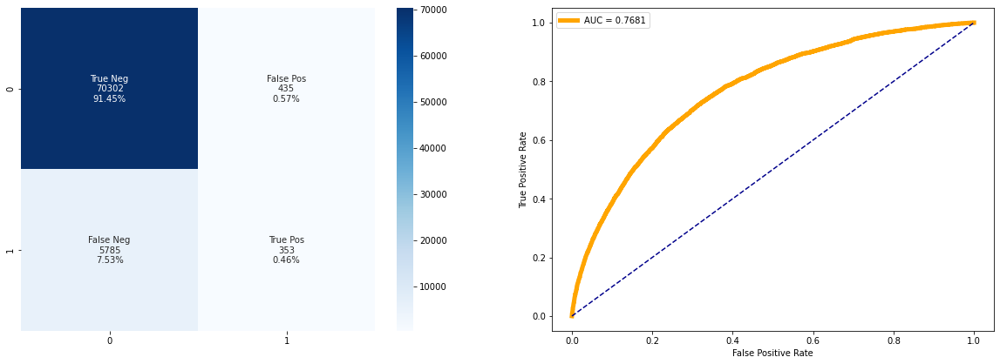

In [93]:
y_pred_l_auc = lgb_model_auc.predict(x_valid)
y_pred_l_proba_auc = lgb_model_auc.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba_auc[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(lgb_model_auc, y_valid, y_pred_l_auc, y_pred_l_proba_auc[:,1])

lighGBM Model roc_auc_score: 0.6878


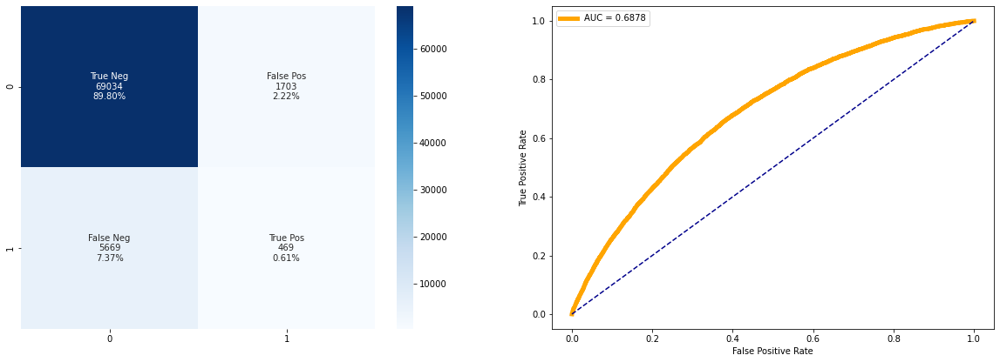

In [94]:
y_pred_l_auc = cat_model_auc.predict(x_valid)
y_pred_l_proba_auc = cat_model_auc.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba_auc[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(cat_model_auc, y_valid, y_pred_l_auc, y_pred_l_proba_auc[:,1])

lighGBM Model roc_auc_score: 0.6670


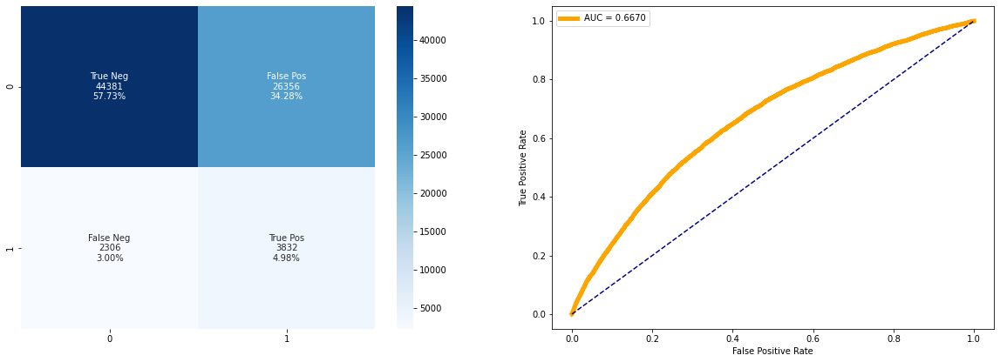

In [95]:
y_pred_l_auc = xg_model_auc.predict(x_valid)
y_pred_l_proba_auc = xg_model_auc.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba_auc[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(xg_model_auc, y_valid, y_pred_l_auc, y_pred_l_proba_auc[:,1])

#### En fonction de la métrique métier 

In [96]:
models = [lgb.LGBMClassifier(), ctb.CatBoostClassifier(), xgb.XGBClassifier()]

name = []
auc = [output_lgb_optuna['AUC'], output_cat_optuna['AUC'], output_xg_optuna['AUC']]
accuracy = [output_lgb_optuna['Accuracy'],output_cat_optuna['Accuracy'],output_xg_optuna['Accuracy']]
precision = [output_lgb_optuna['Precision'],output_cat_optuna['Precision'],output_xg_optuna['Precision']]
recall = [output_lgb_optuna['Recall'],output_cat_optuna['Recall'],output_xg_optuna['Recall']]
f1 = [output_lgb_optuna['F1'],output_cat_optuna['F1'],output_xg_optuna['F1']]
bank_metric_score = [output_lgb_optuna['bank_metric_score'],output_cat_optuna['bank_metric_score'],output_xg_optuna['bank_metric_score']]


for model in models:
    name.append(type(model).__name__)

#Initialise data of lists
base_models = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, bank_metric_score]).T
base_models.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1','bank_metric_score']
base_models.sort_values('bank_metric_score', ascending=False, inplace=True)

In [97]:
base_models

,Model,AUC,Accuracy,Precision,Recall,F1,bank_metric_score
0,LGBMClassifier,0.756841,0.916527,0.399856,0.090746,0.147922,0.716634
1,CatBoostClassifier,0.688966,0.889483,0.199388,0.127403,0.155467,0.70501
2,XGBClassifier,0.64092,0.759063,0.137258,0.38172,0.201913,0.667722


lighGBM Model roc_auc_score: 0.7568


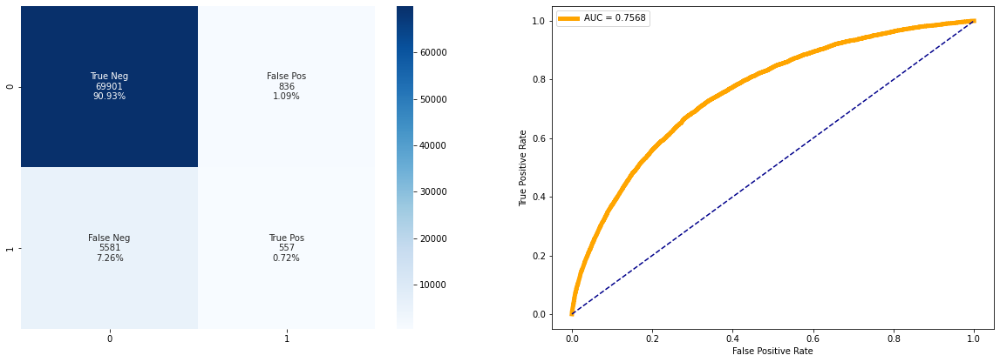

In [98]:
y_pred_l = lgb_model.predict(x_valid)
y_pred_l_proba = lgb_model.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(lgb_model, y_valid, y_pred_l, y_pred_l_proba[:,1])

lighGBM Model roc_auc_score: 0.6890


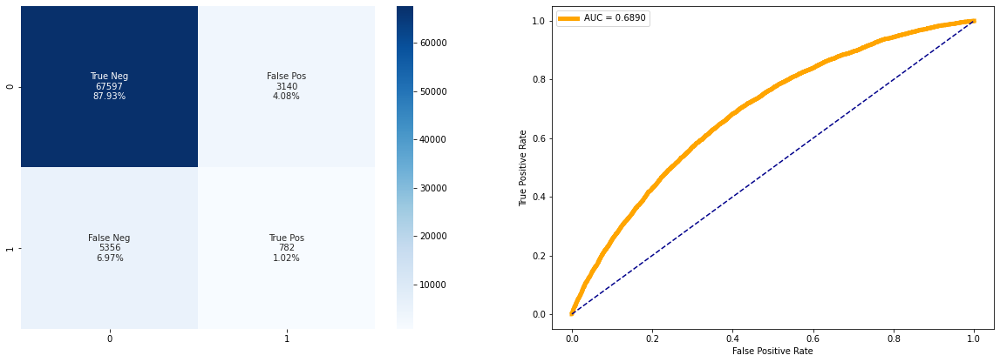

In [99]:
y_pred_l = cat_model.predict(x_valid)
y_pred_l_proba = cat_model.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(cat_model, y_valid, y_pred_l, y_pred_l_proba[:,1])

lighGBM Model roc_auc_score: 0.6409


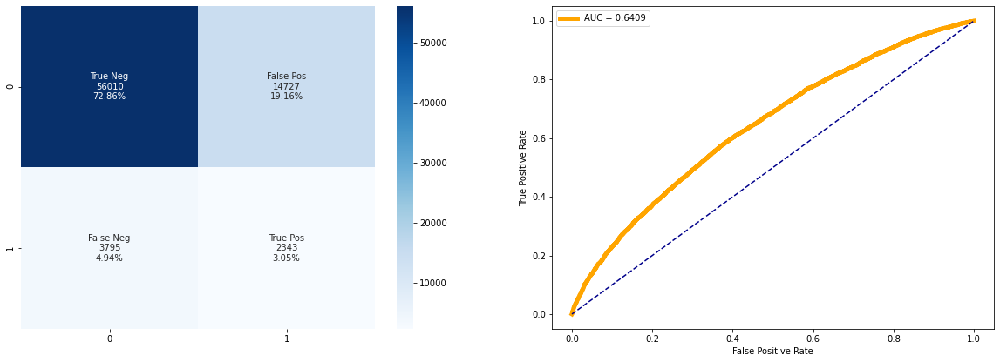

In [100]:
y_pred_l = xg_model.predict(x_valid)
y_pred_l_proba = xg_model.predict_proba(x_valid)
roc_auc = roc_auc_score(y_valid, y_pred_l_proba[:,1])
print('lighGBM Model roc_auc_score: %0.4f' %roc_auc)
Modelisation().cf_matrix_roc_auc(xg_model, y_valid, y_pred_l, y_pred_l_proba[:,1])

Je garde le modèle LightGBM avec comme métrique d'évaluation : l'AUC je reserve le modèle LightGBM avec la métrique bancaire pour  trouver le seuil de solvabilité!

In [101]:
import pickle
pickle.dump(lgb_model_auc, open("C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/lgb_model_auc.pkl", "wb"))

In [102]:
pickle.dump(cat_model_auc, open("C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/cat_model_auc.pkl", "wb"))

In [103]:
pickle.dump(cat_model, open("C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/cat_model.pkl", "wb"))

In [104]:
pickle.dump(lgb_model, open("C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/lgb_model.pkl", "wb"))

In [105]:
pickle.dump(xg_model, open("C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/xg_model.pkl", "wb"))

In [106]:
def load_model():
    '''loading the trained model'''
    pickle_lgb_auc = open('C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/lgb_model_auc.pkl', 'rb')
    lgb_model_auc = pickle.load(pickle_lgb_auc)
    pickle_cat_auc = open('C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/cat_model_auc.pkl', 'rb')
    cat_model_auc = pickle.load(pickle_cat_auc)
    pickle_cat = open('C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/cat_model.pkl', 'rb')
    cat_model = pickle.load(pickle_cat)
    pickle_lgb = open('C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/lgb_model.pkl', 'rb')
    lgb_model = pickle.load(pickle_lgb)
    pickle_xg = open('C:/Users/agar.blohorn/Documents/Projet Openclassrooms/Projet 7/xg_model.pkl', 'rb')
    xg_model = pickle.load(pickle_xg )
    return lgb_model_auc, cat_model_auc, cat_model,lgb_model, xg_model

In [107]:
lgb_model_auc, cat_model_auc, cat_model,lgb_model, xg_model = load_model()

## Choix du seuil de solvabilité

In [108]:
#metric_score = make_scorer(metric_score, greater_is_better=True)

In [109]:
# apply threshold to positive probabilities to create labels
def to_labels(pos_probs, threshold):
    return (pos_probs >= threshold).astype('int')

def seuil_solvabilité(model, X, y_true):
    scores = []
    seuils = np.linspace(0, 1,10)
    # evaluate each threshold
    y_pred = model.predict_proba(X)
    score = [metric_score(y_true, to_labels(y_pred[:,1], t)) for t in seuils]
   
    # get best threshold
    ix = np.argmax(score)
    print('Threshold=%.3f, metric_score=%.5f' % (seuils[ix], score[ix]))
    # Affichage du gain en fonction du seuil de solvabilité
    plt.figure(figsize=(12, 6))
    plt.plot(seuils, score)
    plt.xlabel("Seuil de probabilité")
    plt.ylabel("Métrique bancaire")
    plt.title("seuil")
    plt.xticks(np.linspace(0.1, 1, 10))
    
    

Threshold=0.222, metric_score=0.73906


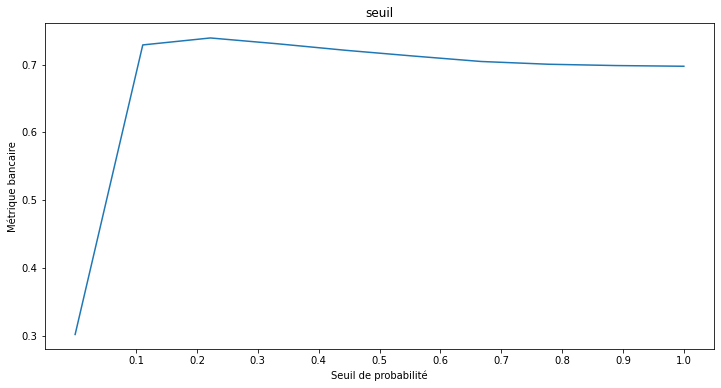

In [110]:
seuil_solvabilité(lgb_model, x_valid, y_valid)

Threshold=0.444, metric_score=0.70578


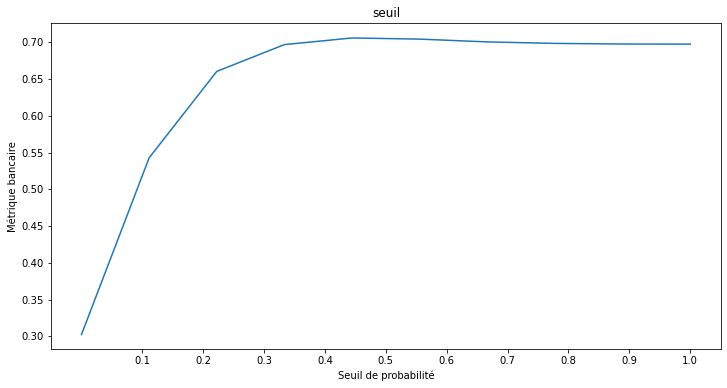

In [111]:
seuil_solvabilité(cat_model, x_valid, y_valid)

Threshold=0.222, metric_score=0.74331


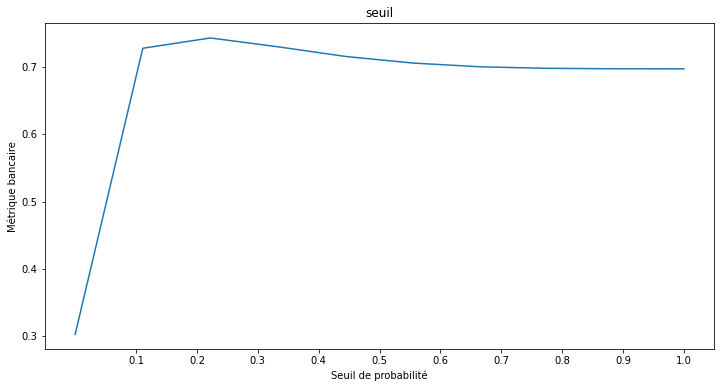

In [112]:
seuil_solvabilité(lgb_model_auc, x_valid, y_valid)

In [113]:
y_pred_l_proba_auc = lgb_model_auc.predict_proba(x_valid)

## Interprétation du modèle avec SHAPASH

In [114]:
from shapash.explainer.smart_explainer import SmartExplainer

In [115]:
y_pred = pd.DataFrame(lgb_model_auc.predict(x_valid),columns=['pred'],index=x_valid.index)

In [116]:
y_pred.head()

,pred
SK_ID_CURR,
258677,0
323522,0
267199,0
455133,0
278845,0


In [117]:
response_dict = {0:'non defaulter', 1:'defaulter'}

In [118]:
xpl = SmartExplainer(label_dict=response_dict) 

In [119]:
xpl.compile(
    x=x_valid,
    model=lgb_model_auc,
    y_pred=y_pred
)

Backend: Shap TreeExplainer


C:\Anaconda\lib\site-packages\shap\explainers\_tree.py:349: UserWarning:

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray



### Feature importance 

In [120]:
xpl.plot.features_importance()

In [ ]:
print(train_selec_boost.columns.tolist())

### Feature contribition 

In [127]:
xpl.plot.contribution_plot(col='OBS_30_CNT_SOCIAL_CIRCLE')

In [128]:
xpl.plot.contribution_plot(col='EXT_SOURCE_2')

In [ ]:
xpl.plot.contribution_plot(col='EXT_SOURCE_3')

In [ ]:
xpl.plot.contribution_plot(col='AMT_INCOME_TOTAL')

In [ ]:
xpl.plot.contribution_plot(col='DAYS_EMPLOYED')

In [ ]:
sns.scatterplot(x = 'DAYS_EMPLOYED', y='AMT_INCOME_TOTAL', data=train_selec_boost)

### Local contribution

In [135]:
y_pred[y_pred['pred'] == 1]

,pred
SK_ID_CURR,
276489,1
385364,1
429720,1
322916,1
192959,1
448104,1
253013,1
356470,1
361134,1


In [129]:
xpl.filter(max_contrib=20, positive = True)
xpl.plot.local_plot(index=275100)

In [130]:
xpl.filter(max_contrib=20, positive = False)
xpl.plot.local_plot(index=275100)

In [136]:
xpl.filter(max_contrib=20)
xpl.plot.local_plot(index=276489)

In [137]:
xpl.filter(max_contrib=20, positive = True)
xpl.plot.local_plot(index=276489)

In [138]:
xpl.filter(max_contrib=20, positive = False)
xpl.plot.local_plot(index=276489)

### Compare Plot

In [140]:
xpl.plot.compare_plot(index=[276489, 275100])

In [ ]:
xpl.to_pandas(max_contrib=3).head()

In [ ]:
predictor = xpl.to_smartpredictor()

In [ ]:
predictor.save('./predictor.pkl')

In [ ]:
test_selec_boost.head(2)

In [ ]:
app = xpl.run_app(title_story='Hello')

In [ ]:
app.kill()

In [ ]:
app